In [1]:
import os
from pytube import YouTube
from youtube_transcript_api import YouTubeTranscriptApi

class YouTubeDownloader:
    def __init__(self, save_path):
        self.save_path = save_path
        if not os.path.exists(save_path):
            os.makedirs(save_path)

    def download_video(self, video_url):
        try:
            yt = YouTube(video_url)
            stream = yt.streams.filter(progressive=True, file_extension='mp4').first()
            video_path = stream.download(output_path=self.save_path)
            video_id = yt.video_id
            new_video_path = os.path.join(self.save_path, f"{video_id}.mp4")
            os.rename(video_path, new_video_path)
            print(f'Video downloaded and renamed: {new_video_path}')
            return new_video_path
        except Exception as e:
            print(f'Error downloading video: {e}')
            return None

    def download_transcript(self, video_id, lang_code='en'):
        try:
            transcript = YouTubeTranscriptApi.get_transcript(video_id, languages=[lang_code])
            transcript_path = os.path.join(self.save_path, f"{video_id}.srt")
            with open(transcript_path, 'w', encoding='utf-8') as f:
                for entry in transcript:
                    start = entry['start']
                    duration = entry['duration']
                    text = entry['text']
                    f.write(f'{start} --> {start + duration}\n{text}\n\n')
            print(f'Transcript downloaded: {transcript_path}')
            return transcript_path
        except Exception as e:
            print(f'Error downloading transcript: {e}')
            return None

    def download_video_and_transcript(self, video_url, lang_code='en'):
        video_path = self.download_video(video_url)
        video_id = YouTube(video_url).video_id
        transcript_path = self.download_transcript(video_id, lang_code)
        return video_path, transcript_path

# Example Usage
if __name__ == '__main__':
    save_path = r'C:\Users\algba\AIhwks'
    video_urls = [
        'https://www.youtube.com/watch?v=wbWRWeVe1XE',
        'https://www.youtube.com/watch?v=FlJoBhLnqko',
        'https://www.youtube.com/watch?v=Y-bVwPRy_no'
    ]

    downloader = YouTubeDownloader(save_path)

    for url in video_urls:
        downloader.download_video_and_transcript(url)

    # Check if the videos have been downloaded and renamed correctly
    for video_url in video_urls:
        video_id = YouTube(video_url).video_id
        video_file = os.path.join(save_path, f"{video_id}.mp4")
        if os.path.exists(video_file):
            print(f"Video file {video_file} exists.")
        else:
            print(f"Video file {video_file} does not exist.")


In [2]:
import cv2
import numpy as np
import os

def decode_frames(video_path):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        frames.append(frame)
    cap.release()
    print(f"Decoded {len(frames)} frames from {video_path}")
    return frames

def sample_frames(frames, sample_rate=10):
    sampled_frames = frames[::sample_rate]
    print(f"Sampled {len(sampled_frames)} frames")
    return sampled_frames

def resize_frames(frames, size=(224, 224)):
    resized_frames = [cv2.resize(frame, size) for frame in frames]
    print(f"Resized frames to {size}")
    return resized_frames

def preprocess_frames(frames):
    processed_frames = []
    for frame in frames:
        # Convert to RGB
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        # Normalize to [0, 1]
        frame = frame / 255.0
        processed_frames.append(frame)
    print(f"Preprocessed {len(processed_frames)} frames")
    return np.array(processed_frames)

def save_frames(frames, save_path):
    np.save(save_path, frames)
    print(f"Frames saved to {save_path}")

def preprocess_video(video_path, output_path, sample_rate=10, size=(224, 224)):
    frames = decode_frames(video_path)
    if frames:
        sampled_frames = sample_frames(frames, sample_rate)
        resized_frames = resize_frames(sampled_frames, size)
        processed_frames = preprocess_frames(resized_frames)
        save_frames(processed_frames, output_path)
    else:
        print(f"No frames decoded from {video_path}")

if __name__ == '__main__':
    video_dir = r'C:\Users\algba\AIhwks'
    output_dir = r'C:\Users\algba\AIhwks\processed_frames'
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    video_files = [
        'wbWRWeVe1XE.mp4',
        'FlJoBhLnqko.mp4',
        'Y-bVwPRy_no.mp4'
    ]

    for video_file in video_files:
        video_path = os.path.join(video_dir, video_file)
        output_path = os.path.join(output_dir, video_file.replace('.mp4', '.npy'))
        preprocess_video(video_path, output_path)


Processing file: wbWRWeVe1XE.npy
Number of frames in wbWRWeVe1XE.npy: 821


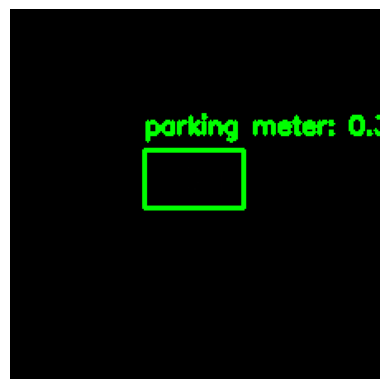

Frame 0, Label: 13, Score: 0.33387842774391174


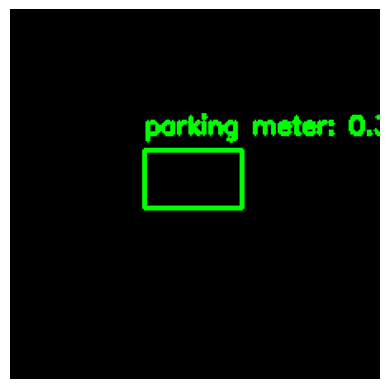

Frame 1, Label: 13, Score: 0.39206793904304504


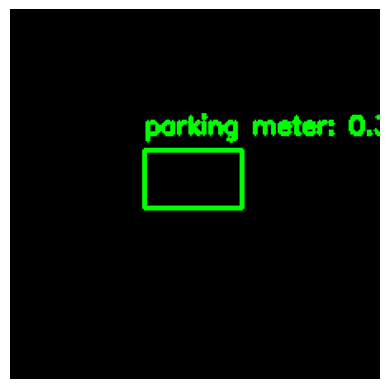

Frame 2, Label: 13, Score: 0.35390856862068176


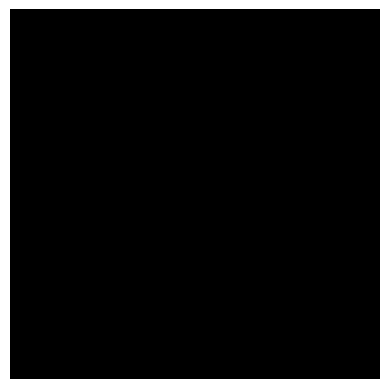

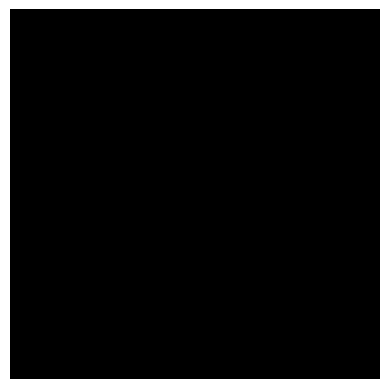

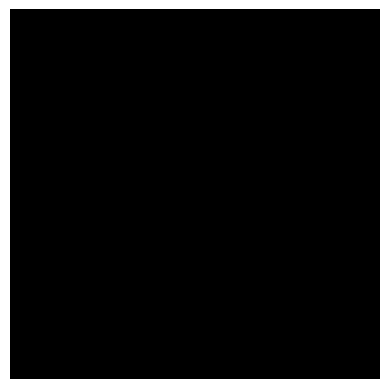

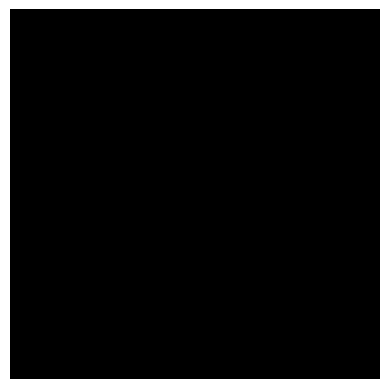

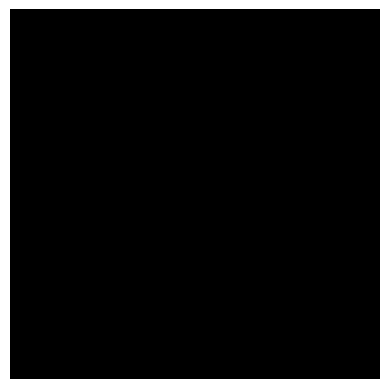

...

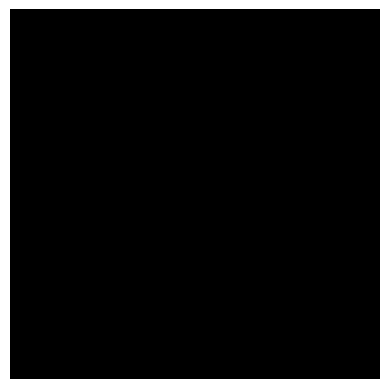

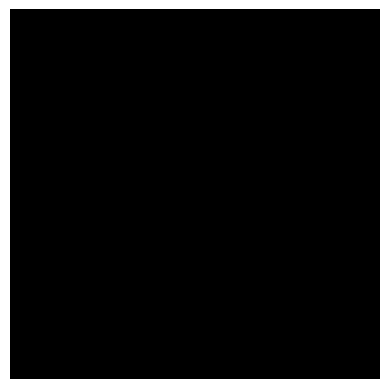

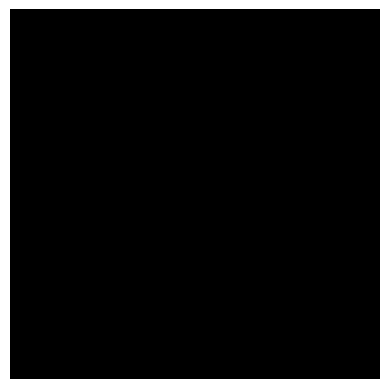

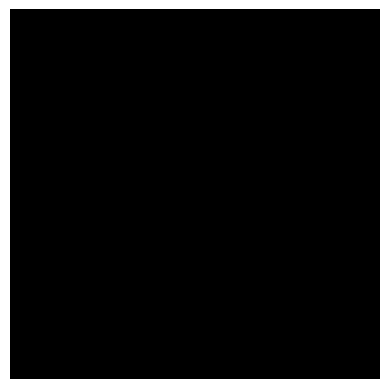

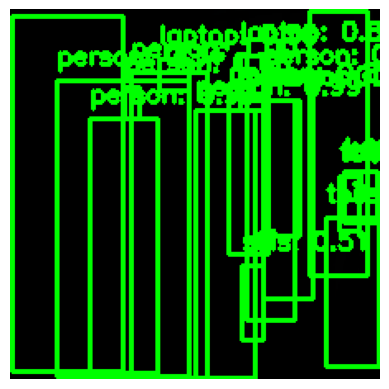

Frame 36, Label: 1, Score: 0.9972283244132996
Frame 36, Label: 1, Score: 0.9952724575996399
Frame 36, Label: 1, Score: 0.9938322305679321
Frame 36, Label: 1, Score: 0.9910560846328735
Frame 36, Label: 1, Score: 0.9523894190788269
Frame 36, Label: 1, Score: 0.9113280773162842
Frame 36, Label: 62, Score: 0.9006006717681885
Frame 36, Label: 64, Score: 0.8739436268806458
Frame 36, Label: 1, Score: 0.8723009824752808
Frame 36, Label: 67, Score: 0.6991655230522156
Frame 36, Label: 1, Score: 0.6589874625205994
Frame 36, Label: 1, Score: 0.5250159502029419
Frame 36, Label: 31, Score: 0.5074388384819031
Frame 36, Label: 64, Score: 0.49589410424232483
Frame 36, Label: 62, Score: 0.4379239082336426
Frame 36, Label: 62, Score: 0.3901207745075226
Frame 36, Label: 1, Score: 0.33640289306640625
Frame 36, Label: 1, Score: 0.33011502027511597


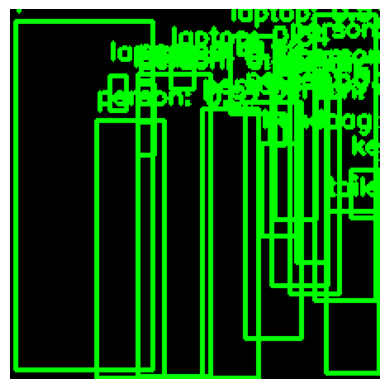

Frame 37, Label: 1, Score: 0.9948590993881226
Frame 37, Label: 1, Score: 0.994765043258667
Frame 37, Label: 1, Score: 0.9926071166992188
Frame 37, Label: 1, Score: 0.9711484313011169
Frame 37, Label: 1, Score: 0.9707613587379456
Frame 37, Label: 1, Score: 0.9300537705421448
Frame 37, Label: 1, Score: 0.9145487546920776
Frame 37, Label: 62, Score: 0.6042956709861755
Frame 37, Label: 1, Score: 0.6038578748703003
Frame 37, Label: 64, Score: 0.5378464460372925
Frame 37, Label: 64, Score: 0.5318188667297363
Frame 37, Label: 67, Score: 0.504817545413971
Frame 37, Label: 1, Score: 0.4275559186935425
Frame 37, Label: 1, Score: 0.4120418429374695
Frame 37, Label: 64, Score: 0.406090646982193
Frame 37, Label: 1, Score: 0.35542041063308716
Frame 37, Label: 1, Score: 0.34230905771255493
Frame 37, Label: 1, Score: 0.33116787672042847
Frame 37, Label: 27, Score: 0.3195285201072693


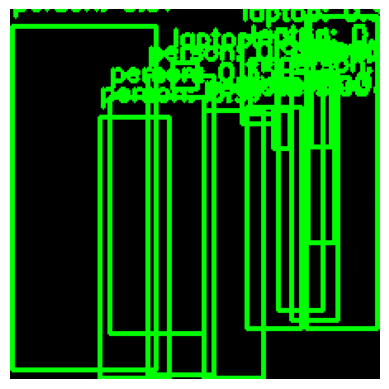

Frame 38, Label: 1, Score: 0.9968141913414001
Frame 38, Label: 1, Score: 0.9919459223747253
Frame 38, Label: 1, Score: 0.9884338974952698
Frame 38, Label: 1, Score: 0.9746466279029846
Frame 38, Label: 1, Score: 0.9735410809516907
Frame 38, Label: 1, Score: 0.9490624070167542
Frame 38, Label: 1, Score: 0.9261948466300964
Frame 38, Label: 1, Score: 0.7430446743965149
Frame 38, Label: 1, Score: 0.5815109014511108
Frame 38, Label: 1, Score: 0.5517918467521667
Frame 38, Label: 64, Score: 0.5441401600837708
Frame 38, Label: 64, Score: 0.4249919652938843
Frame 38, Label: 64, Score: 0.3570560812950134
Frame 38, Label: 1, Score: 0.3548245131969452
Frame 38, Label: 1, Score: 0.30356070399284363


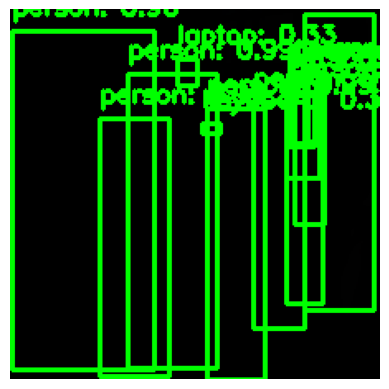

Frame 39, Label: 1, Score: 0.9940028786659241
Frame 39, Label: 1, Score: 0.9920709729194641
Frame 39, Label: 1, Score: 0.9916437268257141
Frame 39, Label: 1, Score: 0.9883835911750793
Frame 39, Label: 1, Score: 0.9638801217079163
Frame 39, Label: 1, Score: 0.899860143661499
Frame 39, Label: 1, Score: 0.8818523287773132
Frame 39, Label: 1, Score: 0.44425830245018005
Frame 39, Label: 1, Score: 0.3510885536670685
Frame 39, Label: 1, Score: 0.33073094487190247
Frame 39, Label: 64, Score: 0.328215092420578
Frame 39, Label: 67, Score: 0.3039432764053345
Frame 39, Label: 1, Score: 0.3032345473766327
Frame 39, Label: 1, Score: 0.30270013213157654


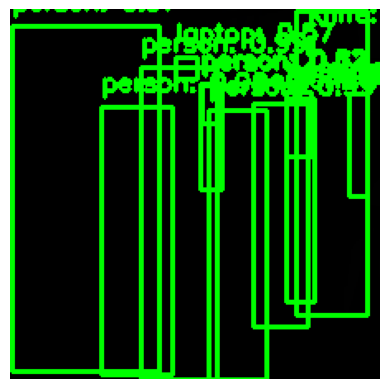

Frame 40, Label: 1, Score: 0.9936811923980713
Frame 40, Label: 1, Score: 0.9908379912376404
Frame 40, Label: 1, Score: 0.9879963994026184
Frame 40, Label: 1, Score: 0.976104736328125
Frame 40, Label: 1, Score: 0.9749402403831482
Frame 40, Label: 1, Score: 0.9575239419937134
Frame 40, Label: 1, Score: 0.8211652636528015
Frame 40, Label: 1, Score: 0.7176432013511658
Frame 40, Label: 1, Score: 0.6160482168197632
Frame 40, Label: 1, Score: 0.5721984505653381
Frame 40, Label: 64, Score: 0.5693832635879517
Frame 40, Label: 1, Score: 0.4892650246620178
Frame 40, Label: 44, Score: 0.44586488604545593


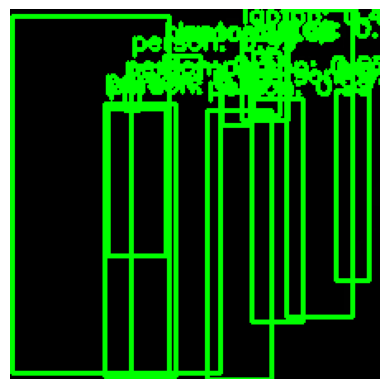

Frame 41, Label: 1, Score: 0.9913201928138733
Frame 41, Label: 1, Score: 0.9909197092056274
Frame 41, Label: 1, Score: 0.9893745183944702
Frame 41, Label: 1, Score: 0.9887429475784302
Frame 41, Label: 1, Score: 0.9811570048332214
Frame 41, Label: 1, Score: 0.9541357755661011
Frame 41, Label: 1, Score: 0.9278445243835449
Frame 41, Label: 1, Score: 0.6726993918418884
Frame 41, Label: 64, Score: 0.5976195931434631
Frame 41, Label: 47, Score: 0.5392554402351379
Frame 41, Label: 64, Score: 0.4866642951965332
Frame 41, Label: 64, Score: 0.39516833424568176
Frame 41, Label: 1, Score: 0.367433100938797
Frame 41, Label: 1, Score: 0.331213116645813


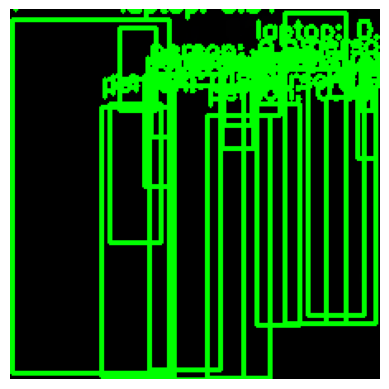

Frame 42, Label: 1, Score: 0.994118332862854
Frame 42, Label: 1, Score: 0.9930484294891357
Frame 42, Label: 1, Score: 0.9887883067131042
Frame 42, Label: 1, Score: 0.9859408736228943
Frame 42, Label: 1, Score: 0.9846439361572266
Frame 42, Label: 1, Score: 0.9449914693832397
Frame 42, Label: 1, Score: 0.8886572122573853
Frame 42, Label: 1, Score: 0.7507821917533875
Frame 42, Label: 1, Score: 0.6102879047393799
Frame 42, Label: 64, Score: 0.5072557926177979
Frame 42, Label: 62, Score: 0.5029582977294922
Frame 42, Label: 64, Score: 0.44537267088890076
Frame 42, Label: 1, Score: 0.41872504353523254
Frame 42, Label: 1, Score: 0.39741262793540955
Frame 42, Label: 1, Score: 0.3773333728313446
Frame 42, Label: 1, Score: 0.3676207363605499
Frame 42, Label: 1, Score: 0.3186381459236145
Frame 42, Label: 1, Score: 0.30287885665893555


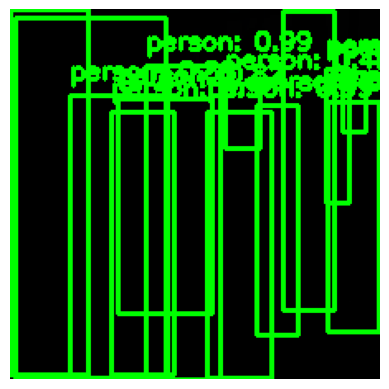

Frame 43, Label: 1, Score: 0.9946304559707642
Frame 43, Label: 1, Score: 0.9928075075149536
Frame 43, Label: 1, Score: 0.9916315674781799
Frame 43, Label: 1, Score: 0.989967942237854
Frame 43, Label: 1, Score: 0.988401472568512
Frame 43, Label: 1, Score: 0.9641081690788269
Frame 43, Label: 1, Score: 0.9527050256729126
Frame 43, Label: 1, Score: 0.8848678469657898
Frame 43, Label: 1, Score: 0.829393744468689
Frame 43, Label: 1, Score: 0.8199663758277893
Frame 43, Label: 1, Score: 0.708975613117218
Frame 43, Label: 1, Score: 0.47673872113227844
Frame 43, Label: 1, Score: 0.38901111483573914


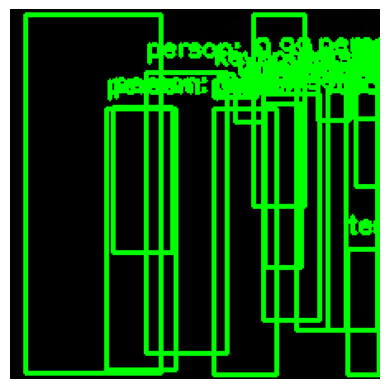

Frame 44, Label: 1, Score: 0.9950461387634277
Frame 44, Label: 1, Score: 0.9874061942100525
Frame 44, Label: 1, Score: 0.9841071367263794
Frame 44, Label: 1, Score: 0.9779089093208313
Frame 44, Label: 1, Score: 0.9726373553276062
Frame 44, Label: 1, Score: 0.9140853881835938
Frame 44, Label: 1, Score: 0.9053887724876404
Frame 44, Label: 1, Score: 0.8624354600906372
Frame 44, Label: 1, Score: 0.7019148468971252
Frame 44, Label: 1, Score: 0.5569220185279846
Frame 44, Label: 1, Score: 0.5568280816078186
Frame 44, Label: 1, Score: 0.5424216389656067
Frame 44, Label: 67, Score: 0.46050482988357544
Frame 44, Label: 39, Score: 0.45376452803611755
Frame 44, Label: 62, Score: 0.4218616485595703
Frame 44, Label: 1, Score: 0.3633543848991394


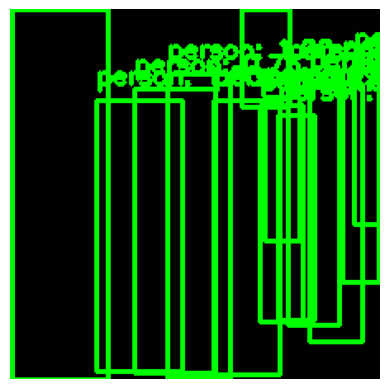

Frame 45, Label: 1, Score: 0.9974154233932495
Frame 45, Label: 1, Score: 0.9951112866401672
Frame 45, Label: 1, Score: 0.9936532974243164
Frame 45, Label: 1, Score: 0.9714264273643494
Frame 45, Label: 1, Score: 0.9699949026107788
Frame 45, Label: 1, Score: 0.9538066387176514
Frame 45, Label: 1, Score: 0.9529600143432617
Frame 45, Label: 1, Score: 0.9336236119270325
Frame 45, Label: 1, Score: 0.8495575785636902
Frame 45, Label: 1, Score: 0.7556887269020081
Frame 45, Label: 1, Score: 0.5169894099235535
Frame 45, Label: 1, Score: 0.4996526837348938
Frame 45, Label: 1, Score: 0.32726413011550903


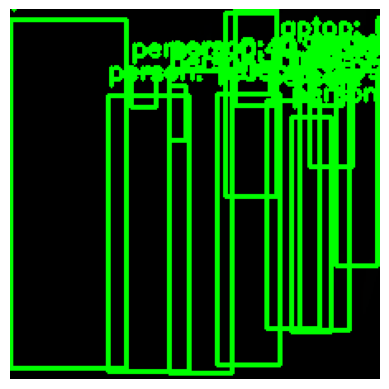

Frame 46, Label: 1, Score: 0.9958974123001099
Frame 46, Label: 1, Score: 0.9936135411262512
Frame 46, Label: 1, Score: 0.9890859127044678
Frame 46, Label: 1, Score: 0.9707650542259216
Frame 46, Label: 1, Score: 0.9632528424263
Frame 46, Label: 1, Score: 0.9574785232543945
Frame 46, Label: 1, Score: 0.9471139311790466
Frame 46, Label: 1, Score: 0.8557053804397583
Frame 46, Label: 1, Score: 0.8547340631484985
Frame 46, Label: 64, Score: 0.6840475797653198
Frame 46, Label: 1, Score: 0.5999877452850342
Frame 46, Label: 1, Score: 0.44009560346603394
Frame 46, Label: 1, Score: 0.3993135094642639
Frame 46, Label: 1, Score: 0.3239545226097107
Frame 46, Label: 1, Score: 0.32355961203575134


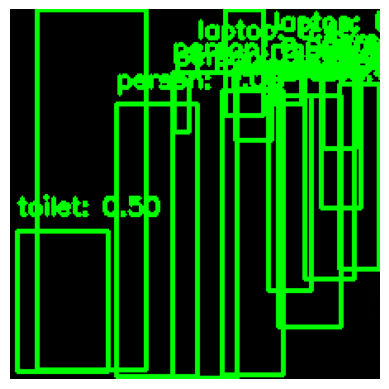

Frame 47, Label: 1, Score: 0.9965716600418091
Frame 47, Label: 1, Score: 0.99418044090271
Frame 47, Label: 1, Score: 0.990607738494873
Frame 47, Label: 1, Score: 0.9722456336021423
Frame 47, Label: 1, Score: 0.9677120447158813
Frame 47, Label: 1, Score: 0.9068766236305237
Frame 47, Label: 1, Score: 0.9023793935775757
Frame 47, Label: 1, Score: 0.7759475708007812
Frame 47, Label: 1, Score: 0.7718104720115662
Frame 47, Label: 1, Score: 0.7709407210350037
Frame 47, Label: 1, Score: 0.6463639736175537
Frame 47, Label: 1, Score: 0.6141445636749268
Frame 47, Label: 62, Score: 0.49825209379196167
Frame 47, Label: 64, Score: 0.454357385635376
Frame 47, Label: 1, Score: 0.44127604365348816
Frame 47, Label: 64, Score: 0.4249001145362854


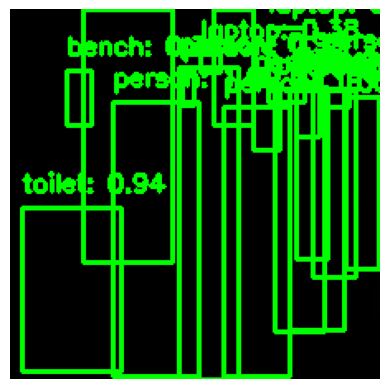

Frame 48, Label: 1, Score: 0.9964757561683655
Frame 48, Label: 1, Score: 0.9960609078407288
Frame 48, Label: 1, Score: 0.9883302450180054
Frame 48, Label: 1, Score: 0.9827829599380493
Frame 48, Label: 1, Score: 0.980490505695343
Frame 48, Label: 1, Score: 0.9773505926132202
Frame 48, Label: 1, Score: 0.9432597756385803
Frame 48, Label: 1, Score: 0.9423118233680725
Frame 48, Label: 62, Score: 0.9394077658653259
Frame 48, Label: 1, Score: 0.8823421001434326
Frame 48, Label: 64, Score: 0.7943131923675537
Frame 48, Label: 1, Score: 0.6269408464431763
Frame 48, Label: 1, Score: 0.5993175506591797
Frame 48, Label: 1, Score: 0.3977217972278595
Frame 48, Label: 14, Score: 0.3812304735183716
Frame 48, Label: 64, Score: 0.38100817799568176
Frame 48, Label: 1, Score: 0.3525938093662262
Frame 48, Label: 1, Score: 0.338304340839386


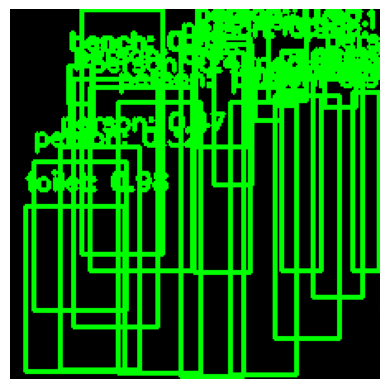

Frame 49, Label: 1, Score: 0.9954030513763428
Frame 49, Label: 1, Score: 0.9948424696922302
Frame 49, Label: 1, Score: 0.9933434724807739
Frame 49, Label: 1, Score: 0.990356981754303
Frame 49, Label: 62, Score: 0.9772302508354187
Frame 49, Label: 1, Score: 0.9758719801902771
Frame 49, Label: 1, Score: 0.9569454789161682
Frame 49, Label: 1, Score: 0.876625657081604
Frame 49, Label: 14, Score: 0.726611852645874
Frame 49, Label: 1, Score: 0.7146574258804321
Frame 49, Label: 1, Score: 0.6686670780181885
Frame 49, Label: 1, Score: 0.602613627910614
Frame 49, Label: 64, Score: 0.6021549701690674
Frame 49, Label: 1, Score: 0.5636379718780518
Frame 49, Label: 1, Score: 0.4665190279483795
Frame 49, Label: 1, Score: 0.4301915466785431
Frame 49, Label: 1, Score: 0.41794484853744507
Frame 49, Label: 1, Score: 0.41642048954963684
Frame 49, Label: 14, Score: 0.3858434557914734
Frame 49, Label: 64, Score: 0.37439045310020447
Frame 49, Label: 1, Score: 0.3547492027282715
Frame 49, Label: 1, Score: 0.3

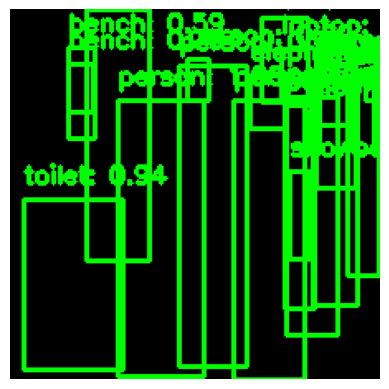

Frame 50, Label: 1, Score: 0.9959892630577087
Frame 50, Label: 1, Score: 0.9933596253395081
Frame 50, Label: 1, Score: 0.9908780455589294
Frame 50, Label: 1, Score: 0.9856371283531189
Frame 50, Label: 1, Score: 0.9448095560073853
Frame 50, Label: 62, Score: 0.9385172724723816
Frame 50, Label: 1, Score: 0.9222004413604736
Frame 50, Label: 1, Score: 0.9034541845321655
Frame 50, Label: 14, Score: 0.7881637215614319
Frame 50, Label: 64, Score: 0.7585362195968628
Frame 50, Label: 32, Score: 0.7173805832862854
Frame 50, Label: 1, Score: 0.6877807378768921
Frame 50, Label: 21, Score: 0.6562521457672119
Frame 50, Label: 14, Score: 0.591081976890564
Frame 50, Label: 1, Score: 0.46980831027030945
Frame 50, Label: 64, Score: 0.4241856336593628
Frame 50, Label: 1, Score: 0.4142434000968933
Frame 50, Label: 1, Score: 0.3529472053050995
Frame 50, Label: 1, Score: 0.3418048024177551
Frame 50, Label: 21, Score: 0.3272806406021118
Frame 50, Label: 1, Score: 0.3068269193172455


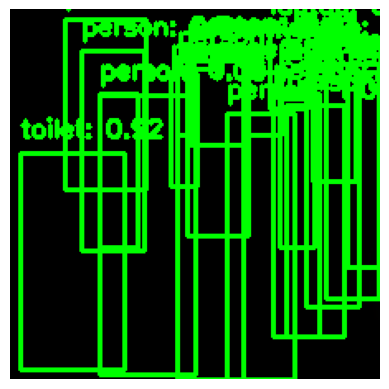

Frame 51, Label: 1, Score: 0.9969367980957031
Frame 51, Label: 1, Score: 0.9962825179100037
Frame 51, Label: 1, Score: 0.9927523136138916
Frame 51, Label: 1, Score: 0.9664802551269531
Frame 51, Label: 1, Score: 0.9631767868995667
Frame 51, Label: 1, Score: 0.9571556448936462
Frame 51, Label: 1, Score: 0.9325553774833679
Frame 51, Label: 62, Score: 0.9242351651191711
Frame 51, Label: 1, Score: 0.8363494873046875
Frame 51, Label: 1, Score: 0.7246748805046082
Frame 51, Label: 1, Score: 0.7098775506019592
Frame 51, Label: 1, Score: 0.704788327217102
Frame 51, Label: 64, Score: 0.6846317648887634
Frame 51, Label: 1, Score: 0.6333285570144653
Frame 51, Label: 1, Score: 0.6033857464790344
Frame 51, Label: 1, Score: 0.5352886319160461
Frame 51, Label: 1, Score: 0.5070552229881287
Frame 51, Label: 64, Score: 0.4358249008655548
Frame 51, Label: 1, Score: 0.4256787896156311
Frame 51, Label: 1, Score: 0.35889163613319397
Frame 51, Label: 1, Score: 0.35548728704452515
Frame 51, Label: 1, Score: 0.3

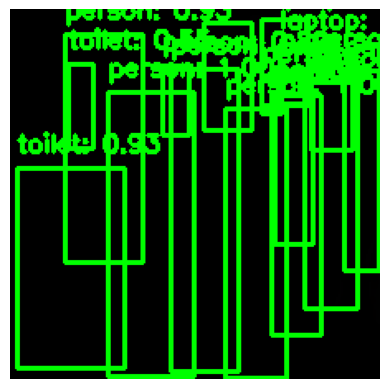

Frame 52, Label: 1, Score: 0.9971743822097778
Frame 52, Label: 1, Score: 0.9965507984161377
Frame 52, Label: 1, Score: 0.9935817718505859
Frame 52, Label: 1, Score: 0.9781689643859863
Frame 52, Label: 1, Score: 0.9475447535514832
Frame 52, Label: 1, Score: 0.9475051760673523
Frame 52, Label: 1, Score: 0.9277799725532532
Frame 52, Label: 62, Score: 0.9270122647285461
Frame 52, Label: 1, Score: 0.9259229302406311
Frame 52, Label: 1, Score: 0.8918078541755676
Frame 52, Label: 1, Score: 0.7017269730567932
Frame 52, Label: 1, Score: 0.5946389436721802
Frame 52, Label: 64, Score: 0.5699927806854248
Frame 52, Label: 62, Score: 0.5515477061271667
Frame 52, Label: 1, Score: 0.358185350894928
Frame 52, Label: 64, Score: 0.3116498589515686


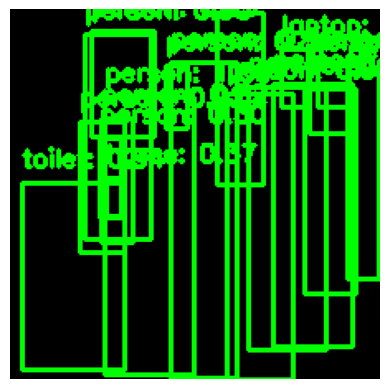

Frame 53, Label: 1, Score: 0.9961226582527161
Frame 53, Label: 1, Score: 0.9920544624328613
Frame 53, Label: 1, Score: 0.990943968296051
Frame 53, Label: 1, Score: 0.9851275086402893
Frame 53, Label: 1, Score: 0.9715824723243713
Frame 53, Label: 1, Score: 0.9513688087463379
Frame 53, Label: 1, Score: 0.9504936933517456
Frame 53, Label: 62, Score: 0.940407395362854
Frame 53, Label: 1, Score: 0.929534912109375
Frame 53, Label: 1, Score: 0.9249387383460999
Frame 53, Label: 1, Score: 0.8958428502082825
Frame 53, Label: 1, Score: 0.8364484906196594
Frame 53, Label: 1, Score: 0.7910407185554504
Frame 53, Label: 1, Score: 0.5584880113601685
Frame 53, Label: 1, Score: 0.5118768811225891
Frame 53, Label: 64, Score: 0.4003664553165436
Frame 53, Label: 18, Score: 0.37051820755004883
Frame 53, Label: 1, Score: 0.31599581241607666
Frame 53, Label: 1, Score: 0.30265456438064575


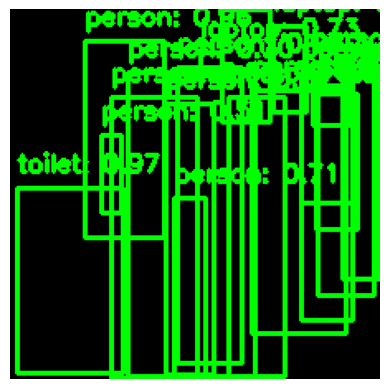

Frame 54, Label: 1, Score: 0.9932631850242615
Frame 54, Label: 1, Score: 0.9914578795433044
Frame 54, Label: 1, Score: 0.9854427576065063
Frame 54, Label: 1, Score: 0.97484290599823
Frame 54, Label: 62, Score: 0.9696728587150574
Frame 54, Label: 1, Score: 0.9570808410644531
Frame 54, Label: 1, Score: 0.9523155689239502
Frame 54, Label: 1, Score: 0.9007351994514465
Frame 54, Label: 1, Score: 0.8439687490463257
Frame 54, Label: 1, Score: 0.7603254914283752
Frame 54, Label: 64, Score: 0.7270352244377136
Frame 54, Label: 1, Score: 0.7153950929641724
Frame 54, Label: 1, Score: 0.7126566171646118
Frame 54, Label: 64, Score: 0.6668297648429871
Frame 54, Label: 1, Score: 0.5576151013374329
Frame 54, Label: 1, Score: 0.5089491605758667
Frame 54, Label: 1, Score: 0.3710106313228607
Frame 54, Label: 1, Score: 0.32071369886398315
Frame 54, Label: 1, Score: 0.304838627576828


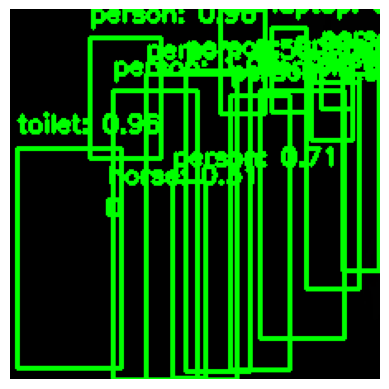

Frame 55, Label: 1, Score: 0.9959698915481567
Frame 55, Label: 1, Score: 0.9892206788063049
Frame 55, Label: 1, Score: 0.964472770690918
Frame 55, Label: 1, Score: 0.9633610844612122
Frame 55, Label: 1, Score: 0.9631155133247375
Frame 55, Label: 62, Score: 0.9630764722824097
Frame 55, Label: 1, Score: 0.9345698356628418
Frame 55, Label: 1, Score: 0.9217052459716797
Frame 55, Label: 1, Score: 0.8780927658081055
Frame 55, Label: 1, Score: 0.7125783562660217
Frame 55, Label: 1, Score: 0.5598967671394348
Frame 55, Label: 1, Score: 0.43843573331832886
Frame 55, Label: 1, Score: 0.33966314792633057
Frame 55, Label: 64, Score: 0.3259238600730896
Frame 55, Label: 18, Score: 0.31115660071372986


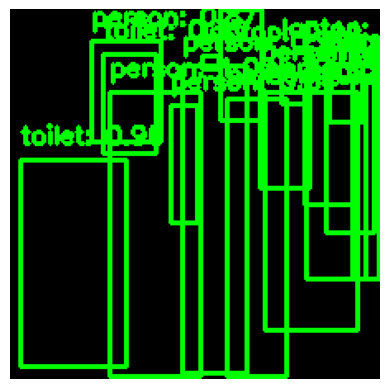

Frame 56, Label: 1, Score: 0.9977133274078369
Frame 56, Label: 1, Score: 0.9924206137657166
Frame 56, Label: 1, Score: 0.9911167621612549
Frame 56, Label: 62, Score: 0.9599421620368958
Frame 56, Label: 1, Score: 0.9575638771057129
Frame 56, Label: 1, Score: 0.9445997476577759
Frame 56, Label: 1, Score: 0.922635555267334
Frame 56, Label: 1, Score: 0.8708410263061523
Frame 56, Label: 1, Score: 0.6982415318489075
Frame 56, Label: 64, Score: 0.6634557843208313
Frame 56, Label: 1, Score: 0.511241614818573
Frame 56, Label: 1, Score: 0.4598056674003601
Frame 56, Label: 64, Score: 0.43504655361175537
Frame 56, Label: 1, Score: 0.37526416778564453
Frame 56, Label: 62, Score: 0.3533063530921936
Frame 56, Label: 1, Score: 0.3434336483478546
Frame 56, Label: 1, Score: 0.30443692207336426


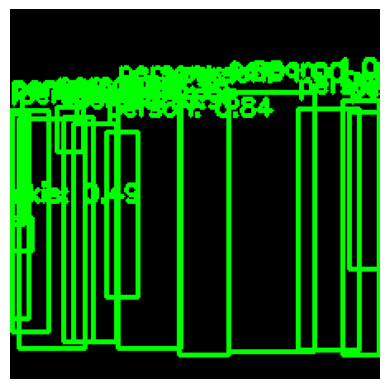

Frame 57, Label: 1, Score: 0.9994124174118042
Frame 57, Label: 1, Score: 0.99782794713974
Frame 57, Label: 1, Score: 0.9977631568908691
Frame 57, Label: 1, Score: 0.9976804256439209
Frame 57, Label: 1, Score: 0.9861966967582703
Frame 57, Label: 1, Score: 0.9838849306106567
Frame 57, Label: 1, Score: 0.9724692106246948
Frame 57, Label: 1, Score: 0.9704697728157043
Frame 57, Label: 1, Score: 0.8417497873306274
Frame 57, Label: 1, Score: 0.8386760950088501
Frame 57, Label: 1, Score: 0.7169042229652405
Frame 57, Label: 1, Score: 0.67508465051651
Frame 57, Label: 31, Score: 0.48740947246551514
Frame 57, Label: 1, Score: 0.4321397542953491
Frame 57, Label: 1, Score: 0.3197583854198456


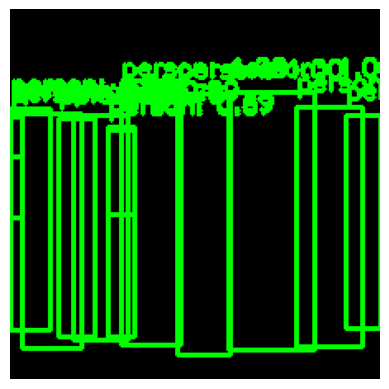

Frame 58, Label: 1, Score: 0.9996180534362793
Frame 58, Label: 1, Score: 0.9985238909721375
Frame 58, Label: 1, Score: 0.998166561126709
Frame 58, Label: 1, Score: 0.997775137424469
Frame 58, Label: 1, Score: 0.9952728152275085
Frame 58, Label: 1, Score: 0.9888112545013428
Frame 58, Label: 1, Score: 0.9830323457717896
Frame 58, Label: 1, Score: 0.9513012766838074
Frame 58, Label: 1, Score: 0.7470957040786743
Frame 58, Label: 1, Score: 0.6744959354400635
Frame 58, Label: 1, Score: 0.5647506713867188
Frame 58, Label: 1, Score: 0.5215905904769897
Frame 58, Label: 1, Score: 0.385895699262619


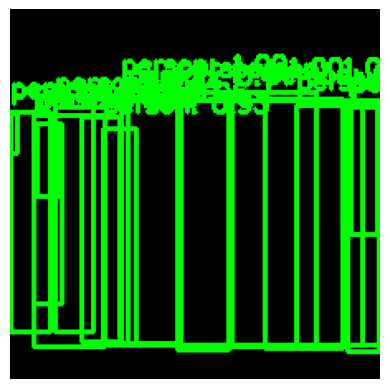

Frame 59, Label: 1, Score: 0.9994445443153381
Frame 59, Label: 1, Score: 0.9985263347625732
Frame 59, Label: 1, Score: 0.9981780052185059
Frame 59, Label: 1, Score: 0.997683048248291
Frame 59, Label: 1, Score: 0.9942263960838318
Frame 59, Label: 1, Score: 0.9813701510429382
Frame 59, Label: 1, Score: 0.9789072871208191
Frame 59, Label: 1, Score: 0.9584146738052368
Frame 59, Label: 1, Score: 0.9302042722702026
Frame 59, Label: 1, Score: 0.6146970391273499
Frame 59, Label: 1, Score: 0.5061800479888916
Frame 59, Label: 1, Score: 0.4438571631908417
Frame 59, Label: 1, Score: 0.4104553759098053
Frame 59, Label: 1, Score: 0.4051074981689453
Frame 59, Label: 1, Score: 0.37170645594596863
Frame 59, Label: 1, Score: 0.32024115324020386


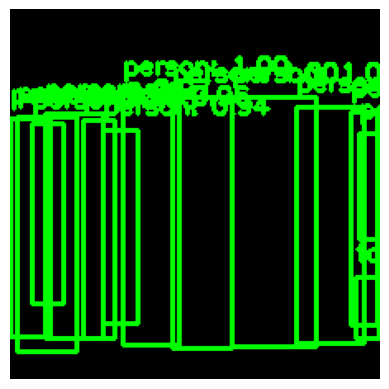

Frame 60, Label: 1, Score: 0.9994891881942749
Frame 60, Label: 1, Score: 0.9982245564460754
Frame 60, Label: 1, Score: 0.9979467988014221
Frame 60, Label: 1, Score: 0.9969743490219116
Frame 60, Label: 1, Score: 0.9943093061447144
Frame 60, Label: 1, Score: 0.9744505286216736
Frame 60, Label: 1, Score: 0.9562420845031738
Frame 60, Label: 1, Score: 0.9383806586265564
Frame 60, Label: 1, Score: 0.9302302598953247
Frame 60, Label: 1, Score: 0.9297411441802979
Frame 60, Label: 1, Score: 0.6512897610664368
Frame 60, Label: 62, Score: 0.3634926974773407
Frame 60, Label: 1, Score: 0.32010966539382935


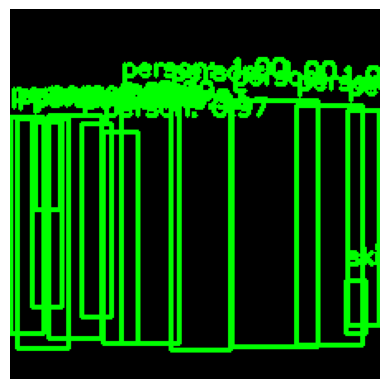

Frame 61, Label: 1, Score: 0.9994798302650452
Frame 61, Label: 1, Score: 0.9989233613014221
Frame 61, Label: 1, Score: 0.9984660148620605
Frame 61, Label: 1, Score: 0.997664213180542
Frame 61, Label: 1, Score: 0.9937652349472046
Frame 61, Label: 1, Score: 0.9920244216918945
Frame 61, Label: 1, Score: 0.9894008040428162
Frame 61, Label: 1, Score: 0.9692032337188721
Frame 61, Label: 1, Score: 0.9258682727813721
Frame 61, Label: 1, Score: 0.8032950162887573
Frame 61, Label: 1, Score: 0.7505179047584534
Frame 61, Label: 31, Score: 0.41205742955207825
Frame 61, Label: 1, Score: 0.3614066243171692


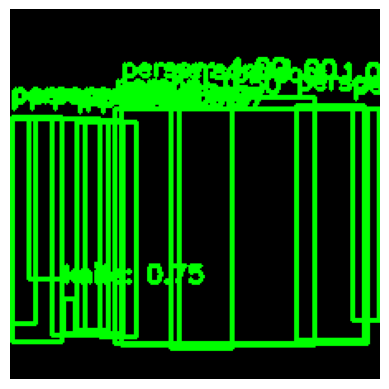

Frame 62, Label: 1, Score: 0.9996117949485779
Frame 62, Label: 1, Score: 0.9990605711936951
Frame 62, Label: 1, Score: 0.9987824559211731
Frame 62, Label: 1, Score: 0.9986568689346313
Frame 62, Label: 1, Score: 0.9853609204292297
Frame 62, Label: 1, Score: 0.9731903672218323
Frame 62, Label: 1, Score: 0.9703369736671448
Frame 62, Label: 1, Score: 0.9690041542053223
Frame 62, Label: 1, Score: 0.9585675001144409
Frame 62, Label: 1, Score: 0.9284271001815796
Frame 62, Label: 44, Score: 0.7454207539558411
Frame 62, Label: 1, Score: 0.5865704417228699
Frame 62, Label: 1, Score: 0.4954698979854584
Frame 62, Label: 1, Score: 0.39752382040023804


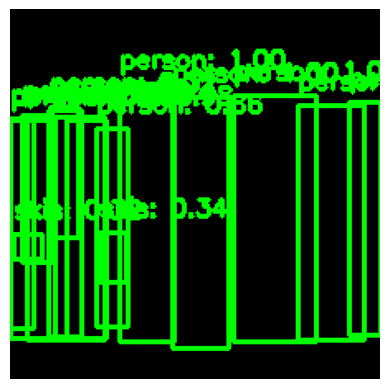

Frame 63, Label: 1, Score: 0.9994685053825378
Frame 63, Label: 1, Score: 0.999016284942627
Frame 63, Label: 1, Score: 0.9984958171844482
Frame 63, Label: 1, Score: 0.998472273349762
Frame 63, Label: 1, Score: 0.9871145486831665
Frame 63, Label: 1, Score: 0.9815489649772644
Frame 63, Label: 1, Score: 0.9750185012817383
Frame 63, Label: 1, Score: 0.9225588440895081
Frame 63, Label: 1, Score: 0.8631114959716797
Frame 63, Label: 1, Score: 0.8409168124198914
Frame 63, Label: 1, Score: 0.3961692154407501
Frame 63, Label: 1, Score: 0.3418690264225006
Frame 63, Label: 31, Score: 0.34159186482429504
Frame 63, Label: 1, Score: 0.31955814361572266
Frame 63, Label: 31, Score: 0.31766000390052795


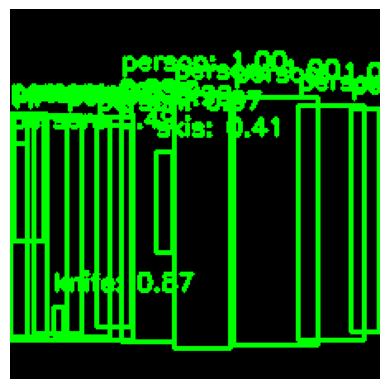

Frame 64, Label: 1, Score: 0.9995392560958862
Frame 64, Label: 1, Score: 0.9990947246551514
Frame 64, Label: 1, Score: 0.99869304895401
Frame 64, Label: 1, Score: 0.9981525540351868
Frame 64, Label: 1, Score: 0.9933345317840576
Frame 64, Label: 1, Score: 0.9932215213775635
Frame 64, Label: 1, Score: 0.9885231256484985
Frame 64, Label: 1, Score: 0.9867180585861206
Frame 64, Label: 1, Score: 0.9693433046340942
Frame 64, Label: 44, Score: 0.8704872727394104
Frame 64, Label: 1, Score: 0.486076682806015
Frame 64, Label: 31, Score: 0.41144856810569763
Frame 64, Label: 1, Score: 0.3779234290122986
Frame 64, Label: 1, Score: 0.3462764620780945


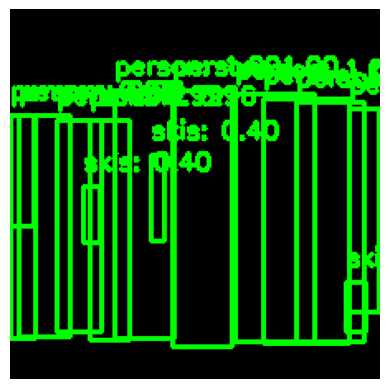

Frame 65, Label: 1, Score: 0.9994221925735474
Frame 65, Label: 1, Score: 0.9985550045967102
Frame 65, Label: 1, Score: 0.9983249306678772
Frame 65, Label: 1, Score: 0.9981358051300049
Frame 65, Label: 1, Score: 0.9949291944503784
Frame 65, Label: 1, Score: 0.9896202683448792
Frame 65, Label: 1, Score: 0.9814187288284302
Frame 65, Label: 1, Score: 0.9772567749023438
Frame 65, Label: 1, Score: 0.9551337957382202
Frame 65, Label: 1, Score: 0.6387119293212891
Frame 65, Label: 31, Score: 0.400665819644928
Frame 65, Label: 31, Score: 0.4003163278102875
Frame 65, Label: 31, Score: 0.36538630723953247
Frame 65, Label: 1, Score: 0.30612918734550476


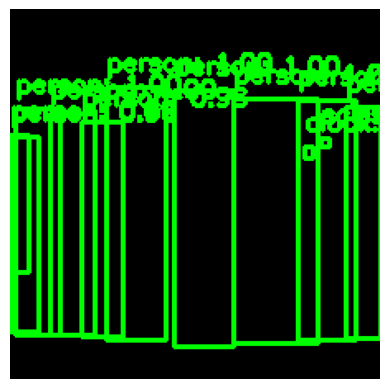

Frame 66, Label: 1, Score: 0.9991812109947205
Frame 66, Label: 1, Score: 0.9986051917076111
Frame 66, Label: 1, Score: 0.9984503984451294
Frame 66, Label: 1, Score: 0.9975546002388
Frame 66, Label: 1, Score: 0.9957193732261658
Frame 66, Label: 1, Score: 0.9954547882080078
Frame 66, Label: 1, Score: 0.9904546141624451
Frame 66, Label: 1, Score: 0.9799802303314209
Frame 66, Label: 1, Score: 0.955464243888855
Frame 66, Label: 1, Score: 0.8905729055404663
Frame 66, Label: 77, Score: 0.43143531680107117
Frame 66, Label: 75, Score: 0.3693871796131134


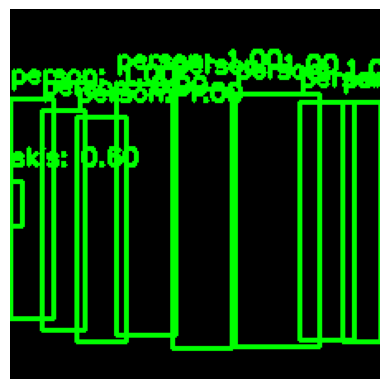

Frame 67, Label: 1, Score: 0.9991897940635681
Frame 67, Label: 1, Score: 0.9983273148536682
Frame 67, Label: 1, Score: 0.9977134466171265
Frame 67, Label: 1, Score: 0.9974071383476257
Frame 67, Label: 1, Score: 0.9961391091346741
Frame 67, Label: 1, Score: 0.9957082271575928
Frame 67, Label: 1, Score: 0.9917930960655212
Frame 67, Label: 1, Score: 0.9892892837524414
Frame 67, Label: 31, Score: 0.6031585335731506


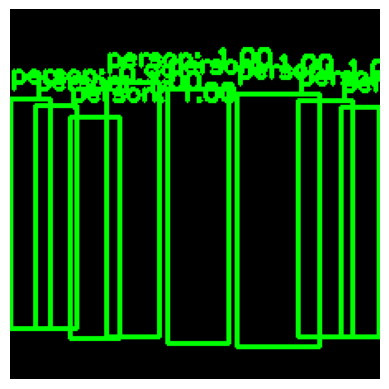

Frame 68, Label: 1, Score: 0.9991077780723572
Frame 68, Label: 1, Score: 0.9986945986747742
Frame 68, Label: 1, Score: 0.9986737966537476
Frame 68, Label: 1, Score: 0.997642457485199
Frame 68, Label: 1, Score: 0.9972975850105286
Frame 68, Label: 1, Score: 0.9970086216926575
Frame 68, Label: 1, Score: 0.995779275894165
Frame 68, Label: 1, Score: 0.9949765205383301


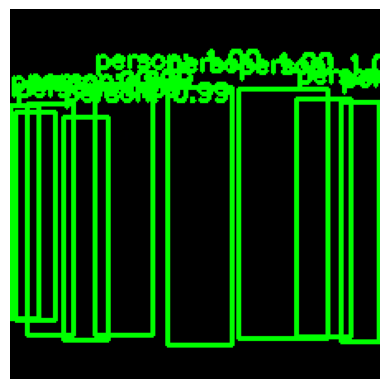

Frame 69, Label: 1, Score: 0.9987156391143799
Frame 69, Label: 1, Score: 0.9982286095619202
Frame 69, Label: 1, Score: 0.9978808760643005
Frame 69, Label: 1, Score: 0.9965920448303223
Frame 69, Label: 1, Score: 0.9953433275222778
Frame 69, Label: 1, Score: 0.9939753413200378
Frame 69, Label: 1, Score: 0.9934908151626587
Frame 69, Label: 1, Score: 0.9908889532089233
Frame 69, Label: 1, Score: 0.8919998407363892


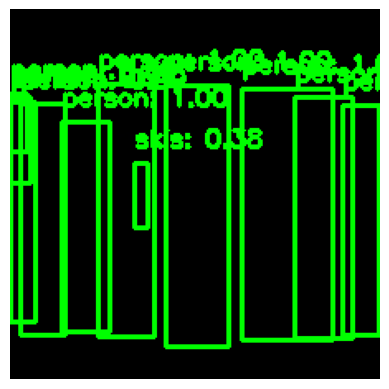

Frame 70, Label: 1, Score: 0.9986532926559448
Frame 70, Label: 1, Score: 0.9984814524650574
Frame 70, Label: 1, Score: 0.9973723888397217
Frame 70, Label: 1, Score: 0.9963157773017883
Frame 70, Label: 1, Score: 0.9957148432731628
Frame 70, Label: 1, Score: 0.9932271838188171
Frame 70, Label: 1, Score: 0.9898332357406616
Frame 70, Label: 1, Score: 0.9742323160171509
Frame 70, Label: 1, Score: 0.6022977232933044
Frame 70, Label: 1, Score: 0.42449674010276794
Frame 70, Label: 31, Score: 0.3790380656719208


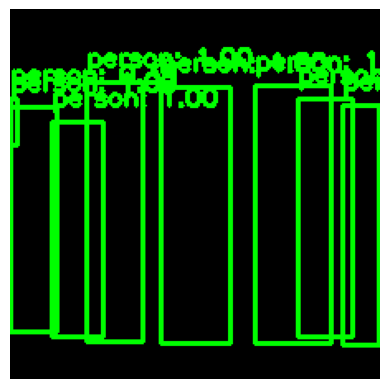

Frame 71, Label: 1, Score: 0.9990314245223999
Frame 71, Label: 1, Score: 0.9982481002807617
Frame 71, Label: 1, Score: 0.9979087114334106
Frame 71, Label: 1, Score: 0.9978825449943542
Frame 71, Label: 1, Score: 0.9950306415557861
Frame 71, Label: 1, Score: 0.9930878281593323
Frame 71, Label: 1, Score: 0.9902370572090149
Frame 71, Label: 1, Score: 0.3894118666648865


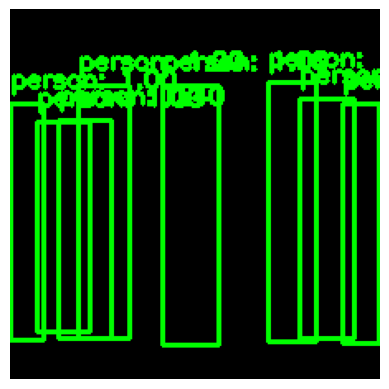

Frame 72, Label: 1, Score: 0.9992121458053589
Frame 72, Label: 1, Score: 0.9983538389205933
Frame 72, Label: 1, Score: 0.9979547262191772
Frame 72, Label: 1, Score: 0.9970561265945435
Frame 72, Label: 1, Score: 0.9963182210922241
Frame 72, Label: 1, Score: 0.9956718683242798
Frame 72, Label: 1, Score: 0.9906836748123169
Frame 72, Label: 1, Score: 0.40151429176330566


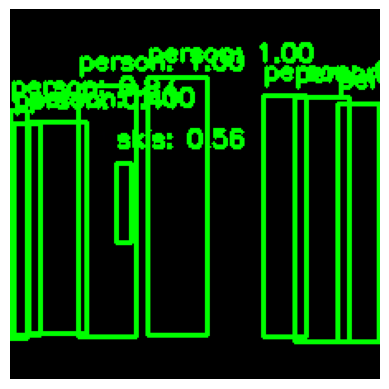

Frame 73, Label: 1, Score: 0.9993892908096313
Frame 73, Label: 1, Score: 0.9986085295677185
Frame 73, Label: 1, Score: 0.9985297918319702
Frame 73, Label: 1, Score: 0.99775630235672
Frame 73, Label: 1, Score: 0.9966578483581543
Frame 73, Label: 1, Score: 0.9954792261123657
Frame 73, Label: 1, Score: 0.9735935926437378
Frame 73, Label: 31, Score: 0.5626364350318909
Frame 73, Label: 1, Score: 0.4057824909687042


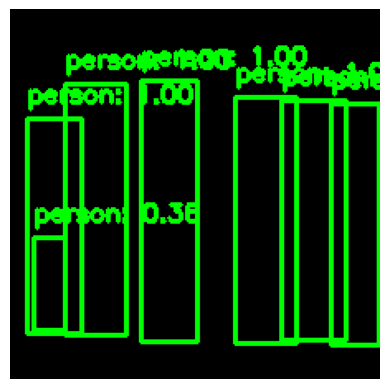

Frame 74, Label: 1, Score: 0.9994854927062988
Frame 74, Label: 1, Score: 0.9984172582626343
Frame 74, Label: 1, Score: 0.998354971408844
Frame 74, Label: 1, Score: 0.9979768395423889
Frame 74, Label: 1, Score: 0.9977128505706787
Frame 74, Label: 1, Score: 0.9972208738327026
Frame 74, Label: 1, Score: 0.3612382411956787


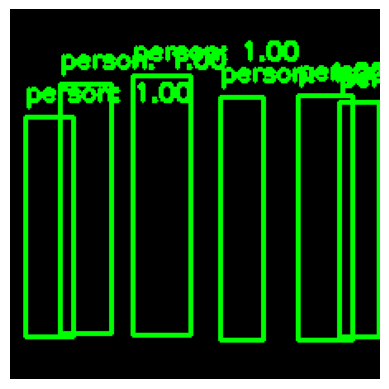

Frame 75, Label: 1, Score: 0.9992173910140991
Frame 75, Label: 1, Score: 0.9991105198860168
Frame 75, Label: 1, Score: 0.9989483952522278
Frame 75, Label: 1, Score: 0.9985489249229431
Frame 75, Label: 1, Score: 0.9966578483581543
Frame 75, Label: 1, Score: 0.9962704181671143


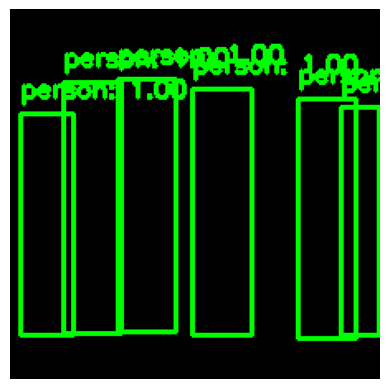

Frame 76, Label: 1, Score: 0.9993069171905518
Frame 76, Label: 1, Score: 0.9991311430931091
Frame 76, Label: 1, Score: 0.9989196062088013
Frame 76, Label: 1, Score: 0.9983515739440918
Frame 76, Label: 1, Score: 0.9959903359413147
Frame 76, Label: 1, Score: 0.9953160285949707


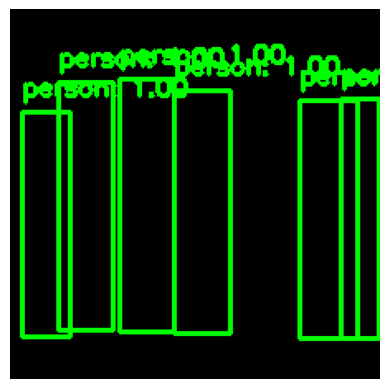

Frame 77, Label: 1, Score: 0.9992311000823975
Frame 77, Label: 1, Score: 0.9989375472068787
Frame 77, Label: 1, Score: 0.9984777569770813
Frame 77, Label: 1, Score: 0.9979329109191895
Frame 77, Label: 1, Score: 0.996357262134552
Frame 77, Label: 1, Score: 0.9916252493858337


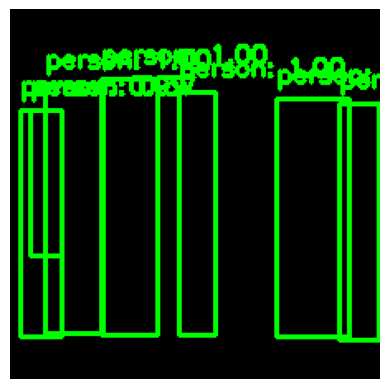

Frame 78, Label: 1, Score: 0.9996390342712402
Frame 78, Label: 1, Score: 0.9987832903862
Frame 78, Label: 1, Score: 0.9987773299217224
Frame 78, Label: 1, Score: 0.9982354640960693
Frame 78, Label: 1, Score: 0.9962480664253235
Frame 78, Label: 1, Score: 0.9852808117866516
Frame 78, Label: 1, Score: 0.3726540505886078


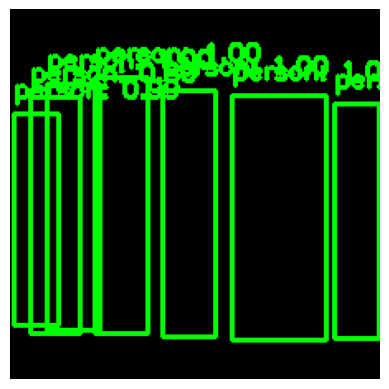

Frame 79, Label: 1, Score: 0.9997257590293884
Frame 79, Label: 1, Score: 0.99933260679245
Frame 79, Label: 1, Score: 0.9984276294708252
Frame 79, Label: 1, Score: 0.9984051585197449
Frame 79, Label: 1, Score: 0.9981346130371094
Frame 79, Label: 1, Score: 0.9933214783668518
Frame 79, Label: 1, Score: 0.7961797714233398


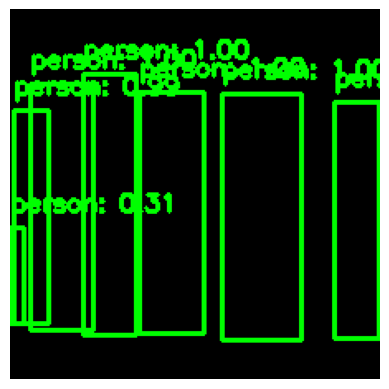

Frame 80, Label: 1, Score: 0.9997172951698303
Frame 80, Label: 1, Score: 0.9991932511329651
Frame 80, Label: 1, Score: 0.9988889098167419
Frame 80, Label: 1, Score: 0.9979400038719177
Frame 80, Label: 1, Score: 0.9964390397071838
Frame 80, Label: 1, Score: 0.9913186430931091
Frame 80, Label: 1, Score: 0.3060259521007538


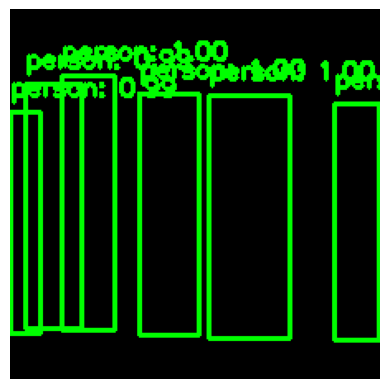

Frame 81, Label: 1, Score: 0.9994207620620728
Frame 81, Label: 1, Score: 0.9993841648101807
Frame 81, Label: 1, Score: 0.9988760352134705
Frame 81, Label: 1, Score: 0.9962375164031982
Frame 81, Label: 1, Score: 0.9948733448982239
Frame 81, Label: 1, Score: 0.9871247410774231


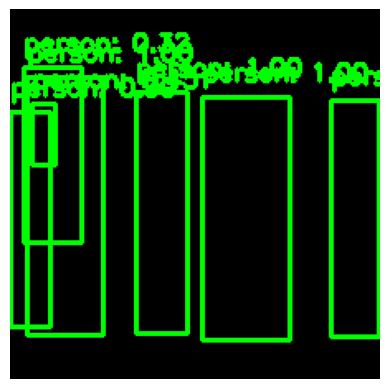

Frame 82, Label: 1, Score: 0.9998522996902466
Frame 82, Label: 1, Score: 0.9992967844009399
Frame 82, Label: 1, Score: 0.998596727848053
Frame 82, Label: 1, Score: 0.9964052438735962
Frame 82, Label: 1, Score: 0.9933552742004395
Frame 82, Label: 1, Score: 0.4499551057815552
Frame 82, Label: 1, Score: 0.32243698835372925


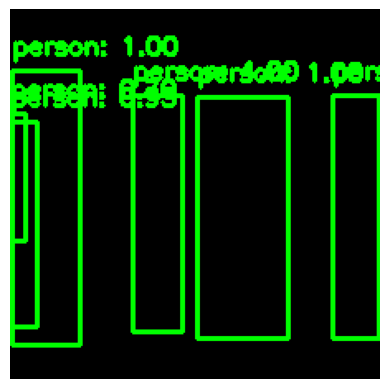

Frame 83, Label: 1, Score: 0.9998270869255066
Frame 83, Label: 1, Score: 0.999009370803833
Frame 83, Label: 1, Score: 0.998399555683136
Frame 83, Label: 1, Score: 0.9983394145965576
Frame 83, Label: 1, Score: 0.9479157328605652
Frame 83, Label: 1, Score: 0.6963752508163452


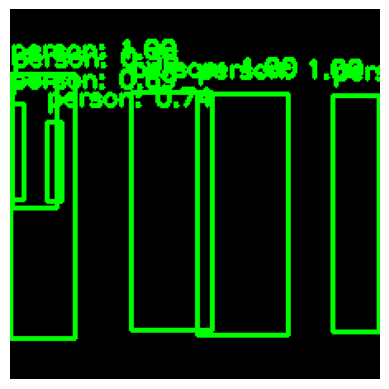

Frame 84, Label: 1, Score: 0.9997565150260925
Frame 84, Label: 1, Score: 0.99944669008255
Frame 84, Label: 1, Score: 0.9975379705429077
Frame 84, Label: 1, Score: 0.9971979856491089
Frame 84, Label: 1, Score: 0.7367687821388245
Frame 84, Label: 1, Score: 0.6870261430740356
Frame 84, Label: 1, Score: 0.35525912046432495


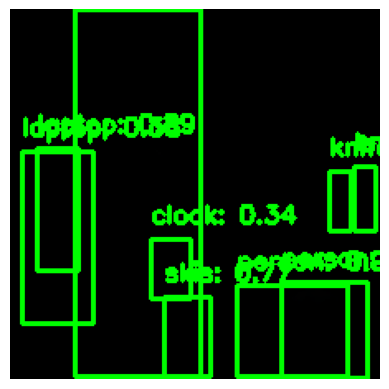

Frame 85, Label: 1, Score: 0.9905783534049988
Frame 85, Label: 1, Score: 0.9328537583351135
Frame 85, Label: 44, Score: 0.9057347178459167
Frame 85, Label: 64, Score: 0.8862859606742859
Frame 85, Label: 31, Score: 0.765813410282135
Frame 85, Label: 1, Score: 0.6374151110649109
Frame 85, Label: 44, Score: 0.4190952479839325
Frame 85, Label: 64, Score: 0.37575381994247437
Frame 85, Label: 75, Score: 0.33764153718948364


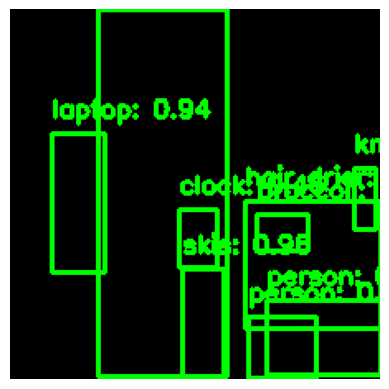

Frame 86, Label: 1, Score: 0.9982409477233887
Frame 86, Label: 31, Score: 0.963793933391571
Frame 86, Label: 1, Score: 0.9449512362480164
Frame 86, Label: 64, Score: 0.9435451626777649
Frame 86, Label: 44, Score: 0.8064132332801819
Frame 86, Label: 1, Score: 0.6697988510131836
Frame 86, Label: 79, Score: 0.6205611824989319
Frame 86, Label: 75, Score: 0.46207600831985474
Frame 86, Label: 51, Score: 0.4376091957092285


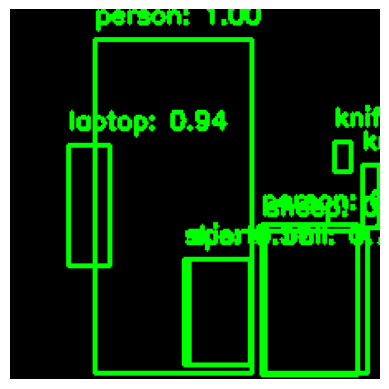

Frame 87, Label: 1, Score: 0.9974385499954224
Frame 87, Label: 64, Score: 0.9409956932067871
Frame 87, Label: 44, Score: 0.8802437782287598
Frame 87, Label: 33, Score: 0.7890682220458984
Frame 87, Label: 19, Score: 0.7456753253936768
Frame 87, Label: 1, Score: 0.6733495593070984
Frame 87, Label: 31, Score: 0.5698044896125793
Frame 87, Label: 44, Score: 0.4450545907020569


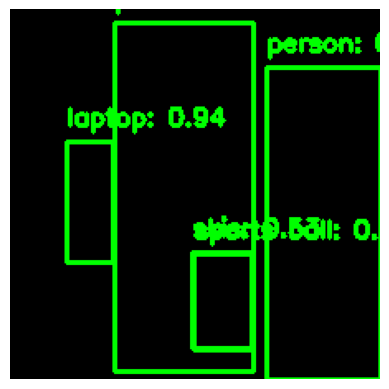

Frame 88, Label: 1, Score: 0.9952372312545776
Frame 88, Label: 1, Score: 0.9817075729370117
Frame 88, Label: 64, Score: 0.9408650398254395
Frame 88, Label: 33, Score: 0.7870491743087769
Frame 88, Label: 31, Score: 0.5266498923301697


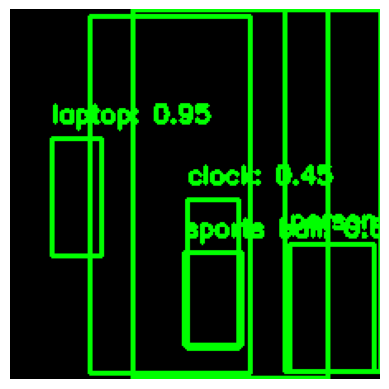

Frame 89, Label: 1, Score: 0.9973728656768799
Frame 89, Label: 1, Score: 0.9954800605773926
Frame 89, Label: 64, Score: 0.9480734467506409
Frame 89, Label: 33, Score: 0.6391404271125793
Frame 89, Label: 75, Score: 0.4468080699443817
Frame 89, Label: 1, Score: 0.3591887354850769
Frame 89, Label: 1, Score: 0.35836347937583923


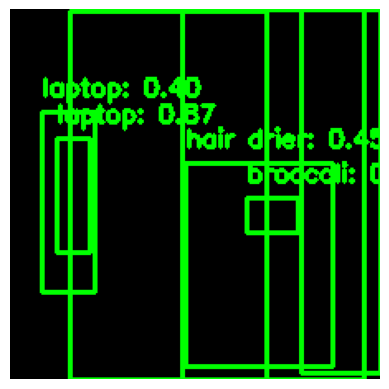

Frame 90, Label: 1, Score: 0.9967142343521118
Frame 90, Label: 1, Score: 0.9923847913742065
Frame 90, Label: 64, Score: 0.866737961769104
Frame 90, Label: 51, Score: 0.4740537106990814
Frame 90, Label: 79, Score: 0.4541594386100769
Frame 90, Label: 64, Score: 0.4045793116092682
Frame 90, Label: 1, Score: 0.3169860243797302


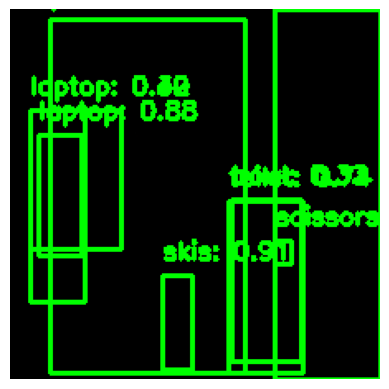

Frame 91, Label: 1, Score: 0.9976346492767334
Frame 91, Label: 1, Score: 0.9911649823188782
Frame 91, Label: 31, Score: 0.9105119109153748
Frame 91, Label: 64, Score: 0.8829835653305054
Frame 91, Label: 62, Score: 0.736321747303009
Frame 91, Label: 77, Score: 0.6653086543083191
Frame 91, Label: 64, Score: 0.39902427792549133
Frame 91, Label: 46, Score: 0.329765260219574
Frame 91, Label: 64, Score: 0.3224649429321289


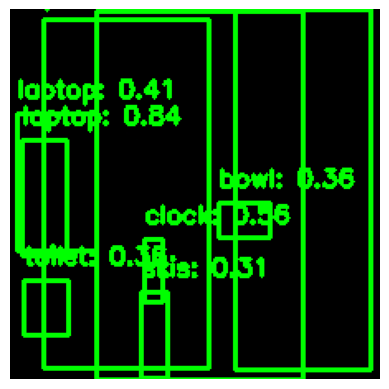

Frame 92, Label: 1, Score: 0.9946739673614502
Frame 92, Label: 1, Score: 0.9939861297607422
Frame 92, Label: 1, Score: 0.8422753810882568
Frame 92, Label: 64, Score: 0.8364459872245789
Frame 92, Label: 75, Score: 0.5639008283615112
Frame 92, Label: 64, Score: 0.41365814208984375
Frame 92, Label: 62, Score: 0.36059507727622986
Frame 92, Label: 46, Score: 0.35873833298683167
Frame 92, Label: 31, Score: 0.3073606491088867


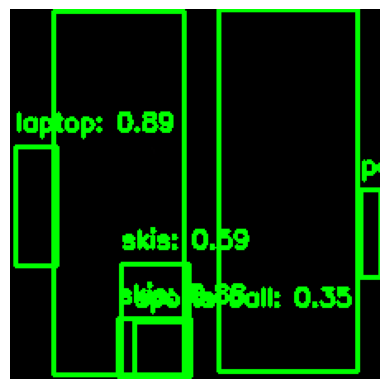

Frame 93, Label: 1, Score: 0.9979233145713806
Frame 93, Label: 1, Score: 0.9971006512641907
Frame 93, Label: 64, Score: 0.8890876770019531
Frame 93, Label: 31, Score: 0.8840009570121765
Frame 93, Label: 31, Score: 0.587384819984436
Frame 93, Label: 1, Score: 0.44855165481567383
Frame 93, Label: 33, Score: 0.34889647364616394


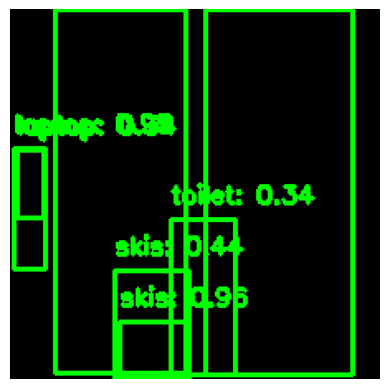

Frame 94, Label: 1, Score: 0.9977537989616394
Frame 94, Label: 1, Score: 0.9908384680747986
Frame 94, Label: 31, Score: 0.9580132961273193
Frame 94, Label: 64, Score: 0.952409565448761
Frame 94, Label: 31, Score: 0.43508806824684143
Frame 94, Label: 64, Score: 0.3389540910720825
Frame 94, Label: 62, Score: 0.3362122178077698


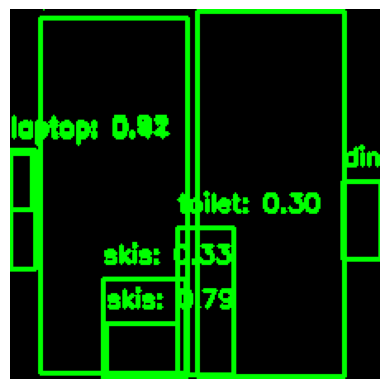

Frame 95, Label: 1, Score: 0.9961925745010376
Frame 95, Label: 1, Score: 0.9871624112129211
Frame 95, Label: 64, Score: 0.9236404895782471
Frame 95, Label: 31, Score: 0.786602795124054
Frame 95, Label: 64, Score: 0.4081936180591583
Frame 95, Label: 61, Score: 0.36612966656684875
Frame 95, Label: 31, Score: 0.3336130678653717
Frame 95, Label: 62, Score: 0.30083024501800537


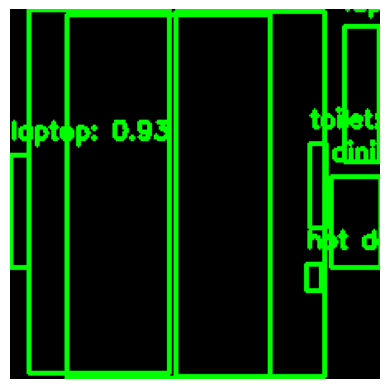

Frame 96, Label: 1, Score: 0.9971539974212646
Frame 96, Label: 1, Score: 0.9965846538543701
Frame 96, Label: 64, Score: 0.9315342903137207
Frame 96, Label: 1, Score: 0.9041843414306641
Frame 96, Label: 61, Score: 0.6431494355201721
Frame 96, Label: 64, Score: 0.616197943687439
Frame 96, Label: 53, Score: 0.4771895110607147
Frame 96, Label: 62, Score: 0.35847872495651245


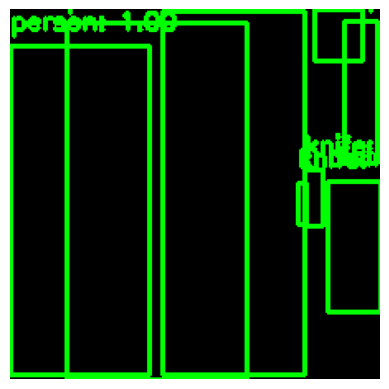

Frame 97, Label: 1, Score: 0.9983855485916138
Frame 97, Label: 1, Score: 0.9962118864059448
Frame 97, Label: 61, Score: 0.7009540796279907
Frame 97, Label: 64, Score: 0.6664237380027771
Frame 97, Label: 44, Score: 0.6255006790161133
Frame 97, Label: 44, Score: 0.6194419860839844
Frame 97, Label: 64, Score: 0.5997164845466614
Frame 97, Label: 1, Score: 0.31722140312194824


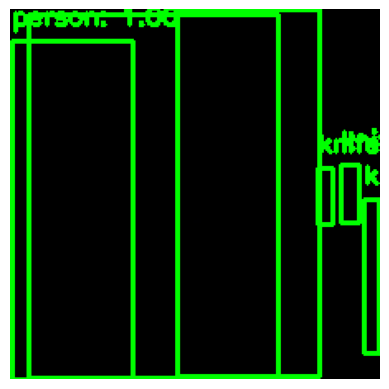

Frame 98, Label: 1, Score: 0.999140739440918
Frame 98, Label: 1, Score: 0.9954075217247009
Frame 98, Label: 44, Score: 0.7256436347961426
Frame 98, Label: 1, Score: 0.6227570176124573
Frame 98, Label: 44, Score: 0.5826117396354675
Frame 98, Label: 44, Score: 0.3538074791431427


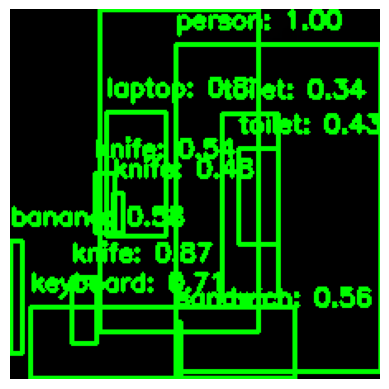

Frame 99, Label: 1, Score: 0.996762752532959
Frame 99, Label: 1, Score: 0.9956667423248291
Frame 99, Label: 44, Score: 0.8682259321212769
Frame 99, Label: 64, Score: 0.8076874613761902
Frame 99, Label: 67, Score: 0.7091356515884399
Frame 99, Label: 47, Score: 0.5834486484527588
Frame 99, Label: 49, Score: 0.5581575036048889
Frame 99, Label: 44, Score: 0.5414420962333679
Frame 99, Label: 44, Score: 0.47964826226234436
Frame 99, Label: 62, Score: 0.4292619824409485
Frame 99, Label: 62, Score: 0.3422437608242035


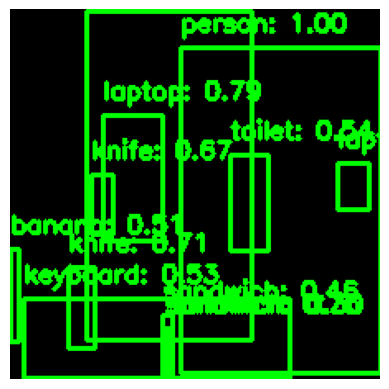

Frame 100, Label: 1, Score: 0.9973822236061096
Frame 100, Label: 1, Score: 0.99644935131073
Frame 100, Label: 64, Score: 0.8002254962921143
Frame 100, Label: 64, Score: 0.7914910912513733
Frame 100, Label: 49, Score: 0.7491739392280579
Frame 100, Label: 44, Score: 0.7131850719451904
Frame 100, Label: 44, Score: 0.6703318357467651
Frame 100, Label: 62, Score: 0.541158139705658
Frame 100, Label: 67, Score: 0.5319761633872986
Frame 100, Label: 47, Score: 0.5051593780517578
Frame 100, Label: 49, Score: 0.458408921957016
Frame 100, Label: 49, Score: 0.30067580938339233


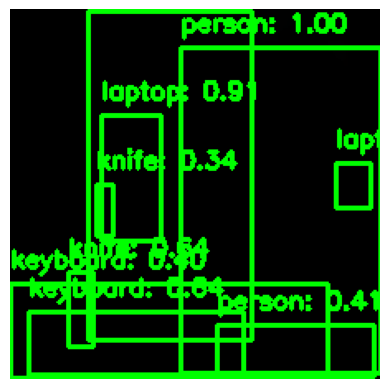

Frame 101, Label: 1, Score: 0.9968079924583435
Frame 101, Label: 1, Score: 0.9965512752532959
Frame 101, Label: 64, Score: 0.9054774045944214
Frame 101, Label: 64, Score: 0.859152615070343
Frame 101, Label: 67, Score: 0.6433870196342468
Frame 101, Label: 44, Score: 0.6420090198516846
Frame 101, Label: 1, Score: 0.4104427993297577
Frame 101, Label: 67, Score: 0.4019120931625366
Frame 101, Label: 44, Score: 0.33667218685150146


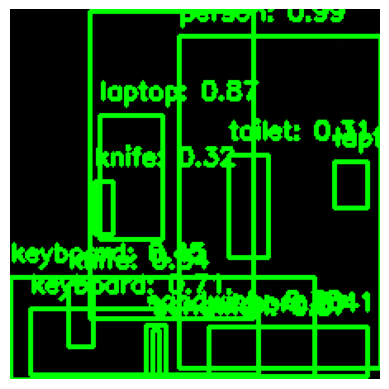

Frame 102, Label: 1, Score: 0.9969590902328491
Frame 102, Label: 1, Score: 0.9917334318161011
Frame 102, Label: 64, Score: 0.9062720537185669
Frame 102, Label: 64, Score: 0.8749596476554871
Frame 102, Label: 44, Score: 0.8396700024604797
Frame 102, Label: 67, Score: 0.7054206728935242
Frame 102, Label: 49, Score: 0.5704156756401062
Frame 102, Label: 67, Score: 0.4472511410713196
Frame 102, Label: 1, Score: 0.41230595111846924
Frame 102, Label: 49, Score: 0.3625965416431427
Frame 102, Label: 44, Score: 0.3197968900203705
Frame 102, Label: 62, Score: 0.31271448731422424


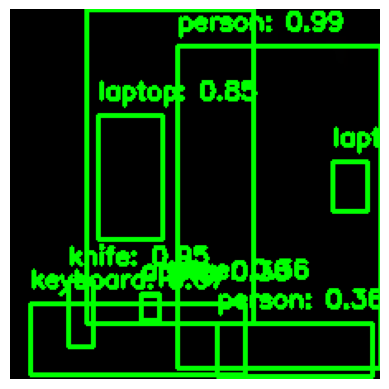

Frame 103, Label: 1, Score: 0.9983698725700378
Frame 103, Label: 1, Score: 0.9920471906661987
Frame 103, Label: 44, Score: 0.9507068991661072
Frame 103, Label: 64, Score: 0.9313837289810181
Frame 103, Label: 64, Score: 0.8455075621604919
Frame 103, Label: 67, Score: 0.6746764779090881
Frame 103, Label: 50, Score: 0.36483341455459595
Frame 103, Label: 1, Score: 0.3621642291545868
Frame 103, Label: 48, Score: 0.3585386276245117


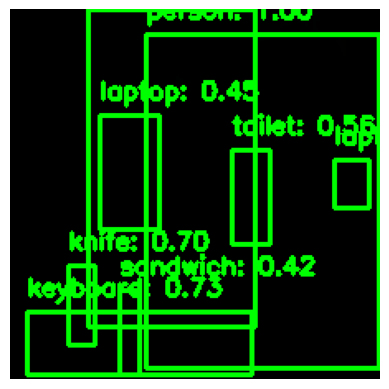

Frame 104, Label: 1, Score: 0.9968210458755493
Frame 104, Label: 1, Score: 0.9949394464492798
Frame 104, Label: 64, Score: 0.9182071089744568
Frame 104, Label: 67, Score: 0.7270376086235046
Frame 104, Label: 44, Score: 0.7010350823402405
Frame 104, Label: 62, Score: 0.556157648563385
Frame 104, Label: 64, Score: 0.4509369730949402
Frame 104, Label: 49, Score: 0.42493975162506104


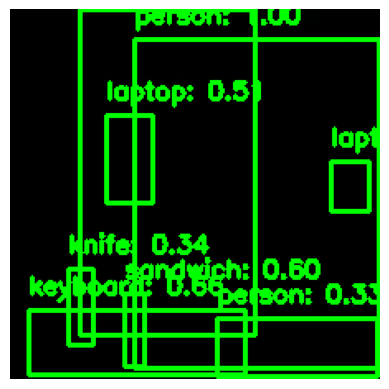

Frame 105, Label: 1, Score: 0.9968085885047913
Frame 105, Label: 1, Score: 0.9966300129890442
Frame 105, Label: 64, Score: 0.8764215111732483
Frame 105, Label: 67, Score: 0.663619339466095
Frame 105, Label: 49, Score: 0.6012476086616516
Frame 105, Label: 64, Score: 0.5099655985832214
Frame 105, Label: 44, Score: 0.337667852640152
Frame 105, Label: 1, Score: 0.33189746737480164


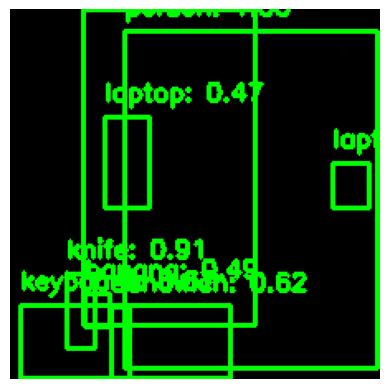

Frame 106, Label: 1, Score: 0.9968967437744141
Frame 106, Label: 1, Score: 0.996877908706665
Frame 106, Label: 44, Score: 0.906372606754303
Frame 106, Label: 64, Score: 0.832604169845581
Frame 106, Label: 67, Score: 0.6689841747283936
Frame 106, Label: 49, Score: 0.6171858906745911
Frame 106, Label: 47, Score: 0.4912683963775635
Frame 106, Label: 64, Score: 0.46546483039855957


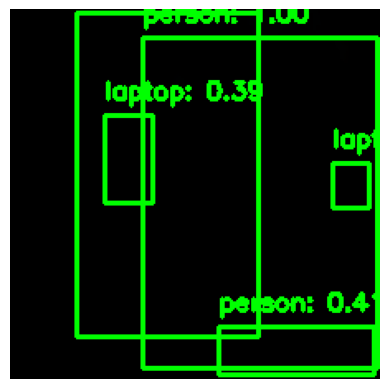

Frame 107, Label: 1, Score: 0.9964260458946228
Frame 107, Label: 1, Score: 0.9958468079566956
Frame 107, Label: 64, Score: 0.6513999104499817
Frame 107, Label: 1, Score: 0.41097891330718994
Frame 107, Label: 64, Score: 0.3897177577018738


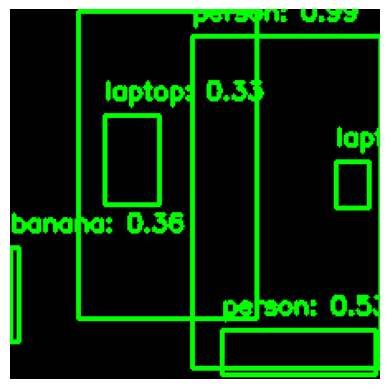

Frame 108, Label: 1, Score: 0.9939132332801819
Frame 108, Label: 1, Score: 0.9910475611686707
Frame 108, Label: 64, Score: 0.8199818134307861
Frame 108, Label: 1, Score: 0.5267732739448547
Frame 108, Label: 47, Score: 0.3550432026386261
Frame 108, Label: 64, Score: 0.3306215703487396


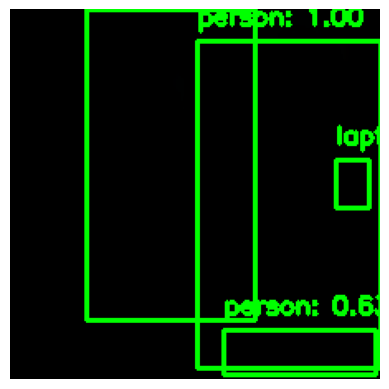

Frame 109, Label: 1, Score: 0.9950939416885376
Frame 109, Label: 1, Score: 0.98784339427948
Frame 109, Label: 64, Score: 0.8521924018859863
Frame 109, Label: 1, Score: 0.6315032839775085


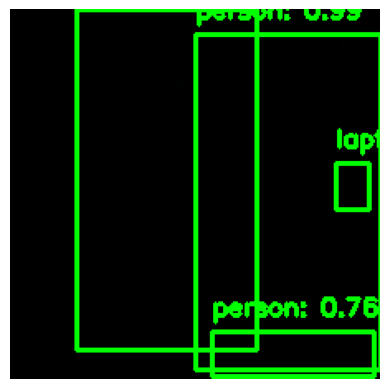

Frame 110, Label: 1, Score: 0.9945390820503235
Frame 110, Label: 1, Score: 0.9773903489112854
Frame 110, Label: 1, Score: 0.7641489505767822
Frame 110, Label: 64, Score: 0.6762796640396118


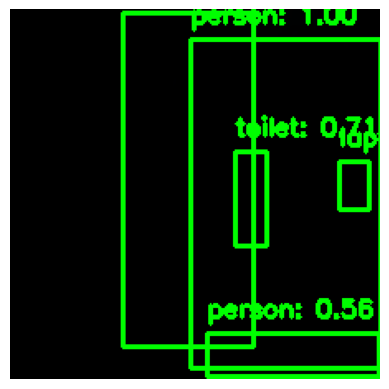

Frame 111, Label: 1, Score: 0.9960848093032837
Frame 111, Label: 1, Score: 0.9831249713897705
Frame 111, Label: 64, Score: 0.7297099232673645
Frame 111, Label: 62, Score: 0.7089681029319763
Frame 111, Label: 1, Score: 0.5620328783988953


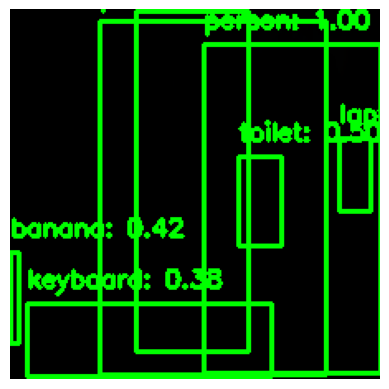

Frame 112, Label: 1, Score: 0.9961280822753906
Frame 112, Label: 1, Score: 0.9821531176567078
Frame 112, Label: 1, Score: 0.6821837425231934
Frame 112, Label: 64, Score: 0.5414379239082336
Frame 112, Label: 62, Score: 0.502099335193634
Frame 112, Label: 47, Score: 0.4211551249027252
Frame 112, Label: 67, Score: 0.3787406384944916


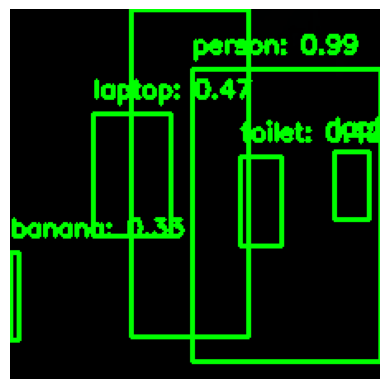

Frame 113, Label: 1, Score: 0.9867802262306213
Frame 113, Label: 1, Score: 0.9859719276428223
Frame 113, Label: 64, Score: 0.6933497190475464
Frame 113, Label: 64, Score: 0.4667426645755768
Frame 113, Label: 62, Score: 0.4169948399066925
Frame 113, Label: 47, Score: 0.3315034508705139


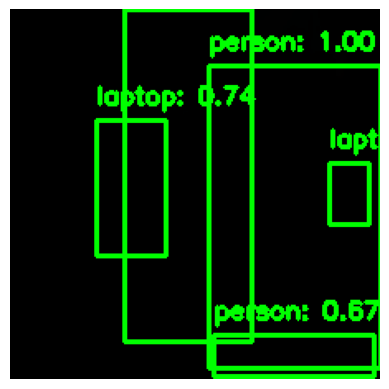

Frame 114, Label: 1, Score: 0.9954332113265991
Frame 114, Label: 1, Score: 0.9948040843009949
Frame 114, Label: 64, Score: 0.8372482657432556
Frame 114, Label: 64, Score: 0.7421834468841553
Frame 114, Label: 1, Score: 0.6668955087661743


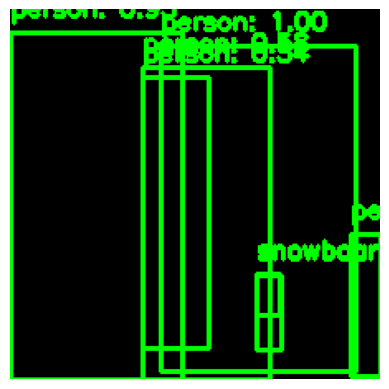

Frame 115, Label: 1, Score: 0.9985023736953735
Frame 115, Label: 1, Score: 0.9500299692153931
Frame 115, Label: 1, Score: 0.9353772401809692
Frame 115, Label: 32, Score: 0.7098021507263184
Frame 115, Label: 1, Score: 0.5773135423660278
Frame 115, Label: 1, Score: 0.537773072719574
Frame 115, Label: 32, Score: 0.3296087086200714


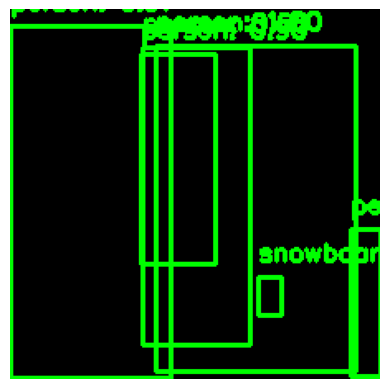

Frame 116, Label: 1, Score: 0.9986816048622131
Frame 116, Label: 1, Score: 0.9724076986312866
Frame 116, Label: 1, Score: 0.9053533673286438
Frame 116, Label: 1, Score: 0.9028929471969604
Frame 116, Label: 1, Score: 0.5981947779655457
Frame 116, Label: 32, Score: 0.5641797184944153


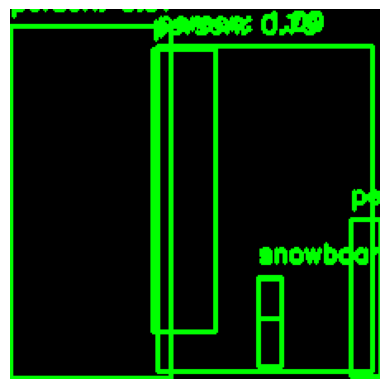

Frame 117, Label: 1, Score: 0.9979779124259949
Frame 117, Label: 1, Score: 0.972082257270813
Frame 117, Label: 1, Score: 0.8763964176177979
Frame 117, Label: 1, Score: 0.7947213649749756
Frame 117, Label: 32, Score: 0.5096251964569092
Frame 117, Label: 32, Score: 0.30710041522979736


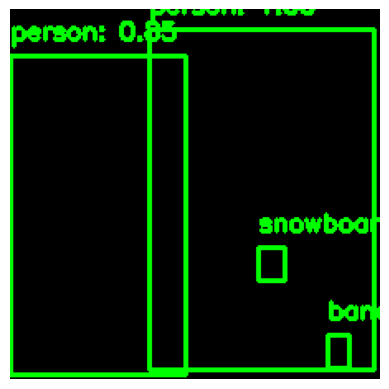

Frame 118, Label: 1, Score: 0.9974403381347656
Frame 118, Label: 1, Score: 0.8521225452423096
Frame 118, Label: 32, Score: 0.6862227320671082
Frame 118, Label: 47, Score: 0.3710041642189026


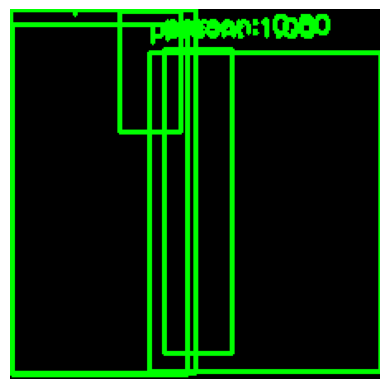

Frame 119, Label: 1, Score: 0.9962265491485596
Frame 119, Label: 1, Score: 0.7322611212730408
Frame 119, Label: 1, Score: 0.6513808369636536
Frame 119, Label: 1, Score: 0.5986209511756897
Frame 119, Label: 19, Score: 0.32920587062835693


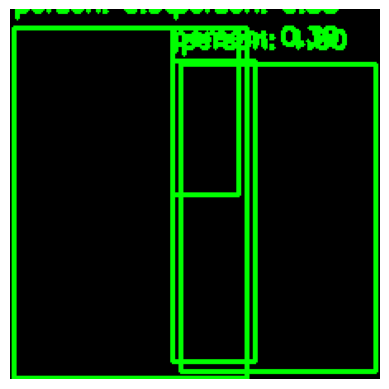

Frame 120, Label: 1, Score: 0.9960067868232727
Frame 120, Label: 1, Score: 0.9010694622993469
Frame 120, Label: 1, Score: 0.881198525428772
Frame 120, Label: 1, Score: 0.30077284574508667


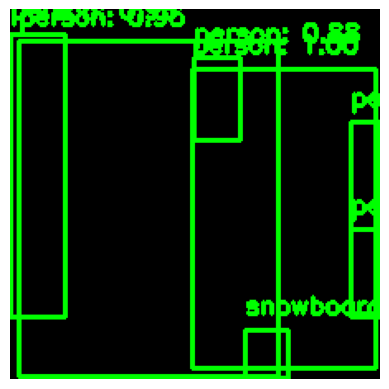

Frame 121, Label: 1, Score: 0.9950364232063293
Frame 121, Label: 1, Score: 0.9627538323402405
Frame 121, Label: 1, Score: 0.945633053779602
Frame 121, Label: 1, Score: 0.8784093260765076
Frame 121, Label: 1, Score: 0.7512686848640442
Frame 121, Label: 1, Score: 0.5585330724716187
Frame 121, Label: 32, Score: 0.3899631202220917


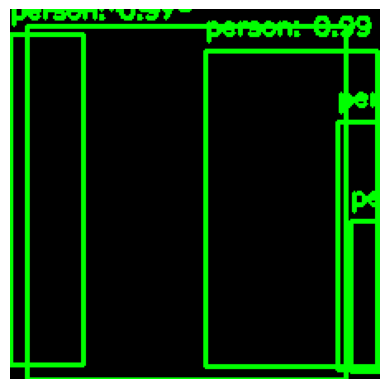

Frame 122, Label: 1, Score: 0.9874985814094543
Frame 122, Label: 1, Score: 0.9718186259269714
Frame 122, Label: 1, Score: 0.9321744441986084
Frame 122, Label: 1, Score: 0.46813517808914185
Frame 122, Label: 1, Score: 0.41095420718193054


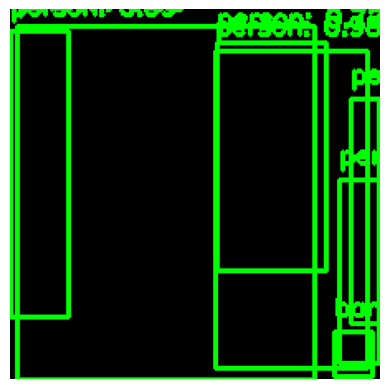

Frame 123, Label: 1, Score: 0.9870998859405518
Frame 123, Label: 1, Score: 0.9842016100883484
Frame 123, Label: 1, Score: 0.9195575714111328
Frame 123, Label: 1, Score: 0.7798662781715393
Frame 123, Label: 1, Score: 0.7197402119636536
Frame 123, Label: 47, Score: 0.5612589120864868
Frame 123, Label: 1, Score: 0.3160618841648102


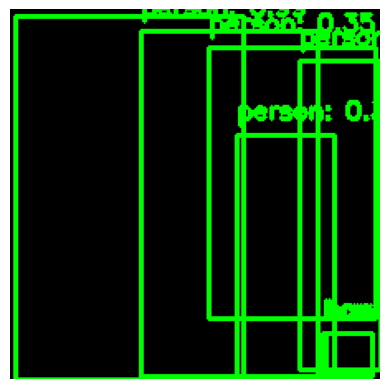

Frame 124, Label: 1, Score: 0.9930329322814941
Frame 124, Label: 1, Score: 0.9898437261581421
Frame 124, Label: 1, Score: 0.9286341667175293
Frame 124, Label: 47, Score: 0.7346490621566772
Frame 124, Label: 46, Score: 0.3807760179042816
Frame 124, Label: 1, Score: 0.3609432578086853
Frame 124, Label: 1, Score: 0.3465122580528259


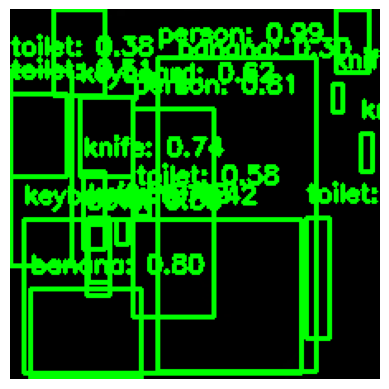

Frame 125, Label: 1, Score: 0.9899176955223083
Frame 125, Label: 64, Score: 0.947645366191864
Frame 125, Label: 62, Score: 0.8819822072982788
Frame 125, Label: 1, Score: 0.806206464767456
Frame 125, Label: 47, Score: 0.8003441095352173
Frame 125, Label: 67, Score: 0.7597063779830933
Frame 125, Label: 44, Score: 0.7352889776229858
Frame 125, Label: 67, Score: 0.6219398379325867
Frame 125, Label: 62, Score: 0.5750202536582947
Frame 125, Label: 46, Score: 0.5493278503417969
Frame 125, Label: 62, Score: 0.5132384300231934
Frame 125, Label: 44, Score: 0.44341784715652466
Frame 125, Label: 44, Score: 0.41913607716560364
Frame 125, Label: 44, Score: 0.4170033633708954
Frame 125, Label: 62, Score: 0.3845229148864746
Frame 125, Label: 44, Score: 0.37464019656181335
Frame 125, Label: 64, Score: 0.3506411910057068
Frame 125, Label: 47, Score: 0.300843209028244


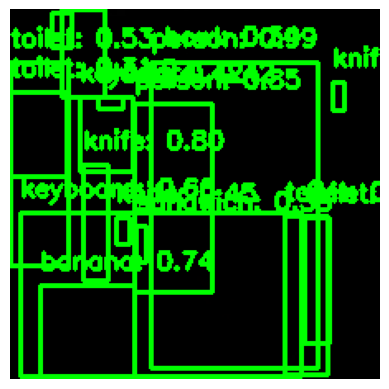

Frame 126, Label: 1, Score: 0.9904453754425049
Frame 126, Label: 64, Score: 0.882684588432312
Frame 126, Label: 1, Score: 0.8546043038368225
Frame 126, Label: 62, Score: 0.8402316570281982
Frame 126, Label: 44, Score: 0.7992373108863831
Frame 126, Label: 47, Score: 0.7388591170310974
Frame 126, Label: 67, Score: 0.6595335006713867
Frame 126, Label: 64, Score: 0.646601676940918
Frame 126, Label: 62, Score: 0.5269263386726379
Frame 126, Label: 44, Score: 0.5224897265434265
Frame 126, Label: 44, Score: 0.4540872871875763
Frame 126, Label: 62, Score: 0.4352552890777588
Frame 126, Label: 67, Score: 0.42281848192214966
Frame 126, Label: 75, Score: 0.41994965076446533
Frame 126, Label: 46, Score: 0.33721378445625305
Frame 126, Label: 49, Score: 0.3274834454059601
Frame 126, Label: 62, Score: 0.3064505457878113


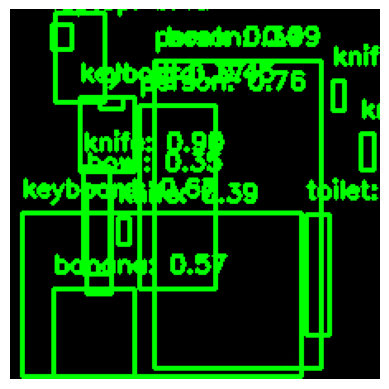

Frame 127, Label: 1, Score: 0.9901796579360962
Frame 127, Label: 64, Score: 0.9245184659957886
Frame 127, Label: 44, Score: 0.8956848382949829
Frame 127, Label: 1, Score: 0.7636805772781372
Frame 127, Label: 67, Score: 0.6693694591522217
Frame 127, Label: 47, Score: 0.5700808763504028
Frame 127, Label: 44, Score: 0.4927726686000824
Frame 127, Label: 64, Score: 0.4754422605037689
Frame 127, Label: 67, Score: 0.44583606719970703
Frame 127, Label: 62, Score: 0.4196646511554718
Frame 127, Label: 44, Score: 0.39713865518569946
Frame 127, Label: 44, Score: 0.39320307970046997
Frame 127, Label: 75, Score: 0.373235821723938
Frame 127, Label: 46, Score: 0.34935784339904785
Frame 127, Label: 46, Score: 0.3383444845676422


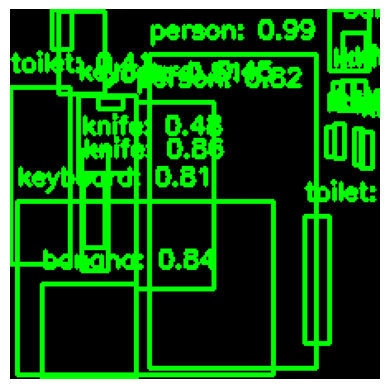

Frame 128, Label: 1, Score: 0.9925622344017029
Frame 128, Label: 64, Score: 0.9320736527442932
Frame 128, Label: 44, Score: 0.8599387407302856
Frame 128, Label: 47, Score: 0.8436680436134338
Frame 128, Label: 1, Score: 0.8207910060882568
Frame 128, Label: 67, Score: 0.8066734075546265
Frame 128, Label: 62, Score: 0.7787638902664185
Frame 128, Label: 44, Score: 0.511786699295044
Frame 128, Label: 75, Score: 0.5116992592811584
Frame 128, Label: 64, Score: 0.48263198137283325
Frame 128, Label: 44, Score: 0.48063763976097107
Frame 128, Label: 67, Score: 0.4513064920902252
Frame 128, Label: 64, Score: 0.44139379262924194
Frame 128, Label: 62, Score: 0.4099512994289398
Frame 128, Label: 44, Score: 0.4028932452201843
Frame 128, Label: 44, Score: 0.3827912211418152
Frame 128, Label: 44, Score: 0.35221341252326965
Frame 128, Label: 47, Score: 0.3384301960468292
Frame 128, Label: 44, Score: 0.31680524349212646
Frame 128, Label: 44, Score: 0.3102511763572693
Frame 128, Label: 44, Score: 0.3083721

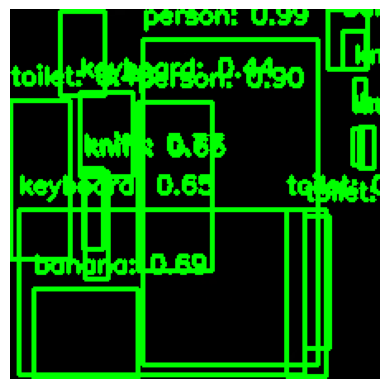

Frame 129, Label: 1, Score: 0.9871984124183655
Frame 129, Label: 64, Score: 0.9639672636985779
Frame 129, Label: 1, Score: 0.8975996971130371
Frame 129, Label: 62, Score: 0.8866896629333496
Frame 129, Label: 44, Score: 0.7704543471336365
Frame 129, Label: 47, Score: 0.6868317127227783
Frame 129, Label: 44, Score: 0.6771820783615112
Frame 129, Label: 67, Score: 0.6450443267822266
Frame 129, Label: 44, Score: 0.6293939352035522
Frame 129, Label: 62, Score: 0.6081477403640747
Frame 129, Label: 67, Score: 0.4394364356994629
Frame 129, Label: 62, Score: 0.40466320514678955
Frame 129, Label: 64, Score: 0.3736768066883087
Frame 129, Label: 44, Score: 0.3656460642814636
Frame 129, Label: 47, Score: 0.3517385423183441
Frame 129, Label: 44, Score: 0.34417030215263367


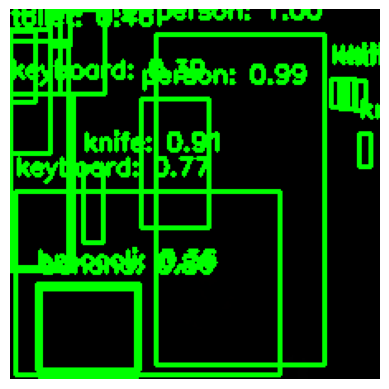

Frame 130, Label: 1, Score: 0.9956313371658325
Frame 130, Label: 1, Score: 0.9942103624343872
Frame 130, Label: 64, Score: 0.9588487148284912
Frame 130, Label: 44, Score: 0.9078161716461182
Frame 130, Label: 47, Score: 0.8583614230155945
Frame 130, Label: 67, Score: 0.7687575817108154
Frame 130, Label: 62, Score: 0.6573930978775024
Frame 130, Label: 64, Score: 0.6024335622787476
Frame 130, Label: 44, Score: 0.5243027210235596
Frame 130, Label: 44, Score: 0.5029703974723816
Frame 130, Label: 62, Score: 0.4580356478691101
Frame 130, Label: 62, Score: 0.4502301514148712
Frame 130, Label: 44, Score: 0.4216665029525757
Frame 130, Label: 67, Score: 0.38800278306007385
Frame 130, Label: 44, Score: 0.37758171558380127
Frame 130, Label: 44, Score: 0.3718324899673462
Frame 130, Label: 51, Score: 0.362980455160141


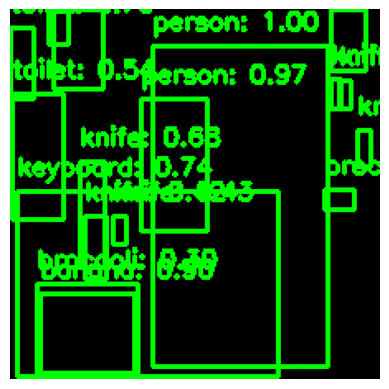

Frame 131, Label: 1, Score: 0.9972286820411682
Frame 131, Label: 1, Score: 0.9718466401100159
Frame 131, Label: 64, Score: 0.9550861716270447
Frame 131, Label: 47, Score: 0.9017143249511719
Frame 131, Label: 67, Score: 0.7436410784721375
Frame 131, Label: 62, Score: 0.6982761025428772
Frame 131, Label: 64, Score: 0.6838961839675903
Frame 131, Label: 44, Score: 0.6805493235588074
Frame 131, Label: 44, Score: 0.5801463723182678
Frame 131, Label: 64, Score: 0.5542943477630615
Frame 131, Label: 62, Score: 0.5432223677635193
Frame 131, Label: 44, Score: 0.4626650810241699
Frame 131, Label: 51, Score: 0.4603549838066101
Frame 131, Label: 44, Score: 0.42852768301963806
Frame 131, Label: 44, Score: 0.4165339171886444
Frame 131, Label: 51, Score: 0.3028835654258728
Frame 131, Label: 44, Score: 0.3005818724632263


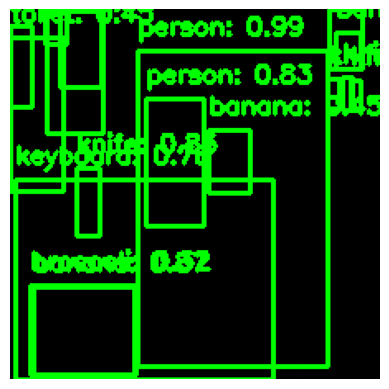

Frame 132, Label: 1, Score: 0.9855689406394958
Frame 132, Label: 64, Score: 0.9624987840652466
Frame 132, Label: 47, Score: 0.8725021481513977
Frame 132, Label: 44, Score: 0.8493915796279907
Frame 132, Label: 1, Score: 0.8339249491691589
Frame 132, Label: 44, Score: 0.7942211031913757
Frame 132, Label: 67, Score: 0.7834045886993408
Frame 132, Label: 64, Score: 0.6371069550514221
Frame 132, Label: 62, Score: 0.45244407653808594
Frame 132, Label: 47, Score: 0.44863682985305786
Frame 132, Label: 44, Score: 0.4155122935771942
Frame 132, Label: 64, Score: 0.3670834004878998
Frame 132, Label: 47, Score: 0.3668489158153534
Frame 132, Label: 44, Score: 0.3324466347694397
Frame 132, Label: 51, Score: 0.3243473172187805
Frame 132, Label: 62, Score: 0.31923869252204895
Frame 132, Label: 64, Score: 0.30500733852386475


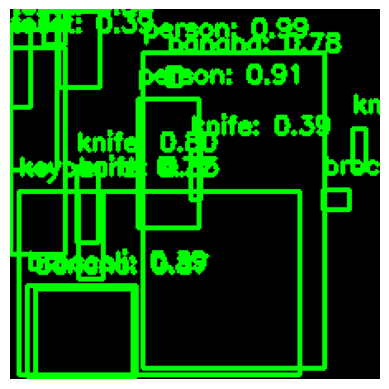

Frame 133, Label: 1, Score: 0.9929757118225098
Frame 133, Label: 64, Score: 0.970095157623291
Frame 133, Label: 1, Score: 0.9097856879234314
Frame 133, Label: 47, Score: 0.8692211508750916
Frame 133, Label: 64, Score: 0.8431429266929626
Frame 133, Label: 44, Score: 0.8004487156867981
Frame 133, Label: 47, Score: 0.7811790704727173
Frame 133, Label: 67, Score: 0.7178861498832703
Frame 133, Label: 62, Score: 0.5326780080795288
Frame 133, Label: 44, Score: 0.47444072365760803
Frame 133, Label: 62, Score: 0.4196507930755615
Frame 133, Label: 62, Score: 0.39439278841018677
Frame 133, Label: 44, Score: 0.39207449555397034
Frame 133, Label: 51, Score: 0.38593590259552
Frame 133, Label: 44, Score: 0.3530215322971344
Frame 133, Label: 51, Score: 0.3015992045402527


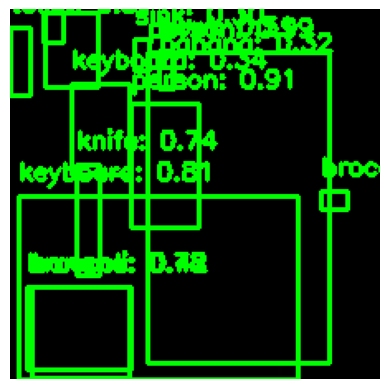

Frame 134, Label: 1, Score: 0.9935330152511597
Frame 134, Label: 1, Score: 0.9147385358810425
Frame 134, Label: 64, Score: 0.8878454566001892
Frame 134, Label: 67, Score: 0.8149675726890564
Frame 134, Label: 47, Score: 0.7813723683357239
Frame 134, Label: 44, Score: 0.7415559887886047
Frame 134, Label: 46, Score: 0.5127069354057312
Frame 134, Label: 64, Score: 0.4625471532344818
Frame 134, Label: 51, Score: 0.4162144660949707
Frame 134, Label: 51, Score: 0.37475746870040894
Frame 134, Label: 67, Score: 0.33670786023139954
Frame 134, Label: 47, Score: 0.3236546516418457
Frame 134, Label: 62, Score: 0.31284603476524353
Frame 134, Label: 72, Score: 0.30381280183792114


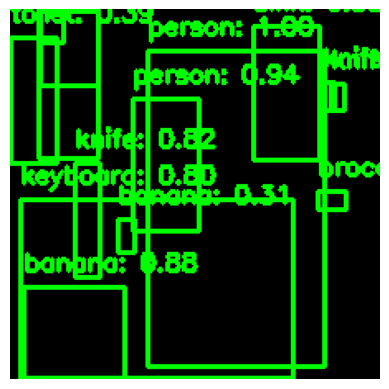

Frame 135, Label: 1, Score: 0.9959672689437866
Frame 135, Label: 64, Score: 0.9548068046569824
Frame 135, Label: 1, Score: 0.9425079226493835
Frame 135, Label: 47, Score: 0.8768509030342102
Frame 135, Label: 44, Score: 0.8172573447227478
Frame 135, Label: 67, Score: 0.7952118515968323
Frame 135, Label: 64, Score: 0.4697684645652771
Frame 135, Label: 51, Score: 0.4655689597129822
Frame 135, Label: 44, Score: 0.46082645654678345
Frame 135, Label: 44, Score: 0.44454407691955566
Frame 135, Label: 62, Score: 0.3872785270214081
Frame 135, Label: 72, Score: 0.35064002871513367
Frame 135, Label: 64, Score: 0.33308911323547363
Frame 135, Label: 47, Score: 0.312142550945282


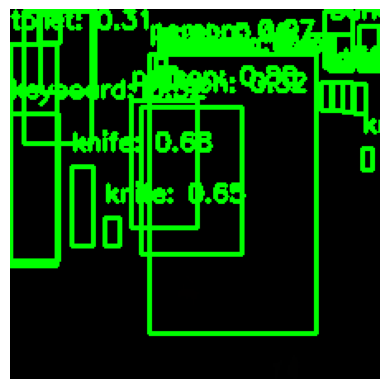

Frame 136, Label: 1, Score: 0.971811830997467
Frame 136, Label: 1, Score: 0.8778094053268433
Frame 136, Label: 64, Score: 0.8758547902107239
Frame 136, Label: 44, Score: 0.6841209530830383
Frame 136, Label: 47, Score: 0.6727223992347717
Frame 136, Label: 44, Score: 0.6483230590820312
Frame 136, Label: 47, Score: 0.6432400345802307
Frame 136, Label: 47, Score: 0.4704605042934418
Frame 136, Label: 46, Score: 0.461841881275177
Frame 136, Label: 44, Score: 0.4505513310432434
Frame 136, Label: 44, Score: 0.4394301474094391
Frame 136, Label: 64, Score: 0.4338253438472748
Frame 136, Label: 64, Score: 0.43067559599876404
Frame 136, Label: 64, Score: 0.399564266204834
Frame 136, Label: 44, Score: 0.3981010913848877
Frame 136, Label: 44, Score: 0.37523892521858215
Frame 136, Label: 44, Score: 0.3295234143733978
Frame 136, Label: 47, Score: 0.3268361985683441
Frame 136, Label: 67, Score: 0.32439613342285156
Frame 136, Label: 1, Score: 0.3234840929508209
Frame 136, Label: 47, Score: 0.310928702354

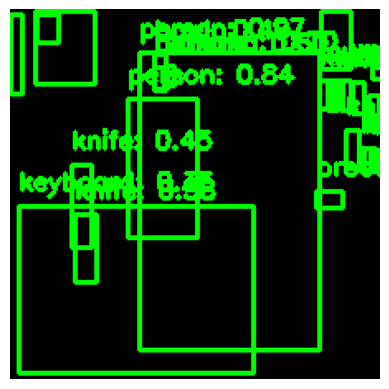

Frame 137, Label: 1, Score: 0.9728487133979797
Frame 137, Label: 64, Score: 0.9252468347549438
Frame 137, Label: 1, Score: 0.8425169587135315
Frame 137, Label: 44, Score: 0.825809121131897
Frame 137, Label: 44, Score: 0.7027170062065125
Frame 137, Label: 47, Score: 0.7024474143981934
Frame 137, Label: 44, Score: 0.6566040515899658
Frame 137, Label: 44, Score: 0.648963987827301
Frame 137, Label: 44, Score: 0.6070523858070374
Frame 137, Label: 47, Score: 0.6049172282218933
Frame 137, Label: 44, Score: 0.5753375291824341
Frame 137, Label: 44, Score: 0.556096613407135
Frame 137, Label: 51, Score: 0.4961601197719574
Frame 137, Label: 44, Score: 0.4538215398788452
Frame 137, Label: 64, Score: 0.41525235772132874
Frame 137, Label: 46, Score: 0.4000791609287262
Frame 137, Label: 44, Score: 0.3538729250431061
Frame 137, Label: 67, Score: 0.35285329818725586
Frame 137, Label: 44, Score: 0.3405676782131195
Frame 137, Label: 44, Score: 0.3372473418712616
Frame 137, Label: 1, Score: 0.3325875699520

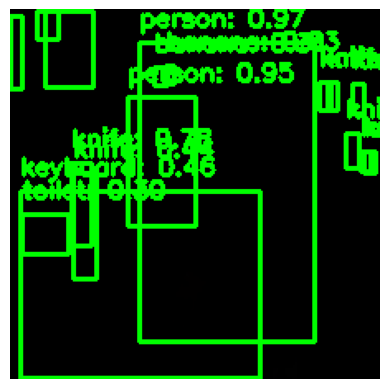

Frame 138, Label: 1, Score: 0.9715155959129333
Frame 138, Label: 1, Score: 0.948069155216217
Frame 138, Label: 64, Score: 0.8698450922966003
Frame 138, Label: 44, Score: 0.7780595421791077
Frame 138, Label: 44, Score: 0.72154301404953
Frame 138, Label: 47, Score: 0.6319519281387329
Frame 138, Label: 44, Score: 0.5106837153434753
Frame 138, Label: 67, Score: 0.4608989655971527
Frame 138, Label: 44, Score: 0.44322940707206726
Frame 138, Label: 64, Score: 0.43635889887809753
Frame 138, Label: 44, Score: 0.39579614996910095
Frame 138, Label: 44, Score: 0.353381872177124
Frame 138, Label: 44, Score: 0.3350876271724701
Frame 138, Label: 1, Score: 0.3265235424041748
Frame 138, Label: 47, Score: 0.31354641914367676
Frame 138, Label: 44, Score: 0.3032270669937134
Frame 138, Label: 62, Score: 0.3015855550765991


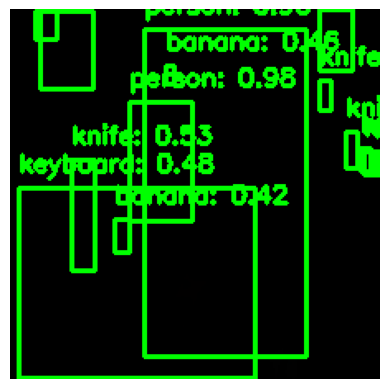

Frame 139, Label: 1, Score: 0.9802132248878479
Frame 139, Label: 1, Score: 0.9575881361961365
Frame 139, Label: 64, Score: 0.8644134402275085
Frame 139, Label: 64, Score: 0.725900411605835
Frame 139, Label: 44, Score: 0.5696814656257629
Frame 139, Label: 44, Score: 0.5253796577453613
Frame 139, Label: 44, Score: 0.48631054162979126
Frame 139, Label: 67, Score: 0.477190226316452
Frame 139, Label: 44, Score: 0.47676175832748413
Frame 139, Label: 47, Score: 0.4634705185890198
Frame 139, Label: 44, Score: 0.45175373554229736
Frame 139, Label: 47, Score: 0.4170604348182678
Frame 139, Label: 44, Score: 0.34933847188949585
Frame 139, Label: 64, Score: 0.3224741220474243


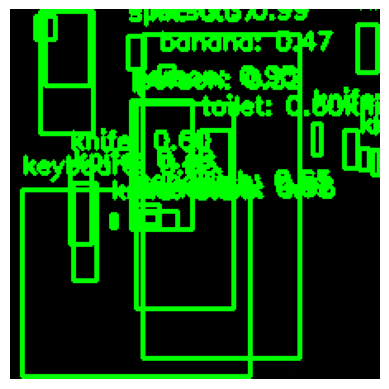

Frame 140, Label: 1, Score: 0.9892149567604065
Frame 140, Label: 1, Score: 0.9533430933952332
Frame 140, Label: 64, Score: 0.9174038767814636
Frame 140, Label: 49, Score: 0.7463726997375488
Frame 140, Label: 44, Score: 0.6756302118301392
Frame 140, Label: 49, Score: 0.6505804061889648
Frame 140, Label: 44, Score: 0.6268616914749146
Frame 140, Label: 62, Score: 0.6026560068130493
Frame 140, Label: 44, Score: 0.5985920429229736
Frame 140, Label: 64, Score: 0.5951750874519348
Frame 140, Label: 67, Score: 0.5293931365013123
Frame 140, Label: 49, Score: 0.518982470035553
Frame 140, Label: 47, Score: 0.4708152115345001
Frame 140, Label: 44, Score: 0.3901073932647705
Frame 140, Label: 44, Score: 0.3892345428466797
Frame 140, Label: 64, Score: 0.38655760884284973
Frame 140, Label: 72, Score: 0.3693107068538666
Frame 140, Label: 44, Score: 0.36264488101005554
Frame 140, Label: 44, Score: 0.33219417929649353
Frame 140, Label: 1, Score: 0.31529274582862854
Frame 140, Label: 44, Score: 0.309441596

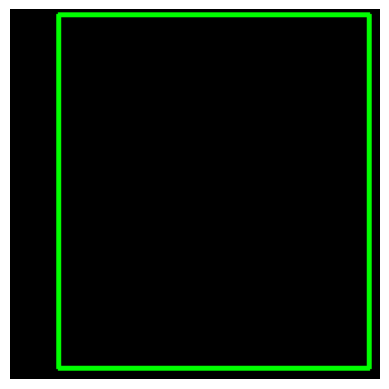

Frame 141, Label: 1, Score: 0.9417998790740967


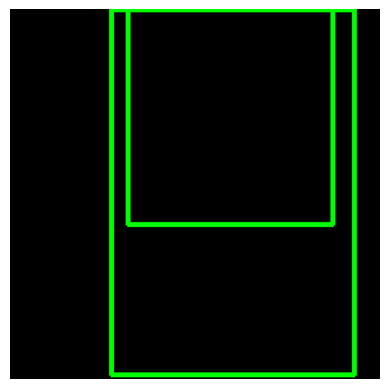

Frame 142, Label: 1, Score: 0.9755995869636536
Frame 142, Label: 1, Score: 0.3925088942050934


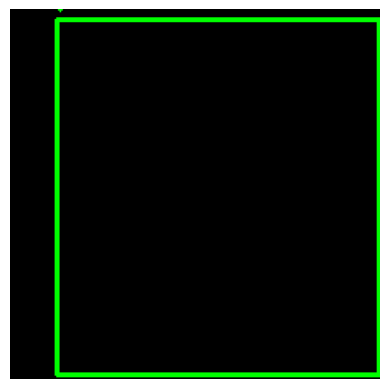

Frame 143, Label: 1, Score: 0.9441460371017456


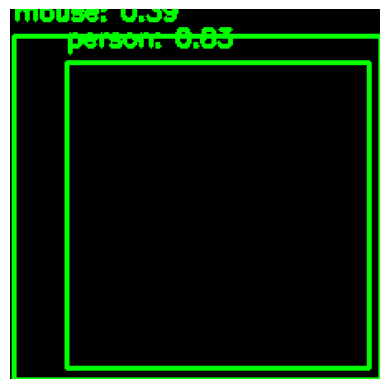

Frame 144, Label: 1, Score: 0.8341783881187439
Frame 144, Label: 65, Score: 0.3851643204689026


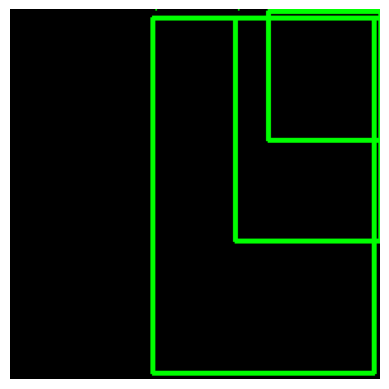

Frame 145, Label: 1, Score: 0.8945208191871643
Frame 145, Label: 1, Score: 0.6225566864013672
Frame 145, Label: 1, Score: 0.5155622959136963


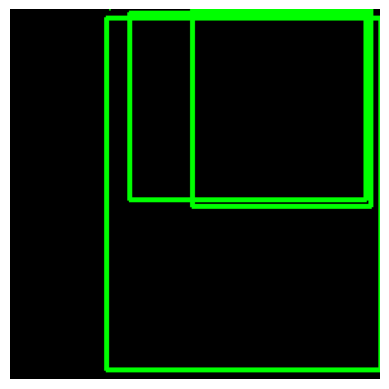

Frame 146, Label: 1, Score: 0.9520024657249451
Frame 146, Label: 1, Score: 0.6467832922935486
Frame 146, Label: 17, Score: 0.39253780245780945


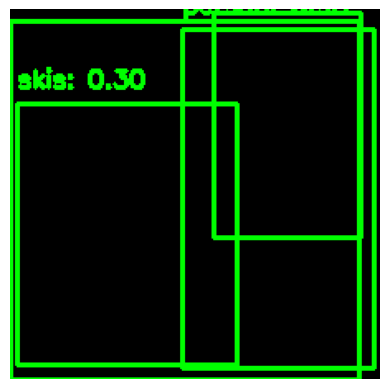

Frame 147, Label: 1, Score: 0.9296395182609558
Frame 147, Label: 1, Score: 0.49008089303970337
Frame 147, Label: 65, Score: 0.4339751601219177
Frame 147, Label: 31, Score: 0.30021873116493225


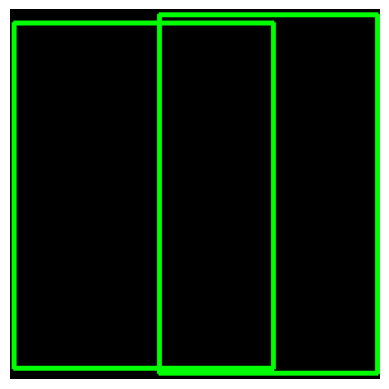

Frame 148, Label: 1, Score: 0.9819299578666687
Frame 148, Label: 65, Score: 0.4285946488380432


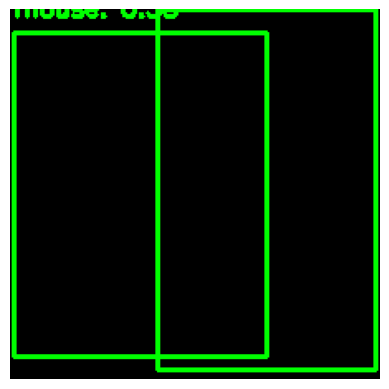

Frame 149, Label: 1, Score: 0.9810166954994202
Frame 149, Label: 65, Score: 0.3451918661594391


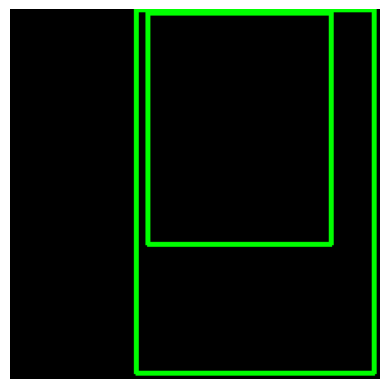

Frame 150, Label: 1, Score: 0.9798370003700256
Frame 150, Label: 1, Score: 0.3269713521003723


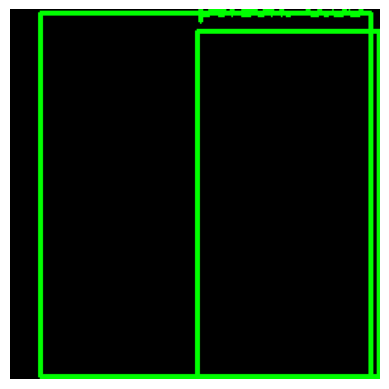

Frame 151, Label: 1, Score: 0.9624930024147034
Frame 151, Label: 1, Score: 0.33227092027664185


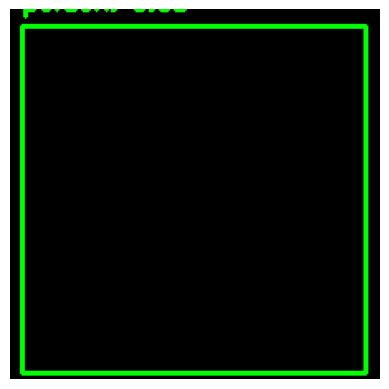

Frame 152, Label: 1, Score: 0.6467085480690002


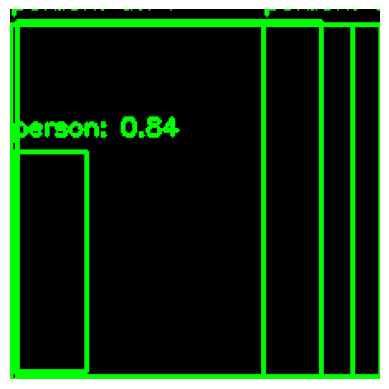

Frame 153, Label: 1, Score: 0.8368797302246094
Frame 153, Label: 1, Score: 0.7371984720230103
Frame 153, Label: 1, Score: 0.49948716163635254
Frame 153, Label: 65, Score: 0.33044198155403137


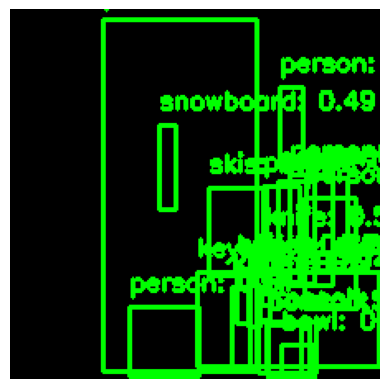

Frame 154, Label: 1, Score: 0.9984686970710754
Frame 154, Label: 1, Score: 0.9684252738952637
Frame 154, Label: 44, Score: 0.9438077807426453
Frame 154, Label: 1, Score: 0.9385170340538025
Frame 154, Label: 44, Score: 0.8696131110191345
Frame 154, Label: 1, Score: 0.8535746932029724
Frame 154, Label: 44, Score: 0.8514823317527771
Frame 154, Label: 44, Score: 0.8230674266815186
Frame 154, Label: 67, Score: 0.6119620203971863
Frame 154, Label: 1, Score: 0.6072232127189636
Frame 154, Label: 44, Score: 0.5774548649787903
Frame 154, Label: 46, Score: 0.5653180480003357
Frame 154, Label: 32, Score: 0.49251145124435425
Frame 154, Label: 51, Score: 0.41254228353500366
Frame 154, Label: 1, Score: 0.4005241096019745
Frame 154, Label: 31, Score: 0.3837156295776367
Frame 154, Label: 46, Score: 0.35769763588905334
Frame 154, Label: 47, Score: 0.33613014221191406
Frame 154, Label: 1, Score: 0.32599061727523804
Frame 154, Label: 1, Score: 0.30145180225372314


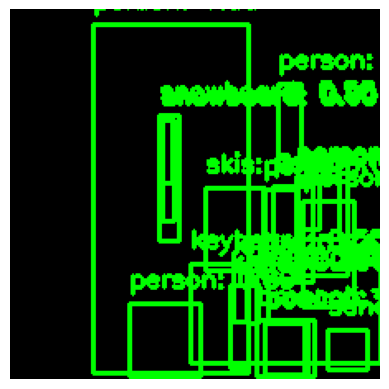

Frame 155, Label: 1, Score: 0.9984006285667419
Frame 155, Label: 44, Score: 0.957718014717102
Frame 155, Label: 1, Score: 0.9487593173980713
Frame 155, Label: 44, Score: 0.9108439683914185
Frame 155, Label: 1, Score: 0.8932090997695923
Frame 155, Label: 1, Score: 0.8865986466407776
Frame 155, Label: 1, Score: 0.8715322017669678
Frame 155, Label: 44, Score: 0.8378699421882629
Frame 155, Label: 44, Score: 0.8372116684913635
Frame 155, Label: 32, Score: 0.7082968354225159
Frame 155, Label: 31, Score: 0.6312430500984192
Frame 155, Label: 1, Score: 0.6094936728477478
Frame 155, Label: 32, Score: 0.599768340587616
Frame 155, Label: 32, Score: 0.5826870203018188
Frame 155, Label: 1, Score: 0.5565683841705322
Frame 155, Label: 67, Score: 0.5454419255256653
Frame 155, Label: 1, Score: 0.473550409078598
Frame 155, Label: 1, Score: 0.3687751591205597
Frame 155, Label: 46, Score: 0.35053595900535583
Frame 155, Label: 51, Score: 0.3486531674861908
Frame 155, Label: 49, Score: 0.3321225941181183
Fra

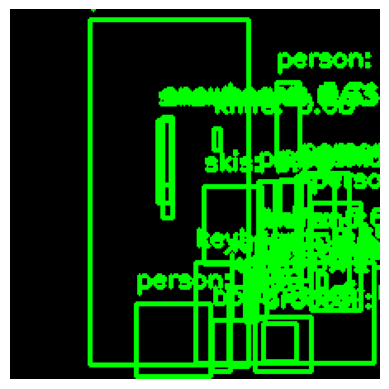

Frame 156, Label: 1, Score: 0.9984762072563171
Frame 156, Label: 1, Score: 0.9641029834747314
Frame 156, Label: 44, Score: 0.9557775259017944
Frame 156, Label: 44, Score: 0.9067078232765198
Frame 156, Label: 1, Score: 0.8622467517852783
Frame 156, Label: 44, Score: 0.8582915663719177
Frame 156, Label: 1, Score: 0.799109935760498
Frame 156, Label: 31, Score: 0.7792390584945679
Frame 156, Label: 1, Score: 0.7649718523025513
Frame 156, Label: 44, Score: 0.7199360728263855
Frame 156, Label: 32, Score: 0.7144396901130676
Frame 156, Label: 44, Score: 0.6808332204818726
Frame 156, Label: 67, Score: 0.6516588926315308
Frame 156, Label: 44, Score: 0.6493659615516663
Frame 156, Label: 32, Score: 0.626042366027832
Frame 156, Label: 1, Score: 0.6100386381149292
Frame 156, Label: 51, Score: 0.6042584180831909
Frame 156, Label: 46, Score: 0.3999715745449066
Frame 156, Label: 1, Score: 0.3725697696208954
Frame 156, Label: 46, Score: 0.3553332984447479
Frame 156, Label: 1, Score: 0.3552699387073517
Fr

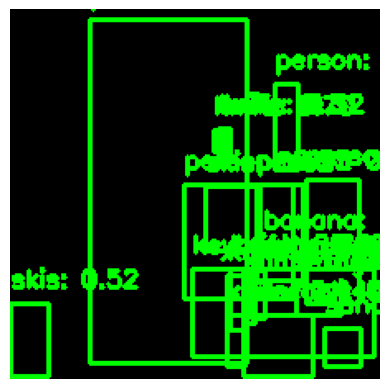

Frame 157, Label: 1, Score: 0.9986391663551331
Frame 157, Label: 1, Score: 0.9913647174835205
Frame 157, Label: 44, Score: 0.9478283524513245
Frame 157, Label: 1, Score: 0.8651293516159058
Frame 157, Label: 44, Score: 0.8244757652282715
Frame 157, Label: 44, Score: 0.7605807185173035
Frame 157, Label: 44, Score: 0.6983347535133362
Frame 157, Label: 51, Score: 0.6949520111083984
Frame 157, Label: 31, Score: 0.6197835803031921
Frame 157, Label: 67, Score: 0.599551260471344
Frame 157, Label: 73, Score: 0.5871618986129761
Frame 157, Label: 44, Score: 0.5764067769050598
Frame 157, Label: 31, Score: 0.5205743312835693
Frame 157, Label: 1, Score: 0.5114113092422485
Frame 157, Label: 49, Score: 0.48975202441215515
Frame 157, Label: 44, Score: 0.4371439814567566
Frame 157, Label: 47, Score: 0.383270263671875
Frame 157, Label: 1, Score: 0.3332275152206421
Frame 157, Label: 44, Score: 0.3214549422264099
Frame 157, Label: 44, Score: 0.30993562936782837


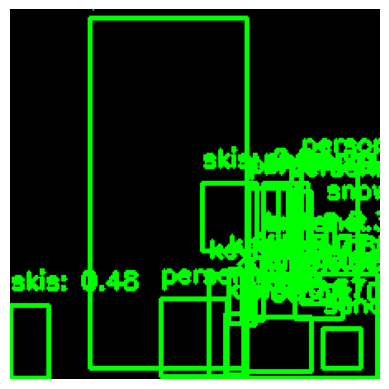

Frame 158, Label: 1, Score: 0.9992503523826599
Frame 158, Label: 1, Score: 0.9909597635269165
Frame 158, Label: 44, Score: 0.9641153812408447
Frame 158, Label: 1, Score: 0.9040181636810303
Frame 158, Label: 31, Score: 0.840913712978363
Frame 158, Label: 44, Score: 0.802678644657135
Frame 158, Label: 67, Score: 0.7772842645645142
Frame 158, Label: 44, Score: 0.7698434591293335
Frame 158, Label: 1, Score: 0.714124858379364
Frame 158, Label: 73, Score: 0.7075101733207703
Frame 158, Label: 49, Score: 0.6802787184715271
Frame 158, Label: 44, Score: 0.6689510345458984
Frame 158, Label: 32, Score: 0.6247814297676086
Frame 158, Label: 47, Score: 0.5550071597099304
Frame 158, Label: 1, Score: 0.5124831199645996
Frame 158, Label: 51, Score: 0.4881260395050049
Frame 158, Label: 31, Score: 0.47777363657951355
Frame 158, Label: 1, Score: 0.4480443000793457
Frame 158, Label: 1, Score: 0.4214016795158386
Frame 158, Label: 44, Score: 0.324567049741745


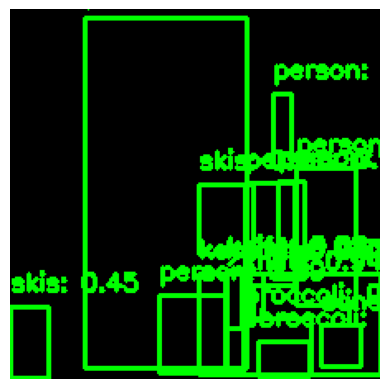

Frame 159, Label: 1, Score: 0.9990693926811218
Frame 159, Label: 1, Score: 0.9941596984863281
Frame 159, Label: 44, Score: 0.9662845730781555
Frame 159, Label: 1, Score: 0.9501694440841675
Frame 159, Label: 44, Score: 0.9365522861480713
Frame 159, Label: 31, Score: 0.9059523940086365
Frame 159, Label: 44, Score: 0.8495891690254211
Frame 159, Label: 67, Score: 0.7609893679618835
Frame 159, Label: 51, Score: 0.749533474445343
Frame 159, Label: 49, Score: 0.7077063322067261
Frame 159, Label: 1, Score: 0.6935585141181946
Frame 159, Label: 44, Score: 0.5548393726348877
Frame 159, Label: 31, Score: 0.45358115434646606
Frame 159, Label: 51, Score: 0.4387911260128021
Frame 159, Label: 1, Score: 0.3650808334350586
Frame 159, Label: 1, Score: 0.3464711010456085


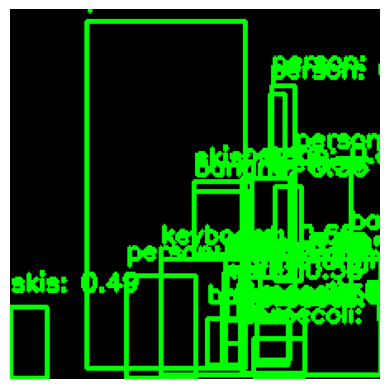

Frame 160, Label: 1, Score: 0.998818576335907
Frame 160, Label: 1, Score: 0.992915153503418
Frame 160, Label: 44, Score: 0.9472941756248474
Frame 160, Label: 44, Score: 0.907931923866272
Frame 160, Label: 1, Score: 0.8846231698989868
Frame 160, Label: 44, Score: 0.8641847968101501
Frame 160, Label: 1, Score: 0.8136650323867798
Frame 160, Label: 51, Score: 0.8116177916526794
Frame 160, Label: 31, Score: 0.7596118450164795
Frame 160, Label: 67, Score: 0.6641769409179688
Frame 160, Label: 44, Score: 0.5750309824943542
Frame 160, Label: 47, Score: 0.56780606508255
Frame 160, Label: 1, Score: 0.5663385391235352
Frame 160, Label: 47, Score: 0.5647392272949219
Frame 160, Label: 31, Score: 0.4860157072544098
Frame 160, Label: 44, Score: 0.4580632746219635
Frame 160, Label: 1, Score: 0.45119407773017883
Frame 160, Label: 47, Score: 0.4505615830421448
Frame 160, Label: 47, Score: 0.39332595467567444
Frame 160, Label: 47, Score: 0.3567124009132385
Frame 160, Label: 51, Score: 0.3439628779888153
F

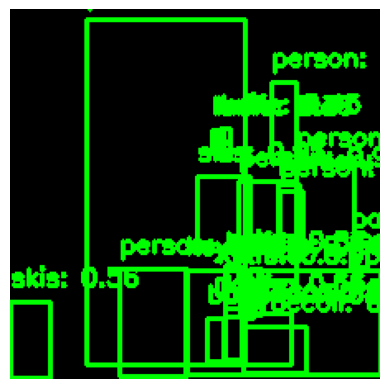

Frame 161, Label: 1, Score: 0.9989068508148193
Frame 161, Label: 1, Score: 0.9932385683059692
Frame 161, Label: 1, Score: 0.9504396319389343
Frame 161, Label: 44, Score: 0.9478921890258789
Frame 161, Label: 31, Score: 0.9455128312110901
Frame 161, Label: 44, Score: 0.932969331741333
Frame 161, Label: 44, Score: 0.8674609065055847
Frame 161, Label: 51, Score: 0.7572677135467529
Frame 161, Label: 67, Score: 0.7377489805221558
Frame 161, Label: 1, Score: 0.5909205079078674
Frame 161, Label: 47, Score: 0.5809382796287537
Frame 161, Label: 31, Score: 0.5612195134162903
Frame 161, Label: 44, Score: 0.5480256080627441
Frame 161, Label: 47, Score: 0.5275458693504333
Frame 161, Label: 1, Score: 0.5170562863349915
Frame 161, Label: 44, Score: 0.4635612368583679
Frame 161, Label: 44, Score: 0.4473954141139984
Frame 161, Label: 51, Score: 0.39431944489479065
Frame 161, Label: 44, Score: 0.36618202924728394
Frame 161, Label: 44, Score: 0.35737136006355286
Frame 161, Label: 1, Score: 0.3206045329570

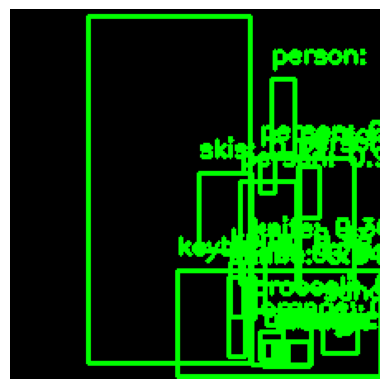

Frame 162, Label: 1, Score: 0.9990549683570862
Frame 162, Label: 1, Score: 0.9932693839073181
Frame 162, Label: 1, Score: 0.9480055570602417
Frame 162, Label: 44, Score: 0.9432805180549622
Frame 162, Label: 1, Score: 0.9092839360237122
Frame 162, Label: 67, Score: 0.7837929725646973
Frame 162, Label: 44, Score: 0.782658040523529
Frame 162, Label: 31, Score: 0.773887574672699
Frame 162, Label: 44, Score: 0.7271609902381897
Frame 162, Label: 51, Score: 0.6006893515586853
Frame 162, Label: 50, Score: 0.5412981510162354
Frame 162, Label: 50, Score: 0.44972455501556396
Frame 162, Label: 1, Score: 0.4156280755996704
Frame 162, Label: 50, Score: 0.3736964166164398
Frame 162, Label: 44, Score: 0.3634338080883026
Frame 162, Label: 50, Score: 0.34811094403266907
Frame 162, Label: 49, Score: 0.3290279507637024
Frame 162, Label: 51, Score: 0.3218957483768463
Frame 162, Label: 1, Score: 0.3184511959552765
Frame 162, Label: 50, Score: 0.3146270215511322


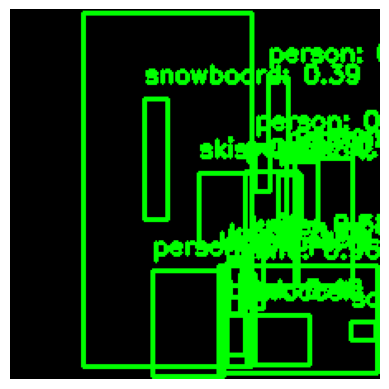

Frame 163, Label: 1, Score: 0.9991587400436401
Frame 163, Label: 1, Score: 0.9950996041297913
Frame 163, Label: 44, Score: 0.9594553112983704
Frame 163, Label: 1, Score: 0.957207202911377
Frame 163, Label: 31, Score: 0.8238843679428101
Frame 163, Label: 44, Score: 0.7499195337295532
Frame 163, Label: 1, Score: 0.7135956883430481
Frame 163, Label: 67, Score: 0.6331765055656433
Frame 163, Label: 51, Score: 0.6150261163711548
Frame 163, Label: 1, Score: 0.6086529493331909
Frame 163, Label: 1, Score: 0.5780601501464844
Frame 163, Label: 44, Score: 0.5771728754043579
Frame 163, Label: 1, Score: 0.5492244362831116
Frame 163, Label: 44, Score: 0.5421602129936218
Frame 163, Label: 49, Score: 0.5403485894203186
Frame 163, Label: 1, Score: 0.5054922103881836
Frame 163, Label: 46, Score: 0.48398104310035706
Frame 163, Label: 32, Score: 0.38780471682548523


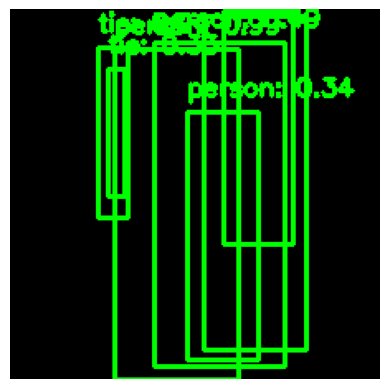

Frame 164, Label: 1, Score: 0.9923192858695984
Frame 164, Label: 1, Score: 0.9921958446502686
Frame 164, Label: 28, Score: 0.9388172626495361
Frame 164, Label: 1, Score: 0.4932045340538025
Frame 164, Label: 1, Score: 0.3549135625362396
Frame 164, Label: 1, Score: 0.3385303020477295
Frame 164, Label: 28, Score: 0.33065730333328247


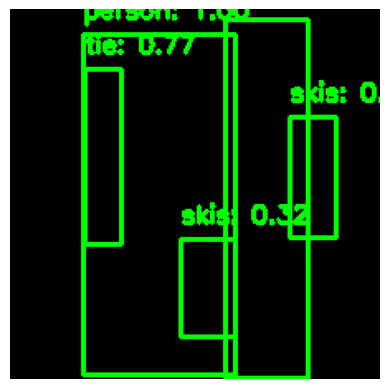

Frame 165, Label: 1, Score: 0.9978875517845154
Frame 165, Label: 1, Score: 0.9896255135536194
Frame 165, Label: 28, Score: 0.7661240696907043
Frame 165, Label: 31, Score: 0.5388242602348328
Frame 165, Label: 31, Score: 0.32142093777656555


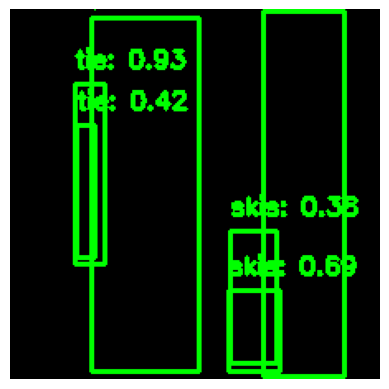

Frame 166, Label: 1, Score: 0.9945570230484009
Frame 166, Label: 1, Score: 0.9871011972427368
Frame 166, Label: 28, Score: 0.9343273043632507
Frame 166, Label: 31, Score: 0.6873567700386047
Frame 166, Label: 28, Score: 0.4219611883163452
Frame 166, Label: 31, Score: 0.38126838207244873


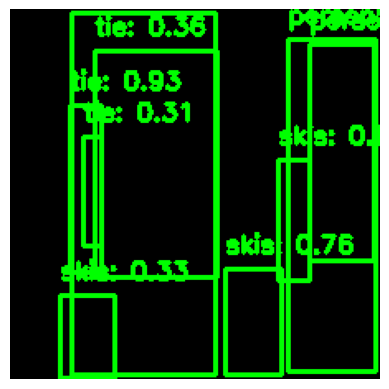

Frame 167, Label: 1, Score: 0.9977521300315857
Frame 167, Label: 1, Score: 0.9885614514350891
Frame 167, Label: 28, Score: 0.9314804077148438
Frame 167, Label: 31, Score: 0.7606538534164429
Frame 167, Label: 1, Score: 0.7042248249053955
Frame 167, Label: 31, Score: 0.6802880764007568
Frame 167, Label: 28, Score: 0.35693520307540894
Frame 167, Label: 31, Score: 0.32913607358932495
Frame 167, Label: 28, Score: 0.3072986900806427


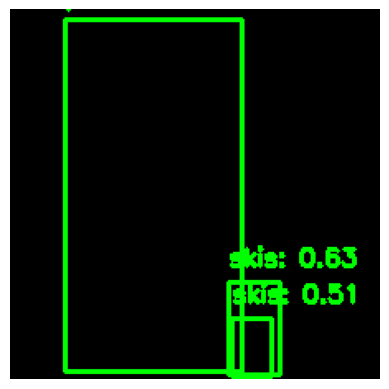

Frame 168, Label: 1, Score: 0.9874988198280334
Frame 168, Label: 31, Score: 0.6298314332962036
Frame 168, Label: 31, Score: 0.5052199959754944


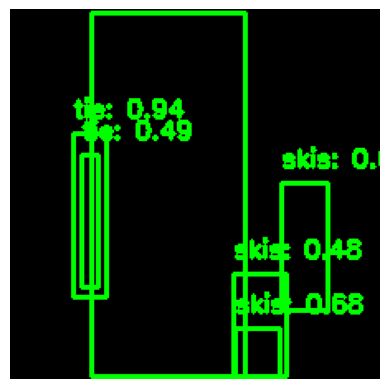

Frame 169, Label: 1, Score: 0.9973317384719849
Frame 169, Label: 28, Score: 0.9377455115318298
Frame 169, Label: 31, Score: 0.6773572564125061
Frame 169, Label: 31, Score: 0.6750099658966064
Frame 169, Label: 28, Score: 0.4873759150505066
Frame 169, Label: 31, Score: 0.47617024183273315


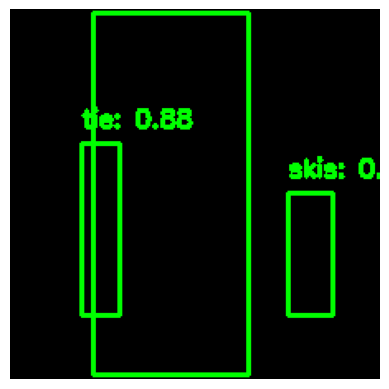

Frame 170, Label: 1, Score: 0.996088981628418
Frame 170, Label: 28, Score: 0.8773635625839233
Frame 170, Label: 31, Score: 0.6081759333610535


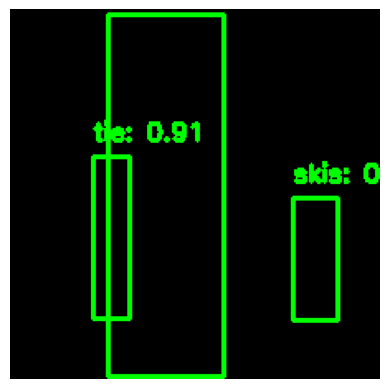

Frame 171, Label: 1, Score: 0.9949780106544495
Frame 171, Label: 28, Score: 0.9123648405075073
Frame 171, Label: 31, Score: 0.664190948009491


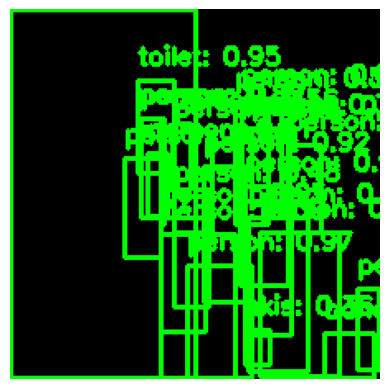

Frame 172, Label: 1, Score: 0.9794163703918457
Frame 172, Label: 1, Score: 0.9728361964225769
Frame 172, Label: 1, Score: 0.9516309499740601
Frame 172, Label: 62, Score: 0.9488753080368042
Frame 172, Label: 1, Score: 0.939849853515625
Frame 172, Label: 1, Score: 0.920233964920044
Frame 172, Label: 1, Score: 0.9051034450531006
Frame 172, Label: 1, Score: 0.902722954750061
Frame 172, Label: 47, Score: 0.8998028039932251
Frame 172, Label: 1, Score: 0.8669636249542236
Frame 172, Label: 1, Score: 0.8589293360710144
Frame 172, Label: 1, Score: 0.8497824668884277
Frame 172, Label: 1, Score: 0.8149405717849731
Frame 172, Label: 1, Score: 0.7222657203674316
Frame 172, Label: 1, Score: 0.6335914134979248
Frame 172, Label: 1, Score: 0.5688451528549194
Frame 172, Label: 1, Score: 0.5590100884437561
Frame 172, Label: 1, Score: 0.48245733976364136
Frame 172, Label: 1, Score: 0.3936139643192291
Frame 172, Label: 1, Score: 0.39274758100509644
Frame 172, Label: 1, Score: 0.37268298864364624
Frame 172, 

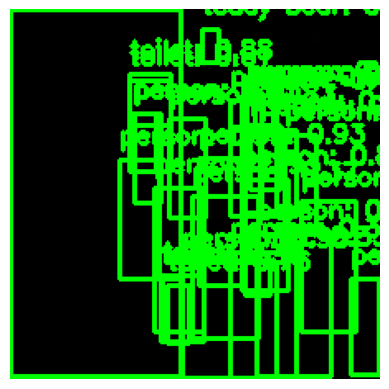

Frame 173, Label: 1, Score: 0.9810608625411987
Frame 173, Label: 1, Score: 0.9794186353683472
Frame 173, Label: 1, Score: 0.9792345762252808
Frame 173, Label: 1, Score: 0.954538106918335
Frame 173, Label: 1, Score: 0.9327210783958435
Frame 173, Label: 1, Score: 0.9271063804626465
Frame 173, Label: 1, Score: 0.8928843140602112
Frame 173, Label: 62, Score: 0.8809388279914856
Frame 173, Label: 1, Score: 0.8667634725570679
Frame 173, Label: 1, Score: 0.8319980502128601
Frame 173, Label: 1, Score: 0.8296915292739868
Frame 173, Label: 1, Score: 0.7990710735321045
Frame 173, Label: 62, Score: 0.7609947323799133
Frame 173, Label: 1, Score: 0.7577143907546997
Frame 173, Label: 62, Score: 0.610367476940155
Frame 173, Label: 1, Score: 0.55893474817276
Frame 173, Label: 1, Score: 0.5574000477790833
Frame 173, Label: 1, Score: 0.5174189209938049
Frame 173, Label: 1, Score: 0.5001689195632935
Frame 173, Label: 62, Score: 0.44169172644615173
Frame 173, Label: 1, Score: 0.40545135736465454
Frame 173, 

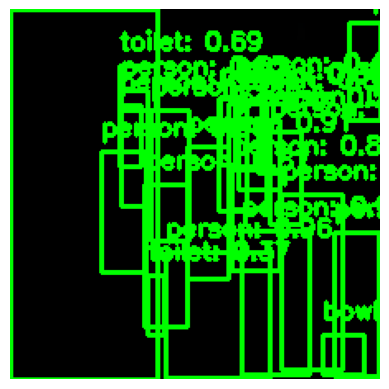

Frame 174, Label: 1, Score: 0.9806376695632935
Frame 174, Label: 1, Score: 0.9624384641647339
Frame 174, Label: 1, Score: 0.9600163102149963
Frame 174, Label: 1, Score: 0.9582937955856323
Frame 174, Label: 1, Score: 0.9534144997596741
Frame 174, Label: 1, Score: 0.9090059995651245
Frame 174, Label: 1, Score: 0.8948766589164734
Frame 174, Label: 1, Score: 0.8766473531723022
Frame 174, Label: 1, Score: 0.8724660873413086
Frame 174, Label: 1, Score: 0.8704242706298828
Frame 174, Label: 1, Score: 0.8481805324554443
Frame 174, Label: 64, Score: 0.837361752986908
Frame 174, Label: 46, Score: 0.7227679491043091
Frame 174, Label: 62, Score: 0.685416579246521
Frame 174, Label: 1, Score: 0.665458619594574
Frame 174, Label: 1, Score: 0.6460261344909668
Frame 174, Label: 1, Score: 0.6283349394798279
Frame 174, Label: 1, Score: 0.5800653696060181
Frame 174, Label: 1, Score: 0.4702969789505005
Frame 174, Label: 62, Score: 0.36800792813301086
Frame 174, Label: 1, Score: 0.3327893614768982
Frame 174, 

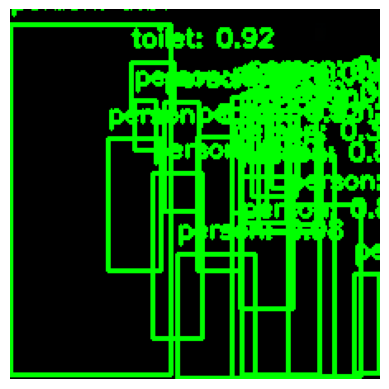

Frame 175, Label: 1, Score: 0.9756606221199036
Frame 175, Label: 1, Score: 0.9741623997688293
Frame 175, Label: 1, Score: 0.931159496307373
Frame 175, Label: 1, Score: 0.9254576563835144
Frame 175, Label: 62, Score: 0.9208582639694214
Frame 175, Label: 1, Score: 0.8845835328102112
Frame 175, Label: 1, Score: 0.8741915822029114
Frame 175, Label: 1, Score: 0.8520589470863342
Frame 175, Label: 1, Score: 0.8269092440605164
Frame 175, Label: 1, Score: 0.797044575214386
Frame 175, Label: 1, Score: 0.7778797149658203
Frame 175, Label: 1, Score: 0.7430911660194397
Frame 175, Label: 1, Score: 0.5811632871627808
Frame 175, Label: 1, Score: 0.5624300241470337
Frame 175, Label: 1, Score: 0.5547314286231995
Frame 175, Label: 1, Score: 0.5136045217514038
Frame 175, Label: 1, Score: 0.513175904750824
Frame 175, Label: 1, Score: 0.45129841566085815
Frame 175, Label: 1, Score: 0.40052834153175354
Frame 175, Label: 1, Score: 0.3315356373786926


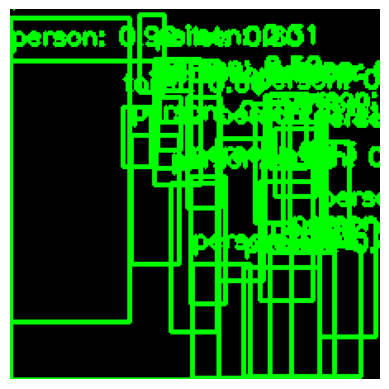

Frame 176, Label: 1, Score: 0.9830412864685059
Frame 176, Label: 1, Score: 0.9634729027748108
Frame 176, Label: 1, Score: 0.9124558568000793
Frame 176, Label: 1, Score: 0.905541718006134
Frame 176, Label: 1, Score: 0.8985971808433533
Frame 176, Label: 1, Score: 0.8947956562042236
Frame 176, Label: 1, Score: 0.8932877779006958
Frame 176, Label: 1, Score: 0.8552640676498413
Frame 176, Label: 1, Score: 0.8123661279678345
Frame 176, Label: 62, Score: 0.8032407164573669
Frame 176, Label: 1, Score: 0.7364232540130615
Frame 176, Label: 1, Score: 0.6793707609176636
Frame 176, Label: 62, Score: 0.6622008085250854
Frame 176, Label: 64, Score: 0.6589029431343079
Frame 176, Label: 1, Score: 0.6262697577476501
Frame 176, Label: 1, Score: 0.5825555920600891
Frame 176, Label: 1, Score: 0.49685433506965637
Frame 176, Label: 1, Score: 0.4646151065826416
Frame 176, Label: 1, Score: 0.4315387010574341
Frame 176, Label: 1, Score: 0.42308464646339417
Frame 176, Label: 1, Score: 0.3574579358100891
Frame 176

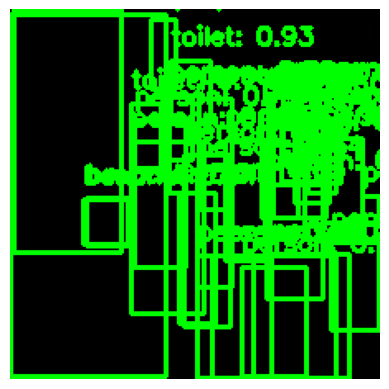

Frame 177, Label: 1, Score: 0.9828265905380249
Frame 177, Label: 1, Score: 0.9818602204322815
Frame 177, Label: 1, Score: 0.9631770849227905
Frame 177, Label: 1, Score: 0.9411436319351196
Frame 177, Label: 62, Score: 0.9256687164306641
Frame 177, Label: 1, Score: 0.9245986342430115
Frame 177, Label: 1, Score: 0.8294352889060974
Frame 177, Label: 1, Score: 0.8125961422920227
Frame 177, Label: 1, Score: 0.7915869355201721
Frame 177, Label: 1, Score: 0.7180449962615967
Frame 177, Label: 62, Score: 0.7101590037345886
Frame 177, Label: 1, Score: 0.6727982759475708
Frame 177, Label: 1, Score: 0.6635936498641968
Frame 177, Label: 1, Score: 0.643406331539154
Frame 177, Label: 47, Score: 0.6418827772140503
Frame 177, Label: 1, Score: 0.6268211007118225
Frame 177, Label: 1, Score: 0.581813395023346
Frame 177, Label: 1, Score: 0.5553653240203857
Frame 177, Label: 1, Score: 0.5169671773910522
Frame 177, Label: 1, Score: 0.5091284513473511
Frame 177, Label: 1, Score: 0.4964022934436798
Frame 177, L

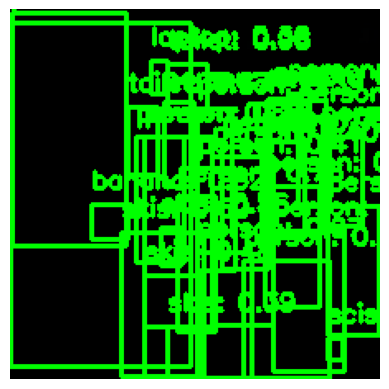

Frame 178, Label: 62, Score: 0.9775006175041199
Frame 178, Label: 1, Score: 0.9768962264060974
Frame 178, Label: 1, Score: 0.9711647033691406
Frame 178, Label: 1, Score: 0.9578630328178406
Frame 178, Label: 1, Score: 0.9520608186721802
Frame 178, Label: 1, Score: 0.8945685625076294
Frame 178, Label: 62, Score: 0.8724572062492371
Frame 178, Label: 1, Score: 0.8553120493888855
Frame 178, Label: 1, Score: 0.7953835725784302
Frame 178, Label: 1, Score: 0.7800347805023193
Frame 178, Label: 1, Score: 0.7738943696022034
Frame 178, Label: 1, Score: 0.7610846757888794
Frame 178, Label: 1, Score: 0.7561942338943481
Frame 178, Label: 1, Score: 0.7471555471420288
Frame 178, Label: 1, Score: 0.6983947157859802
Frame 178, Label: 1, Score: 0.6368281245231628
Frame 178, Label: 1, Score: 0.6201286315917969
Frame 178, Label: 31, Score: 0.5983184576034546
Frame 178, Label: 1, Score: 0.5949720144271851
Frame 178, Label: 31, Score: 0.5568141341209412
Frame 178, Label: 47, Score: 0.5195715427398682
Frame 17

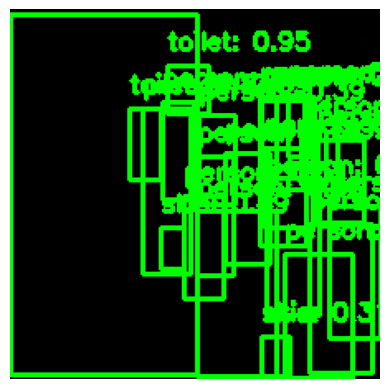

Frame 179, Label: 1, Score: 0.9864532351493835
Frame 179, Label: 1, Score: 0.969579815864563
Frame 179, Label: 1, Score: 0.955154299736023
Frame 179, Label: 62, Score: 0.9466533660888672
Frame 179, Label: 1, Score: 0.9167813658714294
Frame 179, Label: 1, Score: 0.8855765461921692
Frame 179, Label: 1, Score: 0.8693706393241882
Frame 179, Label: 62, Score: 0.8442557454109192
Frame 179, Label: 1, Score: 0.8338114619255066
Frame 179, Label: 1, Score: 0.80755615234375
Frame 179, Label: 1, Score: 0.7608593702316284
Frame 179, Label: 1, Score: 0.663693368434906
Frame 179, Label: 1, Score: 0.6384085416793823
Frame 179, Label: 1, Score: 0.6032174229621887
Frame 179, Label: 1, Score: 0.5744997262954712
Frame 179, Label: 1, Score: 0.5111094117164612
Frame 179, Label: 31, Score: 0.48977217078208923
Frame 179, Label: 1, Score: 0.4720345735549927
Frame 179, Label: 1, Score: 0.4041513502597809
Frame 179, Label: 1, Score: 0.389211505651474
Frame 179, Label: 1, Score: 0.3781222701072693
Frame 179, Labe

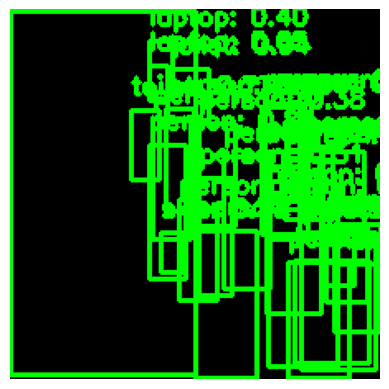

Frame 180, Label: 1, Score: 0.9852350950241089
Frame 180, Label: 1, Score: 0.9721411466598511
Frame 180, Label: 62, Score: 0.9446741342544556
Frame 180, Label: 1, Score: 0.9389022588729858
Frame 180, Label: 1, Score: 0.876110315322876
Frame 180, Label: 1, Score: 0.8389663696289062
Frame 180, Label: 1, Score: 0.8277536630630493
Frame 180, Label: 1, Score: 0.81569504737854
Frame 180, Label: 1, Score: 0.80521559715271
Frame 180, Label: 62, Score: 0.7712962627410889
Frame 180, Label: 18, Score: 0.7620633840560913
Frame 180, Label: 1, Score: 0.7591618895530701
Frame 180, Label: 1, Score: 0.7132588028907776
Frame 180, Label: 1, Score: 0.6867142915725708
Frame 180, Label: 64, Score: 0.6522231698036194
Frame 180, Label: 1, Score: 0.6222038865089417
Frame 180, Label: 1, Score: 0.5790889263153076
Frame 180, Label: 1, Score: 0.5771963596343994
Frame 180, Label: 1, Score: 0.5683408975601196
Frame 180, Label: 1, Score: 0.562926709651947
Frame 180, Label: 31, Score: 0.5269822478294373
Frame 180, Lab

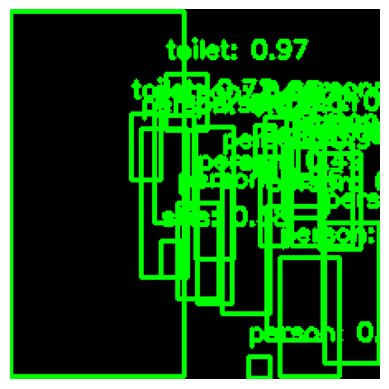

Frame 181, Label: 1, Score: 0.9867348670959473
Frame 181, Label: 62, Score: 0.9724735021591187
Frame 181, Label: 1, Score: 0.9608611464500427
Frame 181, Label: 1, Score: 0.9441226124763489
Frame 181, Label: 1, Score: 0.8760396838188171
Frame 181, Label: 1, Score: 0.8625895380973816
Frame 181, Label: 1, Score: 0.8233276009559631
Frame 181, Label: 1, Score: 0.7986292243003845
Frame 181, Label: 1, Score: 0.7881887555122375
Frame 181, Label: 1, Score: 0.7733380198478699
Frame 181, Label: 1, Score: 0.7624858617782593
Frame 181, Label: 62, Score: 0.7241870164871216
Frame 181, Label: 1, Score: 0.6277774572372437
Frame 181, Label: 1, Score: 0.5137807130813599
Frame 181, Label: 1, Score: 0.5105170607566833
Frame 181, Label: 1, Score: 0.4873698353767395
Frame 181, Label: 1, Score: 0.4641745686531067
Frame 181, Label: 1, Score: 0.435112863779068
Frame 181, Label: 31, Score: 0.38278859853744507
Frame 181, Label: 1, Score: 0.3460540771484375
Frame 181, Label: 1, Score: 0.3398226201534271


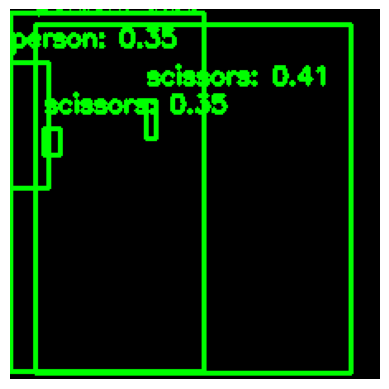

Frame 182, Label: 1, Score: 0.9931736588478088
Frame 182, Label: 1, Score: 0.9376062154769897
Frame 182, Label: 77, Score: 0.40821003913879395
Frame 182, Label: 77, Score: 0.35094332695007324
Frame 182, Label: 1, Score: 0.3493162989616394


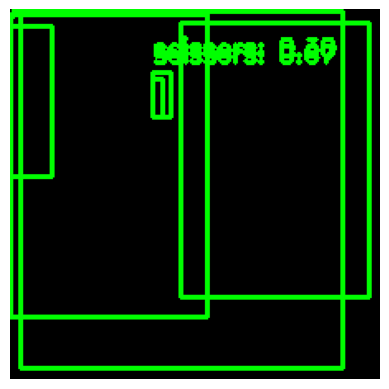

Frame 183, Label: 1, Score: 0.9935681223869324
Frame 183, Label: 1, Score: 0.8104789853096008
Frame 183, Label: 77, Score: 0.6695064306259155
Frame 183, Label: 1, Score: 0.5649236440658569
Frame 183, Label: 1, Score: 0.4028256833553314
Frame 183, Label: 77, Score: 0.3035835027694702


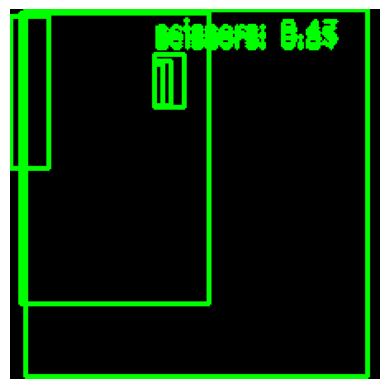

Frame 184, Label: 1, Score: 0.9946969747543335
Frame 184, Label: 77, Score: 0.8103910088539124
Frame 184, Label: 1, Score: 0.6397184133529663
Frame 184, Label: 1, Score: 0.5659261345863342
Frame 184, Label: 77, Score: 0.4689543843269348
Frame 184, Label: 77, Score: 0.35424259305000305


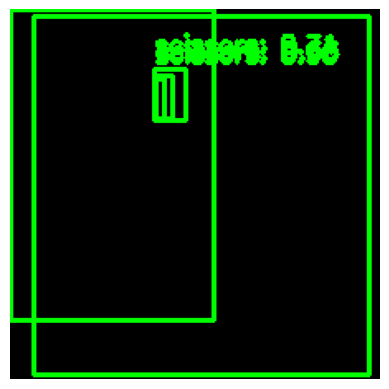

Frame 185, Label: 1, Score: 0.9919899106025696
Frame 185, Label: 77, Score: 0.9047687649726868
Frame 185, Label: 77, Score: 0.7059094309806824
Frame 185, Label: 1, Score: 0.6422915458679199
Frame 185, Label: 77, Score: 0.35811862349510193


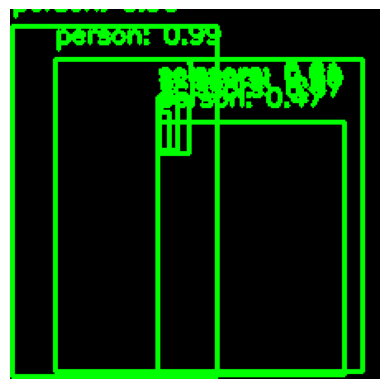

Frame 186, Label: 1, Score: 0.9903259873390198
Frame 186, Label: 1, Score: 0.9635260105133057
Frame 186, Label: 77, Score: 0.6729395389556885
Frame 186, Label: 77, Score: 0.605380117893219
Frame 186, Label: 77, Score: 0.5952034592628479
Frame 186, Label: 1, Score: 0.4717746675014496


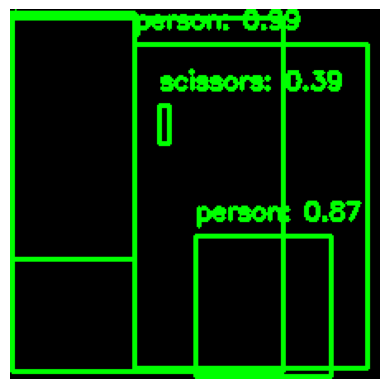

Frame 187, Label: 1, Score: 0.9877311587333679
Frame 187, Label: 1, Score: 0.9816015958786011
Frame 187, Label: 1, Score: 0.8710552453994751
Frame 187, Label: 1, Score: 0.4332846999168396
Frame 187, Label: 77, Score: 0.39166566729545593


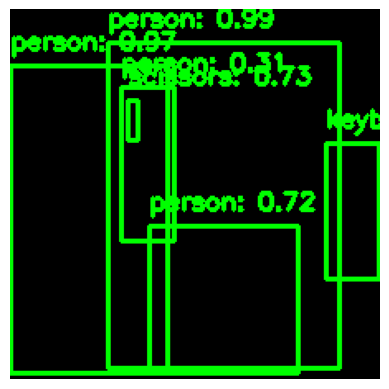

Frame 188, Label: 1, Score: 0.990068256855011
Frame 188, Label: 1, Score: 0.9717455506324768
Frame 188, Label: 77, Score: 0.7279572486877441
Frame 188, Label: 1, Score: 0.7155967950820923
Frame 188, Label: 67, Score: 0.40412411093711853
Frame 188, Label: 1, Score: 0.31450900435447693


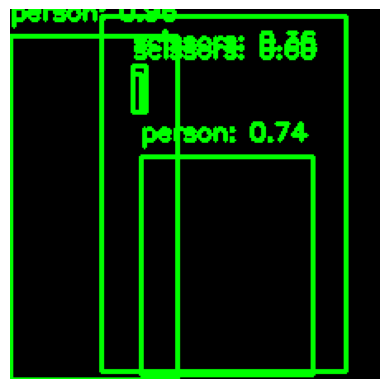

Frame 189, Label: 1, Score: 0.9903685450553894
Frame 189, Label: 1, Score: 0.9563695192337036
Frame 189, Label: 1, Score: 0.7350406050682068
Frame 189, Label: 77, Score: 0.5995614528656006
Frame 189, Label: 77, Score: 0.362414687871933


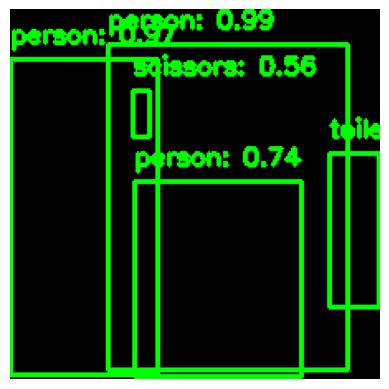

Frame 190, Label: 1, Score: 0.9890963435173035
Frame 190, Label: 1, Score: 0.9732252359390259
Frame 190, Label: 1, Score: 0.7432401180267334
Frame 190, Label: 77, Score: 0.5570210814476013
Frame 190, Label: 62, Score: 0.3487495481967926


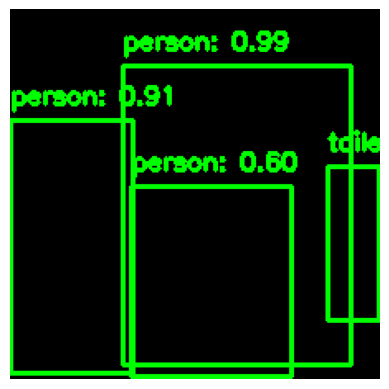

Frame 191, Label: 1, Score: 0.9913399815559387
Frame 191, Label: 1, Score: 0.9113664031028748
Frame 191, Label: 1, Score: 0.6020004749298096
Frame 191, Label: 62, Score: 0.38382500410079956


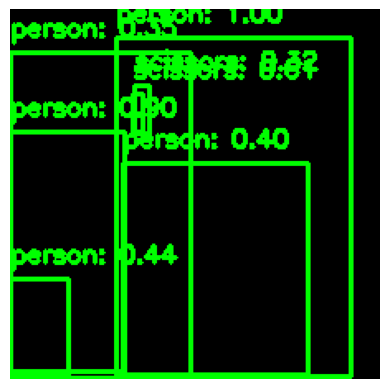

Frame 192, Label: 1, Score: 0.996733546257019
Frame 192, Label: 1, Score: 0.904790997505188
Frame 192, Label: 77, Score: 0.6081856489181519
Frame 192, Label: 1, Score: 0.43517327308654785
Frame 192, Label: 1, Score: 0.40273240208625793
Frame 192, Label: 1, Score: 0.34659403562545776
Frame 192, Label: 77, Score: 0.31620362401008606


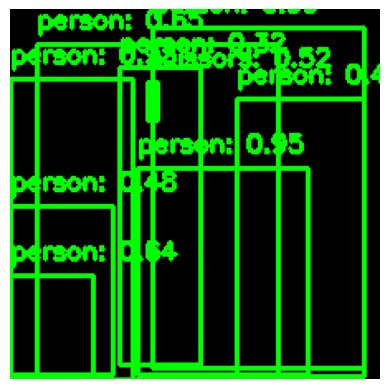

Frame 193, Label: 1, Score: 0.9878575801849365
Frame 193, Label: 1, Score: 0.9475107192993164
Frame 193, Label: 1, Score: 0.9324557781219482
Frame 193, Label: 1, Score: 0.654627799987793
Frame 193, Label: 1, Score: 0.6353921294212341
Frame 193, Label: 77, Score: 0.5181728005409241
Frame 193, Label: 1, Score: 0.49417024850845337
Frame 193, Label: 1, Score: 0.48448488116264343
Frame 193, Label: 1, Score: 0.32321396470069885


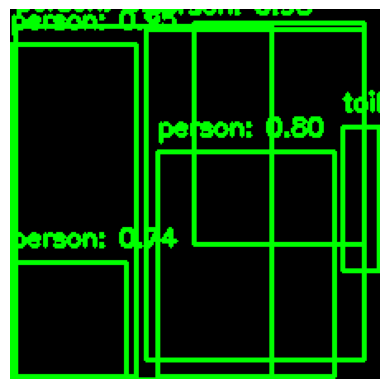

Frame 194, Label: 1, Score: 0.9840696454048157
Frame 194, Label: 1, Score: 0.9518148303031921
Frame 194, Label: 1, Score: 0.7961905598640442
Frame 194, Label: 1, Score: 0.794856071472168
Frame 194, Label: 1, Score: 0.7380321621894836
Frame 194, Label: 62, Score: 0.5699427127838135
Frame 194, Label: 1, Score: 0.4665576219558716


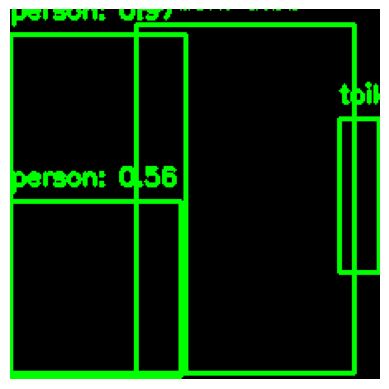

Frame 195, Label: 1, Score: 0.9891624450683594
Frame 195, Label: 1, Score: 0.967085063457489
Frame 195, Label: 1, Score: 0.5574674010276794
Frame 195, Label: 62, Score: 0.5098254084587097


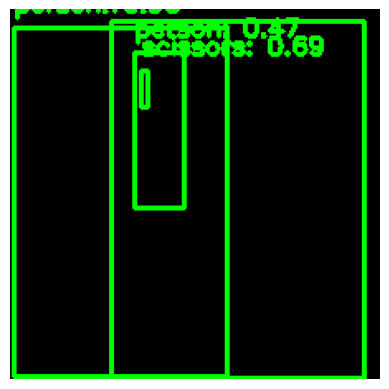

Frame 196, Label: 1, Score: 0.9887597560882568
Frame 196, Label: 1, Score: 0.9574760794639587
Frame 196, Label: 77, Score: 0.686210036277771
Frame 196, Label: 1, Score: 0.46663010120391846


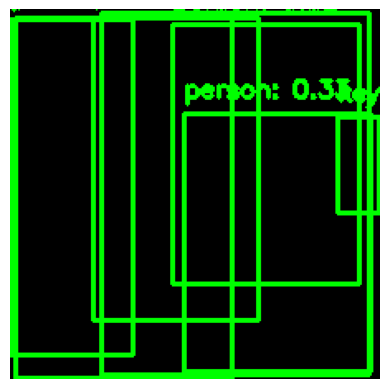

Frame 197, Label: 1, Score: 0.9914979338645935
Frame 197, Label: 1, Score: 0.9318927526473999
Frame 197, Label: 1, Score: 0.698489785194397
Frame 197, Label: 67, Score: 0.6156619191169739
Frame 197, Label: 1, Score: 0.325052946805954
Frame 197, Label: 1, Score: 0.3244977295398712
Frame 197, Label: 1, Score: 0.31521910429000854


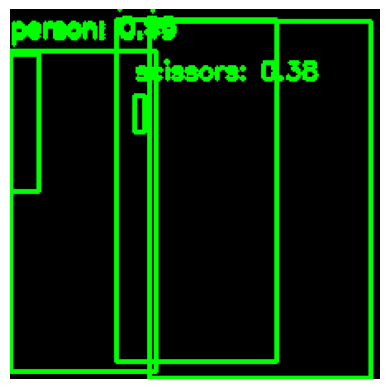

Frame 198, Label: 1, Score: 0.996358335018158
Frame 198, Label: 1, Score: 0.9641245007514954
Frame 198, Label: 1, Score: 0.8655034303665161
Frame 198, Label: 1, Score: 0.4921771287918091
Frame 198, Label: 77, Score: 0.38352975249290466


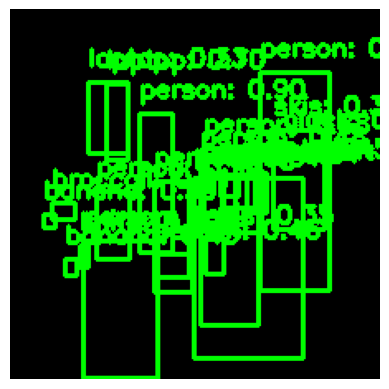

Frame 199, Label: 1, Score: 0.9947096109390259
Frame 199, Label: 1, Score: 0.9893324375152588
Frame 199, Label: 1, Score: 0.9406566023826599
Frame 199, Label: 1, Score: 0.9015777111053467
Frame 199, Label: 1, Score: 0.881576418876648
Frame 199, Label: 1, Score: 0.8356619477272034
Frame 199, Label: 64, Score: 0.697516918182373
Frame 199, Label: 51, Score: 0.6052268147468567
Frame 199, Label: 1, Score: 0.5445313453674316
Frame 199, Label: 1, Score: 0.47750672698020935
Frame 199, Label: 1, Score: 0.46385592222213745
Frame 199, Label: 47, Score: 0.45000144839286804
Frame 199, Label: 62, Score: 0.4488271176815033
Frame 199, Label: 73, Score: 0.44679173827171326
Frame 199, Label: 47, Score: 0.38944992423057556
Frame 199, Label: 62, Score: 0.36628976464271545
Frame 199, Label: 31, Score: 0.35435742139816284
Frame 199, Label: 31, Score: 0.3525395393371582
Frame 199, Label: 64, Score: 0.33463147282600403
Frame 199, Label: 75, Score: 0.3267315924167633
Frame 199, Label: 62, Score: 0.309262335300

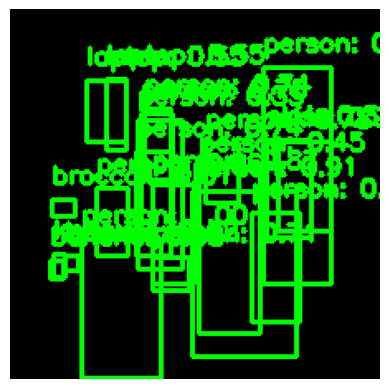

Frame 200, Label: 1, Score: 0.9960134029388428
Frame 200, Label: 1, Score: 0.9871602058410645
Frame 200, Label: 1, Score: 0.9600685834884644
Frame 200, Label: 1, Score: 0.9099220633506775
Frame 200, Label: 1, Score: 0.8702809810638428
Frame 200, Label: 51, Score: 0.807335615158081
Frame 200, Label: 1, Score: 0.7794831991195679
Frame 200, Label: 1, Score: 0.778628945350647
Frame 200, Label: 1, Score: 0.7406405806541443
Frame 200, Label: 1, Score: 0.7395889759063721
Frame 200, Label: 1, Score: 0.7061253786087036
Frame 200, Label: 47, Score: 0.6172400712966919
Frame 200, Label: 64, Score: 0.5532967448234558
Frame 200, Label: 64, Score: 0.5519524812698364
Frame 200, Label: 47, Score: 0.479608952999115
Frame 200, Label: 1, Score: 0.44546744227409363
Frame 200, Label: 31, Score: 0.3779434561729431
Frame 200, Label: 1, Score: 0.36871737241744995
Frame 200, Label: 1, Score: 0.3467833697795868
Frame 200, Label: 31, Score: 0.3092100918292999
Frame 200, Label: 44, Score: 0.30003219842910767


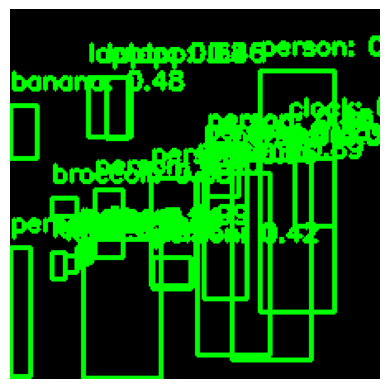

Frame 201, Label: 1, Score: 0.9947288632392883
Frame 201, Label: 1, Score: 0.9701160192489624
Frame 201, Label: 1, Score: 0.9568623304367065
Frame 201, Label: 1, Score: 0.9025379419326782
Frame 201, Label: 1, Score: 0.8879448771476746
Frame 201, Label: 51, Score: 0.8752810955047607
Frame 201, Label: 1, Score: 0.7371791005134583
Frame 201, Label: 64, Score: 0.6767967343330383
Frame 201, Label: 1, Score: 0.6638450026512146
Frame 201, Label: 44, Score: 0.6071705222129822
Frame 201, Label: 1, Score: 0.6024775505065918
Frame 201, Label: 44, Score: 0.516926646232605
Frame 201, Label: 47, Score: 0.48294660449028015
Frame 201, Label: 64, Score: 0.4574888348579407
Frame 201, Label: 31, Score: 0.4552043080329895
Frame 201, Label: 44, Score: 0.43968191742897034
Frame 201, Label: 1, Score: 0.42417797446250916
Frame 201, Label: 75, Score: 0.3912214934825897
Frame 201, Label: 1, Score: 0.3815392851829529
Frame 201, Label: 44, Score: 0.3794933259487152
Frame 201, Label: 44, Score: 0.36746275424957275

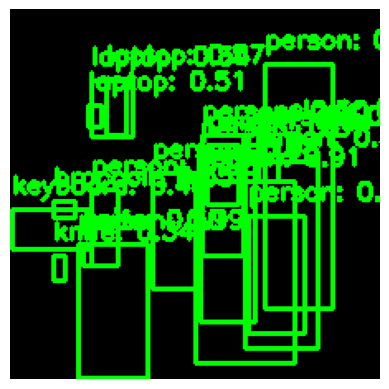

Frame 202, Label: 1, Score: 0.9940766096115112
Frame 202, Label: 1, Score: 0.9750590920448303
Frame 202, Label: 1, Score: 0.9689149856567383
Frame 202, Label: 1, Score: 0.955431342124939
Frame 202, Label: 1, Score: 0.9138801097869873
Frame 202, Label: 1, Score: 0.8353247046470642
Frame 202, Label: 1, Score: 0.6751609444618225
Frame 202, Label: 1, Score: 0.5946811437606812
Frame 202, Label: 64, Score: 0.5719965696334839
Frame 202, Label: 75, Score: 0.5518320202827454
Frame 202, Label: 51, Score: 0.5461610555648804
Frame 202, Label: 1, Score: 0.5132393836975098
Frame 202, Label: 64, Score: 0.5090633034706116
Frame 202, Label: 1, Score: 0.49647700786590576
Frame 202, Label: 44, Score: 0.49523672461509705
Frame 202, Label: 67, Score: 0.39865416288375854
Frame 202, Label: 1, Score: 0.34534764289855957
Frame 202, Label: 64, Score: 0.34218961000442505
Frame 202, Label: 44, Score: 0.34034934639930725


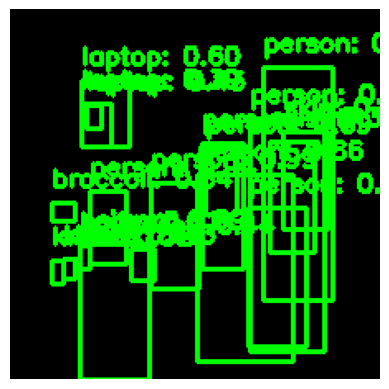

Frame 203, Label: 1, Score: 0.9948882460594177
Frame 203, Label: 1, Score: 0.9906979203224182
Frame 203, Label: 1, Score: 0.9763684272766113
Frame 203, Label: 1, Score: 0.9364042282104492
Frame 203, Label: 1, Score: 0.8628351092338562
Frame 203, Label: 1, Score: 0.6886968612670898
Frame 203, Label: 51, Score: 0.6424092054367065
Frame 203, Label: 1, Score: 0.6062964797019958
Frame 203, Label: 64, Score: 0.6040387153625488
Frame 203, Label: 44, Score: 0.5185366272926331
Frame 203, Label: 44, Score: 0.5082079172134399
Frame 203, Label: 1, Score: 0.4833296537399292
Frame 203, Label: 44, Score: 0.47938233613967896
Frame 203, Label: 1, Score: 0.44533997774124146
Frame 203, Label: 62, Score: 0.4430914521217346
Frame 203, Label: 64, Score: 0.4347842335700989
Frame 203, Label: 44, Score: 0.4284311532974243
Frame 203, Label: 64, Score: 0.39022761583328247
Frame 203, Label: 31, Score: 0.36577513813972473
Frame 203, Label: 31, Score: 0.3555225729942322


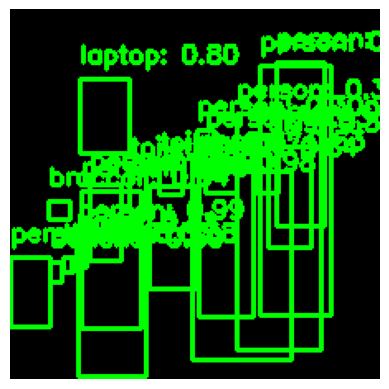

Frame 204, Label: 1, Score: 0.9901302456855774
Frame 204, Label: 1, Score: 0.9829640984535217
Frame 204, Label: 1, Score: 0.9672161936759949
Frame 204, Label: 1, Score: 0.9658783674240112
Frame 204, Label: 1, Score: 0.9320557713508606
Frame 204, Label: 1, Score: 0.8892408013343811
Frame 204, Label: 1, Score: 0.8426611423492432
Frame 204, Label: 64, Score: 0.8006492257118225
Frame 204, Label: 47, Score: 0.6897993087768555
Frame 204, Label: 51, Score: 0.6379441022872925
Frame 204, Label: 1, Score: 0.634189784526825
Frame 204, Label: 1, Score: 0.5896497368812561
Frame 204, Label: 1, Score: 0.5808573961257935
Frame 204, Label: 62, Score: 0.4165291488170624
Frame 204, Label: 44, Score: 0.40895944833755493
Frame 204, Label: 47, Score: 0.38499435782432556
Frame 204, Label: 62, Score: 0.3710706830024719
Frame 204, Label: 31, Score: 0.3576662540435791
Frame 204, Label: 44, Score: 0.3495955467224121
Frame 204, Label: 1, Score: 0.3450210392475128
Frame 204, Label: 1, Score: 0.3337198793888092
Fra

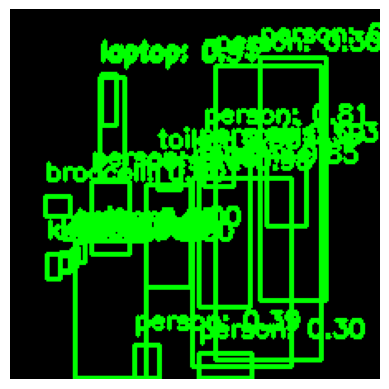

Frame 205, Label: 1, Score: 0.9956413507461548
Frame 205, Label: 1, Score: 0.986208438873291
Frame 205, Label: 1, Score: 0.9765327572822571
Frame 205, Label: 1, Score: 0.9504380226135254
Frame 205, Label: 1, Score: 0.8499974012374878
Frame 205, Label: 1, Score: 0.8139134645462036
Frame 205, Label: 51, Score: 0.5953248143196106
Frame 205, Label: 1, Score: 0.5942397713661194
Frame 205, Label: 64, Score: 0.4263509213924408
Frame 205, Label: 44, Score: 0.40470749139785767
Frame 205, Label: 1, Score: 0.386727899312973
Frame 205, Label: 44, Score: 0.38490089774131775
Frame 205, Label: 31, Score: 0.3630884885787964
Frame 205, Label: 62, Score: 0.3524482846260071
Frame 205, Label: 44, Score: 0.3217431604862213
Frame 205, Label: 44, Score: 0.31873005628585815
Frame 205, Label: 64, Score: 0.3059373199939728
Frame 205, Label: 1, Score: 0.3034493327140808
Frame 205, Label: 1, Score: 0.3032786250114441
Frame 205, Label: 47, Score: 0.301728755235672
Frame 205, Label: 44, Score: 0.30071231722831726


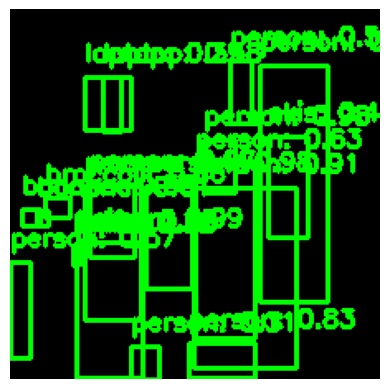

Frame 206, Label: 1, Score: 0.9911280870437622
Frame 206, Label: 1, Score: 0.9834808707237244
Frame 206, Label: 1, Score: 0.9814323782920837
Frame 206, Label: 1, Score: 0.9766944646835327
Frame 206, Label: 1, Score: 0.9656825065612793
Frame 206, Label: 1, Score: 0.9148356318473816
Frame 206, Label: 51, Score: 0.864802360534668
Frame 206, Label: 1, Score: 0.8333685398101807
Frame 206, Label: 1, Score: 0.6266483664512634
Frame 206, Label: 47, Score: 0.6128380298614502
Frame 206, Label: 1, Score: 0.5706431865692139
Frame 206, Label: 1, Score: 0.5669102072715759
Frame 206, Label: 47, Score: 0.4972696006298065
Frame 206, Label: 1, Score: 0.4122576415538788
Frame 206, Label: 31, Score: 0.409656822681427
Frame 206, Label: 64, Score: 0.3851006031036377
Frame 206, Label: 64, Score: 0.3809014558792114
Frame 206, Label: 44, Score: 0.37510377168655396
Frame 206, Label: 44, Score: 0.34968456625938416
Frame 206, Label: 44, Score: 0.31702300906181335
Frame 206, Label: 1, Score: 0.31384119391441345


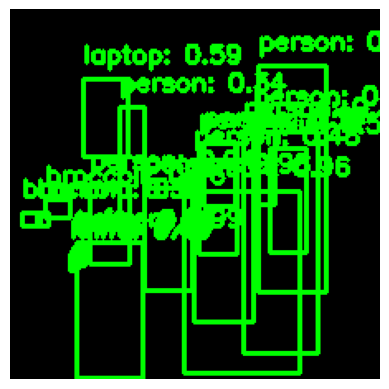

Frame 207, Label: 1, Score: 0.9867240786552429
Frame 207, Label: 1, Score: 0.9803078770637512
Frame 207, Label: 1, Score: 0.9753119945526123
Frame 207, Label: 1, Score: 0.9708467125892639
Frame 207, Label: 1, Score: 0.9642389416694641
Frame 207, Label: 1, Score: 0.9439796209335327
Frame 207, Label: 51, Score: 0.7610619068145752
Frame 207, Label: 1, Score: 0.6726041436195374
Frame 207, Label: 44, Score: 0.6686331033706665
Frame 207, Label: 47, Score: 0.6104157567024231
Frame 207, Label: 44, Score: 0.5973156690597534
Frame 207, Label: 44, Score: 0.5891954302787781
Frame 207, Label: 64, Score: 0.5852261781692505
Frame 207, Label: 31, Score: 0.5526312589645386
Frame 207, Label: 44, Score: 0.49719753861427307
Frame 207, Label: 1, Score: 0.47801876068115234
Frame 207, Label: 44, Score: 0.44530847668647766
Frame 207, Label: 1, Score: 0.35828182101249695
Frame 207, Label: 1, Score: 0.3446679711341858
Frame 207, Label: 1, Score: 0.3378717303276062
Frame 207, Label: 51, Score: 0.3010907173156738

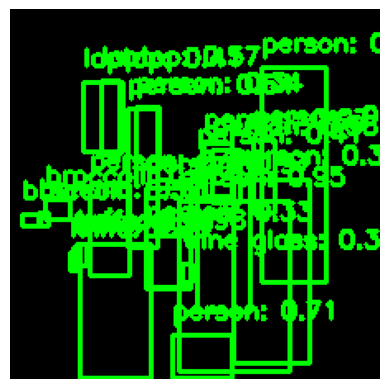

Frame 208, Label: 1, Score: 0.9854812026023865
Frame 208, Label: 1, Score: 0.9791004061698914
Frame 208, Label: 1, Score: 0.9688443541526794
Frame 208, Label: 1, Score: 0.9667725563049316
Frame 208, Label: 1, Score: 0.9452975392341614
Frame 208, Label: 1, Score: 0.9090869426727295
Frame 208, Label: 1, Score: 0.842177152633667
Frame 208, Label: 44, Score: 0.8098470568656921
Frame 208, Label: 44, Score: 0.7579697966575623
Frame 208, Label: 1, Score: 0.7136073112487793
Frame 208, Label: 51, Score: 0.6631978154182434
Frame 208, Label: 1, Score: 0.6388856768608093
Frame 208, Label: 47, Score: 0.6070827841758728
Frame 208, Label: 64, Score: 0.572806715965271
Frame 208, Label: 44, Score: 0.509871244430542
Frame 208, Label: 1, Score: 0.41030794382095337
Frame 208, Label: 64, Score: 0.40884044766426086
Frame 208, Label: 1, Score: 0.3755258619785309
Frame 208, Label: 1, Score: 0.3436765670776367
Frame 208, Label: 1, Score: 0.33096006512641907
Frame 208, Label: 41, Score: 0.3228946030139923
Frame

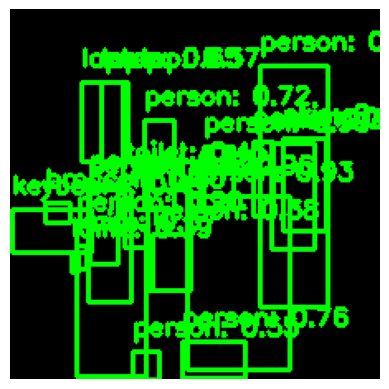

Frame 209, Label: 1, Score: 0.9844372272491455
Frame 209, Label: 1, Score: 0.9594384431838989
Frame 209, Label: 1, Score: 0.928748607635498
Frame 209, Label: 1, Score: 0.9030405282974243
Frame 209, Label: 1, Score: 0.899000346660614
Frame 209, Label: 1, Score: 0.8904779553413391
Frame 209, Label: 1, Score: 0.8758029341697693
Frame 209, Label: 51, Score: 0.8034636378288269
Frame 209, Label: 1, Score: 0.7565298080444336
Frame 209, Label: 1, Score: 0.718001127243042
Frame 209, Label: 64, Score: 0.6544955372810364
Frame 209, Label: 64, Score: 0.5726343393325806
Frame 209, Label: 44, Score: 0.5716522932052612
Frame 209, Label: 1, Score: 0.5467458367347717
Frame 209, Label: 62, Score: 0.4525955617427826
Frame 209, Label: 67, Score: 0.40966254472732544
Frame 209, Label: 44, Score: 0.391789048910141
Frame 209, Label: 1, Score: 0.38188326358795166
Frame 209, Label: 31, Score: 0.37018483877182007
Frame 209, Label: 31, Score: 0.35456666350364685
Frame 209, Label: 1, Score: 0.32012486457824707


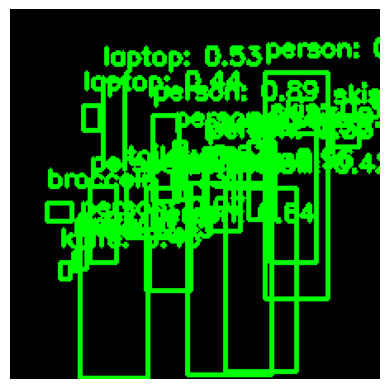

Frame 210, Label: 1, Score: 0.9775326251983643
Frame 210, Label: 1, Score: 0.9740414023399353
Frame 210, Label: 1, Score: 0.9632412791252136
Frame 210, Label: 1, Score: 0.9530404806137085
Frame 210, Label: 1, Score: 0.945466935634613
Frame 210, Label: 62, Score: 0.9252688884735107
Frame 210, Label: 1, Score: 0.911499559879303
Frame 210, Label: 1, Score: 0.8938803672790527
Frame 210, Label: 1, Score: 0.8613361716270447
Frame 210, Label: 44, Score: 0.7734102010726929
Frame 210, Label: 51, Score: 0.7303569912910461
Frame 210, Label: 1, Score: 0.6420642733573914
Frame 210, Label: 64, Score: 0.5278463959693909
Frame 210, Label: 44, Score: 0.45476996898651123
Frame 210, Label: 1, Score: 0.449430376291275
Frame 210, Label: 64, Score: 0.4360554814338684
Frame 210, Label: 1, Score: 0.41614654660224915
Frame 210, Label: 31, Score: 0.3588407337665558
Frame 210, Label: 44, Score: 0.3545166254043579
Frame 210, Label: 31, Score: 0.34482213854789734
Frame 210, Label: 1, Score: 0.33097612857818604


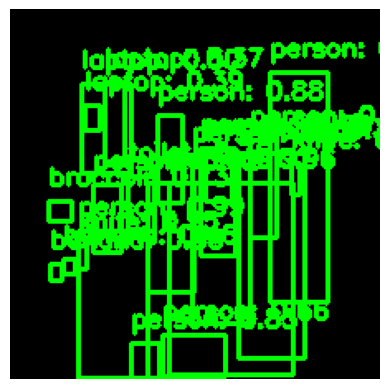

Frame 211, Label: 1, Score: 0.9931284189224243
Frame 211, Label: 1, Score: 0.9826194047927856
Frame 211, Label: 1, Score: 0.9722415208816528
Frame 211, Label: 1, Score: 0.9550358653068542
Frame 211, Label: 1, Score: 0.9231476783752441
Frame 211, Label: 1, Score: 0.876530110836029
Frame 211, Label: 1, Score: 0.8456434607505798
Frame 211, Label: 62, Score: 0.7646210193634033
Frame 211, Label: 51, Score: 0.7321268320083618
Frame 211, Label: 1, Score: 0.7001765966415405
Frame 211, Label: 1, Score: 0.6655775904655457
Frame 211, Label: 1, Score: 0.6576617360115051
Frame 211, Label: 47, Score: 0.5964637398719788
Frame 211, Label: 44, Score: 0.550414502620697
Frame 211, Label: 64, Score: 0.49944570660591125
Frame 211, Label: 1, Score: 0.4781506657600403
Frame 211, Label: 47, Score: 0.4631025493144989
Frame 211, Label: 44, Score: 0.46055302023887634
Frame 211, Label: 1, Score: 0.4570472240447998
Frame 211, Label: 64, Score: 0.39229437708854675
Frame 211, Label: 64, Score: 0.36507928371429443
Fr

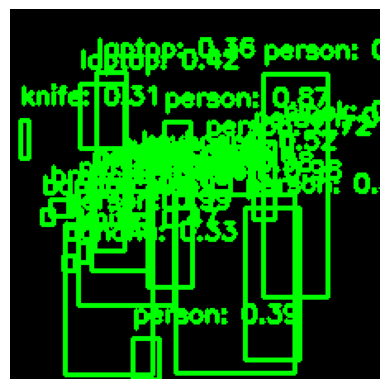

Frame 212, Label: 1, Score: 0.9948838353157043
Frame 212, Label: 1, Score: 0.9848886728286743
Frame 212, Label: 1, Score: 0.9761747121810913
Frame 212, Label: 1, Score: 0.9760518074035645
Frame 212, Label: 75, Score: 0.913653552532196
Frame 212, Label: 1, Score: 0.8898592591285706
Frame 212, Label: 1, Score: 0.8891154527664185
Frame 212, Label: 1, Score: 0.8746609091758728
Frame 212, Label: 1, Score: 0.7231731414794922
Frame 212, Label: 51, Score: 0.6996154189109802
Frame 212, Label: 47, Score: 0.593655526638031
Frame 212, Label: 62, Score: 0.5750499367713928
Frame 212, Label: 67, Score: 0.5165180563926697
Frame 212, Label: 1, Score: 0.49984002113342285
Frame 212, Label: 44, Score: 0.4706052243709564
Frame 212, Label: 64, Score: 0.42210549116134644
Frame 212, Label: 1, Score: 0.3923652768135071
Frame 212, Label: 1, Score: 0.3911575973033905
Frame 212, Label: 64, Score: 0.3620336055755615
Frame 212, Label: 62, Score: 0.3449523448944092
Frame 212, Label: 47, Score: 0.32803839445114136
Fr

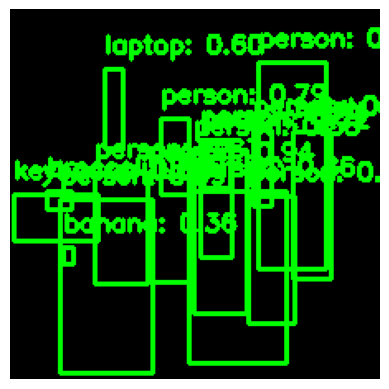

Frame 213, Label: 1, Score: 0.9930458664894104
Frame 213, Label: 1, Score: 0.9789583683013916
Frame 213, Label: 1, Score: 0.9419604539871216
Frame 213, Label: 1, Score: 0.8567739725112915
Frame 213, Label: 1, Score: 0.8327752351760864
Frame 213, Label: 1, Score: 0.7892529964447021
Frame 213, Label: 1, Score: 0.7246016263961792
Frame 213, Label: 51, Score: 0.6680792570114136
Frame 213, Label: 1, Score: 0.6629303693771362
Frame 213, Label: 67, Score: 0.6159797310829163
Frame 213, Label: 64, Score: 0.6046713590621948
Frame 213, Label: 62, Score: 0.5826095342636108
Frame 213, Label: 1, Score: 0.5822374224662781
Frame 213, Label: 1, Score: 0.5212972164154053
Frame 213, Label: 1, Score: 0.36543846130371094
Frame 213, Label: 47, Score: 0.3565766513347626


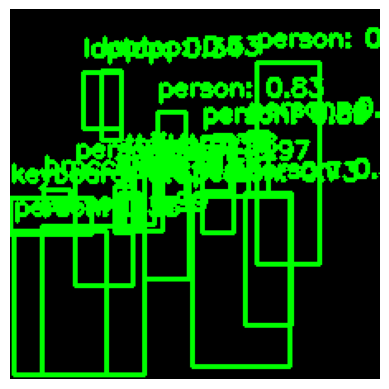

Frame 214, Label: 1, Score: 0.9889301657676697
Frame 214, Label: 1, Score: 0.9741076827049255
Frame 214, Label: 1, Score: 0.9696331024169922
Frame 214, Label: 1, Score: 0.8870052099227905
Frame 214, Label: 1, Score: 0.8679097294807434
Frame 214, Label: 1, Score: 0.8252695202827454
Frame 214, Label: 1, Score: 0.7331942915916443
Frame 214, Label: 1, Score: 0.7294970154762268
Frame 214, Label: 1, Score: 0.6644444465637207
Frame 214, Label: 67, Score: 0.6254442930221558
Frame 214, Label: 62, Score: 0.5831051468849182
Frame 214, Label: 64, Score: 0.528182327747345
Frame 214, Label: 62, Score: 0.5064187049865723
Frame 214, Label: 51, Score: 0.4870325028896332
Frame 214, Label: 1, Score: 0.37675780057907104
Frame 214, Label: 1, Score: 0.34533753991127014
Frame 214, Label: 62, Score: 0.3409269452095032
Frame 214, Label: 64, Score: 0.337746798992157
Frame 214, Label: 62, Score: 0.3270949125289917


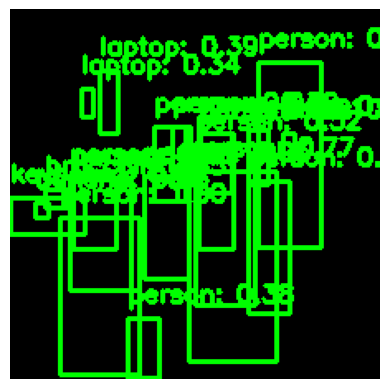

Frame 215, Label: 1, Score: 0.9950120449066162
Frame 215, Label: 1, Score: 0.9522296190261841
Frame 215, Label: 1, Score: 0.9496526718139648
Frame 215, Label: 1, Score: 0.9399906396865845
Frame 215, Label: 1, Score: 0.8130207061767578
Frame 215, Label: 1, Score: 0.7718558311462402
Frame 215, Label: 1, Score: 0.7412731051445007
Frame 215, Label: 1, Score: 0.6837335824966431
Frame 215, Label: 1, Score: 0.642561137676239
Frame 215, Label: 44, Score: 0.6181575655937195
Frame 215, Label: 1, Score: 0.6111997961997986
Frame 215, Label: 67, Score: 0.5993080139160156
Frame 215, Label: 51, Score: 0.5451317429542542
Frame 215, Label: 1, Score: 0.5198144912719727
Frame 215, Label: 1, Score: 0.4738607704639435
Frame 215, Label: 64, Score: 0.3911084532737732
Frame 215, Label: 1, Score: 0.37596654891967773
Frame 215, Label: 64, Score: 0.3401796519756317
Frame 215, Label: 47, Score: 0.3289566934108734
Frame 215, Label: 1, Score: 0.32046598196029663


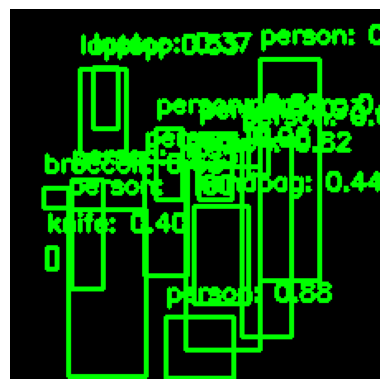

Frame 216, Label: 1, Score: 0.9969985485076904
Frame 216, Label: 1, Score: 0.9685720801353455
Frame 216, Label: 1, Score: 0.9558995962142944
Frame 216, Label: 1, Score: 0.9465410113334656
Frame 216, Label: 1, Score: 0.9277216196060181
Frame 216, Label: 1, Score: 0.8776010870933533
Frame 216, Label: 1, Score: 0.832128643989563
Frame 216, Label: 1, Score: 0.8174414038658142
Frame 216, Label: 1, Score: 0.6794725656509399
Frame 216, Label: 1, Score: 0.6346803307533264
Frame 216, Label: 51, Score: 0.6338204741477966
Frame 216, Label: 64, Score: 0.5262266397476196
Frame 216, Label: 27, Score: 0.44435760378837585
Frame 216, Label: 44, Score: 0.39888662099838257
Frame 216, Label: 64, Score: 0.3676087260246277


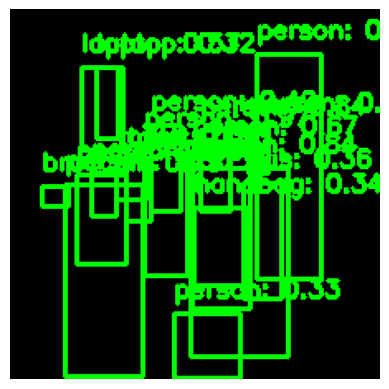

Frame 217, Label: 1, Score: 0.9958620071411133
Frame 217, Label: 1, Score: 0.977822482585907
Frame 217, Label: 1, Score: 0.9650697112083435
Frame 217, Label: 1, Score: 0.8384899497032166
Frame 217, Label: 1, Score: 0.8362935185432434
Frame 217, Label: 62, Score: 0.8308122158050537
Frame 217, Label: 1, Score: 0.7593938112258911
Frame 217, Label: 51, Score: 0.7496448159217834
Frame 217, Label: 1, Score: 0.6737769842147827
Frame 217, Label: 64, Score: 0.5728274583816528
Frame 217, Label: 1, Score: 0.49197712540626526
Frame 217, Label: 1, Score: 0.48927274346351624
Frame 217, Label: 62, Score: 0.39424169063568115
Frame 217, Label: 1, Score: 0.3822000324726105
Frame 217, Label: 31, Score: 0.3600314259529114
Frame 217, Label: 27, Score: 0.3350490927696228
Frame 217, Label: 1, Score: 0.33085593581199646
Frame 217, Label: 64, Score: 0.3163984417915344


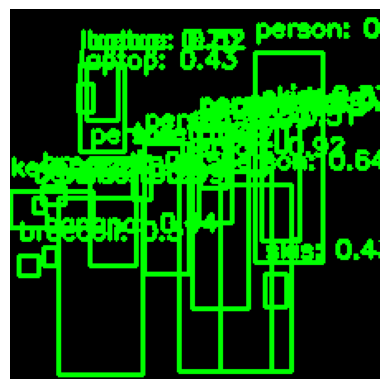

Frame 218, Label: 1, Score: 0.9906248450279236
Frame 218, Label: 1, Score: 0.9854270219802856
Frame 218, Label: 1, Score: 0.9605288505554199
Frame 218, Label: 1, Score: 0.9222269058227539
Frame 218, Label: 1, Score: 0.9047505259513855
Frame 218, Label: 1, Score: 0.8882424831390381
Frame 218, Label: 1, Score: 0.7706032395362854
Frame 218, Label: 1, Score: 0.7264224290847778
Frame 218, Label: 64, Score: 0.7028497457504272
Frame 218, Label: 67, Score: 0.6433613300323486
Frame 218, Label: 1, Score: 0.636637270450592
Frame 218, Label: 47, Score: 0.5521116852760315
Frame 218, Label: 64, Score: 0.5196515917778015
Frame 218, Label: 1, Score: 0.5058835744857788
Frame 218, Label: 62, Score: 0.4709915816783905
Frame 218, Label: 51, Score: 0.44933611154556274
Frame 218, Label: 47, Score: 0.4411999583244324
Frame 218, Label: 31, Score: 0.43035033345222473
Frame 218, Label: 64, Score: 0.42653149366378784
Frame 218, Label: 51, Score: 0.37310367822647095
Frame 218, Label: 31, Score: 0.3341369032859802

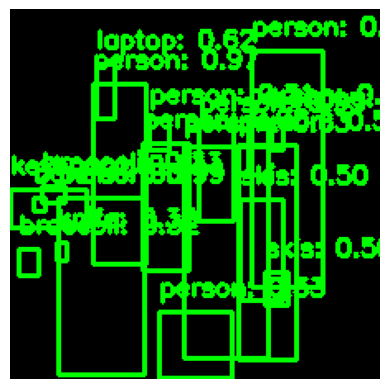

Frame 219, Label: 1, Score: 0.988524854183197
Frame 219, Label: 1, Score: 0.9834890365600586
Frame 219, Label: 1, Score: 0.9718908667564392
Frame 219, Label: 1, Score: 0.9506862163543701
Frame 219, Label: 1, Score: 0.9436078667640686
Frame 219, Label: 1, Score: 0.7841624021530151
Frame 219, Label: 1, Score: 0.6285997033119202
Frame 219, Label: 64, Score: 0.6171292066574097
Frame 219, Label: 1, Score: 0.5374073386192322
Frame 219, Label: 31, Score: 0.5048956871032715
Frame 219, Label: 31, Score: 0.49636393785476685
Frame 219, Label: 47, Score: 0.37001973390579224
Frame 219, Label: 1, Score: 0.3330875635147095
Frame 219, Label: 47, Score: 0.3306058943271637
Frame 219, Label: 51, Score: 0.3262040317058563
Frame 219, Label: 67, Score: 0.3253094255924225
Frame 219, Label: 44, Score: 0.3198636472225189
Frame 219, Label: 51, Score: 0.31675368547439575
Frame 219, Label: 1, Score: 0.3102348744869232


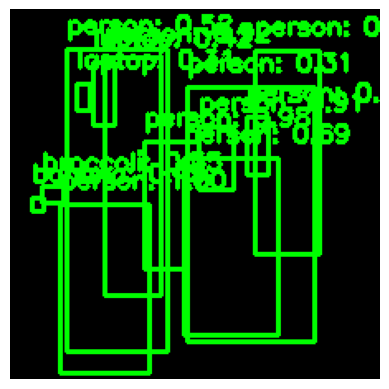

Frame 220, Label: 1, Score: 0.9965919256210327
Frame 220, Label: 1, Score: 0.9789227247238159
Frame 220, Label: 1, Score: 0.9702162146568298
Frame 220, Label: 1, Score: 0.9213801622390747
Frame 220, Label: 1, Score: 0.9118528962135315
Frame 220, Label: 1, Score: 0.803909420967102
Frame 220, Label: 1, Score: 0.6908209919929504
Frame 220, Label: 51, Score: 0.5464115738868713
Frame 220, Label: 1, Score: 0.5241008400917053
Frame 220, Label: 47, Score: 0.45187142491340637
Frame 220, Label: 64, Score: 0.4223482012748718
Frame 220, Label: 1, Score: 0.31006860733032227
Frame 220, Label: 64, Score: 0.30680134892463684


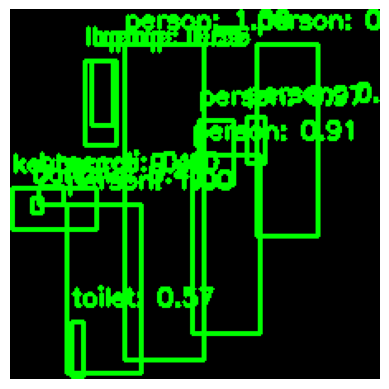

Frame 221, Label: 1, Score: 0.9971289038658142
Frame 221, Label: 1, Score: 0.9950900077819824
Frame 221, Label: 1, Score: 0.9666128754615784
Frame 221, Label: 1, Score: 0.9528909921646118
Frame 221, Label: 1, Score: 0.9104677438735962
Frame 221, Label: 1, Score: 0.7352616190910339
Frame 221, Label: 64, Score: 0.6547749638557434
Frame 221, Label: 62, Score: 0.5746654272079468
Frame 221, Label: 64, Score: 0.5616471171379089
Frame 221, Label: 47, Score: 0.48474791646003723
Frame 221, Label: 67, Score: 0.4154983460903168
Frame 221, Label: 51, Score: 0.40209493041038513


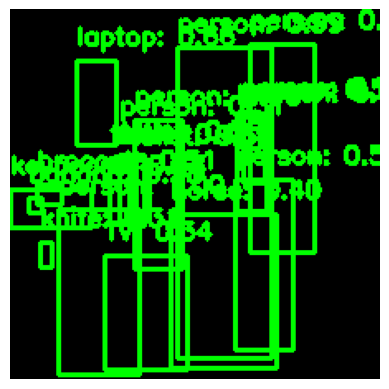

Frame 222, Label: 1, Score: 0.9974297881126404
Frame 222, Label: 1, Score: 0.9927001595497131
Frame 222, Label: 1, Score: 0.9606872797012329
Frame 222, Label: 1, Score: 0.9530839323997498
Frame 222, Label: 1, Score: 0.7079181671142578
Frame 222, Label: 62, Score: 0.6899328827857971
Frame 222, Label: 64, Score: 0.6596382260322571
Frame 222, Label: 1, Score: 0.6559487581253052
Frame 222, Label: 47, Score: 0.5802023410797119
Frame 222, Label: 1, Score: 0.5790917277336121
Frame 222, Label: 62, Score: 0.5629127025604248
Frame 222, Label: 1, Score: 0.510001540184021
Frame 222, Label: 51, Score: 0.5053502917289734
Frame 222, Label: 67, Score: 0.4784861207008362
Frame 222, Label: 62, Score: 0.4625953733921051
Frame 222, Label: 18, Score: 0.39550626277923584
Frame 222, Label: 63, Score: 0.3376159369945526
Frame 222, Label: 1, Score: 0.3120376765727997
Frame 222, Label: 44, Score: 0.3109343945980072


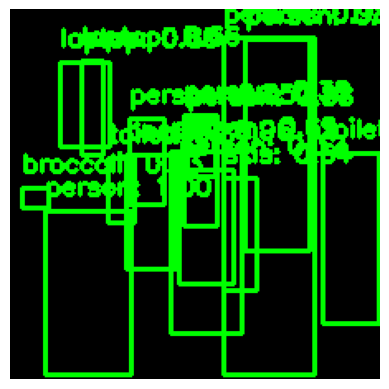

Frame 223, Label: 1, Score: 0.9964520931243896
Frame 223, Label: 1, Score: 0.9798658490180969
Frame 223, Label: 1, Score: 0.959755003452301
Frame 223, Label: 1, Score: 0.8816196322441101
Frame 223, Label: 62, Score: 0.83515465259552
Frame 223, Label: 64, Score: 0.8010194301605225
Frame 223, Label: 1, Score: 0.6924448609352112
Frame 223, Label: 1, Score: 0.6643368005752563
Frame 223, Label: 64, Score: 0.6629295945167542
Frame 223, Label: 31, Score: 0.635413408279419
Frame 223, Label: 1, Score: 0.5480762720108032
Frame 223, Label: 51, Score: 0.43494606018066406
Frame 223, Label: 1, Score: 0.38047486543655396
Frame 223, Label: 62, Score: 0.37767648696899414
Frame 223, Label: 1, Score: 0.3180697560310364


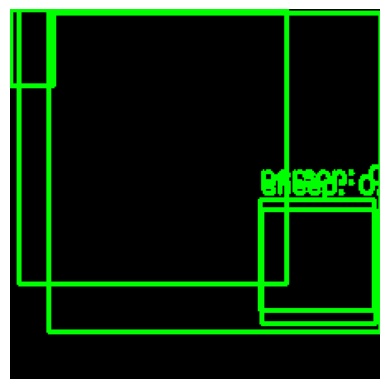

Frame 224, Label: 1, Score: 0.8479518890380859
Frame 224, Label: 1, Score: 0.7633327841758728
Frame 224, Label: 18, Score: 0.6998043060302734
Frame 224, Label: 1, Score: 0.3514172434806824
Frame 224, Label: 19, Score: 0.3508165180683136


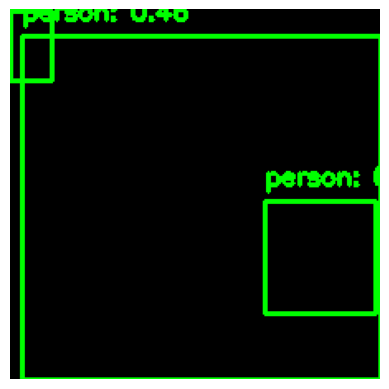

Frame 225, Label: 1, Score: 0.9658402800559998
Frame 225, Label: 1, Score: 0.9621961712837219
Frame 225, Label: 1, Score: 0.4571717083454132


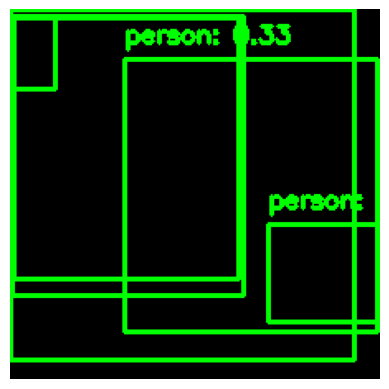

Frame 226, Label: 1, Score: 0.8463927507400513
Frame 226, Label: 1, Score: 0.6063140630722046
Frame 226, Label: 1, Score: 0.4571226239204407
Frame 226, Label: 18, Score: 0.4133354425430298
Frame 226, Label: 1, Score: 0.39137670397758484
Frame 226, Label: 1, Score: 0.3322107195854187


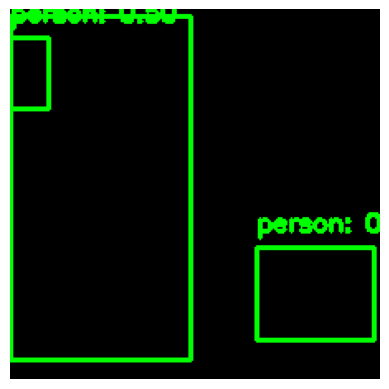

Frame 227, Label: 1, Score: 0.8461210131645203
Frame 227, Label: 1, Score: 0.502465546131134
Frame 227, Label: 1, Score: 0.310211181640625


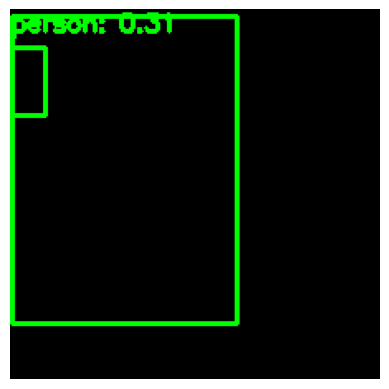

Frame 228, Label: 1, Score: 0.7213332056999207
Frame 228, Label: 1, Score: 0.30957022309303284


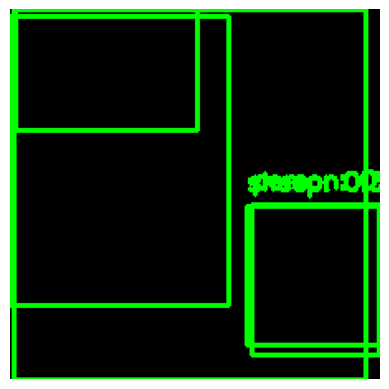

Frame 229, Label: 1, Score: 0.8063593506813049
Frame 229, Label: 1, Score: 0.7653637528419495
Frame 229, Label: 1, Score: 0.693766176700592
Frame 229, Label: 1, Score: 0.6219777464866638
Frame 229, Label: 19, Score: 0.36087915301322937


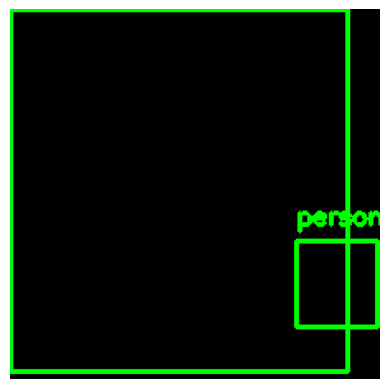

Frame 230, Label: 1, Score: 0.7229297161102295
Frame 230, Label: 1, Score: 0.4717620313167572


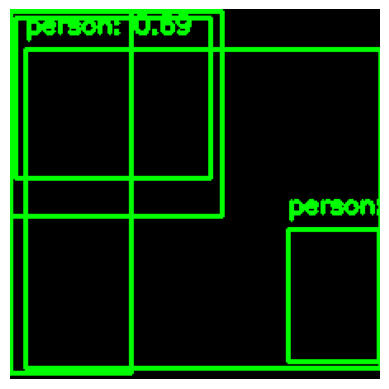

Frame 231, Label: 1, Score: 0.899433434009552
Frame 231, Label: 1, Score: 0.6864579916000366
Frame 231, Label: 18, Score: 0.5198312997817993
Frame 231, Label: 1, Score: 0.40794315934181213
Frame 231, Label: 1, Score: 0.37176278233528137


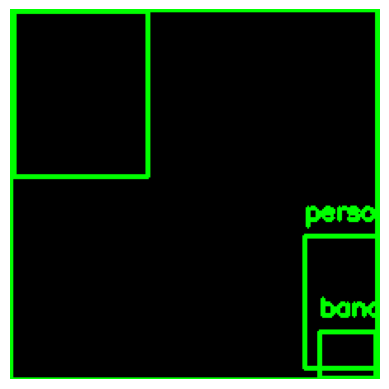

Frame 232, Label: 1, Score: 0.9402278065681458
Frame 232, Label: 1, Score: 0.547234833240509
Frame 232, Label: 18, Score: 0.4456586241722107
Frame 232, Label: 47, Score: 0.40206485986709595


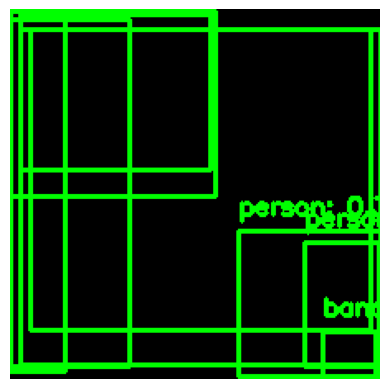

Frame 233, Label: 1, Score: 0.9096521139144897
Frame 233, Label: 1, Score: 0.7840282917022705
Frame 233, Label: 18, Score: 0.6939723491668701
Frame 233, Label: 1, Score: 0.6888325214385986
Frame 233, Label: 47, Score: 0.6768113374710083
Frame 233, Label: 1, Score: 0.5995325446128845
Frame 233, Label: 1, Score: 0.43325376510620117
Frame 233, Label: 1, Score: 0.3811017870903015
Frame 233, Label: 63, Score: 0.35994353890419006


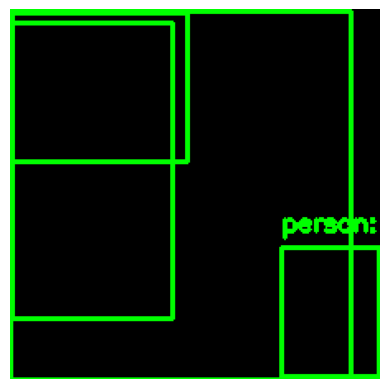

Frame 234, Label: 1, Score: 0.849551796913147
Frame 234, Label: 1, Score: 0.8260248899459839
Frame 234, Label: 1, Score: 0.7923514246940613
Frame 234, Label: 18, Score: 0.5047690272331238


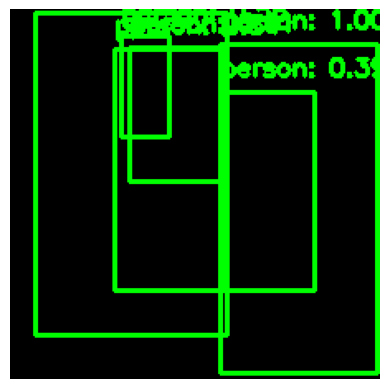

Frame 235, Label: 1, Score: 0.9976886510848999
Frame 235, Label: 1, Score: 0.9974804520606995
Frame 235, Label: 1, Score: 0.8396100401878357
Frame 235, Label: 1, Score: 0.6108829975128174
Frame 235, Label: 1, Score: 0.5562306046485901
Frame 235, Label: 1, Score: 0.387547105550766


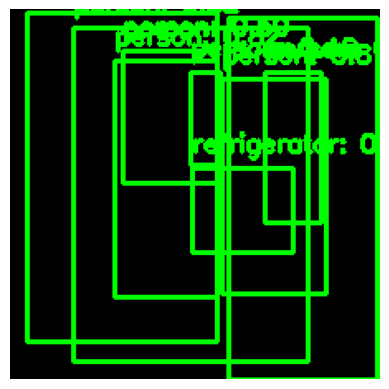

Frame 236, Label: 1, Score: 0.9977030158042908
Frame 236, Label: 1, Score: 0.9970027804374695
Frame 236, Label: 1, Score: 0.8243195414543152
Frame 236, Label: 1, Score: 0.80939120054245
Frame 236, Label: 73, Score: 0.600129246711731
Frame 236, Label: 1, Score: 0.5390060544013977
Frame 236, Label: 1, Score: 0.4998507797718048
Frame 236, Label: 1, Score: 0.46224555373191833
Frame 236, Label: 1, Score: 0.3153756856918335


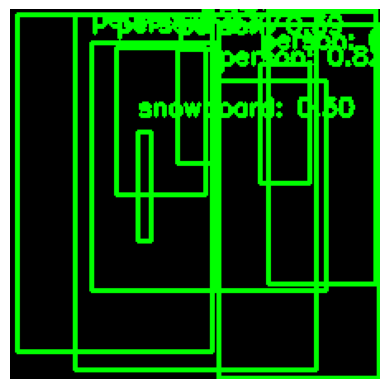

Frame 237, Label: 1, Score: 0.9986275434494019
Frame 237, Label: 1, Score: 0.9976837635040283
Frame 237, Label: 1, Score: 0.8218874931335449
Frame 237, Label: 1, Score: 0.7737368941307068
Frame 237, Label: 1, Score: 0.6224560141563416
Frame 237, Label: 1, Score: 0.45788657665252686
Frame 237, Label: 1, Score: 0.4315814673900604
Frame 237, Label: 1, Score: 0.3867514133453369
Frame 237, Label: 1, Score: 0.32754597067832947
Frame 237, Label: 32, Score: 0.30202460289001465


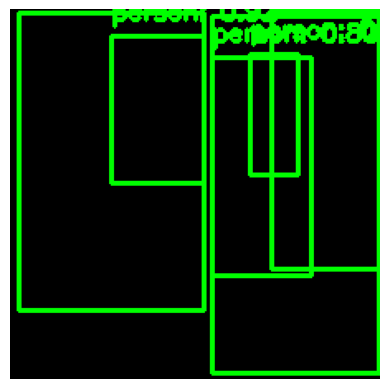

Frame 238, Label: 1, Score: 0.9987630844116211
Frame 238, Label: 1, Score: 0.9972286820411682
Frame 238, Label: 1, Score: 0.9215165972709656
Frame 238, Label: 1, Score: 0.8034676313400269
Frame 238, Label: 1, Score: 0.7487976551055908
Frame 238, Label: 1, Score: 0.32265740633010864


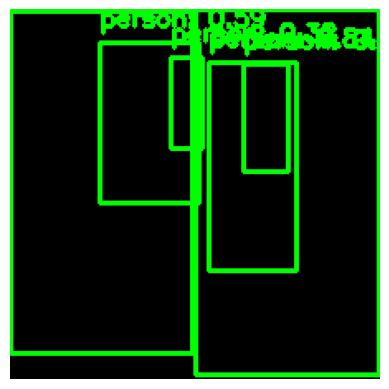

Frame 239, Label: 1, Score: 0.9981426000595093
Frame 239, Label: 1, Score: 0.992846667766571
Frame 239, Label: 1, Score: 0.8629423379898071
Frame 239, Label: 1, Score: 0.8364478349685669
Frame 239, Label: 1, Score: 0.5865199565887451
Frame 239, Label: 1, Score: 0.3188570439815521


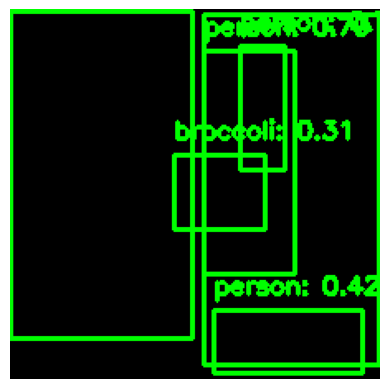

Frame 240, Label: 1, Score: 0.9977533221244812
Frame 240, Label: 1, Score: 0.9945236444473267
Frame 240, Label: 1, Score: 0.7858889698982239
Frame 240, Label: 1, Score: 0.7810788750648499
Frame 240, Label: 1, Score: 0.4215361773967743
Frame 240, Label: 51, Score: 0.30986225605010986


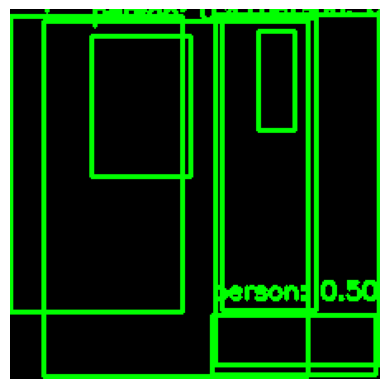

Frame 241, Label: 1, Score: 0.9968658089637756
Frame 241, Label: 1, Score: 0.9964141249656677
Frame 241, Label: 1, Score: 0.5034565925598145
Frame 241, Label: 1, Score: 0.4137150049209595
Frame 241, Label: 1, Score: 0.41119855642318726
Frame 241, Label: 1, Score: 0.39513054490089417
Frame 241, Label: 1, Score: 0.3112519085407257


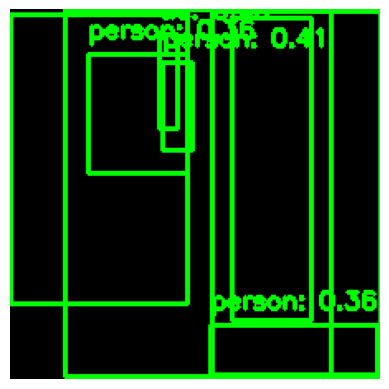

Frame 242, Label: 1, Score: 0.9977688789367676
Frame 242, Label: 1, Score: 0.9959304928779602
Frame 242, Label: 1, Score: 0.7939555644989014
Frame 242, Label: 28, Score: 0.4506829082965851
Frame 242, Label: 1, Score: 0.4122920632362366
Frame 242, Label: 1, Score: 0.3634090721607208
Frame 242, Label: 1, Score: 0.3601784110069275
Frame 242, Label: 1, Score: 0.3319900929927826


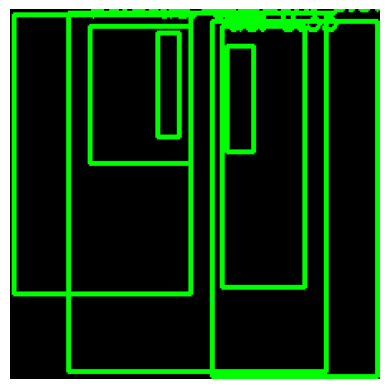

Frame 243, Label: 1, Score: 0.9979117512702942
Frame 243, Label: 1, Score: 0.9967413544654846
Frame 243, Label: 1, Score: 0.674894392490387
Frame 243, Label: 1, Score: 0.6031187176704407
Frame 243, Label: 1, Score: 0.4611963629722595
Frame 243, Label: 28, Score: 0.3278501033782959
Frame 243, Label: 28, Score: 0.30429700016975403


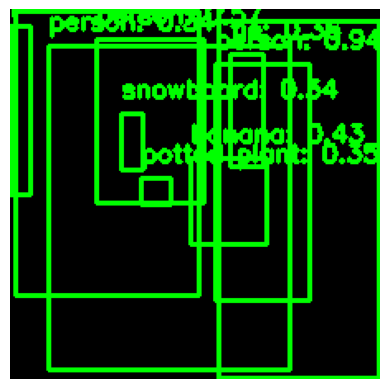

Frame 244, Label: 1, Score: 0.9983488321304321
Frame 244, Label: 1, Score: 0.9955514073371887
Frame 244, Label: 1, Score: 0.9414761662483215
Frame 244, Label: 1, Score: 0.570310652256012
Frame 244, Label: 1, Score: 0.47676903009414673
Frame 244, Label: 47, Score: 0.430923730134964
Frame 244, Label: 28, Score: 0.35962632298469543
Frame 244, Label: 59, Score: 0.3459545373916626
Frame 244, Label: 32, Score: 0.33742931485176086
Frame 244, Label: 1, Score: 0.33702120184898376


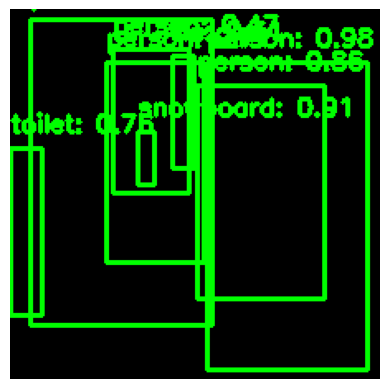

Frame 245, Label: 1, Score: 0.9947342872619629
Frame 245, Label: 1, Score: 0.9825083613395691
Frame 245, Label: 32, Score: 0.9127452373504639
Frame 245, Label: 1, Score: 0.8604004979133606
Frame 245, Label: 62, Score: 0.7565236687660217
Frame 245, Label: 1, Score: 0.712084174156189
Frame 245, Label: 1, Score: 0.47238224744796753
Frame 245, Label: 28, Score: 0.31375816464424133


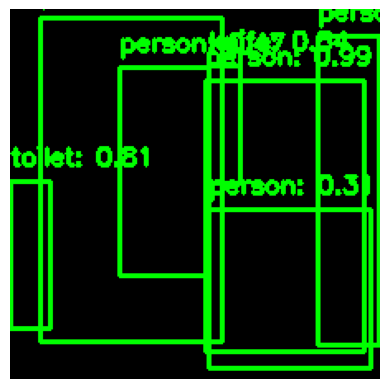

Frame 246, Label: 1, Score: 0.9962636828422546
Frame 246, Label: 1, Score: 0.9921586513519287
Frame 246, Label: 62, Score: 0.807824969291687
Frame 246, Label: 1, Score: 0.7868101000785828
Frame 246, Label: 44, Score: 0.5436204075813293
Frame 246, Label: 1, Score: 0.4693579077720642
Frame 246, Label: 1, Score: 0.30812162160873413


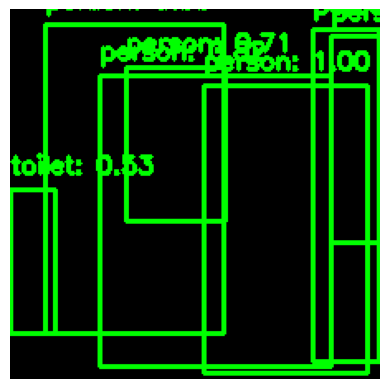

Frame 247, Label: 1, Score: 0.996122419834137
Frame 247, Label: 1, Score: 0.99007648229599
Frame 247, Label: 1, Score: 0.8206071257591248
Frame 247, Label: 1, Score: 0.7064951658248901
Frame 247, Label: 1, Score: 0.537402868270874
Frame 247, Label: 62, Score: 0.5303157567977905
Frame 247, Label: 1, Score: 0.36711758375167847


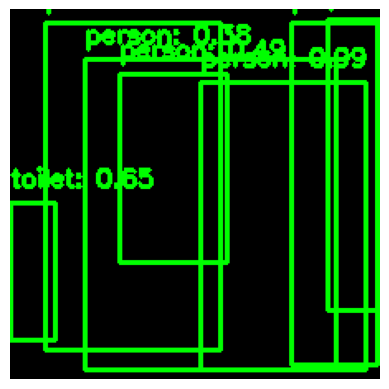

Frame 248, Label: 1, Score: 0.9956920742988586
Frame 248, Label: 1, Score: 0.994046688079834
Frame 248, Label: 62, Score: 0.6461771130561829
Frame 248, Label: 1, Score: 0.4861544668674469
Frame 248, Label: 1, Score: 0.4370657205581665
Frame 248, Label: 1, Score: 0.38650795817375183
Frame 248, Label: 1, Score: 0.3804702162742615


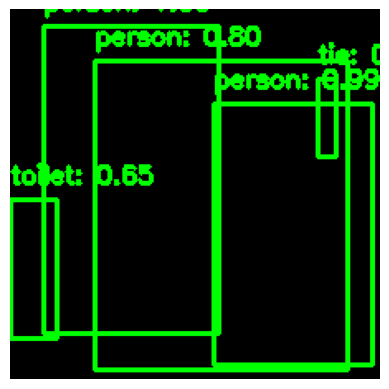

Frame 249, Label: 1, Score: 0.9950066804885864
Frame 249, Label: 1, Score: 0.993033766746521
Frame 249, Label: 1, Score: 0.7982282638549805
Frame 249, Label: 62, Score: 0.6494132280349731
Frame 249, Label: 28, Score: 0.3004895746707916


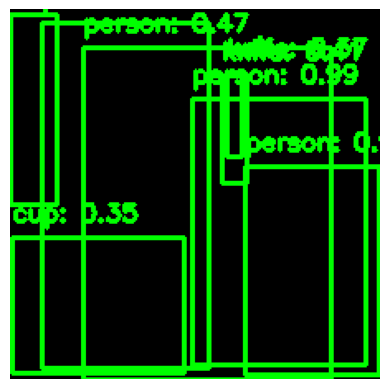

Frame 250, Label: 1, Score: 0.9970843195915222
Frame 250, Label: 1, Score: 0.9928321838378906
Frame 250, Label: 1, Score: 0.9233883023262024
Frame 250, Label: 1, Score: 0.8698772192001343
Frame 250, Label: 1, Score: 0.4684957265853882
Frame 250, Label: 44, Score: 0.407214879989624
Frame 250, Label: 44, Score: 0.37061643600463867
Frame 250, Label: 42, Score: 0.3497120440006256


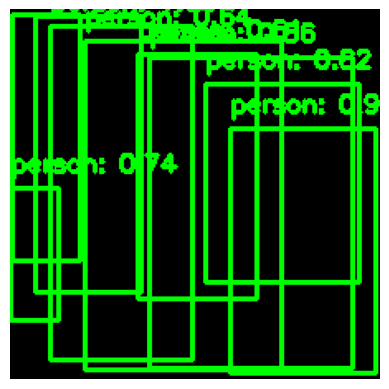

Frame 251, Label: 1, Score: 0.9953606724739075
Frame 251, Label: 1, Score: 0.9925829172134399
Frame 251, Label: 1, Score: 0.9305816292762756
Frame 251, Label: 1, Score: 0.8642773628234863
Frame 251, Label: 1, Score: 0.8165368437767029
Frame 251, Label: 1, Score: 0.744641125202179
Frame 251, Label: 1, Score: 0.6407620906829834
Frame 251, Label: 1, Score: 0.6097478270530701
Frame 251, Label: 1, Score: 0.4189794659614563


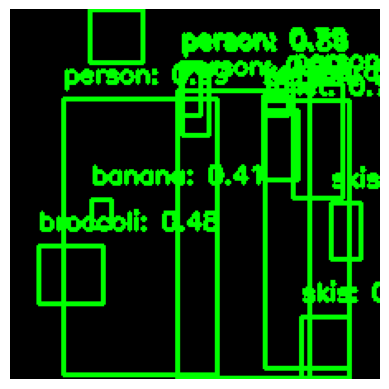

Frame 252, Label: 1, Score: 0.9868387579917908
Frame 252, Label: 1, Score: 0.9853518605232239
Frame 252, Label: 1, Score: 0.8586598634719849
Frame 252, Label: 1, Score: 0.8385112881660461
Frame 252, Label: 1, Score: 0.7940685749053955
Frame 252, Label: 62, Score: 0.7682710289955139
Frame 252, Label: 31, Score: 0.7596993446350098
Frame 252, Label: 51, Score: 0.48179104924201965
Frame 252, Label: 1, Score: 0.4712265431880951
Frame 252, Label: 67, Score: 0.41336268186569214
Frame 252, Label: 47, Score: 0.4066539406776428
Frame 252, Label: 31, Score: 0.36450138688087463
Frame 252, Label: 64, Score: 0.3047047555446625


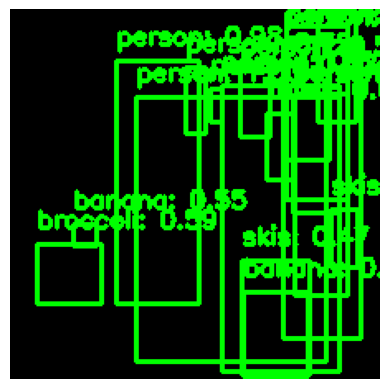

Frame 253, Label: 1, Score: 0.9951004385948181
Frame 253, Label: 1, Score: 0.9779546856880188
Frame 253, Label: 1, Score: 0.8341964483261108
Frame 253, Label: 31, Score: 0.7780888676643372
Frame 253, Label: 1, Score: 0.7158555388450623
Frame 253, Label: 1, Score: 0.6416970491409302
Frame 253, Label: 62, Score: 0.6321796774864197
Frame 253, Label: 51, Score: 0.5850192308425903
Frame 253, Label: 1, Score: 0.576161801815033
Frame 253, Label: 47, Score: 0.5530167818069458
Frame 253, Label: 1, Score: 0.5029277205467224
Frame 253, Label: 31, Score: 0.47361499071121216
Frame 253, Label: 1, Score: 0.42301496863365173
Frame 253, Label: 47, Score: 0.3921942412853241
Frame 253, Label: 1, Score: 0.32522666454315186
Frame 253, Label: 1, Score: 0.3230033218860626
Frame 253, Label: 1, Score: 0.3197591304779053
Frame 253, Label: 1, Score: 0.31865575909614563


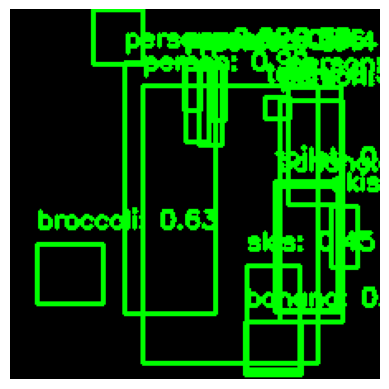

Frame 254, Label: 1, Score: 0.9942428469657898
Frame 254, Label: 1, Score: 0.9833022952079773
Frame 254, Label: 1, Score: 0.9234463572502136
Frame 254, Label: 1, Score: 0.7334997653961182
Frame 254, Label: 1, Score: 0.7033034563064575
Frame 254, Label: 31, Score: 0.6953989267349243
Frame 254, Label: 51, Score: 0.6343652606010437
Frame 254, Label: 1, Score: 0.6243380904197693
Frame 254, Label: 31, Score: 0.4536735415458679
Frame 254, Label: 1, Score: 0.44180700182914734
Frame 254, Label: 64, Score: 0.39494961500167847
Frame 254, Label: 62, Score: 0.36954793334007263
Frame 254, Label: 1, Score: 0.357712060213089
Frame 254, Label: 47, Score: 0.33673539757728577
Frame 254, Label: 62, Score: 0.3066403269767761
Frame 254, Label: 47, Score: 0.304774671792984


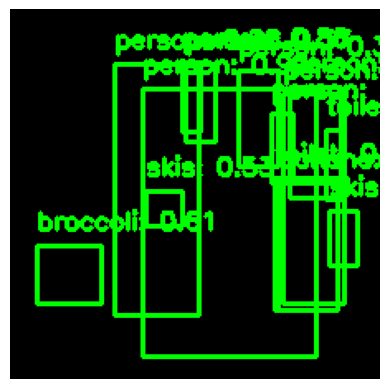

Frame 255, Label: 1, Score: 0.9941586256027222
Frame 255, Label: 1, Score: 0.9898203611373901
Frame 255, Label: 1, Score: 0.9819676876068115
Frame 255, Label: 1, Score: 0.8581165075302124
Frame 255, Label: 51, Score: 0.6063855290412903
Frame 255, Label: 31, Score: 0.5268062353134155
Frame 255, Label: 31, Score: 0.5222437977790833
Frame 255, Label: 1, Score: 0.45227742195129395
Frame 255, Label: 1, Score: 0.3783067762851715
Frame 255, Label: 62, Score: 0.3763648569583893
Frame 255, Label: 1, Score: 0.3694491386413574
Frame 255, Label: 1, Score: 0.3650473952293396
Frame 255, Label: 62, Score: 0.3412419259548187
Frame 255, Label: 47, Score: 0.33213141560554504


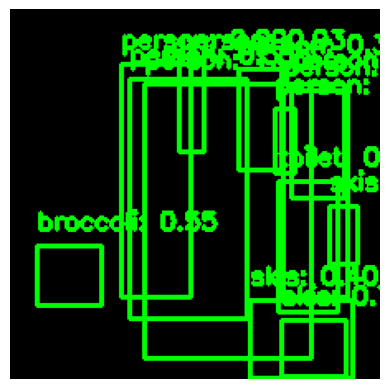

Frame 256, Label: 1, Score: 0.9954797029495239
Frame 256, Label: 1, Score: 0.9879406690597534
Frame 256, Label: 1, Score: 0.987296462059021
Frame 256, Label: 1, Score: 0.9281655550003052
Frame 256, Label: 31, Score: 0.7382471561431885
Frame 256, Label: 31, Score: 0.7103466987609863
Frame 256, Label: 51, Score: 0.5516720414161682
Frame 256, Label: 1, Score: 0.5484625101089478
Frame 256, Label: 1, Score: 0.4806393086910248
Frame 256, Label: 1, Score: 0.44684934616088867
Frame 256, Label: 31, Score: 0.40172091126441956
Frame 256, Label: 1, Score: 0.3476864695549011
Frame 256, Label: 62, Score: 0.3357265293598175


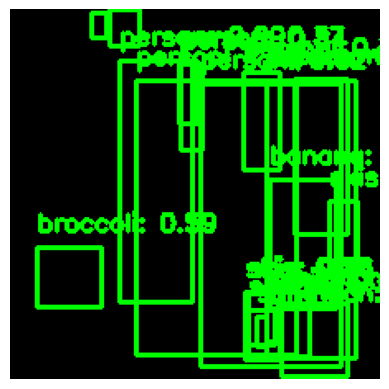

Frame 257, Label: 1, Score: 0.9968383312225342
Frame 257, Label: 1, Score: 0.9854289889335632
Frame 257, Label: 1, Score: 0.9614078998565674
Frame 257, Label: 1, Score: 0.8418623208999634
Frame 257, Label: 47, Score: 0.7218858599662781
Frame 257, Label: 1, Score: 0.623852014541626
Frame 257, Label: 31, Score: 0.6125836372375488
Frame 257, Label: 51, Score: 0.5909498929977417
Frame 257, Label: 64, Score: 0.5696151852607727
Frame 257, Label: 31, Score: 0.47565996646881104
Frame 257, Label: 49, Score: 0.4571998715400696
Frame 257, Label: 31, Score: 0.4094914197921753
Frame 257, Label: 64, Score: 0.40872442722320557
Frame 257, Label: 1, Score: 0.38333097100257874
Frame 257, Label: 1, Score: 0.36865562200546265
Frame 257, Label: 31, Score: 0.36098024249076843
Frame 257, Label: 49, Score: 0.3320789337158203
Frame 257, Label: 1, Score: 0.3284492492675781
Frame 257, Label: 49, Score: 0.32024914026260376


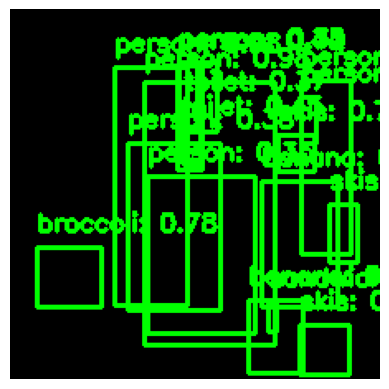

Frame 258, Label: 1, Score: 0.9834718704223633
Frame 258, Label: 1, Score: 0.9808357954025269
Frame 258, Label: 1, Score: 0.9587279558181763
Frame 258, Label: 47, Score: 0.9042701125144958
Frame 258, Label: 51, Score: 0.7768470644950867
Frame 258, Label: 31, Score: 0.7256423234939575
Frame 258, Label: 1, Score: 0.7211121320724487
Frame 258, Label: 31, Score: 0.5366593599319458
Frame 258, Label: 31, Score: 0.5263791680335999
Frame 258, Label: 47, Score: 0.5101481080055237
Frame 258, Label: 62, Score: 0.4524451494216919
Frame 258, Label: 1, Score: 0.43739768862724304
Frame 258, Label: 49, Score: 0.4289233982563019
Frame 258, Label: 1, Score: 0.37973156571388245
Frame 258, Label: 62, Score: 0.3684563934803009
Frame 258, Label: 1, Score: 0.3487772047519684
Frame 258, Label: 1, Score: 0.3484133780002594
Frame 258, Label: 1, Score: 0.3185162842273712


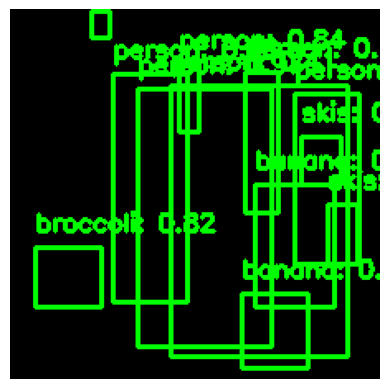

Frame 259, Label: 1, Score: 0.9819564819335938
Frame 259, Label: 1, Score: 0.9748263359069824
Frame 259, Label: 1, Score: 0.9385106563568115
Frame 259, Label: 47, Score: 0.9199778437614441
Frame 259, Label: 47, Score: 0.8998080492019653
Frame 259, Label: 1, Score: 0.8400632739067078
Frame 259, Label: 51, Score: 0.8249015808105469
Frame 259, Label: 1, Score: 0.614520251750946
Frame 259, Label: 64, Score: 0.47156667709350586
Frame 259, Label: 1, Score: 0.4145989716053009
Frame 259, Label: 31, Score: 0.3501111567020416
Frame 259, Label: 31, Score: 0.3464230000972748


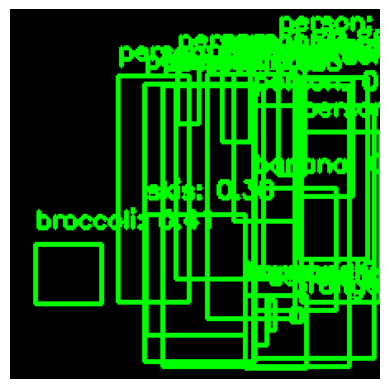

Frame 260, Label: 1, Score: 0.9863941073417664
Frame 260, Label: 1, Score: 0.9714658856391907
Frame 260, Label: 1, Score: 0.9511129856109619
Frame 260, Label: 1, Score: 0.9454755783081055
Frame 260, Label: 1, Score: 0.8922757506370544
Frame 260, Label: 1, Score: 0.8634631037712097
Frame 260, Label: 1, Score: 0.782943069934845
Frame 260, Label: 47, Score: 0.7044621706008911
Frame 260, Label: 1, Score: 0.6931371688842773
Frame 260, Label: 1, Score: 0.639517068862915
Frame 260, Label: 1, Score: 0.5452337265014648
Frame 260, Label: 1, Score: 0.49353712797164917
Frame 260, Label: 47, Score: 0.4227724075317383
Frame 260, Label: 51, Score: 0.4143463969230652
Frame 260, Label: 1, Score: 0.40078356862068176
Frame 260, Label: 31, Score: 0.38415420055389404
Frame 260, Label: 49, Score: 0.3266935348510742
Frame 260, Label: 49, Score: 0.3212907612323761
Frame 260, Label: 50, Score: 0.32040461897850037
Frame 260, Label: 1, Score: 0.3153597116470337


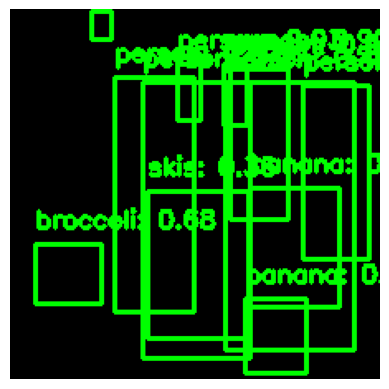

Frame 261, Label: 1, Score: 0.9732547402381897
Frame 261, Label: 1, Score: 0.9675341248512268
Frame 261, Label: 1, Score: 0.9536482095718384
Frame 261, Label: 1, Score: 0.9338394403457642
Frame 261, Label: 1, Score: 0.924203097820282
Frame 261, Label: 1, Score: 0.8972907662391663
Frame 261, Label: 51, Score: 0.6759450435638428
Frame 261, Label: 47, Score: 0.6321773529052734
Frame 261, Label: 64, Score: 0.5434929728507996
Frame 261, Label: 1, Score: 0.4945981800556183
Frame 261, Label: 31, Score: 0.36260855197906494
Frame 261, Label: 47, Score: 0.34244492650032043


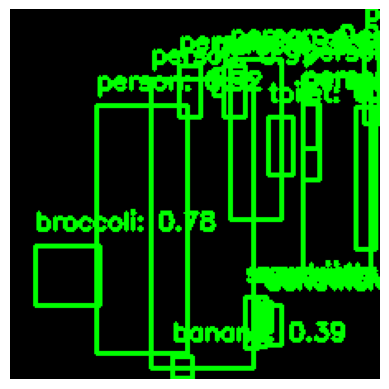

Frame 262, Label: 1, Score: 0.991270899772644
Frame 262, Label: 1, Score: 0.9907178282737732
Frame 262, Label: 1, Score: 0.9369524121284485
Frame 262, Label: 1, Score: 0.9327279329299927
Frame 262, Label: 1, Score: 0.9225732684135437
Frame 262, Label: 1, Score: 0.8588806390762329
Frame 262, Label: 51, Score: 0.7754243612289429
Frame 262, Label: 1, Score: 0.5313435792922974
Frame 262, Label: 1, Score: 0.49219873547554016
Frame 262, Label: 49, Score: 0.46523207426071167
Frame 262, Label: 1, Score: 0.436840683221817
Frame 262, Label: 49, Score: 0.4357772171497345
Frame 262, Label: 47, Score: 0.39275407791137695
Frame 262, Label: 62, Score: 0.3909119665622711
Frame 262, Label: 49, Score: 0.3226493299007416
Frame 262, Label: 1, Score: 0.3199598491191864
Frame 262, Label: 49, Score: 0.3165053427219391
Frame 262, Label: 1, Score: 0.30577197670936584


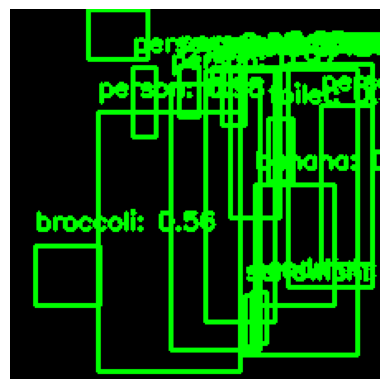

Frame 263, Label: 1, Score: 0.9769372940063477
Frame 263, Label: 1, Score: 0.972745954990387
Frame 263, Label: 1, Score: 0.9724463224411011
Frame 263, Label: 1, Score: 0.9310422539710999
Frame 263, Label: 1, Score: 0.9220952987670898
Frame 263, Label: 1, Score: 0.877751350402832
Frame 263, Label: 1, Score: 0.801868736743927
Frame 263, Label: 47, Score: 0.7380863428115845
Frame 263, Label: 1, Score: 0.6796175837516785
Frame 263, Label: 1, Score: 0.5721234679222107
Frame 263, Label: 51, Score: 0.5632418990135193
Frame 263, Label: 1, Score: 0.41558369994163513
Frame 263, Label: 1, Score: 0.37344956398010254
Frame 263, Label: 62, Score: 0.36391010880470276
Frame 263, Label: 49, Score: 0.34991884231567383
Frame 263, Label: 64, Score: 0.3323838710784912
Frame 263, Label: 49, Score: 0.3171013593673706


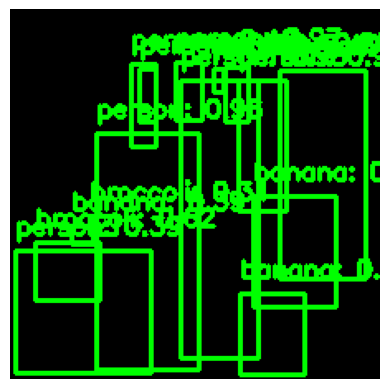

Frame 264, Label: 1, Score: 0.9851662516593933
Frame 264, Label: 1, Score: 0.9800614714622498
Frame 264, Label: 1, Score: 0.9702162146568298
Frame 264, Label: 1, Score: 0.9636766910552979
Frame 264, Label: 1, Score: 0.919776976108551
Frame 264, Label: 1, Score: 0.8564761281013489
Frame 264, Label: 47, Score: 0.6342703104019165
Frame 264, Label: 51, Score: 0.6183474659919739
Frame 264, Label: 1, Score: 0.5736197829246521
Frame 264, Label: 1, Score: 0.4759345054626465
Frame 264, Label: 1, Score: 0.40146148204803467
Frame 264, Label: 1, Score: 0.39345070719718933
Frame 264, Label: 47, Score: 0.39325737953186035
Frame 264, Label: 47, Score: 0.3892315626144409
Frame 264, Label: 51, Score: 0.31268537044525146


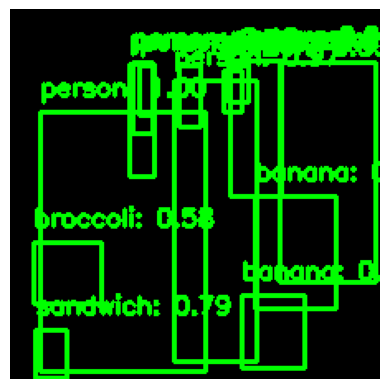

Frame 265, Label: 1, Score: 0.9970472455024719
Frame 265, Label: 1, Score: 0.9709700345993042
Frame 265, Label: 1, Score: 0.9663939476013184
Frame 265, Label: 1, Score: 0.9653666019439697
Frame 265, Label: 1, Score: 0.9458838701248169
Frame 265, Label: 47, Score: 0.9132072925567627
Frame 265, Label: 1, Score: 0.8294141292572021
Frame 265, Label: 49, Score: 0.7914928197860718
Frame 265, Label: 1, Score: 0.7027252316474915
Frame 265, Label: 51, Score: 0.5804141759872437
Frame 265, Label: 47, Score: 0.5740131735801697
Frame 265, Label: 1, Score: 0.542202353477478
Frame 265, Label: 1, Score: 0.4030666649341583
Frame 265, Label: 1, Score: 0.34726738929748535


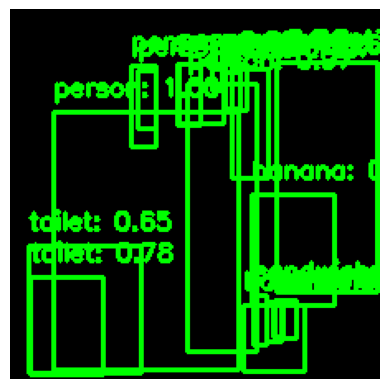

Frame 266, Label: 1, Score: 0.9955570101737976
Frame 266, Label: 1, Score: 0.968834638595581
Frame 266, Label: 1, Score: 0.9391429424285889
Frame 266, Label: 1, Score: 0.8962317109107971
Frame 266, Label: 1, Score: 0.8571560978889465
Frame 266, Label: 1, Score: 0.8486208915710449
Frame 266, Label: 62, Score: 0.7826761603355408
Frame 266, Label: 1, Score: 0.7368192076683044
Frame 266, Label: 47, Score: 0.7172950506210327
Frame 266, Label: 62, Score: 0.65046226978302
Frame 266, Label: 1, Score: 0.6249777674674988
Frame 266, Label: 49, Score: 0.48020878434181213
Frame 266, Label: 1, Score: 0.4741896390914917
Frame 266, Label: 49, Score: 0.35600367188453674
Frame 266, Label: 49, Score: 0.34748050570487976
Frame 266, Label: 47, Score: 0.3438500761985779
Frame 266, Label: 49, Score: 0.3369590640068054
Frame 266, Label: 1, Score: 0.31334927678108215
Frame 266, Label: 1, Score: 0.30782681703567505


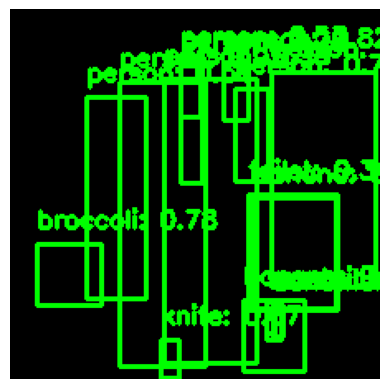

Frame 267, Label: 1, Score: 0.9787554740905762
Frame 267, Label: 1, Score: 0.9592275619506836
Frame 267, Label: 1, Score: 0.9517574310302734
Frame 267, Label: 1, Score: 0.8197019696235657
Frame 267, Label: 51, Score: 0.7824621796607971
Frame 267, Label: 1, Score: 0.7817968726158142
Frame 267, Label: 1, Score: 0.779132068157196
Frame 267, Label: 47, Score: 0.7617666721343994
Frame 267, Label: 44, Score: 0.6749730110168457
Frame 267, Label: 1, Score: 0.5278332829475403
Frame 267, Label: 1, Score: 0.50776207447052
Frame 267, Label: 49, Score: 0.4182572662830353
Frame 267, Label: 49, Score: 0.39485079050064087
Frame 267, Label: 49, Score: 0.37600427865982056
Frame 267, Label: 47, Score: 0.3449053168296814
Frame 267, Label: 62, Score: 0.33772528171539307


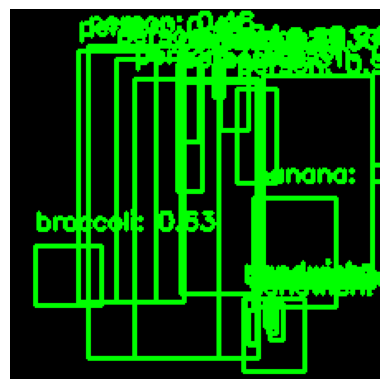

Frame 268, Label: 1, Score: 0.9875332117080688
Frame 268, Label: 1, Score: 0.9406667947769165
Frame 268, Label: 1, Score: 0.9390873312950134
Frame 268, Label: 1, Score: 0.8981603980064392
Frame 268, Label: 1, Score: 0.8840169310569763
Frame 268, Label: 1, Score: 0.8301020860671997
Frame 268, Label: 51, Score: 0.62990802526474
Frame 268, Label: 1, Score: 0.48061415553092957
Frame 268, Label: 1, Score: 0.47259625792503357
Frame 268, Label: 47, Score: 0.4687965512275696
Frame 268, Label: 1, Score: 0.44388431310653687
Frame 268, Label: 47, Score: 0.4087478220462799
Frame 268, Label: 49, Score: 0.3927915096282959
Frame 268, Label: 49, Score: 0.38102588057518005
Frame 268, Label: 49, Score: 0.3644501864910126
Frame 268, Label: 49, Score: 0.3635186553001404
Frame 268, Label: 49, Score: 0.32503852248191833
Frame 268, Label: 49, Score: 0.32459262013435364
Frame 268, Label: 1, Score: 0.3146858811378479
Frame 268, Label: 1, Score: 0.30164849758148193


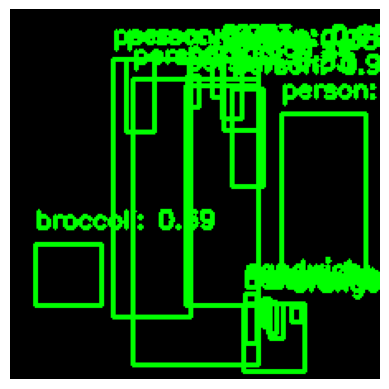

Frame 269, Label: 1, Score: 0.991399884223938
Frame 269, Label: 1, Score: 0.9870221018791199
Frame 269, Label: 1, Score: 0.9714515209197998
Frame 269, Label: 1, Score: 0.9233840703964233
Frame 269, Label: 1, Score: 0.7217465043067932
Frame 269, Label: 51, Score: 0.6850860714912415
Frame 269, Label: 49, Score: 0.558262825012207
Frame 269, Label: 1, Score: 0.5294662714004517
Frame 269, Label: 49, Score: 0.5094486474990845
Frame 269, Label: 1, Score: 0.4626694321632385
Frame 269, Label: 50, Score: 0.40248164534568787
Frame 269, Label: 1, Score: 0.3827265501022339
Frame 269, Label: 1, Score: 0.3380034267902374
Frame 269, Label: 49, Score: 0.33620384335517883
Frame 269, Label: 1, Score: 0.3312802314758301
Frame 269, Label: 49, Score: 0.3303578794002533
Frame 269, Label: 47, Score: 0.3222201466560364


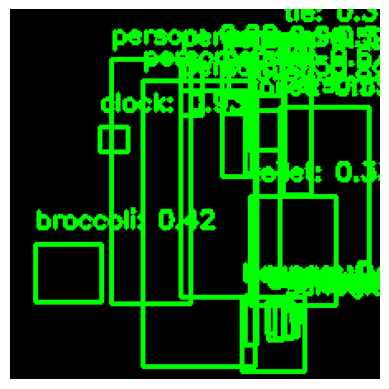

Frame 270, Label: 1, Score: 0.9911991953849792
Frame 270, Label: 1, Score: 0.9820055961608887
Frame 270, Label: 1, Score: 0.9794156551361084
Frame 270, Label: 1, Score: 0.9361786246299744
Frame 270, Label: 75, Score: 0.9348092675209045
Frame 270, Label: 62, Score: 0.8909216523170471
Frame 270, Label: 1, Score: 0.668502926826477
Frame 270, Label: 1, Score: 0.5896995663642883
Frame 270, Label: 62, Score: 0.5485572814941406
Frame 270, Label: 1, Score: 0.4960225522518158
Frame 270, Label: 49, Score: 0.4573858678340912
Frame 270, Label: 49, Score: 0.4400929808616638
Frame 270, Label: 51, Score: 0.41531872749328613
Frame 270, Label: 47, Score: 0.3833264708518982
Frame 270, Label: 50, Score: 0.3605254292488098
Frame 270, Label: 1, Score: 0.35573506355285645
Frame 270, Label: 49, Score: 0.3418799042701721
Frame 270, Label: 62, Score: 0.3300113081932068
Frame 270, Label: 49, Score: 0.3233393430709839
Frame 270, Label: 50, Score: 0.3120996356010437
Frame 270, Label: 28, Score: 0.3077448308467865

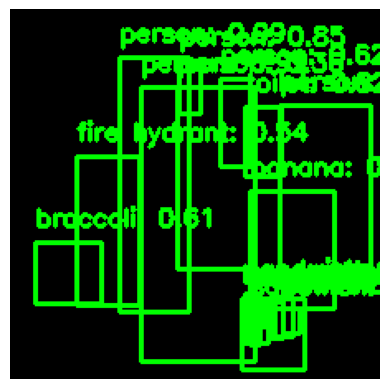

Frame 271, Label: 1, Score: 0.9944444298744202
Frame 271, Label: 1, Score: 0.9917700290679932
Frame 271, Label: 1, Score: 0.9396340250968933
Frame 271, Label: 1, Score: 0.8517053723335266
Frame 271, Label: 62, Score: 0.8219691514968872
Frame 271, Label: 1, Score: 0.6171290874481201
Frame 271, Label: 51, Score: 0.6052184104919434
Frame 271, Label: 49, Score: 0.5450983643531799
Frame 271, Label: 11, Score: 0.5355775356292725
Frame 271, Label: 49, Score: 0.5043462514877319
Frame 271, Label: 49, Score: 0.48525404930114746
Frame 271, Label: 49, Score: 0.44543251395225525
Frame 271, Label: 49, Score: 0.41053658723831177
Frame 271, Label: 47, Score: 0.4060446321964264
Frame 271, Label: 49, Score: 0.3913534879684448
Frame 271, Label: 49, Score: 0.38497394323349
Frame 271, Label: 1, Score: 0.3618001341819763
Frame 271, Label: 49, Score: 0.35164013504981995
Frame 271, Label: 49, Score: 0.3320581614971161
Frame 271, Label: 47, Score: 0.3016282320022583


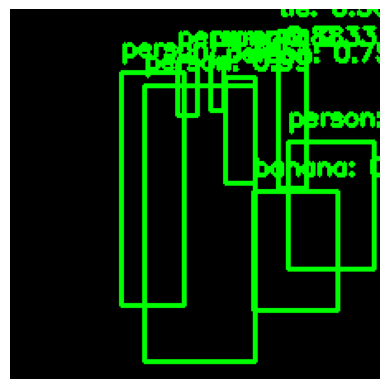

Frame 272, Label: 1, Score: 0.9955358505249023
Frame 272, Label: 1, Score: 0.9941990375518799
Frame 272, Label: 1, Score: 0.8829301595687866
Frame 272, Label: 1, Score: 0.746535062789917
Frame 272, Label: 1, Score: 0.6787406206130981
Frame 272, Label: 47, Score: 0.35955291986465454
Frame 272, Label: 28, Score: 0.3558958172798157
Frame 272, Label: 1, Score: 0.32507601380348206


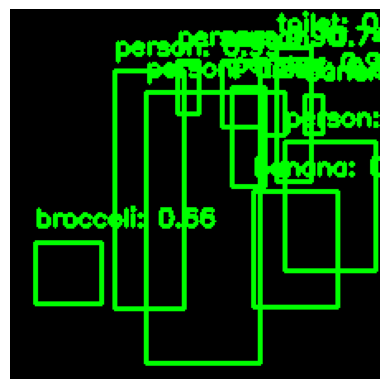

Frame 273, Label: 1, Score: 0.9927030801773071
Frame 273, Label: 1, Score: 0.992522656917572
Frame 273, Label: 1, Score: 0.9272637367248535
Frame 273, Label: 1, Score: 0.9023364782333374
Frame 273, Label: 1, Score: 0.8537817597389221
Frame 273, Label: 47, Score: 0.7521575093269348
Frame 273, Label: 1, Score: 0.7425152659416199
Frame 273, Label: 51, Score: 0.6572591662406921
Frame 273, Label: 47, Score: 0.5395753383636475
Frame 273, Label: 62, Score: 0.3880288004875183
Frame 273, Label: 62, Score: 0.3509713411331177


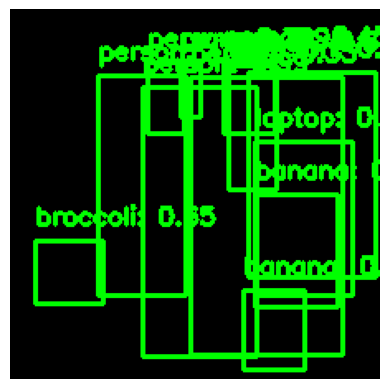

Frame 274, Label: 1, Score: 0.9963101744651794
Frame 274, Label: 1, Score: 0.989170253276825
Frame 274, Label: 1, Score: 0.9378336668014526
Frame 274, Label: 1, Score: 0.8293518424034119
Frame 274, Label: 47, Score: 0.777432382106781
Frame 274, Label: 51, Score: 0.6487736701965332
Frame 274, Label: 1, Score: 0.5707579851150513
Frame 274, Label: 47, Score: 0.5127038955688477
Frame 274, Label: 1, Score: 0.44568973779678345
Frame 274, Label: 64, Score: 0.3600848913192749
Frame 274, Label: 1, Score: 0.32961729168891907
Frame 274, Label: 1, Score: 0.31795430183410645


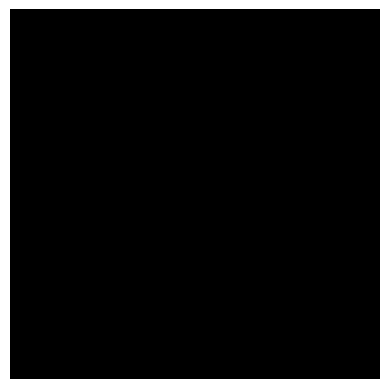

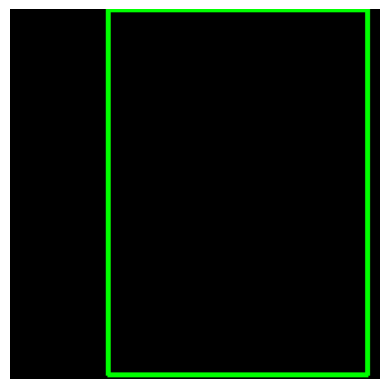

Frame 276, Label: 1, Score: 0.34876683354377747


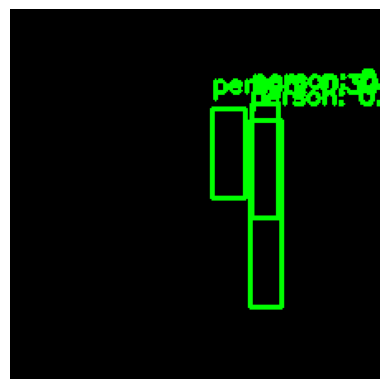

Frame 277, Label: 1, Score: 0.43407776951789856
Frame 277, Label: 1, Score: 0.3383803367614746
Frame 277, Label: 1, Score: 0.3010699152946472


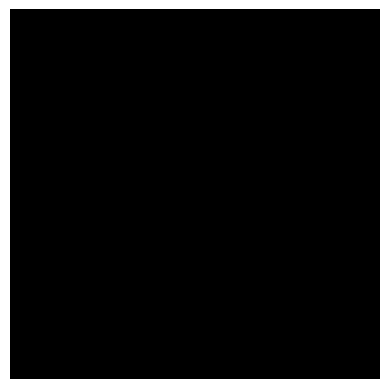

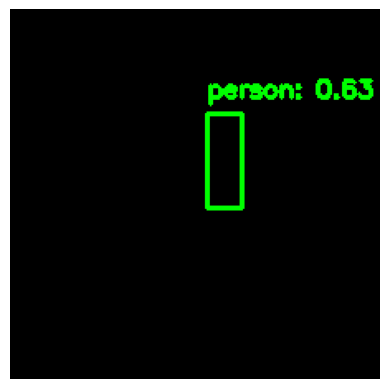

Frame 279, Label: 1, Score: 0.6266559362411499


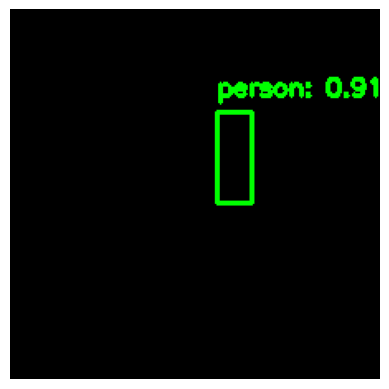

Frame 280, Label: 1, Score: 0.9132791757583618


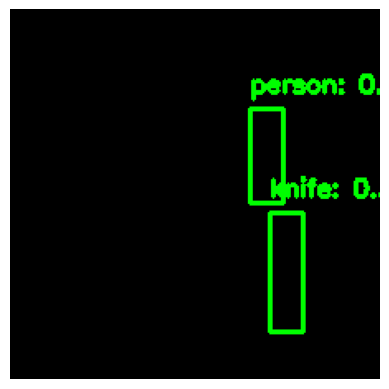

Frame 281, Label: 1, Score: 0.688700258731842
Frame 281, Label: 44, Score: 0.30689218640327454


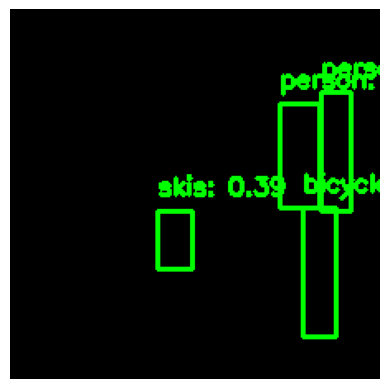

Frame 282, Label: 1, Score: 0.6608230471611023
Frame 282, Label: 1, Score: 0.4113278090953827
Frame 282, Label: 31, Score: 0.3864988386631012
Frame 282, Label: 2, Score: 0.37375277280807495


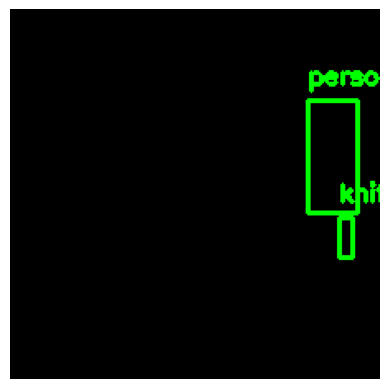

Frame 283, Label: 1, Score: 0.5475340485572815
Frame 283, Label: 44, Score: 0.41207155585289


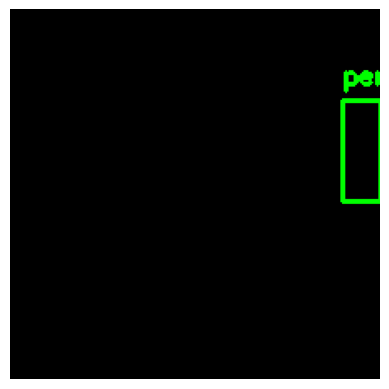

Frame 284, Label: 1, Score: 0.3875119984149933


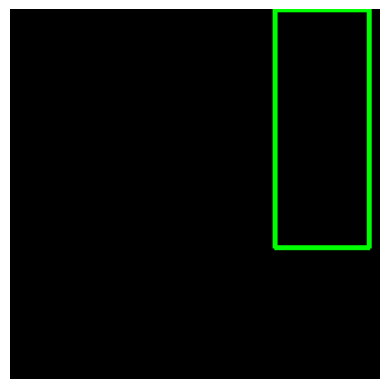

Frame 285, Label: 1, Score: 0.3992350399494171


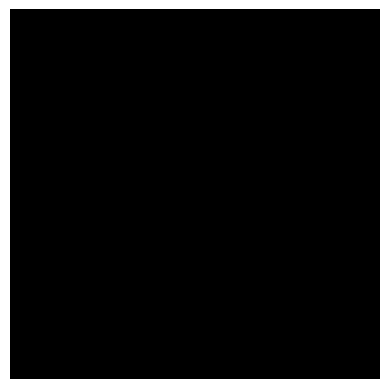

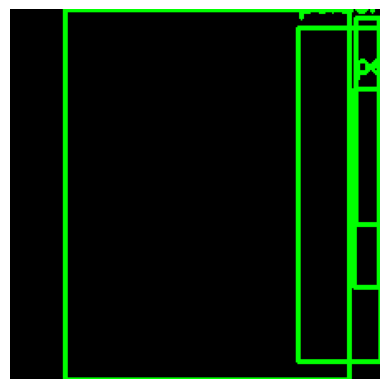

Frame 287, Label: 1, Score: 0.5972951054573059
Frame 287, Label: 1, Score: 0.47107142210006714
Frame 287, Label: 1, Score: 0.425430029630661
Frame 287, Label: 1, Score: 0.32459557056427


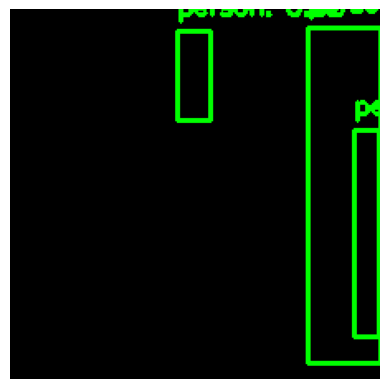

Frame 288, Label: 1, Score: 0.4721347987651825
Frame 288, Label: 1, Score: 0.4514186680316925
Frame 288, Label: 1, Score: 0.32369160652160645


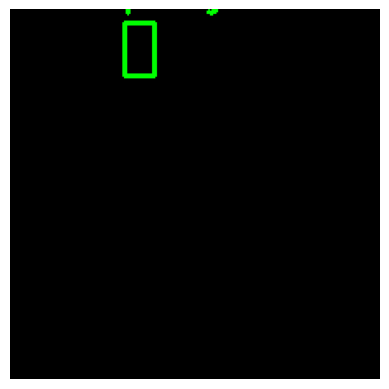

Frame 289, Label: 13, Score: 0.4430747926235199


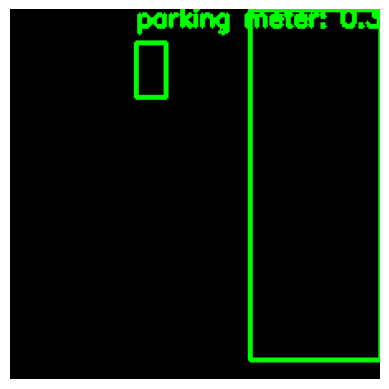

Frame 290, Label: 13, Score: 0.3637179434299469
Frame 290, Label: 1, Score: 0.35346052050590515


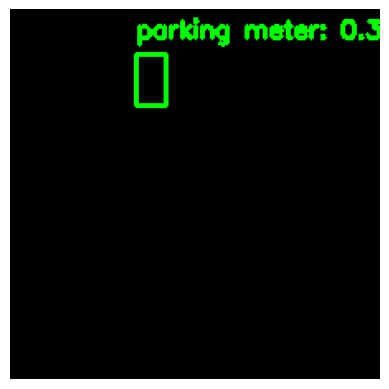

Frame 291, Label: 13, Score: 0.3268044590950012


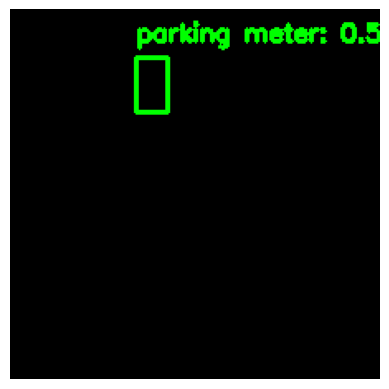

Frame 292, Label: 13, Score: 0.5200612545013428


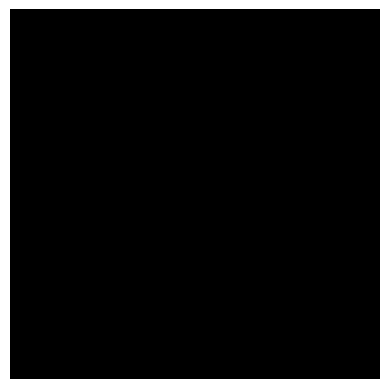

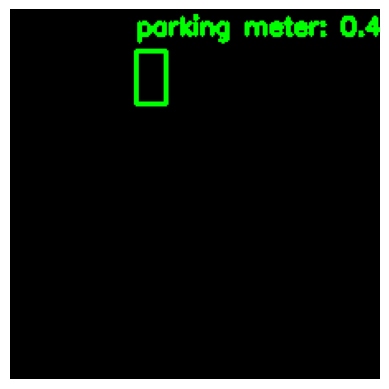

Frame 294, Label: 13, Score: 0.40013548731803894


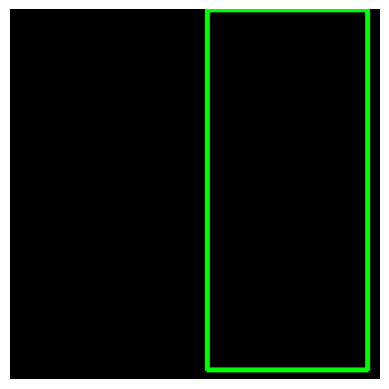

Frame 295, Label: 1, Score: 0.323393851518631


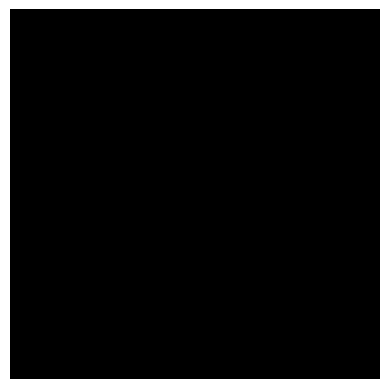

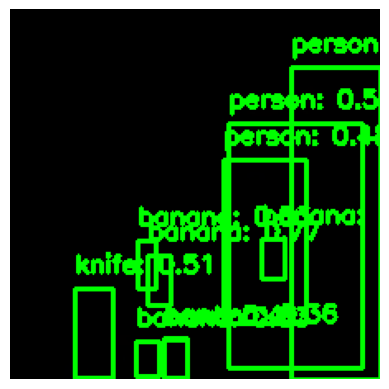

Frame 297, Label: 1, Score: 0.9888373613357544
Frame 297, Label: 47, Score: 0.8260571360588074
Frame 297, Label: 47, Score: 0.7669146060943604
Frame 297, Label: 44, Score: 0.5148670673370361
Frame 297, Label: 1, Score: 0.5014723539352417
Frame 297, Label: 1, Score: 0.48414069414138794
Frame 297, Label: 47, Score: 0.4254184663295746
Frame 297, Label: 46, Score: 0.40960875153541565
Frame 297, Label: 47, Score: 0.3592345416545868
Frame 297, Label: 47, Score: 0.3307773470878601


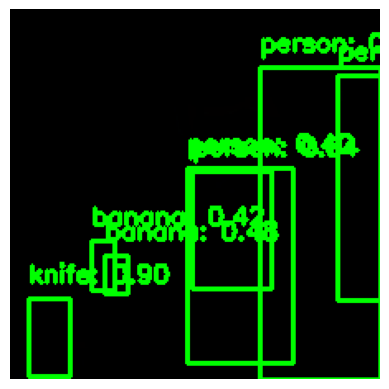

Frame 298, Label: 1, Score: 0.9901800155639648
Frame 298, Label: 44, Score: 0.903667688369751
Frame 298, Label: 1, Score: 0.8364707231521606
Frame 298, Label: 47, Score: 0.47633543610572815
Frame 298, Label: 47, Score: 0.4211248755455017
Frame 298, Label: 1, Score: 0.39666837453842163
Frame 298, Label: 1, Score: 0.3106840252876282


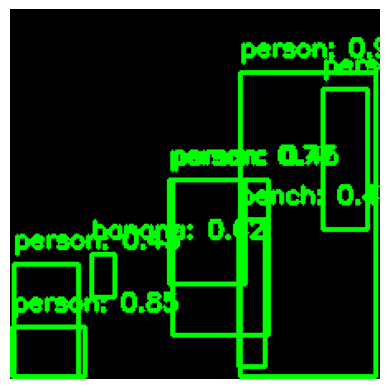

Frame 299, Label: 1, Score: 0.9927888512611389
Frame 299, Label: 1, Score: 0.8496797680854797
Frame 299, Label: 1, Score: 0.7664235234260559
Frame 299, Label: 47, Score: 0.6160494685173035
Frame 299, Label: 14, Score: 0.46910443902015686
Frame 299, Label: 1, Score: 0.44983792304992676
Frame 299, Label: 1, Score: 0.43041232228279114
Frame 299, Label: 1, Score: 0.42673179507255554


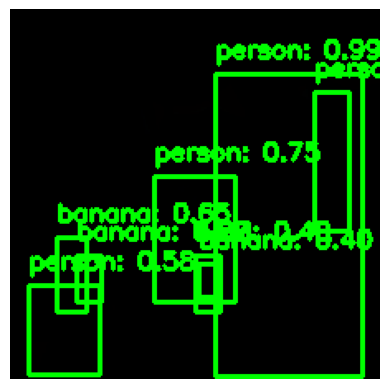

Frame 300, Label: 1, Score: 0.9930340051651001
Frame 300, Label: 47, Score: 0.8226261734962463
Frame 300, Label: 1, Score: 0.754838764667511
Frame 300, Label: 47, Score: 0.650637686252594
Frame 300, Label: 1, Score: 0.5772757530212402
Frame 300, Label: 1, Score: 0.43685829639434814
Frame 300, Label: 47, Score: 0.404472678899765
Frame 300, Label: 46, Score: 0.39903396368026733


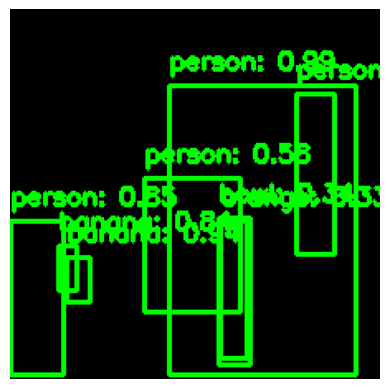

Frame 301, Label: 1, Score: 0.9904392957687378
Frame 301, Label: 47, Score: 0.9392029643058777
Frame 301, Label: 1, Score: 0.8495765924453735
Frame 301, Label: 47, Score: 0.8400700092315674
Frame 301, Label: 1, Score: 0.5770981311798096
Frame 301, Label: 1, Score: 0.5389612317085266
Frame 301, Label: 46, Score: 0.3422817289829254
Frame 301, Label: 50, Score: 0.33085766434669495


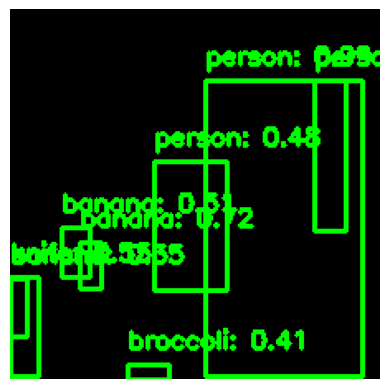

Frame 302, Label: 1, Score: 0.9947314262390137
Frame 302, Label: 47, Score: 0.7163674235343933
Frame 302, Label: 44, Score: 0.5339477062225342
Frame 302, Label: 47, Score: 0.5127406716346741
Frame 302, Label: 1, Score: 0.4768754839897156
Frame 302, Label: 51, Score: 0.407513290643692
Frame 302, Label: 1, Score: 0.37076807022094727
Frame 302, Label: 47, Score: 0.34922686219215393


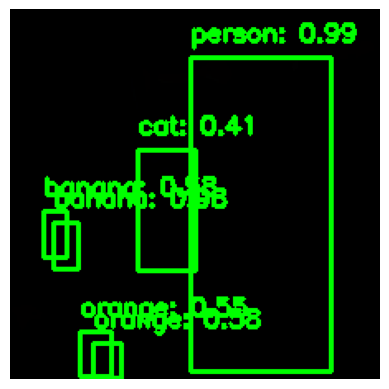

Frame 303, Label: 1, Score: 0.9938777089118958
Frame 303, Label: 47, Score: 0.9786100387573242
Frame 303, Label: 50, Score: 0.5811722874641418
Frame 303, Label: 47, Score: 0.5777814388275146
Frame 303, Label: 50, Score: 0.5491040349006653
Frame 303, Label: 16, Score: 0.4096669852733612


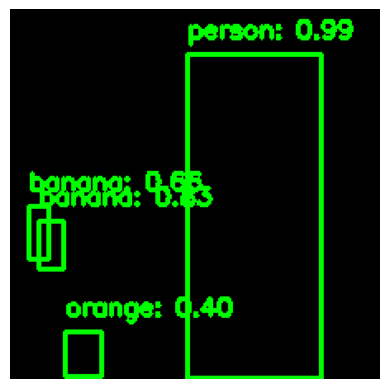

Frame 304, Label: 1, Score: 0.9854524731636047
Frame 304, Label: 47, Score: 0.8303019404411316
Frame 304, Label: 47, Score: 0.6649799942970276
Frame 304, Label: 50, Score: 0.3982154130935669


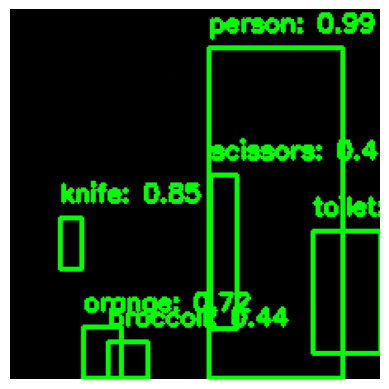

Frame 305, Label: 1, Score: 0.9914402961730957
Frame 305, Label: 44, Score: 0.8522163033485413
Frame 305, Label: 50, Score: 0.719794511795044
Frame 305, Label: 62, Score: 0.5053457021713257
Frame 305, Label: 51, Score: 0.436619371175766
Frame 305, Label: 77, Score: 0.40584835410118103


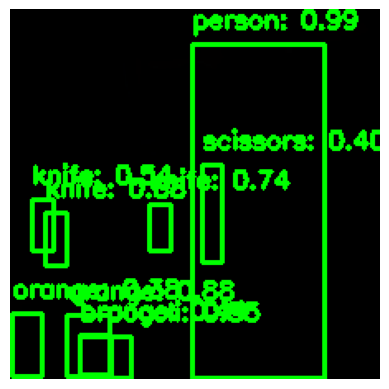

Frame 306, Label: 1, Score: 0.9917358756065369
Frame 306, Label: 50, Score: 0.8837714791297913
Frame 306, Label: 44, Score: 0.8829216957092285
Frame 306, Label: 44, Score: 0.7429126501083374
Frame 306, Label: 51, Score: 0.5470524430274963
Frame 306, Label: 44, Score: 0.5374390482902527
Frame 306, Label: 50, Score: 0.44123712182044983
Frame 306, Label: 77, Score: 0.40005940198898315
Frame 306, Label: 50, Score: 0.38070201873779297


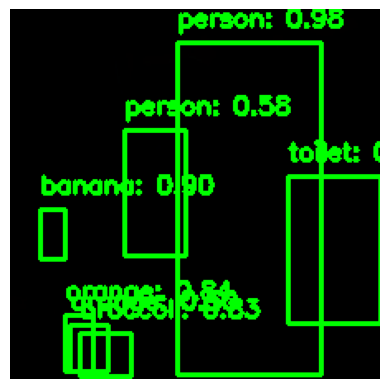

Frame 307, Label: 1, Score: 0.9834169149398804
Frame 307, Label: 47, Score: 0.8989586234092712
Frame 307, Label: 50, Score: 0.8428112864494324
Frame 307, Label: 51, Score: 0.8320190906524658
Frame 307, Label: 1, Score: 0.5789339542388916
Frame 307, Label: 62, Score: 0.553399384021759
Frame 307, Label: 50, Score: 0.49955955147743225


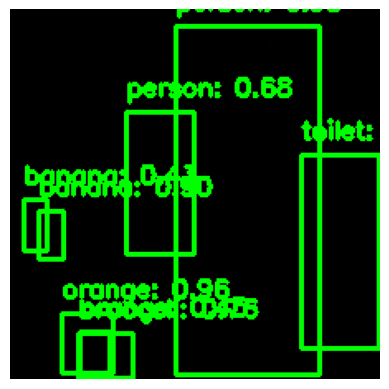

Frame 308, Label: 1, Score: 0.9772764444351196
Frame 308, Label: 50, Score: 0.959747314453125
Frame 308, Label: 47, Score: 0.8969624638557434
Frame 308, Label: 51, Score: 0.758449137210846
Frame 308, Label: 1, Score: 0.6805710792541504
Frame 308, Label: 62, Score: 0.5507261157035828
Frame 308, Label: 50, Score: 0.449993759393692
Frame 308, Label: 47, Score: 0.4333361089229584


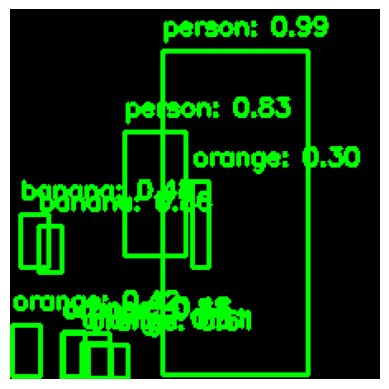

Frame 309, Label: 1, Score: 0.9948667287826538
Frame 309, Label: 50, Score: 0.8845834136009216
Frame 309, Label: 47, Score: 0.8639451861381531
Frame 309, Label: 1, Score: 0.8339698314666748
Frame 309, Label: 50, Score: 0.809054970741272
Frame 309, Label: 50, Score: 0.6125187277793884
Frame 309, Label: 47, Score: 0.48185595870018005
Frame 309, Label: 50, Score: 0.4801692068576813
Frame 309, Label: 50, Score: 0.4219917953014374
Frame 309, Label: 50, Score: 0.30055221915245056


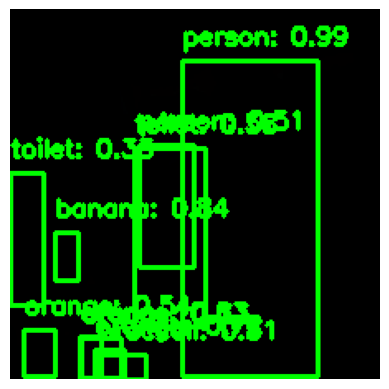

Frame 310, Label: 1, Score: 0.9930262565612793
Frame 310, Label: 47, Score: 0.8363011479377747
Frame 310, Label: 50, Score: 0.7284262776374817
Frame 310, Label: 50, Score: 0.7225910425186157
Frame 310, Label: 50, Score: 0.6345344185829163
Frame 310, Label: 62, Score: 0.5781332850456238
Frame 310, Label: 50, Score: 0.5439039468765259
Frame 310, Label: 51, Score: 0.5149087905883789
Frame 310, Label: 1, Score: 0.5059069991111755
Frame 310, Label: 62, Score: 0.33326125144958496


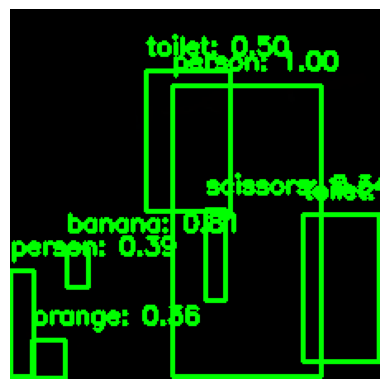

Frame 311, Label: 1, Score: 0.9957177042961121
Frame 311, Label: 47, Score: 0.8083702325820923
Frame 311, Label: 62, Score: 0.7018776535987854
Frame 311, Label: 62, Score: 0.497917115688324
Frame 311, Label: 1, Score: 0.3939027190208435
Frame 311, Label: 50, Score: 0.35749298334121704
Frame 311, Label: 77, Score: 0.34119728207588196


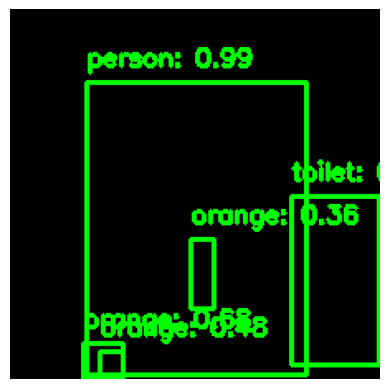

Frame 312, Label: 1, Score: 0.9850773215293884
Frame 312, Label: 62, Score: 0.7531953454017639
Frame 312, Label: 50, Score: 0.6764529943466187
Frame 312, Label: 50, Score: 0.4830247163772583
Frame 312, Label: 50, Score: 0.36462220549583435


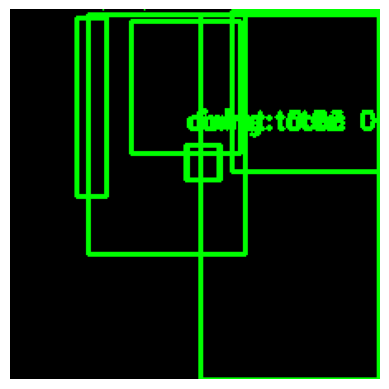

Frame 313, Label: 1, Score: 0.9974047541618347
Frame 313, Label: 52, Score: 0.832049548625946
Frame 313, Label: 1, Score: 0.5366981029510498
Frame 313, Label: 62, Score: 0.3850765526294708
Frame 313, Label: 64, Score: 0.37760189175605774
Frame 313, Label: 61, Score: 0.3212844431400299
Frame 313, Label: 62, Score: 0.30231496691703796


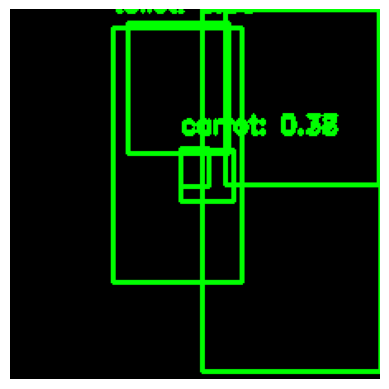

Frame 314, Label: 1, Score: 0.9952676296234131
Frame 314, Label: 52, Score: 0.7726576328277588
Frame 314, Label: 62, Score: 0.5753404498100281
Frame 314, Label: 62, Score: 0.5614692568778992
Frame 314, Label: 1, Score: 0.4158342778682709
Frame 314, Label: 52, Score: 0.37655356526374817


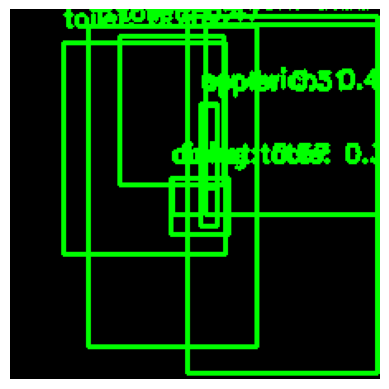

Frame 315, Label: 1, Score: 0.9969172477722168
Frame 315, Label: 62, Score: 0.7569389343261719
Frame 315, Label: 52, Score: 0.5714474320411682
Frame 315, Label: 62, Score: 0.5413609743118286
Frame 315, Label: 62, Score: 0.46503373980522156
Frame 315, Label: 49, Score: 0.4302648901939392
Frame 315, Label: 1, Score: 0.3544774651527405
Frame 315, Label: 48, Score: 0.30862221121788025
Frame 315, Label: 61, Score: 0.30415454506874084


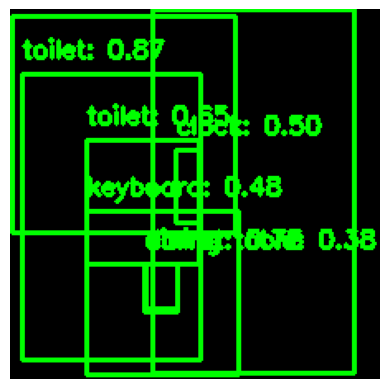

Frame 316, Label: 1, Score: 0.9978954792022705
Frame 316, Label: 62, Score: 0.8714858293533325
Frame 316, Label: 52, Score: 0.7468000054359436
Frame 316, Label: 62, Score: 0.6450221538543701
Frame 316, Label: 67, Score: 0.6091498136520386
Frame 316, Label: 75, Score: 0.5009697079658508
Frame 316, Label: 67, Score: 0.48222318291664124
Frame 316, Label: 61, Score: 0.37640509009361267


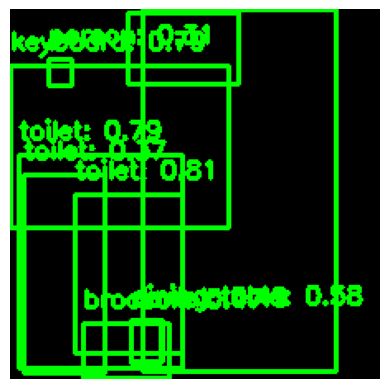

Frame 317, Label: 1, Score: 0.9981009364128113
Frame 317, Label: 51, Score: 0.9943689703941345
Frame 317, Label: 62, Score: 0.8097956776618958
Frame 317, Label: 62, Score: 0.7935319542884827
Frame 317, Label: 67, Score: 0.7853522300720215
Frame 317, Label: 61, Score: 0.5773377418518066
Frame 317, Label: 52, Score: 0.48957669734954834
Frame 317, Label: 51, Score: 0.4665144979953766
Frame 317, Label: 62, Score: 0.3699531555175781
Frame 317, Label: 1, Score: 0.3084796667098999


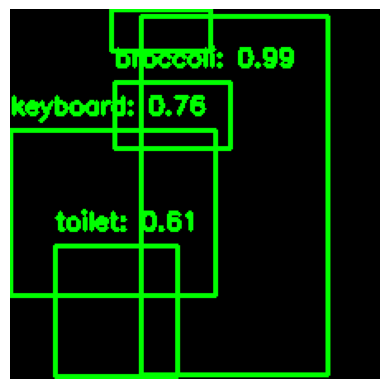

Frame 318, Label: 1, Score: 0.9982081651687622
Frame 318, Label: 51, Score: 0.9937951564788818
Frame 318, Label: 72, Score: 0.8507461547851562
Frame 318, Label: 67, Score: 0.7634179592132568
Frame 318, Label: 62, Score: 0.6084275841712952


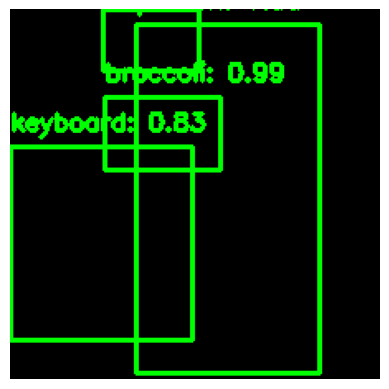

Frame 319, Label: 1, Score: 0.9988055229187012
Frame 319, Label: 51, Score: 0.9931291937828064
Frame 319, Label: 67, Score: 0.8335144519805908
Frame 319, Label: 72, Score: 0.7025113105773926


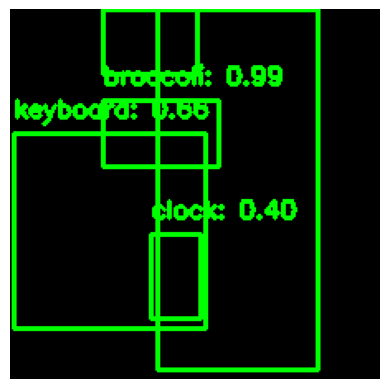

Frame 320, Label: 1, Score: 0.994955837726593
Frame 320, Label: 51, Score: 0.9886382222175598
Frame 320, Label: 67, Score: 0.6631409525871277
Frame 320, Label: 72, Score: 0.4812544882297516
Frame 320, Label: 75, Score: 0.3972887396812439


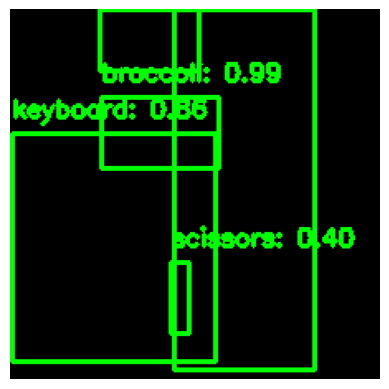

Frame 321, Label: 1, Score: 0.9968473315238953
Frame 321, Label: 51, Score: 0.9940405488014221
Frame 321, Label: 67, Score: 0.8627440333366394
Frame 321, Label: 72, Score: 0.6799144744873047
Frame 321, Label: 77, Score: 0.39682987332344055


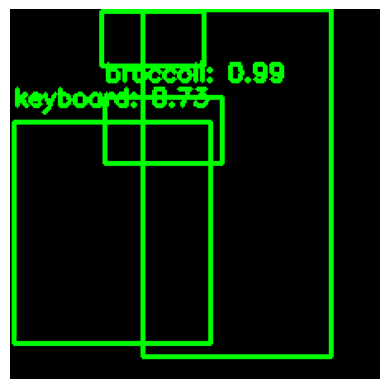

Frame 322, Label: 51, Score: 0.9946134686470032
Frame 322, Label: 1, Score: 0.9936560392379761
Frame 322, Label: 67, Score: 0.7314271330833435
Frame 322, Label: 72, Score: 0.5763247013092041


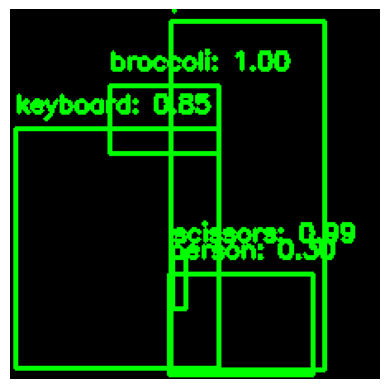

Frame 323, Label: 51, Score: 0.9950025677680969
Frame 323, Label: 1, Score: 0.9949650168418884
Frame 323, Label: 77, Score: 0.9886285066604614
Frame 323, Label: 67, Score: 0.852464497089386
Frame 323, Label: 1, Score: 0.3007797598838806


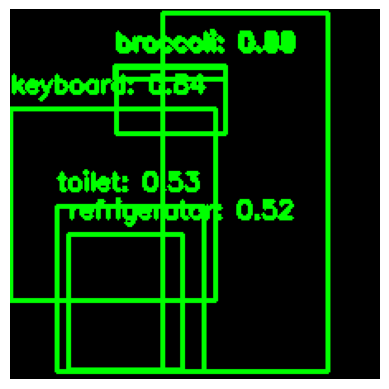

Frame 324, Label: 1, Score: 0.9983519315719604
Frame 324, Label: 51, Score: 0.9949793219566345
Frame 324, Label: 67, Score: 0.8431709408760071
Frame 324, Label: 62, Score: 0.5325906276702881
Frame 324, Label: 73, Score: 0.5249505639076233
Frame 324, Label: 51, Score: 0.33400797843933105


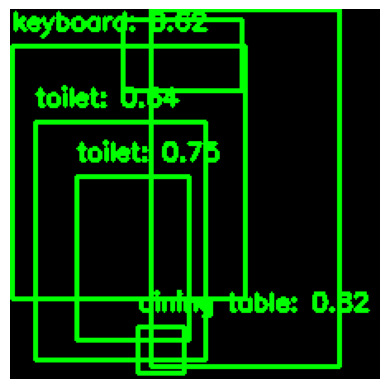

Frame 325, Label: 1, Score: 0.9981959462165833
Frame 325, Label: 51, Score: 0.9945775270462036
Frame 325, Label: 61, Score: 0.8167591094970703
Frame 325, Label: 62, Score: 0.7522822618484497
Frame 325, Label: 62, Score: 0.6432934999465942
Frame 325, Label: 67, Score: 0.6231273412704468


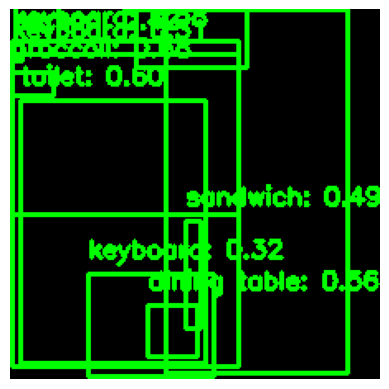

Frame 326, Label: 1, Score: 0.9971978664398193
Frame 326, Label: 51, Score: 0.675018846988678
Frame 326, Label: 62, Score: 0.6044893264770508
Frame 326, Label: 67, Score: 0.578669011592865
Frame 326, Label: 61, Score: 0.5644571185112
Frame 326, Label: 51, Score: 0.5010942220687866
Frame 326, Label: 49, Score: 0.491171658039093
Frame 326, Label: 1, Score: 0.42109405994415283
Frame 326, Label: 67, Score: 0.3169347047805786
Frame 326, Label: 67, Score: 0.3088461458683014


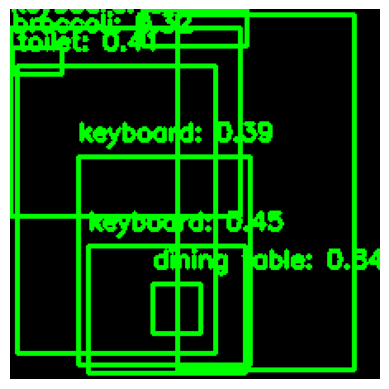

Frame 327, Label: 1, Score: 0.9960946440696716
Frame 327, Label: 61, Score: 0.8352306485176086
Frame 327, Label: 67, Score: 0.7513095140457153
Frame 327, Label: 1, Score: 0.6996182203292847
Frame 327, Label: 67, Score: 0.45255571603775024
Frame 327, Label: 62, Score: 0.4098701477050781
Frame 327, Label: 67, Score: 0.39094477891921997
Frame 327, Label: 51, Score: 0.3163289725780487


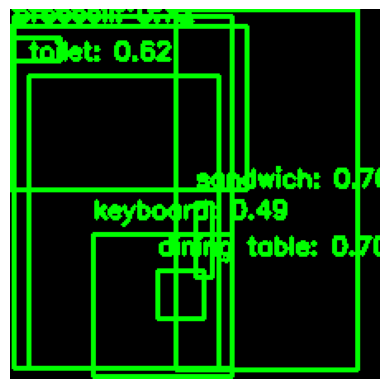

Frame 328, Label: 1, Score: 0.9968132376670837
Frame 328, Label: 51, Score: 0.7181565761566162
Frame 328, Label: 49, Score: 0.6997259855270386
Frame 328, Label: 61, Score: 0.6994734406471252
Frame 328, Label: 62, Score: 0.6236616969108582
Frame 328, Label: 67, Score: 0.6204200983047485
Frame 328, Label: 67, Score: 0.48950591683387756
Frame 328, Label: 67, Score: 0.37932589650154114


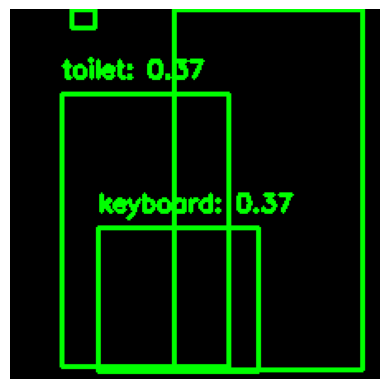

Frame 329, Label: 1, Score: 0.9967449903488159
Frame 329, Label: 1, Score: 0.804917573928833
Frame 329, Label: 62, Score: 0.37027499079704285
Frame 329, Label: 67, Score: 0.3682575523853302


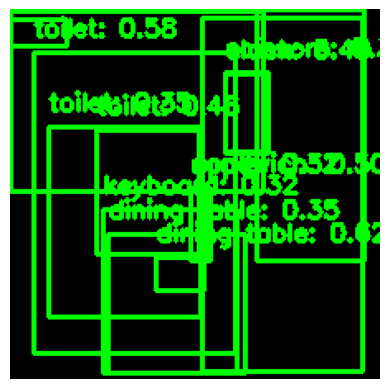

Frame 330, Label: 1, Score: 0.9969009160995483
Frame 330, Label: 1, Score: 0.7117295265197754
Frame 330, Label: 61, Score: 0.6151157021522522
Frame 330, Label: 62, Score: 0.5790025591850281
Frame 330, Label: 67, Score: 0.5402225852012634
Frame 330, Label: 51, Score: 0.5154916644096375
Frame 330, Label: 49, Score: 0.49786409735679626
Frame 330, Label: 62, Score: 0.4628550112247467
Frame 330, Label: 75, Score: 0.4035847783088684
Frame 330, Label: 77, Score: 0.3818037509918213
Frame 330, Label: 62, Score: 0.35277849435806274
Frame 330, Label: 61, Score: 0.35095205903053284
Frame 330, Label: 48, Score: 0.3223585784435272
Frame 330, Label: 67, Score: 0.31786707043647766


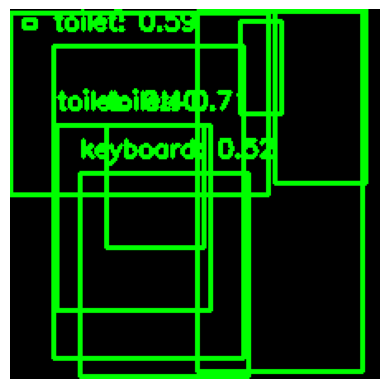

Frame 331, Label: 1, Score: 0.9954670667648315
Frame 331, Label: 1, Score: 0.8164646029472351
Frame 331, Label: 62, Score: 0.7079328894615173
Frame 331, Label: 62, Score: 0.5857639908790588
Frame 331, Label: 67, Score: 0.523806095123291
Frame 331, Label: 49, Score: 0.43791717290878296
Frame 331, Label: 53, Score: 0.4310443699359894
Frame 331, Label: 67, Score: 0.4127219617366791
Frame 331, Label: 62, Score: 0.40192949771881104


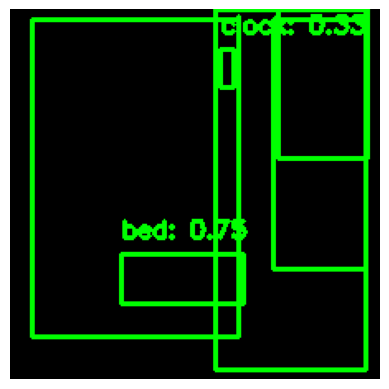

Frame 332, Label: 1, Score: 0.9810130000114441
Frame 332, Label: 1, Score: 0.8098653554916382
Frame 332, Label: 60, Score: 0.7463913559913635
Frame 332, Label: 1, Score: 0.5792744755744934
Frame 332, Label: 62, Score: 0.38082972168922424
Frame 332, Label: 75, Score: 0.3341863453388214


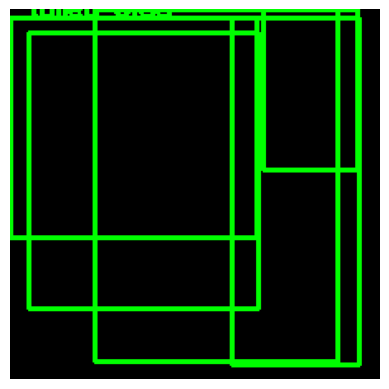

Frame 333, Label: 1, Score: 0.9718656539916992
Frame 333, Label: 1, Score: 0.6685497760772705
Frame 333, Label: 1, Score: 0.6105157732963562
Frame 333, Label: 62, Score: 0.5538102984428406
Frame 333, Label: 67, Score: 0.3647173345088959


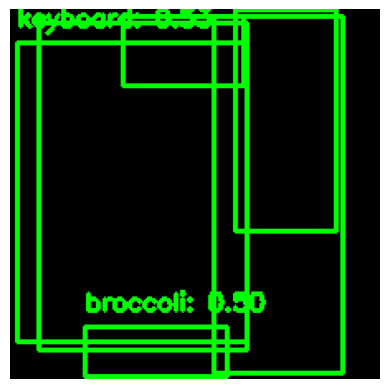

Frame 334, Label: 51, Score: 0.9923600554466248
Frame 334, Label: 1, Score: 0.9847309589385986
Frame 334, Label: 67, Score: 0.5270347595214844
Frame 334, Label: 51, Score: 0.504886269569397
Frame 334, Label: 1, Score: 0.488687127828598
Frame 334, Label: 62, Score: 0.41026315093040466


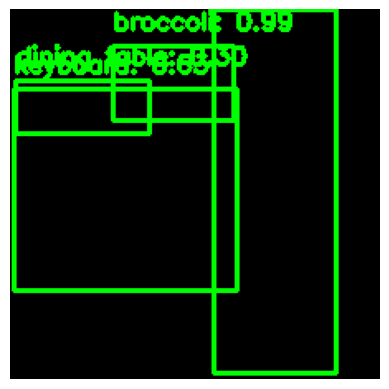

Frame 335, Label: 51, Score: 0.9931463003158569
Frame 335, Label: 1, Score: 0.9864780902862549
Frame 335, Label: 67, Score: 0.6250936388969421
Frame 335, Label: 61, Score: 0.30129313468933105


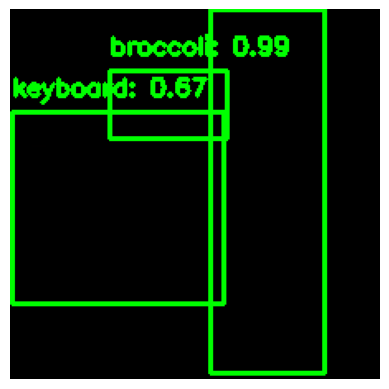

Frame 336, Label: 51, Score: 0.988878607749939
Frame 336, Label: 1, Score: 0.9856860041618347
Frame 336, Label: 67, Score: 0.6711152195930481


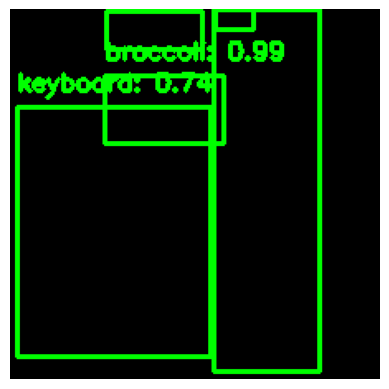

Frame 337, Label: 1, Score: 0.9937054514884949
Frame 337, Label: 51, Score: 0.9855155944824219
Frame 337, Label: 67, Score: 0.7433887124061584
Frame 337, Label: 72, Score: 0.6575145125389099
Frame 337, Label: 72, Score: 0.3250235319137573


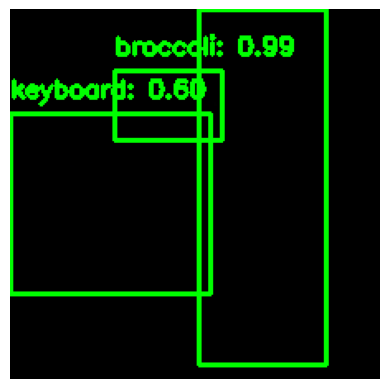

Frame 338, Label: 1, Score: 0.9864545464515686
Frame 338, Label: 51, Score: 0.9855361580848694
Frame 338, Label: 67, Score: 0.5983065962791443


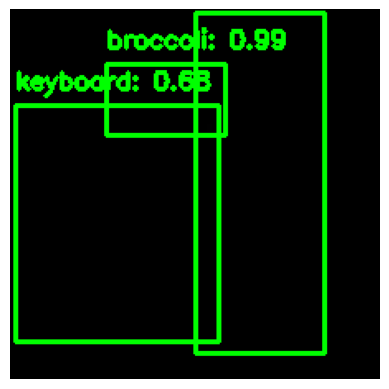

Frame 339, Label: 51, Score: 0.992586076259613
Frame 339, Label: 1, Score: 0.9894099235534668
Frame 339, Label: 67, Score: 0.6755050420761108


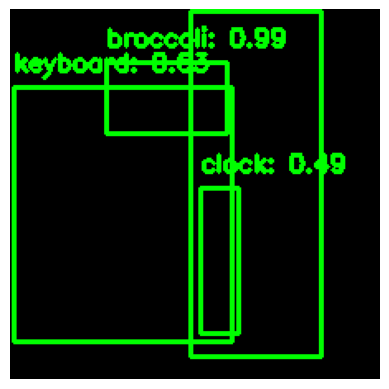

Frame 340, Label: 1, Score: 0.9919257760047913
Frame 340, Label: 51, Score: 0.9912453293800354
Frame 340, Label: 67, Score: 0.6336445808410645
Frame 340, Label: 75, Score: 0.4925370216369629


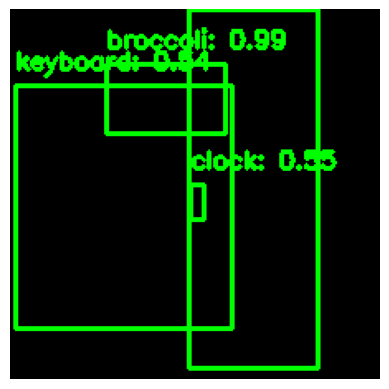

Frame 341, Label: 51, Score: 0.9923508763313293
Frame 341, Label: 1, Score: 0.9884766340255737
Frame 341, Label: 75, Score: 0.5452635884284973
Frame 341, Label: 67, Score: 0.5444611310958862


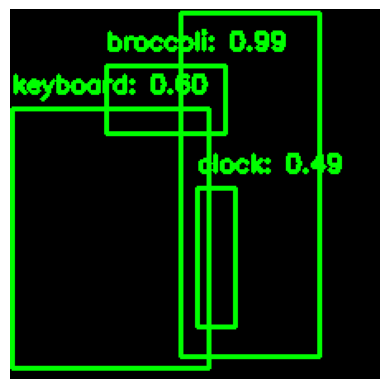

Frame 342, Label: 1, Score: 0.9953578114509583
Frame 342, Label: 51, Score: 0.9930059909820557
Frame 342, Label: 67, Score: 0.5960919260978699
Frame 342, Label: 75, Score: 0.4932923913002014


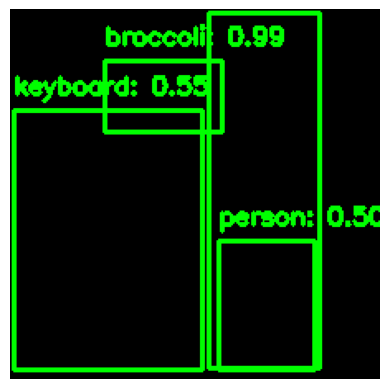

Frame 343, Label: 51, Score: 0.9947381615638733
Frame 343, Label: 1, Score: 0.9936336278915405
Frame 343, Label: 67, Score: 0.5530996918678284
Frame 343, Label: 1, Score: 0.5040144920349121


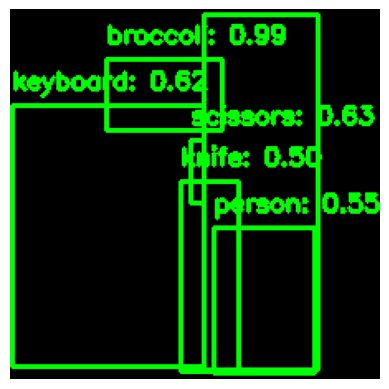

Frame 344, Label: 1, Score: 0.9937633872032166
Frame 344, Label: 51, Score: 0.9891189336776733
Frame 344, Label: 77, Score: 0.6274629831314087
Frame 344, Label: 67, Score: 0.6163973212242126
Frame 344, Label: 1, Score: 0.5525084733963013
Frame 344, Label: 44, Score: 0.5004527568817139


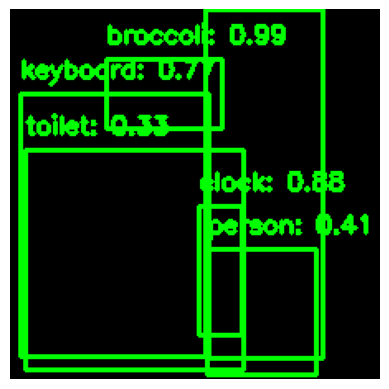

Frame 345, Label: 1, Score: 0.9913018941879272
Frame 345, Label: 51, Score: 0.9897969365119934
Frame 345, Label: 75, Score: 0.8769844770431519
Frame 345, Label: 67, Score: 0.7720503211021423
Frame 345, Label: 1, Score: 0.4094895124435425
Frame 345, Label: 62, Score: 0.33099859952926636


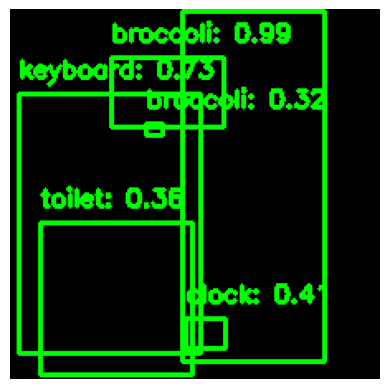

Frame 346, Label: 1, Score: 0.9966034889221191
Frame 346, Label: 51, Score: 0.9941270351409912
Frame 346, Label: 67, Score: 0.7342185974121094
Frame 346, Label: 75, Score: 0.40667635202407837
Frame 346, Label: 62, Score: 0.36463120579719543
Frame 346, Label: 51, Score: 0.32459619641304016


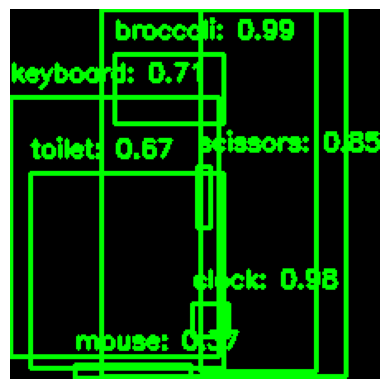

Frame 347, Label: 51, Score: 0.9922888875007629
Frame 347, Label: 1, Score: 0.9918017983436584
Frame 347, Label: 75, Score: 0.9799990057945251
Frame 347, Label: 77, Score: 0.8483867645263672
Frame 347, Label: 67, Score: 0.7115578055381775
Frame 347, Label: 62, Score: 0.6740158796310425
Frame 347, Label: 65, Score: 0.3744593560695648
Frame 347, Label: 1, Score: 0.36878812313079834


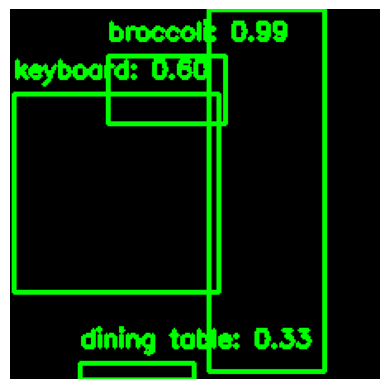

Frame 348, Label: 1, Score: 0.9938338994979858
Frame 348, Label: 51, Score: 0.992487907409668
Frame 348, Label: 67, Score: 0.6002275943756104
Frame 348, Label: 61, Score: 0.3341464400291443


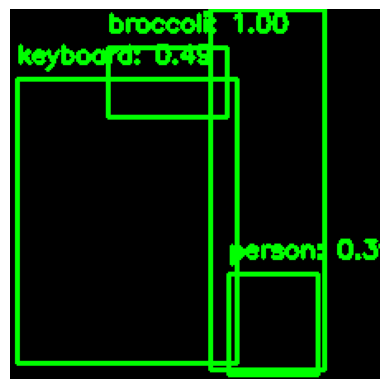

Frame 349, Label: 51, Score: 0.9972061514854431
Frame 349, Label: 1, Score: 0.9919509887695312
Frame 349, Label: 67, Score: 0.4878436326980591
Frame 349, Label: 1, Score: 0.3937191963195801


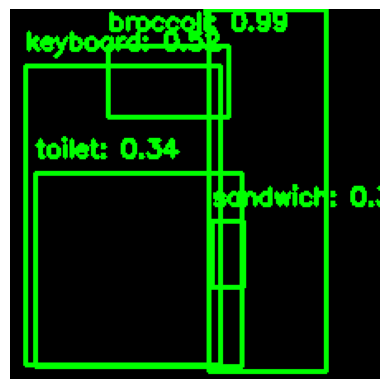

Frame 350, Label: 51, Score: 0.9925695061683655
Frame 350, Label: 1, Score: 0.9813989996910095
Frame 350, Label: 67, Score: 0.5205413699150085
Frame 350, Label: 62, Score: 0.33683180809020996
Frame 350, Label: 49, Score: 0.3211665749549866


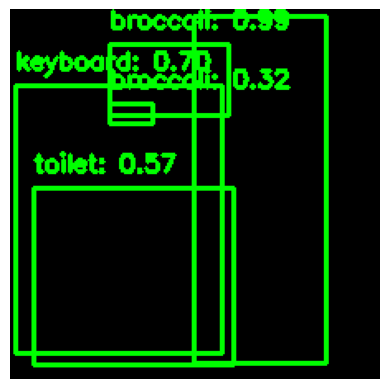

Frame 351, Label: 1, Score: 0.996117115020752
Frame 351, Label: 51, Score: 0.9929201006889343
Frame 351, Label: 67, Score: 0.6968056559562683
Frame 351, Label: 62, Score: 0.5701287984848022
Frame 351, Label: 51, Score: 0.3180692195892334


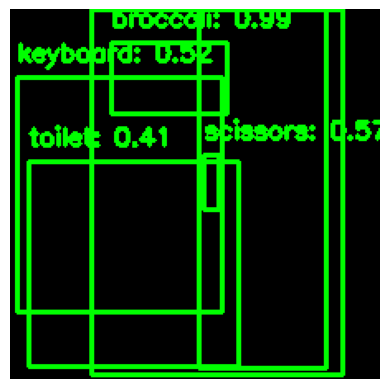

Frame 352, Label: 51, Score: 0.9928271174430847
Frame 352, Label: 1, Score: 0.9895970225334167
Frame 352, Label: 77, Score: 0.571428656578064
Frame 352, Label: 67, Score: 0.5158125758171082
Frame 352, Label: 62, Score: 0.40683120489120483
Frame 352, Label: 1, Score: 0.3045297861099243


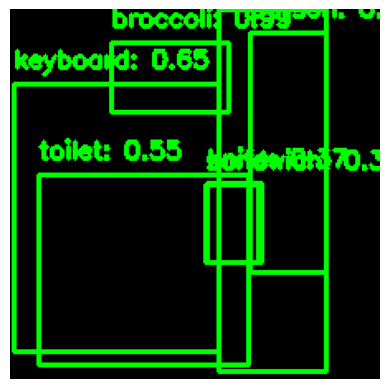

Frame 353, Label: 51, Score: 0.9947043061256409
Frame 353, Label: 1, Score: 0.9868406057357788
Frame 353, Label: 67, Score: 0.6488615274429321
Frame 353, Label: 62, Score: 0.5514841079711914
Frame 353, Label: 1, Score: 0.36648446321487427
Frame 353, Label: 44, Score: 0.3650568723678589
Frame 353, Label: 49, Score: 0.30648741126060486


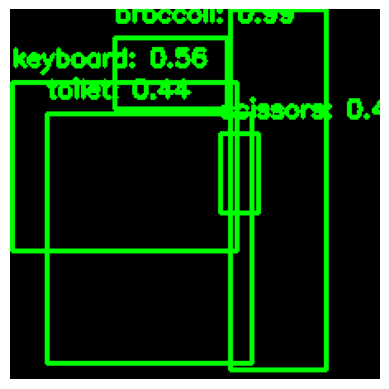

Frame 354, Label: 1, Score: 0.9959281086921692
Frame 354, Label: 51, Score: 0.9930459856987
Frame 354, Label: 67, Score: 0.5631986856460571
Frame 354, Label: 62, Score: 0.4390575885772705
Frame 354, Label: 77, Score: 0.39886605739593506


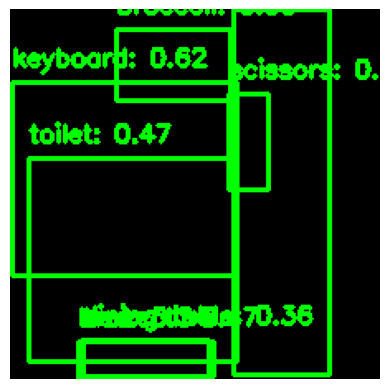

Frame 355, Label: 1, Score: 0.995053231716156
Frame 355, Label: 51, Score: 0.9916444420814514
Frame 355, Label: 67, Score: 0.618938684463501
Frame 355, Label: 77, Score: 0.5313563346862793
Frame 355, Label: 51, Score: 0.4695335328578949
Frame 355, Label: 62, Score: 0.4678148031234741
Frame 355, Label: 61, Score: 0.35998302698135376
Frame 355, Label: 60, Score: 0.34433677792549133


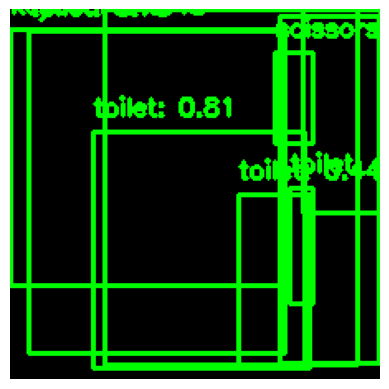

Frame 356, Label: 1, Score: 0.9762307405471802
Frame 356, Label: 1, Score: 0.932840883731842
Frame 356, Label: 62, Score: 0.8094123005867004
Frame 356, Label: 62, Score: 0.7877830266952515
Frame 356, Label: 77, Score: 0.7730730772018433
Frame 356, Label: 67, Score: 0.48337897658348083
Frame 356, Label: 62, Score: 0.4447872042655945
Frame 356, Label: 62, Score: 0.34283024072647095
Frame 356, Label: 1, Score: 0.33670997619628906


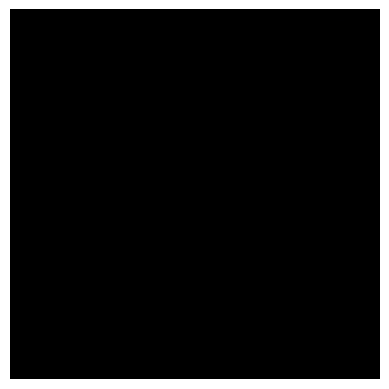

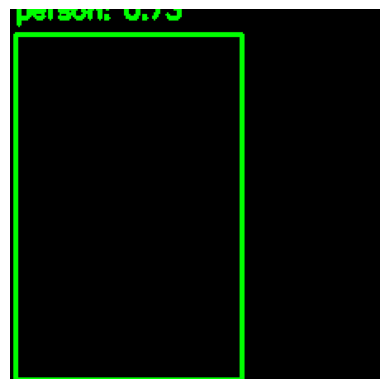

Frame 358, Label: 1, Score: 0.7280545234680176


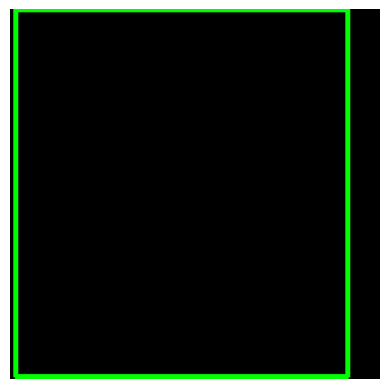

Frame 359, Label: 1, Score: 0.5658610463142395


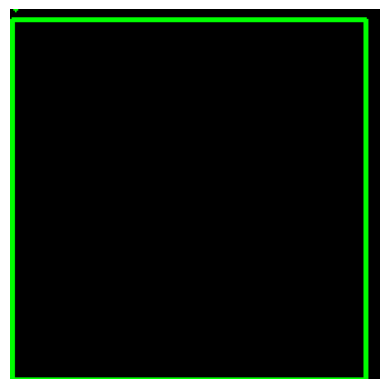

Frame 360, Label: 1, Score: 0.755702018737793


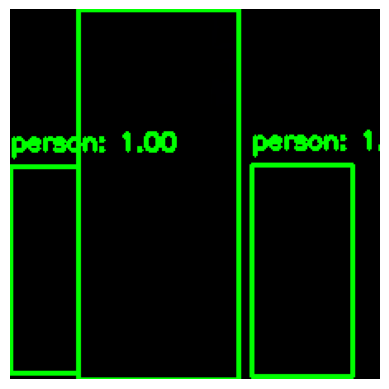

Frame 361, Label: 1, Score: 0.9981474876403809
Frame 361, Label: 1, Score: 0.9981087446212769
Frame 361, Label: 1, Score: 0.9969202280044556


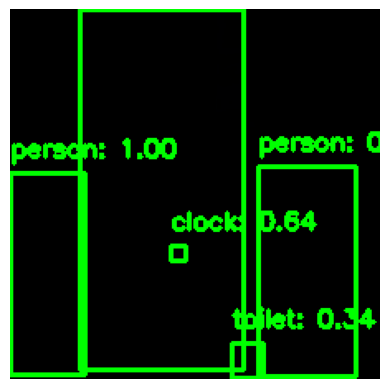

Frame 362, Label: 1, Score: 0.9991076588630676
Frame 362, Label: 1, Score: 0.9972424507141113
Frame 362, Label: 1, Score: 0.9948882460594177
Frame 362, Label: 75, Score: 0.6377223134040833
Frame 362, Label: 62, Score: 0.3440382182598114


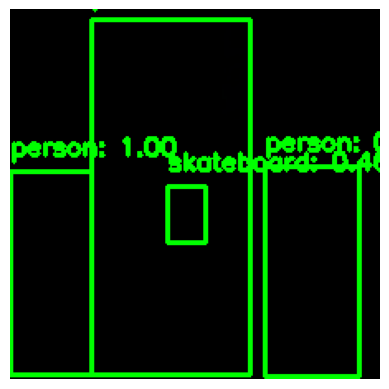

Frame 363, Label: 1, Score: 0.999238133430481
Frame 363, Label: 1, Score: 0.9979141354560852
Frame 363, Label: 1, Score: 0.9949486255645752
Frame 363, Label: 37, Score: 0.4634268879890442


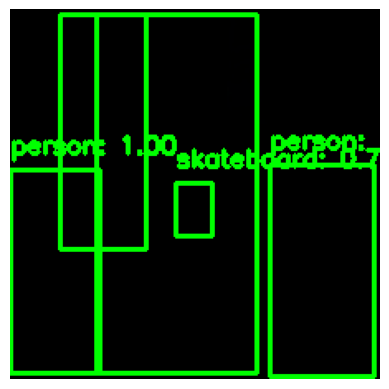

Frame 364, Label: 1, Score: 0.9987346529960632
Frame 364, Label: 1, Score: 0.9971345663070679
Frame 364, Label: 1, Score: 0.9964882135391235
Frame 364, Label: 37, Score: 0.7611427307128906
Frame 364, Label: 1, Score: 0.3577289283275604


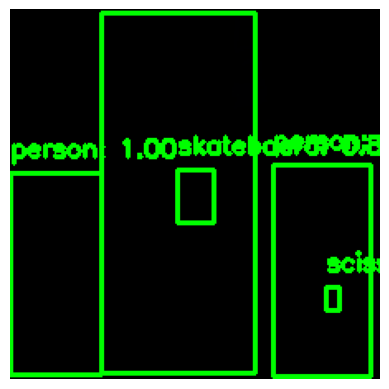

Frame 365, Label: 1, Score: 0.9981194138526917
Frame 365, Label: 1, Score: 0.9979698061943054
Frame 365, Label: 1, Score: 0.9954720735549927
Frame 365, Label: 37, Score: 0.826055109500885
Frame 365, Label: 77, Score: 0.32819053530693054


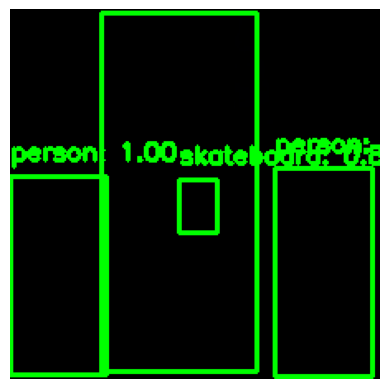

Frame 366, Label: 1, Score: 0.99800044298172
Frame 366, Label: 1, Score: 0.997697651386261
Frame 366, Label: 1, Score: 0.9960941672325134
Frame 366, Label: 37, Score: 0.8510514497756958


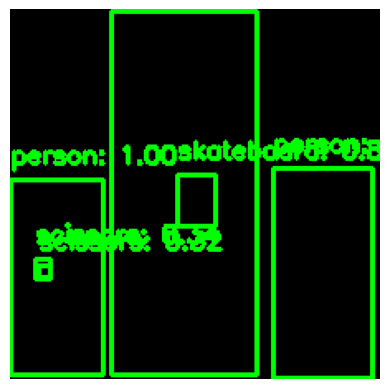

Frame 367, Label: 1, Score: 0.9991717338562012
Frame 367, Label: 1, Score: 0.9977927207946777
Frame 367, Label: 1, Score: 0.9959344863891602
Frame 367, Label: 37, Score: 0.8843227028846741
Frame 367, Label: 77, Score: 0.3361514210700989
Frame 367, Label: 77, Score: 0.31811150908470154


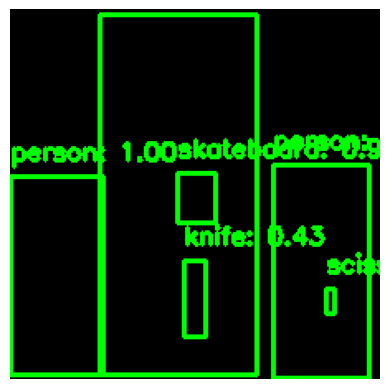

Frame 368, Label: 1, Score: 0.998705267906189
Frame 368, Label: 1, Score: 0.998119056224823
Frame 368, Label: 1, Score: 0.9965750575065613
Frame 368, Label: 37, Score: 0.9521514177322388
Frame 368, Label: 44, Score: 0.4275641143321991
Frame 368, Label: 77, Score: 0.36616188287734985


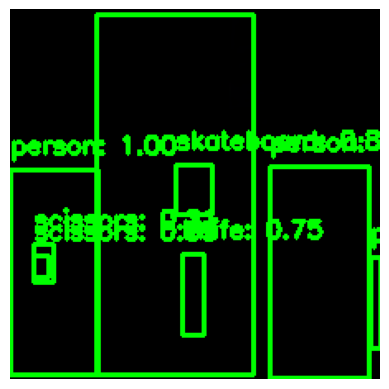

Frame 369, Label: 1, Score: 0.9989808201789856
Frame 369, Label: 1, Score: 0.9966567754745483
Frame 369, Label: 1, Score: 0.9951087832450867
Frame 369, Label: 37, Score: 0.8868088722229004
Frame 369, Label: 44, Score: 0.7540284395217896
Frame 369, Label: 1, Score: 0.3881629705429077
Frame 369, Label: 77, Score: 0.38701099157333374
Frame 369, Label: 77, Score: 0.30584585666656494


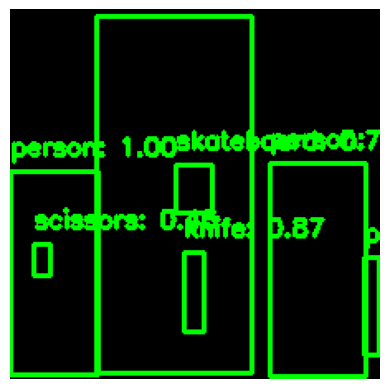

Frame 370, Label: 1, Score: 0.9989743232727051
Frame 370, Label: 1, Score: 0.9968354105949402
Frame 370, Label: 1, Score: 0.9955933690071106
Frame 370, Label: 44, Score: 0.8746403455734253
Frame 370, Label: 37, Score: 0.7826240062713623
Frame 370, Label: 1, Score: 0.6624632477760315
Frame 370, Label: 77, Score: 0.46445396542549133


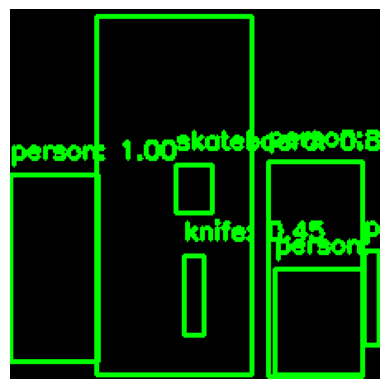

Frame 371, Label: 1, Score: 0.9991076588630676
Frame 371, Label: 1, Score: 0.9976600408554077
Frame 371, Label: 1, Score: 0.9961352348327637
Frame 371, Label: 37, Score: 0.8231959342956543
Frame 371, Label: 1, Score: 0.6458406448364258
Frame 371, Label: 44, Score: 0.45002058148384094
Frame 371, Label: 1, Score: 0.30860063433647156


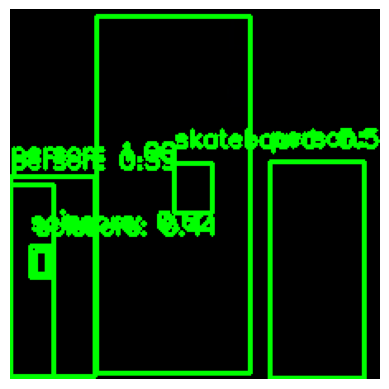

Frame 372, Label: 1, Score: 0.9985892176628113
Frame 372, Label: 1, Score: 0.996696949005127
Frame 372, Label: 1, Score: 0.9950518012046814
Frame 372, Label: 77, Score: 0.6169289350509644
Frame 372, Label: 37, Score: 0.5791739225387573
Frame 372, Label: 77, Score: 0.4149197041988373
Frame 372, Label: 1, Score: 0.38882920145988464


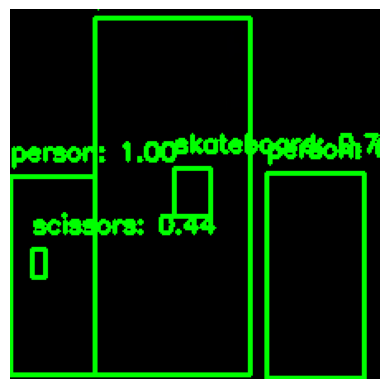

Frame 373, Label: 1, Score: 0.9987132549285889
Frame 373, Label: 1, Score: 0.9972032308578491
Frame 373, Label: 1, Score: 0.9940465688705444
Frame 373, Label: 37, Score: 0.7086307406425476
Frame 373, Label: 77, Score: 0.43694064021110535


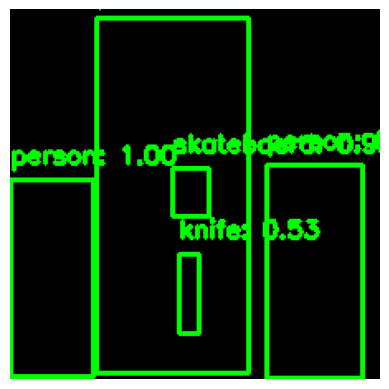

Frame 374, Label: 1, Score: 0.9986706972122192
Frame 374, Label: 1, Score: 0.9974811673164368
Frame 374, Label: 1, Score: 0.9945493340492249
Frame 374, Label: 37, Score: 0.915606677532196
Frame 374, Label: 44, Score: 0.5308106541633606


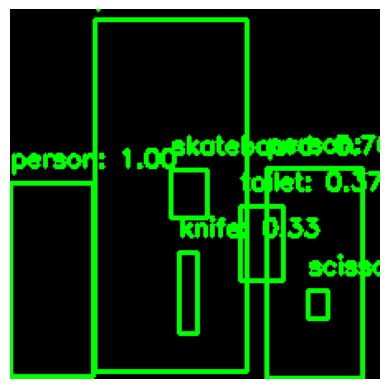

Frame 375, Label: 1, Score: 0.9988802075386047
Frame 375, Label: 1, Score: 0.9965062737464905
Frame 375, Label: 1, Score: 0.995759904384613
Frame 375, Label: 37, Score: 0.7630576491355896
Frame 375, Label: 77, Score: 0.37307268381118774
Frame 375, Label: 62, Score: 0.37173885107040405
Frame 375, Label: 44, Score: 0.3258116543292999


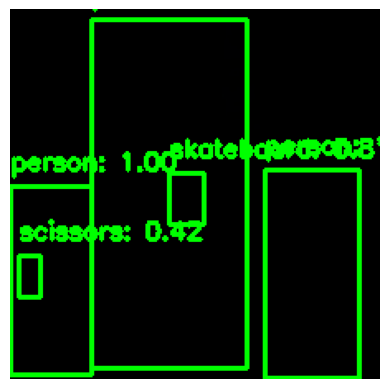

Frame 376, Label: 1, Score: 0.9983510971069336
Frame 376, Label: 1, Score: 0.9965623021125793
Frame 376, Label: 1, Score: 0.9952202439308167
Frame 376, Label: 37, Score: 0.808944582939148
Frame 376, Label: 77, Score: 0.42393091320991516


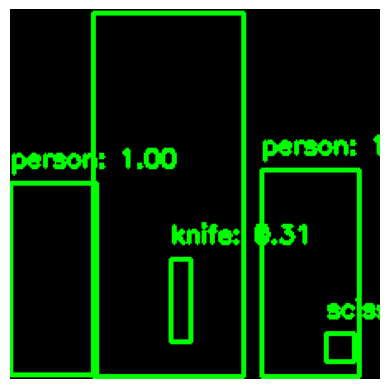

Frame 377, Label: 1, Score: 0.9991851449012756
Frame 377, Label: 1, Score: 0.9972562193870544
Frame 377, Label: 1, Score: 0.995699405670166
Frame 377, Label: 77, Score: 0.4563249945640564
Frame 377, Label: 44, Score: 0.31094691157341003


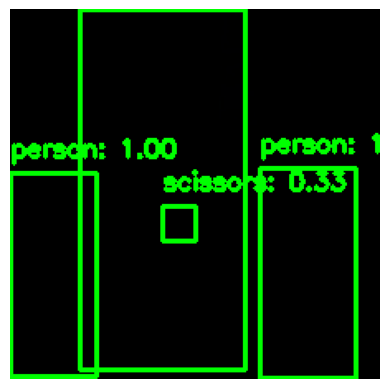

Frame 378, Label: 1, Score: 0.997539758682251
Frame 378, Label: 1, Score: 0.9973351359367371
Frame 378, Label: 1, Score: 0.9957667589187622
Frame 378, Label: 77, Score: 0.3250424563884735


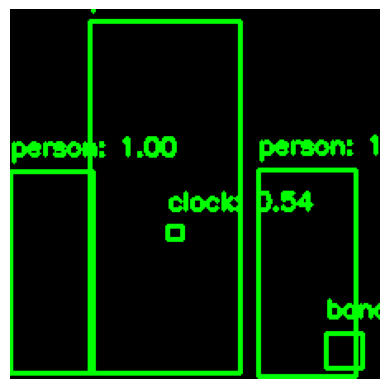

Frame 379, Label: 1, Score: 0.9981813430786133
Frame 379, Label: 1, Score: 0.9972583055496216
Frame 379, Label: 1, Score: 0.9960594177246094
Frame 379, Label: 75, Score: 0.535490095615387
Frame 379, Label: 47, Score: 0.3181428909301758


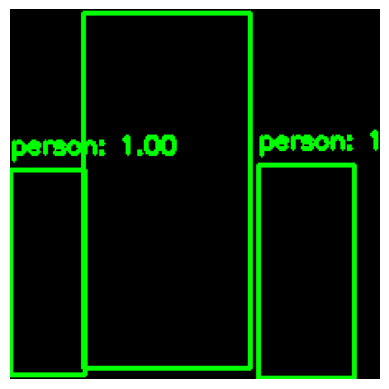

Frame 380, Label: 1, Score: 0.9983599781990051
Frame 380, Label: 1, Score: 0.9970635771751404
Frame 380, Label: 1, Score: 0.996856689453125


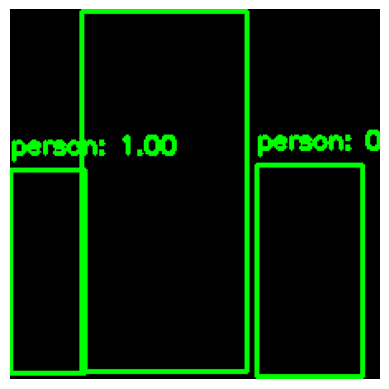

Frame 381, Label: 1, Score: 0.9968384504318237
Frame 381, Label: 1, Score: 0.9965606331825256
Frame 381, Label: 1, Score: 0.9946262240409851


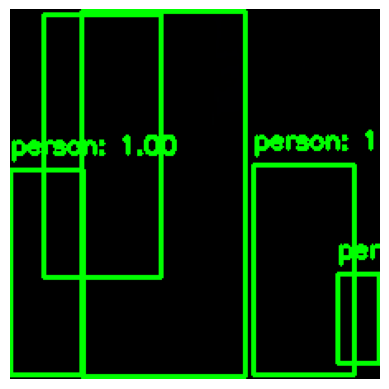

Frame 382, Label: 1, Score: 0.9975119829177856
Frame 382, Label: 1, Score: 0.9959239959716797
Frame 382, Label: 1, Score: 0.9952104687690735
Frame 382, Label: 1, Score: 0.9501346945762634
Frame 382, Label: 1, Score: 0.484536737203598


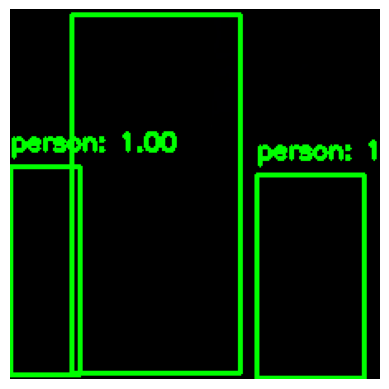

Frame 383, Label: 1, Score: 0.9972813129425049
Frame 383, Label: 1, Score: 0.9967490434646606
Frame 383, Label: 1, Score: 0.9959812164306641


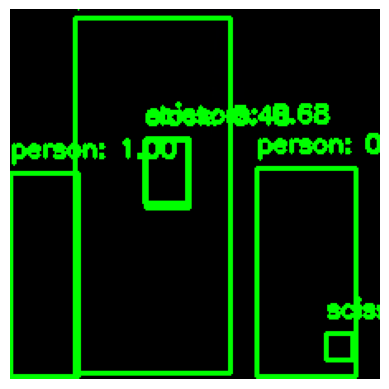

Frame 384, Label: 1, Score: 0.9986044764518738
Frame 384, Label: 1, Score: 0.9966263771057129
Frame 384, Label: 1, Score: 0.9924928545951843
Frame 384, Label: 77, Score: 0.6754220128059387
Frame 384, Label: 75, Score: 0.4775805175304413
Frame 384, Label: 77, Score: 0.4324212670326233


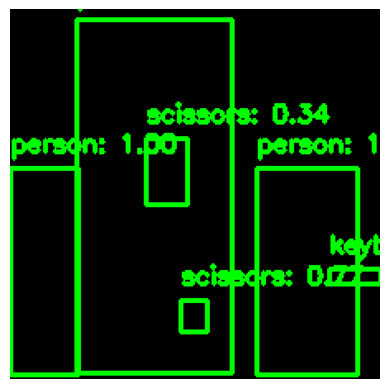

Frame 385, Label: 1, Score: 0.9979884624481201
Frame 385, Label: 1, Score: 0.9972367286682129
Frame 385, Label: 1, Score: 0.99644935131073
Frame 385, Label: 77, Score: 0.7748842835426331
Frame 385, Label: 67, Score: 0.3773731291294098
Frame 385, Label: 77, Score: 0.3368852436542511


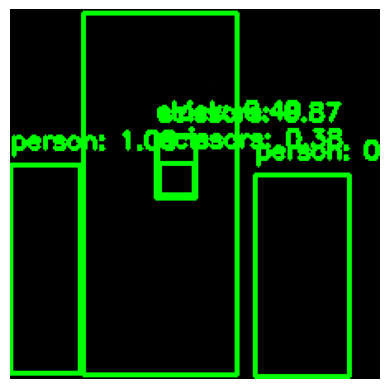

Frame 386, Label: 1, Score: 0.9985918402671814
Frame 386, Label: 1, Score: 0.997256338596344
Frame 386, Label: 1, Score: 0.99381023645401
Frame 386, Label: 77, Score: 0.8671555519104004
Frame 386, Label: 75, Score: 0.4853312075138092
Frame 386, Label: 77, Score: 0.3818877339363098


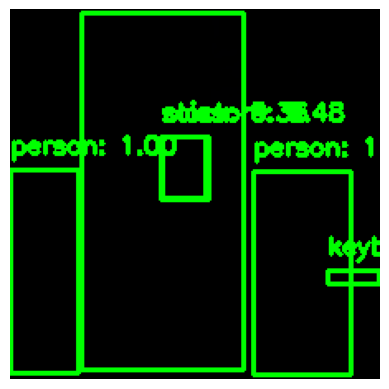

Frame 387, Label: 1, Score: 0.9985746145248413
Frame 387, Label: 1, Score: 0.997818112373352
Frame 387, Label: 1, Score: 0.9960088729858398
Frame 387, Label: 77, Score: 0.4781343340873718
Frame 387, Label: 67, Score: 0.4105542004108429
Frame 387, Label: 75, Score: 0.3616143763065338


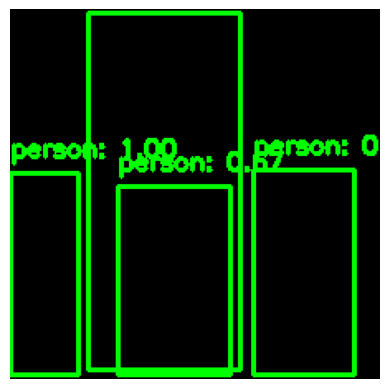

Frame 388, Label: 1, Score: 0.9973533153533936
Frame 388, Label: 1, Score: 0.9969568252563477
Frame 388, Label: 1, Score: 0.9948833584785461
Frame 388, Label: 1, Score: 0.6732250452041626


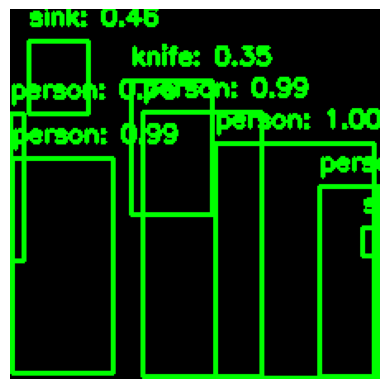

Frame 389, Label: 1, Score: 0.99648118019104
Frame 389, Label: 1, Score: 0.9892975091934204
Frame 389, Label: 1, Score: 0.9879111051559448
Frame 389, Label: 1, Score: 0.8290508985519409
Frame 389, Label: 1, Score: 0.7641961574554443
Frame 389, Label: 72, Score: 0.46102920174598694
Frame 389, Label: 77, Score: 0.43731689453125
Frame 389, Label: 44, Score: 0.3520132303237915


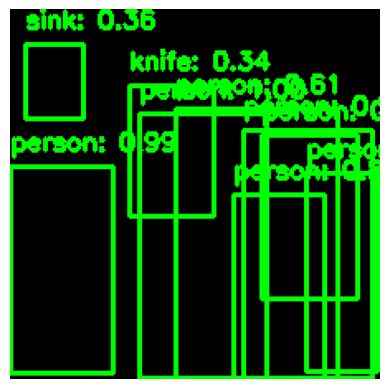

Frame 390, Label: 1, Score: 0.99664306640625
Frame 390, Label: 1, Score: 0.9940040707588196
Frame 390, Label: 1, Score: 0.9933875799179077
Frame 390, Label: 1, Score: 0.8483491539955139
Frame 390, Label: 1, Score: 0.6059422492980957
Frame 390, Label: 1, Score: 0.46266716718673706
Frame 390, Label: 1, Score: 0.38527899980545044
Frame 390, Label: 72, Score: 0.3628844916820526
Frame 390, Label: 44, Score: 0.338739812374115


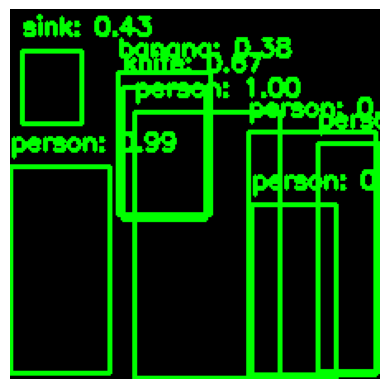

Frame 391, Label: 1, Score: 0.9981091022491455
Frame 391, Label: 1, Score: 0.9922141432762146
Frame 391, Label: 1, Score: 0.9904826879501343
Frame 391, Label: 44, Score: 0.6733726859092712
Frame 391, Label: 1, Score: 0.5869486331939697
Frame 391, Label: 1, Score: 0.4545436501502991
Frame 391, Label: 72, Score: 0.43009981513023376
Frame 391, Label: 47, Score: 0.37693700194358826


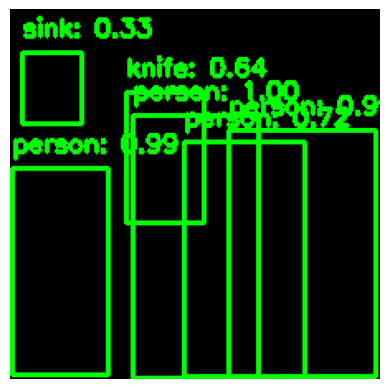

Frame 392, Label: 1, Score: 0.9965454936027527
Frame 392, Label: 1, Score: 0.9918487071990967
Frame 392, Label: 1, Score: 0.9887114763259888
Frame 392, Label: 1, Score: 0.7187169790267944
Frame 392, Label: 44, Score: 0.6414090394973755
Frame 392, Label: 72, Score: 0.32997003197669983


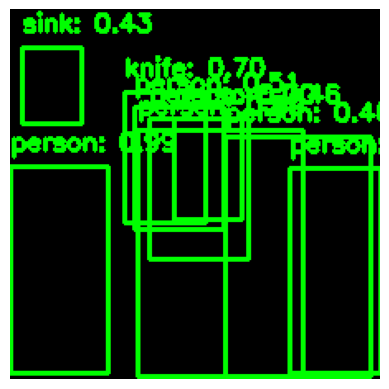

Frame 393, Label: 1, Score: 0.9932793974876404
Frame 393, Label: 1, Score: 0.9932675361633301
Frame 393, Label: 44, Score: 0.7035204768180847
Frame 393, Label: 1, Score: 0.6960322856903076
Frame 393, Label: 1, Score: 0.6767122745513916
Frame 393, Label: 1, Score: 0.5117395520210266
Frame 393, Label: 1, Score: 0.46324270963668823
Frame 393, Label: 1, Score: 0.4632263481616974
Frame 393, Label: 72, Score: 0.43141111731529236


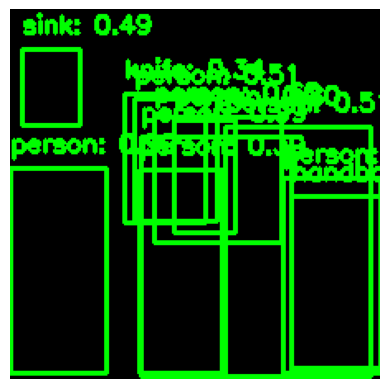

Frame 394, Label: 1, Score: 0.9926238059997559
Frame 394, Label: 1, Score: 0.9923205971717834
Frame 394, Label: 1, Score: 0.7987213730812073
Frame 394, Label: 1, Score: 0.654590368270874
Frame 394, Label: 1, Score: 0.5979774594306946
Frame 394, Label: 1, Score: 0.5109323263168335
Frame 394, Label: 1, Score: 0.5106485486030579
Frame 394, Label: 72, Score: 0.48766660690307617
Frame 394, Label: 1, Score: 0.39384719729423523
Frame 394, Label: 27, Score: 0.3458486795425415
Frame 394, Label: 44, Score: 0.33584722876548767


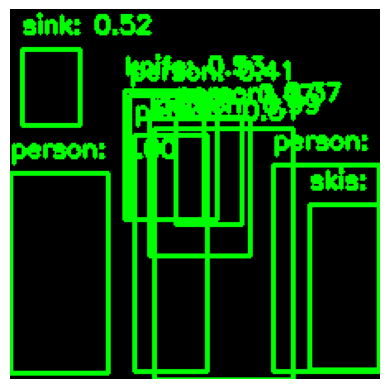

Frame 395, Label: 1, Score: 0.9962957501411438
Frame 395, Label: 1, Score: 0.9903609752655029
Frame 395, Label: 44, Score: 0.5343540906906128
Frame 395, Label: 72, Score: 0.5182101130485535
Frame 395, Label: 1, Score: 0.5145307779312134
Frame 395, Label: 1, Score: 0.5077407956123352
Frame 395, Label: 1, Score: 0.4727068841457367
Frame 395, Label: 1, Score: 0.4120278060436249
Frame 395, Label: 1, Score: 0.3698233366012573
Frame 395, Label: 31, Score: 0.33883950114250183


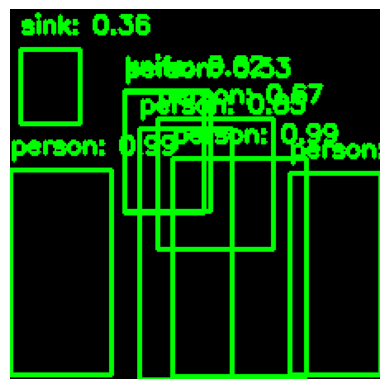

Frame 396, Label: 1, Score: 0.9943137168884277
Frame 396, Label: 1, Score: 0.9916274547576904
Frame 396, Label: 1, Score: 0.8949890732765198
Frame 396, Label: 1, Score: 0.8458842635154724
Frame 396, Label: 1, Score: 0.6671205759048462
Frame 396, Label: 44, Score: 0.6214922666549683
Frame 396, Label: 1, Score: 0.5324243903160095
Frame 396, Label: 72, Score: 0.36187878251075745


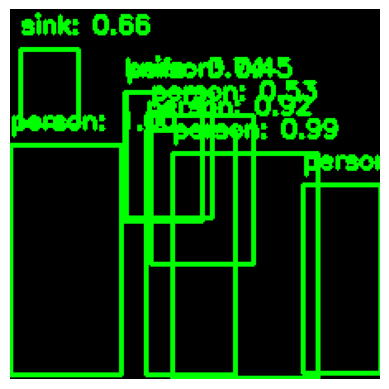

Frame 397, Label: 1, Score: 0.996329128742218
Frame 397, Label: 1, Score: 0.9905346035957336
Frame 397, Label: 1, Score: 0.9219921231269836
Frame 397, Label: 1, Score: 0.8119362592697144
Frame 397, Label: 44, Score: 0.7375581860542297
Frame 397, Label: 72, Score: 0.6550183892250061
Frame 397, Label: 1, Score: 0.5283935070037842
Frame 397, Label: 1, Score: 0.4462863504886627


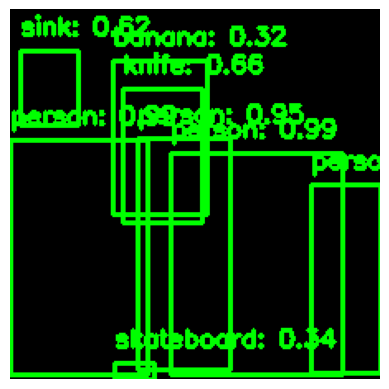

Frame 398, Label: 1, Score: 0.9937043786048889
Frame 398, Label: 1, Score: 0.989385187625885
Frame 398, Label: 1, Score: 0.9477071166038513
Frame 398, Label: 44, Score: 0.6643136143684387
Frame 398, Label: 1, Score: 0.6529137492179871
Frame 398, Label: 72, Score: 0.6247336268424988
Frame 398, Label: 37, Score: 0.3446645140647888
Frame 398, Label: 47, Score: 0.32215723395347595


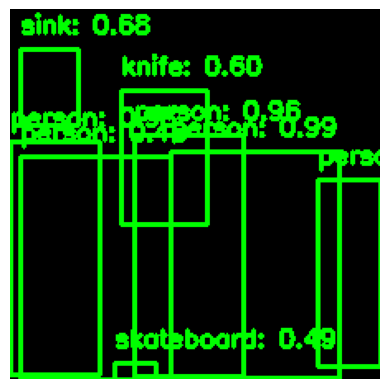

Frame 399, Label: 1, Score: 0.9936487078666687
Frame 399, Label: 1, Score: 0.9803023338317871
Frame 399, Label: 1, Score: 0.9626477956771851
Frame 399, Label: 72, Score: 0.6765629053115845
Frame 399, Label: 44, Score: 0.6003574728965759
Frame 399, Label: 1, Score: 0.5479705929756165
Frame 399, Label: 37, Score: 0.48570340871810913
Frame 399, Label: 1, Score: 0.45741039514541626


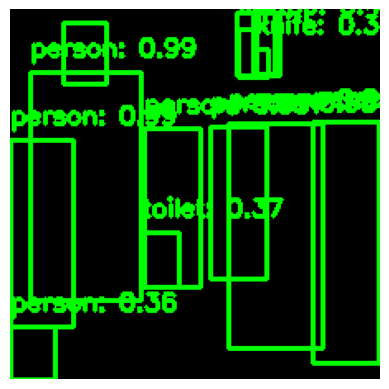

Frame 400, Label: 1, Score: 0.9935239553451538
Frame 400, Label: 1, Score: 0.9929898977279663
Frame 400, Label: 1, Score: 0.9928339719772339
Frame 400, Label: 1, Score: 0.9914804697036743
Frame 400, Label: 1, Score: 0.9875428676605225
Frame 400, Label: 1, Score: 0.9755359292030334
Frame 400, Label: 64, Score: 0.5381680727005005
Frame 400, Label: 72, Score: 0.4604518413543701
Frame 400, Label: 64, Score: 0.44772493839263916
Frame 400, Label: 62, Score: 0.37138259410858154
Frame 400, Label: 64, Score: 0.36815714836120605
Frame 400, Label: 1, Score: 0.3562622666358948
Frame 400, Label: 44, Score: 0.3363880515098572


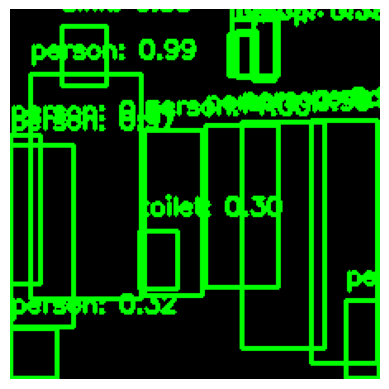

Frame 401, Label: 1, Score: 0.9957166314125061
Frame 401, Label: 1, Score: 0.9945344924926758
Frame 401, Label: 1, Score: 0.9941819310188293
Frame 401, Label: 1, Score: 0.9914926886558533
Frame 401, Label: 1, Score: 0.986992359161377
Frame 401, Label: 1, Score: 0.9749614000320435
Frame 401, Label: 64, Score: 0.8281562924385071
Frame 401, Label: 72, Score: 0.8259274363517761
Frame 401, Label: 64, Score: 0.7436355948448181
Frame 401, Label: 1, Score: 0.7254803776741028
Frame 401, Label: 64, Score: 0.45192110538482666
Frame 401, Label: 64, Score: 0.3518083989620209
Frame 401, Label: 1, Score: 0.32236286997795105
Frame 401, Label: 1, Score: 0.3051810562610626
Frame 401, Label: 62, Score: 0.3008098900318146


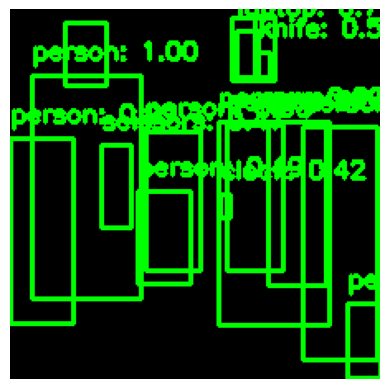

Frame 402, Label: 1, Score: 0.9951516389846802
Frame 402, Label: 1, Score: 0.987304151058197
Frame 402, Label: 1, Score: 0.9853019714355469
Frame 402, Label: 1, Score: 0.9801713228225708
Frame 402, Label: 1, Score: 0.9509957432746887
Frame 402, Label: 64, Score: 0.7647626996040344
Frame 402, Label: 72, Score: 0.6685523390769958
Frame 402, Label: 64, Score: 0.6175008416175842
Frame 402, Label: 44, Score: 0.5617187023162842
Frame 402, Label: 1, Score: 0.5384016633033752
Frame 402, Label: 1, Score: 0.490937739610672
Frame 402, Label: 77, Score: 0.47325170040130615
Frame 402, Label: 75, Score: 0.41869595646858215
Frame 402, Label: 1, Score: 0.3923771381378174
Frame 402, Label: 64, Score: 0.3338491916656494
Frame 402, Label: 1, Score: 0.32395443320274353


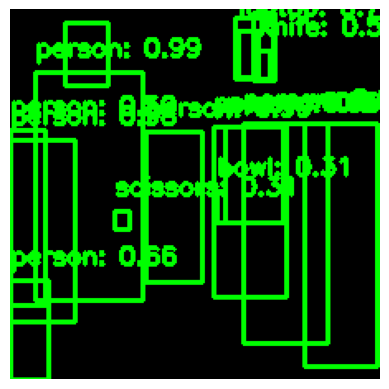

Frame 403, Label: 1, Score: 0.9934612512588501
Frame 403, Label: 1, Score: 0.9886404275894165
Frame 403, Label: 1, Score: 0.9847800731658936
Frame 403, Label: 1, Score: 0.9839135408401489
Frame 403, Label: 1, Score: 0.9837798476219177
Frame 403, Label: 1, Score: 0.9597815871238708
Frame 403, Label: 64, Score: 0.8403263092041016
Frame 403, Label: 72, Score: 0.8184848427772522
Frame 403, Label: 64, Score: 0.7149093151092529
Frame 403, Label: 1, Score: 0.6584779620170593
Frame 403, Label: 44, Score: 0.5314675569534302
Frame 403, Label: 1, Score: 0.5002007484436035
Frame 403, Label: 64, Score: 0.34245359897613525
Frame 403, Label: 1, Score: 0.33619585633277893
Frame 403, Label: 77, Score: 0.3124314546585083
Frame 403, Label: 46, Score: 0.31224459409713745


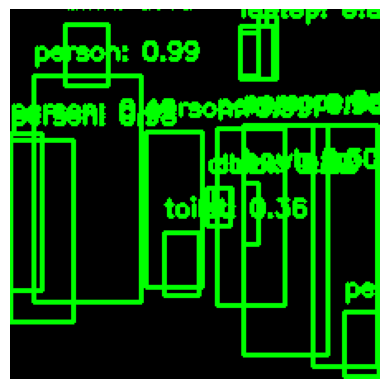

Frame 404, Label: 1, Score: 0.9922559261322021
Frame 404, Label: 1, Score: 0.9917322397232056
Frame 404, Label: 1, Score: 0.9902674555778503
Frame 404, Label: 1, Score: 0.985524594783783
Frame 404, Label: 1, Score: 0.9805517196655273
Frame 404, Label: 1, Score: 0.955325722694397
Frame 404, Label: 64, Score: 0.8195515871047974
Frame 404, Label: 64, Score: 0.8137508034706116
Frame 404, Label: 75, Score: 0.8031334280967712
Frame 404, Label: 64, Score: 0.7461691498756409
Frame 404, Label: 75, Score: 0.498445600271225
Frame 404, Label: 46, Score: 0.4968075156211853
Frame 404, Label: 1, Score: 0.49262452125549316
Frame 404, Label: 72, Score: 0.3970348834991455
Frame 404, Label: 62, Score: 0.3626179099082947
Frame 404, Label: 1, Score: 0.30952003598213196


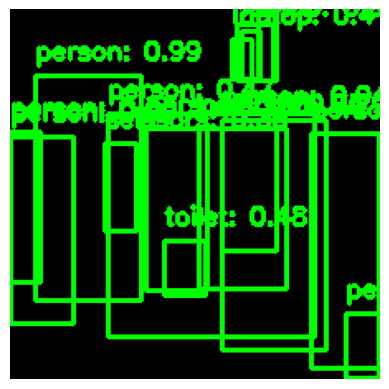

Frame 405, Label: 1, Score: 0.9933859705924988
Frame 405, Label: 1, Score: 0.9912607073783875
Frame 405, Label: 1, Score: 0.986636221408844
Frame 405, Label: 1, Score: 0.9821144938468933
Frame 405, Label: 1, Score: 0.9354373216629028
Frame 405, Label: 64, Score: 0.7984321117401123
Frame 405, Label: 1, Score: 0.7907917499542236
Frame 405, Label: 64, Score: 0.7724481821060181
Frame 405, Label: 1, Score: 0.7483411431312561
Frame 405, Label: 1, Score: 0.6922966837882996
Frame 405, Label: 64, Score: 0.5348725318908691
Frame 405, Label: 62, Score: 0.479625940322876
Frame 405, Label: 1, Score: 0.4689368009567261
Frame 405, Label: 64, Score: 0.4101792275905609
Frame 405, Label: 77, Score: 0.35385578870773315
Frame 405, Label: 1, Score: 0.3292352855205536


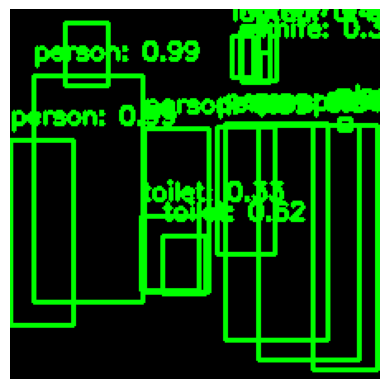

Frame 406, Label: 1, Score: 0.9950527548789978
Frame 406, Label: 1, Score: 0.9946363568305969
Frame 406, Label: 1, Score: 0.989850640296936
Frame 406, Label: 1, Score: 0.988069474697113
Frame 406, Label: 1, Score: 0.9853969216346741
Frame 406, Label: 1, Score: 0.8408412337303162
Frame 406, Label: 1, Score: 0.8401578068733215
Frame 406, Label: 64, Score: 0.7878690361976624
Frame 406, Label: 72, Score: 0.7625974416732788
Frame 406, Label: 64, Score: 0.7587624788284302
Frame 406, Label: 62, Score: 0.6215328574180603
Frame 406, Label: 64, Score: 0.5956050157546997
Frame 406, Label: 64, Score: 0.43943190574645996
Frame 406, Label: 75, Score: 0.4200346767902374
Frame 406, Label: 62, Score: 0.3295173943042755
Frame 406, Label: 44, Score: 0.3084048926830292


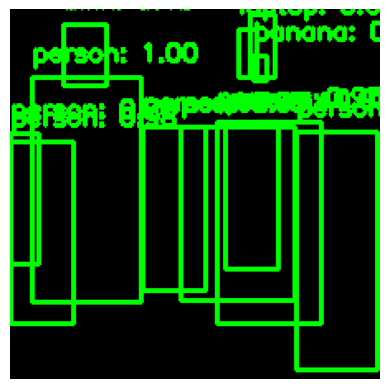

Frame 407, Label: 1, Score: 0.9954344630241394
Frame 407, Label: 1, Score: 0.9874154925346375
Frame 407, Label: 1, Score: 0.9826716780662537
Frame 407, Label: 1, Score: 0.9682155847549438
Frame 407, Label: 1, Score: 0.9541395306587219
Frame 407, Label: 1, Score: 0.9248127341270447
Frame 407, Label: 64, Score: 0.7468692064285278
Frame 407, Label: 1, Score: 0.7013829946517944
Frame 407, Label: 64, Score: 0.6648945212364197
Frame 407, Label: 72, Score: 0.47906801104545593
Frame 407, Label: 1, Score: 0.4400067627429962
Frame 407, Label: 47, Score: 0.38605788350105286


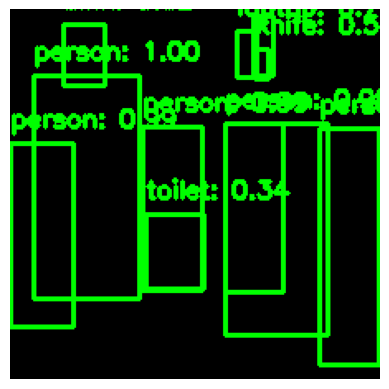

Frame 408, Label: 1, Score: 0.9960899949073792
Frame 408, Label: 1, Score: 0.9934578537940979
Frame 408, Label: 1, Score: 0.9920113682746887
Frame 408, Label: 1, Score: 0.9905133247375488
Frame 408, Label: 1, Score: 0.9901779294013977
Frame 408, Label: 1, Score: 0.9377418160438538
Frame 408, Label: 64, Score: 0.7451855540275574
Frame 408, Label: 64, Score: 0.6978222131729126
Frame 408, Label: 72, Score: 0.6161892414093018
Frame 408, Label: 44, Score: 0.5086201429367065
Frame 408, Label: 62, Score: 0.3421356976032257


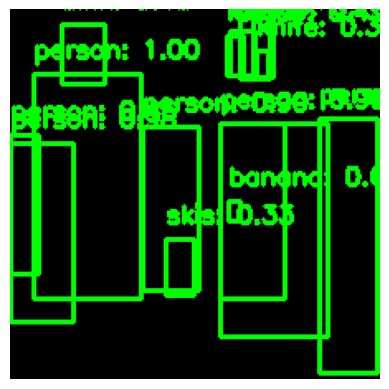

Frame 409, Label: 1, Score: 0.9962001442909241
Frame 409, Label: 1, Score: 0.9929739236831665
Frame 409, Label: 1, Score: 0.992235004901886
Frame 409, Label: 1, Score: 0.9880061745643616
Frame 409, Label: 1, Score: 0.9787634015083313
Frame 409, Label: 1, Score: 0.9362916946411133
Frame 409, Label: 64, Score: 0.7857040166854858
Frame 409, Label: 64, Score: 0.7627678513526917
Frame 409, Label: 47, Score: 0.6350330114364624
Frame 409, Label: 1, Score: 0.46413663029670715
Frame 409, Label: 64, Score: 0.4498763084411621
Frame 409, Label: 72, Score: 0.44946324825286865
Frame 409, Label: 44, Score: 0.3908112049102783
Frame 409, Label: 64, Score: 0.3547060191631317
Frame 409, Label: 31, Score: 0.33222827315330505


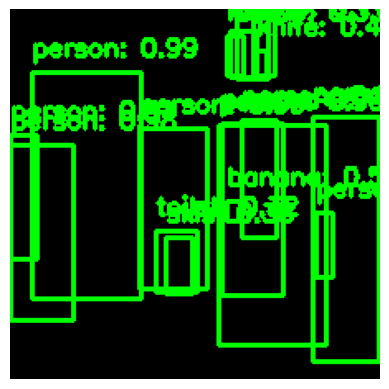

Frame 410, Label: 1, Score: 0.994928240776062
Frame 410, Label: 1, Score: 0.9939727187156677
Frame 410, Label: 1, Score: 0.9938001036643982
Frame 410, Label: 1, Score: 0.9897500872612
Frame 410, Label: 1, Score: 0.9760429263114929
Frame 410, Label: 64, Score: 0.7659174799919128
Frame 410, Label: 1, Score: 0.7424246668815613
Frame 410, Label: 64, Score: 0.6876785159111023
Frame 410, Label: 1, Score: 0.5111920833587646
Frame 410, Label: 47, Score: 0.5043440461158752
Frame 410, Label: 1, Score: 0.4691869020462036
Frame 410, Label: 44, Score: 0.4251384437084198
Frame 410, Label: 31, Score: 0.32914888858795166
Frame 410, Label: 64, Score: 0.3286685645580292
Frame 410, Label: 62, Score: 0.321127712726593
Frame 410, Label: 1, Score: 0.315132200717926
Frame 410, Label: 64, Score: 0.31354039907455444


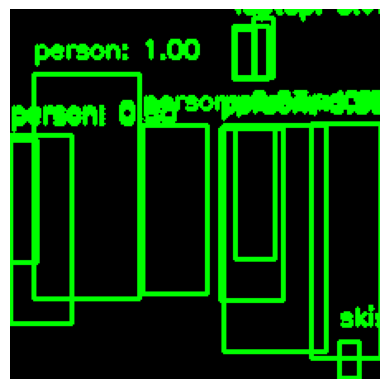

Frame 411, Label: 1, Score: 0.9956016540527344
Frame 411, Label: 1, Score: 0.9952149391174316
Frame 411, Label: 1, Score: 0.9934322834014893
Frame 411, Label: 1, Score: 0.9752389788627625
Frame 411, Label: 1, Score: 0.9713736772537231
Frame 411, Label: 1, Score: 0.8307728171348572
Frame 411, Label: 64, Score: 0.7327157855033875
Frame 411, Label: 64, Score: 0.7069610953330994
Frame 411, Label: 64, Score: 0.5349550247192383
Frame 411, Label: 1, Score: 0.496626615524292
Frame 411, Label: 31, Score: 0.3856242001056671
Frame 411, Label: 1, Score: 0.3566638231277466


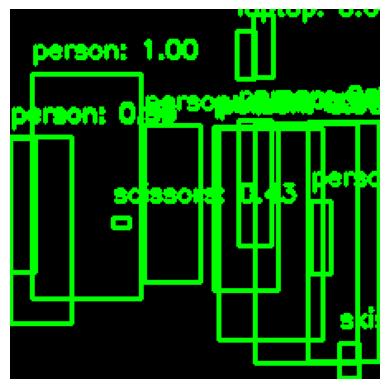

Frame 412, Label: 1, Score: 0.9962071180343628
Frame 412, Label: 1, Score: 0.9943234920501709
Frame 412, Label: 1, Score: 0.9898762106895447
Frame 412, Label: 1, Score: 0.9863648414611816
Frame 412, Label: 1, Score: 0.982339084148407
Frame 412, Label: 1, Score: 0.9378772974014282
Frame 412, Label: 1, Score: 0.8288887739181519
Frame 412, Label: 64, Score: 0.7692053914070129
Frame 412, Label: 64, Score: 0.6156105399131775
Frame 412, Label: 1, Score: 0.4618591368198395
Frame 412, Label: 77, Score: 0.4319061040878296
Frame 412, Label: 1, Score: 0.3869996666908264
Frame 412, Label: 1, Score: 0.34856241941452026
Frame 412, Label: 31, Score: 0.3247258961200714


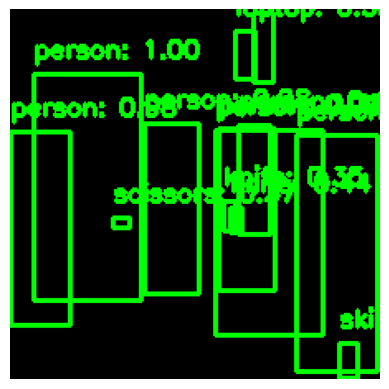

Frame 413, Label: 1, Score: 0.9960092306137085
Frame 413, Label: 1, Score: 0.9881200790405273
Frame 413, Label: 1, Score: 0.9863452315330505
Frame 413, Label: 1, Score: 0.9845837354660034
Frame 413, Label: 1, Score: 0.9845825433731079
Frame 413, Label: 1, Score: 0.7817836999893188
Frame 413, Label: 64, Score: 0.7564544677734375
Frame 413, Label: 64, Score: 0.5812070965766907
Frame 413, Label: 44, Score: 0.44196704030036926
Frame 413, Label: 1, Score: 0.4246605634689331
Frame 413, Label: 31, Score: 0.39044901728630066
Frame 413, Label: 77, Score: 0.3707144856452942
Frame 413, Label: 44, Score: 0.350972056388855


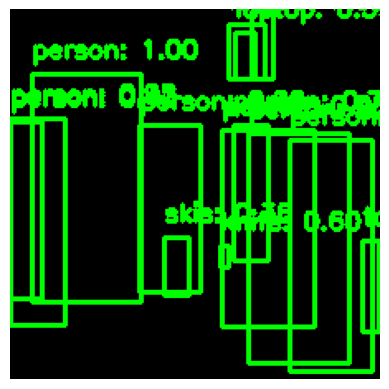

Frame 414, Label: 1, Score: 0.9960364699363708
Frame 414, Label: 1, Score: 0.9937025308609009
Frame 414, Label: 1, Score: 0.9918051958084106
Frame 414, Label: 1, Score: 0.9848666787147522
Frame 414, Label: 1, Score: 0.9537202715873718
Frame 414, Label: 1, Score: 0.776267409324646
Frame 414, Label: 1, Score: 0.7037497758865356
Frame 414, Label: 44, Score: 0.6030324101448059
Frame 414, Label: 64, Score: 0.5911126136779785
Frame 414, Label: 64, Score: 0.567349910736084
Frame 414, Label: 62, Score: 0.49707335233688354
Frame 414, Label: 1, Score: 0.42978954315185547
Frame 414, Label: 31, Score: 0.3642998933792114
Frame 414, Label: 64, Score: 0.3179936110973358


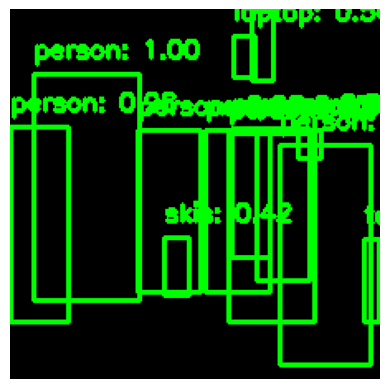

Frame 415, Label: 1, Score: 0.995758593082428
Frame 415, Label: 1, Score: 0.9884313344955444
Frame 415, Label: 1, Score: 0.9827083945274353
Frame 415, Label: 1, Score: 0.982406497001648
Frame 415, Label: 1, Score: 0.9679640531539917
Frame 415, Label: 1, Score: 0.9508936405181885
Frame 415, Label: 47, Score: 0.7144356966018677
Frame 415, Label: 64, Score: 0.5630804896354675
Frame 415, Label: 64, Score: 0.5204401612281799
Frame 415, Label: 1, Score: 0.5203893184661865
Frame 415, Label: 31, Score: 0.4195626974105835
Frame 415, Label: 62, Score: 0.4159332513809204
Frame 415, Label: 1, Score: 0.3607094883918762


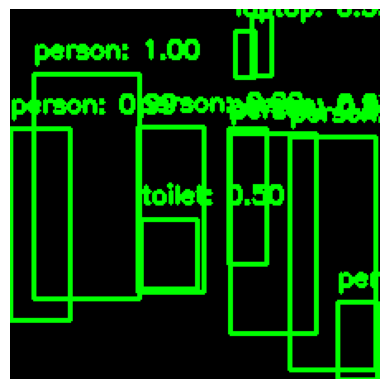

Frame 416, Label: 1, Score: 0.9961484670639038
Frame 416, Label: 1, Score: 0.9913119077682495
Frame 416, Label: 1, Score: 0.9878360629081726
Frame 416, Label: 1, Score: 0.9872387051582336
Frame 416, Label: 1, Score: 0.9820266366004944
Frame 416, Label: 1, Score: 0.9672656059265137
Frame 416, Label: 64, Score: 0.6072573661804199
Frame 416, Label: 1, Score: 0.5433441400527954
Frame 416, Label: 64, Score: 0.5316900014877319
Frame 416, Label: 62, Score: 0.500997006893158


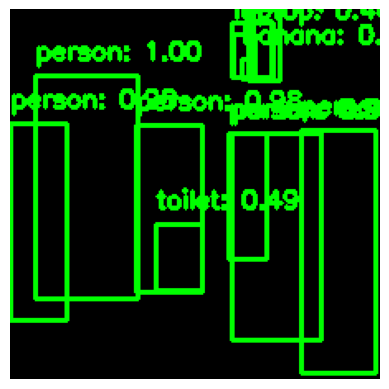

Frame 417, Label: 1, Score: 0.9953789710998535
Frame 417, Label: 1, Score: 0.9909306168556213
Frame 417, Label: 1, Score: 0.9868645071983337
Frame 417, Label: 1, Score: 0.9821940660476685
Frame 417, Label: 1, Score: 0.9810494780540466
Frame 417, Label: 1, Score: 0.9489614963531494
Frame 417, Label: 64, Score: 0.6744348406791687
Frame 417, Label: 62, Score: 0.48963916301727295
Frame 417, Label: 64, Score: 0.4627332389354706
Frame 417, Label: 47, Score: 0.4392186403274536
Frame 417, Label: 64, Score: 0.39534899592399597
Frame 417, Label: 64, Score: 0.33811745047569275


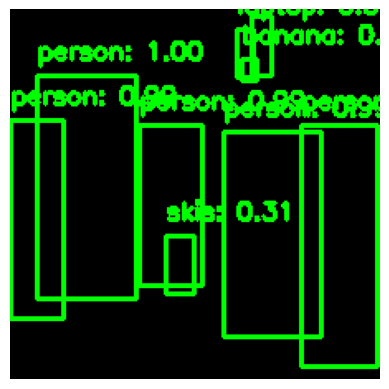

Frame 418, Label: 1, Score: 0.9962431192398071
Frame 418, Label: 1, Score: 0.9952173233032227
Frame 418, Label: 1, Score: 0.9905797839164734
Frame 418, Label: 1, Score: 0.9883605241775513
Frame 418, Label: 1, Score: 0.9853591918945312
Frame 418, Label: 64, Score: 0.7559376358985901
Frame 418, Label: 64, Score: 0.38559502363204956
Frame 418, Label: 31, Score: 0.30811476707458496
Frame 418, Label: 47, Score: 0.300575315952301


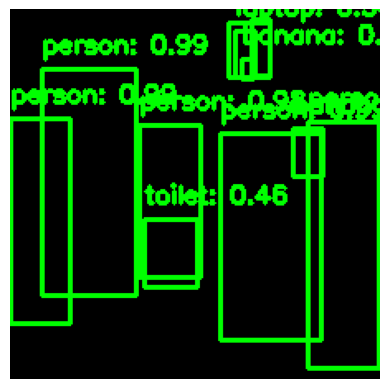

Frame 419, Label: 1, Score: 0.9947150349617004
Frame 419, Label: 1, Score: 0.9937738180160522
Frame 419, Label: 1, Score: 0.9935232400894165
Frame 419, Label: 1, Score: 0.9933862090110779
Frame 419, Label: 1, Score: 0.9759930968284607
Frame 419, Label: 47, Score: 0.9697904586791992
Frame 419, Label: 64, Score: 0.6081081032752991
Frame 419, Label: 64, Score: 0.5574135780334473
Frame 419, Label: 62, Score: 0.4631546139717102
Frame 419, Label: 64, Score: 0.3783307373523712
Frame 419, Label: 47, Score: 0.30989497900009155


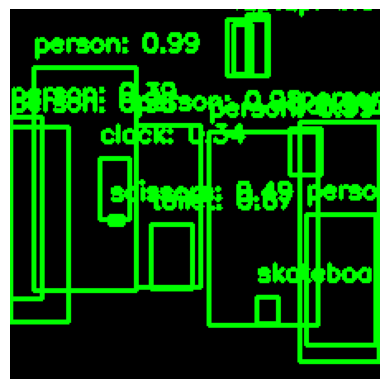

Frame 420, Label: 1, Score: 0.9940804839134216
Frame 420, Label: 1, Score: 0.9903040528297424
Frame 420, Label: 1, Score: 0.9896148443222046
Frame 420, Label: 1, Score: 0.9827563762664795
Frame 420, Label: 1, Score: 0.9790796041488647
Frame 420, Label: 47, Score: 0.8819891810417175
Frame 420, Label: 64, Score: 0.7141674757003784
Frame 420, Label: 62, Score: 0.6722256541252136
Frame 420, Label: 77, Score: 0.4925501048564911
Frame 420, Label: 64, Score: 0.4836351275444031
Frame 420, Label: 1, Score: 0.44802096486091614
Frame 420, Label: 1, Score: 0.3930206596851349
Frame 420, Label: 64, Score: 0.3840029537677765
Frame 420, Label: 75, Score: 0.33632245659828186
Frame 420, Label: 37, Score: 0.31043025851249695


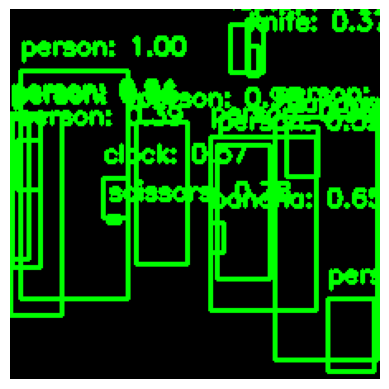

Frame 421, Label: 1, Score: 0.9965857267379761
Frame 421, Label: 1, Score: 0.9912257790565491
Frame 421, Label: 1, Score: 0.9849187135696411
Frame 421, Label: 1, Score: 0.9769649505615234
Frame 421, Label: 1, Score: 0.9403504729270935
Frame 421, Label: 47, Score: 0.8464948534965515
Frame 421, Label: 77, Score: 0.7822975516319275
Frame 421, Label: 47, Score: 0.647306501865387
Frame 421, Label: 64, Score: 0.5843108892440796
Frame 421, Label: 75, Score: 0.5696386694908142
Frame 421, Label: 1, Score: 0.5536506175994873
Frame 421, Label: 1, Score: 0.5177004337310791
Frame 421, Label: 64, Score: 0.47873789072036743
Frame 421, Label: 1, Score: 0.4112153649330139
Frame 421, Label: 1, Score: 0.388492614030838
Frame 421, Label: 44, Score: 0.37304651737213135
Frame 421, Label: 1, Score: 0.3190842866897583


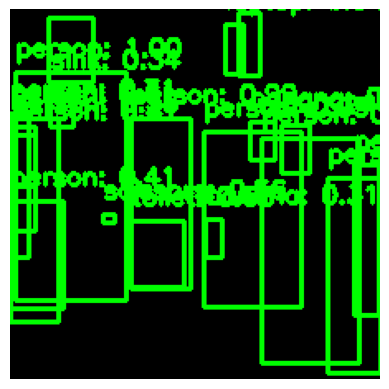

Frame 422, Label: 1, Score: 0.9964455962181091
Frame 422, Label: 1, Score: 0.9866869449615479
Frame 422, Label: 1, Score: 0.9852606654167175
Frame 422, Label: 47, Score: 0.9827612042427063
Frame 422, Label: 1, Score: 0.98103928565979
Frame 422, Label: 1, Score: 0.7116037607192993
Frame 422, Label: 72, Score: 0.6967095732688904
Frame 422, Label: 64, Score: 0.6721265912055969
Frame 422, Label: 62, Score: 0.6336640119552612
Frame 422, Label: 1, Score: 0.6137791275978088
Frame 422, Label: 1, Score: 0.586763322353363
Frame 422, Label: 47, Score: 0.5832615494728088
Frame 422, Label: 77, Score: 0.5556384325027466
Frame 422, Label: 64, Score: 0.5442179441452026
Frame 422, Label: 1, Score: 0.4136718213558197
Frame 422, Label: 1, Score: 0.4133237302303314
Frame 422, Label: 1, Score: 0.40892571210861206
Frame 422, Label: 1, Score: 0.37627556920051575
Frame 422, Label: 72, Score: 0.3378552496433258
Frame 422, Label: 47, Score: 0.3062420189380646


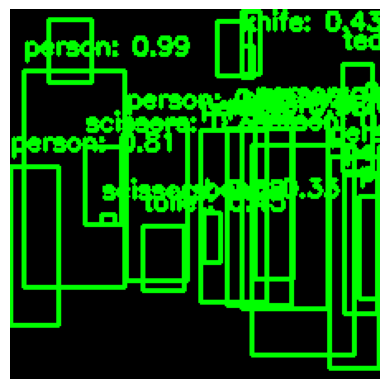

Frame 423, Label: 1, Score: 0.9919691681861877
Frame 423, Label: 1, Score: 0.9908391833305359
Frame 423, Label: 1, Score: 0.9837260842323303
Frame 423, Label: 1, Score: 0.9779849052429199
Frame 423, Label: 1, Score: 0.8098800778388977
Frame 423, Label: 1, Score: 0.7774928212165833
Frame 423, Label: 64, Score: 0.7019147276878357
Frame 423, Label: 1, Score: 0.6706691384315491
Frame 423, Label: 77, Score: 0.5779143571853638
Frame 423, Label: 64, Score: 0.5161823034286499
Frame 423, Label: 1, Score: 0.49592989683151245
Frame 423, Label: 62, Score: 0.4454555809497833
Frame 423, Label: 44, Score: 0.42875656485557556
Frame 423, Label: 1, Score: 0.4214581251144409
Frame 423, Label: 77, Score: 0.3798007667064667
Frame 423, Label: 1, Score: 0.36151570081710815
Frame 423, Label: 1, Score: 0.3596940338611603
Frame 423, Label: 72, Score: 0.34506112337112427
Frame 423, Label: 46, Score: 0.32764098048210144
Frame 423, Label: 78, Score: 0.31160932779312134


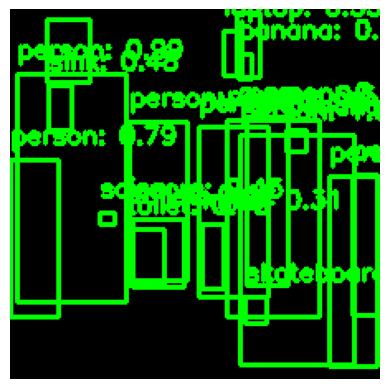

Frame 424, Label: 1, Score: 0.9951530694961548
Frame 424, Label: 1, Score: 0.9946205615997314
Frame 424, Label: 1, Score: 0.981353759765625
Frame 424, Label: 1, Score: 0.9775510430335999
Frame 424, Label: 1, Score: 0.8671656250953674
Frame 424, Label: 72, Score: 0.8658639788627625
Frame 424, Label: 1, Score: 0.7900500297546387
Frame 424, Label: 1, Score: 0.7132303714752197
Frame 424, Label: 64, Score: 0.7051091194152832
Frame 424, Label: 47, Score: 0.6611911654472351
Frame 424, Label: 64, Score: 0.5549154281616211
Frame 424, Label: 1, Score: 0.5456914901733398
Frame 424, Label: 1, Score: 0.5050732493400574
Frame 424, Label: 62, Score: 0.48354971408843994
Frame 424, Label: 72, Score: 0.4788646996021271
Frame 424, Label: 77, Score: 0.44542667269706726
Frame 424, Label: 47, Score: 0.42864277958869934
Frame 424, Label: 62, Score: 0.4228208065032959
Frame 424, Label: 37, Score: 0.34215274453163147
Frame 424, Label: 44, Score: 0.31200987100601196


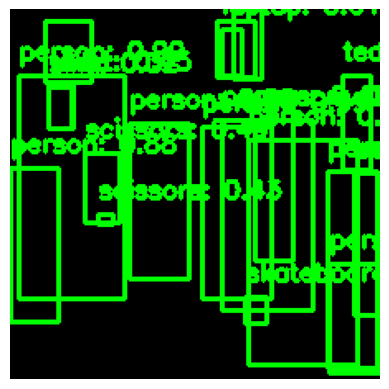

Frame 425, Label: 1, Score: 0.9947294592857361
Frame 425, Label: 1, Score: 0.9937523007392883
Frame 425, Label: 1, Score: 0.9868365526199341
Frame 425, Label: 1, Score: 0.9802097082138062
Frame 425, Label: 72, Score: 0.9103834629058838
Frame 425, Label: 1, Score: 0.876664936542511
Frame 425, Label: 1, Score: 0.6697645783424377
Frame 425, Label: 64, Score: 0.6642785668373108
Frame 425, Label: 37, Score: 0.6539703607559204
Frame 425, Label: 64, Score: 0.6422467231750488
Frame 425, Label: 64, Score: 0.6096208691596985
Frame 425, Label: 1, Score: 0.5470883846282959
Frame 425, Label: 77, Score: 0.4914197027683258
Frame 425, Label: 1, Score: 0.47621238231658936
Frame 425, Label: 62, Score: 0.4492100477218628
Frame 425, Label: 77, Score: 0.43441760540008545
Frame 425, Label: 1, Score: 0.42561423778533936
Frame 425, Label: 78, Score: 0.38122567534446716
Frame 425, Label: 72, Score: 0.31977641582489014
Frame 425, Label: 1, Score: 0.3177013695240021


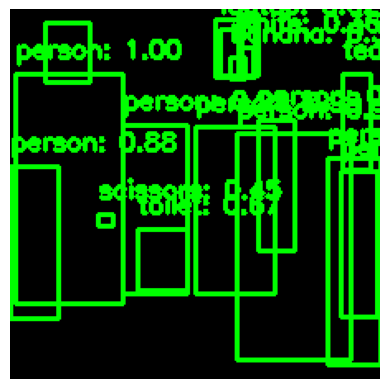

Frame 426, Label: 1, Score: 0.9955106973648071
Frame 426, Label: 1, Score: 0.9921700358390808
Frame 426, Label: 1, Score: 0.9888512492179871
Frame 426, Label: 1, Score: 0.9885410666465759
Frame 426, Label: 1, Score: 0.8815513253211975
Frame 426, Label: 1, Score: 0.8238184452056885
Frame 426, Label: 1, Score: 0.7224936485290527
Frame 426, Label: 62, Score: 0.673925518989563
Frame 426, Label: 64, Score: 0.6393272280693054
Frame 426, Label: 1, Score: 0.6326896548271179
Frame 426, Label: 64, Score: 0.6207139492034912
Frame 426, Label: 64, Score: 0.619384229183197
Frame 426, Label: 78, Score: 0.5561055541038513
Frame 426, Label: 77, Score: 0.45157983899116516
Frame 426, Label: 72, Score: 0.4396493434906006
Frame 426, Label: 47, Score: 0.3613671064376831
Frame 426, Label: 44, Score: 0.35562950372695923


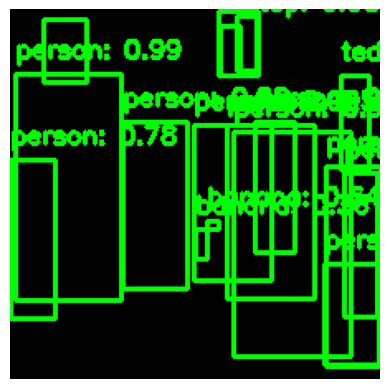

Frame 427, Label: 1, Score: 0.9935348033905029
Frame 427, Label: 1, Score: 0.9874561429023743
Frame 427, Label: 1, Score: 0.9848018288612366
Frame 427, Label: 1, Score: 0.9749408960342407
Frame 427, Label: 1, Score: 0.8334161043167114
Frame 427, Label: 1, Score: 0.7789758443832397
Frame 427, Label: 47, Score: 0.6421186923980713
Frame 427, Label: 72, Score: 0.5854300856590271
Frame 427, Label: 64, Score: 0.5532702207565308
Frame 427, Label: 1, Score: 0.5486503839492798
Frame 427, Label: 1, Score: 0.4687400758266449
Frame 427, Label: 1, Score: 0.392363578081131
Frame 427, Label: 64, Score: 0.3791487216949463
Frame 427, Label: 78, Score: 0.3754477798938751
Frame 427, Label: 64, Score: 0.37357789278030396
Frame 427, Label: 47, Score: 0.3625609874725342
Frame 427, Label: 1, Score: 0.31104135513305664


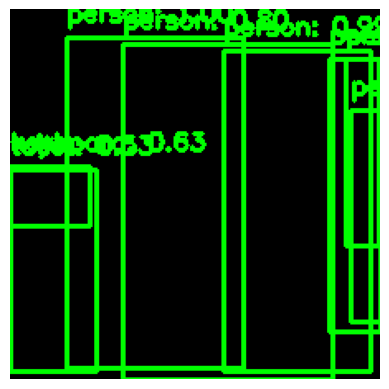

Frame 428, Label: 1, Score: 0.9976644515991211
Frame 428, Label: 1, Score: 0.9939875602722168
Frame 428, Label: 1, Score: 0.8890880346298218
Frame 428, Label: 1, Score: 0.8047173619270325
Frame 428, Label: 67, Score: 0.6296217441558838
Frame 428, Label: 62, Score: 0.5322522521018982
Frame 428, Label: 1, Score: 0.3834730088710785
Frame 428, Label: 1, Score: 0.3639848828315735


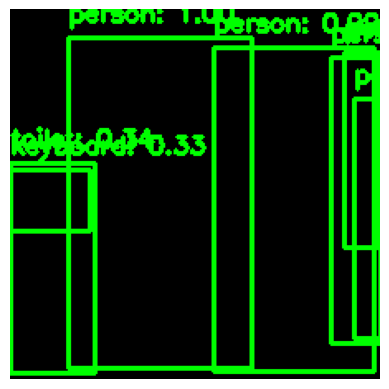

Frame 429, Label: 1, Score: 0.9973949193954468
Frame 429, Label: 1, Score: 0.9949616193771362
Frame 429, Label: 1, Score: 0.8913002014160156
Frame 429, Label: 1, Score: 0.554879903793335
Frame 429, Label: 1, Score: 0.5018078088760376
Frame 429, Label: 62, Score: 0.34026795625686646
Frame 429, Label: 67, Score: 0.3345414400100708


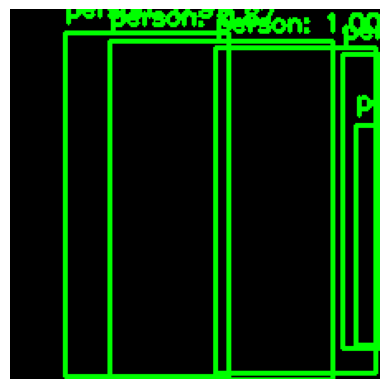

Frame 430, Label: 1, Score: 0.9952349066734314
Frame 430, Label: 1, Score: 0.9923357367515564
Frame 430, Label: 1, Score: 0.9240909218788147
Frame 430, Label: 1, Score: 0.8743886947631836
Frame 430, Label: 1, Score: 0.3179100453853607


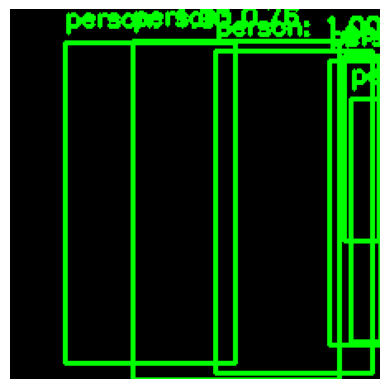

Frame 431, Label: 1, Score: 0.9973424077033997
Frame 431, Label: 1, Score: 0.9956381916999817
Frame 431, Label: 1, Score: 0.8573764562606812
Frame 431, Label: 1, Score: 0.7617571949958801
Frame 431, Label: 1, Score: 0.608322024345398
Frame 431, Label: 1, Score: 0.5506214499473572


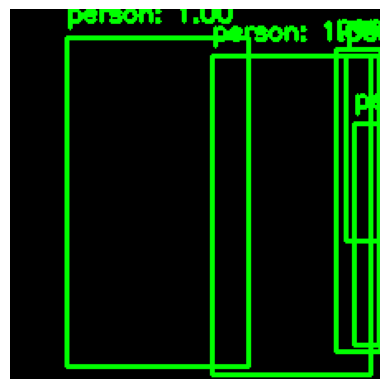

Frame 432, Label: 1, Score: 0.9984002709388733
Frame 432, Label: 1, Score: 0.9967231154441833
Frame 432, Label: 1, Score: 0.8861713409423828
Frame 432, Label: 1, Score: 0.3445858955383301
Frame 432, Label: 1, Score: 0.33048439025878906


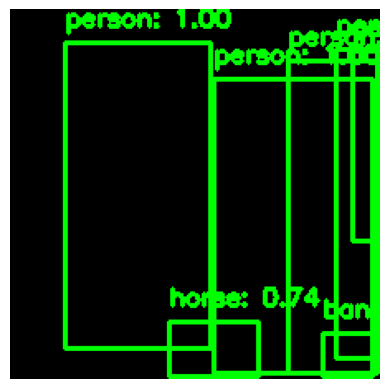

Frame 433, Label: 1, Score: 0.9982269406318665
Frame 433, Label: 1, Score: 0.9980873465538025
Frame 433, Label: 18, Score: 0.7421303391456604
Frame 433, Label: 1, Score: 0.6970900297164917
Frame 433, Label: 1, Score: 0.678434431552887
Frame 433, Label: 1, Score: 0.4175221025943756
Frame 433, Label: 47, Score: 0.3514453172683716


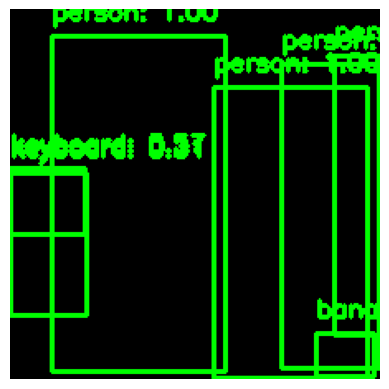

Frame 434, Label: 1, Score: 0.9985106587409973
Frame 434, Label: 1, Score: 0.9984637498855591
Frame 434, Label: 1, Score: 0.912652313709259
Frame 434, Label: 67, Score: 0.5712793469429016
Frame 434, Label: 47, Score: 0.46711811423301697
Frame 434, Label: 1, Score: 0.4471910297870636
Frame 434, Label: 67, Score: 0.3114953339099884


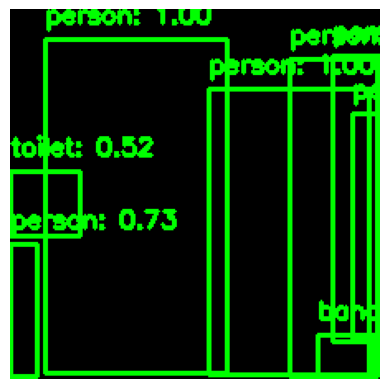

Frame 435, Label: 1, Score: 0.998225748538971
Frame 435, Label: 1, Score: 0.9968782663345337
Frame 435, Label: 1, Score: 0.8940175771713257
Frame 435, Label: 1, Score: 0.7868399620056152
Frame 435, Label: 1, Score: 0.7293764352798462
Frame 435, Label: 62, Score: 0.5236709117889404
Frame 435, Label: 47, Score: 0.3251146972179413
Frame 435, Label: 1, Score: 0.3153148591518402


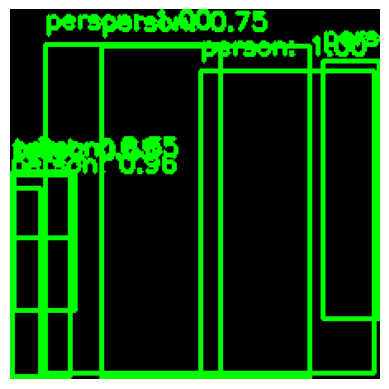

Frame 436, Label: 1, Score: 0.9982871413230896
Frame 436, Label: 1, Score: 0.9962164759635925
Frame 436, Label: 1, Score: 0.9608284831047058
Frame 436, Label: 1, Score: 0.9399988651275635
Frame 436, Label: 1, Score: 0.7508742809295654
Frame 436, Label: 62, Score: 0.6072087287902832
Frame 436, Label: 62, Score: 0.5485634207725525
Frame 436, Label: 1, Score: 0.35121795535087585


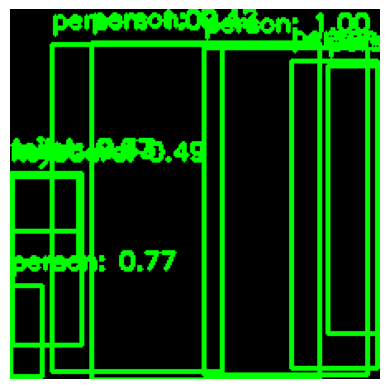

Frame 437, Label: 1, Score: 0.9990978240966797
Frame 437, Label: 1, Score: 0.9970861077308655
Frame 437, Label: 1, Score: 0.9173390865325928
Frame 437, Label: 1, Score: 0.7672584652900696
Frame 437, Label: 1, Score: 0.7427467107772827
Frame 437, Label: 67, Score: 0.48626330494880676
Frame 437, Label: 62, Score: 0.4266064465045929
Frame 437, Label: 1, Score: 0.4157521724700928
Frame 437, Label: 62, Score: 0.3695630133152008


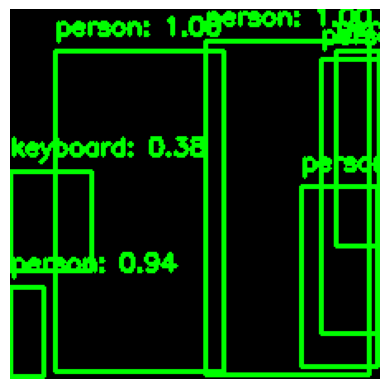

Frame 438, Label: 1, Score: 0.9971809387207031
Frame 438, Label: 1, Score: 0.9970580339431763
Frame 438, Label: 1, Score: 0.9378986954689026
Frame 438, Label: 1, Score: 0.6671311855316162
Frame 438, Label: 1, Score: 0.4866325557231903
Frame 438, Label: 67, Score: 0.37974342703819275
Frame 438, Label: 1, Score: 0.30758681893348694


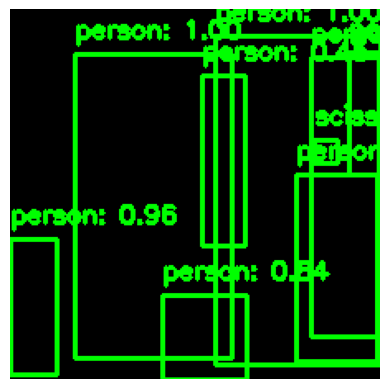

Frame 439, Label: 1, Score: 0.9983404874801636
Frame 439, Label: 1, Score: 0.9976463913917542
Frame 439, Label: 1, Score: 0.9572162628173828
Frame 439, Label: 1, Score: 0.8431605696678162
Frame 439, Label: 77, Score: 0.7432624101638794
Frame 439, Label: 1, Score: 0.6231553554534912
Frame 439, Label: 1, Score: 0.5475431680679321
Frame 439, Label: 1, Score: 0.4679480791091919
Frame 439, Label: 1, Score: 0.45338696241378784


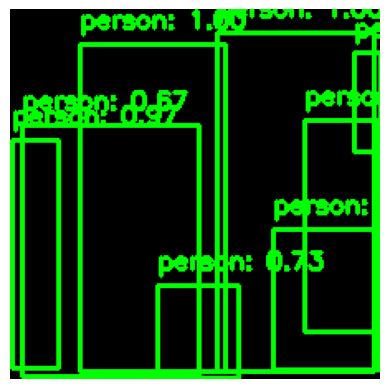

Frame 440, Label: 1, Score: 0.9960071444511414
Frame 440, Label: 1, Score: 0.9954444169998169
Frame 440, Label: 1, Score: 0.9694737195968628
Frame 440, Label: 1, Score: 0.8993030190467834
Frame 440, Label: 1, Score: 0.7347853779792786
Frame 440, Label: 1, Score: 0.6663200259208679
Frame 440, Label: 1, Score: 0.5888568758964539
Frame 440, Label: 1, Score: 0.3961825668811798


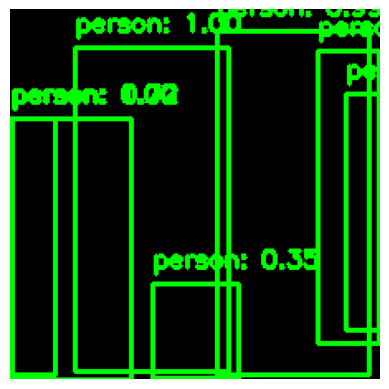

Frame 441, Label: 1, Score: 0.996442973613739
Frame 441, Label: 1, Score: 0.9961269497871399
Frame 441, Label: 1, Score: 0.9928790926933289
Frame 441, Label: 1, Score: 0.9568580389022827
Frame 441, Label: 1, Score: 0.7157970070838928
Frame 441, Label: 1, Score: 0.42056208848953247
Frame 441, Label: 1, Score: 0.3515336215496063


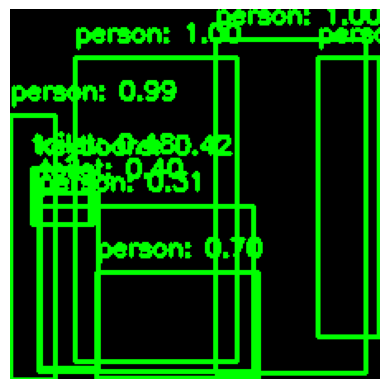

Frame 442, Label: 1, Score: 0.9977748990058899
Frame 442, Label: 1, Score: 0.9956685304641724
Frame 442, Label: 1, Score: 0.9850403070449829
Frame 442, Label: 1, Score: 0.9671247601509094
Frame 442, Label: 1, Score: 0.704807698726654
Frame 442, Label: 62, Score: 0.48453858494758606
Frame 442, Label: 67, Score: 0.4213689863681793
Frame 442, Label: 62, Score: 0.39805471897125244
Frame 442, Label: 1, Score: 0.3103227913379669


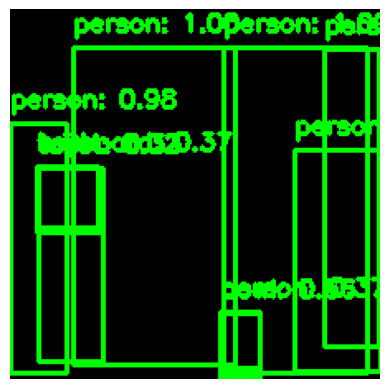

Frame 443, Label: 1, Score: 0.9973719120025635
Frame 443, Label: 1, Score: 0.9965651631355286
Frame 443, Label: 1, Score: 0.979772686958313
Frame 443, Label: 1, Score: 0.8990835547447205
Frame 443, Label: 46, Score: 0.6590995192527771
Frame 443, Label: 1, Score: 0.46551960706710815
Frame 443, Label: 1, Score: 0.37401020526885986
Frame 443, Label: 67, Score: 0.36721664667129517
Frame 443, Label: 62, Score: 0.33328965306282043
Frame 443, Label: 62, Score: 0.3234335780143738


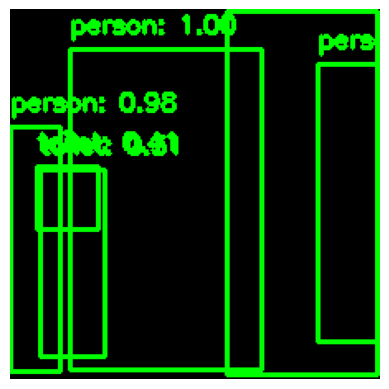

Frame 444, Label: 1, Score: 0.9970977306365967
Frame 444, Label: 1, Score: 0.9960423707962036
Frame 444, Label: 1, Score: 0.9799509048461914
Frame 444, Label: 1, Score: 0.8447016477584839
Frame 444, Label: 62, Score: 0.41072243452072144
Frame 444, Label: 62, Score: 0.30703139305114746


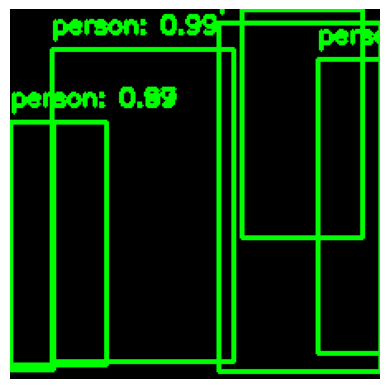

Frame 445, Label: 1, Score: 0.9963498115539551
Frame 445, Label: 1, Score: 0.9943956136703491
Frame 445, Label: 1, Score: 0.9744952321052551
Frame 445, Label: 1, Score: 0.9337574243545532
Frame 445, Label: 1, Score: 0.6874844431877136
Frame 445, Label: 1, Score: 0.5145612359046936


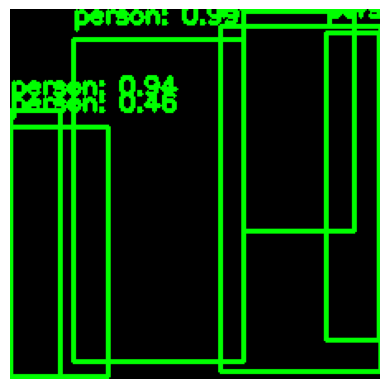

Frame 446, Label: 1, Score: 0.9936133027076721
Frame 446, Label: 1, Score: 0.9901615381240845
Frame 446, Label: 1, Score: 0.9454249143600464
Frame 446, Label: 1, Score: 0.9393945336341858
Frame 446, Label: 1, Score: 0.4566526710987091
Frame 446, Label: 1, Score: 0.37410175800323486


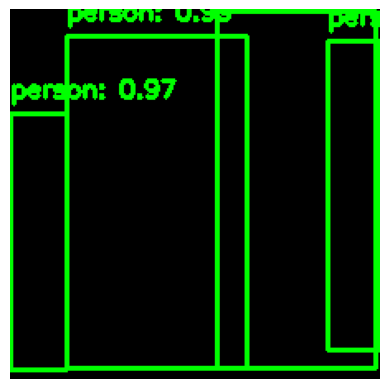

Frame 447, Label: 1, Score: 0.9941496849060059
Frame 447, Label: 1, Score: 0.9921205043792725
Frame 447, Label: 1, Score: 0.9742200970649719
Frame 447, Label: 1, Score: 0.967903196811676


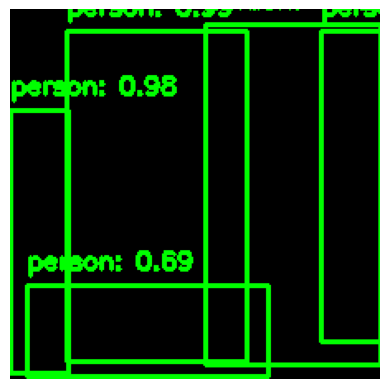

Frame 448, Label: 1, Score: 0.9968575239181519
Frame 448, Label: 1, Score: 0.9941651225090027
Frame 448, Label: 1, Score: 0.9855518341064453
Frame 448, Label: 1, Score: 0.9798420667648315
Frame 448, Label: 1, Score: 0.6905707716941833


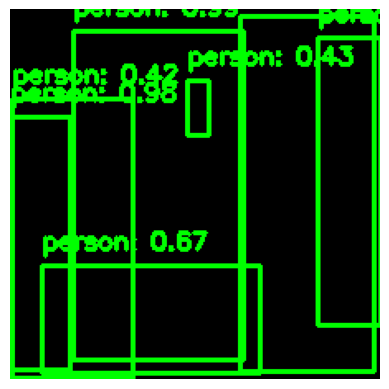

Frame 449, Label: 1, Score: 0.9979524612426758
Frame 449, Label: 1, Score: 0.9939042925834656
Frame 449, Label: 1, Score: 0.9819818139076233
Frame 449, Label: 1, Score: 0.9720598459243774
Frame 449, Label: 1, Score: 0.6721265912055969
Frame 449, Label: 1, Score: 0.4290326237678528
Frame 449, Label: 1, Score: 0.41802629828453064


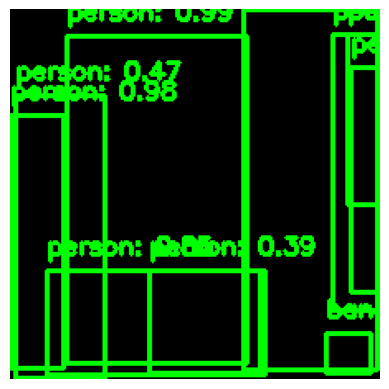

Frame 450, Label: 1, Score: 0.9942465424537659
Frame 450, Label: 1, Score: 0.99310302734375
Frame 450, Label: 1, Score: 0.98212069272995
Frame 450, Label: 1, Score: 0.8916827440261841
Frame 450, Label: 1, Score: 0.8452515006065369
Frame 450, Label: 1, Score: 0.6866147518157959
Frame 450, Label: 47, Score: 0.581855297088623
Frame 450, Label: 1, Score: 0.5182433128356934
Frame 450, Label: 1, Score: 0.46905070543289185
Frame 450, Label: 1, Score: 0.3896479606628418


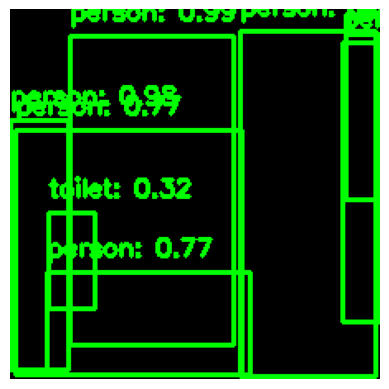

Frame 451, Label: 1, Score: 0.9946969747543335
Frame 451, Label: 1, Score: 0.9945957064628601
Frame 451, Label: 1, Score: 0.978344202041626
Frame 451, Label: 1, Score: 0.8595494031906128
Frame 451, Label: 1, Score: 0.7728610634803772
Frame 451, Label: 1, Score: 0.7672943472862244
Frame 451, Label: 1, Score: 0.7478192448616028
Frame 451, Label: 62, Score: 0.32382407784461975


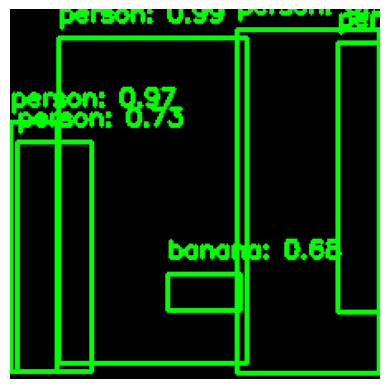

Frame 452, Label: 1, Score: 0.9923755526542664
Frame 452, Label: 1, Score: 0.9911393523216248
Frame 452, Label: 1, Score: 0.9733206629753113
Frame 452, Label: 1, Score: 0.9424152970314026
Frame 452, Label: 1, Score: 0.7255411744117737
Frame 452, Label: 47, Score: 0.6842897534370422


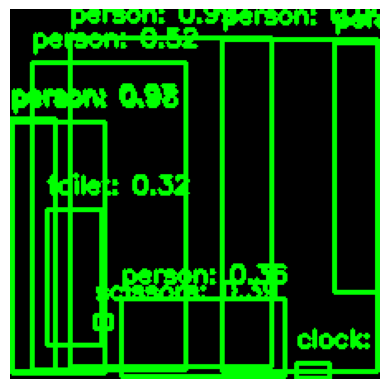

Frame 453, Label: 1, Score: 0.9935232400894165
Frame 453, Label: 1, Score: 0.9914408922195435
Frame 453, Label: 1, Score: 0.9794718027114868
Frame 453, Label: 1, Score: 0.9681108593940735
Frame 453, Label: 1, Score: 0.9305230975151062
Frame 453, Label: 1, Score: 0.5153083801269531
Frame 453, Label: 75, Score: 0.4142608046531677
Frame 453, Label: 77, Score: 0.3903147876262665
Frame 453, Label: 1, Score: 0.35827237367630005
Frame 453, Label: 62, Score: 0.3206545412540436


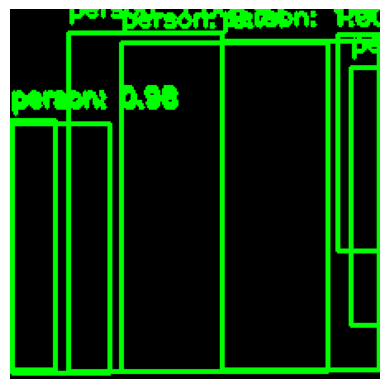

Frame 454, Label: 1, Score: 0.9955102205276489
Frame 454, Label: 1, Score: 0.9953992962837219
Frame 454, Label: 1, Score: 0.9825459718704224
Frame 454, Label: 1, Score: 0.9644892811775208
Frame 454, Label: 1, Score: 0.9225125908851624
Frame 454, Label: 1, Score: 0.7368564009666443
Frame 454, Label: 1, Score: 0.384958416223526


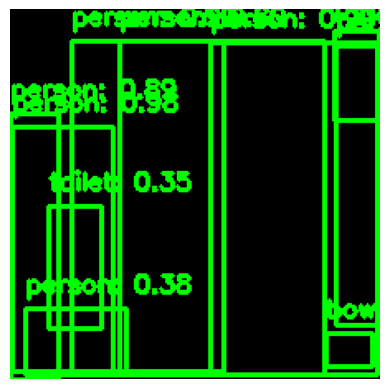

Frame 455, Label: 1, Score: 0.9941148161888123
Frame 455, Label: 1, Score: 0.9939495325088501
Frame 455, Label: 1, Score: 0.9818626046180725
Frame 455, Label: 1, Score: 0.9467484951019287
Frame 455, Label: 1, Score: 0.887245237827301
Frame 455, Label: 1, Score: 0.7985528707504272
Frame 455, Label: 46, Score: 0.5199693441390991
Frame 455, Label: 1, Score: 0.5114684700965881
Frame 455, Label: 1, Score: 0.37543824315071106
Frame 455, Label: 62, Score: 0.3455637991428375


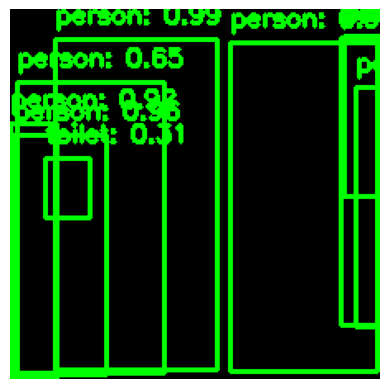

Frame 456, Label: 1, Score: 0.9947628378868103
Frame 456, Label: 1, Score: 0.9944379329681396
Frame 456, Label: 1, Score: 0.9602128863334656
Frame 456, Label: 1, Score: 0.9246776103973389
Frame 456, Label: 1, Score: 0.9044076800346375
Frame 456, Label: 1, Score: 0.8369529843330383
Frame 456, Label: 1, Score: 0.6528382897377014
Frame 456, Label: 1, Score: 0.5293228626251221
Frame 456, Label: 62, Score: 0.30512046813964844


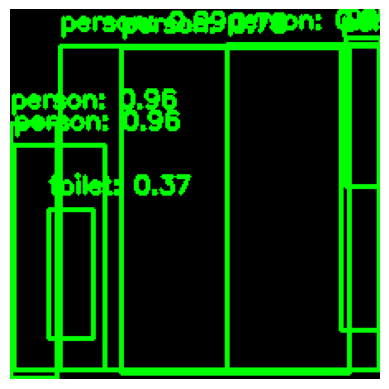

Frame 457, Label: 1, Score: 0.9936728477478027
Frame 457, Label: 1, Score: 0.9935510158538818
Frame 457, Label: 1, Score: 0.9625565409660339
Frame 457, Label: 1, Score: 0.9563103318214417
Frame 457, Label: 1, Score: 0.9248239398002625
Frame 457, Label: 1, Score: 0.8429995179176331
Frame 457, Label: 1, Score: 0.7783676981925964
Frame 457, Label: 62, Score: 0.37050729990005493


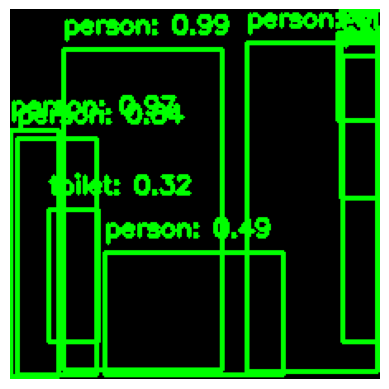

Frame 458, Label: 1, Score: 0.994657039642334
Frame 458, Label: 1, Score: 0.9908478260040283
Frame 458, Label: 1, Score: 0.9680384397506714
Frame 458, Label: 1, Score: 0.8891150951385498
Frame 458, Label: 1, Score: 0.8868597745895386
Frame 458, Label: 1, Score: 0.843325138092041
Frame 458, Label: 1, Score: 0.5063856244087219
Frame 458, Label: 1, Score: 0.48659220337867737
Frame 458, Label: 62, Score: 0.31600645184516907


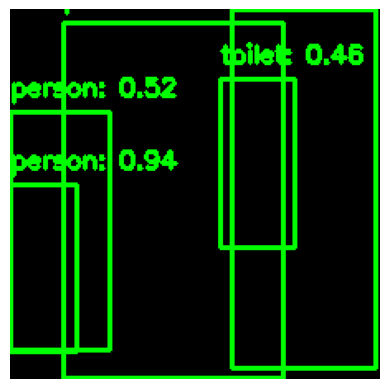

Frame 459, Label: 1, Score: 0.9978358149528503
Frame 459, Label: 1, Score: 0.994539201259613
Frame 459, Label: 1, Score: 0.9426500797271729
Frame 459, Label: 1, Score: 0.5208745002746582
Frame 459, Label: 62, Score: 0.4642942249774933


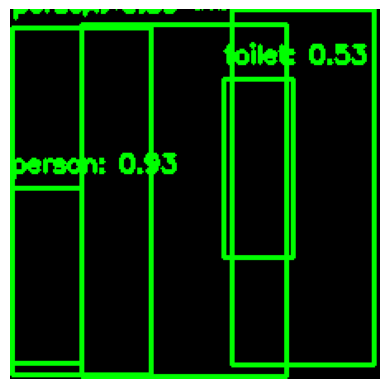

Frame 460, Label: 1, Score: 0.998141884803772
Frame 460, Label: 1, Score: 0.9929364323616028
Frame 460, Label: 1, Score: 0.933312177658081
Frame 460, Label: 62, Score: 0.5296845436096191
Frame 460, Label: 1, Score: 0.3889889419078827


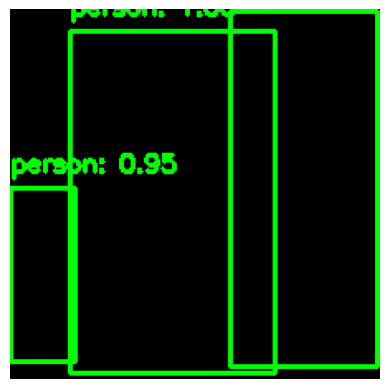

Frame 461, Label: 1, Score: 0.9972123503684998
Frame 461, Label: 1, Score: 0.9967844486236572
Frame 461, Label: 1, Score: 0.9470954537391663


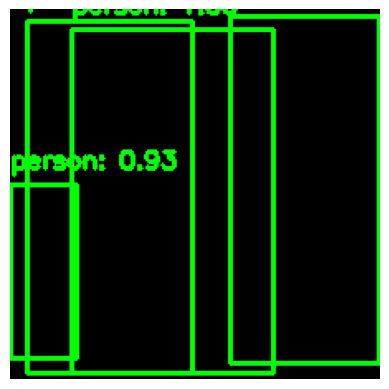

Frame 462, Label: 1, Score: 0.997811496257782
Frame 462, Label: 1, Score: 0.99748694896698
Frame 462, Label: 1, Score: 0.9296835660934448
Frame 462, Label: 1, Score: 0.616539716720581


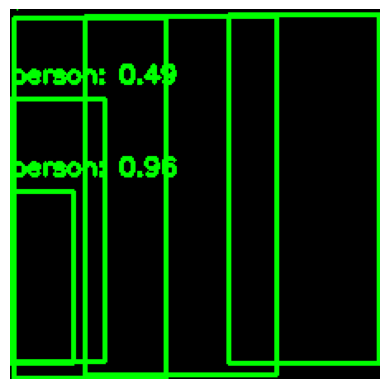

Frame 463, Label: 1, Score: 0.997255265712738
Frame 463, Label: 1, Score: 0.9965546131134033
Frame 463, Label: 1, Score: 0.9574018716812134
Frame 463, Label: 1, Score: 0.4861885607242584
Frame 463, Label: 1, Score: 0.48271337151527405


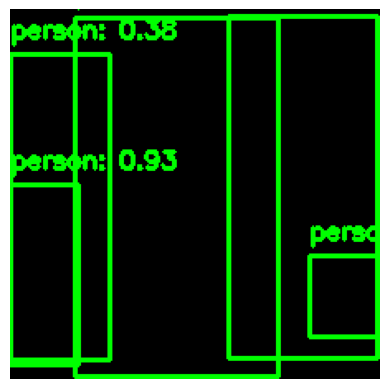

Frame 464, Label: 1, Score: 0.9970347881317139
Frame 464, Label: 1, Score: 0.993884265422821
Frame 464, Label: 1, Score: 0.9265719652175903
Frame 464, Label: 1, Score: 0.38445669412612915
Frame 464, Label: 1, Score: 0.3174249529838562


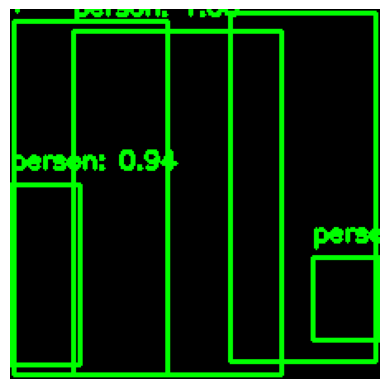

Frame 465, Label: 1, Score: 0.9963926672935486
Frame 465, Label: 1, Score: 0.9959463477134705
Frame 465, Label: 1, Score: 0.9360256195068359
Frame 465, Label: 1, Score: 0.44097742438316345
Frame 465, Label: 1, Score: 0.41937753558158875


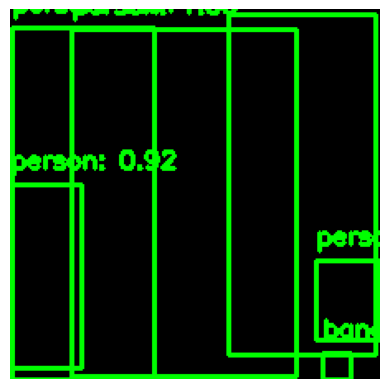

Frame 466, Label: 1, Score: 0.9967138767242432
Frame 466, Label: 1, Score: 0.9963181018829346
Frame 466, Label: 1, Score: 0.9244114756584167
Frame 466, Label: 1, Score: 0.6115087270736694
Frame 466, Label: 47, Score: 0.602095901966095
Frame 466, Label: 1, Score: 0.4838925004005432


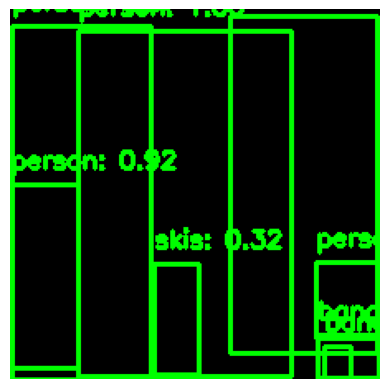

Frame 467, Label: 1, Score: 0.9960875511169434
Frame 467, Label: 1, Score: 0.9960219264030457
Frame 467, Label: 1, Score: 0.9241645932197571
Frame 467, Label: 1, Score: 0.5747604966163635
Frame 467, Label: 47, Score: 0.5454645156860352
Frame 467, Label: 1, Score: 0.4782606363296509
Frame 467, Label: 31, Score: 0.3228030800819397
Frame 467, Label: 47, Score: 0.30721428990364075


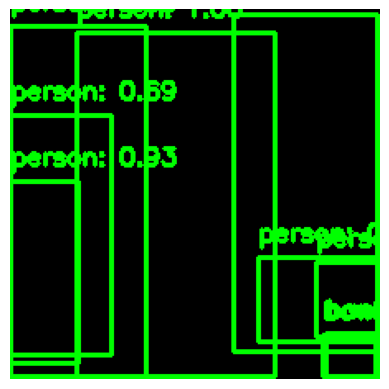

Frame 468, Label: 1, Score: 0.996248185634613
Frame 468, Label: 1, Score: 0.9951661825180054
Frame 468, Label: 1, Score: 0.927547812461853
Frame 468, Label: 1, Score: 0.6944675445556641
Frame 468, Label: 1, Score: 0.5504848957061768
Frame 468, Label: 1, Score: 0.5102764964103699
Frame 468, Label: 1, Score: 0.37316063046455383
Frame 468, Label: 46, Score: 0.35333573818206787
Frame 468, Label: 47, Score: 0.3017887771129608


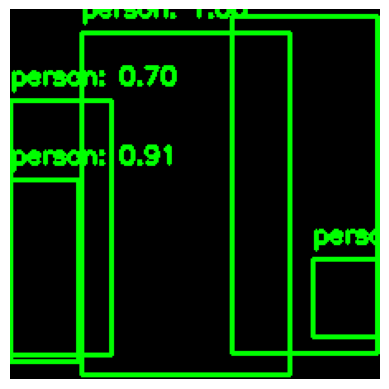

Frame 469, Label: 1, Score: 0.9961438179016113
Frame 469, Label: 1, Score: 0.9961317777633667
Frame 469, Label: 1, Score: 0.9055513739585876
Frame 469, Label: 1, Score: 0.70098477602005
Frame 469, Label: 1, Score: 0.39602768421173096


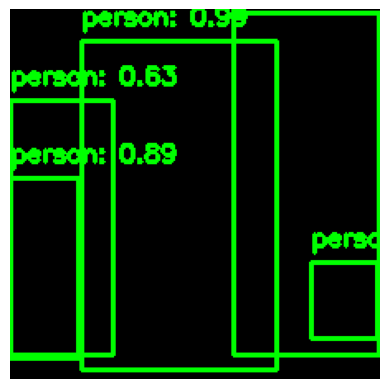

Frame 470, Label: 1, Score: 0.9958874583244324
Frame 470, Label: 1, Score: 0.9916468262672424
Frame 470, Label: 1, Score: 0.890038251876831
Frame 470, Label: 1, Score: 0.6250132322311401
Frame 470, Label: 1, Score: 0.4266926348209381


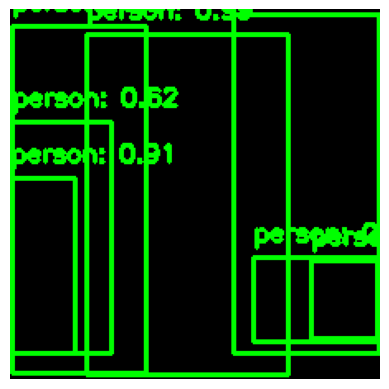

Frame 471, Label: 1, Score: 0.9963281750679016
Frame 471, Label: 1, Score: 0.9938980937004089
Frame 471, Label: 1, Score: 0.91294264793396
Frame 471, Label: 1, Score: 0.6199129819869995
Frame 471, Label: 1, Score: 0.5355456471443176
Frame 471, Label: 1, Score: 0.36760005354881287
Frame 471, Label: 1, Score: 0.3409939110279083


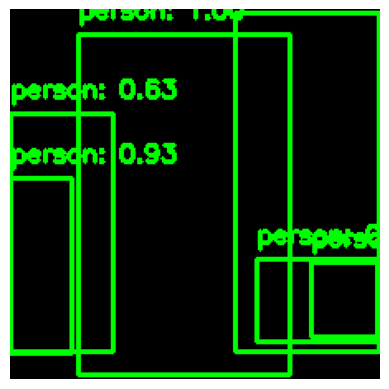

Frame 472, Label: 1, Score: 0.9961559176445007
Frame 472, Label: 1, Score: 0.9951764345169067
Frame 472, Label: 1, Score: 0.933184802532196
Frame 472, Label: 1, Score: 0.6297835111618042
Frame 472, Label: 1, Score: 0.4720468521118164
Frame 472, Label: 1, Score: 0.3720557391643524


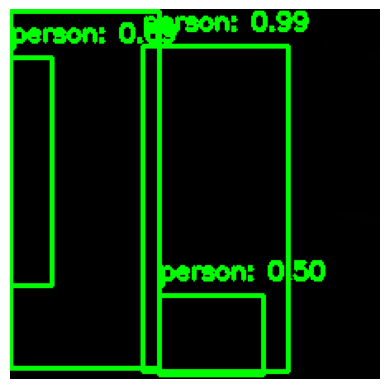

Frame 473, Label: 1, Score: 0.9988952279090881
Frame 473, Label: 1, Score: 0.9889834523200989
Frame 473, Label: 1, Score: 0.6925358772277832
Frame 473, Label: 1, Score: 0.4966699779033661


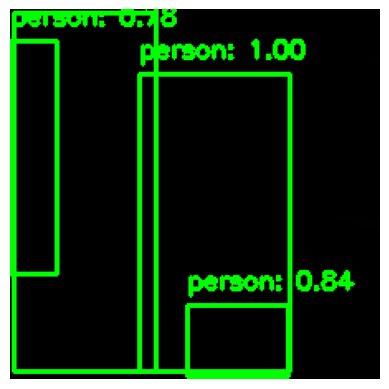

Frame 474, Label: 1, Score: 0.9983761310577393
Frame 474, Label: 1, Score: 0.9950398802757263
Frame 474, Label: 1, Score: 0.8372458219528198
Frame 474, Label: 1, Score: 0.7836822867393494


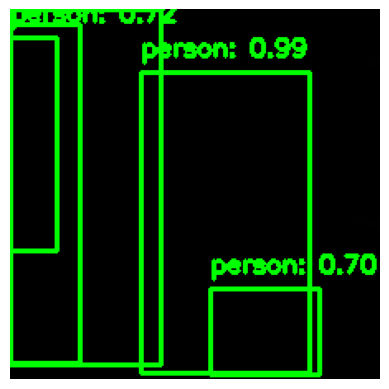

Frame 475, Label: 1, Score: 0.9991280436515808
Frame 475, Label: 1, Score: 0.9929654598236084
Frame 475, Label: 1, Score: 0.7159824967384338
Frame 475, Label: 1, Score: 0.6958959698677063
Frame 475, Label: 1, Score: 0.33595195412635803


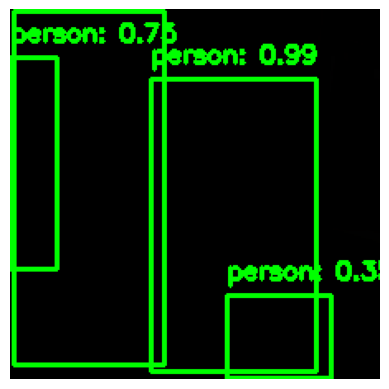

Frame 476, Label: 1, Score: 0.9986131191253662
Frame 476, Label: 1, Score: 0.993371844291687
Frame 476, Label: 1, Score: 0.7524750828742981
Frame 476, Label: 1, Score: 0.3491831123828888


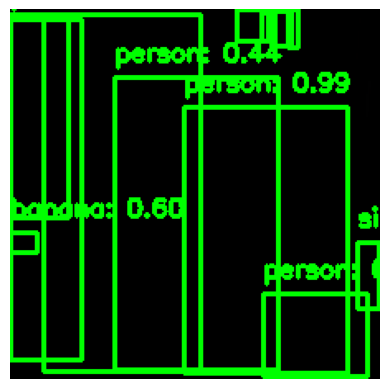

Frame 477, Label: 1, Score: 0.9967799782752991
Frame 477, Label: 1, Score: 0.9894443154335022
Frame 477, Label: 1, Score: 0.9556795358657837
Frame 477, Label: 1, Score: 0.9324460029602051
Frame 477, Label: 1, Score: 0.8343451023101807
Frame 477, Label: 47, Score: 0.6039512753486633
Frame 477, Label: 50, Score: 0.5497071743011475
Frame 477, Label: 49, Score: 0.4558011293411255
Frame 477, Label: 1, Score: 0.43514761328697205
Frame 477, Label: 72, Score: 0.34458765387535095
Frame 477, Label: 49, Score: 0.32175642251968384
Frame 477, Label: 49, Score: 0.3181532323360443
Frame 477, Label: 49, Score: 0.313284695148468


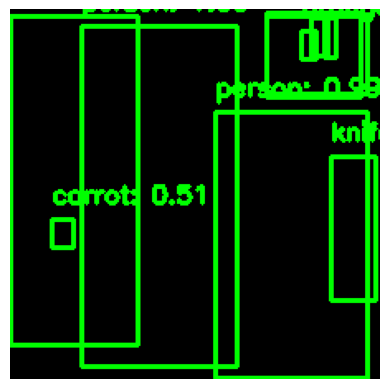

Frame 478, Label: 1, Score: 0.9952084422111511
Frame 478, Label: 1, Score: 0.9850279092788696
Frame 478, Label: 1, Score: 0.9659672379493713
Frame 478, Label: 50, Score: 0.6465628147125244
Frame 478, Label: 52, Score: 0.5100429654121399
Frame 478, Label: 50, Score: 0.37889549136161804
Frame 478, Label: 51, Score: 0.36461710929870605
Frame 478, Label: 44, Score: 0.3597196936607361
Frame 478, Label: 61, Score: 0.3452213704586029
Frame 478, Label: 50, Score: 0.33947035670280457


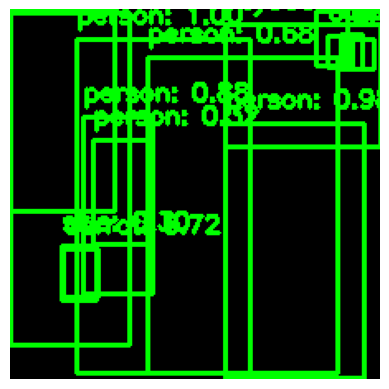

Frame 479, Label: 1, Score: 0.9975706934928894
Frame 479, Label: 1, Score: 0.9837125539779663
Frame 479, Label: 1, Score: 0.9757855534553528
Frame 479, Label: 1, Score: 0.8822318315505981
Frame 479, Label: 50, Score: 0.7711171507835388
Frame 479, Label: 52, Score: 0.7223009467124939
Frame 479, Label: 1, Score: 0.6818530559539795
Frame 479, Label: 50, Score: 0.4192160665988922
Frame 479, Label: 50, Score: 0.3813681900501251
Frame 479, Label: 67, Score: 0.3358699679374695
Frame 479, Label: 1, Score: 0.32430681586265564
Frame 479, Label: 50, Score: 0.3176063597202301
Frame 479, Label: 19, Score: 0.31112730503082275
Frame 479, Label: 31, Score: 0.3041394352912903
Frame 479, Label: 50, Score: 0.3036179542541504


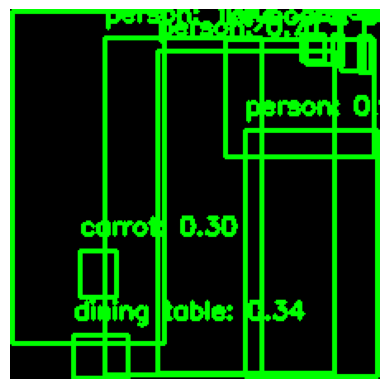

Frame 480, Label: 1, Score: 0.9970833659172058
Frame 480, Label: 1, Score: 0.9821282625198364
Frame 480, Label: 1, Score: 0.9785350561141968
Frame 480, Label: 1, Score: 0.7109156847000122
Frame 480, Label: 49, Score: 0.4785463809967041
Frame 480, Label: 49, Score: 0.3821457624435425
Frame 480, Label: 49, Score: 0.37230342626571655
Frame 480, Label: 67, Score: 0.34608447551727295
Frame 480, Label: 61, Score: 0.34464797377586365
Frame 480, Label: 49, Score: 0.32206544280052185
Frame 480, Label: 49, Score: 0.30907899141311646
Frame 480, Label: 52, Score: 0.3033123016357422


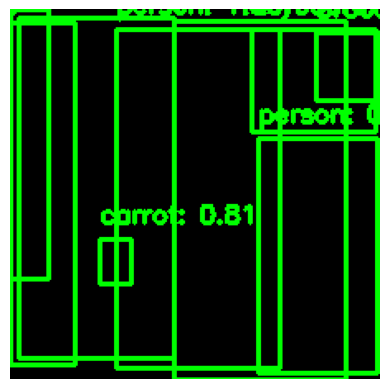

Frame 481, Label: 1, Score: 0.9961339235305786
Frame 481, Label: 1, Score: 0.9902980923652649
Frame 481, Label: 1, Score: 0.9863898158073425
Frame 481, Label: 1, Score: 0.9291769862174988
Frame 481, Label: 1, Score: 0.8899832963943481
Frame 481, Label: 52, Score: 0.8128311038017273
Frame 481, Label: 67, Score: 0.7235203385353088
Frame 481, Label: 51, Score: 0.601279616355896
Frame 481, Label: 1, Score: 0.32019221782684326


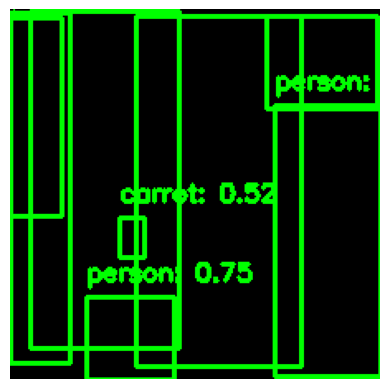

Frame 482, Label: 1, Score: 0.9955110549926758
Frame 482, Label: 1, Score: 0.9927582740783691
Frame 482, Label: 1, Score: 0.9809354543685913
Frame 482, Label: 1, Score: 0.9761238098144531
Frame 482, Label: 1, Score: 0.7508697509765625
Frame 482, Label: 67, Score: 0.6675133109092712
Frame 482, Label: 52, Score: 0.5234819054603577
Frame 482, Label: 1, Score: 0.45130282640457153


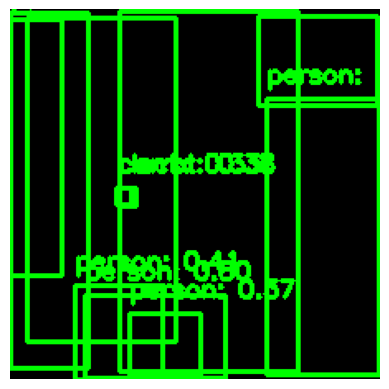

Frame 483, Label: 1, Score: 0.9935609102249146
Frame 483, Label: 1, Score: 0.9814822673797607
Frame 483, Label: 1, Score: 0.9676960706710815
Frame 483, Label: 1, Score: 0.9674568176269531
Frame 483, Label: 1, Score: 0.800133228302002
Frame 483, Label: 67, Score: 0.49407827854156494
Frame 483, Label: 1, Score: 0.41204699873924255
Frame 483, Label: 1, Score: 0.37707969546318054
Frame 483, Label: 52, Score: 0.37536317110061646
Frame 483, Label: 1, Score: 0.36933985352516174
Frame 483, Label: 75, Score: 0.32939741015434265


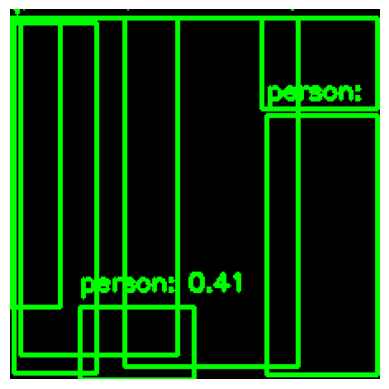

Frame 484, Label: 1, Score: 0.995772659778595
Frame 484, Label: 1, Score: 0.9820021390914917
Frame 484, Label: 1, Score: 0.9806479811668396
Frame 484, Label: 1, Score: 0.9571598172187805
Frame 484, Label: 1, Score: 0.8084297180175781
Frame 484, Label: 67, Score: 0.6716842651367188
Frame 484, Label: 1, Score: 0.4058517813682556


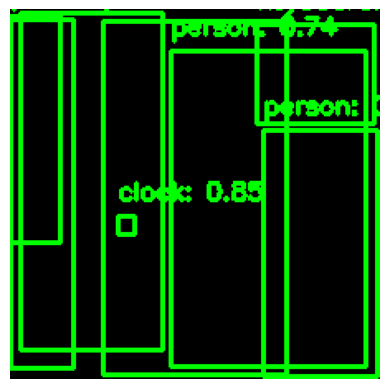

Frame 485, Label: 1, Score: 0.9974715709686279
Frame 485, Label: 1, Score: 0.987026035785675
Frame 485, Label: 1, Score: 0.9837972521781921
Frame 485, Label: 1, Score: 0.9786431193351746
Frame 485, Label: 1, Score: 0.8749100565910339
Frame 485, Label: 75, Score: 0.8537361025810242
Frame 485, Label: 1, Score: 0.7446169257164001
Frame 485, Label: 67, Score: 0.48154348134994507


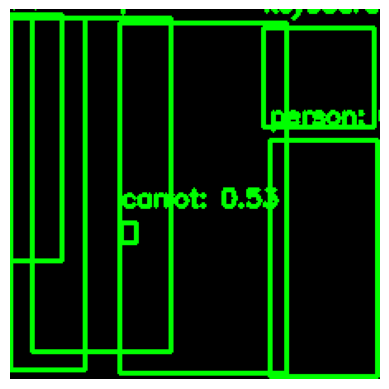

Frame 486, Label: 1, Score: 0.997275173664093
Frame 486, Label: 1, Score: 0.9832333922386169
Frame 486, Label: 1, Score: 0.9825032949447632
Frame 486, Label: 1, Score: 0.9602518081665039
Frame 486, Label: 1, Score: 0.7450460195541382
Frame 486, Label: 67, Score: 0.6050938367843628
Frame 486, Label: 52, Score: 0.529897928237915


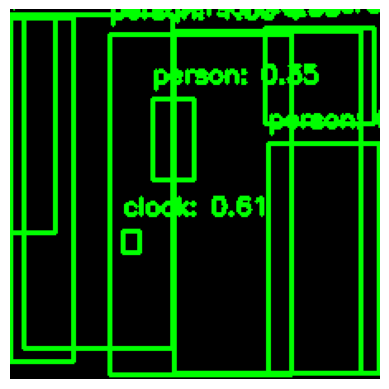

Frame 487, Label: 1, Score: 0.9977203011512756
Frame 487, Label: 1, Score: 0.99003005027771
Frame 487, Label: 1, Score: 0.98625248670578
Frame 487, Label: 1, Score: 0.9518835544586182
Frame 487, Label: 1, Score: 0.8142055869102478
Frame 487, Label: 67, Score: 0.6865408420562744
Frame 487, Label: 75, Score: 0.6076604127883911
Frame 487, Label: 1, Score: 0.5822203159332275
Frame 487, Label: 1, Score: 0.34523090720176697


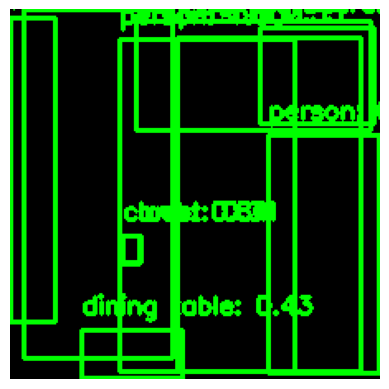

Frame 488, Label: 1, Score: 0.9984720349311829
Frame 488, Label: 1, Score: 0.9878987669944763
Frame 488, Label: 1, Score: 0.9730306267738342
Frame 488, Label: 1, Score: 0.9582165479660034
Frame 488, Label: 75, Score: 0.84158855676651
Frame 488, Label: 67, Score: 0.7697589993476868
Frame 488, Label: 1, Score: 0.5498944520950317
Frame 488, Label: 61, Score: 0.4275054335594177
Frame 488, Label: 52, Score: 0.30635449290275574
Frame 488, Label: 67, Score: 0.3020312786102295


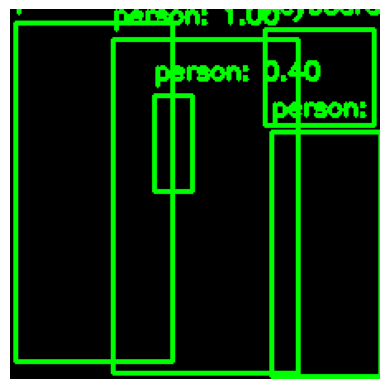

Frame 489, Label: 1, Score: 0.9970822930335999
Frame 489, Label: 1, Score: 0.9875695109367371
Frame 489, Label: 1, Score: 0.9817985892295837
Frame 489, Label: 67, Score: 0.6966063976287842
Frame 489, Label: 1, Score: 0.39767345786094666


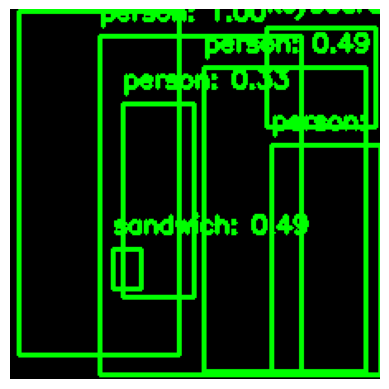

Frame 490, Label: 1, Score: 0.9969757795333862
Frame 490, Label: 1, Score: 0.9886456727981567
Frame 490, Label: 1, Score: 0.9852713346481323
Frame 490, Label: 67, Score: 0.6095686554908752
Frame 490, Label: 49, Score: 0.48824211955070496
Frame 490, Label: 1, Score: 0.4873034358024597
Frame 490, Label: 1, Score: 0.3251248300075531


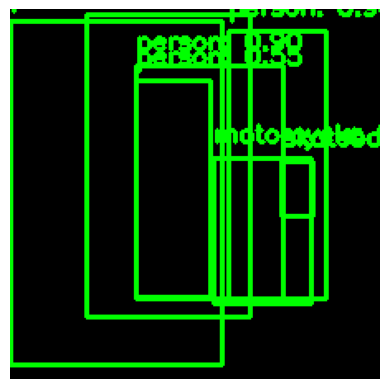

Frame 491, Label: 1, Score: 0.9778568744659424
Frame 491, Label: 1, Score: 0.9050495028495789
Frame 491, Label: 1, Score: 0.9045935273170471
Frame 491, Label: 1, Score: 0.5521169304847717
Frame 491, Label: 4, Score: 0.4188423454761505
Frame 491, Label: 1, Score: 0.38772517442703247
Frame 491, Label: 37, Score: 0.3002125918865204


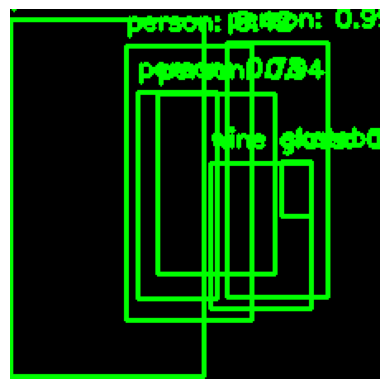

Frame 492, Label: 1, Score: 0.987320065498352
Frame 492, Label: 1, Score: 0.9448332190513611
Frame 492, Label: 1, Score: 0.8908267617225647
Frame 492, Label: 1, Score: 0.7812393307685852
Frame 492, Label: 1, Score: 0.41634654998779297
Frame 492, Label: 37, Score: 0.4078788459300995
Frame 492, Label: 41, Score: 0.3140130043029785


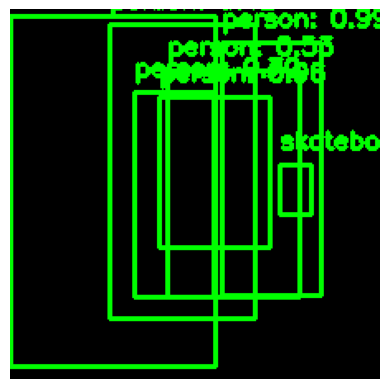

Frame 493, Label: 1, Score: 0.9865905046463013
Frame 493, Label: 1, Score: 0.9629886746406555
Frame 493, Label: 37, Score: 0.9603795409202576
Frame 493, Label: 1, Score: 0.9107456803321838
Frame 493, Label: 1, Score: 0.6966243386268616
Frame 493, Label: 1, Score: 0.529644250869751
Frame 493, Label: 1, Score: 0.416387140750885


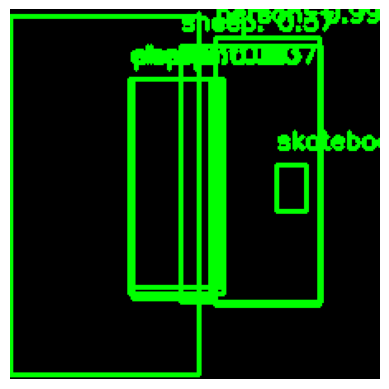

Frame 494, Label: 1, Score: 0.9853853583335876
Frame 494, Label: 37, Score: 0.873796284198761
Frame 494, Label: 1, Score: 0.8430686593055725
Frame 494, Label: 1, Score: 0.804844081401825
Frame 494, Label: 21, Score: 0.37049075961112976
Frame 494, Label: 19, Score: 0.366206556558609
Frame 494, Label: 19, Score: 0.35651716589927673


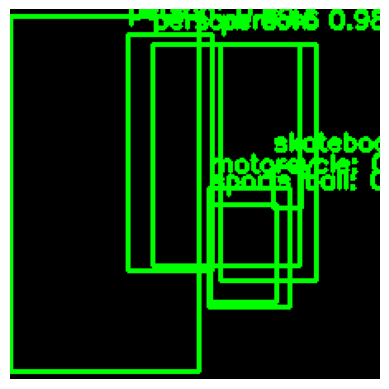

Frame 495, Label: 1, Score: 0.982725203037262
Frame 495, Label: 1, Score: 0.9757462739944458
Frame 495, Label: 1, Score: 0.9023423194885254
Frame 495, Label: 37, Score: 0.7716288566589355
Frame 495, Label: 33, Score: 0.5748278498649597
Frame 495, Label: 1, Score: 0.46493613719940186
Frame 495, Label: 4, Score: 0.399314284324646


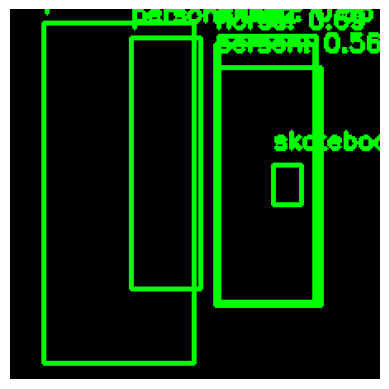

Frame 496, Label: 1, Score: 0.9326197504997253
Frame 496, Label: 1, Score: 0.919223427772522
Frame 496, Label: 18, Score: 0.6917824745178223
Frame 496, Label: 1, Score: 0.5591144561767578
Frame 496, Label: 37, Score: 0.4841199815273285
Frame 496, Label: 19, Score: 0.3501739501953125


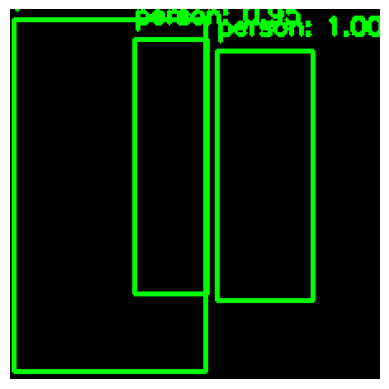

Frame 497, Label: 1, Score: 0.995685338973999
Frame 497, Label: 1, Score: 0.9525401592254639
Frame 497, Label: 1, Score: 0.9446656107902527


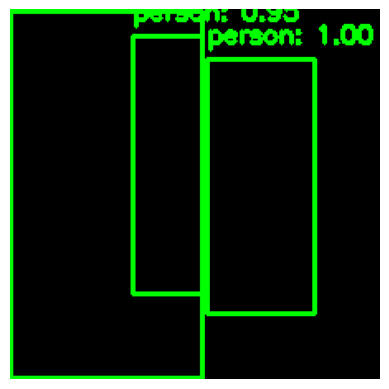

Frame 498, Label: 1, Score: 0.9981397390365601
Frame 498, Label: 1, Score: 0.9521830677986145
Frame 498, Label: 1, Score: 0.9479854702949524


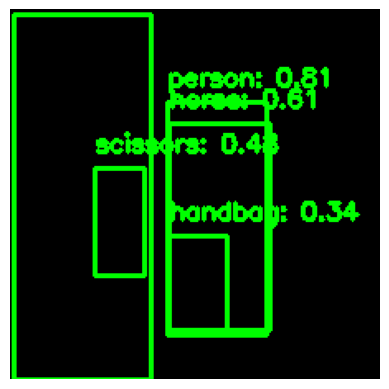

Frame 499, Label: 1, Score: 0.9453632235527039
Frame 499, Label: 1, Score: 0.805889368057251
Frame 499, Label: 18, Score: 0.6105107069015503
Frame 499, Label: 77, Score: 0.4802582263946533
Frame 499, Label: 27, Score: 0.3406292200088501


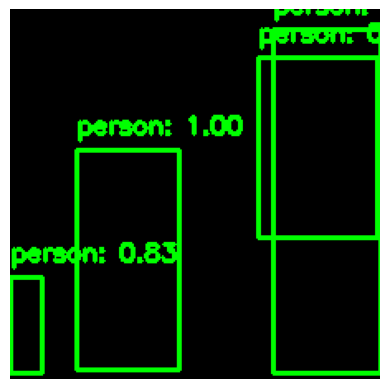

Frame 500, Label: 1, Score: 0.99664306640625
Frame 500, Label: 1, Score: 0.993502676486969
Frame 500, Label: 1, Score: 0.8263845443725586
Frame 500, Label: 1, Score: 0.37791940569877625


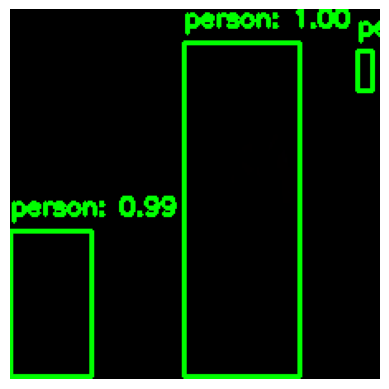

Frame 501, Label: 1, Score: 0.9995191097259521
Frame 501, Label: 1, Score: 0.9946402907371521
Frame 501, Label: 1, Score: 0.8489507436752319


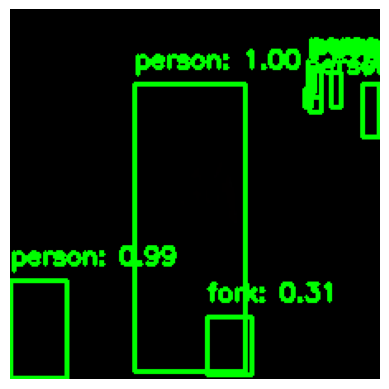

Frame 502, Label: 1, Score: 0.9994516968727112
Frame 502, Label: 1, Score: 0.9859581589698792
Frame 502, Label: 1, Score: 0.9741151332855225
Frame 502, Label: 1, Score: 0.954723596572876
Frame 502, Label: 1, Score: 0.8742793202400208
Frame 502, Label: 1, Score: 0.8531396389007568
Frame 502, Label: 1, Score: 0.7076176404953003
Frame 502, Label: 1, Score: 0.362883985042572
Frame 502, Label: 43, Score: 0.3056049346923828


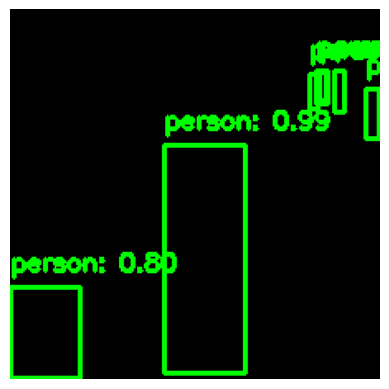

Frame 503, Label: 1, Score: 0.9904454946517944
Frame 503, Label: 1, Score: 0.9682970643043518
Frame 503, Label: 1, Score: 0.96686190366745
Frame 503, Label: 1, Score: 0.9607548117637634
Frame 503, Label: 1, Score: 0.7969554662704468
Frame 503, Label: 1, Score: 0.6824684143066406
Frame 503, Label: 1, Score: 0.3827700912952423


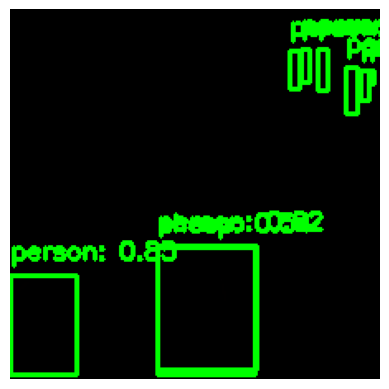

Frame 504, Label: 1, Score: 0.9846674799919128
Frame 504, Label: 1, Score: 0.9545961022377014
Frame 504, Label: 1, Score: 0.9377326965332031
Frame 504, Label: 1, Score: 0.8502245545387268
Frame 504, Label: 1, Score: 0.7761255502700806
Frame 504, Label: 1, Score: 0.6687952876091003
Frame 504, Label: 1, Score: 0.6209911108016968
Frame 504, Label: 19, Score: 0.5374400019645691
Frame 504, Label: 1, Score: 0.32357466220855713


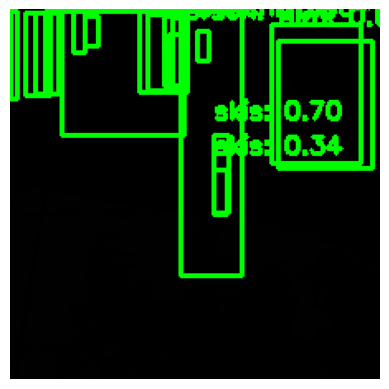

Frame 505, Label: 1, Score: 0.9760423898696899
Frame 505, Label: 1, Score: 0.9542313814163208
Frame 505, Label: 1, Score: 0.9301683306694031
Frame 505, Label: 1, Score: 0.9242835640907288
Frame 505, Label: 62, Score: 0.8909575939178467
Frame 505, Label: 1, Score: 0.8909100890159607
Frame 505, Label: 1, Score: 0.8771422505378723
Frame 505, Label: 62, Score: 0.8220466375350952
Frame 505, Label: 1, Score: 0.7811791300773621
Frame 505, Label: 31, Score: 0.6978284120559692
Frame 505, Label: 1, Score: 0.6604412794113159
Frame 505, Label: 15, Score: 0.6180866956710815
Frame 505, Label: 1, Score: 0.5192997455596924
Frame 505, Label: 1, Score: 0.4920263886451721
Frame 505, Label: 14, Score: 0.35505059361457825
Frame 505, Label: 31, Score: 0.3357827365398407
Frame 505, Label: 1, Score: 0.315560519695282


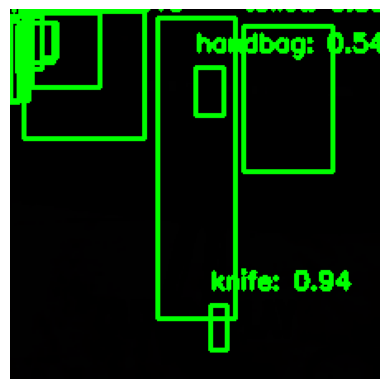

Frame 506, Label: 1, Score: 0.9979931116104126
Frame 506, Label: 44, Score: 0.9417375326156616
Frame 506, Label: 62, Score: 0.8884367942810059
Frame 506, Label: 62, Score: 0.8772810697555542
Frame 506, Label: 1, Score: 0.8392641544342041
Frame 506, Label: 1, Score: 0.7704551815986633
Frame 506, Label: 1, Score: 0.7293971180915833
Frame 506, Label: 42, Score: 0.6112626194953918
Frame 506, Label: 27, Score: 0.5366156101226807
Frame 506, Label: 1, Score: 0.4111894965171814
Frame 506, Label: 1, Score: 0.4032042622566223
Frame 506, Label: 1, Score: 0.37198615074157715


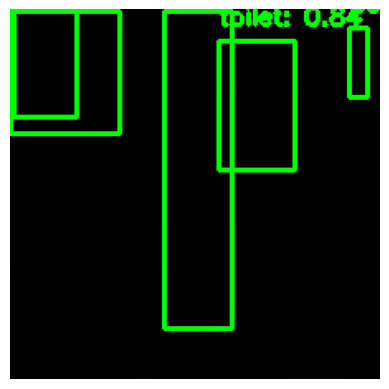

Frame 507, Label: 1, Score: 0.9939746260643005
Frame 507, Label: 1, Score: 0.975238561630249
Frame 507, Label: 62, Score: 0.9032738208770752
Frame 507, Label: 62, Score: 0.8355283737182617
Frame 507, Label: 62, Score: 0.5817145109176636


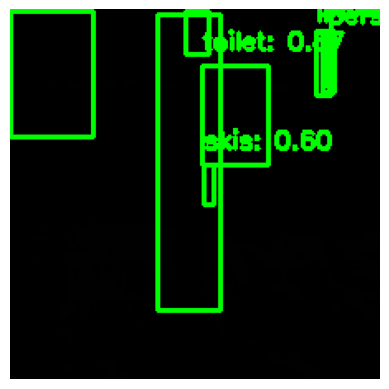

Frame 508, Label: 1, Score: 0.9922103881835938
Frame 508, Label: 1, Score: 0.9765189290046692
Frame 508, Label: 62, Score: 0.9407654404640198
Frame 508, Label: 62, Score: 0.86996990442276
Frame 508, Label: 1, Score: 0.7966686487197876
Frame 508, Label: 14, Score: 0.6079528331756592
Frame 508, Label: 31, Score: 0.6032319068908691
Frame 508, Label: 1, Score: 0.4804519712924957


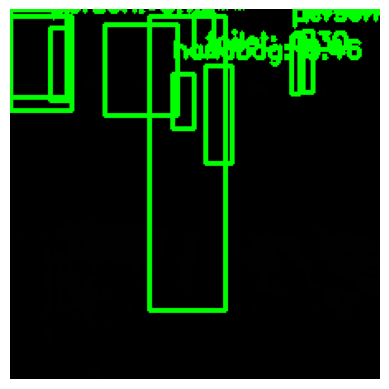

Frame 509, Label: 1, Score: 0.9866113662719727
Frame 509, Label: 1, Score: 0.7882004976272583
Frame 509, Label: 1, Score: 0.6988222002983093
Frame 509, Label: 62, Score: 0.5516282320022583
Frame 509, Label: 62, Score: 0.5089218616485596
Frame 509, Label: 1, Score: 0.49842575192451477
Frame 509, Label: 14, Score: 0.4710049629211426
Frame 509, Label: 27, Score: 0.45900657773017883
Frame 509, Label: 1, Score: 0.3149230480194092
Frame 509, Label: 62, Score: 0.30036184191703796


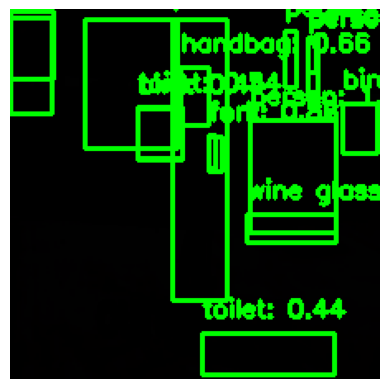

Frame 510, Label: 1, Score: 0.9990924596786499
Frame 510, Label: 1, Score: 0.9811906218528748
Frame 510, Label: 43, Score: 0.8565873503684998
Frame 510, Label: 15, Score: 0.6703464388847351
Frame 510, Label: 27, Score: 0.6615306735038757
Frame 510, Label: 62, Score: 0.6411438584327698
Frame 510, Label: 1, Score: 0.6175928711891174
Frame 510, Label: 41, Score: 0.5682100057601929
Frame 510, Label: 62, Score: 0.5441578030586243
Frame 510, Label: 67, Score: 0.5402337908744812
Frame 510, Label: 62, Score: 0.48342812061309814
Frame 510, Label: 15, Score: 0.4394189119338989
Frame 510, Label: 62, Score: 0.43759679794311523
Frame 510, Label: 1, Score: 0.35470613837242126
Frame 510, Label: 1, Score: 0.3471510112285614
Frame 510, Label: 43, Score: 0.3230249881744385


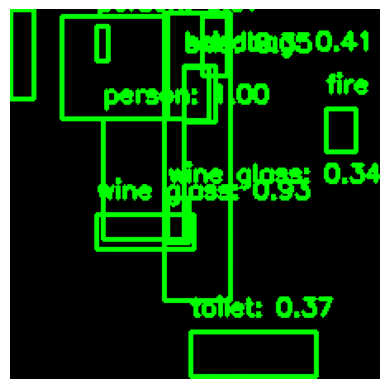

Frame 511, Label: 1, Score: 0.9961775541305542
Frame 511, Label: 1, Score: 0.9856762886047363
Frame 511, Label: 1, Score: 0.9670358896255493
Frame 511, Label: 41, Score: 0.9305797815322876
Frame 511, Label: 1, Score: 0.8581604957580566
Frame 511, Label: 11, Score: 0.6485196352005005
Frame 511, Label: 27, Score: 0.413128137588501
Frame 511, Label: 62, Score: 0.369439959526062
Frame 511, Label: 28, Score: 0.3622240722179413
Frame 511, Label: 31, Score: 0.3522106111049652
Frame 511, Label: 41, Score: 0.3371051251888275
Frame 511, Label: 1, Score: 0.3051152527332306


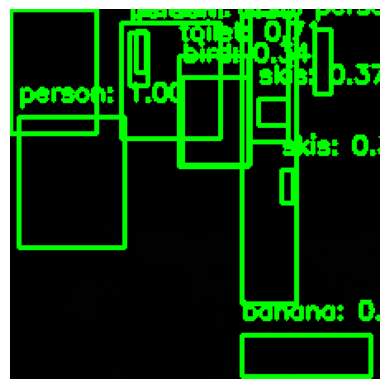

Frame 512, Label: 1, Score: 0.9986993074417114
Frame 512, Label: 1, Score: 0.990358293056488
Frame 512, Label: 1, Score: 0.9501935243606567
Frame 512, Label: 62, Score: 0.8796050548553467
Frame 512, Label: 1, Score: 0.845922589302063
Frame 512, Label: 62, Score: 0.7093549966812134
Frame 512, Label: 62, Score: 0.6644514203071594
Frame 512, Label: 1, Score: 0.44276514649391174
Frame 512, Label: 47, Score: 0.382550448179245
Frame 512, Label: 31, Score: 0.3686075210571289
Frame 512, Label: 31, Score: 0.368472695350647
Frame 512, Label: 1, Score: 0.35257408022880554
Frame 512, Label: 15, Score: 0.3408966064453125


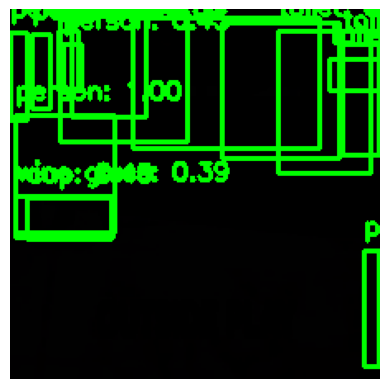

Frame 513, Label: 1, Score: 0.998832643032074
Frame 513, Label: 62, Score: 0.9816255569458008
Frame 513, Label: 1, Score: 0.9505046010017395
Frame 513, Label: 62, Score: 0.8440523743629456
Frame 513, Label: 1, Score: 0.8103371858596802
Frame 513, Label: 1, Score: 0.7368181347846985
Frame 513, Label: 62, Score: 0.6802773475646973
Frame 513, Label: 62, Score: 0.6151565909385681
Frame 513, Label: 1, Score: 0.45145198702812195
Frame 513, Label: 62, Score: 0.4450693130493164
Frame 513, Label: 42, Score: 0.40367236733436584
Frame 513, Label: 41, Score: 0.39245709776878357
Frame 513, Label: 62, Score: 0.3287268280982971
Frame 513, Label: 62, Score: 0.32860705256462097
Frame 513, Label: 1, Score: 0.3024626672267914


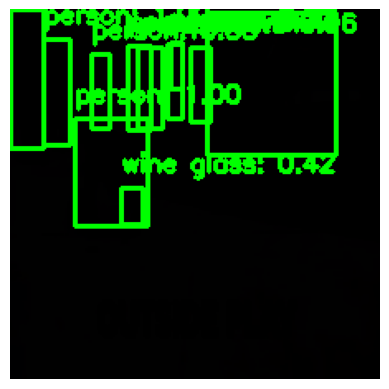

Frame 514, Label: 1, Score: 0.9976955056190491
Frame 514, Label: 1, Score: 0.9963175058364868
Frame 514, Label: 1, Score: 0.995502769947052
Frame 514, Label: 1, Score: 0.9633125066757202
Frame 514, Label: 1, Score: 0.9143612384796143
Frame 514, Label: 62, Score: 0.9031389355659485
Frame 514, Label: 1, Score: 0.9020328521728516
Frame 514, Label: 1, Score: 0.8834603428840637
Frame 514, Label: 1, Score: 0.7285431027412415
Frame 514, Label: 41, Score: 0.4185175895690918
Frame 514, Label: 1, Score: 0.331282377243042


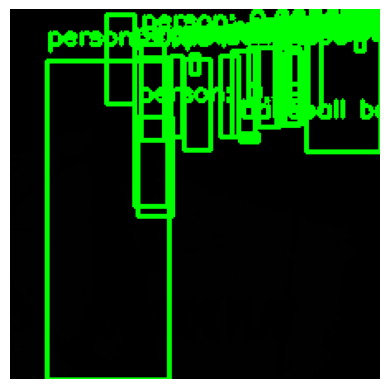

Frame 515, Label: 1, Score: 0.9941214919090271
Frame 515, Label: 1, Score: 0.9923381209373474
Frame 515, Label: 1, Score: 0.991951584815979
Frame 515, Label: 1, Score: 0.9803586006164551
Frame 515, Label: 1, Score: 0.9768855571746826
Frame 515, Label: 1, Score: 0.941146194934845
Frame 515, Label: 1, Score: 0.9393731355667114
Frame 515, Label: 1, Score: 0.9282655119895935
Frame 515, Label: 1, Score: 0.8932867050170898
Frame 515, Label: 1, Score: 0.8819313049316406
Frame 515, Label: 1, Score: 0.8780624270439148
Frame 515, Label: 62, Score: 0.8604366779327393
Frame 515, Label: 1, Score: 0.6541894674301147
Frame 515, Label: 1, Score: 0.6008708477020264
Frame 515, Label: 1, Score: 0.44810229539871216
Frame 515, Label: 1, Score: 0.4187455177307129
Frame 515, Label: 1, Score: 0.39386412501335144
Frame 515, Label: 1, Score: 0.39005059003829956
Frame 515, Label: 35, Score: 0.3212112486362457


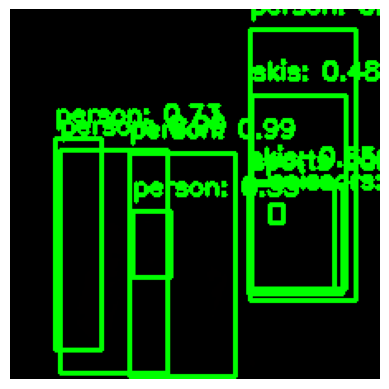

Frame 516, Label: 1, Score: 0.9944465160369873
Frame 516, Label: 1, Score: 0.9924471378326416
Frame 516, Label: 1, Score: 0.9878602623939514
Frame 516, Label: 1, Score: 0.7272936701774597
Frame 516, Label: 31, Score: 0.6541886329650879
Frame 516, Label: 77, Score: 0.5493072867393494
Frame 516, Label: 31, Score: 0.4803425371646881
Frame 516, Label: 33, Score: 0.3963870108127594
Frame 516, Label: 1, Score: 0.3518073558807373


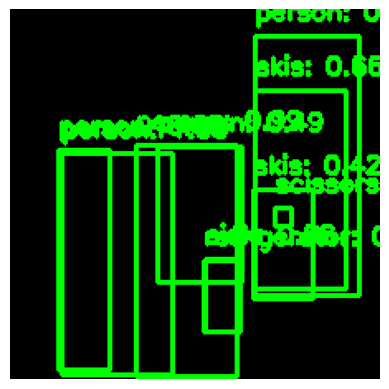

Frame 517, Label: 1, Score: 0.9961709380149841
Frame 517, Label: 1, Score: 0.9921614527702332
Frame 517, Label: 1, Score: 0.9872788190841675
Frame 517, Label: 77, Score: 0.6996728181838989
Frame 517, Label: 1, Score: 0.6767095327377319
Frame 517, Label: 72, Score: 0.6759454607963562
Frame 517, Label: 31, Score: 0.6610915660858154
Frame 517, Label: 1, Score: 0.4901425838470459
Frame 517, Label: 31, Score: 0.4246410131454468
Frame 517, Label: 73, Score: 0.35803845524787903


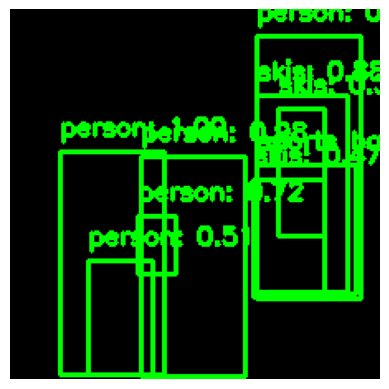

Frame 518, Label: 1, Score: 0.9965113997459412
Frame 518, Label: 1, Score: 0.9927970767021179
Frame 518, Label: 1, Score: 0.9822317957878113
Frame 518, Label: 31, Score: 0.8757140636444092
Frame 518, Label: 1, Score: 0.7172221541404724
Frame 518, Label: 1, Score: 0.507825493812561
Frame 518, Label: 31, Score: 0.4708620011806488
Frame 518, Label: 33, Score: 0.42589351534843445
Frame 518, Label: 31, Score: 0.3152966797351837


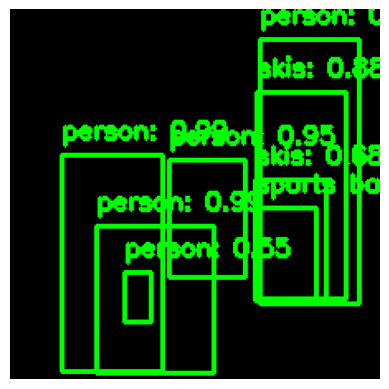

Frame 519, Label: 1, Score: 0.9944191575050354
Frame 519, Label: 1, Score: 0.9916771650314331
Frame 519, Label: 1, Score: 0.9873949289321899
Frame 519, Label: 1, Score: 0.9459219574928284
Frame 519, Label: 31, Score: 0.8761257529258728
Frame 519, Label: 31, Score: 0.6780180931091309
Frame 519, Label: 1, Score: 0.5495564341545105
Frame 519, Label: 33, Score: 0.3280225694179535


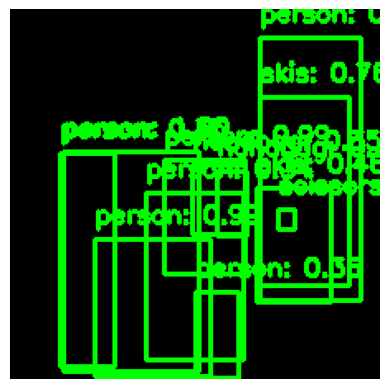

Frame 520, Label: 1, Score: 0.9980289340019226
Frame 520, Label: 1, Score: 0.9894283413887024
Frame 520, Label: 1, Score: 0.9865564703941345
Frame 520, Label: 1, Score: 0.9859555959701538
Frame 520, Label: 77, Score: 0.7866001129150391
Frame 520, Label: 31, Score: 0.7646331787109375
Frame 520, Label: 31, Score: 0.4624594748020172
Frame 520, Label: 27, Score: 0.459775447845459
Frame 520, Label: 1, Score: 0.36319658160209656
Frame 520, Label: 1, Score: 0.3523472249507904
Frame 520, Label: 27, Score: 0.35219457745552063
Frame 520, Label: 1, Score: 0.3404724597930908


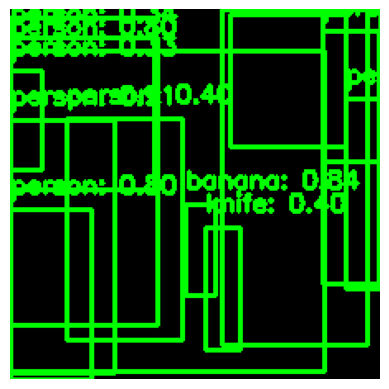

Frame 521, Label: 1, Score: 0.9359867572784424
Frame 521, Label: 1, Score: 0.9091542363166809
Frame 521, Label: 47, Score: 0.8408365845680237
Frame 521, Label: 1, Score: 0.8374114036560059
Frame 521, Label: 1, Score: 0.8021903038024902
Frame 521, Label: 1, Score: 0.7989948987960815
Frame 521, Label: 1, Score: 0.579352855682373
Frame 521, Label: 1, Score: 0.552679181098938
Frame 521, Label: 1, Score: 0.5119138360023499
Frame 521, Label: 1, Score: 0.47909438610076904
Frame 521, Label: 1, Score: 0.400730699300766
Frame 521, Label: 44, Score: 0.3991412818431854
Frame 521, Label: 1, Score: 0.34088730812072754
Frame 521, Label: 1, Score: 0.3329044580459595


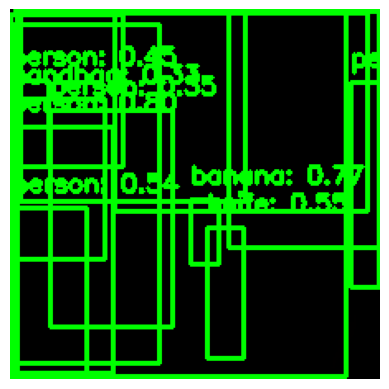

Frame 522, Label: 1, Score: 0.9480993747711182
Frame 522, Label: 1, Score: 0.9291253089904785
Frame 522, Label: 1, Score: 0.8102689385414124
Frame 522, Label: 1, Score: 0.8035130500793457
Frame 522, Label: 1, Score: 0.783846378326416
Frame 522, Label: 47, Score: 0.7693321704864502
Frame 522, Label: 1, Score: 0.7095947265625
Frame 522, Label: 44, Score: 0.5513575673103333
Frame 522, Label: 1, Score: 0.5415109992027283
Frame 522, Label: 1, Score: 0.445372074842453
Frame 522, Label: 1, Score: 0.4227132201194763
Frame 522, Label: 1, Score: 0.3501448631286621
Frame 522, Label: 27, Score: 0.32952266931533813
Frame 522, Label: 1, Score: 0.3013191223144531


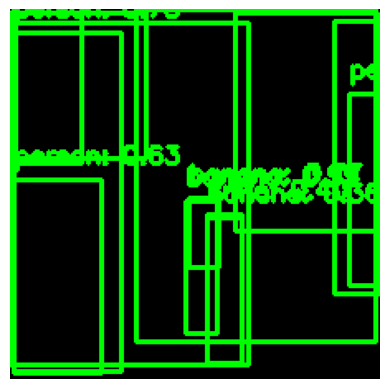

Frame 523, Label: 1, Score: 0.9664896130561829
Frame 523, Label: 1, Score: 0.9544960856437683
Frame 523, Label: 1, Score: 0.9073137044906616
Frame 523, Label: 47, Score: 0.7743958830833435
Frame 523, Label: 1, Score: 0.7455735206604004
Frame 523, Label: 1, Score: 0.7180237770080566
Frame 523, Label: 1, Score: 0.6585562229156494
Frame 523, Label: 1, Score: 0.6317989230155945
Frame 523, Label: 47, Score: 0.5523989200592041
Frame 523, Label: 1, Score: 0.5345931053161621
Frame 523, Label: 1, Score: 0.42468512058258057
Frame 523, Label: 44, Score: 0.39759477972984314
Frame 523, Label: 47, Score: 0.3634573221206665


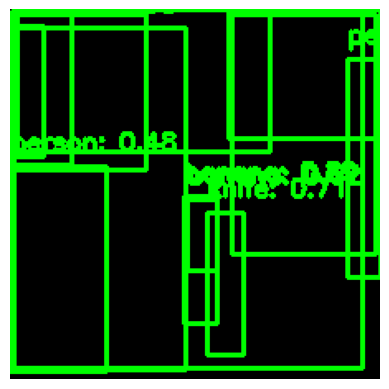

Frame 524, Label: 1, Score: 0.9585797190666199
Frame 524, Label: 1, Score: 0.9521426558494568
Frame 524, Label: 1, Score: 0.9348827004432678
Frame 524, Label: 1, Score: 0.9220245480537415
Frame 524, Label: 47, Score: 0.8865400552749634
Frame 524, Label: 1, Score: 0.8779967427253723
Frame 524, Label: 1, Score: 0.8758882880210876
Frame 524, Label: 44, Score: 0.7092992663383484
Frame 524, Label: 1, Score: 0.6221027374267578
Frame 524, Label: 47, Score: 0.6161026954650879
Frame 524, Label: 1, Score: 0.5566266775131226
Frame 524, Label: 1, Score: 0.48377251625061035
Frame 524, Label: 1, Score: 0.4785030782222748


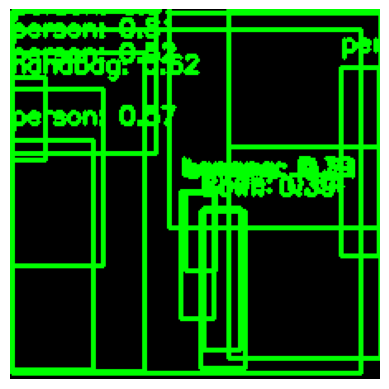

Frame 525, Label: 1, Score: 0.9623810648918152
Frame 525, Label: 1, Score: 0.9456422328948975
Frame 525, Label: 1, Score: 0.8728331327438354
Frame 525, Label: 1, Score: 0.8671128153800964
Frame 525, Label: 1, Score: 0.8434911370277405
Frame 525, Label: 47, Score: 0.8078985810279846
Frame 525, Label: 1, Score: 0.8069563508033752
Frame 525, Label: 44, Score: 0.6434458494186401
Frame 525, Label: 27, Score: 0.6213927865028381
Frame 525, Label: 1, Score: 0.5690993666648865
Frame 525, Label: 1, Score: 0.5156844258308411
Frame 525, Label: 46, Score: 0.38785985112190247
Frame 525, Label: 47, Score: 0.38628721237182617
Frame 525, Label: 1, Score: 0.3097410202026367


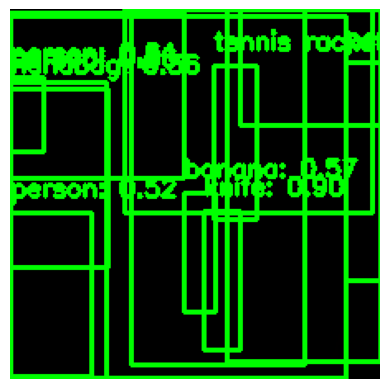

Frame 526, Label: 1, Score: 0.9457880258560181
Frame 526, Label: 1, Score: 0.9291725754737854
Frame 526, Label: 44, Score: 0.9022400975227356
Frame 526, Label: 1, Score: 0.8958962559700012
Frame 526, Label: 1, Score: 0.8926573991775513
Frame 526, Label: 1, Score: 0.8608412742614746
Frame 526, Label: 1, Score: 0.6373658180236816
Frame 526, Label: 47, Score: 0.5742983222007751
Frame 526, Label: 1, Score: 0.5242024660110474
Frame 526, Label: 39, Score: 0.383855402469635
Frame 526, Label: 27, Score: 0.36392611265182495
Frame 526, Label: 1, Score: 0.35841459035873413
Frame 526, Label: 1, Score: 0.3532184362411499
Frame 526, Label: 1, Score: 0.3426674008369446


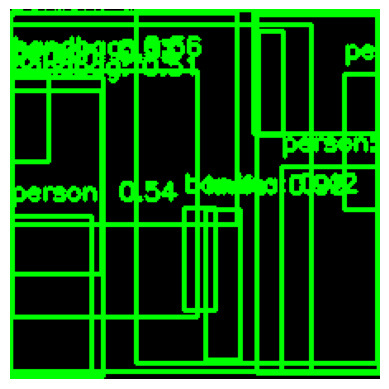

Frame 527, Label: 1, Score: 0.9597439169883728
Frame 527, Label: 1, Score: 0.9336696267127991
Frame 527, Label: 44, Score: 0.931797206401825
Frame 527, Label: 1, Score: 0.9146976470947266
Frame 527, Label: 1, Score: 0.8143727779388428
Frame 527, Label: 1, Score: 0.7323212027549744
Frame 527, Label: 1, Score: 0.6491204500198364
Frame 527, Label: 1, Score: 0.5698603987693787
Frame 527, Label: 1, Score: 0.5553597807884216
Frame 527, Label: 1, Score: 0.5378196835517883
Frame 527, Label: 1, Score: 0.5169428586959839
Frame 527, Label: 27, Score: 0.5079189538955688
Frame 527, Label: 47, Score: 0.4220333993434906
Frame 527, Label: 27, Score: 0.3611765503883362
Frame 527, Label: 39, Score: 0.3163242042064667


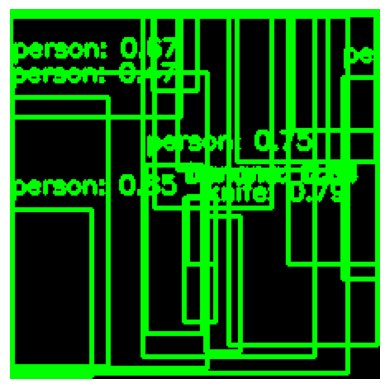

Frame 528, Label: 1, Score: 0.905303955078125
Frame 528, Label: 1, Score: 0.8815265893936157
Frame 528, Label: 1, Score: 0.8660406470298767
Frame 528, Label: 1, Score: 0.849077582359314
Frame 528, Label: 1, Score: 0.8455774784088135
Frame 528, Label: 47, Score: 0.8399935960769653
Frame 528, Label: 1, Score: 0.8037317991256714
Frame 528, Label: 1, Score: 0.7913806438446045
Frame 528, Label: 44, Score: 0.7905892133712769
Frame 528, Label: 1, Score: 0.7463729381561279
Frame 528, Label: 1, Score: 0.7449280619621277
Frame 528, Label: 1, Score: 0.6675140857696533
Frame 528, Label: 47, Score: 0.6124691367149353
Frame 528, Label: 1, Score: 0.5137595534324646
Frame 528, Label: 1, Score: 0.46833017468452454
Frame 528, Label: 1, Score: 0.37985020875930786
Frame 528, Label: 1, Score: 0.3756100833415985
Frame 528, Label: 1, Score: 0.31129559874534607


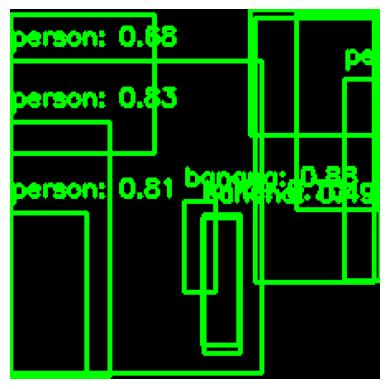

Frame 529, Label: 1, Score: 0.9553685784339905
Frame 529, Label: 1, Score: 0.9445852041244507
Frame 529, Label: 47, Score: 0.8840000629425049
Frame 529, Label: 1, Score: 0.830582320690155
Frame 529, Label: 1, Score: 0.8055710792541504
Frame 529, Label: 44, Score: 0.6997337341308594
Frame 529, Label: 1, Score: 0.6772305369377136
Frame 529, Label: 1, Score: 0.6771583557128906
Frame 529, Label: 47, Score: 0.4922993779182434
Frame 529, Label: 1, Score: 0.4901595711708069
Frame 529, Label: 1, Score: 0.3716534972190857


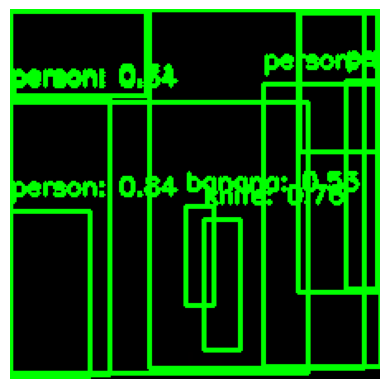

Frame 530, Label: 1, Score: 0.9428102374076843
Frame 530, Label: 1, Score: 0.9413228631019592
Frame 530, Label: 1, Score: 0.8393315672874451
Frame 530, Label: 44, Score: 0.7550475597381592
Frame 530, Label: 1, Score: 0.73472660779953
Frame 530, Label: 1, Score: 0.7133569121360779
Frame 530, Label: 1, Score: 0.6434885263442993
Frame 530, Label: 47, Score: 0.5318090915679932
Frame 530, Label: 1, Score: 0.41121330857276917
Frame 530, Label: 1, Score: 0.3906899690628052
Frame 530, Label: 44, Score: 0.3099825382232666


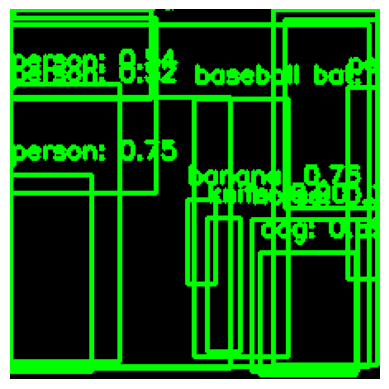

Frame 531, Label: 1, Score: 0.9651062488555908
Frame 531, Label: 44, Score: 0.8963404297828674
Frame 531, Label: 1, Score: 0.8447550535202026
Frame 531, Label: 47, Score: 0.7579020261764526
Frame 531, Label: 1, Score: 0.7508755922317505
Frame 531, Label: 17, Score: 0.6907985806465149
Frame 531, Label: 1, Score: 0.5956502556800842
Frame 531, Label: 44, Score: 0.5555257797241211
Frame 531, Label: 1, Score: 0.5424972772598267
Frame 531, Label: 1, Score: 0.5231209397315979
Frame 531, Label: 35, Score: 0.5182212591171265
Frame 531, Label: 1, Score: 0.48008814454078674
Frame 531, Label: 1, Score: 0.401836097240448
Frame 531, Label: 18, Score: 0.32108089327812195


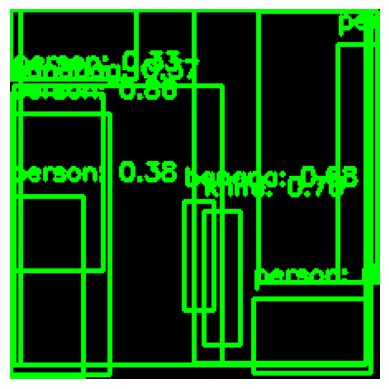

Frame 532, Label: 1, Score: 0.9678404331207275
Frame 532, Label: 1, Score: 0.8620135188102722
Frame 532, Label: 44, Score: 0.7022538185119629
Frame 532, Label: 47, Score: 0.6826720833778381
Frame 532, Label: 1, Score: 0.6276988983154297
Frame 532, Label: 1, Score: 0.5510392189025879
Frame 532, Label: 1, Score: 0.5503535866737366
Frame 532, Label: 44, Score: 0.5154678821563721
Frame 532, Label: 1, Score: 0.5011518001556396
Frame 532, Label: 1, Score: 0.37811657786369324
Frame 532, Label: 27, Score: 0.3714858889579773
Frame 532, Label: 1, Score: 0.3263811767101288


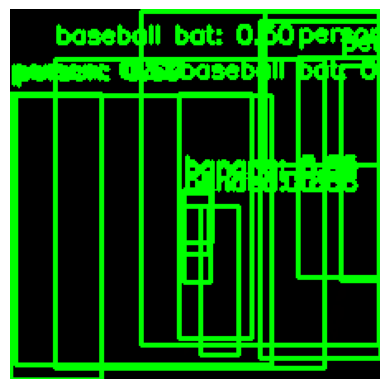

Frame 533, Label: 1, Score: 0.9117449522018433
Frame 533, Label: 47, Score: 0.8936992883682251
Frame 533, Label: 44, Score: 0.882987380027771
Frame 533, Label: 1, Score: 0.8183635473251343
Frame 533, Label: 1, Score: 0.8031690716743469
Frame 533, Label: 1, Score: 0.7504405379295349
Frame 533, Label: 1, Score: 0.6910380125045776
Frame 533, Label: 47, Score: 0.6846935153007507
Frame 533, Label: 35, Score: 0.604642391204834
Frame 533, Label: 1, Score: 0.6017547249794006
Frame 533, Label: 35, Score: 0.5011448860168457
Frame 533, Label: 1, Score: 0.42802390456199646
Frame 533, Label: 47, Score: 0.3299892246723175


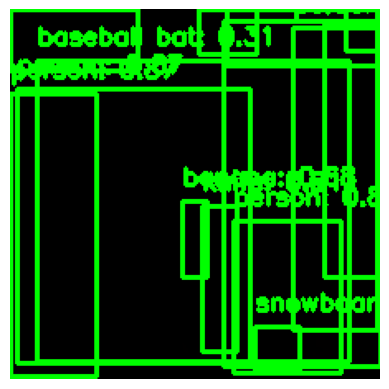

Frame 534, Label: 1, Score: 0.9071657657623291
Frame 534, Label: 1, Score: 0.8869884610176086
Frame 534, Label: 24, Score: 0.877391517162323
Frame 534, Label: 1, Score: 0.8727664947509766
Frame 534, Label: 44, Score: 0.8128886818885803
Frame 534, Label: 47, Score: 0.6761457920074463
Frame 534, Label: 1, Score: 0.6720225811004639
Frame 534, Label: 1, Score: 0.6501454710960388
Frame 534, Label: 1, Score: 0.6148362159729004
Frame 534, Label: 1, Score: 0.5145224332809448
Frame 534, Label: 32, Score: 0.5048270225524902
Frame 534, Label: 1, Score: 0.4523277282714844
Frame 534, Label: 44, Score: 0.3160335421562195
Frame 534, Label: 35, Score: 0.31372228264808655


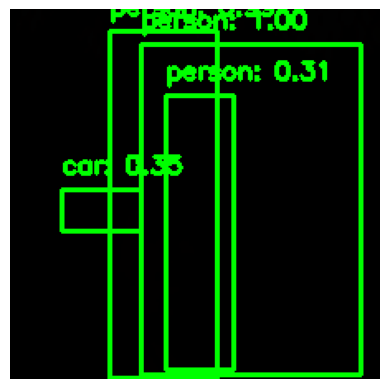

Frame 535, Label: 1, Score: 0.9989681243896484
Frame 535, Label: 1, Score: 0.9901285767555237
Frame 535, Label: 3, Score: 0.3518226146697998
Frame 535, Label: 1, Score: 0.30549612641334534


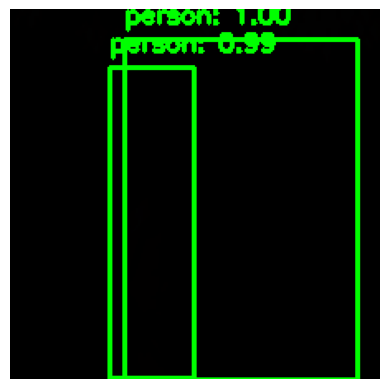

Frame 536, Label: 1, Score: 0.9987145662307739
Frame 536, Label: 1, Score: 0.9871547222137451


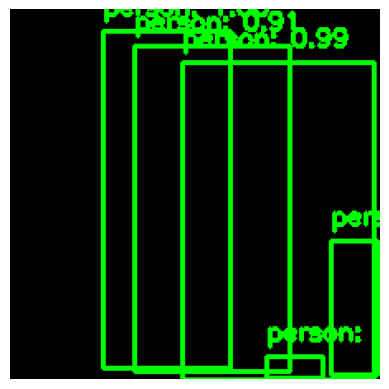

Frame 537, Label: 1, Score: 0.9952527284622192
Frame 537, Label: 1, Score: 0.9943965673446655
Frame 537, Label: 1, Score: 0.911651611328125
Frame 537, Label: 1, Score: 0.6718664169311523
Frame 537, Label: 1, Score: 0.5558152794837952


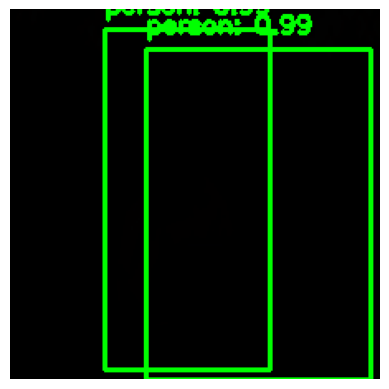

Frame 538, Label: 1, Score: 0.9949257373809814
Frame 538, Label: 1, Score: 0.989938497543335


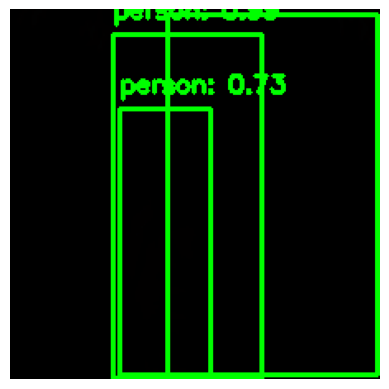

Frame 539, Label: 1, Score: 0.9881987571716309
Frame 539, Label: 1, Score: 0.9677892923355103
Frame 539, Label: 1, Score: 0.7298444509506226


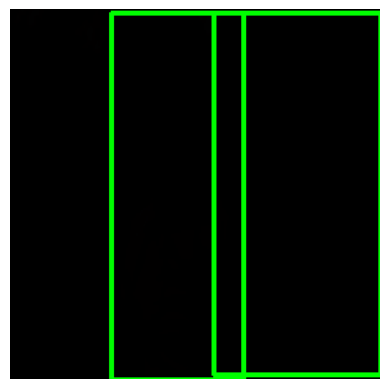

Frame 540, Label: 1, Score: 0.99607914686203
Frame 540, Label: 1, Score: 0.7602453231811523


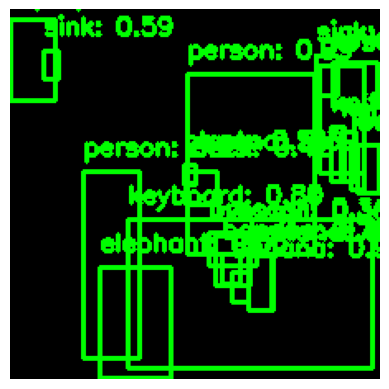

Frame 541, Label: 1, Score: 0.9925196170806885
Frame 541, Label: 1, Score: 0.9920469522476196
Frame 541, Label: 47, Score: 0.9640080332756042
Frame 541, Label: 64, Score: 0.9085056781768799
Frame 541, Label: 72, Score: 0.7993214726448059
Frame 541, Label: 67, Score: 0.7950262427330017
Frame 541, Label: 44, Score: 0.7737613320350647
Frame 541, Label: 72, Score: 0.6955246329307556
Frame 541, Label: 1, Score: 0.6929095983505249
Frame 541, Label: 72, Score: 0.5899716019630432
Frame 541, Label: 21, Score: 0.5527853965759277
Frame 541, Label: 75, Score: 0.5089326500892639
Frame 541, Label: 44, Score: 0.5057749152183533
Frame 541, Label: 47, Score: 0.4639628827571869
Frame 541, Label: 47, Score: 0.4351203143596649
Frame 541, Label: 75, Score: 0.415404349565506
Frame 541, Label: 47, Score: 0.38875943422317505
Frame 541, Label: 47, Score: 0.36442068219184875
Frame 541, Label: 44, Score: 0.3578907251358032
Frame 541, Label: 47, Score: 0.3222498595714569
Frame 541, Label: 44, Score: 0.31008458137

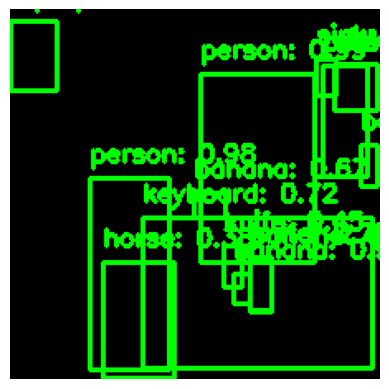

Frame 542, Label: 1, Score: 0.9910972118377686
Frame 542, Label: 1, Score: 0.9794390797615051
Frame 542, Label: 64, Score: 0.9501981735229492
Frame 542, Label: 47, Score: 0.9343225955963135
Frame 542, Label: 67, Score: 0.7235809564590454
Frame 542, Label: 44, Score: 0.6988190412521362
Frame 542, Label: 47, Score: 0.6707143187522888
Frame 542, Label: 72, Score: 0.6696611642837524
Frame 542, Label: 1, Score: 0.6564574837684631
Frame 542, Label: 44, Score: 0.45477741956710815
Frame 542, Label: 47, Score: 0.41866958141326904
Frame 542, Label: 47, Score: 0.3950287401676178
Frame 542, Label: 72, Score: 0.3803955316543579
Frame 542, Label: 18, Score: 0.3773952126502991


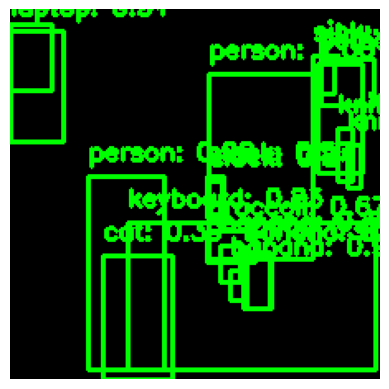

Frame 543, Label: 1, Score: 0.9952372312545776
Frame 543, Label: 1, Score: 0.9762805700302124
Frame 543, Label: 47, Score: 0.9180770516395569
Frame 543, Label: 64, Score: 0.9030564427375793
Frame 543, Label: 72, Score: 0.9006403088569641
Frame 543, Label: 67, Score: 0.8341573476791382
Frame 543, Label: 1, Score: 0.8161128759384155
Frame 543, Label: 75, Score: 0.8091747164726257
Frame 543, Label: 51, Score: 0.6716712117195129
Frame 543, Label: 47, Score: 0.6414093971252441
Frame 543, Label: 75, Score: 0.5749301314353943
Frame 543, Label: 44, Score: 0.5353191494941711
Frame 543, Label: 64, Score: 0.514016330242157
Frame 543, Label: 44, Score: 0.4814104437828064
Frame 543, Label: 16, Score: 0.38771766424179077
Frame 543, Label: 44, Score: 0.35837283730506897
Frame 543, Label: 47, Score: 0.3043423891067505
Frame 543, Label: 72, Score: 0.30024588108062744


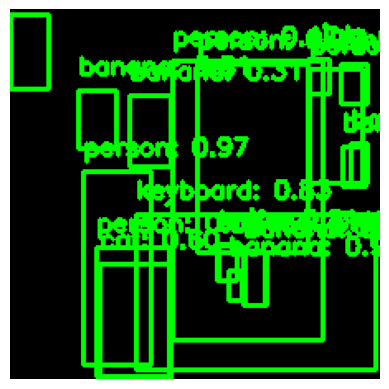

Frame 544, Label: 1, Score: 0.9888907670974731
Frame 544, Label: 47, Score: 0.9835278987884521
Frame 544, Label: 1, Score: 0.972206175327301
Frame 544, Label: 64, Score: 0.8439456820487976
Frame 544, Label: 67, Score: 0.829674482345581
Frame 544, Label: 47, Score: 0.8078953623771667
Frame 544, Label: 72, Score: 0.7963297963142395
Frame 544, Label: 1, Score: 0.7683263421058655
Frame 544, Label: 47, Score: 0.7120389938354492
Frame 544, Label: 44, Score: 0.6069895029067993
Frame 544, Label: 16, Score: 0.6039014458656311
Frame 544, Label: 47, Score: 0.6008638739585876
Frame 544, Label: 1, Score: 0.5642979741096497
Frame 544, Label: 72, Score: 0.5532528758049011
Frame 544, Label: 47, Score: 0.4679809808731079
Frame 544, Label: 1, Score: 0.46546995639801025
Frame 544, Label: 47, Score: 0.4001748263835907
Frame 544, Label: 44, Score: 0.31152206659317017
Frame 544, Label: 47, Score: 0.31150928139686584


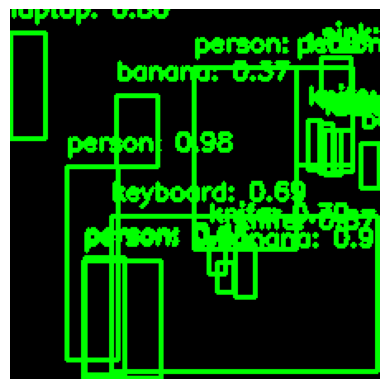

Frame 545, Label: 1, Score: 0.9950113296508789
Frame 545, Label: 1, Score: 0.9769414067268372
Frame 545, Label: 47, Score: 0.9646965861320496
Frame 545, Label: 1, Score: 0.9469995498657227
Frame 545, Label: 47, Score: 0.942230224609375
Frame 545, Label: 72, Score: 0.927556037902832
Frame 545, Label: 44, Score: 0.8651766777038574
Frame 545, Label: 64, Score: 0.8023911714553833
Frame 545, Label: 1, Score: 0.7807036638259888
Frame 545, Label: 47, Score: 0.771686851978302
Frame 545, Label: 44, Score: 0.6965660452842712
Frame 545, Label: 67, Score: 0.6925744414329529
Frame 545, Label: 44, Score: 0.5605819225311279
Frame 545, Label: 44, Score: 0.40695708990097046
Frame 545, Label: 1, Score: 0.4057721793651581
Frame 545, Label: 47, Score: 0.36810141801834106
Frame 545, Label: 44, Score: 0.32909905910491943


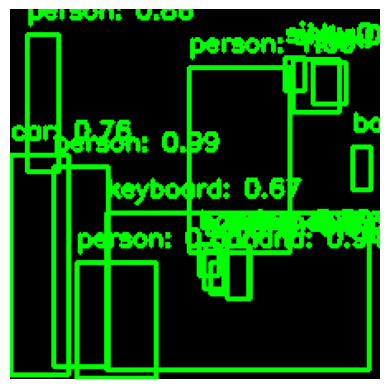

Frame 546, Label: 1, Score: 0.9959694147109985
Frame 546, Label: 1, Score: 0.986604630947113
Frame 546, Label: 47, Score: 0.943359911441803
Frame 546, Label: 72, Score: 0.9147928357124329
Frame 546, Label: 47, Score: 0.8915221095085144
Frame 546, Label: 44, Score: 0.8666639924049377
Frame 546, Label: 1, Score: 0.8562792539596558
Frame 546, Label: 1, Score: 0.8506267666816711
Frame 546, Label: 3, Score: 0.7563911080360413
Frame 546, Label: 72, Score: 0.7472922801971436
Frame 546, Label: 67, Score: 0.672118604183197
Frame 546, Label: 47, Score: 0.5071278810501099
Frame 546, Label: 72, Score: 0.5033549070358276
Frame 546, Label: 47, Score: 0.3405354619026184
Frame 546, Label: 47, Score: 0.31481489539146423


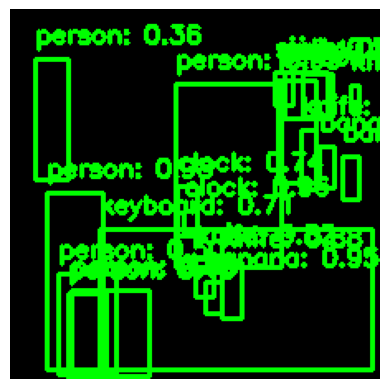

Frame 547, Label: 1, Score: 0.9912882447242737
Frame 547, Label: 1, Score: 0.977790892124176
Frame 547, Label: 1, Score: 0.9637778997421265
Frame 547, Label: 75, Score: 0.9622739553451538
Frame 547, Label: 47, Score: 0.9472936391830444
Frame 547, Label: 72, Score: 0.932134747505188
Frame 547, Label: 44, Score: 0.8807858824729919
Frame 547, Label: 44, Score: 0.8174839019775391
Frame 547, Label: 75, Score: 0.7427079081535339
Frame 547, Label: 67, Score: 0.7122225165367126
Frame 547, Label: 72, Score: 0.6886727213859558
Frame 547, Label: 44, Score: 0.5590169429779053
Frame 547, Label: 1, Score: 0.5496194362640381
Frame 547, Label: 72, Score: 0.5309379696846008
Frame 547, Label: 1, Score: 0.49708884954452515
Frame 547, Label: 44, Score: 0.48338741064071655
Frame 547, Label: 47, Score: 0.4821915924549103
Frame 547, Label: 1, Score: 0.4464998245239258
Frame 547, Label: 1, Score: 0.3560386002063751
Frame 547, Label: 47, Score: 0.307908833026886


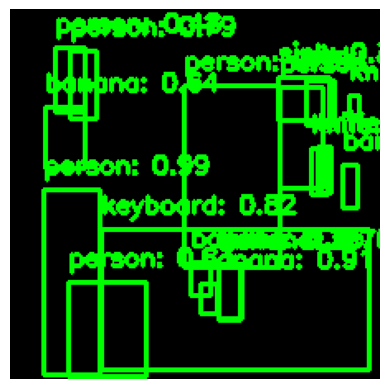

Frame 548, Label: 1, Score: 0.9882974028587341
Frame 548, Label: 1, Score: 0.9866069555282593
Frame 548, Label: 72, Score: 0.9462618231773376
Frame 548, Label: 47, Score: 0.9146961569786072
Frame 548, Label: 1, Score: 0.8332396149635315
Frame 548, Label: 67, Score: 0.8197391033172607
Frame 548, Label: 1, Score: 0.793988823890686
Frame 548, Label: 1, Score: 0.717623770236969
Frame 548, Label: 47, Score: 0.7003476023674011
Frame 548, Label: 47, Score: 0.6384230256080627
Frame 548, Label: 47, Score: 0.5494910478591919
Frame 548, Label: 1, Score: 0.4840216338634491
Frame 548, Label: 44, Score: 0.39416226744651794
Frame 548, Label: 44, Score: 0.38994356989860535
Frame 548, Label: 44, Score: 0.3648127317428589
Frame 548, Label: 47, Score: 0.3632242679595947
Frame 548, Label: 72, Score: 0.36118659377098083
Frame 548, Label: 44, Score: 0.30066147446632385


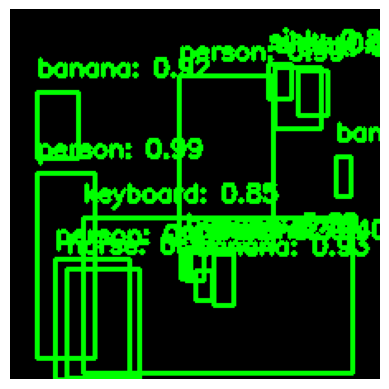

Frame 549, Label: 1, Score: 0.992958664894104
Frame 549, Label: 1, Score: 0.985352098941803
Frame 549, Label: 72, Score: 0.9837987422943115
Frame 549, Label: 47, Score: 0.933599054813385
Frame 549, Label: 47, Score: 0.9219841957092285
Frame 549, Label: 72, Score: 0.8700651526451111
Frame 549, Label: 67, Score: 0.8534988164901733
Frame 549, Label: 44, Score: 0.7370709776878357
Frame 549, Label: 47, Score: 0.5518724322319031
Frame 549, Label: 72, Score: 0.5501622557640076
Frame 549, Label: 1, Score: 0.46632838249206543
Frame 549, Label: 47, Score: 0.397063672542572
Frame 549, Label: 47, Score: 0.385536253452301
Frame 549, Label: 18, Score: 0.3272845447063446
Frame 549, Label: 50, Score: 0.3143147826194763


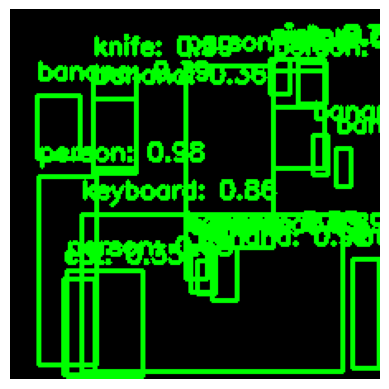

Frame 550, Label: 1, Score: 0.9876956939697266
Frame 550, Label: 1, Score: 0.984000563621521
Frame 550, Label: 47, Score: 0.9180248379707336
Frame 550, Label: 72, Score: 0.907480776309967
Frame 550, Label: 47, Score: 0.891890287399292
Frame 550, Label: 67, Score: 0.8551645278930664
Frame 550, Label: 47, Score: 0.8490320444107056
Frame 550, Label: 72, Score: 0.7689691185951233
Frame 550, Label: 1, Score: 0.6783007979393005
Frame 550, Label: 47, Score: 0.6494647860527039
Frame 550, Label: 1, Score: 0.6324475407600403
Frame 550, Label: 47, Score: 0.5005351305007935
Frame 550, Label: 47, Score: 0.4492877721786499
Frame 550, Label: 44, Score: 0.43483108282089233
Frame 550, Label: 47, Score: 0.38972094655036926
Frame 550, Label: 44, Score: 0.3886980712413788
Frame 550, Label: 47, Score: 0.35994428396224976
Frame 550, Label: 16, Score: 0.3455285131931305
Frame 550, Label: 72, Score: 0.3453264534473419


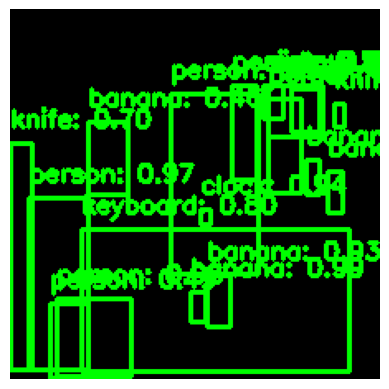

Frame 551, Label: 47, Score: 0.9876154661178589
Frame 551, Label: 1, Score: 0.9800997376441956
Frame 551, Label: 1, Score: 0.9738934636116028
Frame 551, Label: 1, Score: 0.9641521573066711
Frame 551, Label: 75, Score: 0.935713529586792
Frame 551, Label: 47, Score: 0.9338083863258362
Frame 551, Label: 72, Score: 0.9132406711578369
Frame 551, Label: 67, Score: 0.7967103719711304
Frame 551, Label: 72, Score: 0.699985682964325
Frame 551, Label: 44, Score: 0.6991679668426514
Frame 551, Label: 72, Score: 0.5633590817451477
Frame 551, Label: 1, Score: 0.485677033662796
Frame 551, Label: 1, Score: 0.45761987566947937
Frame 551, Label: 47, Score: 0.4565696120262146
Frame 551, Label: 47, Score: 0.4489063024520874
Frame 551, Label: 1, Score: 0.42101773619651794
Frame 551, Label: 44, Score: 0.36012810468673706
Frame 551, Label: 47, Score: 0.3098008930683136


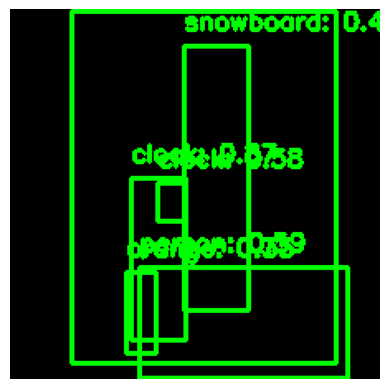

Frame 552, Label: 1, Score: 0.9964931607246399
Frame 552, Label: 75, Score: 0.8732097148895264
Frame 552, Label: 1, Score: 0.5911930203437805
Frame 552, Label: 75, Score: 0.5757957100868225
Frame 552, Label: 32, Score: 0.4083036780357361
Frame 552, Label: 50, Score: 0.35471588373184204


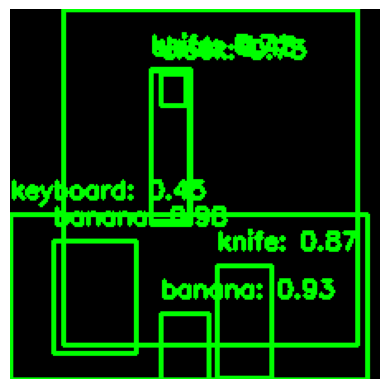

Frame 553, Label: 47, Score: 0.9784800410270691
Frame 553, Label: 1, Score: 0.9485694766044617
Frame 553, Label: 47, Score: 0.9318764209747314
Frame 553, Label: 44, Score: 0.8739104866981506
Frame 553, Label: 75, Score: 0.728329598903656
Frame 553, Label: 44, Score: 0.7142945528030396
Frame 553, Label: 67, Score: 0.45231860876083374
Frame 553, Label: 75, Score: 0.42547017335891724


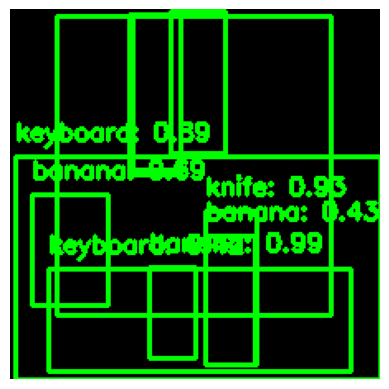

Frame 554, Label: 47, Score: 0.9931515455245972
Frame 554, Label: 44, Score: 0.9252831935882568
Frame 554, Label: 1, Score: 0.913555383682251
Frame 554, Label: 67, Score: 0.8850669860839844
Frame 554, Label: 47, Score: 0.6869645714759827
Frame 554, Label: 44, Score: 0.6345575451850891
Frame 554, Label: 47, Score: 0.428141325712204
Frame 554, Label: 67, Score: 0.4205864369869232
Frame 554, Label: 44, Score: 0.39227455854415894
Frame 554, Label: 75, Score: 0.31080201268196106


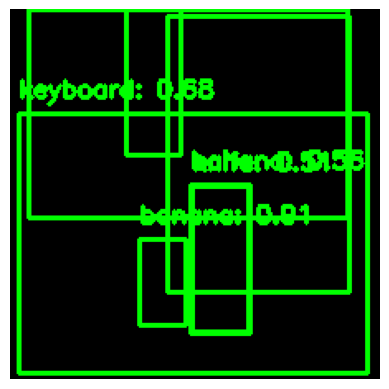

Frame 555, Label: 47, Score: 0.9094669818878174
Frame 555, Label: 1, Score: 0.9076209664344788
Frame 555, Label: 44, Score: 0.7177402377128601
Frame 555, Label: 67, Score: 0.6770133972167969
Frame 555, Label: 1, Score: 0.5652745366096497
Frame 555, Label: 47, Score: 0.5622669458389282
Frame 555, Label: 44, Score: 0.5104007124900818


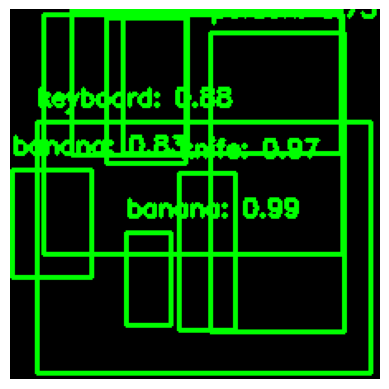

Frame 556, Label: 47, Score: 0.9900389313697815
Frame 556, Label: 44, Score: 0.9675238728523254
Frame 556, Label: 1, Score: 0.8888746500015259
Frame 556, Label: 67, Score: 0.8837891817092896
Frame 556, Label: 44, Score: 0.8701145052909851
Frame 556, Label: 1, Score: 0.8493935465812683
Frame 556, Label: 47, Score: 0.8309699296951294
Frame 556, Label: 1, Score: 0.7534642815589905
Frame 556, Label: 1, Score: 0.48854103684425354


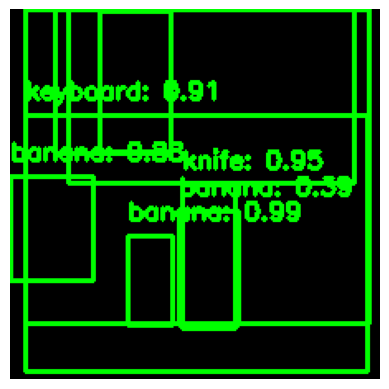

Frame 557, Label: 47, Score: 0.9885993003845215
Frame 557, Label: 1, Score: 0.9617395997047424
Frame 557, Label: 44, Score: 0.95041823387146
Frame 557, Label: 44, Score: 0.948664665222168
Frame 557, Label: 67, Score: 0.9086556434631348
Frame 557, Label: 47, Score: 0.8764314651489258
Frame 557, Label: 1, Score: 0.6412723064422607
Frame 557, Label: 1, Score: 0.4302307069301605
Frame 557, Label: 47, Score: 0.3858333230018616


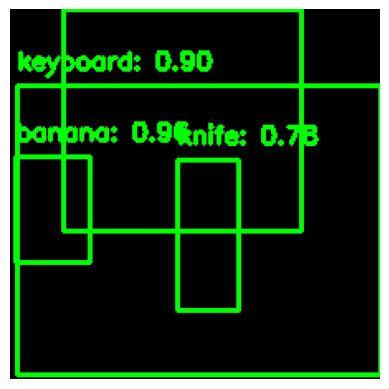

Frame 558, Label: 47, Score: 0.9553539752960205
Frame 558, Label: 1, Score: 0.9174680113792419
Frame 558, Label: 67, Score: 0.8963766098022461
Frame 558, Label: 44, Score: 0.7845871448516846


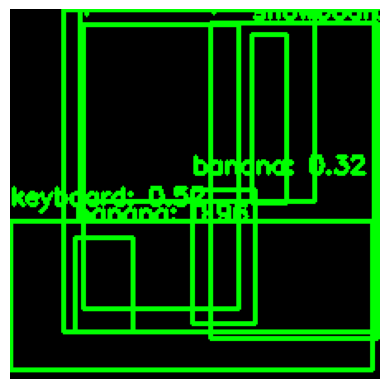

Frame 559, Label: 1, Score: 0.9620724320411682
Frame 559, Label: 47, Score: 0.9550567269325256
Frame 559, Label: 32, Score: 0.8336158394813538
Frame 559, Label: 1, Score: 0.5755738019943237
Frame 559, Label: 67, Score: 0.523467481136322
Frame 559, Label: 1, Score: 0.46511533856391907
Frame 559, Label: 1, Score: 0.37495869398117065
Frame 559, Label: 47, Score: 0.3162883222103119


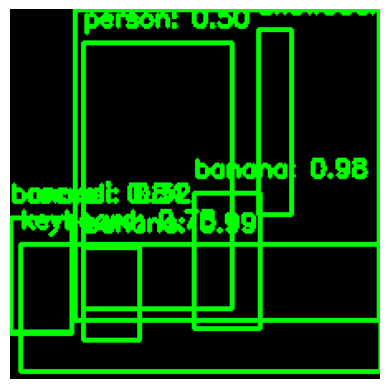

Frame 560, Label: 47, Score: 0.9949524402618408
Frame 560, Label: 1, Score: 0.9937611222267151
Frame 560, Label: 47, Score: 0.9751555919647217
Frame 560, Label: 47, Score: 0.8394066095352173
Frame 560, Label: 67, Score: 0.7802771925926208
Frame 560, Label: 1, Score: 0.49695056676864624
Frame 560, Label: 32, Score: 0.48659205436706543
Frame 560, Label: 51, Score: 0.32347559928894043


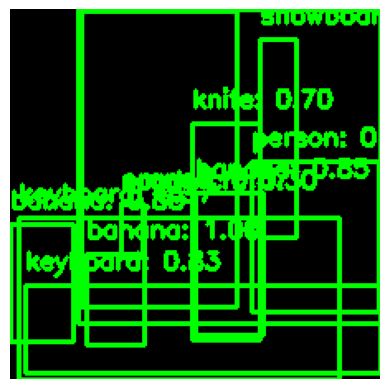

Frame 561, Label: 47, Score: 0.9975776076316833
Frame 561, Label: 1, Score: 0.9935290217399597
Frame 561, Label: 47, Score: 0.8751431107521057
Frame 561, Label: 47, Score: 0.8466953635215759
Frame 561, Label: 67, Score: 0.8341845870018005
Frame 561, Label: 1, Score: 0.8315662741661072
Frame 561, Label: 32, Score: 0.7147469520568848
Frame 561, Label: 44, Score: 0.7037234902381897
Frame 561, Label: 1, Score: 0.5388245582580566
Frame 561, Label: 50, Score: 0.37096986174583435
Frame 561, Label: 67, Score: 0.36984577775001526
Frame 561, Label: 49, Score: 0.3028591275215149


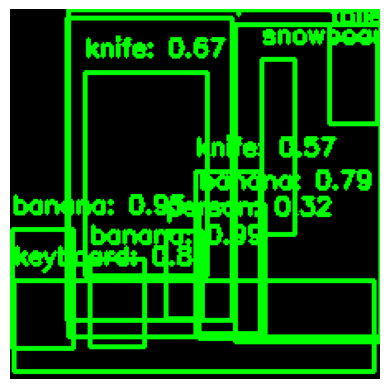

Frame 562, Label: 1, Score: 0.9945951104164124
Frame 562, Label: 47, Score: 0.9922608733177185
Frame 562, Label: 47, Score: 0.9528960585594177
Frame 562, Label: 67, Score: 0.8946338891983032
Frame 562, Label: 47, Score: 0.7872132062911987
Frame 562, Label: 1, Score: 0.7864536046981812
Frame 562, Label: 44, Score: 0.6716064810752869
Frame 562, Label: 44, Score: 0.5712522268295288
Frame 562, Label: 32, Score: 0.5452284812927246
Frame 562, Label: 62, Score: 0.44548627734184265
Frame 562, Label: 1, Score: 0.37508121132850647
Frame 562, Label: 1, Score: 0.32201486825942993


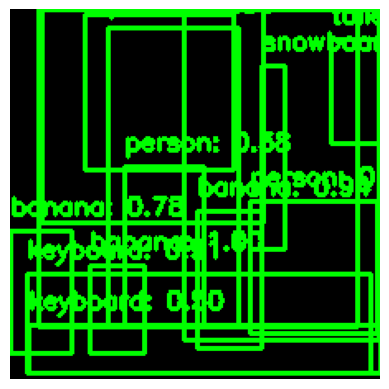

Frame 563, Label: 47, Score: 0.9965826869010925
Frame 563, Label: 1, Score: 0.9638271331787109
Frame 563, Label: 47, Score: 0.9433012008666992
Frame 563, Label: 67, Score: 0.9140686392784119
Frame 563, Label: 1, Score: 0.9040114879608154
Frame 563, Label: 1, Score: 0.8598043322563171
Frame 563, Label: 1, Score: 0.7991189956665039
Frame 563, Label: 47, Score: 0.7775699496269226
Frame 563, Label: 32, Score: 0.7336338758468628
Frame 563, Label: 62, Score: 0.5904833674430847
Frame 563, Label: 1, Score: 0.5120137333869934
Frame 563, Label: 67, Score: 0.496464341878891
Frame 563, Label: 1, Score: 0.38672369718551636
Frame 563, Label: 1, Score: 0.3830425441265106


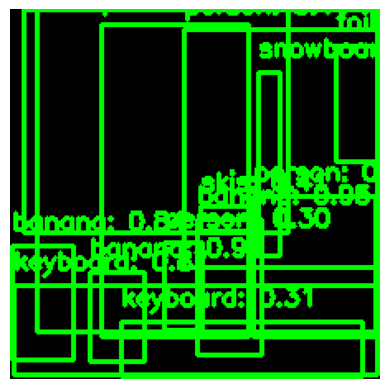

Frame 564, Label: 47, Score: 0.9926108717918396
Frame 564, Label: 1, Score: 0.982508659362793
Frame 564, Label: 47, Score: 0.9537005424499512
Frame 564, Label: 67, Score: 0.8678423762321472
Frame 564, Label: 47, Score: 0.8442711234092712
Frame 564, Label: 1, Score: 0.7206671237945557
Frame 564, Label: 62, Score: 0.585835874080658
Frame 564, Label: 32, Score: 0.4583872854709625
Frame 564, Label: 1, Score: 0.43674033880233765
Frame 564, Label: 31, Score: 0.41412854194641113
Frame 564, Label: 1, Score: 0.3914988338947296
Frame 564, Label: 67, Score: 0.3087228536605835
Frame 564, Label: 1, Score: 0.30824384093284607
Frame 564, Label: 1, Score: 0.30268052220344543


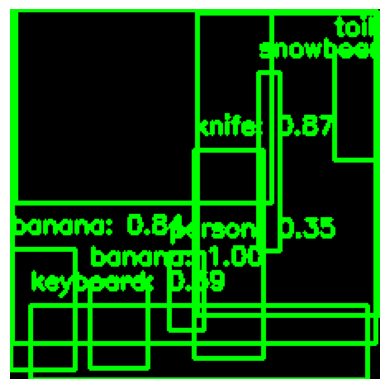

Frame 565, Label: 47, Score: 0.9963443875312805
Frame 565, Label: 1, Score: 0.9665992259979248
Frame 565, Label: 1, Score: 0.8961909413337708
Frame 565, Label: 44, Score: 0.8709301948547363
Frame 565, Label: 47, Score: 0.8442515730857849
Frame 565, Label: 1, Score: 0.758043110370636
Frame 565, Label: 62, Score: 0.6371054649353027
Frame 565, Label: 67, Score: 0.38751766085624695
Frame 565, Label: 32, Score: 0.3828592002391815
Frame 565, Label: 1, Score: 0.349927693605423


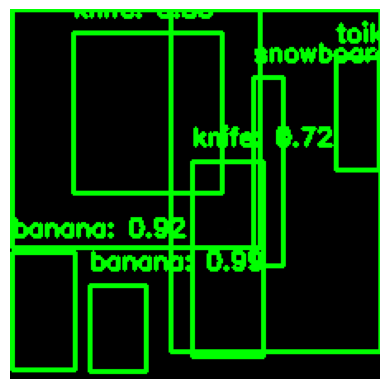

Frame 566, Label: 47, Score: 0.9873342514038086
Frame 566, Label: 1, Score: 0.9537112712860107
Frame 566, Label: 47, Score: 0.9196762442588806
Frame 566, Label: 1, Score: 0.9057469367980957
Frame 566, Label: 44, Score: 0.8260560035705566
Frame 566, Label: 44, Score: 0.7206942439079285
Frame 566, Label: 62, Score: 0.5689910054206848
Frame 566, Label: 32, Score: 0.3720896542072296


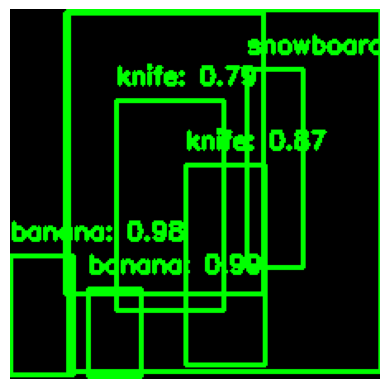

Frame 567, Label: 1, Score: 0.9962064027786255
Frame 567, Label: 47, Score: 0.9920788407325745
Frame 567, Label: 47, Score: 0.9807316660881042
Frame 567, Label: 44, Score: 0.8693966865539551
Frame 567, Label: 44, Score: 0.7886955142021179
Frame 567, Label: 1, Score: 0.5251148343086243
Frame 567, Label: 32, Score: 0.4402155578136444


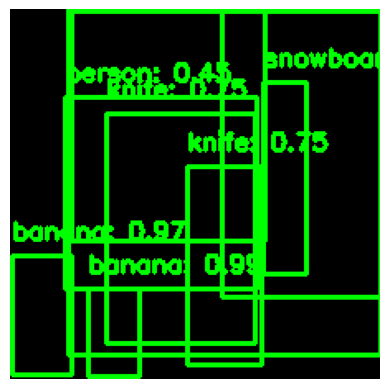

Frame 568, Label: 1, Score: 0.996713399887085
Frame 568, Label: 47, Score: 0.9908202290534973
Frame 568, Label: 47, Score: 0.970088005065918
Frame 568, Label: 32, Score: 0.8338356614112854
Frame 568, Label: 44, Score: 0.7521897554397583
Frame 568, Label: 44, Score: 0.751344621181488
Frame 568, Label: 1, Score: 0.44571658968925476
Frame 568, Label: 1, Score: 0.39973101019859314
Frame 568, Label: 1, Score: 0.3222246766090393


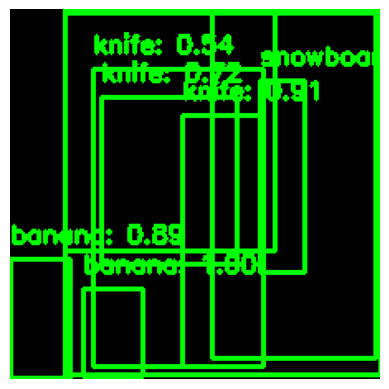

Frame 569, Label: 47, Score: 0.997590184211731
Frame 569, Label: 1, Score: 0.9937520623207092
Frame 569, Label: 44, Score: 0.905309796333313
Frame 569, Label: 47, Score: 0.889488697052002
Frame 569, Label: 32, Score: 0.8312203288078308
Frame 569, Label: 44, Score: 0.7187331318855286
Frame 569, Label: 1, Score: 0.6967871189117432
Frame 569, Label: 44, Score: 0.536924421787262
Frame 569, Label: 1, Score: 0.5204068422317505


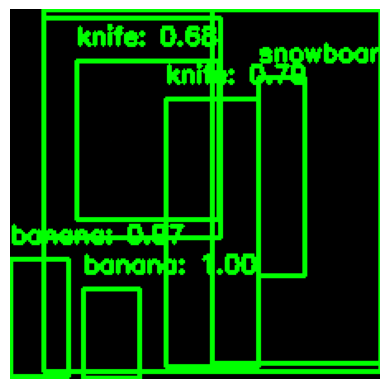

Frame 570, Label: 47, Score: 0.9950711727142334
Frame 570, Label: 1, Score: 0.991300642490387
Frame 570, Label: 47, Score: 0.9667569398880005
Frame 570, Label: 32, Score: 0.8364086747169495
Frame 570, Label: 44, Score: 0.7897179126739502
Frame 570, Label: 1, Score: 0.6909652352333069
Frame 570, Label: 44, Score: 0.6751287579536438
Frame 570, Label: 1, Score: 0.33850136399269104


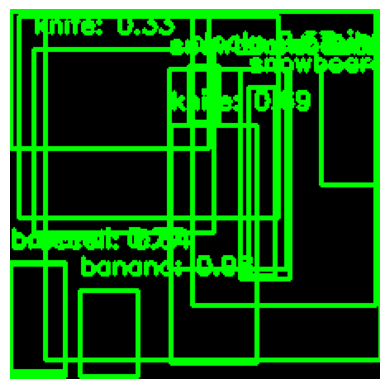

Frame 571, Label: 47, Score: 0.9824177622795105
Frame 571, Label: 1, Score: 0.9710267782211304
Frame 571, Label: 47, Score: 0.7690691351890564
Frame 571, Label: 44, Score: 0.686008095741272
Frame 571, Label: 62, Score: 0.6443778276443481
Frame 571, Label: 51, Score: 0.6398273706436157
Frame 571, Label: 1, Score: 0.6276944279670715
Frame 571, Label: 1, Score: 0.4978076219558716
Frame 571, Label: 1, Score: 0.4790046513080597
Frame 571, Label: 32, Score: 0.38249102234840393
Frame 571, Label: 75, Score: 0.36666977405548096
Frame 571, Label: 32, Score: 0.35822224617004395
Frame 571, Label: 32, Score: 0.3396172523498535
Frame 571, Label: 44, Score: 0.3344361186027527


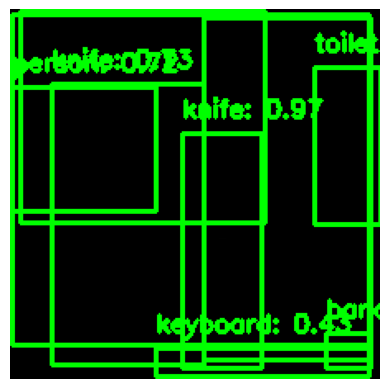

Frame 572, Label: 1, Score: 0.9795475602149963
Frame 572, Label: 44, Score: 0.9679363965988159
Frame 572, Label: 1, Score: 0.8143914937973022
Frame 572, Label: 44, Score: 0.7303957343101501
Frame 572, Label: 1, Score: 0.7249588370323181
Frame 572, Label: 47, Score: 0.6798912882804871
Frame 572, Label: 62, Score: 0.5363407135009766
Frame 572, Label: 67, Score: 0.4330139458179474
Frame 572, Label: 1, Score: 0.3944756090641022


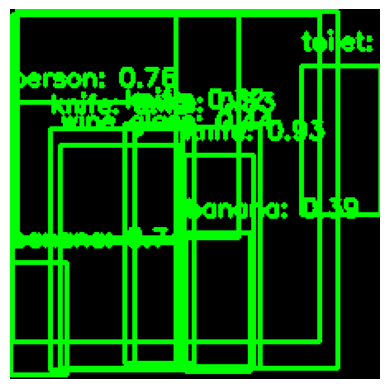

Frame 573, Label: 1, Score: 0.9911144971847534
Frame 573, Label: 44, Score: 0.9304690957069397
Frame 573, Label: 1, Score: 0.763068675994873
Frame 573, Label: 47, Score: 0.7445549964904785
Frame 573, Label: 1, Score: 0.73755943775177
Frame 573, Label: 1, Score: 0.536638081073761
Frame 573, Label: 41, Score: 0.4426344633102417
Frame 573, Label: 44, Score: 0.42899206280708313
Frame 573, Label: 62, Score: 0.4126136302947998
Frame 573, Label: 47, Score: 0.3933798372745514
Frame 573, Label: 44, Score: 0.3300364017486572
Frame 573, Label: 44, Score: 0.31624990701675415


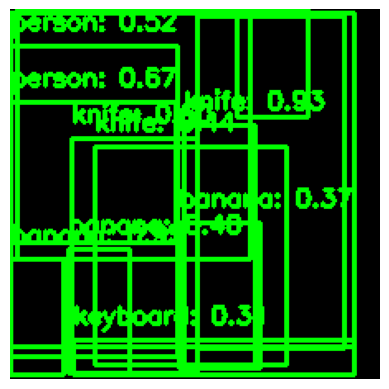

Frame 574, Label: 1, Score: 0.9898452758789062
Frame 574, Label: 47, Score: 0.9458548426628113
Frame 574, Label: 44, Score: 0.9288402199745178
Frame 574, Label: 1, Score: 0.8101089596748352
Frame 574, Label: 1, Score: 0.6692765355110168
Frame 574, Label: 44, Score: 0.6013069748878479
Frame 574, Label: 1, Score: 0.5241872072219849
Frame 574, Label: 1, Score: 0.46196648478507996
Frame 574, Label: 44, Score: 0.44213688373565674
Frame 574, Label: 47, Score: 0.4048019349575043
Frame 574, Label: 47, Score: 0.3719077408313751
Frame 574, Label: 1, Score: 0.31643033027648926
Frame 574, Label: 67, Score: 0.3061855733394623


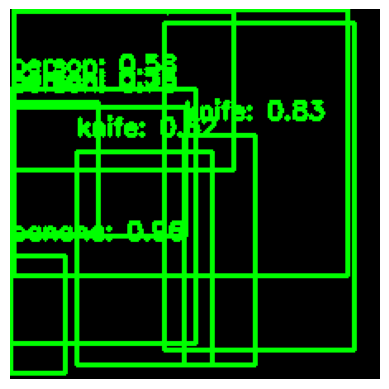

Frame 575, Label: 1, Score: 0.9848078489303589
Frame 575, Label: 47, Score: 0.9569651484489441
Frame 575, Label: 44, Score: 0.8336231708526611
Frame 575, Label: 1, Score: 0.7524111270904541
Frame 575, Label: 44, Score: 0.6224086880683899
Frame 575, Label: 1, Score: 0.5811837315559387
Frame 575, Label: 1, Score: 0.5475636124610901
Frame 575, Label: 1, Score: 0.3989638388156891
Frame 575, Label: 1, Score: 0.3622319996356964


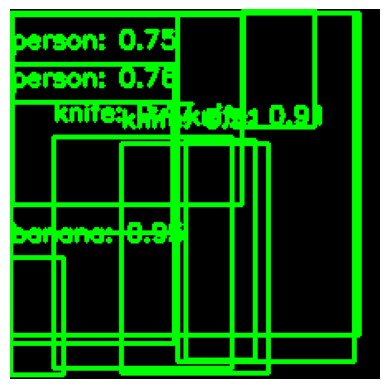

Frame 576, Label: 1, Score: 0.9928881525993347
Frame 576, Label: 47, Score: 0.9498721957206726
Frame 576, Label: 44, Score: 0.914391279220581
Frame 576, Label: 1, Score: 0.7610511183738708
Frame 576, Label: 1, Score: 0.7466222643852234
Frame 576, Label: 1, Score: 0.7192201614379883
Frame 576, Label: 1, Score: 0.5995779633522034
Frame 576, Label: 44, Score: 0.5089931488037109
Frame 576, Label: 44, Score: 0.47017160058021545
Frame 576, Label: 1, Score: 0.3089706301689148


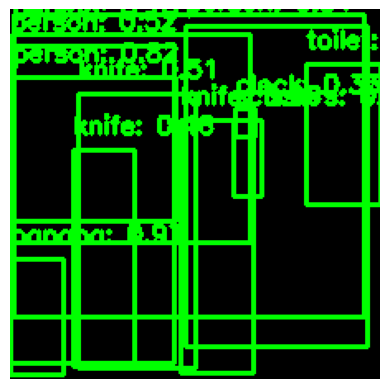

Frame 577, Label: 1, Score: 0.9867421984672546
Frame 577, Label: 47, Score: 0.9719566702842712
Frame 577, Label: 44, Score: 0.9575695395469666
Frame 577, Label: 1, Score: 0.8236866593360901
Frame 577, Label: 1, Score: 0.6996940970420837
Frame 577, Label: 77, Score: 0.5993289947509766
Frame 577, Label: 1, Score: 0.5356401801109314
Frame 577, Label: 1, Score: 0.5156170725822449
Frame 577, Label: 44, Score: 0.5101571679115295
Frame 577, Label: 44, Score: 0.46154528856277466
Frame 577, Label: 62, Score: 0.3793392479419708
Frame 577, Label: 75, Score: 0.32761430740356445


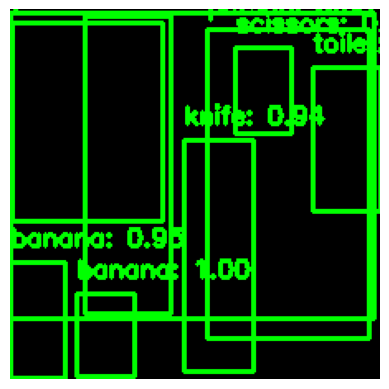

Frame 578, Label: 47, Score: 0.9967435598373413
Frame 578, Label: 1, Score: 0.9748964905738831
Frame 578, Label: 47, Score: 0.9515806436538696
Frame 578, Label: 1, Score: 0.9424330592155457
Frame 578, Label: 44, Score: 0.9357571601867676
Frame 578, Label: 1, Score: 0.6811509132385254
Frame 578, Label: 62, Score: 0.4806658923625946
Frame 578, Label: 77, Score: 0.3408805727958679
Frame 578, Label: 41, Score: 0.33729591965675354


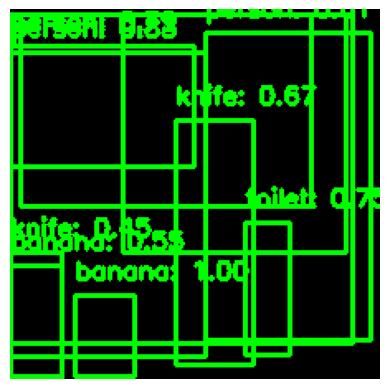

Frame 579, Label: 47, Score: 0.995788037776947
Frame 579, Label: 1, Score: 0.9674553275108337
Frame 579, Label: 1, Score: 0.9044609665870667
Frame 579, Label: 1, Score: 0.8254375457763672
Frame 579, Label: 1, Score: 0.7939506769180298
Frame 579, Label: 62, Score: 0.752429187297821
Frame 579, Label: 44, Score: 0.6687049865722656
Frame 579, Label: 1, Score: 0.6068199872970581
Frame 579, Label: 1, Score: 0.5886619687080383
Frame 579, Label: 47, Score: 0.5465525984764099
Frame 579, Label: 44, Score: 0.4475247859954834


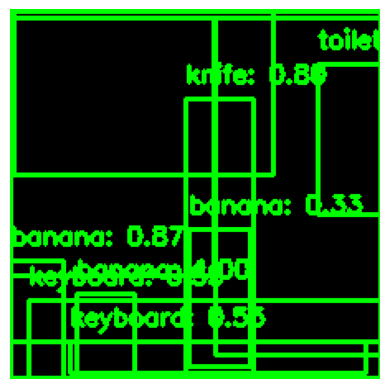

Frame 580, Label: 47, Score: 0.9966506361961365
Frame 580, Label: 1, Score: 0.9731868505477905
Frame 580, Label: 1, Score: 0.8849471807479858
Frame 580, Label: 47, Score: 0.8736937642097473
Frame 580, Label: 44, Score: 0.7975168824195862
Frame 580, Label: 67, Score: 0.553661048412323
Frame 580, Label: 67, Score: 0.5489444136619568
Frame 580, Label: 1, Score: 0.49963250756263733
Frame 580, Label: 62, Score: 0.4122190773487091
Frame 580, Label: 1, Score: 0.4010099768638611
Frame 580, Label: 47, Score: 0.3349936902523041


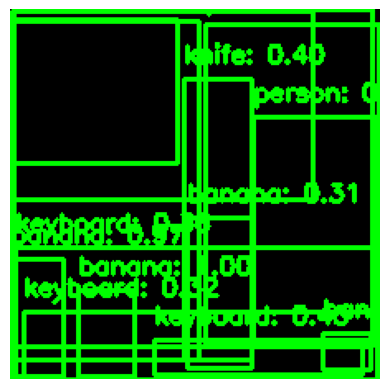

Frame 581, Label: 47, Score: 0.9967605471611023
Frame 581, Label: 47, Score: 0.9708559513092041
Frame 581, Label: 1, Score: 0.9589525461196899
Frame 581, Label: 1, Score: 0.7802044749259949
Frame 581, Label: 1, Score: 0.5933653116226196
Frame 581, Label: 1, Score: 0.5884091258049011
Frame 581, Label: 1, Score: 0.4890524446964264
Frame 581, Label: 1, Score: 0.47232386469841003
Frame 581, Label: 67, Score: 0.4294254183769226
Frame 581, Label: 44, Score: 0.40396755933761597
Frame 581, Label: 67, Score: 0.3625025749206543
Frame 581, Label: 67, Score: 0.32292449474334717
Frame 581, Label: 47, Score: 0.32076719403266907
Frame 581, Label: 47, Score: 0.3092341423034668


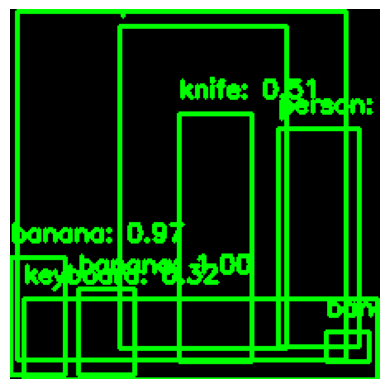

Frame 582, Label: 47, Score: 0.996681272983551
Frame 582, Label: 1, Score: 0.9950295090675354
Frame 582, Label: 47, Score: 0.9732723236083984
Frame 582, Label: 1, Score: 0.7794052958488464
Frame 582, Label: 44, Score: 0.5130228996276855
Frame 582, Label: 47, Score: 0.4544907808303833
Frame 582, Label: 1, Score: 0.3990682363510132
Frame 582, Label: 67, Score: 0.32379114627838135


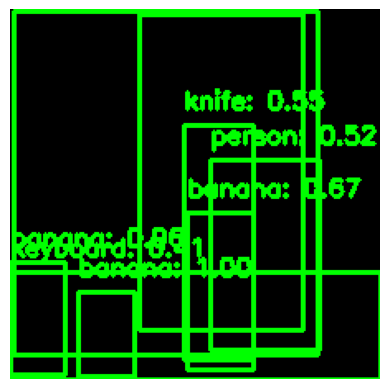

Frame 583, Label: 1, Score: 0.995681643486023
Frame 583, Label: 47, Score: 0.9950039982795715
Frame 583, Label: 47, Score: 0.9579131007194519
Frame 583, Label: 47, Score: 0.6662611961364746
Frame 583, Label: 44, Score: 0.546765148639679
Frame 583, Label: 1, Score: 0.5239546298980713
Frame 583, Label: 67, Score: 0.41078072786331177
Frame 583, Label: 1, Score: 0.3750988245010376


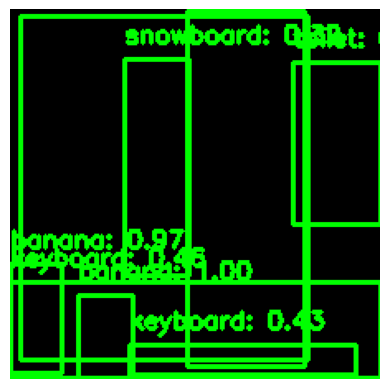

Frame 584, Label: 1, Score: 0.996248185634613
Frame 584, Label: 47, Score: 0.9954178333282471
Frame 584, Label: 47, Score: 0.9661121964454651
Frame 584, Label: 1, Score: 0.6855092644691467
Frame 584, Label: 67, Score: 0.45982033014297485
Frame 584, Label: 67, Score: 0.43321457505226135
Frame 584, Label: 62, Score: 0.359470397233963
Frame 584, Label: 32, Score: 0.3196987807750702


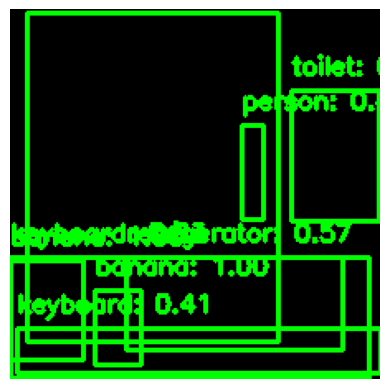

Frame 585, Label: 47, Score: 0.9986847043037415
Frame 585, Label: 1, Score: 0.9980218410491943
Frame 585, Label: 47, Score: 0.9972890615463257
Frame 585, Label: 67, Score: 0.8298960328102112
Frame 585, Label: 73, Score: 0.5654393434524536
Frame 585, Label: 1, Score: 0.4813356399536133
Frame 585, Label: 67, Score: 0.4066515862941742
Frame 585, Label: 62, Score: 0.3834401071071625


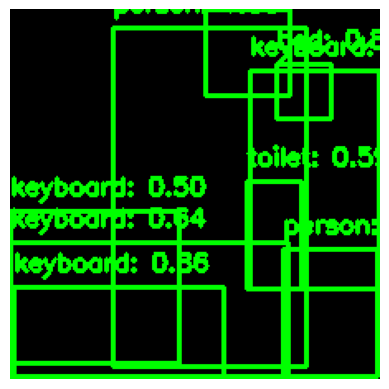

Frame 586, Label: 1, Score: 0.9960673451423645
Frame 586, Label: 1, Score: 0.8794977068901062
Frame 586, Label: 60, Score: 0.859900951385498
Frame 586, Label: 67, Score: 0.8591287732124329
Frame 586, Label: 67, Score: 0.8276880979537964
Frame 586, Label: 67, Score: 0.6362457275390625
Frame 586, Label: 62, Score: 0.5923773646354675
Frame 586, Label: 67, Score: 0.49916669726371765
Frame 586, Label: 1, Score: 0.4539531171321869


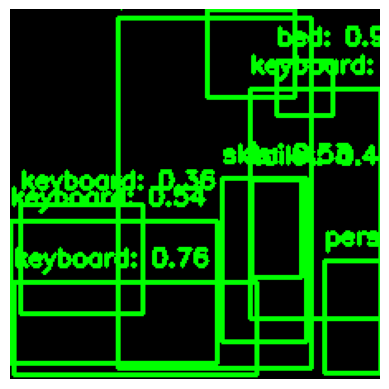

Frame 587, Label: 1, Score: 0.9956433773040771
Frame 587, Label: 60, Score: 0.9537860155105591
Frame 587, Label: 1, Score: 0.9256501197814941
Frame 587, Label: 67, Score: 0.761588990688324
Frame 587, Label: 67, Score: 0.7603097558021545
Frame 587, Label: 1, Score: 0.6950346827507019
Frame 587, Label: 67, Score: 0.540523111820221
Frame 587, Label: 31, Score: 0.5344792604446411
Frame 587, Label: 62, Score: 0.41547688841819763
Frame 587, Label: 67, Score: 0.35692065954208374


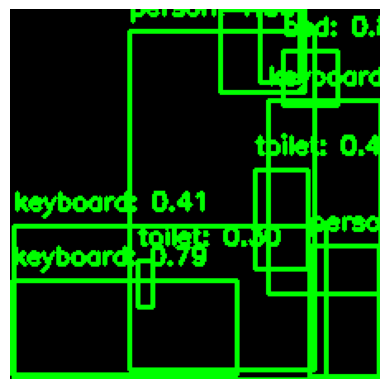

Frame 588, Label: 1, Score: 0.9965080618858337
Frame 588, Label: 1, Score: 0.8690992593765259
Frame 588, Label: 60, Score: 0.8677934408187866
Frame 588, Label: 67, Score: 0.7940897345542908
Frame 588, Label: 67, Score: 0.6263462901115417
Frame 588, Label: 1, Score: 0.4923170804977417
Frame 588, Label: 62, Score: 0.44859579205513
Frame 588, Label: 67, Score: 0.4090037941932678
Frame 588, Label: 1, Score: 0.35435643792152405
Frame 588, Label: 62, Score: 0.30132660269737244


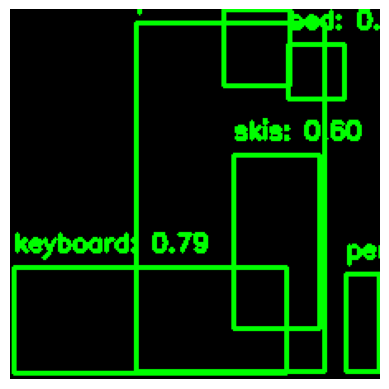

Frame 589, Label: 1, Score: 0.9969252943992615
Frame 589, Label: 60, Score: 0.9674965143203735
Frame 589, Label: 67, Score: 0.792819082736969
Frame 589, Label: 1, Score: 0.6178095936775208
Frame 589, Label: 31, Score: 0.6003735661506653
Frame 589, Label: 1, Score: 0.5923304557800293


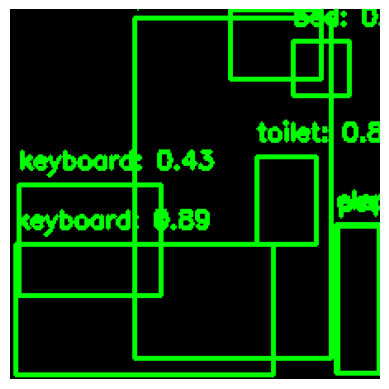

Frame 590, Label: 1, Score: 0.9959703683853149
Frame 590, Label: 67, Score: 0.8865216374397278
Frame 590, Label: 60, Score: 0.8840575218200684
Frame 590, Label: 62, Score: 0.8319256901741028
Frame 590, Label: 1, Score: 0.7090670466423035
Frame 590, Label: 67, Score: 0.4292391836643219
Frame 590, Label: 1, Score: 0.405578076839447
Frame 590, Label: 21, Score: 0.30742889642715454


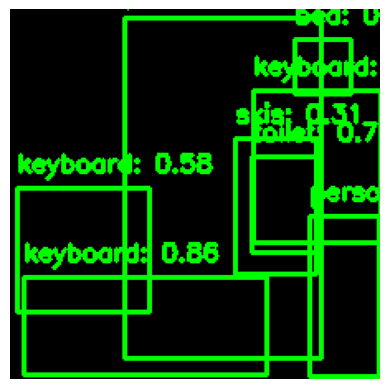

Frame 591, Label: 1, Score: 0.9950562715530396
Frame 591, Label: 60, Score: 0.9280797243118286
Frame 591, Label: 1, Score: 0.9204190373420715
Frame 591, Label: 67, Score: 0.8612592220306396
Frame 591, Label: 62, Score: 0.7593902945518494
Frame 591, Label: 67, Score: 0.5841888189315796
Frame 591, Label: 67, Score: 0.5776129364967346
Frame 591, Label: 31, Score: 0.3087029755115509


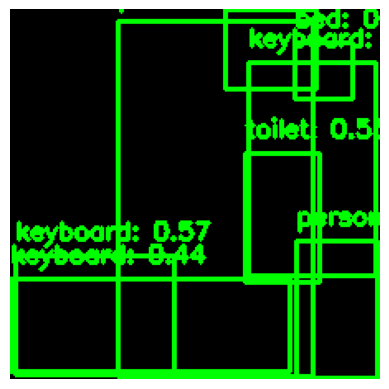

Frame 592, Label: 1, Score: 0.9926228523254395
Frame 592, Label: 1, Score: 0.9725165963172913
Frame 592, Label: 60, Score: 0.9420524835586548
Frame 592, Label: 1, Score: 0.7720394730567932
Frame 592, Label: 67, Score: 0.6651806831359863
Frame 592, Label: 67, Score: 0.5681633949279785
Frame 592, Label: 62, Score: 0.5519083738327026
Frame 592, Label: 67, Score: 0.4375196099281311


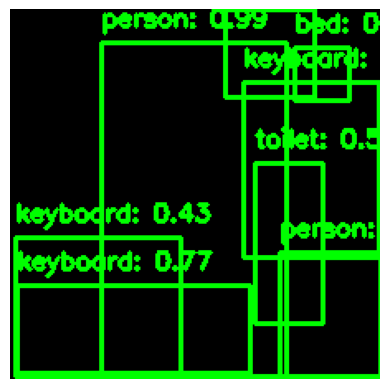

Frame 593, Label: 1, Score: 0.9935021996498108
Frame 593, Label: 60, Score: 0.9507378339767456
Frame 593, Label: 1, Score: 0.9151207208633423
Frame 593, Label: 67, Score: 0.7687081694602966
Frame 593, Label: 62, Score: 0.5575395822525024
Frame 593, Label: 1, Score: 0.5470724701881409
Frame 593, Label: 67, Score: 0.4439971446990967
Frame 593, Label: 67, Score: 0.4251098930835724


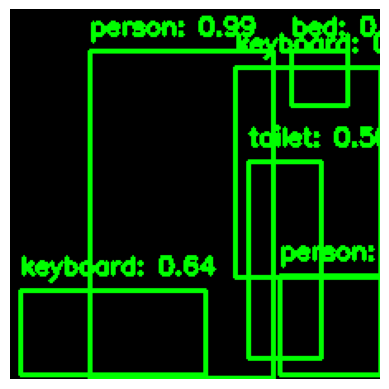

Frame 594, Label: 1, Score: 0.988974928855896
Frame 594, Label: 1, Score: 0.8788870573043823
Frame 594, Label: 60, Score: 0.7486763596534729
Frame 594, Label: 67, Score: 0.6361626386642456
Frame 594, Label: 62, Score: 0.503801703453064
Frame 594, Label: 67, Score: 0.3905717730522156


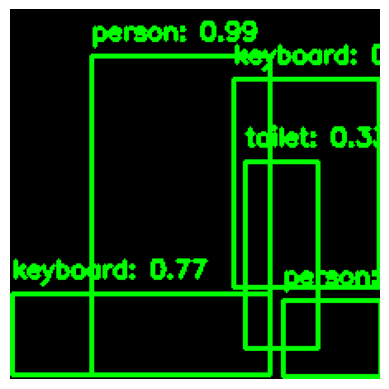

Frame 595, Label: 1, Score: 0.9879023432731628
Frame 595, Label: 1, Score: 0.8643701672554016
Frame 595, Label: 67, Score: 0.765527606010437
Frame 595, Label: 67, Score: 0.413139283657074
Frame 595, Label: 62, Score: 0.3333015441894531


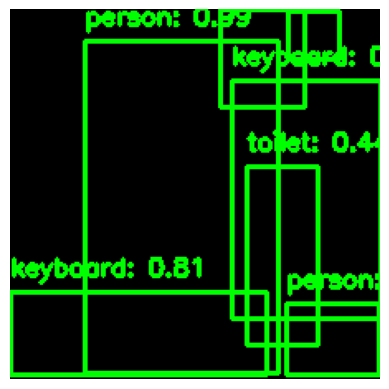

Frame 596, Label: 1, Score: 0.9898484349250793
Frame 596, Label: 1, Score: 0.962978184223175
Frame 596, Label: 1, Score: 0.9434026479721069
Frame 596, Label: 67, Score: 0.8088240623474121
Frame 596, Label: 62, Score: 0.4387350380420685
Frame 596, Label: 67, Score: 0.31283700466156006
Frame 596, Label: 1, Score: 0.30885082483291626


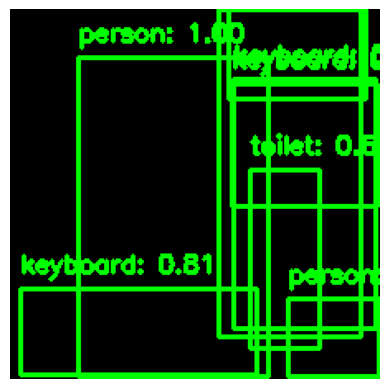

Frame 597, Label: 1, Score: 0.9968762397766113
Frame 597, Label: 1, Score: 0.9861150979995728
Frame 597, Label: 1, Score: 0.915861189365387
Frame 597, Label: 67, Score: 0.8104498386383057
Frame 597, Label: 67, Score: 0.7724184393882751
Frame 597, Label: 62, Score: 0.6000663042068481
Frame 597, Label: 1, Score: 0.5250220894813538
Frame 597, Label: 67, Score: 0.3477647602558136


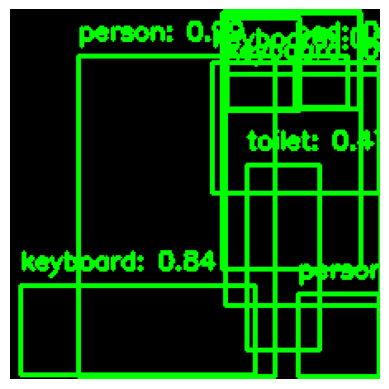

Frame 598, Label: 1, Score: 0.9883996248245239
Frame 598, Label: 1, Score: 0.9836645722389221
Frame 598, Label: 1, Score: 0.9151041507720947
Frame 598, Label: 67, Score: 0.8423290252685547
Frame 598, Label: 1, Score: 0.7040833830833435
Frame 598, Label: 67, Score: 0.5637176632881165
Frame 598, Label: 67, Score: 0.5151079893112183
Frame 598, Label: 1, Score: 0.47619014978408813
Frame 598, Label: 62, Score: 0.47125622630119324
Frame 598, Label: 60, Score: 0.3279898464679718


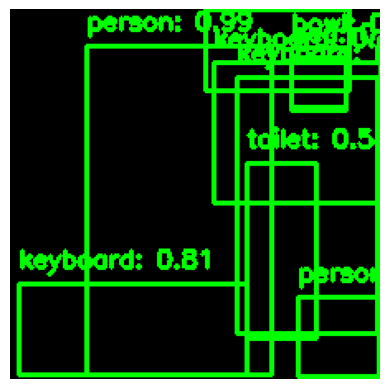

Frame 599, Label: 1, Score: 0.9947860240936279
Frame 599, Label: 1, Score: 0.9463000297546387
Frame 599, Label: 1, Score: 0.8980218768119812
Frame 599, Label: 67, Score: 0.8124990463256836
Frame 599, Label: 62, Score: 0.5783186554908752
Frame 599, Label: 46, Score: 0.44919341802597046
Frame 599, Label: 67, Score: 0.4216409921646118
Frame 599, Label: 67, Score: 0.36099541187286377
Frame 599, Label: 60, Score: 0.3013823926448822


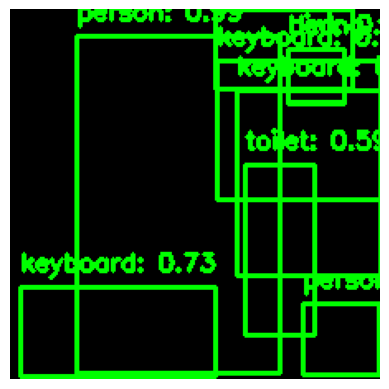

Frame 600, Label: 1, Score: 0.9907271862030029
Frame 600, Label: 1, Score: 0.9684776067733765
Frame 600, Label: 1, Score: 0.9660899043083191
Frame 600, Label: 60, Score: 0.8102967739105225
Frame 600, Label: 67, Score: 0.7302186489105225
Frame 600, Label: 62, Score: 0.5919703841209412
Frame 600, Label: 67, Score: 0.5386826992034912
Frame 600, Label: 61, Score: 0.4364907741546631
Frame 600, Label: 67, Score: 0.3763051927089691


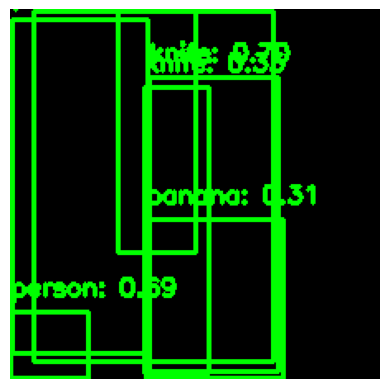

Frame 601, Label: 1, Score: 0.9822825789451599
Frame 601, Label: 44, Score: 0.6995084881782532
Frame 601, Label: 1, Score: 0.6866174340248108
Frame 601, Label: 1, Score: 0.600382924079895
Frame 601, Label: 1, Score: 0.5000278949737549
Frame 601, Label: 44, Score: 0.3316669464111328
Frame 601, Label: 47, Score: 0.30766549706459045


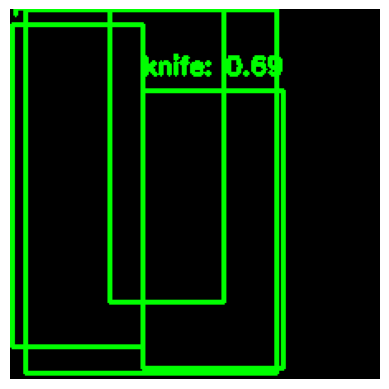

Frame 602, Label: 1, Score: 0.9843130111694336
Frame 602, Label: 44, Score: 0.6855043768882751
Frame 602, Label: 1, Score: 0.46180862188339233
Frame 602, Label: 1, Score: 0.38406234979629517


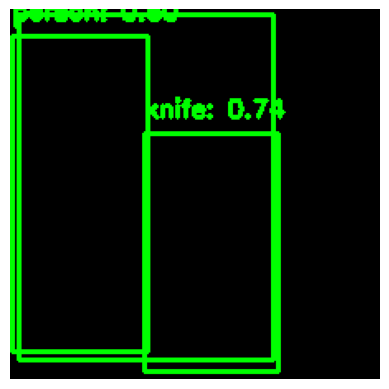

Frame 603, Label: 1, Score: 0.9722495675086975
Frame 603, Label: 44, Score: 0.7386840581893921
Frame 603, Label: 1, Score: 0.6048935055732727


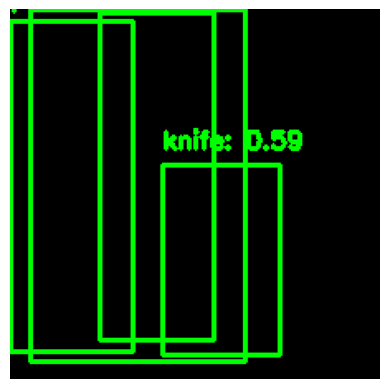

Frame 604, Label: 1, Score: 0.9728807806968689
Frame 604, Label: 1, Score: 0.785933256149292
Frame 604, Label: 44, Score: 0.5917633175849915
Frame 604, Label: 1, Score: 0.3258723020553589


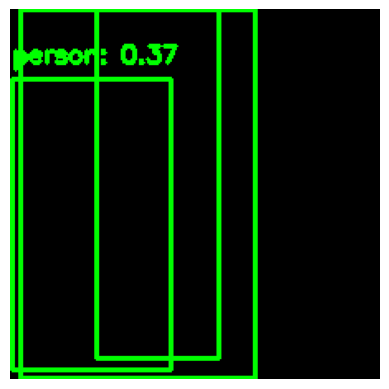

Frame 605, Label: 1, Score: 0.9207045435905457
Frame 605, Label: 1, Score: 0.3882383704185486
Frame 605, Label: 1, Score: 0.36867570877075195


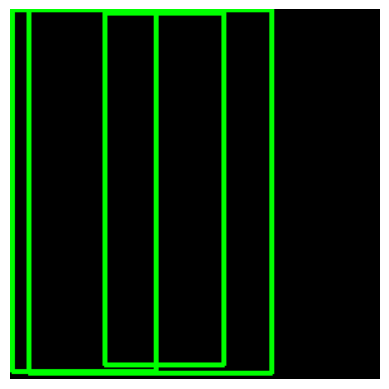

Frame 606, Label: 1, Score: 0.9618964195251465
Frame 606, Label: 1, Score: 0.5292491912841797
Frame 606, Label: 1, Score: 0.3338097631931305


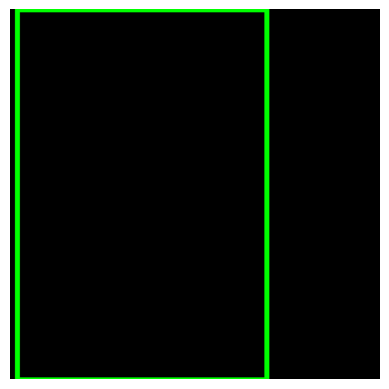

Frame 607, Label: 1, Score: 0.97495436668396


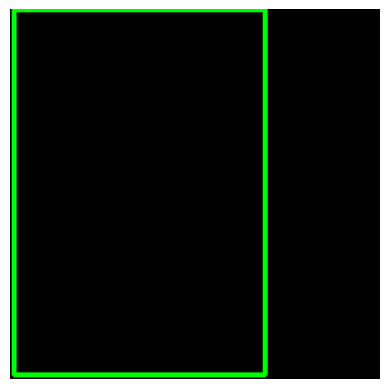

Frame 608, Label: 1, Score: 0.9851375818252563


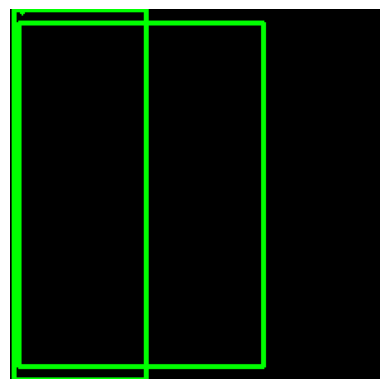

Frame 609, Label: 1, Score: 0.9655282497406006
Frame 609, Label: 1, Score: 0.45946356654167175


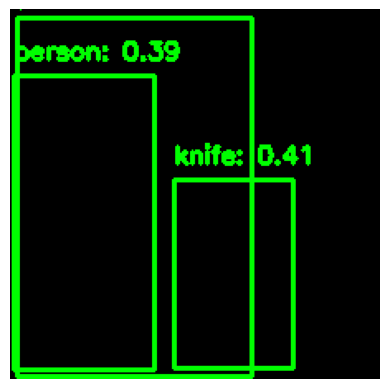

Frame 610, Label: 1, Score: 0.9599884748458862
Frame 610, Label: 44, Score: 0.4087195098400116
Frame 610, Label: 1, Score: 0.3859564960002899


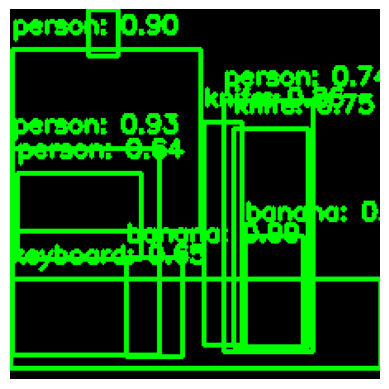

Frame 611, Label: 47, Score: 0.9943365454673767
Frame 611, Label: 1, Score: 0.9294719696044922
Frame 611, Label: 1, Score: 0.9007121920585632
Frame 611, Label: 44, Score: 0.8627973794937134
Frame 611, Label: 44, Score: 0.7518236041069031
Frame 611, Label: 1, Score: 0.7362127304077148
Frame 611, Label: 67, Score: 0.6475573778152466
Frame 611, Label: 1, Score: 0.6373574733734131
Frame 611, Label: 64, Score: 0.3885401785373688
Frame 611, Label: 47, Score: 0.32770836353302


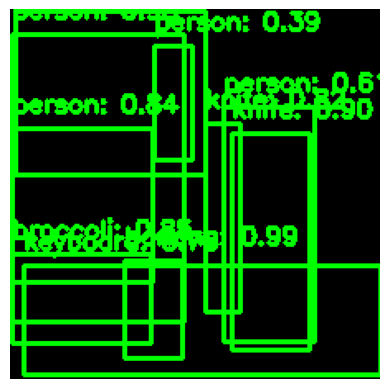

Frame 612, Label: 47, Score: 0.9903644919395447
Frame 612, Label: 1, Score: 0.9816377758979797
Frame 612, Label: 1, Score: 0.9230048656463623
Frame 612, Label: 44, Score: 0.8962706327438354
Frame 612, Label: 51, Score: 0.8491747975349426
Frame 612, Label: 1, Score: 0.8417795300483704
Frame 612, Label: 44, Score: 0.8150813579559326
Frame 612, Label: 67, Score: 0.7612609267234802
Frame 612, Label: 1, Score: 0.6087943911552429
Frame 612, Label: 1, Score: 0.38761383295059204


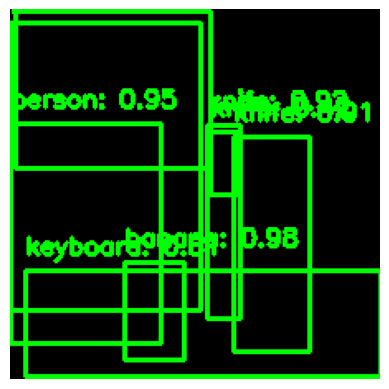

Frame 613, Label: 47, Score: 0.9819590449333191
Frame 613, Label: 1, Score: 0.9490358829498291
Frame 613, Label: 1, Score: 0.9459477663040161
Frame 613, Label: 1, Score: 0.9315083622932434
Frame 613, Label: 44, Score: 0.916113018989563
Frame 613, Label: 44, Score: 0.9102302193641663
Frame 613, Label: 67, Score: 0.8137182593345642
Frame 613, Label: 44, Score: 0.4195669889450073


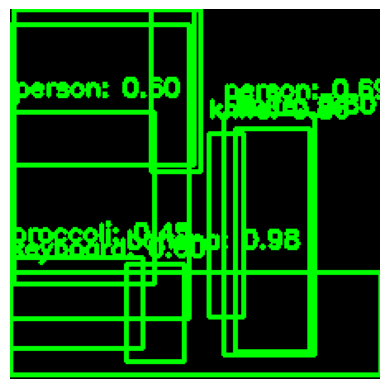

Frame 614, Label: 47, Score: 0.9758093953132629
Frame 614, Label: 1, Score: 0.9641883969306946
Frame 614, Label: 1, Score: 0.9099438786506653
Frame 614, Label: 44, Score: 0.8580596446990967
Frame 614, Label: 44, Score: 0.7970739006996155
Frame 614, Label: 1, Score: 0.6922621726989746
Frame 614, Label: 67, Score: 0.604087233543396
Frame 614, Label: 1, Score: 0.6034494042396545
Frame 614, Label: 51, Score: 0.45098641514778137
Frame 614, Label: 1, Score: 0.31112316250801086


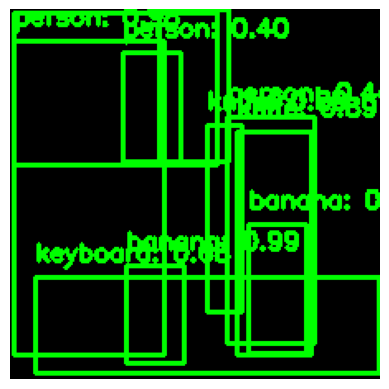

Frame 615, Label: 47, Score: 0.9853455424308777
Frame 615, Label: 1, Score: 0.9807460308074951
Frame 615, Label: 1, Score: 0.9403876662254333
Frame 615, Label: 44, Score: 0.8908392190933228
Frame 615, Label: 44, Score: 0.8881909251213074
Frame 615, Label: 67, Score: 0.6795470118522644
Frame 615, Label: 1, Score: 0.5032700300216675
Frame 615, Label: 1, Score: 0.44291308522224426
Frame 615, Label: 1, Score: 0.3991158902645111
Frame 615, Label: 47, Score: 0.37541916966438293


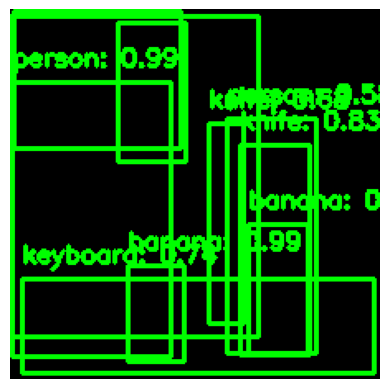

Frame 616, Label: 1, Score: 0.9903668165206909
Frame 616, Label: 47, Score: 0.987263023853302
Frame 616, Label: 1, Score: 0.9694822430610657
Frame 616, Label: 44, Score: 0.8259515762329102
Frame 616, Label: 67, Score: 0.7388975024223328
Frame 616, Label: 44, Score: 0.6795452833175659
Frame 616, Label: 1, Score: 0.6555009484291077
Frame 616, Label: 1, Score: 0.5849801898002625
Frame 616, Label: 1, Score: 0.42995592951774597
Frame 616, Label: 47, Score: 0.3907219469547272


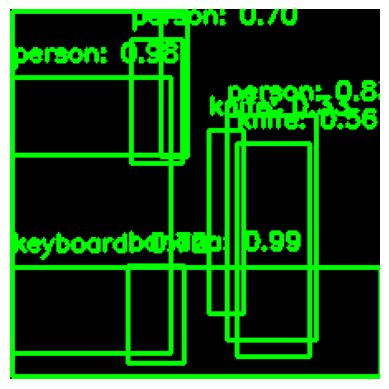

Frame 617, Label: 47, Score: 0.9856197834014893
Frame 617, Label: 1, Score: 0.9837125539779663
Frame 617, Label: 1, Score: 0.9812183976173401
Frame 617, Label: 1, Score: 0.8266631960868835
Frame 617, Label: 67, Score: 0.7201553583145142
Frame 617, Label: 1, Score: 0.7037546038627625
Frame 617, Label: 44, Score: 0.5618348121643066
Frame 617, Label: 1, Score: 0.499978244304657
Frame 617, Label: 44, Score: 0.32822972536087036


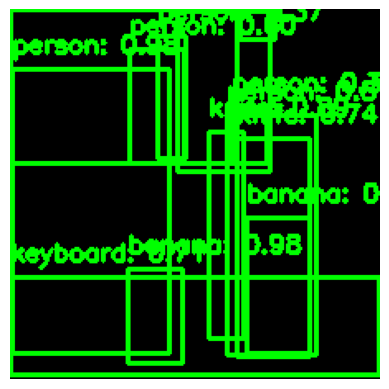

Frame 618, Label: 47, Score: 0.982327938079834
Frame 618, Label: 1, Score: 0.9774048328399658
Frame 618, Label: 1, Score: 0.9715375900268555
Frame 618, Label: 44, Score: 0.8946741819381714
Frame 618, Label: 1, Score: 0.8735033273696899
Frame 618, Label: 44, Score: 0.7400885224342346
Frame 618, Label: 67, Score: 0.7129032015800476
Frame 618, Label: 1, Score: 0.6013874411582947
Frame 618, Label: 1, Score: 0.5174167156219482
Frame 618, Label: 1, Score: 0.3936862349510193
Frame 618, Label: 1, Score: 0.3748273551464081
Frame 618, Label: 1, Score: 0.3685262203216553
Frame 618, Label: 47, Score: 0.3055201768875122


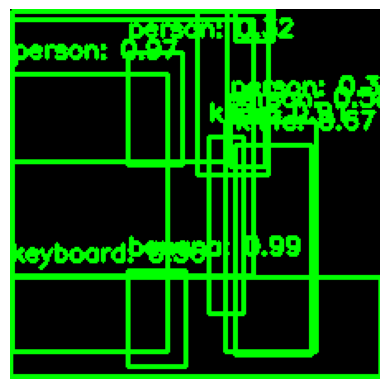

Frame 619, Label: 47, Score: 0.9942706823348999
Frame 619, Label: 1, Score: 0.9770323038101196
Frame 619, Label: 1, Score: 0.9748391509056091
Frame 619, Label: 44, Score: 0.9103001356124878
Frame 619, Label: 1, Score: 0.8183237314224243
Frame 619, Label: 44, Score: 0.6724166870117188
Frame 619, Label: 1, Score: 0.5803902745246887
Frame 619, Label: 67, Score: 0.559589147567749
Frame 619, Label: 1, Score: 0.4848811626434326
Frame 619, Label: 1, Score: 0.38682883977890015
Frame 619, Label: 1, Score: 0.3230072259902954
Frame 619, Label: 1, Score: 0.3123231828212738


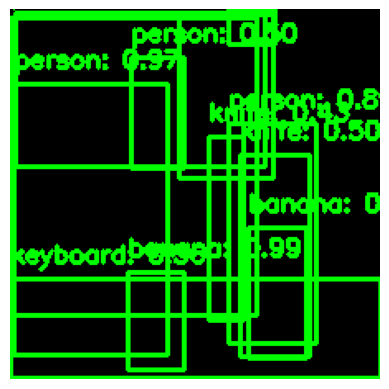

Frame 620, Label: 47, Score: 0.9942653775215149
Frame 620, Label: 1, Score: 0.9800111055374146
Frame 620, Label: 1, Score: 0.9734398126602173
Frame 620, Label: 1, Score: 0.9047386050224304
Frame 620, Label: 1, Score: 0.8907133936882019
Frame 620, Label: 67, Score: 0.5552912354469299
Frame 620, Label: 44, Score: 0.5036106705665588
Frame 620, Label: 1, Score: 0.496489018201828
Frame 620, Label: 1, Score: 0.44629108905792236
Frame 620, Label: 44, Score: 0.43003425002098083
Frame 620, Label: 47, Score: 0.426988422870636
Frame 620, Label: 1, Score: 0.3806689381599426


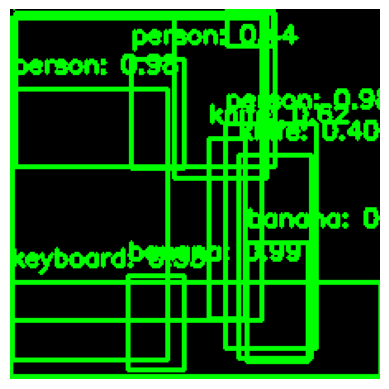

Frame 621, Label: 47, Score: 0.9928914308547974
Frame 621, Label: 1, Score: 0.9838395118713379
Frame 621, Label: 1, Score: 0.9804043173789978
Frame 621, Label: 1, Score: 0.9772328734397888
Frame 621, Label: 1, Score: 0.9211080074310303
Frame 621, Label: 44, Score: 0.6231541037559509
Frame 621, Label: 47, Score: 0.5480890870094299
Frame 621, Label: 67, Score: 0.5345964431762695
Frame 621, Label: 1, Score: 0.4413827955722809
Frame 621, Label: 44, Score: 0.4013573229312897
Frame 621, Label: 1, Score: 0.3566848933696747
Frame 621, Label: 1, Score: 0.34126973152160645


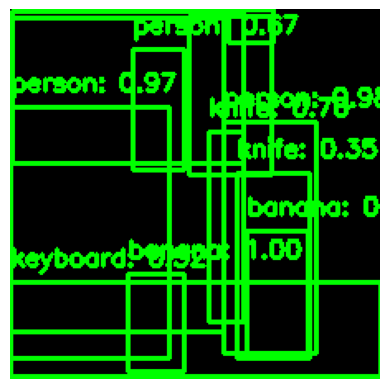

Frame 622, Label: 47, Score: 0.9953280687332153
Frame 622, Label: 1, Score: 0.9842190146446228
Frame 622, Label: 1, Score: 0.9738045930862427
Frame 622, Label: 1, Score: 0.971404492855072
Frame 622, Label: 1, Score: 0.8116737008094788
Frame 622, Label: 44, Score: 0.6992799043655396
Frame 622, Label: 1, Score: 0.6659666895866394
Frame 622, Label: 1, Score: 0.6294146180152893
Frame 622, Label: 47, Score: 0.5873335599899292
Frame 622, Label: 1, Score: 0.53533935546875
Frame 622, Label: 67, Score: 0.5220571756362915
Frame 622, Label: 44, Score: 0.3502292335033417


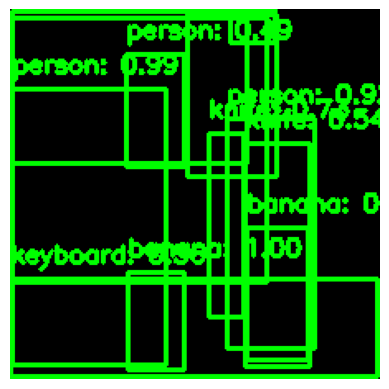

Frame 623, Label: 47, Score: 0.9956089854240417
Frame 623, Label: 1, Score: 0.9863606691360474
Frame 623, Label: 1, Score: 0.9811036586761475
Frame 623, Label: 1, Score: 0.9170032143592834
Frame 623, Label: 1, Score: 0.85164874792099
Frame 623, Label: 44, Score: 0.7272805571556091
Frame 623, Label: 1, Score: 0.5660154819488525
Frame 623, Label: 67, Score: 0.5576092600822449
Frame 623, Label: 44, Score: 0.5356013178825378
Frame 623, Label: 1, Score: 0.48634493350982666
Frame 623, Label: 47, Score: 0.3966737389564514
Frame 623, Label: 1, Score: 0.31015291810035706


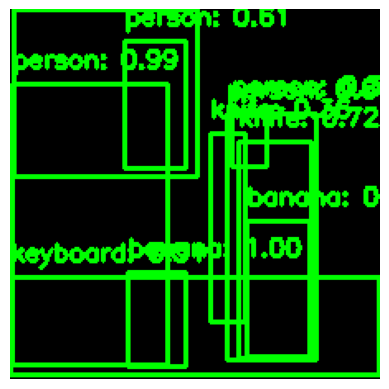

Frame 624, Label: 47, Score: 0.9972884654998779
Frame 624, Label: 1, Score: 0.986626923084259
Frame 624, Label: 1, Score: 0.9793345928192139
Frame 624, Label: 44, Score: 0.7188026905059814
Frame 624, Label: 1, Score: 0.6079295873641968
Frame 624, Label: 1, Score: 0.6058598160743713
Frame 624, Label: 67, Score: 0.5073962211608887
Frame 624, Label: 1, Score: 0.38459059596061707
Frame 624, Label: 44, Score: 0.359450101852417
Frame 624, Label: 47, Score: 0.32507601380348206


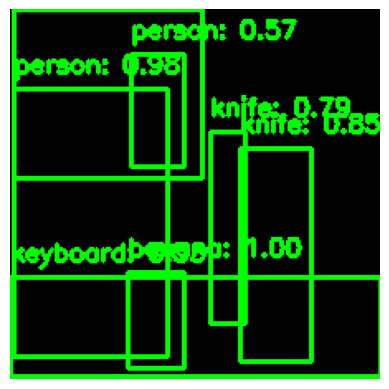

Frame 625, Label: 47, Score: 0.9967591166496277
Frame 625, Label: 1, Score: 0.9840105175971985
Frame 625, Label: 1, Score: 0.9828028082847595
Frame 625, Label: 44, Score: 0.8518195152282715
Frame 625, Label: 44, Score: 0.7933027148246765
Frame 625, Label: 1, Score: 0.5702633857727051
Frame 625, Label: 67, Score: 0.5337754487991333


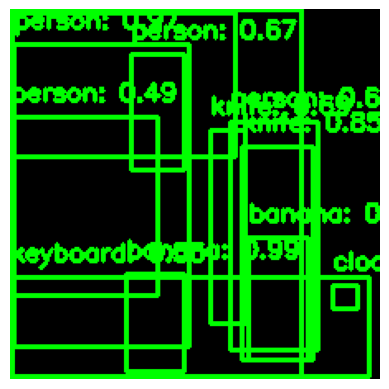

Frame 626, Label: 47, Score: 0.9909620881080627
Frame 626, Label: 1, Score: 0.9685225486755371
Frame 626, Label: 1, Score: 0.9655731320381165
Frame 626, Label: 75, Score: 0.8892471194267273
Frame 626, Label: 44, Score: 0.8471646904945374
Frame 626, Label: 44, Score: 0.685969889163971
Frame 626, Label: 1, Score: 0.6655842065811157
Frame 626, Label: 1, Score: 0.614262580871582
Frame 626, Label: 67, Score: 0.5494175553321838
Frame 626, Label: 1, Score: 0.4852266013622284
Frame 626, Label: 47, Score: 0.41278764605522156
Frame 626, Label: 1, Score: 0.30398842692375183


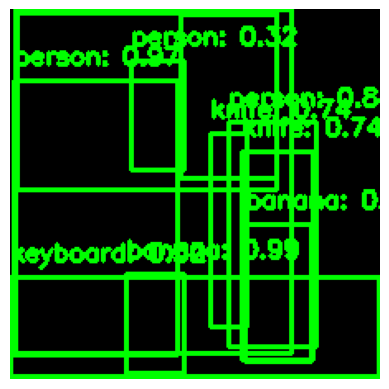

Frame 627, Label: 47, Score: 0.9934950470924377
Frame 627, Label: 1, Score: 0.9745175242424011
Frame 627, Label: 1, Score: 0.9452856779098511
Frame 627, Label: 1, Score: 0.8826348185539246
Frame 627, Label: 44, Score: 0.7437819242477417
Frame 627, Label: 44, Score: 0.7363974452018738
Frame 627, Label: 67, Score: 0.5200706720352173
Frame 627, Label: 1, Score: 0.4459790289402008
Frame 627, Label: 47, Score: 0.42921826243400574
Frame 627, Label: 1, Score: 0.3769361078739166
Frame 627, Label: 1, Score: 0.3228706419467926


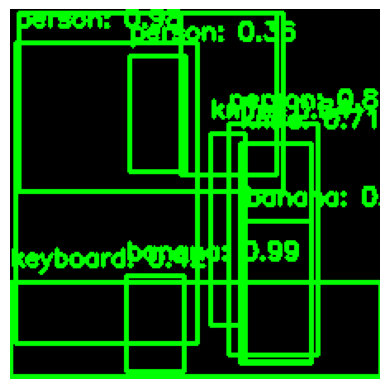

Frame 628, Label: 47, Score: 0.9945791959762573
Frame 628, Label: 1, Score: 0.978054940700531
Frame 628, Label: 1, Score: 0.9564108848571777
Frame 628, Label: 1, Score: 0.8566718697547913
Frame 628, Label: 44, Score: 0.8390664458274841
Frame 628, Label: 44, Score: 0.7123790383338928
Frame 628, Label: 1, Score: 0.43171679973602295
Frame 628, Label: 67, Score: 0.4205045700073242
Frame 628, Label: 1, Score: 0.35929054021835327
Frame 628, Label: 47, Score: 0.3213427662849426


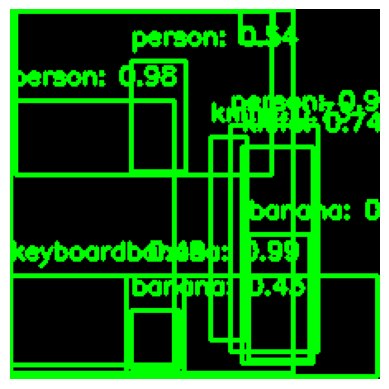

Frame 629, Label: 47, Score: 0.9944494962692261
Frame 629, Label: 1, Score: 0.9791072607040405
Frame 629, Label: 1, Score: 0.9607962369918823
Frame 629, Label: 1, Score: 0.9056896567344666
Frame 629, Label: 44, Score: 0.7429555058479309
Frame 629, Label: 44, Score: 0.7258839011192322
Frame 629, Label: 1, Score: 0.5418533682823181
Frame 629, Label: 67, Score: 0.4877409338951111
Frame 629, Label: 47, Score: 0.44824397563934326
Frame 629, Label: 1, Score: 0.43045029044151306
Frame 629, Label: 47, Score: 0.4269925057888031
Frame 629, Label: 1, Score: 0.36589714884757996


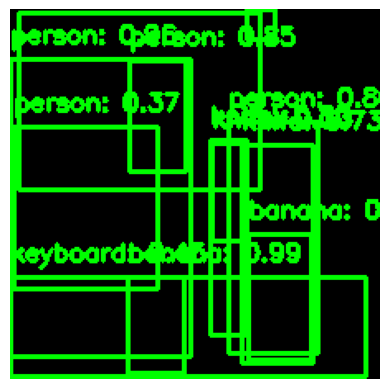

Frame 630, Label: 47, Score: 0.9878910779953003
Frame 630, Label: 1, Score: 0.9612060785293579
Frame 630, Label: 1, Score: 0.9432331323623657
Frame 630, Label: 1, Score: 0.8545597195625305
Frame 630, Label: 1, Score: 0.8028370141983032
Frame 630, Label: 44, Score: 0.8024302124977112
Frame 630, Label: 44, Score: 0.7275888323783875
Frame 630, Label: 1, Score: 0.47437170147895813
Frame 630, Label: 67, Score: 0.4500308036804199
Frame 630, Label: 47, Score: 0.36871200799942017
Frame 630, Label: 1, Score: 0.3657587170600891
Frame 630, Label: 44, Score: 0.32532092928886414


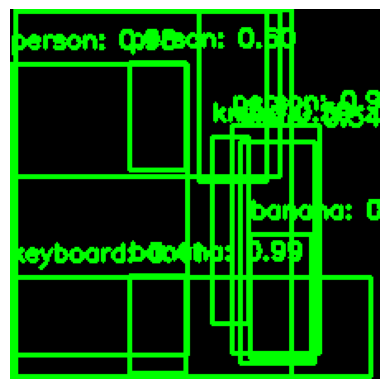

Frame 631, Label: 47, Score: 0.9942376613616943
Frame 631, Label: 1, Score: 0.9807863831520081
Frame 631, Label: 1, Score: 0.9740288257598877
Frame 631, Label: 1, Score: 0.9629625082015991
Frame 631, Label: 1, Score: 0.5995500683784485
Frame 631, Label: 44, Score: 0.5372290015220642
Frame 631, Label: 67, Score: 0.4068421721458435
Frame 631, Label: 44, Score: 0.3929450213909149
Frame 631, Label: 47, Score: 0.3866850435733795
Frame 631, Label: 1, Score: 0.3778529465198517
Frame 631, Label: 1, Score: 0.34325969219207764


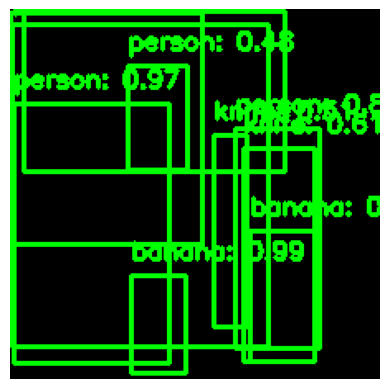

Frame 632, Label: 47, Score: 0.9905851483345032
Frame 632, Label: 1, Score: 0.9731591939926147
Frame 632, Label: 1, Score: 0.960629940032959
Frame 632, Label: 1, Score: 0.9565429091453552
Frame 632, Label: 1, Score: 0.8374947905540466
Frame 632, Label: 44, Score: 0.6095930337905884
Frame 632, Label: 44, Score: 0.5130713582038879
Frame 632, Label: 1, Score: 0.47583332657814026
Frame 632, Label: 1, Score: 0.38243046402931213
Frame 632, Label: 47, Score: 0.3010352849960327


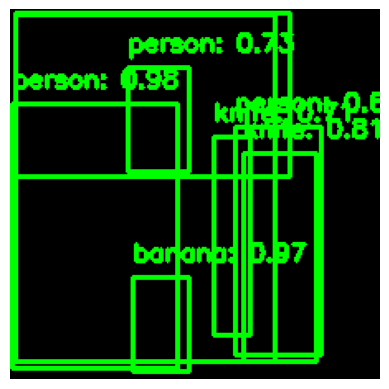

Frame 633, Label: 1, Score: 0.9805557131767273
Frame 633, Label: 1, Score: 0.9799173474311829
Frame 633, Label: 47, Score: 0.9735512137413025
Frame 633, Label: 1, Score: 0.8489571213722229
Frame 633, Label: 44, Score: 0.8065140843391418
Frame 633, Label: 1, Score: 0.7317647933959961
Frame 633, Label: 44, Score: 0.711894154548645
Frame 633, Label: 1, Score: 0.6409313082695007


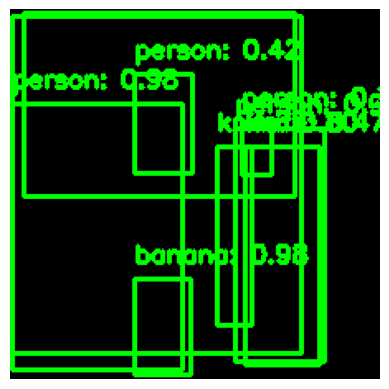

Frame 634, Label: 47, Score: 0.9828314781188965
Frame 634, Label: 1, Score: 0.9824819564819336
Frame 634, Label: 1, Score: 0.9761705994606018
Frame 634, Label: 1, Score: 0.955221951007843
Frame 634, Label: 1, Score: 0.9416581392288208
Frame 634, Label: 44, Score: 0.7956054210662842
Frame 634, Label: 44, Score: 0.4706721603870392
Frame 634, Label: 1, Score: 0.415010929107666
Frame 634, Label: 1, Score: 0.31797778606414795


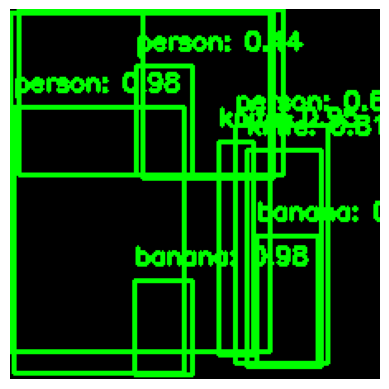

Frame 635, Label: 1, Score: 0.9784466624259949
Frame 635, Label: 47, Score: 0.9769187569618225
Frame 635, Label: 44, Score: 0.9452680945396423
Frame 635, Label: 1, Score: 0.9397369623184204
Frame 635, Label: 1, Score: 0.9331267476081848
Frame 635, Label: 44, Score: 0.8097105026245117
Frame 635, Label: 1, Score: 0.6606122851371765
Frame 635, Label: 1, Score: 0.4448620676994324
Frame 635, Label: 47, Score: 0.35148489475250244
Frame 635, Label: 1, Score: 0.3447948694229126


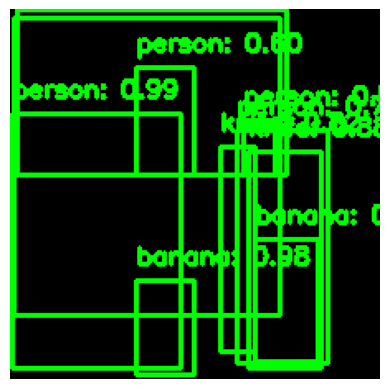

Frame 636, Label: 1, Score: 0.9867625832557678
Frame 636, Label: 47, Score: 0.9808891415596008
Frame 636, Label: 1, Score: 0.9698852300643921
Frame 636, Label: 44, Score: 0.8821907639503479
Frame 636, Label: 44, Score: 0.8233507871627808
Frame 636, Label: 1, Score: 0.727922260761261
Frame 636, Label: 1, Score: 0.6815462112426758
Frame 636, Label: 1, Score: 0.598332405090332
Frame 636, Label: 1, Score: 0.5842169523239136
Frame 636, Label: 47, Score: 0.45072710514068604


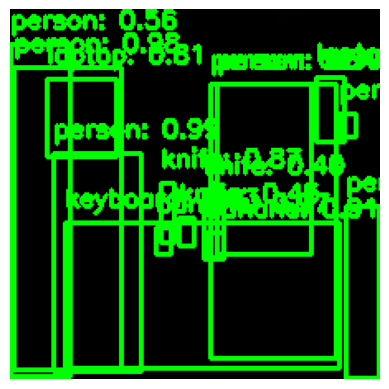

Frame 637, Label: 1, Score: 0.9944049119949341
Frame 637, Label: 1, Score: 0.9904876351356506
Frame 637, Label: 1, Score: 0.980587363243103
Frame 637, Label: 47, Score: 0.9724941253662109
Frame 637, Label: 67, Score: 0.9338959455490112
Frame 637, Label: 1, Score: 0.9238249659538269
Frame 637, Label: 47, Score: 0.906977117061615
Frame 637, Label: 44, Score: 0.8686975240707397
Frame 637, Label: 64, Score: 0.80926913022995
Frame 637, Label: 64, Score: 0.7410520315170288
Frame 637, Label: 1, Score: 0.6429190635681152
Frame 637, Label: 1, Score: 0.562961757183075
Frame 637, Label: 44, Score: 0.45334041118621826
Frame 637, Label: 1, Score: 0.41850391030311584
Frame 637, Label: 44, Score: 0.4043292701244354


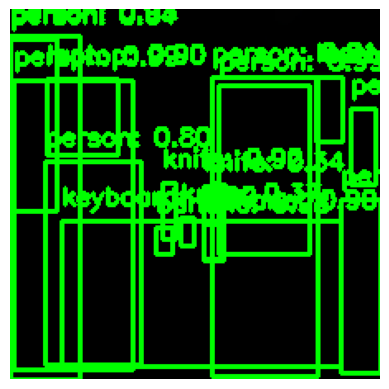

Frame 638, Label: 1, Score: 0.9922520518302917
Frame 638, Label: 1, Score: 0.9872897267341614
Frame 638, Label: 47, Score: 0.9825137257575989
Frame 638, Label: 1, Score: 0.9330829381942749
Frame 638, Label: 44, Score: 0.9224358797073364
Frame 638, Label: 67, Score: 0.9176090955734253
Frame 638, Label: 64, Score: 0.8977633118629456
Frame 638, Label: 47, Score: 0.89556485414505
Frame 638, Label: 1, Score: 0.8125774264335632
Frame 638, Label: 1, Score: 0.8118084073066711
Frame 638, Label: 1, Score: 0.8003217577934265
Frame 638, Label: 64, Score: 0.6696621179580688
Frame 638, Label: 1, Score: 0.6449107527732849
Frame 638, Label: 1, Score: 0.5633227229118347
Frame 638, Label: 44, Score: 0.3729512393474579
Frame 638, Label: 44, Score: 0.34343966841697693


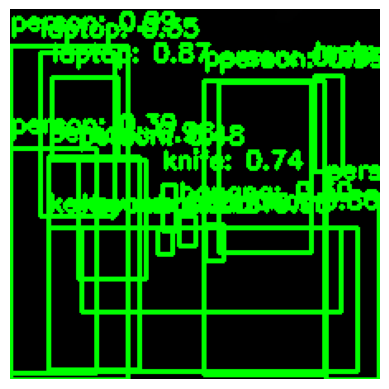

Frame 639, Label: 1, Score: 0.993362545967102
Frame 639, Label: 1, Score: 0.9874825477600098
Frame 639, Label: 1, Score: 0.9846969842910767
Frame 639, Label: 47, Score: 0.9785215854644775
Frame 639, Label: 1, Score: 0.9235684871673584
Frame 639, Label: 67, Score: 0.914801299571991
Frame 639, Label: 64, Score: 0.8690789341926575
Frame 639, Label: 47, Score: 0.856631338596344
Frame 639, Label: 44, Score: 0.7356204986572266
Frame 639, Label: 1, Score: 0.6637057065963745
Frame 639, Label: 67, Score: 0.572890043258667
Frame 639, Label: 1, Score: 0.4791215658187866
Frame 639, Label: 64, Score: 0.41377583146095276
Frame 639, Label: 1, Score: 0.3871201276779175
Frame 639, Label: 64, Score: 0.3539794087409973
Frame 639, Label: 47, Score: 0.30333825945854187


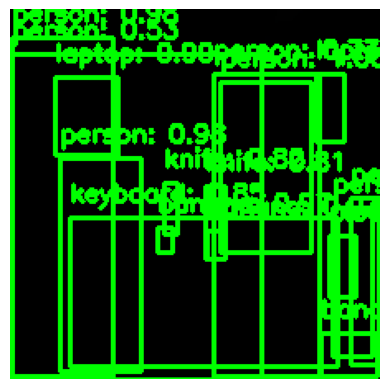

Frame 640, Label: 1, Score: 0.9955185651779175
Frame 640, Label: 1, Score: 0.9843947887420654
Frame 640, Label: 1, Score: 0.9793829321861267
Frame 640, Label: 47, Score: 0.9743123054504395
Frame 640, Label: 1, Score: 0.9390215277671814
Frame 640, Label: 47, Score: 0.9293484687805176
Frame 640, Label: 64, Score: 0.9027801752090454
Frame 640, Label: 67, Score: 0.854843020439148
Frame 640, Label: 44, Score: 0.8235649466514587
Frame 640, Label: 44, Score: 0.8130372762680054
Frame 640, Label: 1, Score: 0.7700127363204956
Frame 640, Label: 1, Score: 0.5267943739891052
Frame 640, Label: 64, Score: 0.5028413534164429
Frame 640, Label: 75, Score: 0.4317761957645416
Frame 640, Label: 47, Score: 0.3442077934741974
Frame 640, Label: 1, Score: 0.3215440809726715


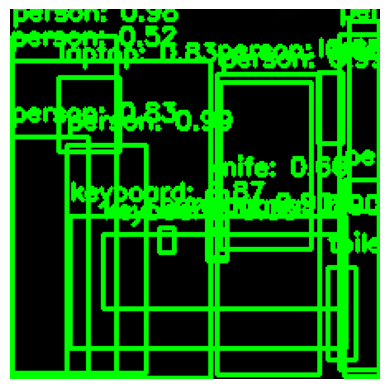

Frame 641, Label: 1, Score: 0.9947562217712402
Frame 641, Label: 1, Score: 0.9906474947929382
Frame 641, Label: 1, Score: 0.9781133532524109
Frame 641, Label: 1, Score: 0.9059568643569946
Frame 641, Label: 47, Score: 0.9032202363014221
Frame 641, Label: 47, Score: 0.9016607403755188
Frame 641, Label: 67, Score: 0.8662819862365723
Frame 641, Label: 1, Score: 0.8448284864425659
Frame 641, Label: 64, Score: 0.8299530744552612
Frame 641, Label: 1, Score: 0.8278570175170898
Frame 641, Label: 62, Score: 0.7252823710441589
Frame 641, Label: 44, Score: 0.6631639003753662
Frame 641, Label: 1, Score: 0.6490259766578674
Frame 641, Label: 64, Score: 0.6351532936096191
Frame 641, Label: 1, Score: 0.522302508354187
Frame 641, Label: 1, Score: 0.4156367778778076
Frame 641, Label: 67, Score: 0.34831246733665466


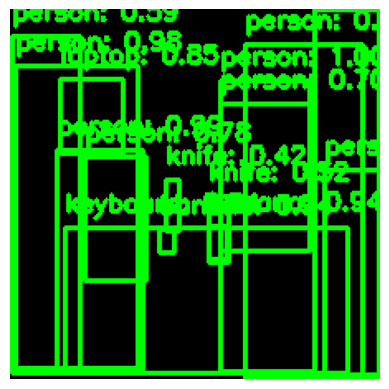

Frame 642, Label: 1, Score: 0.9960468411445618
Frame 642, Label: 1, Score: 0.9863799214363098
Frame 642, Label: 1, Score: 0.9844756722450256
Frame 642, Label: 1, Score: 0.9710075259208679
Frame 642, Label: 47, Score: 0.9390987157821655
Frame 642, Label: 47, Score: 0.9374686479568481
Frame 642, Label: 64, Score: 0.8528417944908142
Frame 642, Label: 67, Score: 0.8395159840583801
Frame 642, Label: 1, Score: 0.7782031297683716
Frame 642, Label: 1, Score: 0.7022134065628052
Frame 642, Label: 1, Score: 0.5868585705757141
Frame 642, Label: 44, Score: 0.5227479934692383
Frame 642, Label: 1, Score: 0.47221213579177856
Frame 642, Label: 44, Score: 0.4211600422859192
Frame 642, Label: 1, Score: 0.37686169147491455


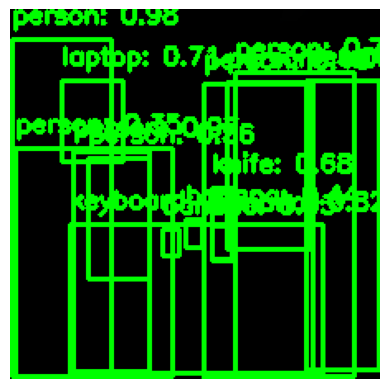

Frame 643, Label: 1, Score: 0.9953163862228394
Frame 643, Label: 1, Score: 0.9811943173408508
Frame 643, Label: 1, Score: 0.9691888689994812
Frame 643, Label: 1, Score: 0.95316481590271
Frame 643, Label: 47, Score: 0.9308307766914368
Frame 643, Label: 47, Score: 0.8185703754425049
Frame 643, Label: 1, Score: 0.7796076536178589
Frame 643, Label: 64, Score: 0.7089457511901855
Frame 643, Label: 67, Score: 0.6942921280860901
Frame 643, Label: 44, Score: 0.6811031699180603
Frame 643, Label: 1, Score: 0.5551893711090088
Frame 643, Label: 47, Score: 0.4421496093273163
Frame 643, Label: 1, Score: 0.3980238139629364
Frame 643, Label: 1, Score: 0.35495224595069885


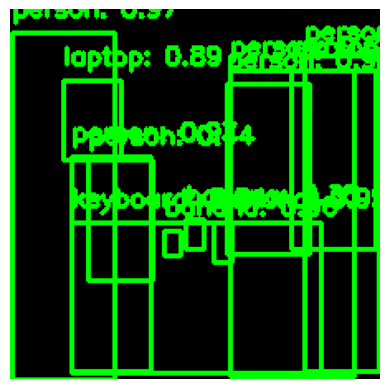

Frame 644, Label: 1, Score: 0.9868796467781067
Frame 644, Label: 1, Score: 0.9741759896278381
Frame 644, Label: 1, Score: 0.9716913104057312
Frame 644, Label: 47, Score: 0.9559061527252197
Frame 644, Label: 47, Score: 0.9508174657821655
Frame 644, Label: 64, Score: 0.8942650556564331
Frame 644, Label: 67, Score: 0.838050127029419
Frame 644, Label: 1, Score: 0.8345489501953125
Frame 644, Label: 1, Score: 0.8032443523406982
Frame 644, Label: 1, Score: 0.70799720287323
Frame 644, Label: 1, Score: 0.436451256275177
Frame 644, Label: 47, Score: 0.35489970445632935


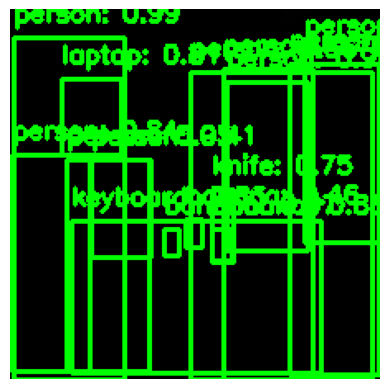

Frame 645, Label: 1, Score: 0.9884384274482727
Frame 645, Label: 1, Score: 0.9853610396385193
Frame 645, Label: 47, Score: 0.9700635671615601
Frame 645, Label: 1, Score: 0.9467688798904419
Frame 645, Label: 1, Score: 0.9424172639846802
Frame 645, Label: 47, Score: 0.85849928855896
Frame 645, Label: 1, Score: 0.8377941846847534
Frame 645, Label: 67, Score: 0.8298019170761108
Frame 645, Label: 64, Score: 0.8100178241729736
Frame 645, Label: 1, Score: 0.7762405872344971
Frame 645, Label: 44, Score: 0.75095134973526
Frame 645, Label: 1, Score: 0.5554747581481934
Frame 645, Label: 1, Score: 0.5236421823501587
Frame 645, Label: 47, Score: 0.4624820351600647
Frame 645, Label: 1, Score: 0.41070881485939026


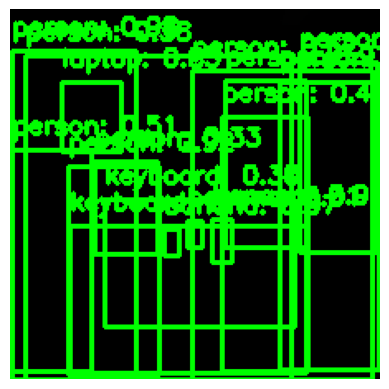

Frame 646, Label: 1, Score: 0.9824270009994507
Frame 646, Label: 1, Score: 0.9701598286628723
Frame 646, Label: 47, Score: 0.9681704044342041
Frame 646, Label: 1, Score: 0.9642701148986816
Frame 646, Label: 47, Score: 0.9417092800140381
Frame 646, Label: 1, Score: 0.9222261905670166
Frame 646, Label: 64, Score: 0.8482807278633118
Frame 646, Label: 67, Score: 0.7666829824447632
Frame 646, Label: 1, Score: 0.6219169497489929
Frame 646, Label: 1, Score: 0.5284074544906616
Frame 646, Label: 1, Score: 0.5082249045372009
Frame 646, Label: 1, Score: 0.426175981760025
Frame 646, Label: 1, Score: 0.3793903887271881
Frame 646, Label: 1, Score: 0.3328867256641388
Frame 646, Label: 47, Score: 0.3121744990348816
Frame 646, Label: 67, Score: 0.30255547165870667


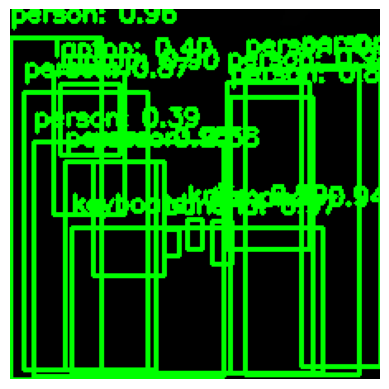

Frame 647, Label: 1, Score: 0.9776655435562134
Frame 647, Label: 47, Score: 0.9739797711372375
Frame 647, Label: 1, Score: 0.9644792079925537
Frame 647, Label: 1, Score: 0.9546383023262024
Frame 647, Label: 1, Score: 0.9458626508712769
Frame 647, Label: 47, Score: 0.9425137639045715
Frame 647, Label: 64, Score: 0.8986570835113525
Frame 647, Label: 1, Score: 0.8720054030418396
Frame 647, Label: 1, Score: 0.836444616317749
Frame 647, Label: 1, Score: 0.8328127264976501
Frame 647, Label: 67, Score: 0.7439453601837158
Frame 647, Label: 44, Score: 0.5867357850074768
Frame 647, Label: 64, Score: 0.39730072021484375
Frame 647, Label: 1, Score: 0.3897848129272461
Frame 647, Label: 1, Score: 0.37536710500717163


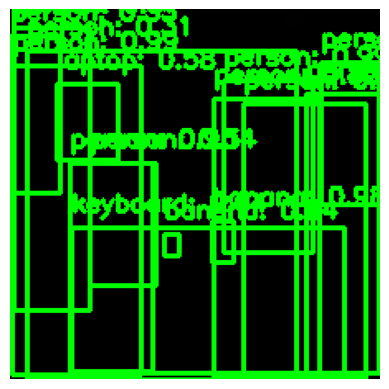

Frame 648, Label: 1, Score: 0.9915124773979187
Frame 648, Label: 1, Score: 0.9850248098373413
Frame 648, Label: 47, Score: 0.9763588905334473
Frame 648, Label: 1, Score: 0.9727046489715576
Frame 648, Label: 1, Score: 0.9471853971481323
Frame 648, Label: 47, Score: 0.9434573650360107
Frame 648, Label: 1, Score: 0.8458254933357239
Frame 648, Label: 67, Score: 0.6403746604919434
Frame 648, Label: 1, Score: 0.6237995624542236
Frame 648, Label: 1, Score: 0.5849535465240479
Frame 648, Label: 64, Score: 0.58376544713974
Frame 648, Label: 1, Score: 0.372069776058197
Frame 648, Label: 1, Score: 0.3544533848762512
Frame 648, Label: 1, Score: 0.33750930428504944
Frame 648, Label: 1, Score: 0.31048208475112915


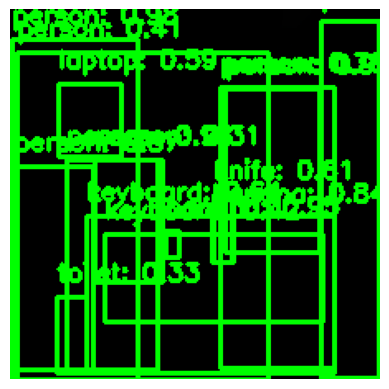

Frame 649, Label: 1, Score: 0.990959644317627
Frame 649, Label: 1, Score: 0.9832972288131714
Frame 649, Label: 1, Score: 0.9789634943008423
Frame 649, Label: 47, Score: 0.9547393321990967
Frame 649, Label: 1, Score: 0.9543262720108032
Frame 649, Label: 47, Score: 0.8395565152168274
Frame 649, Label: 1, Score: 0.7758920192718506
Frame 649, Label: 67, Score: 0.6447558999061584
Frame 649, Label: 44, Score: 0.612836480140686
Frame 649, Label: 64, Score: 0.594423234462738
Frame 649, Label: 67, Score: 0.4246567189693451
Frame 649, Label: 1, Score: 0.41010555624961853
Frame 649, Label: 1, Score: 0.3721355199813843
Frame 649, Label: 62, Score: 0.3285847306251526
Frame 649, Label: 1, Score: 0.30527862906455994


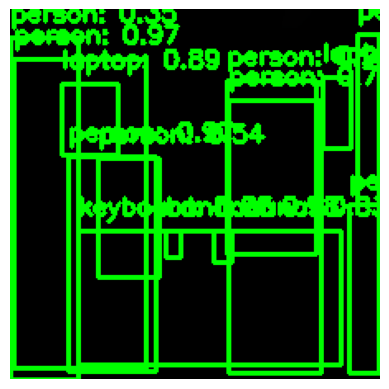

Frame 650, Label: 1, Score: 0.9906138181686401
Frame 650, Label: 47, Score: 0.9786933660507202
Frame 650, Label: 1, Score: 0.9715112447738647
Frame 650, Label: 1, Score: 0.969028890132904
Frame 650, Label: 64, Score: 0.8892924189567566
Frame 650, Label: 1, Score: 0.8495573997497559
Frame 650, Label: 67, Score: 0.8481888175010681
Frame 650, Label: 47, Score: 0.8304246664047241
Frame 650, Label: 1, Score: 0.7131786346435547
Frame 650, Label: 64, Score: 0.5531536936759949
Frame 650, Label: 1, Score: 0.5393415093421936
Frame 650, Label: 1, Score: 0.34781381487846375
Frame 650, Label: 1, Score: 0.32652920484542847


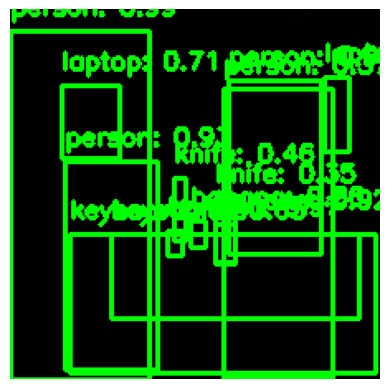

Frame 651, Label: 1, Score: 0.9937461614608765
Frame 651, Label: 1, Score: 0.993218719959259
Frame 651, Label: 47, Score: 0.9659527540206909
Frame 651, Label: 1, Score: 0.9264978766441345
Frame 651, Label: 47, Score: 0.9201708436012268
Frame 651, Label: 67, Score: 0.8988245129585266
Frame 651, Label: 47, Score: 0.8584478497505188
Frame 651, Label: 64, Score: 0.7076689600944519
Frame 651, Label: 67, Score: 0.6453689336776733
Frame 651, Label: 44, Score: 0.4578620493412018
Frame 651, Label: 1, Score: 0.3739847242832184
Frame 651, Label: 44, Score: 0.34846508502960205
Frame 651, Label: 64, Score: 0.3364798426628113


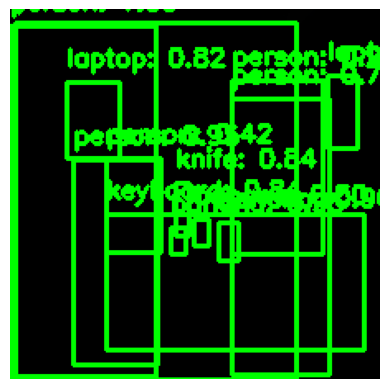

Frame 652, Label: 1, Score: 0.9951344132423401
Frame 652, Label: 1, Score: 0.9941686391830444
Frame 652, Label: 47, Score: 0.9557531476020813
Frame 652, Label: 1, Score: 0.9475544691085815
Frame 652, Label: 47, Score: 0.9472867846488953
Frame 652, Label: 67, Score: 0.8430663347244263
Frame 652, Label: 44, Score: 0.8387483358383179
Frame 652, Label: 64, Score: 0.8199794888496399
Frame 652, Label: 1, Score: 0.7934490442276001
Frame 652, Label: 47, Score: 0.5018317699432373
Frame 652, Label: 1, Score: 0.4236263334751129
Frame 652, Label: 64, Score: 0.3557249903678894
Frame 652, Label: 1, Score: 0.309935599565506


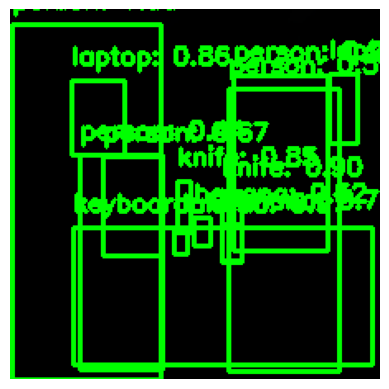

Frame 653, Label: 1, Score: 0.9971168041229248
Frame 653, Label: 1, Score: 0.9949442744255066
Frame 653, Label: 47, Score: 0.9683405160903931
Frame 653, Label: 67, Score: 0.9014569520950317
Frame 653, Label: 44, Score: 0.9009127020835876
Frame 653, Label: 64, Score: 0.8574858903884888
Frame 653, Label: 44, Score: 0.8517889380455017
Frame 653, Label: 64, Score: 0.7954573035240173
Frame 653, Label: 47, Score: 0.7545130252838135
Frame 653, Label: 1, Score: 0.6725824475288391
Frame 653, Label: 1, Score: 0.5884890556335449
Frame 653, Label: 47, Score: 0.5232040882110596
Frame 653, Label: 1, Score: 0.4379638433456421


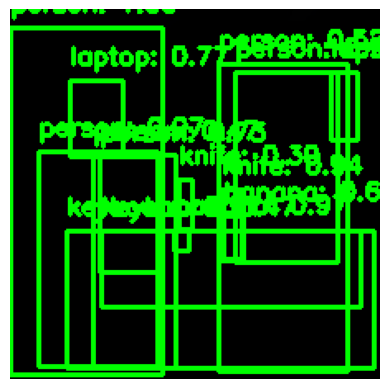

Frame 654, Label: 1, Score: 0.9955337047576904
Frame 654, Label: 1, Score: 0.9881299734115601
Frame 654, Label: 47, Score: 0.9748666882514954
Frame 654, Label: 1, Score: 0.966937780380249
Frame 654, Label: 44, Score: 0.9373726844787598
Frame 654, Label: 67, Score: 0.9098575115203857
Frame 654, Label: 64, Score: 0.7848003506660461
Frame 654, Label: 64, Score: 0.7709965109825134
Frame 654, Label: 1, Score: 0.7312189936637878
Frame 654, Label: 47, Score: 0.6146523356437683
Frame 654, Label: 1, Score: 0.5159047842025757
Frame 654, Label: 67, Score: 0.4747229516506195
Frame 654, Label: 1, Score: 0.4665111303329468
Frame 654, Label: 44, Score: 0.30006781220436096


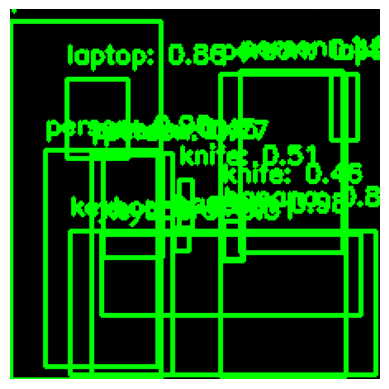

Frame 655, Label: 1, Score: 0.9972501397132874
Frame 655, Label: 1, Score: 0.9969630837440491
Frame 655, Label: 47, Score: 0.9812518358230591
Frame 655, Label: 1, Score: 0.9610090851783752
Frame 655, Label: 64, Score: 0.864330530166626
Frame 655, Label: 47, Score: 0.8264415860176086
Frame 655, Label: 1, Score: 0.7734577059745789
Frame 655, Label: 64, Score: 0.7708818316459656
Frame 655, Label: 67, Score: 0.647678017616272
Frame 655, Label: 44, Score: 0.5145197510719299
Frame 655, Label: 44, Score: 0.46482568979263306
Frame 655, Label: 1, Score: 0.4494244158267975
Frame 655, Label: 1, Score: 0.4475504457950592
Frame 655, Label: 67, Score: 0.308208167552948


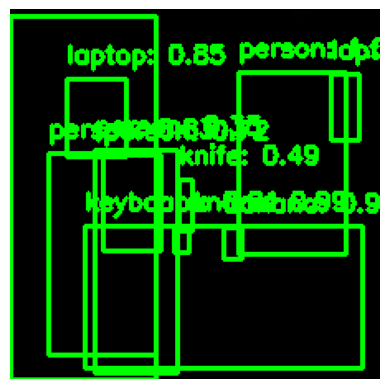

Frame 656, Label: 1, Score: 0.996860146522522
Frame 656, Label: 1, Score: 0.9958842396736145
Frame 656, Label: 47, Score: 0.9863090515136719
Frame 656, Label: 47, Score: 0.9506860971450806
Frame 656, Label: 64, Score: 0.8520234823226929
Frame 656, Label: 1, Score: 0.8325446844100952
Frame 656, Label: 67, Score: 0.810372531414032
Frame 656, Label: 64, Score: 0.7811493277549744
Frame 656, Label: 1, Score: 0.7248390316963196
Frame 656, Label: 44, Score: 0.4907500147819519
Frame 656, Label: 1, Score: 0.3312782645225525


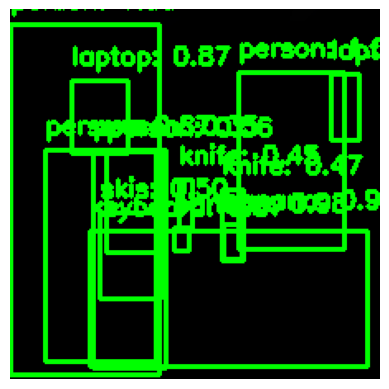

Frame 657, Label: 1, Score: 0.9983963370323181
Frame 657, Label: 1, Score: 0.9965941309928894
Frame 657, Label: 47, Score: 0.981715738773346
Frame 657, Label: 47, Score: 0.9283416271209717
Frame 657, Label: 64, Score: 0.8717285394668579
Frame 657, Label: 67, Score: 0.8673980236053467
Frame 657, Label: 1, Score: 0.8673769235610962
Frame 657, Label: 64, Score: 0.729762852191925
Frame 657, Label: 1, Score: 0.5585271716117859
Frame 657, Label: 31, Score: 0.4998320937156677
Frame 657, Label: 44, Score: 0.4654439687728882
Frame 657, Label: 44, Score: 0.45292407274246216
Frame 657, Label: 1, Score: 0.3520808815956116


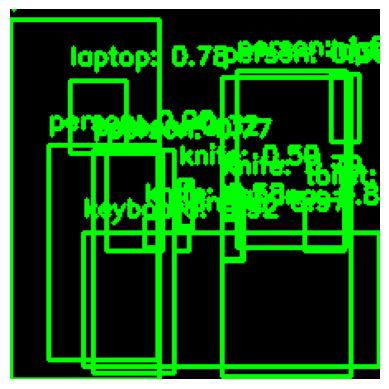

Frame 658, Label: 1, Score: 0.9975863695144653
Frame 658, Label: 1, Score: 0.9970263838768005
Frame 658, Label: 47, Score: 0.9740924835205078
Frame 658, Label: 67, Score: 0.9216258525848389
Frame 658, Label: 1, Score: 0.9036492109298706
Frame 658, Label: 47, Score: 0.8754959106445312
Frame 658, Label: 44, Score: 0.7854679822921753
Frame 658, Label: 64, Score: 0.7803374528884888
Frame 658, Label: 1, Score: 0.7714303731918335
Frame 658, Label: 64, Score: 0.7640728950500488
Frame 658, Label: 44, Score: 0.576952338218689
Frame 658, Label: 44, Score: 0.49555596709251404
Frame 658, Label: 1, Score: 0.3622656762599945
Frame 658, Label: 62, Score: 0.34634292125701904
Frame 658, Label: 1, Score: 0.32140493392944336


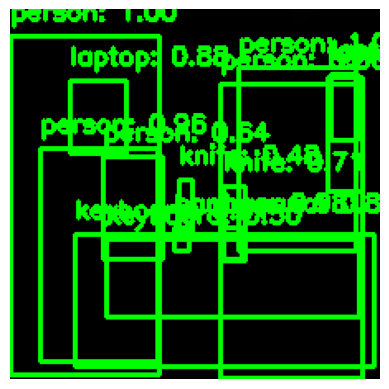

Frame 659, Label: 1, Score: 0.9977268576622009
Frame 659, Label: 1, Score: 0.9956092238426208
Frame 659, Label: 47, Score: 0.9849653244018555
Frame 659, Label: 1, Score: 0.9565228819847107
Frame 659, Label: 67, Score: 0.9123631715774536
Frame 659, Label: 64, Score: 0.8833388686180115
Frame 659, Label: 47, Score: 0.8098468780517578
Frame 659, Label: 44, Score: 0.7140776515007019
Frame 659, Label: 64, Score: 0.6565738320350647
Frame 659, Label: 1, Score: 0.6449686884880066
Frame 659, Label: 1, Score: 0.5639442801475525
Frame 659, Label: 67, Score: 0.4951170086860657
Frame 659, Label: 44, Score: 0.47792667150497437
Frame 659, Label: 64, Score: 0.3168703615665436


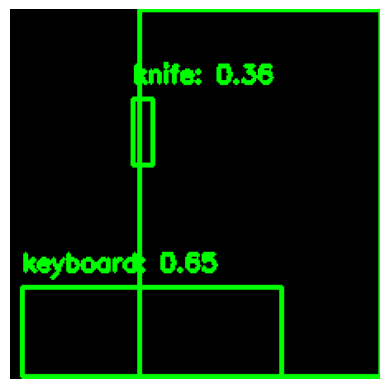

Frame 660, Label: 1, Score: 0.9955326318740845
Frame 660, Label: 67, Score: 0.650412917137146
Frame 660, Label: 44, Score: 0.3568614721298218


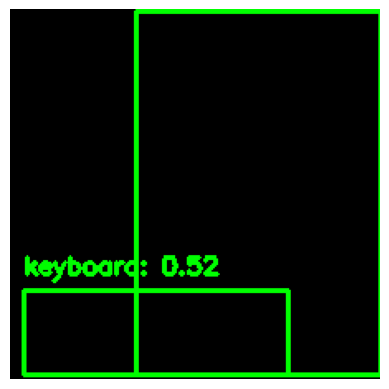

Frame 661, Label: 1, Score: 0.9958226680755615
Frame 661, Label: 67, Score: 0.5170870423316956


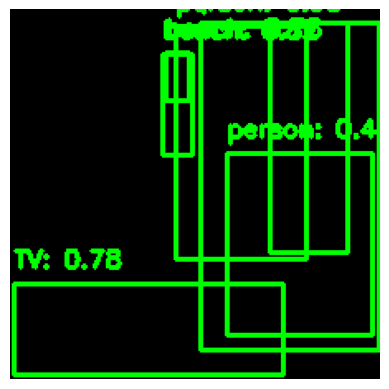

Frame 662, Label: 1, Score: 0.9497343897819519
Frame 662, Label: 1, Score: 0.9383657574653625
Frame 662, Label: 14, Score: 0.8219544887542725
Frame 662, Label: 14, Score: 0.7843573093414307
Frame 662, Label: 63, Score: 0.7830497622489929
Frame 662, Label: 1, Score: 0.4480121433734894
Frame 662, Label: 32, Score: 0.30437013506889343


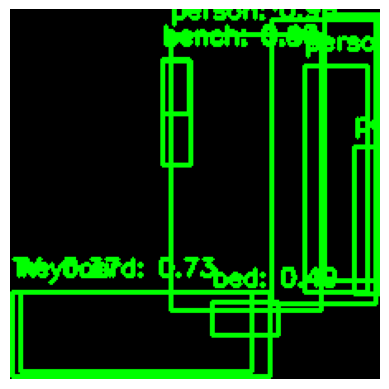

Frame 663, Label: 1, Score: 0.9853302240371704
Frame 663, Label: 1, Score: 0.9552070498466492
Frame 663, Label: 1, Score: 0.8461449146270752
Frame 663, Label: 14, Score: 0.8378424048423767
Frame 663, Label: 67, Score: 0.7329071164131165
Frame 663, Label: 1, Score: 0.5150519609451294
Frame 663, Label: 1, Score: 0.5148769021034241
Frame 663, Label: 14, Score: 0.4885399341583252
Frame 663, Label: 60, Score: 0.488063782453537
Frame 663, Label: 63, Score: 0.3671756386756897


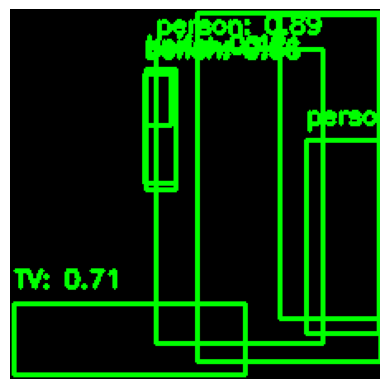

Frame 664, Label: 1, Score: 0.9869491457939148
Frame 664, Label: 1, Score: 0.9805600643157959
Frame 664, Label: 1, Score: 0.8860965967178345
Frame 664, Label: 63, Score: 0.7105222940444946
Frame 664, Label: 14, Score: 0.6641603708267212
Frame 664, Label: 1, Score: 0.629188597202301
Frame 664, Label: 44, Score: 0.4181131422519684
Frame 664, Label: 14, Score: 0.41486069560050964


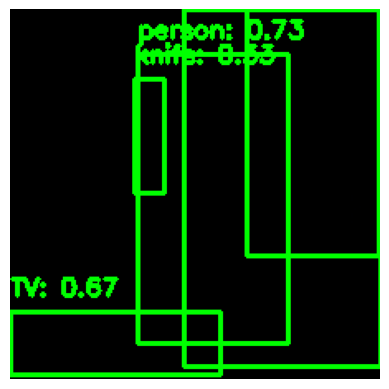

Frame 665, Label: 1, Score: 0.9712117910385132
Frame 665, Label: 1, Score: 0.7332451343536377
Frame 665, Label: 63, Score: 0.6697441935539246
Frame 665, Label: 1, Score: 0.3590114414691925
Frame 665, Label: 44, Score: 0.3311425447463989


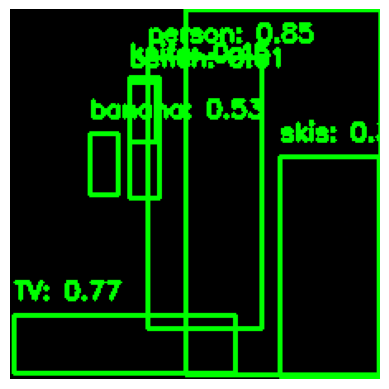

Frame 666, Label: 1, Score: 0.9899162650108337
Frame 666, Label: 1, Score: 0.8462581038475037
Frame 666, Label: 63, Score: 0.7666219472885132
Frame 666, Label: 14, Score: 0.6147406697273254
Frame 666, Label: 47, Score: 0.5268417596817017
Frame 666, Label: 44, Score: 0.45088669657707214
Frame 666, Label: 31, Score: 0.3696262538433075


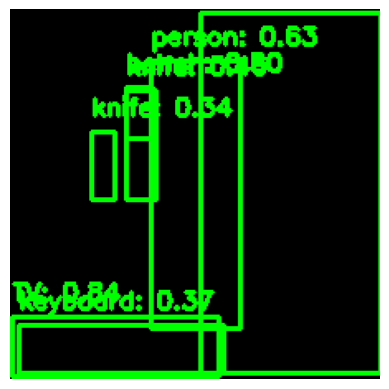

Frame 667, Label: 1, Score: 0.9883765578269958
Frame 667, Label: 63, Score: 0.8372232913970947
Frame 667, Label: 1, Score: 0.6282650828361511
Frame 667, Label: 14, Score: 0.5000936388969421
Frame 667, Label: 44, Score: 0.46223610639572144
Frame 667, Label: 67, Score: 0.365265429019928
Frame 667, Label: 44, Score: 0.34347009658813477


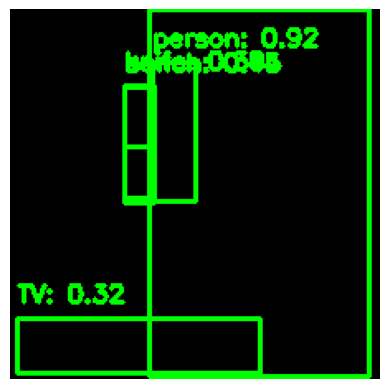

Frame 668, Label: 1, Score: 0.9944109320640564
Frame 668, Label: 1, Score: 0.9235630035400391
Frame 668, Label: 14, Score: 0.44958817958831787
Frame 668, Label: 14, Score: 0.44415217638015747
Frame 668, Label: 44, Score: 0.389659583568573
Frame 668, Label: 63, Score: 0.3220353126525879


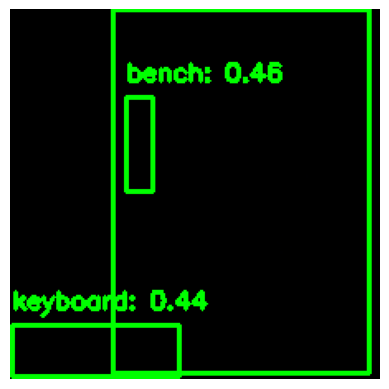

Frame 669, Label: 1, Score: 0.9979270696640015
Frame 669, Label: 14, Score: 0.4552687406539917
Frame 669, Label: 67, Score: 0.4439287781715393


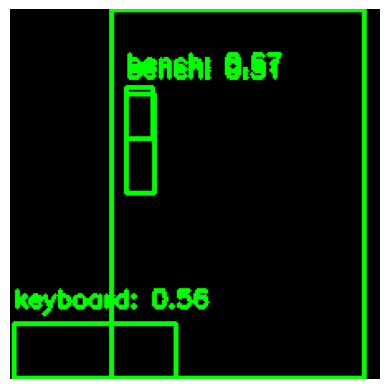

Frame 670, Label: 1, Score: 0.9908230304718018
Frame 670, Label: 14, Score: 0.6660763621330261
Frame 670, Label: 67, Score: 0.5570987462997437
Frame 670, Label: 14, Score: 0.506085216999054


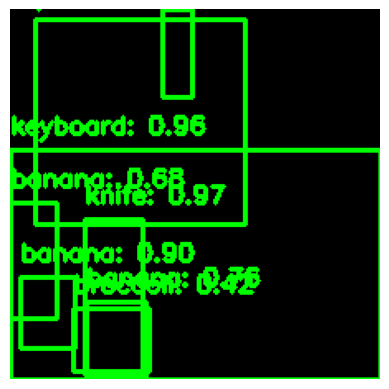

Frame 671, Label: 44, Score: 0.966478168964386
Frame 671, Label: 1, Score: 0.9651389122009277
Frame 671, Label: 67, Score: 0.957012414932251
Frame 671, Label: 47, Score: 0.8972775340080261
Frame 671, Label: 47, Score: 0.7607028484344482
Frame 671, Label: 47, Score: 0.6778774261474609
Frame 671, Label: 32, Score: 0.4651796519756317
Frame 671, Label: 51, Score: 0.4226040840148926


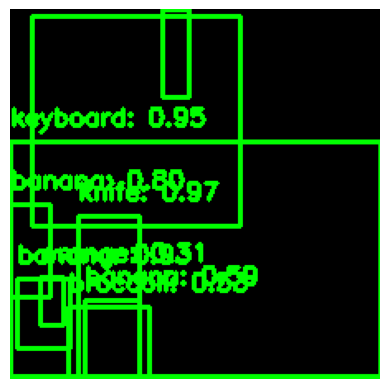

Frame 672, Label: 1, Score: 0.9882305860519409
Frame 672, Label: 44, Score: 0.9733254313468933
Frame 672, Label: 67, Score: 0.9465487003326416
Frame 672, Label: 47, Score: 0.9264447689056396
Frame 672, Label: 47, Score: 0.7950228452682495
Frame 672, Label: 47, Score: 0.5872570872306824
Frame 672, Label: 51, Score: 0.5339550375938416
Frame 672, Label: 32, Score: 0.4384700059890747
Frame 672, Label: 50, Score: 0.3084491193294525


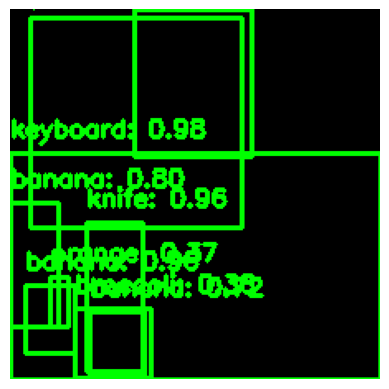

Frame 673, Label: 1, Score: 0.9792670011520386
Frame 673, Label: 67, Score: 0.9757570624351501
Frame 673, Label: 44, Score: 0.9619107246398926
Frame 673, Label: 47, Score: 0.9570407867431641
Frame 673, Label: 47, Score: 0.8036438226699829
Frame 673, Label: 47, Score: 0.7206197381019592
Frame 673, Label: 1, Score: 0.3856658935546875
Frame 673, Label: 50, Score: 0.36782675981521606
Frame 673, Label: 51, Score: 0.36401668190956116


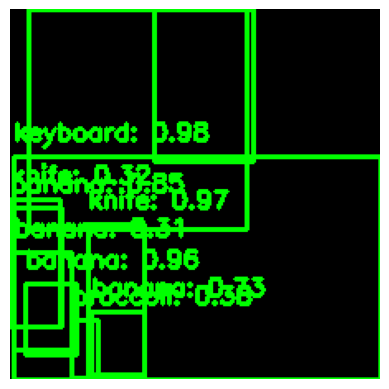

Frame 674, Label: 1, Score: 0.9767460823059082
Frame 674, Label: 67, Score: 0.9755222201347351
Frame 674, Label: 44, Score: 0.9730767011642456
Frame 674, Label: 47, Score: 0.9598928093910217
Frame 674, Label: 47, Score: 0.8523358106613159
Frame 674, Label: 47, Score: 0.7276921272277832
Frame 674, Label: 1, Score: 0.42284929752349854
Frame 674, Label: 51, Score: 0.38420596718788147
Frame 674, Label: 44, Score: 0.31616008281707764
Frame 674, Label: 47, Score: 0.3117939829826355


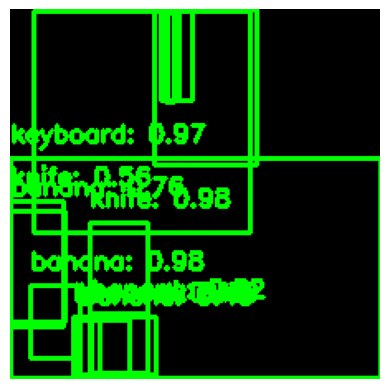

Frame 675, Label: 1, Score: 0.9834295511245728
Frame 675, Label: 44, Score: 0.9812470078468323
Frame 675, Label: 47, Score: 0.9803388118743896
Frame 675, Label: 67, Score: 0.9749106764793396
Frame 675, Label: 47, Score: 0.8216677904129028
Frame 675, Label: 32, Score: 0.8026177883148193
Frame 675, Label: 47, Score: 0.7577969431877136
Frame 675, Label: 44, Score: 0.5618005990982056
Frame 675, Label: 1, Score: 0.5090067386627197
Frame 675, Label: 32, Score: 0.4700382649898529
Frame 675, Label: 47, Score: 0.43996742367744446
Frame 675, Label: 47, Score: 0.40372952818870544
Frame 675, Label: 51, Score: 0.39478421211242676
Frame 675, Label: 32, Score: 0.3728634715080261


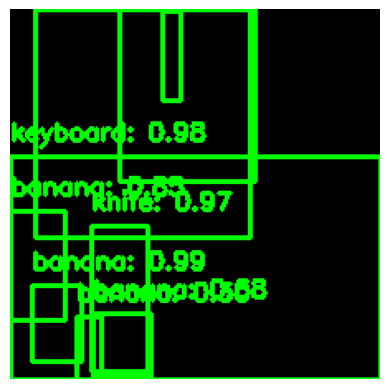

Frame 676, Label: 47, Score: 0.987541139125824
Frame 676, Label: 1, Score: 0.9851460456848145
Frame 676, Label: 67, Score: 0.9793640971183777
Frame 676, Label: 44, Score: 0.9666231274604797
Frame 676, Label: 47, Score: 0.8529543280601501
Frame 676, Label: 32, Score: 0.6860745549201965
Frame 676, Label: 47, Score: 0.6813144683837891
Frame 676, Label: 1, Score: 0.4505102038383484
Frame 676, Label: 47, Score: 0.30154260993003845


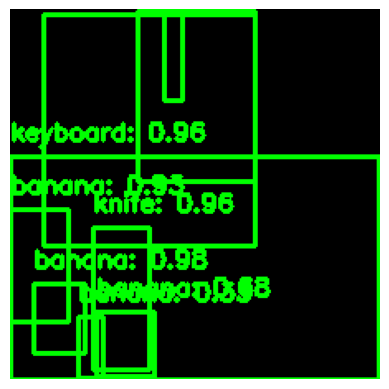

Frame 677, Label: 47, Score: 0.9797739386558533
Frame 677, Label: 67, Score: 0.9641304612159729
Frame 677, Label: 44, Score: 0.9559357762336731
Frame 677, Label: 47, Score: 0.9299476146697998
Frame 677, Label: 1, Score: 0.921461820602417
Frame 677, Label: 32, Score: 0.7497983574867249
Frame 677, Label: 47, Score: 0.6811607480049133
Frame 677, Label: 1, Score: 0.40514418482780457
Frame 677, Label: 47, Score: 0.33202826976776123


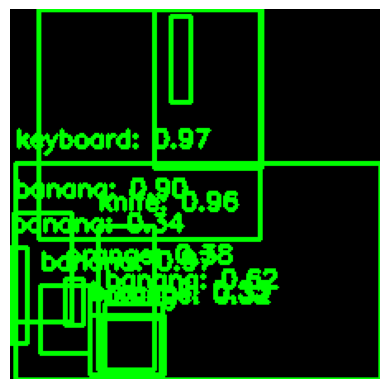

Frame 678, Label: 67, Score: 0.9708470702171326
Frame 678, Label: 47, Score: 0.9700896739959717
Frame 678, Label: 44, Score: 0.958686888217926
Frame 678, Label: 1, Score: 0.9484662413597107
Frame 678, Label: 47, Score: 0.9008886814117432
Frame 678, Label: 32, Score: 0.8577306866645813
Frame 678, Label: 47, Score: 0.6150565147399902
Frame 678, Label: 50, Score: 0.38127878308296204
Frame 678, Label: 1, Score: 0.358000785112381
Frame 678, Label: 47, Score: 0.3361293375492096
Frame 678, Label: 51, Score: 0.32949331402778625
Frame 678, Label: 50, Score: 0.31511327624320984


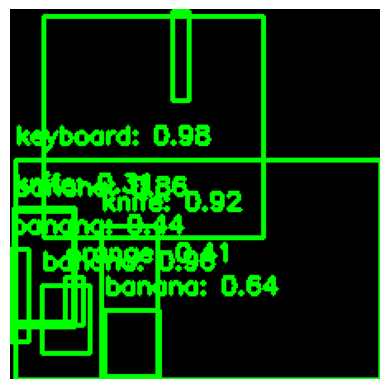

Frame 679, Label: 67, Score: 0.9778218865394592
Frame 679, Label: 1, Score: 0.9755744934082031
Frame 679, Label: 47, Score: 0.9555027484893799
Frame 679, Label: 44, Score: 0.9197404980659485
Frame 679, Label: 47, Score: 0.8647096753120422
Frame 679, Label: 32, Score: 0.7946508526802063
Frame 679, Label: 47, Score: 0.6416864395141602
Frame 679, Label: 47, Score: 0.4426884949207306
Frame 679, Label: 50, Score: 0.40597981214523315
Frame 679, Label: 44, Score: 0.311061292886734


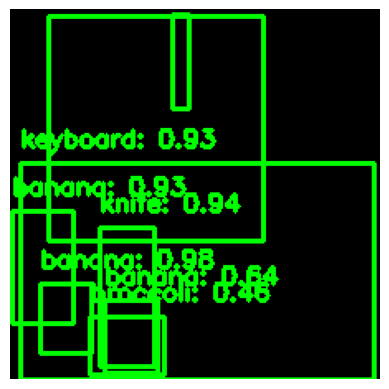

Frame 680, Label: 47, Score: 0.9807646870613098
Frame 680, Label: 1, Score: 0.9619710445404053
Frame 680, Label: 44, Score: 0.9437512755393982
Frame 680, Label: 47, Score: 0.9289002418518066
Frame 680, Label: 67, Score: 0.927944004535675
Frame 680, Label: 47, Score: 0.6412230730056763
Frame 680, Label: 32, Score: 0.5514451861381531
Frame 680, Label: 51, Score: 0.4555123448371887


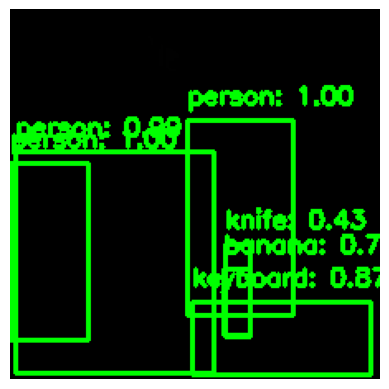

Frame 681, Label: 1, Score: 0.9976170063018799
Frame 681, Label: 1, Score: 0.9963446259498596
Frame 681, Label: 1, Score: 0.9870079159736633
Frame 681, Label: 67, Score: 0.8734631538391113
Frame 681, Label: 47, Score: 0.7508200407028198
Frame 681, Label: 44, Score: 0.428899347782135


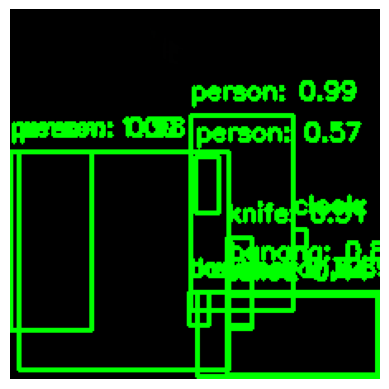

Frame 682, Label: 1, Score: 0.9976213574409485
Frame 682, Label: 1, Score: 0.9945618510246277
Frame 682, Label: 1, Score: 0.9847294688224792
Frame 682, Label: 67, Score: 0.8876491785049438
Frame 682, Label: 47, Score: 0.8163922429084778
Frame 682, Label: 1, Score: 0.5655084848403931
Frame 682, Label: 44, Score: 0.5138411521911621
Frame 682, Label: 62, Score: 0.4442981779575348
Frame 682, Label: 75, Score: 0.38639703392982483
Frame 682, Label: 47, Score: 0.3213033080101013


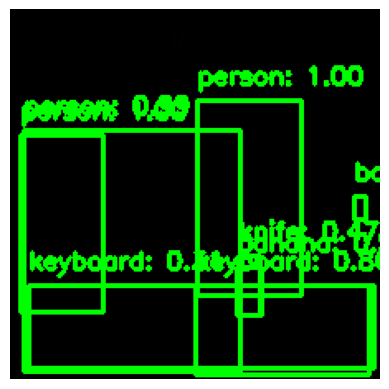

Frame 683, Label: 1, Score: 0.9965105652809143
Frame 683, Label: 1, Score: 0.9956619143486023
Frame 683, Label: 1, Score: 0.9882487058639526
Frame 683, Label: 67, Score: 0.8629862666130066
Frame 683, Label: 47, Score: 0.56242436170578
Frame 683, Label: 44, Score: 0.46884047985076904
Frame 683, Label: 47, Score: 0.3416888415813446
Frame 683, Label: 67, Score: 0.314897358417511


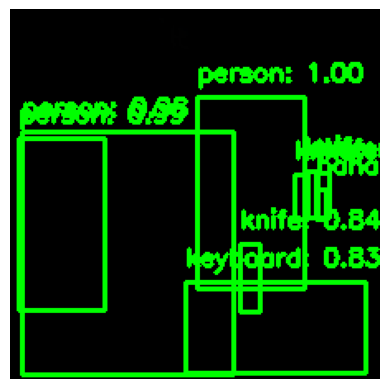

Frame 684, Label: 1, Score: 0.9964596629142761
Frame 684, Label: 1, Score: 0.9939775466918945
Frame 684, Label: 1, Score: 0.9820109009742737
Frame 684, Label: 44, Score: 0.8359154462814331
Frame 684, Label: 67, Score: 0.8319268822669983
Frame 684, Label: 44, Score: 0.7039930820465088
Frame 684, Label: 47, Score: 0.38430169224739075
Frame 684, Label: 44, Score: 0.38362574577331543
Frame 684, Label: 44, Score: 0.33897149562835693


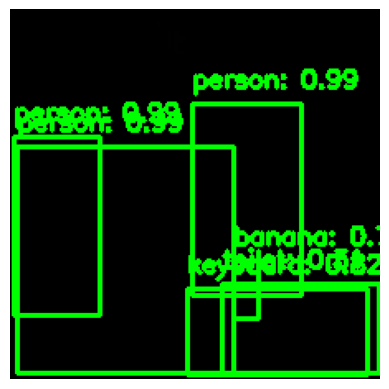

Frame 685, Label: 1, Score: 0.9945244789123535
Frame 685, Label: 1, Score: 0.9933404326438904
Frame 685, Label: 1, Score: 0.9919518232345581
Frame 685, Label: 67, Score: 0.8160749077796936
Frame 685, Label: 47, Score: 0.7821491956710815
Frame 685, Label: 62, Score: 0.306417852640152


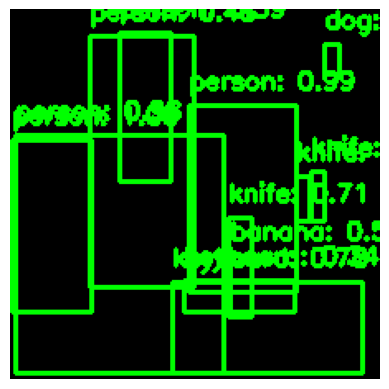

Frame 686, Label: 1, Score: 0.9951013922691345
Frame 686, Label: 1, Score: 0.993873119354248
Frame 686, Label: 1, Score: 0.9819871783256531
Frame 686, Label: 67, Score: 0.7835825681686401
Frame 686, Label: 44, Score: 0.7144947648048401
Frame 686, Label: 17, Score: 0.5805528163909912
Frame 686, Label: 47, Score: 0.5733042359352112
Frame 686, Label: 1, Score: 0.4756692945957184
Frame 686, Label: 44, Score: 0.4738394618034363
Frame 686, Label: 44, Score: 0.4450889527797699
Frame 686, Label: 1, Score: 0.3921205401420593
Frame 686, Label: 67, Score: 0.3398023545742035


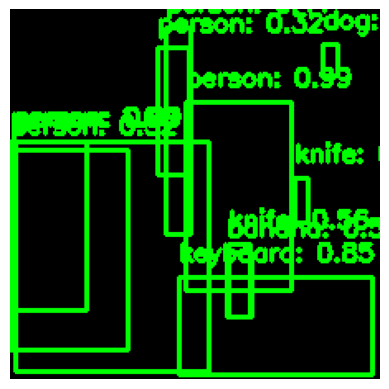

Frame 687, Label: 1, Score: 0.9966589212417603
Frame 687, Label: 1, Score: 0.994143545627594
Frame 687, Label: 1, Score: 0.9865031242370605
Frame 687, Label: 67, Score: 0.8523069620132446
Frame 687, Label: 17, Score: 0.8228073120117188
Frame 687, Label: 47, Score: 0.5789905786514282
Frame 687, Label: 44, Score: 0.5585538744926453
Frame 687, Label: 1, Score: 0.5207089185714722
Frame 687, Label: 1, Score: 0.4056955873966217
Frame 687, Label: 44, Score: 0.3581985533237457
Frame 687, Label: 1, Score: 0.3198419213294983


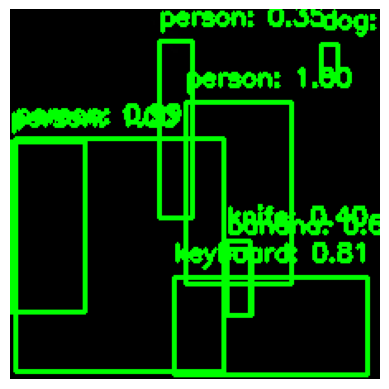

Frame 688, Label: 1, Score: 0.9969227910041809
Frame 688, Label: 1, Score: 0.9968683123588562
Frame 688, Label: 1, Score: 0.9855700135231018
Frame 688, Label: 17, Score: 0.8258179426193237
Frame 688, Label: 67, Score: 0.8053171634674072
Frame 688, Label: 47, Score: 0.6849877238273621
Frame 688, Label: 44, Score: 0.39807337522506714
Frame 688, Label: 1, Score: 0.34557440876960754


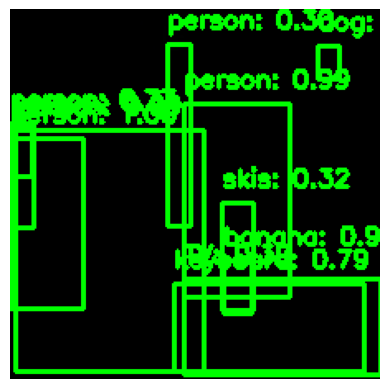

Frame 689, Label: 1, Score: 0.9955839514732361
Frame 689, Label: 1, Score: 0.9940827488899231
Frame 689, Label: 1, Score: 0.9884873628616333
Frame 689, Label: 47, Score: 0.9047382473945618
Frame 689, Label: 17, Score: 0.8180417418479919
Frame 689, Label: 67, Score: 0.7852050065994263
Frame 689, Label: 1, Score: 0.7708852887153625
Frame 689, Label: 1, Score: 0.34239739179611206
Frame 689, Label: 31, Score: 0.32184967398643494
Frame 689, Label: 1, Score: 0.30471566319465637
Frame 689, Label: 63, Score: 0.3006359934806824


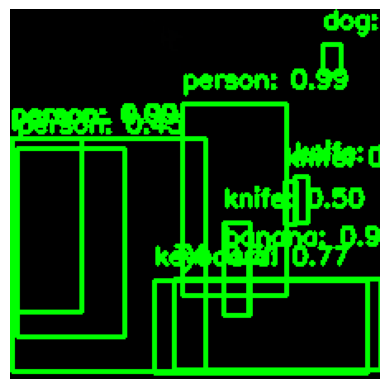

Frame 690, Label: 1, Score: 0.9952787160873413
Frame 690, Label: 1, Score: 0.9942452311515808
Frame 690, Label: 1, Score: 0.9912548065185547
Frame 690, Label: 47, Score: 0.9621229767799377
Frame 690, Label: 67, Score: 0.772504985332489
Frame 690, Label: 17, Score: 0.6871358156204224
Frame 690, Label: 44, Score: 0.4972304105758667
Frame 690, Label: 1, Score: 0.44505685567855835
Frame 690, Label: 44, Score: 0.33179768919944763
Frame 690, Label: 44, Score: 0.32316023111343384
Frame 690, Label: 63, Score: 0.31405794620513916


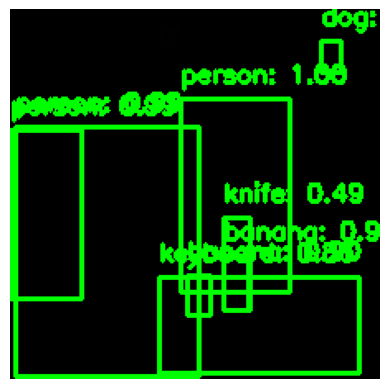

Frame 691, Label: 1, Score: 0.9964349269866943
Frame 691, Label: 1, Score: 0.9938963055610657
Frame 691, Label: 1, Score: 0.9903324246406555
Frame 691, Label: 47, Score: 0.9379996657371521
Frame 691, Label: 47, Score: 0.8957641124725342
Frame 691, Label: 67, Score: 0.8595569729804993
Frame 691, Label: 17, Score: 0.5937405228614807
Frame 691, Label: 44, Score: 0.4945266544818878


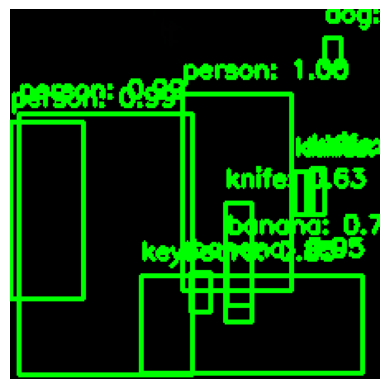

Frame 692, Label: 1, Score: 0.9974892139434814
Frame 692, Label: 1, Score: 0.993331253528595
Frame 692, Label: 1, Score: 0.9926210641860962
Frame 692, Label: 47, Score: 0.9547345638275146
Frame 692, Label: 67, Score: 0.8546382188796997
Frame 692, Label: 47, Score: 0.7245297431945801
Frame 692, Label: 44, Score: 0.6338921785354614
Frame 692, Label: 44, Score: 0.45172035694122314
Frame 692, Label: 17, Score: 0.4368070662021637
Frame 692, Label: 44, Score: 0.393008828163147
Frame 692, Label: 44, Score: 0.3539406359195709


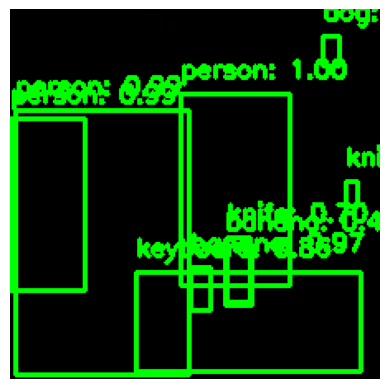

Frame 693, Label: 1, Score: 0.9972903728485107
Frame 693, Label: 1, Score: 0.9939553141593933
Frame 693, Label: 1, Score: 0.9908549785614014
Frame 693, Label: 47, Score: 0.973650336265564
Frame 693, Label: 67, Score: 0.8635025024414062
Frame 693, Label: 44, Score: 0.6959326267242432
Frame 693, Label: 17, Score: 0.48399972915649414
Frame 693, Label: 47, Score: 0.4135987460613251
Frame 693, Label: 44, Score: 0.38903388381004333


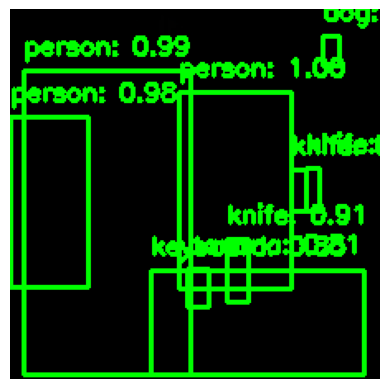

Frame 694, Label: 1, Score: 0.9964573979377747
Frame 694, Label: 1, Score: 0.9936552047729492
Frame 694, Label: 1, Score: 0.9797648787498474
Frame 694, Label: 44, Score: 0.9105329513549805
Frame 694, Label: 67, Score: 0.8544516563415527
Frame 694, Label: 47, Score: 0.808708667755127
Frame 694, Label: 17, Score: 0.400259792804718
Frame 694, Label: 44, Score: 0.3335222899913788
Frame 694, Label: 44, Score: 0.3297760784626007


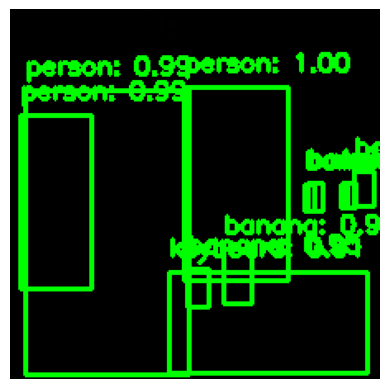

Frame 695, Label: 1, Score: 0.9974068999290466
Frame 695, Label: 1, Score: 0.9914292693138123
Frame 695, Label: 1, Score: 0.9856298565864563
Frame 695, Label: 47, Score: 0.9526767134666443
Frame 695, Label: 67, Score: 0.9121862649917603
Frame 695, Label: 47, Score: 0.903618335723877
Frame 695, Label: 44, Score: 0.6797366738319397
Frame 695, Label: 44, Score: 0.3921070396900177
Frame 695, Label: 47, Score: 0.33384037017822266
Frame 695, Label: 47, Score: 0.3204568028450012
Frame 695, Label: 47, Score: 0.3137688636779785


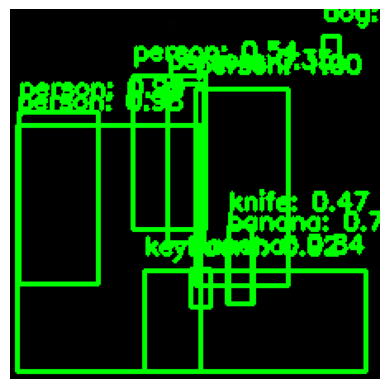

Frame 696, Label: 1, Score: 0.9957641363143921
Frame 696, Label: 1, Score: 0.9868948459625244
Frame 696, Label: 1, Score: 0.9814980626106262
Frame 696, Label: 67, Score: 0.9171789884567261
Frame 696, Label: 47, Score: 0.840212345123291
Frame 696, Label: 47, Score: 0.737535297870636
Frame 696, Label: 1, Score: 0.5387784242630005
Frame 696, Label: 44, Score: 0.4680626094341278
Frame 696, Label: 1, Score: 0.3509998321533203
Frame 696, Label: 17, Score: 0.30353987216949463


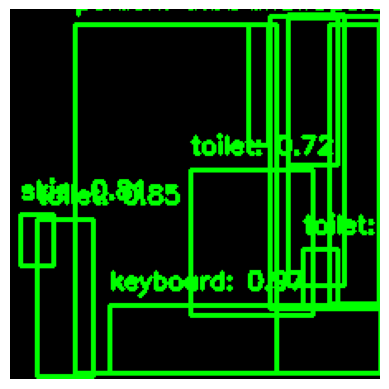

Frame 697, Label: 1, Score: 0.993340790271759
Frame 697, Label: 1, Score: 0.9794908165931702
Frame 697, Label: 67, Score: 0.9739088416099548
Frame 697, Label: 1, Score: 0.9576268196105957
Frame 697, Label: 62, Score: 0.847324013710022
Frame 697, Label: 31, Score: 0.8094629049301147
Frame 697, Label: 1, Score: 0.7426673173904419
Frame 697, Label: 62, Score: 0.7239356637001038
Frame 697, Label: 62, Score: 0.6211081743240356
Frame 697, Label: 32, Score: 0.3715980350971222
Frame 697, Label: 1, Score: 0.312519371509552


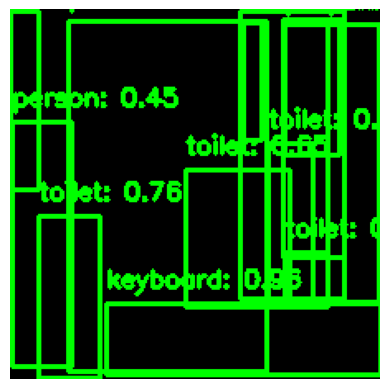

Frame 698, Label: 1, Score: 0.9931218028068542
Frame 698, Label: 1, Score: 0.981808602809906
Frame 698, Label: 67, Score: 0.9635955691337585
Frame 698, Label: 1, Score: 0.9402194619178772
Frame 698, Label: 62, Score: 0.7567358016967773
Frame 698, Label: 62, Score: 0.6962435841560364
Frame 698, Label: 1, Score: 0.6764528155326843
Frame 698, Label: 62, Score: 0.6526656150817871
Frame 698, Label: 1, Score: 0.45315417647361755
Frame 698, Label: 1, Score: 0.3834829330444336
Frame 698, Label: 32, Score: 0.3804711103439331
Frame 698, Label: 1, Score: 0.36303457617759705
Frame 698, Label: 62, Score: 0.3421829342842102


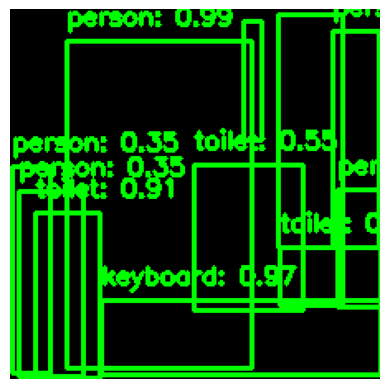

Frame 699, Label: 1, Score: 0.9916251301765442
Frame 699, Label: 1, Score: 0.979107677936554
Frame 699, Label: 67, Score: 0.965849757194519
Frame 699, Label: 1, Score: 0.9312430024147034
Frame 699, Label: 62, Score: 0.9147883057594299
Frame 699, Label: 62, Score: 0.6901910305023193
Frame 699, Label: 1, Score: 0.6441924571990967
Frame 699, Label: 62, Score: 0.5544978976249695
Frame 699, Label: 32, Score: 0.5087962746620178
Frame 699, Label: 1, Score: 0.35450538992881775
Frame 699, Label: 1, Score: 0.3476751744747162


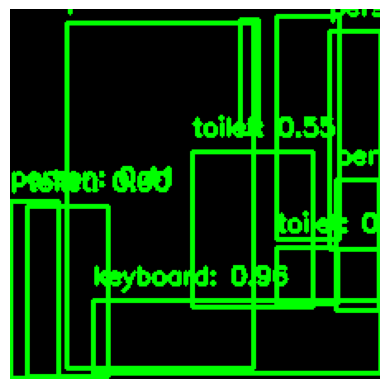

Frame 700, Label: 1, Score: 0.9862759113311768
Frame 700, Label: 1, Score: 0.9790270328521729
Frame 700, Label: 67, Score: 0.9568557739257812
Frame 700, Label: 62, Score: 0.8991652727127075
Frame 700, Label: 1, Score: 0.8988970518112183
Frame 700, Label: 1, Score: 0.7365846037864685
Frame 700, Label: 62, Score: 0.7058998346328735
Frame 700, Label: 32, Score: 0.6973738074302673
Frame 700, Label: 62, Score: 0.5499653220176697
Frame 700, Label: 1, Score: 0.41032013297080994


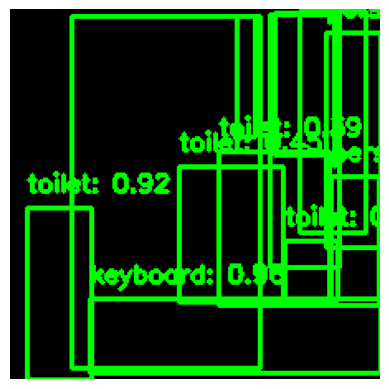

Frame 701, Label: 1, Score: 0.9942313432693481
Frame 701, Label: 1, Score: 0.972794234752655
Frame 701, Label: 1, Score: 0.965958297252655
Frame 701, Label: 67, Score: 0.9584963917732239
Frame 701, Label: 62, Score: 0.91978919506073
Frame 701, Label: 1, Score: 0.8138741254806519
Frame 701, Label: 1, Score: 0.8040188550949097
Frame 701, Label: 32, Score: 0.6379130482673645
Frame 701, Label: 62, Score: 0.6296129822731018
Frame 701, Label: 62, Score: 0.4529493749141693
Frame 701, Label: 62, Score: 0.3920358121395111
Frame 701, Label: 1, Score: 0.3528585731983185


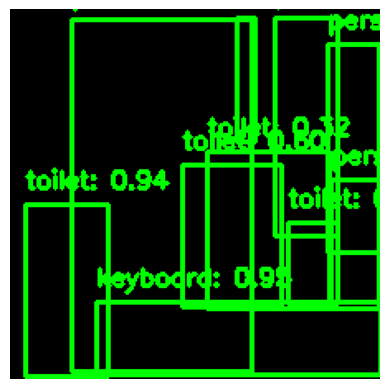

Frame 702, Label: 1, Score: 0.9930514097213745
Frame 702, Label: 1, Score: 0.9688431024551392
Frame 702, Label: 1, Score: 0.9668972492218018
Frame 702, Label: 67, Score: 0.9488524198532104
Frame 702, Label: 62, Score: 0.9405478239059448
Frame 702, Label: 1, Score: 0.6451388597488403
Frame 702, Label: 32, Score: 0.6044968962669373
Frame 702, Label: 62, Score: 0.5969655513763428
Frame 702, Label: 62, Score: 0.35342350602149963
Frame 702, Label: 62, Score: 0.3222389817237854


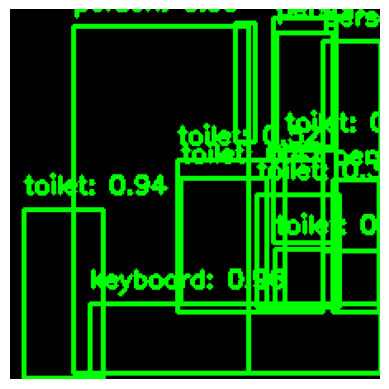

Frame 703, Label: 1, Score: 0.9917101263999939
Frame 703, Label: 1, Score: 0.9631083011627197
Frame 703, Label: 67, Score: 0.9624941349029541
Frame 703, Label: 1, Score: 0.9598329663276672
Frame 703, Label: 62, Score: 0.9430975914001465
Frame 703, Label: 1, Score: 0.9026316404342651
Frame 703, Label: 1, Score: 0.7605322003364563
Frame 703, Label: 32, Score: 0.6191884279251099
Frame 703, Label: 62, Score: 0.5213951468467712
Frame 703, Label: 62, Score: 0.46650370955467224
Frame 703, Label: 62, Score: 0.40449315309524536
Frame 703, Label: 62, Score: 0.3522298336029053
Frame 703, Label: 62, Score: 0.33794137835502625


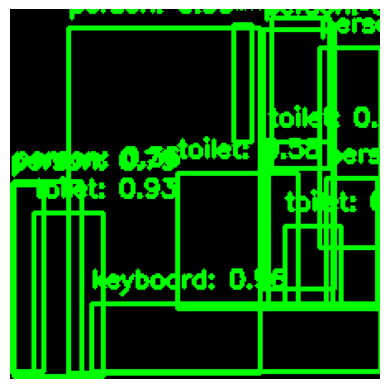

Frame 704, Label: 1, Score: 0.9884752035140991
Frame 704, Label: 1, Score: 0.9649603962898254
Frame 704, Label: 67, Score: 0.9645624756813049
Frame 704, Label: 1, Score: 0.9520651698112488
Frame 704, Label: 62, Score: 0.9277233481407166
Frame 704, Label: 1, Score: 0.7948423624038696
Frame 704, Label: 1, Score: 0.7288715839385986
Frame 704, Label: 1, Score: 0.6703411340713501
Frame 704, Label: 62, Score: 0.5815242528915405
Frame 704, Label: 62, Score: 0.4875374138355255
Frame 704, Label: 62, Score: 0.3825114071369171
Frame 704, Label: 32, Score: 0.36950352787971497
Frame 704, Label: 1, Score: 0.35758164525032043


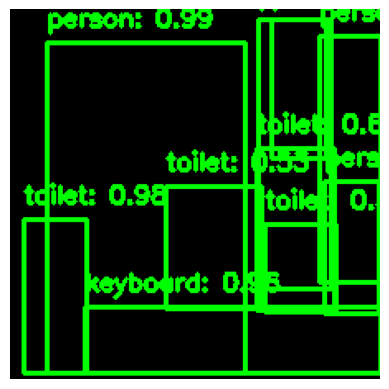

Frame 705, Label: 1, Score: 0.992763102054596
Frame 705, Label: 62, Score: 0.9809507131576538
Frame 705, Label: 1, Score: 0.9761049747467041
Frame 705, Label: 67, Score: 0.9611921906471252
Frame 705, Label: 1, Score: 0.9599949717521667
Frame 705, Label: 1, Score: 0.7913437485694885
Frame 705, Label: 62, Score: 0.6214982867240906
Frame 705, Label: 1, Score: 0.6124818921089172
Frame 705, Label: 62, Score: 0.5901240706443787
Frame 705, Label: 62, Score: 0.5334855318069458


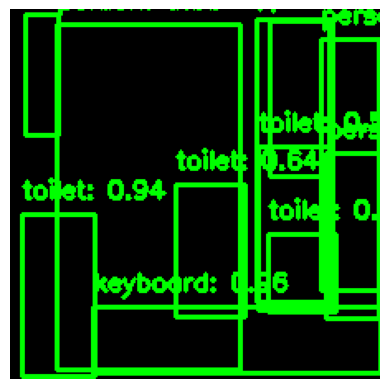

Frame 706, Label: 1, Score: 0.9915379285812378
Frame 706, Label: 1, Score: 0.9607712626457214
Frame 706, Label: 67, Score: 0.9590702652931213
Frame 706, Label: 1, Score: 0.9498432278633118
Frame 706, Label: 62, Score: 0.9419379234313965
Frame 706, Label: 1, Score: 0.8969933986663818
Frame 706, Label: 1, Score: 0.6720349788665771
Frame 706, Label: 62, Score: 0.6403640508651733
Frame 706, Label: 62, Score: 0.5671107172966003
Frame 706, Label: 62, Score: 0.5651992559432983
Frame 706, Label: 1, Score: 0.43765294551849365


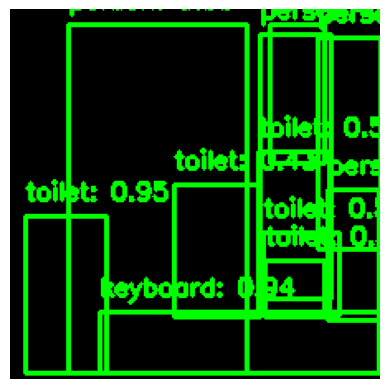

Frame 707, Label: 1, Score: 0.9941568374633789
Frame 707, Label: 62, Score: 0.9523121118545532
Frame 707, Label: 67, Score: 0.9420238137245178
Frame 707, Label: 1, Score: 0.9368928670883179
Frame 707, Label: 1, Score: 0.9240213632583618
Frame 707, Label: 1, Score: 0.715617835521698
Frame 707, Label: 62, Score: 0.5452286005020142
Frame 707, Label: 62, Score: 0.5173173546791077
Frame 707, Label: 62, Score: 0.5019164085388184
Frame 707, Label: 1, Score: 0.44203639030456543
Frame 707, Label: 62, Score: 0.4342415928840637


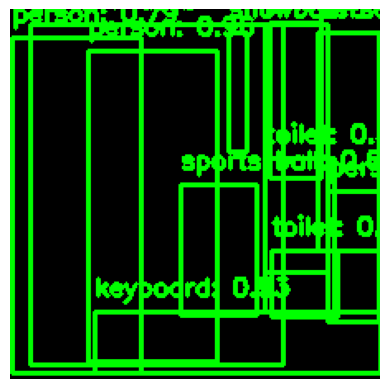

Frame 708, Label: 1, Score: 0.9623555541038513
Frame 708, Label: 1, Score: 0.9566916227340698
Frame 708, Label: 1, Score: 0.9404220581054688
Frame 708, Label: 67, Score: 0.932964563369751
Frame 708, Label: 1, Score: 0.878821074962616
Frame 708, Label: 1, Score: 0.7891452312469482
Frame 708, Label: 1, Score: 0.6430115103721619
Frame 708, Label: 33, Score: 0.6301069259643555
Frame 708, Label: 62, Score: 0.6171426177024841
Frame 708, Label: 1, Score: 0.46847718954086304
Frame 708, Label: 32, Score: 0.43102964758872986
Frame 708, Label: 62, Score: 0.38404348492622375


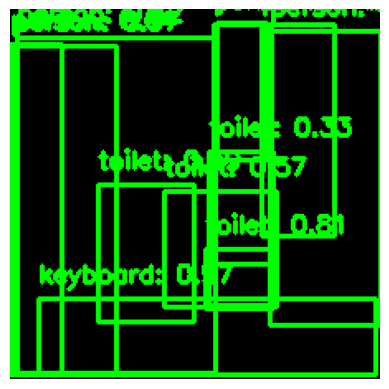

Frame 709, Label: 1, Score: 0.9933685660362244
Frame 709, Label: 1, Score: 0.9725369811058044
Frame 709, Label: 1, Score: 0.9693880081176758
Frame 709, Label: 67, Score: 0.9664802551269531
Frame 709, Label: 62, Score: 0.8119714856147766
Frame 709, Label: 1, Score: 0.7302379608154297
Frame 709, Label: 1, Score: 0.6373445987701416
Frame 709, Label: 62, Score: 0.5737316012382507
Frame 709, Label: 62, Score: 0.48788323998451233
Frame 709, Label: 1, Score: 0.4199720621109009
Frame 709, Label: 62, Score: 0.33094513416290283
Frame 709, Label: 1, Score: 0.3222704231739044


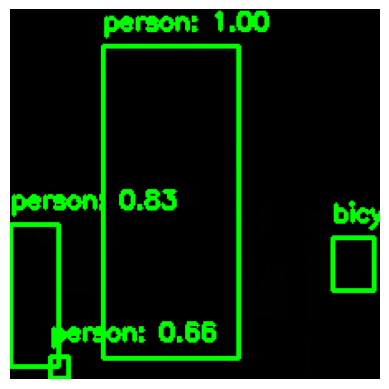

Frame 710, Label: 1, Score: 0.9975265860557556
Frame 710, Label: 1, Score: 0.8346059918403625
Frame 710, Label: 1, Score: 0.6570742130279541
Frame 710, Label: 2, Score: 0.4001578092575073


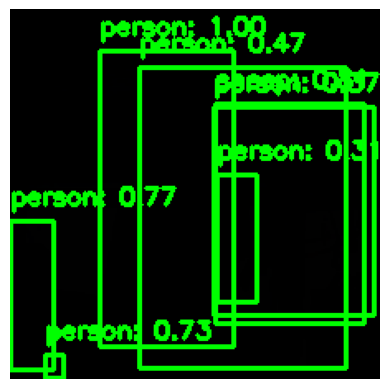

Frame 711, Label: 1, Score: 0.9974143505096436
Frame 711, Label: 19, Score: 0.8078838586807251
Frame 711, Label: 1, Score: 0.7676000595092773
Frame 711, Label: 1, Score: 0.7300278544425964
Frame 711, Label: 1, Score: 0.46932798624038696
Frame 711, Label: 1, Score: 0.36556485295295715
Frame 711, Label: 1, Score: 0.3127073049545288


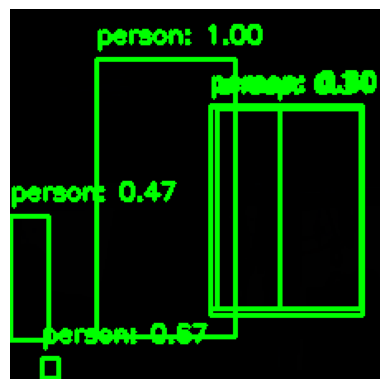

Frame 712, Label: 1, Score: 0.9962041974067688
Frame 712, Label: 1, Score: 0.6704823970794678
Frame 712, Label: 1, Score: 0.5953128933906555
Frame 712, Label: 1, Score: 0.5035924315452576
Frame 712, Label: 1, Score: 0.46669772267341614
Frame 712, Label: 19, Score: 0.3386134207248688


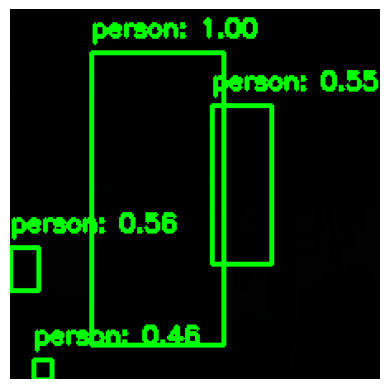

Frame 713, Label: 1, Score: 0.9971501231193542
Frame 713, Label: 1, Score: 0.5564684867858887
Frame 713, Label: 1, Score: 0.5486220717430115
Frame 713, Label: 1, Score: 0.4630514979362488


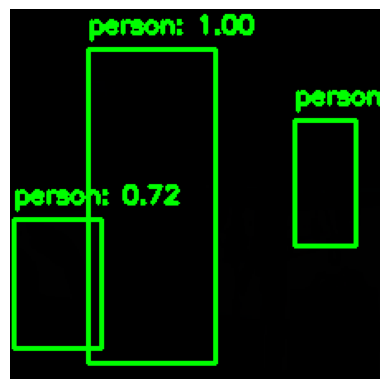

Frame 714, Label: 1, Score: 0.9956446886062622
Frame 714, Label: 1, Score: 0.8233696222305298
Frame 714, Label: 1, Score: 0.7233402132987976


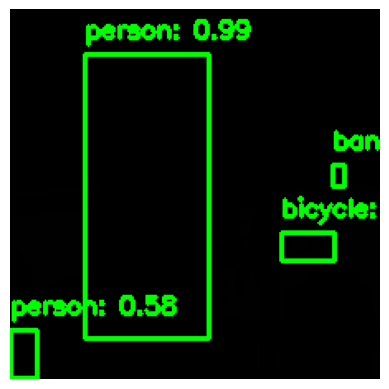

Frame 715, Label: 1, Score: 0.9942863583564758
Frame 715, Label: 1, Score: 0.5834221243858337
Frame 715, Label: 47, Score: 0.3339938521385193
Frame 715, Label: 2, Score: 0.3099270761013031


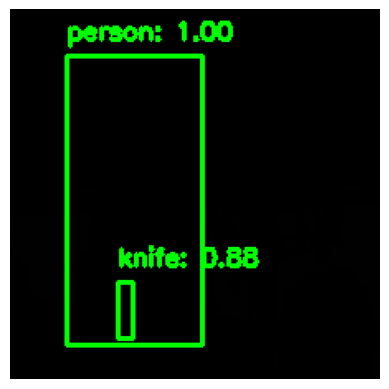

Frame 716, Label: 1, Score: 0.9967114925384521
Frame 716, Label: 44, Score: 0.8824313879013062


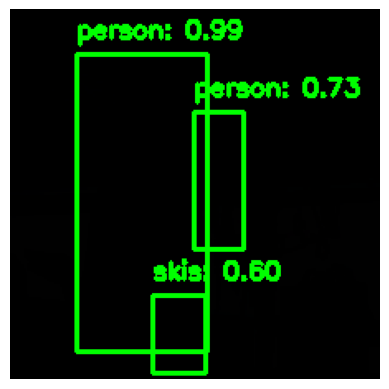

Frame 717, Label: 1, Score: 0.9938604831695557
Frame 717, Label: 1, Score: 0.7348944544792175
Frame 717, Label: 31, Score: 0.6043511033058167


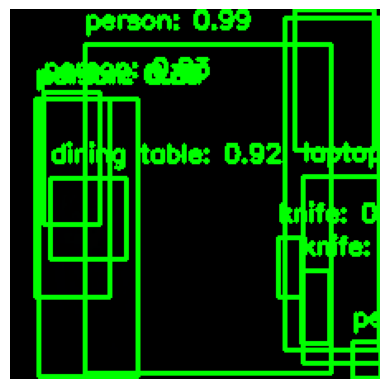

Frame 718, Label: 1, Score: 0.9864794611930847
Frame 718, Label: 61, Score: 0.9217824935913086
Frame 718, Label: 64, Score: 0.8664129972457886
Frame 718, Label: 44, Score: 0.8531112670898438
Frame 718, Label: 1, Score: 0.8389649391174316
Frame 718, Label: 1, Score: 0.8318743109703064
Frame 718, Label: 64, Score: 0.6330327987670898
Frame 718, Label: 64, Score: 0.5093694925308228
Frame 718, Label: 44, Score: 0.46385398507118225
Frame 718, Label: 1, Score: 0.38926050066947937
Frame 718, Label: 1, Score: 0.3617851138114929


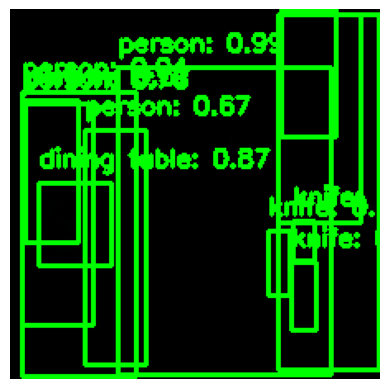

Frame 719, Label: 1, Score: 0.9920716881752014
Frame 719, Label: 1, Score: 0.9373388290405273
Frame 719, Label: 61, Score: 0.8676953315734863
Frame 719, Label: 64, Score: 0.7627755403518677
Frame 719, Label: 1, Score: 0.7583556771278381
Frame 719, Label: 44, Score: 0.7456178665161133
Frame 719, Label: 1, Score: 0.669202446937561
Frame 719, Label: 1, Score: 0.5690277218818665
Frame 719, Label: 64, Score: 0.4653257727622986
Frame 719, Label: 44, Score: 0.3286197781562805
Frame 719, Label: 44, Score: 0.3098992109298706
Frame 719, Label: 64, Score: 0.30746710300445557


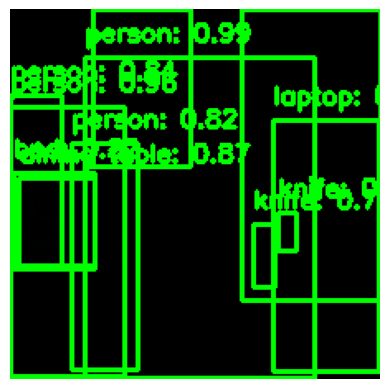

Frame 720, Label: 1, Score: 0.9882738590240479
Frame 720, Label: 1, Score: 0.9566718935966492
Frame 720, Label: 61, Score: 0.8714246153831482
Frame 720, Label: 1, Score: 0.8401769399642944
Frame 720, Label: 1, Score: 0.8187205195426941
Frame 720, Label: 64, Score: 0.7977192997932434
Frame 720, Label: 44, Score: 0.7545530200004578
Frame 720, Label: 44, Score: 0.6867278218269348
Frame 720, Label: 64, Score: 0.5244115591049194
Frame 720, Label: 1, Score: 0.3860674798488617
Frame 720, Label: 60, Score: 0.31667864322662354


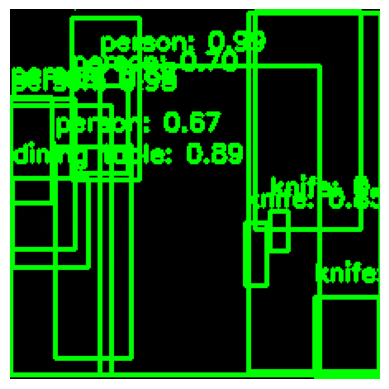

Frame 721, Label: 1, Score: 0.9944004416465759
Frame 721, Label: 1, Score: 0.9525275230407715
Frame 721, Label: 61, Score: 0.893261194229126
Frame 721, Label: 1, Score: 0.8662892580032349
Frame 721, Label: 44, Score: 0.8456928133964539
Frame 721, Label: 64, Score: 0.8079760074615479
Frame 721, Label: 1, Score: 0.7048345804214478
Frame 721, Label: 1, Score: 0.6819012761116028
Frame 721, Label: 44, Score: 0.6791205406188965
Frame 721, Label: 1, Score: 0.6655110716819763
Frame 721, Label: 1, Score: 0.3441070020198822
Frame 721, Label: 44, Score: 0.3429335057735443
Frame 721, Label: 64, Score: 0.33329224586486816


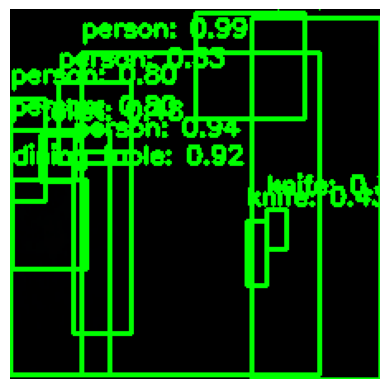

Frame 722, Label: 1, Score: 0.9910745024681091
Frame 722, Label: 1, Score: 0.9416362643241882
Frame 722, Label: 61, Score: 0.9192099571228027
Frame 722, Label: 1, Score: 0.8028738498687744
Frame 722, Label: 1, Score: 0.8015743494033813
Frame 722, Label: 64, Score: 0.7628144025802612
Frame 722, Label: 62, Score: 0.479590505361557
Frame 722, Label: 44, Score: 0.4336497187614441
Frame 722, Label: 44, Score: 0.3918607831001282
Frame 722, Label: 64, Score: 0.3451747000217438
Frame 722, Label: 1, Score: 0.3277732729911804


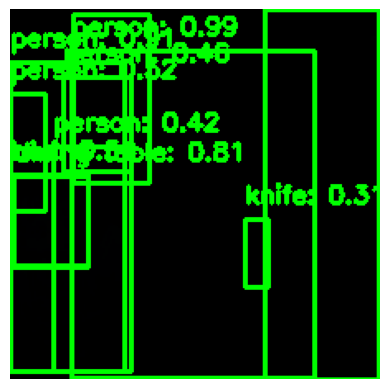

Frame 723, Label: 1, Score: 0.9927238821983337
Frame 723, Label: 1, Score: 0.911885678768158
Frame 723, Label: 61, Score: 0.8084065914154053
Frame 723, Label: 64, Score: 0.7181451916694641
Frame 723, Label: 1, Score: 0.5221281051635742
Frame 723, Label: 1, Score: 0.4557496905326843
Frame 723, Label: 1, Score: 0.42427119612693787
Frame 723, Label: 1, Score: 0.39223620295524597
Frame 723, Label: 60, Score: 0.33653169870376587
Frame 723, Label: 44, Score: 0.30915388464927673


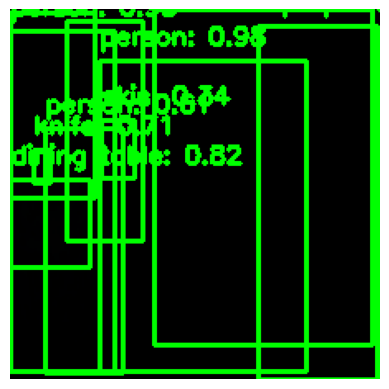

Frame 724, Label: 1, Score: 0.9826818704605103
Frame 724, Label: 1, Score: 0.9454522132873535
Frame 724, Label: 64, Score: 0.8249114751815796
Frame 724, Label: 61, Score: 0.8229082226753235
Frame 724, Label: 1, Score: 0.8079390525817871
Frame 724, Label: 44, Score: 0.7064927816390991
Frame 724, Label: 1, Score: 0.6116857528686523
Frame 724, Label: 64, Score: 0.48166388273239136
Frame 724, Label: 31, Score: 0.3388659656047821
Frame 724, Label: 1, Score: 0.32221049070358276


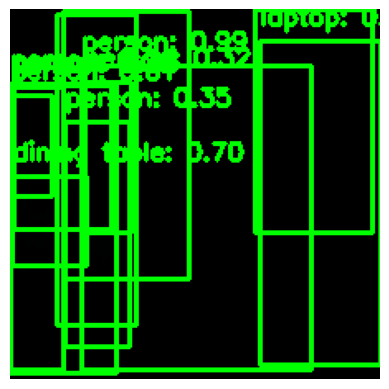

Frame 725, Label: 1, Score: 0.9867594838142395
Frame 725, Label: 1, Score: 0.9648562669754028
Frame 725, Label: 64, Score: 0.8762949705123901
Frame 725, Label: 61, Score: 0.6958001255989075
Frame 725, Label: 1, Score: 0.6637061238288879
Frame 725, Label: 1, Score: 0.6090698838233948
Frame 725, Label: 1, Score: 0.5394361019134521
Frame 725, Label: 1, Score: 0.48474687337875366
Frame 725, Label: 64, Score: 0.4406965374946594
Frame 725, Label: 1, Score: 0.34946972131729126
Frame 725, Label: 1, Score: 0.3222311735153198
Frame 725, Label: 1, Score: 0.32057926058769226


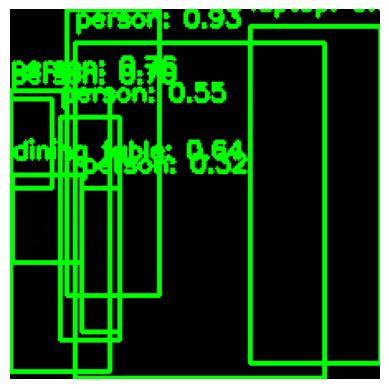

Frame 726, Label: 1, Score: 0.9284089803695679
Frame 726, Label: 1, Score: 0.8544482588768005
Frame 726, Label: 64, Score: 0.8217743039131165
Frame 726, Label: 1, Score: 0.7608591318130493
Frame 726, Label: 1, Score: 0.6998634934425354
Frame 726, Label: 61, Score: 0.6414097547531128
Frame 726, Label: 1, Score: 0.5487402677536011
Frame 726, Label: 1, Score: 0.32036539912223816


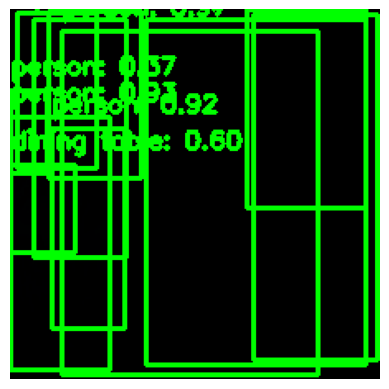

Frame 727, Label: 1, Score: 0.9684734344482422
Frame 727, Label: 1, Score: 0.9333272576332092
Frame 727, Label: 1, Score: 0.9242795705795288
Frame 727, Label: 1, Score: 0.8266251683235168
Frame 727, Label: 64, Score: 0.7587675452232361
Frame 727, Label: 61, Score: 0.5977048873901367
Frame 727, Label: 1, Score: 0.510383129119873
Frame 727, Label: 1, Score: 0.44226834177970886
Frame 727, Label: 1, Score: 0.36823570728302
Frame 727, Label: 64, Score: 0.3265582025051117
Frame 727, Label: 64, Score: 0.30531254410743713


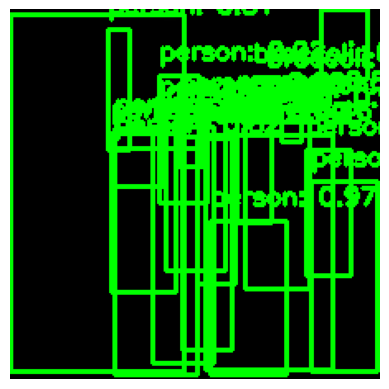

Frame 728, Label: 1, Score: 0.984862208366394
Frame 728, Label: 1, Score: 0.97995924949646
Frame 728, Label: 1, Score: 0.9686676859855652
Frame 728, Label: 1, Score: 0.9404115080833435
Frame 728, Label: 1, Score: 0.9315528273582458
Frame 728, Label: 1, Score: 0.9311213493347168
Frame 728, Label: 1, Score: 0.9223219752311707
Frame 728, Label: 1, Score: 0.8834803700447083
Frame 728, Label: 1, Score: 0.8537101745605469
Frame 728, Label: 1, Score: 0.8213491439819336
Frame 728, Label: 51, Score: 0.7378549575805664
Frame 728, Label: 1, Score: 0.6337060928344727
Frame 728, Label: 64, Score: 0.5867830514907837
Frame 728, Label: 1, Score: 0.4932555854320526
Frame 728, Label: 1, Score: 0.46085989475250244
Frame 728, Label: 1, Score: 0.4560246169567108
Frame 728, Label: 1, Score: 0.39014488458633423
Frame 728, Label: 1, Score: 0.3848327696323395
Frame 728, Label: 51, Score: 0.35520631074905396
Frame 728, Label: 1, Score: 0.35503309965133667
Frame 728, Label: 1, Score: 0.3296999931335449
Frame 728

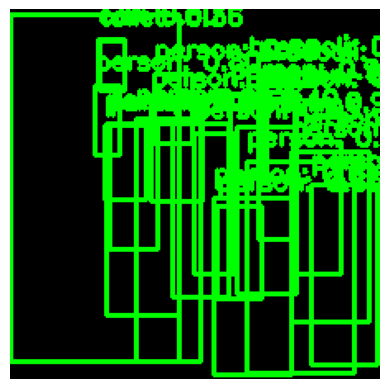

Frame 729, Label: 1, Score: 0.9850744009017944
Frame 729, Label: 1, Score: 0.9726583361625671
Frame 729, Label: 1, Score: 0.9492716193199158
Frame 729, Label: 1, Score: 0.9218364953994751
Frame 729, Label: 1, Score: 0.9199762940406799
Frame 729, Label: 1, Score: 0.9172707796096802
Frame 729, Label: 1, Score: 0.8808553814888
Frame 729, Label: 1, Score: 0.8607434034347534
Frame 729, Label: 1, Score: 0.8527984023094177
Frame 729, Label: 1, Score: 0.8035925030708313
Frame 729, Label: 1, Score: 0.7423031330108643
Frame 729, Label: 51, Score: 0.6754860877990723
Frame 729, Label: 1, Score: 0.6090279817581177
Frame 729, Label: 3, Score: 0.5979868769645691
Frame 729, Label: 1, Score: 0.5883510708808899
Frame 729, Label: 1, Score: 0.5698190927505493
Frame 729, Label: 1, Score: 0.47888728976249695
Frame 729, Label: 1, Score: 0.4442518651485443
Frame 729, Label: 1, Score: 0.4013362228870392
Frame 729, Label: 1, Score: 0.3963475525379181
Frame 729, Label: 1, Score: 0.381541907787323
Frame 729, Labe

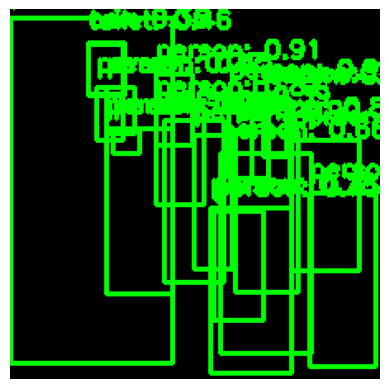

Frame 730, Label: 1, Score: 0.9931568503379822
Frame 730, Label: 1, Score: 0.978236973285675
Frame 730, Label: 1, Score: 0.9255715608596802
Frame 730, Label: 1, Score: 0.912871778011322
Frame 730, Label: 1, Score: 0.9034777283668518
Frame 730, Label: 1, Score: 0.8970873355865479
Frame 730, Label: 1, Score: 0.8507583737373352
Frame 730, Label: 1, Score: 0.8451405167579651
Frame 730, Label: 1, Score: 0.8176002502441406
Frame 730, Label: 1, Score: 0.7840808629989624
Frame 730, Label: 1, Score: 0.7731552124023438
Frame 730, Label: 1, Score: 0.7493466734886169
Frame 730, Label: 1, Score: 0.6553331613540649
Frame 730, Label: 1, Score: 0.5471713542938232
Frame 730, Label: 62, Score: 0.4649558961391449
Frame 730, Label: 1, Score: 0.451401025056839
Frame 730, Label: 1, Score: 0.3985392153263092
Frame 730, Label: 1, Score: 0.3909883201122284
Frame 730, Label: 3, Score: 0.35885679721832275
Frame 730, Label: 1, Score: 0.34549158811569214


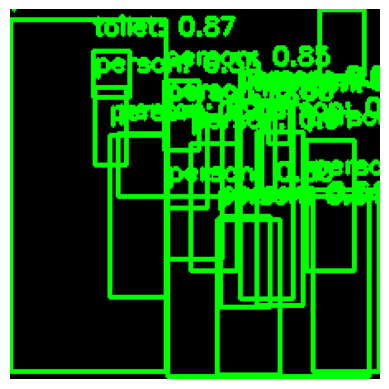

Frame 731, Label: 1, Score: 0.9733062386512756
Frame 731, Label: 1, Score: 0.973025918006897
Frame 731, Label: 1, Score: 0.9277401566505432
Frame 731, Label: 1, Score: 0.9066253304481506
Frame 731, Label: 1, Score: 0.9050941467285156
Frame 731, Label: 1, Score: 0.8738306164741516
Frame 731, Label: 62, Score: 0.8661350607872009
Frame 731, Label: 1, Score: 0.850344717502594
Frame 731, Label: 1, Score: 0.8464648723602295
Frame 731, Label: 1, Score: 0.8430727124214172
Frame 731, Label: 1, Score: 0.8060307502746582
Frame 731, Label: 1, Score: 0.7551620602607727
Frame 731, Label: 1, Score: 0.6816802024841309
Frame 731, Label: 1, Score: 0.616443932056427
Frame 731, Label: 1, Score: 0.6084221601486206
Frame 731, Label: 64, Score: 0.558648943901062
Frame 731, Label: 1, Score: 0.5472630858421326
Frame 731, Label: 1, Score: 0.5347973108291626
Frame 731, Label: 1, Score: 0.478930801153183
Frame 731, Label: 1, Score: 0.3016171157360077


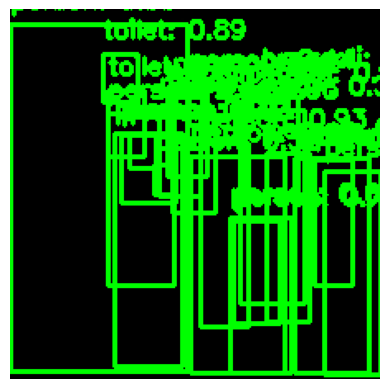

Frame 732, Label: 1, Score: 0.9903517365455627
Frame 732, Label: 1, Score: 0.9662322402000427
Frame 732, Label: 1, Score: 0.9530330896377563
Frame 732, Label: 1, Score: 0.9467359781265259
Frame 732, Label: 1, Score: 0.9390020966529846
Frame 732, Label: 1, Score: 0.9274969696998596
Frame 732, Label: 1, Score: 0.9091212153434753
Frame 732, Label: 62, Score: 0.8884567618370056
Frame 732, Label: 1, Score: 0.7820861339569092
Frame 732, Label: 1, Score: 0.6924753189086914
Frame 732, Label: 1, Score: 0.6675145626068115
Frame 732, Label: 51, Score: 0.5537774562835693
Frame 732, Label: 1, Score: 0.5178688168525696
Frame 732, Label: 1, Score: 0.4726737141609192
Frame 732, Label: 1, Score: 0.4433700144290924
Frame 732, Label: 1, Score: 0.4236088991165161
Frame 732, Label: 1, Score: 0.4222904443740845
Frame 732, Label: 1, Score: 0.409752756357193
Frame 732, Label: 62, Score: 0.4058317542076111
Frame 732, Label: 1, Score: 0.3797494173049927
Frame 732, Label: 1, Score: 0.37243926525115967
Frame 732,

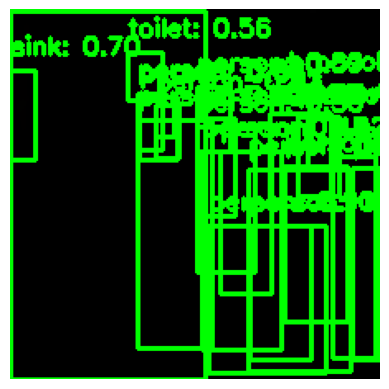

Frame 733, Label: 1, Score: 0.9949945211410522
Frame 733, Label: 1, Score: 0.9498604536056519
Frame 733, Label: 1, Score: 0.9337264895439148
Frame 733, Label: 1, Score: 0.9335000514984131
Frame 733, Label: 1, Score: 0.9242075085639954
Frame 733, Label: 1, Score: 0.9232232570648193
Frame 733, Label: 1, Score: 0.9114736914634705
Frame 733, Label: 1, Score: 0.8937469720840454
Frame 733, Label: 1, Score: 0.8932687044143677
Frame 733, Label: 72, Score: 0.7031266689300537
Frame 733, Label: 1, Score: 0.6592373251914978
Frame 733, Label: 1, Score: 0.6281739473342896
Frame 733, Label: 1, Score: 0.5806180238723755
Frame 733, Label: 62, Score: 0.5572587847709656
Frame 733, Label: 1, Score: 0.5195745825767517
Frame 733, Label: 1, Score: 0.48831039667129517
Frame 733, Label: 1, Score: 0.4487832188606262
Frame 733, Label: 1, Score: 0.4247215688228607
Frame 733, Label: 1, Score: 0.3934580683708191
Frame 733, Label: 1, Score: 0.33507800102233887
Frame 733, Label: 51, Score: 0.33427533507347107
Frame 7

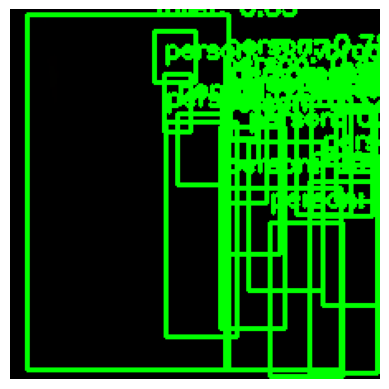

Frame 734, Label: 1, Score: 0.9914228320121765
Frame 734, Label: 1, Score: 0.9654657244682312
Frame 734, Label: 1, Score: 0.9643065929412842
Frame 734, Label: 1, Score: 0.9553267955780029
Frame 734, Label: 1, Score: 0.9389525055885315
Frame 734, Label: 1, Score: 0.8997100591659546
Frame 734, Label: 62, Score: 0.8512492775917053
Frame 734, Label: 1, Score: 0.8335687518119812
Frame 734, Label: 1, Score: 0.8161069750785828
Frame 734, Label: 1, Score: 0.7805891036987305
Frame 734, Label: 1, Score: 0.7652977108955383
Frame 734, Label: 1, Score: 0.6918715834617615
Frame 734, Label: 1, Score: 0.6050578355789185
Frame 734, Label: 1, Score: 0.5569223165512085
Frame 734, Label: 1, Score: 0.5266881585121155
Frame 734, Label: 1, Score: 0.4984167516231537
Frame 734, Label: 51, Score: 0.4447270929813385
Frame 734, Label: 1, Score: 0.4378228485584259
Frame 734, Label: 1, Score: 0.33226877450942993
Frame 734, Label: 1, Score: 0.32418885827064514
Frame 734, Label: 1, Score: 0.31174272298812866


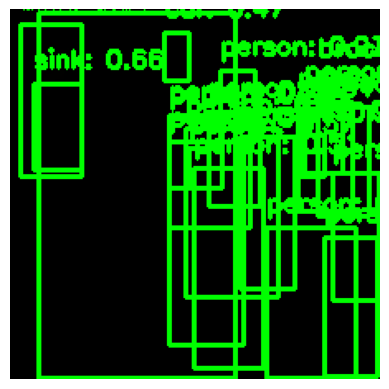

Frame 735, Label: 1, Score: 0.9841788411140442
Frame 735, Label: 1, Score: 0.9738567471504211
Frame 735, Label: 1, Score: 0.9501377940177917
Frame 735, Label: 1, Score: 0.9489723443984985
Frame 735, Label: 1, Score: 0.9310581684112549
Frame 735, Label: 1, Score: 0.9087916612625122
Frame 735, Label: 1, Score: 0.8985957503318787
Frame 735, Label: 1, Score: 0.866920530796051
Frame 735, Label: 1, Score: 0.8468354344367981
Frame 735, Label: 1, Score: 0.7575666904449463
Frame 735, Label: 1, Score: 0.7105250954627991
Frame 735, Label: 72, Score: 0.6634924411773682
Frame 735, Label: 72, Score: 0.6351797580718994
Frame 735, Label: 1, Score: 0.5726580023765564
Frame 735, Label: 51, Score: 0.5194281339645386
Frame 735, Label: 1, Score: 0.5104362368583679
Frame 735, Label: 3, Score: 0.4699421226978302
Frame 735, Label: 31, Score: 0.42575398087501526
Frame 735, Label: 1, Score: 0.37610554695129395
Frame 735, Label: 1, Score: 0.37029480934143066
Frame 735, Label: 1, Score: 0.3044700622558594


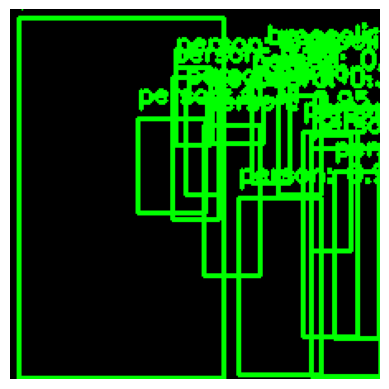

Frame 736, Label: 1, Score: 0.991911768913269
Frame 736, Label: 1, Score: 0.9801811575889587
Frame 736, Label: 1, Score: 0.9490061402320862
Frame 736, Label: 1, Score: 0.9478878974914551
Frame 736, Label: 1, Score: 0.9177603721618652
Frame 736, Label: 1, Score: 0.9102783203125
Frame 736, Label: 1, Score: 0.9059616923332214
Frame 736, Label: 1, Score: 0.9045464396476746
Frame 736, Label: 1, Score: 0.8755358457565308
Frame 736, Label: 1, Score: 0.7059253454208374
Frame 736, Label: 1, Score: 0.6016299724578857
Frame 736, Label: 51, Score: 0.40763771533966064
Frame 736, Label: 51, Score: 0.3633057475090027
Frame 736, Label: 67, Score: 0.32999303936958313
Frame 736, Label: 1, Score: 0.3103824555873871
Frame 736, Label: 1, Score: 0.30970680713653564


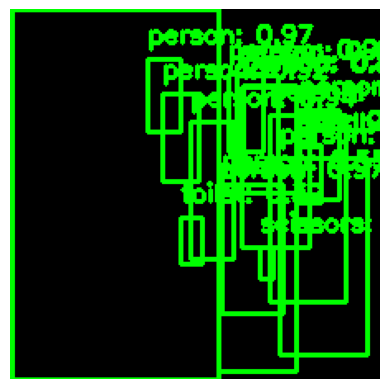

Frame 737, Label: 1, Score: 0.9954832792282104
Frame 737, Label: 1, Score: 0.9785979390144348
Frame 737, Label: 1, Score: 0.9715509414672852
Frame 737, Label: 1, Score: 0.9668198823928833
Frame 737, Label: 1, Score: 0.9482083916664124
Frame 737, Label: 1, Score: 0.9360108375549316
Frame 737, Label: 1, Score: 0.9210827350616455
Frame 737, Label: 1, Score: 0.8739878535270691
Frame 737, Label: 1, Score: 0.6565350294113159
Frame 737, Label: 31, Score: 0.5902327299118042
Frame 737, Label: 1, Score: 0.5488927960395813
Frame 737, Label: 1, Score: 0.4509222209453583
Frame 737, Label: 1, Score: 0.42472824454307556
Frame 737, Label: 62, Score: 0.3924033045768738
Frame 737, Label: 27, Score: 0.3618796467781067
Frame 737, Label: 1, Score: 0.34771645069122314
Frame 737, Label: 77, Score: 0.32331156730651855


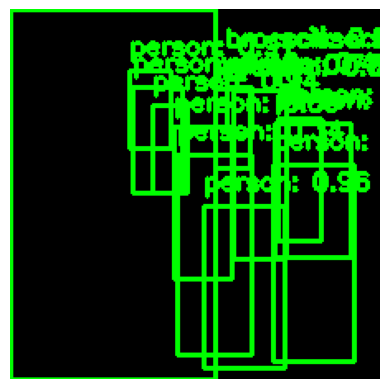

Frame 738, Label: 1, Score: 0.9949079155921936
Frame 738, Label: 1, Score: 0.9780094623565674
Frame 738, Label: 1, Score: 0.9586365818977356
Frame 738, Label: 1, Score: 0.9376987218856812
Frame 738, Label: 1, Score: 0.9053926467895508
Frame 738, Label: 1, Score: 0.8875119686126709
Frame 738, Label: 1, Score: 0.8856633305549622
Frame 738, Label: 1, Score: 0.7661268711090088
Frame 738, Label: 1, Score: 0.7191391587257385
Frame 738, Label: 1, Score: 0.6123367547988892
Frame 738, Label: 51, Score: 0.522058367729187
Frame 738, Label: 1, Score: 0.4220724403858185
Frame 738, Label: 1, Score: 0.39707937836647034
Frame 738, Label: 1, Score: 0.335426926612854
Frame 738, Label: 77, Score: 0.3177236020565033


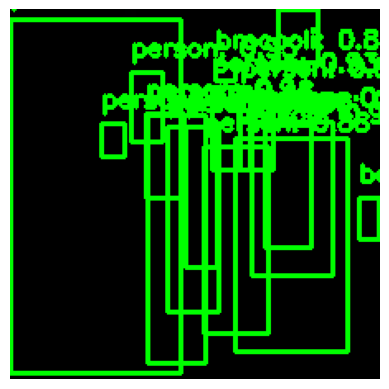

Frame 739, Label: 1, Score: 0.9945091605186462
Frame 739, Label: 1, Score: 0.957298219203949
Frame 739, Label: 1, Score: 0.9538294076919556
Frame 739, Label: 1, Score: 0.9382157921791077
Frame 739, Label: 1, Score: 0.9257490038871765
Frame 739, Label: 1, Score: 0.9041496515274048
Frame 739, Label: 1, Score: 0.8774386048316956
Frame 739, Label: 51, Score: 0.8465215563774109
Frame 739, Label: 1, Score: 0.8148792386054993
Frame 739, Label: 1, Score: 0.7247806191444397
Frame 739, Label: 1, Score: 0.6978604793548584
Frame 739, Label: 1, Score: 0.5757993459701538
Frame 739, Label: 1, Score: 0.5665193796157837
Frame 739, Label: 47, Score: 0.5104512572288513
Frame 739, Label: 1, Score: 0.47736793756484985
Frame 739, Label: 64, Score: 0.39908555150032043


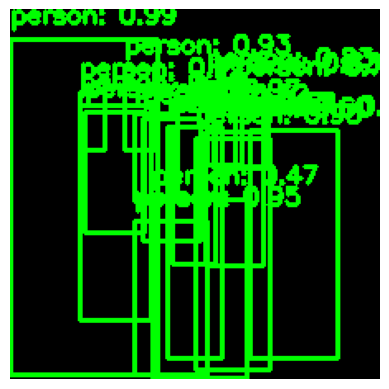

Frame 740, Label: 1, Score: 0.9863696098327637
Frame 740, Label: 1, Score: 0.9691174626350403
Frame 740, Label: 1, Score: 0.9627478718757629
Frame 740, Label: 1, Score: 0.9530229568481445
Frame 740, Label: 1, Score: 0.9476007223129272
Frame 740, Label: 1, Score: 0.9343143701553345
Frame 740, Label: 1, Score: 0.8366192579269409
Frame 740, Label: 1, Score: 0.8339698910713196
Frame 740, Label: 1, Score: 0.8324263095855713
Frame 740, Label: 1, Score: 0.7228744626045227
Frame 740, Label: 1, Score: 0.697415828704834
Frame 740, Label: 1, Score: 0.6871404647827148
Frame 740, Label: 1, Score: 0.6037631034851074
Frame 740, Label: 1, Score: 0.5708176493644714
Frame 740, Label: 1, Score: 0.4671992063522339
Frame 740, Label: 1, Score: 0.457758367061615
Frame 740, Label: 1, Score: 0.32305219769477844


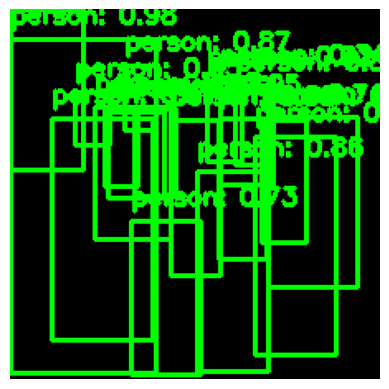

Frame 741, Label: 1, Score: 0.9807630777359009
Frame 741, Label: 1, Score: 0.9524765014648438
Frame 741, Label: 1, Score: 0.9455045461654663
Frame 741, Label: 1, Score: 0.9372372627258301
Frame 741, Label: 1, Score: 0.91718989610672
Frame 741, Label: 1, Score: 0.9006254076957703
Frame 741, Label: 1, Score: 0.8995877504348755
Frame 741, Label: 1, Score: 0.8688700199127197
Frame 741, Label: 1, Score: 0.8564009070396423
Frame 741, Label: 1, Score: 0.8366714715957642
Frame 741, Label: 1, Score: 0.7664000391960144
Frame 741, Label: 1, Score: 0.7263162136077881
Frame 741, Label: 1, Score: 0.7069369554519653
Frame 741, Label: 1, Score: 0.6199801564216614
Frame 741, Label: 1, Score: 0.5241601467132568
Frame 741, Label: 1, Score: 0.42719006538391113
Frame 741, Label: 1, Score: 0.3848021924495697
Frame 741, Label: 1, Score: 0.3442361652851105
Frame 741, Label: 1, Score: 0.30972281098365784


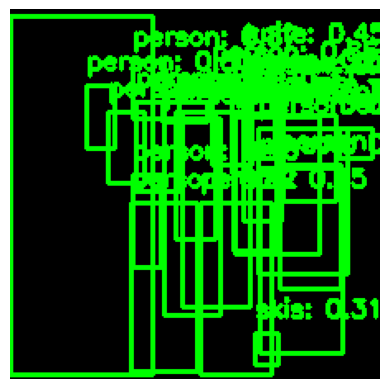

Frame 742, Label: 1, Score: 0.9951463341712952
Frame 742, Label: 1, Score: 0.9644051194190979
Frame 742, Label: 1, Score: 0.9483269453048706
Frame 742, Label: 1, Score: 0.9236108660697937
Frame 742, Label: 1, Score: 0.9073531627655029
Frame 742, Label: 1, Score: 0.9030986428260803
Frame 742, Label: 1, Score: 0.8901193737983704
Frame 742, Label: 1, Score: 0.8652902841567993
Frame 742, Label: 1, Score: 0.8643800020217896
Frame 742, Label: 1, Score: 0.8165602684020996
Frame 742, Label: 1, Score: 0.8037217855453491
Frame 742, Label: 1, Score: 0.7912655472755432
Frame 742, Label: 1, Score: 0.7619774341583252
Frame 742, Label: 1, Score: 0.5275759100914001
Frame 742, Label: 1, Score: 0.5113446712493896
Frame 742, Label: 60, Score: 0.4959428906440735
Frame 742, Label: 1, Score: 0.49285414814949036
Frame 742, Label: 1, Score: 0.46289515495300293
Frame 742, Label: 44, Score: 0.44530022144317627
Frame 742, Label: 1, Score: 0.43136823177337646
Frame 742, Label: 1, Score: 0.3598315119743347
Frame 7

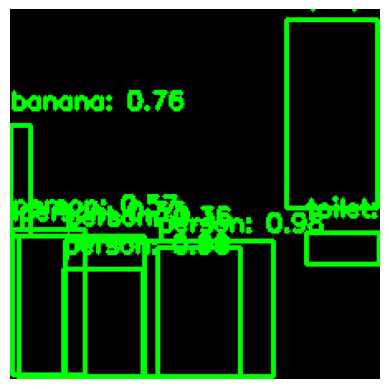

Frame 743, Label: 1, Score: 0.9845784306526184
Frame 743, Label: 1, Score: 0.9645542502403259
Frame 743, Label: 62, Score: 0.7782605290412903
Frame 743, Label: 47, Score: 0.7610424757003784
Frame 743, Label: 64, Score: 0.5783551931381226
Frame 743, Label: 1, Score: 0.5746316313743591
Frame 743, Label: 1, Score: 0.36019080877304077
Frame 743, Label: 1, Score: 0.3324891924858093


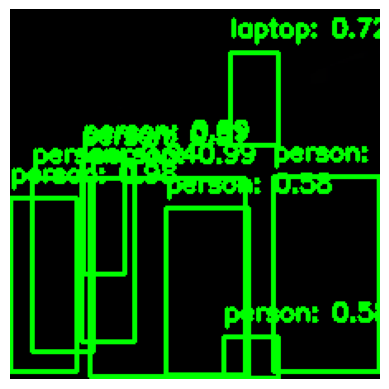

Frame 744, Label: 1, Score: 0.9958857893943787
Frame 744, Label: 1, Score: 0.9878266453742981
Frame 744, Label: 1, Score: 0.9802024960517883
Frame 744, Label: 1, Score: 0.9405896067619324
Frame 744, Label: 1, Score: 0.8896783590316772
Frame 744, Label: 64, Score: 0.7219719886779785
Frame 744, Label: 1, Score: 0.5793728232383728
Frame 744, Label: 1, Score: 0.5765575766563416
Frame 744, Label: 1, Score: 0.5114464163780212


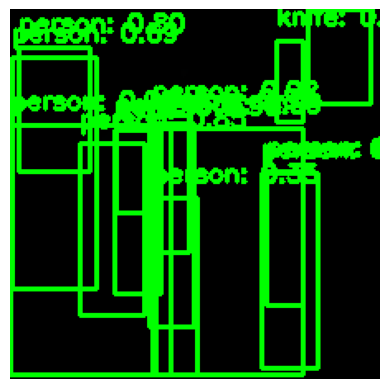

Frame 745, Label: 1, Score: 0.9895738959312439
Frame 745, Label: 1, Score: 0.98029625415802
Frame 745, Label: 1, Score: 0.9479237794876099
Frame 745, Label: 1, Score: 0.9433241486549377
Frame 745, Label: 64, Score: 0.9351585507392883
Frame 745, Label: 1, Score: 0.9187535047531128
Frame 745, Label: 1, Score: 0.8892602324485779
Frame 745, Label: 1, Score: 0.8517107367515564
Frame 745, Label: 1, Score: 0.7997269034385681
Frame 745, Label: 1, Score: 0.6937652230262756
Frame 745, Label: 1, Score: 0.537139356136322
Frame 745, Label: 1, Score: 0.4224725663661957
Frame 745, Label: 1, Score: 0.34728801250457764
Frame 745, Label: 44, Score: 0.33633893728256226


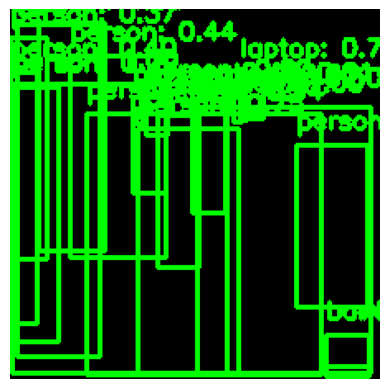

Frame 746, Label: 1, Score: 0.9969437718391418
Frame 746, Label: 1, Score: 0.9955743551254272
Frame 746, Label: 1, Score: 0.9657958149909973
Frame 746, Label: 1, Score: 0.9371315836906433
Frame 746, Label: 1, Score: 0.9037026166915894
Frame 746, Label: 1, Score: 0.8764930367469788
Frame 746, Label: 1, Score: 0.8276058435440063
Frame 746, Label: 1, Score: 0.7890713214874268
Frame 746, Label: 64, Score: 0.7741210460662842
Frame 746, Label: 1, Score: 0.7600426077842712
Frame 746, Label: 46, Score: 0.7579073905944824
Frame 746, Label: 1, Score: 0.7475684285163879
Frame 746, Label: 44, Score: 0.6121980547904968
Frame 746, Label: 1, Score: 0.47133150696754456
Frame 746, Label: 47, Score: 0.46122869849205017
Frame 746, Label: 1, Score: 0.44090694189071655
Frame 746, Label: 77, Score: 0.4283563494682312
Frame 746, Label: 1, Score: 0.39598366618156433
Frame 746, Label: 1, Score: 0.37319743633270264
Frame 746, Label: 1, Score: 0.3149762749671936
Frame 746, Label: 44, Score: 0.3032761216163635


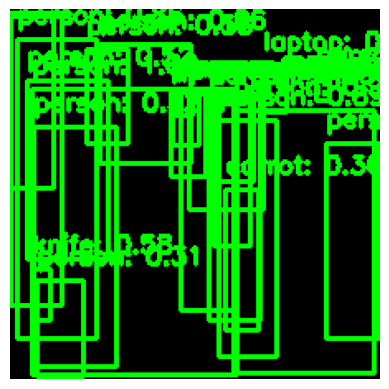

Frame 747, Label: 1, Score: 0.996336817741394
Frame 747, Label: 1, Score: 0.9748020172119141
Frame 747, Label: 1, Score: 0.9704781174659729
Frame 747, Label: 1, Score: 0.9056324362754822
Frame 747, Label: 1, Score: 0.8980241417884827
Frame 747, Label: 1, Score: 0.8853462338447571
Frame 747, Label: 1, Score: 0.8621460795402527
Frame 747, Label: 1, Score: 0.855857253074646
Frame 747, Label: 1, Score: 0.8268850445747375
Frame 747, Label: 64, Score: 0.7170190215110779
Frame 747, Label: 1, Score: 0.6764127612113953
Frame 747, Label: 1, Score: 0.6569430828094482
Frame 747, Label: 1, Score: 0.637439489364624
Frame 747, Label: 1, Score: 0.5944090485572815
Frame 747, Label: 1, Score: 0.5821451544761658
Frame 747, Label: 44, Score: 0.5804892778396606
Frame 747, Label: 1, Score: 0.5218509435653687
Frame 747, Label: 1, Score: 0.4967817962169647
Frame 747, Label: 52, Score: 0.3610977232456207
Frame 747, Label: 1, Score: 0.3527940809726715
Frame 747, Label: 1, Score: 0.3437603712081909
Frame 747, La

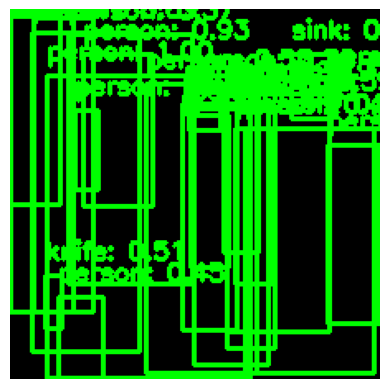

Frame 748, Label: 1, Score: 0.9954153299331665
Frame 748, Label: 1, Score: 0.9908428192138672
Frame 748, Label: 1, Score: 0.9853739738464355
Frame 748, Label: 1, Score: 0.974344789981842
Frame 748, Label: 1, Score: 0.9660412669181824
Frame 748, Label: 1, Score: 0.9487552046775818
Frame 748, Label: 1, Score: 0.9332801103591919
Frame 748, Label: 1, Score: 0.8923068642616272
Frame 748, Label: 1, Score: 0.8019418716430664
Frame 748, Label: 1, Score: 0.7518383860588074
Frame 748, Label: 1, Score: 0.5915838479995728
Frame 748, Label: 72, Score: 0.5687260627746582
Frame 748, Label: 1, Score: 0.5292255282402039
Frame 748, Label: 44, Score: 0.5089209079742432
Frame 748, Label: 1, Score: 0.4547075629234314
Frame 748, Label: 1, Score: 0.4505755603313446
Frame 748, Label: 1, Score: 0.4290007948875427
Frame 748, Label: 1, Score: 0.4045279920101166
Frame 748, Label: 1, Score: 0.3656434416770935
Frame 748, Label: 1, Score: 0.35960349440574646
Frame 748, Label: 1, Score: 0.35878634452819824
Frame 748,

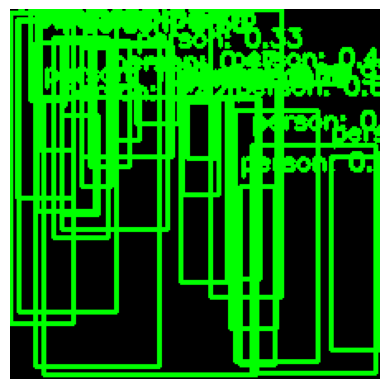

Frame 749, Label: 1, Score: 0.9969252943992615
Frame 749, Label: 1, Score: 0.9946637153625488
Frame 749, Label: 1, Score: 0.9861917495727539
Frame 749, Label: 1, Score: 0.9724557995796204
Frame 749, Label: 1, Score: 0.9631226062774658
Frame 749, Label: 1, Score: 0.7029897570610046
Frame 749, Label: 1, Score: 0.7021570205688477
Frame 749, Label: 1, Score: 0.6921563744544983
Frame 749, Label: 1, Score: 0.6843433976173401
Frame 749, Label: 1, Score: 0.6466226577758789
Frame 749, Label: 1, Score: 0.6373811960220337
Frame 749, Label: 1, Score: 0.5171210169792175
Frame 749, Label: 1, Score: 0.4971977472305298
Frame 749, Label: 1, Score: 0.4867616891860962
Frame 749, Label: 1, Score: 0.47014421224594116
Frame 749, Label: 1, Score: 0.41782087087631226
Frame 749, Label: 1, Score: 0.39435702562332153
Frame 749, Label: 1, Score: 0.3941617012023926
Frame 749, Label: 1, Score: 0.3848002851009369
Frame 749, Label: 1, Score: 0.3605780601501465
Frame 749, Label: 1, Score: 0.3508308529853821
Frame 749,

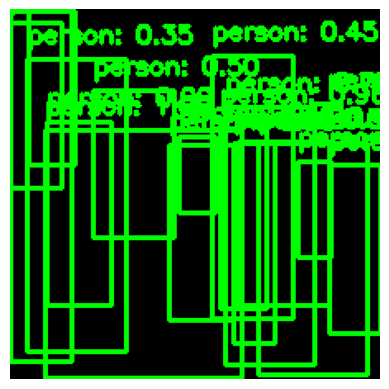

Frame 750, Label: 1, Score: 0.9965369701385498
Frame 750, Label: 1, Score: 0.9854677319526672
Frame 750, Label: 1, Score: 0.9715116620063782
Frame 750, Label: 1, Score: 0.9679112434387207
Frame 750, Label: 1, Score: 0.9660767912864685
Frame 750, Label: 1, Score: 0.9597097635269165
Frame 750, Label: 1, Score: 0.8967499732971191
Frame 750, Label: 1, Score: 0.7672008872032166
Frame 750, Label: 1, Score: 0.7458547949790955
Frame 750, Label: 1, Score: 0.7452636361122131
Frame 750, Label: 1, Score: 0.57390296459198
Frame 750, Label: 1, Score: 0.5417540669441223
Frame 750, Label: 1, Score: 0.49908068776130676
Frame 750, Label: 1, Score: 0.47657397389411926
Frame 750, Label: 1, Score: 0.4473148584365845
Frame 750, Label: 1, Score: 0.41682854294776917
Frame 750, Label: 1, Score: 0.3521035611629486
Frame 750, Label: 1, Score: 0.3272542953491211


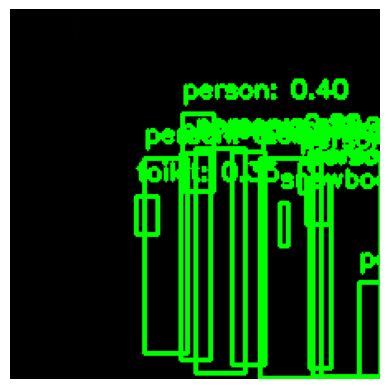

Frame 751, Label: 1, Score: 0.9968359470367432
Frame 751, Label: 1, Score: 0.9900224804878235
Frame 751, Label: 1, Score: 0.9892162084579468
Frame 751, Label: 1, Score: 0.9884983897209167
Frame 751, Label: 1, Score: 0.9851636290550232
Frame 751, Label: 1, Score: 0.9651679992675781
Frame 751, Label: 1, Score: 0.6917985081672668
Frame 751, Label: 1, Score: 0.5986506342887878
Frame 751, Label: 1, Score: 0.5623964071273804
Frame 751, Label: 32, Score: 0.42698872089385986
Frame 751, Label: 1, Score: 0.4015723466873169
Frame 751, Label: 1, Score: 0.3574680685997009
Frame 751, Label: 62, Score: 0.35145303606987


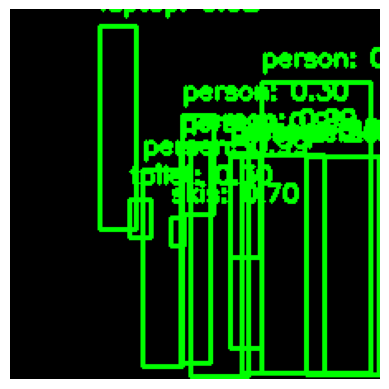

Frame 752, Label: 1, Score: 0.9975591897964478
Frame 752, Label: 1, Score: 0.995191216468811
Frame 752, Label: 1, Score: 0.9911279678344727
Frame 752, Label: 1, Score: 0.9909284710884094
Frame 752, Label: 1, Score: 0.9454445242881775
Frame 752, Label: 1, Score: 0.9314078092575073
Frame 752, Label: 1, Score: 0.8186795115470886
Frame 752, Label: 31, Score: 0.698132336139679
Frame 752, Label: 1, Score: 0.3891334533691406
Frame 752, Label: 64, Score: 0.3179788887500763
Frame 752, Label: 1, Score: 0.3022656738758087
Frame 752, Label: 62, Score: 0.3004690408706665


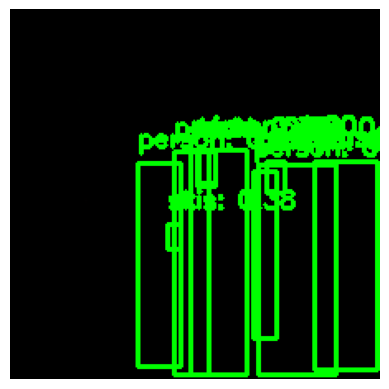

Frame 753, Label: 1, Score: 0.9965904951095581
Frame 753, Label: 1, Score: 0.9938427209854126
Frame 753, Label: 1, Score: 0.9920903444290161
Frame 753, Label: 1, Score: 0.9894638061523438
Frame 753, Label: 1, Score: 0.9690039157867432
Frame 753, Label: 1, Score: 0.9664810299873352
Frame 753, Label: 78, Score: 0.5109748840332031
Frame 753, Label: 1, Score: 0.47656914591789246
Frame 753, Label: 31, Score: 0.3811793625354767
Frame 753, Label: 72, Score: 0.30160486698150635


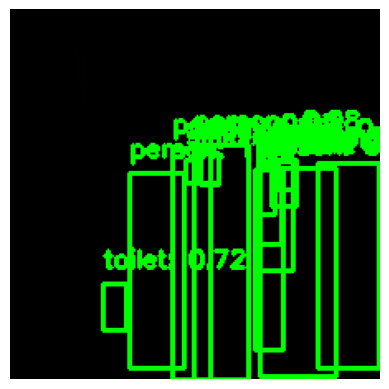

Frame 754, Label: 1, Score: 0.9980825185775757
Frame 754, Label: 1, Score: 0.9957934617996216
Frame 754, Label: 1, Score: 0.9926851987838745
Frame 754, Label: 1, Score: 0.9836742877960205
Frame 754, Label: 1, Score: 0.97061687707901
Frame 754, Label: 1, Score: 0.9613296985626221
Frame 754, Label: 62, Score: 0.7247896194458008
Frame 754, Label: 1, Score: 0.707112729549408
Frame 754, Label: 72, Score: 0.6954028606414795
Frame 754, Label: 1, Score: 0.5168882012367249
Frame 754, Label: 72, Score: 0.4829678535461426
Frame 754, Label: 1, Score: 0.4634321630001068
Frame 754, Label: 78, Score: 0.4587503969669342
Frame 754, Label: 1, Score: 0.4187466502189636
Frame 754, Label: 1, Score: 0.39228060841560364


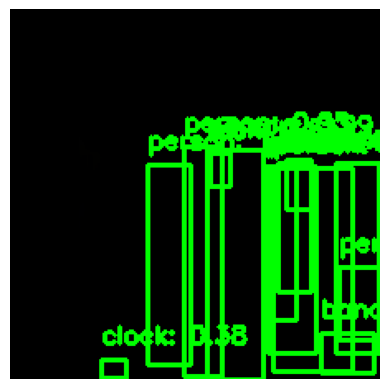

Frame 755, Label: 1, Score: 0.997582197189331
Frame 755, Label: 1, Score: 0.9934406876564026
Frame 755, Label: 1, Score: 0.9889049530029297
Frame 755, Label: 1, Score: 0.9641621708869934
Frame 755, Label: 1, Score: 0.9586399793624878
Frame 755, Label: 1, Score: 0.9511475563049316
Frame 755, Label: 1, Score: 0.7754892110824585
Frame 755, Label: 72, Score: 0.60741126537323
Frame 755, Label: 1, Score: 0.47008711099624634
Frame 755, Label: 1, Score: 0.4003734886646271
Frame 755, Label: 75, Score: 0.3783632516860962
Frame 755, Label: 1, Score: 0.33954888582229614
Frame 755, Label: 47, Score: 0.3010016083717346


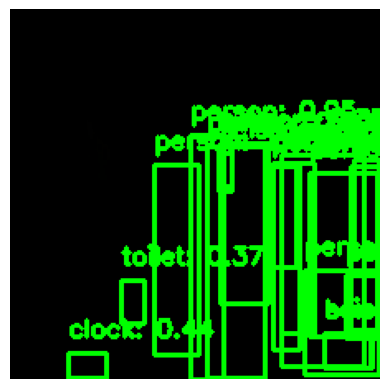

Frame 756, Label: 1, Score: 0.996021568775177
Frame 756, Label: 1, Score: 0.9931702613830566
Frame 756, Label: 1, Score: 0.9899657964706421
Frame 756, Label: 1, Score: 0.9773410558700562
Frame 756, Label: 1, Score: 0.9476755857467651
Frame 756, Label: 1, Score: 0.9134619832038879
Frame 756, Label: 1, Score: 0.6134660243988037
Frame 756, Label: 77, Score: 0.5820502042770386
Frame 756, Label: 1, Score: 0.5380910038948059
Frame 756, Label: 1, Score: 0.5040888786315918
Frame 756, Label: 1, Score: 0.4668751358985901
Frame 756, Label: 47, Score: 0.45220333337783813
Frame 756, Label: 1, Score: 0.4512498080730438
Frame 756, Label: 77, Score: 0.44122517108917236
Frame 756, Label: 1, Score: 0.4398515224456787
Frame 756, Label: 75, Score: 0.4369598925113678
Frame 756, Label: 62, Score: 0.3747442662715912
Frame 756, Label: 1, Score: 0.3451526165008545
Frame 756, Label: 44, Score: 0.3020343482494354


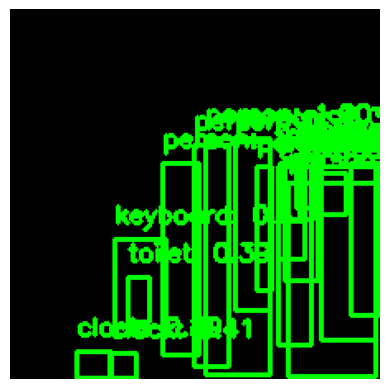

Frame 757, Label: 1, Score: 0.995893120765686
Frame 757, Label: 1, Score: 0.9957591891288757
Frame 757, Label: 1, Score: 0.9955369234085083
Frame 757, Label: 1, Score: 0.9748542308807373
Frame 757, Label: 1, Score: 0.9538417458534241
Frame 757, Label: 1, Score: 0.9492064118385315
Frame 757, Label: 75, Score: 0.8851971626281738
Frame 757, Label: 1, Score: 0.8471813201904297
Frame 757, Label: 1, Score: 0.6569259762763977
Frame 757, Label: 1, Score: 0.6062610745429993
Frame 757, Label: 1, Score: 0.4621172249317169
Frame 757, Label: 1, Score: 0.4266906976699829
Frame 757, Label: 67, Score: 0.40938031673431396
Frame 757, Label: 75, Score: 0.40526479482650757
Frame 757, Label: 1, Score: 0.39816898107528687
Frame 757, Label: 62, Score: 0.3920466899871826
Frame 757, Label: 1, Score: 0.32618144154548645
Frame 757, Label: 1, Score: 0.3155737817287445
Frame 757, Label: 1, Score: 0.31555524468421936


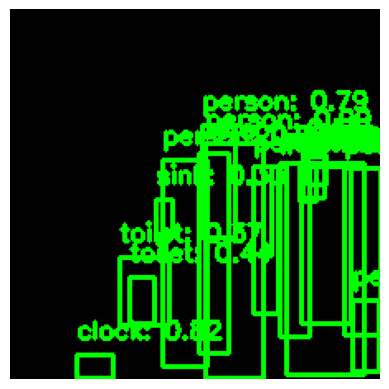

Frame 758, Label: 1, Score: 0.9949678778648376
Frame 758, Label: 1, Score: 0.9885149598121643
Frame 758, Label: 1, Score: 0.9877512454986572
Frame 758, Label: 1, Score: 0.9871298670768738
Frame 758, Label: 1, Score: 0.9493531584739685
Frame 758, Label: 1, Score: 0.934951901435852
Frame 758, Label: 75, Score: 0.815444827079773
Frame 758, Label: 1, Score: 0.7942103743553162
Frame 758, Label: 1, Score: 0.6221739649772644
Frame 758, Label: 1, Score: 0.5503519177436829
Frame 758, Label: 1, Score: 0.5291405320167542
Frame 758, Label: 1, Score: 0.4807170629501343
Frame 758, Label: 62, Score: 0.4364144802093506
Frame 758, Label: 1, Score: 0.396196573972702
Frame 758, Label: 62, Score: 0.37022051215171814
Frame 758, Label: 1, Score: 0.36381515860557556
Frame 758, Label: 72, Score: 0.3290332555770874
Frame 758, Label: 1, Score: 0.31729644536972046


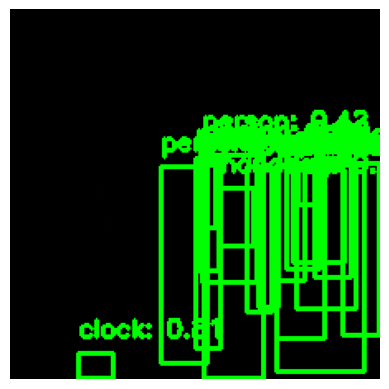

Frame 759, Label: 1, Score: 0.9964151382446289
Frame 759, Label: 1, Score: 0.9948390126228333
Frame 759, Label: 1, Score: 0.9772320985794067
Frame 759, Label: 1, Score: 0.9631200432777405
Frame 759, Label: 1, Score: 0.9520820379257202
Frame 759, Label: 1, Score: 0.9204072952270508
Frame 759, Label: 75, Score: 0.8130698204040527
Frame 759, Label: 1, Score: 0.6862189173698425
Frame 759, Label: 1, Score: 0.5378023982048035
Frame 759, Label: 1, Score: 0.48319920897483826
Frame 759, Label: 1, Score: 0.42722031474113464
Frame 759, Label: 1, Score: 0.4230065643787384
Frame 759, Label: 1, Score: 0.4177186191082001
Frame 759, Label: 1, Score: 0.35859259963035583
Frame 759, Label: 27, Score: 0.3398740291595459
Frame 759, Label: 1, Score: 0.32196372747421265
Frame 759, Label: 1, Score: 0.31426775455474854
Frame 759, Label: 1, Score: 0.3104934096336365
Frame 759, Label: 1, Score: 0.303897500038147


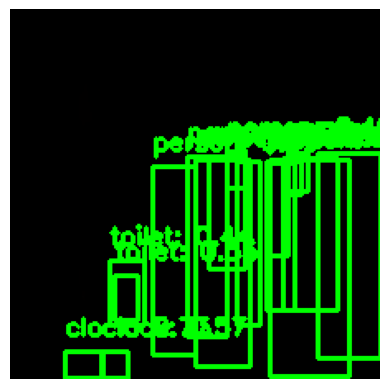

Frame 760, Label: 1, Score: 0.9945698380470276
Frame 760, Label: 1, Score: 0.9848698377609253
Frame 760, Label: 1, Score: 0.9834154844284058
Frame 760, Label: 1, Score: 0.9628746509552002
Frame 760, Label: 1, Score: 0.9437221884727478
Frame 760, Label: 1, Score: 0.9410465955734253
Frame 760, Label: 1, Score: 0.9150669574737549
Frame 760, Label: 1, Score: 0.7549493908882141
Frame 760, Label: 75, Score: 0.7325862646102905
Frame 760, Label: 75, Score: 0.5737001299858093
Frame 760, Label: 62, Score: 0.550609827041626
Frame 760, Label: 1, Score: 0.4889275133609772
Frame 760, Label: 62, Score: 0.44325634837150574
Frame 760, Label: 1, Score: 0.4377549886703491
Frame 760, Label: 1, Score: 0.4306298792362213
Frame 760, Label: 1, Score: 0.3876248300075531
Frame 760, Label: 1, Score: 0.339691698551178


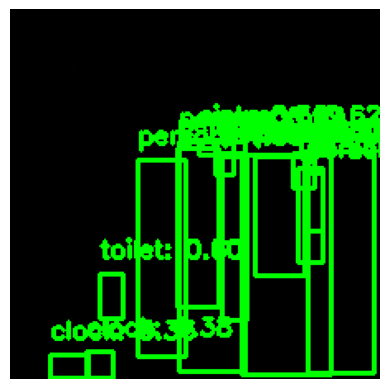

Frame 761, Label: 1, Score: 0.9961624145507812
Frame 761, Label: 1, Score: 0.9956287145614624
Frame 761, Label: 1, Score: 0.9928921461105347
Frame 761, Label: 1, Score: 0.9924479722976685
Frame 761, Label: 1, Score: 0.9309718012809753
Frame 761, Label: 1, Score: 0.6227597594261169
Frame 761, Label: 62, Score: 0.5991480946540833
Frame 761, Label: 1, Score: 0.5634675025939941
Frame 761, Label: 72, Score: 0.5628497004508972
Frame 761, Label: 1, Score: 0.486687034368515
Frame 761, Label: 1, Score: 0.47831976413726807
Frame 761, Label: 1, Score: 0.4721592962741852
Frame 761, Label: 1, Score: 0.44016873836517334
Frame 761, Label: 75, Score: 0.3811970353126526
Frame 761, Label: 75, Score: 0.3608425259590149
Frame 761, Label: 1, Score: 0.3406972885131836


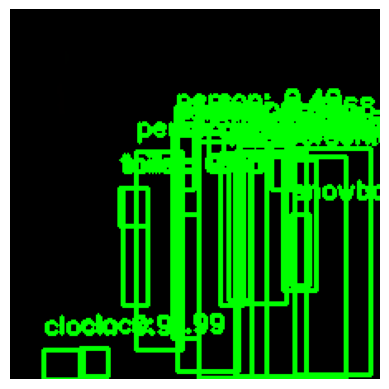

Frame 762, Label: 1, Score: 0.9952818751335144
Frame 762, Label: 1, Score: 0.9952173233032227
Frame 762, Label: 75, Score: 0.9920799136161804
Frame 762, Label: 1, Score: 0.9895594120025635
Frame 762, Label: 1, Score: 0.9892779588699341
Frame 762, Label: 75, Score: 0.9111384153366089
Frame 762, Label: 1, Score: 0.8742903470993042
Frame 762, Label: 1, Score: 0.8722491264343262
Frame 762, Label: 32, Score: 0.731837809085846
Frame 762, Label: 1, Score: 0.722053587436676
Frame 762, Label: 1, Score: 0.7180046439170837
Frame 762, Label: 1, Score: 0.680446207523346
Frame 762, Label: 62, Score: 0.6517102718353271
Frame 762, Label: 1, Score: 0.6359785795211792
Frame 762, Label: 1, Score: 0.6038529872894287
Frame 762, Label: 1, Score: 0.49432072043418884
Frame 762, Label: 1, Score: 0.4805532991886139
Frame 762, Label: 1, Score: 0.4787459373474121
Frame 762, Label: 62, Score: 0.33142760396003723
Frame 762, Label: 1, Score: 0.320290207862854


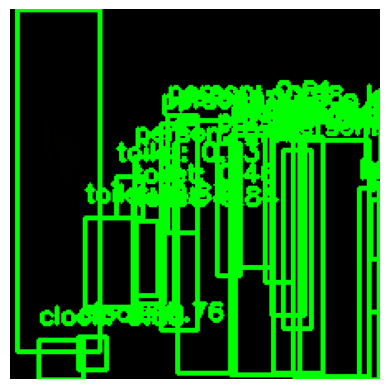

Frame 763, Label: 1, Score: 0.9961445331573486
Frame 763, Label: 1, Score: 0.9831704497337341
Frame 763, Label: 1, Score: 0.9806162118911743
Frame 763, Label: 1, Score: 0.9659075736999512
Frame 763, Label: 1, Score: 0.900934100151062
Frame 763, Label: 75, Score: 0.8817195892333984
Frame 763, Label: 1, Score: 0.8485405445098877
Frame 763, Label: 62, Score: 0.8369906544685364
Frame 763, Label: 62, Score: 0.8291178941726685
Frame 763, Label: 1, Score: 0.784005880355835
Frame 763, Label: 75, Score: 0.7594176530838013
Frame 763, Label: 1, Score: 0.7269726991653442
Frame 763, Label: 1, Score: 0.6861898899078369
Frame 763, Label: 1, Score: 0.606998860836029
Frame 763, Label: 62, Score: 0.5267230272293091
Frame 763, Label: 1, Score: 0.5125782489776611
Frame 763, Label: 62, Score: 0.4568324685096741
Frame 763, Label: 1, Score: 0.43957585096359253
Frame 763, Label: 72, Score: 0.37346160411834717
Frame 763, Label: 1, Score: 0.36527544260025024
Frame 763, Label: 1, Score: 0.3591805100440979
Frame 

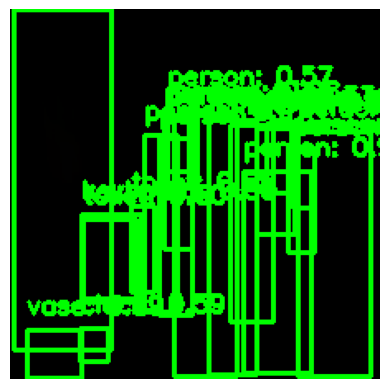

Frame 764, Label: 1, Score: 0.99729984998703
Frame 764, Label: 1, Score: 0.9911256432533264
Frame 764, Label: 1, Score: 0.9846839308738708
Frame 764, Label: 1, Score: 0.9788194298744202
Frame 764, Label: 1, Score: 0.9744151830673218
Frame 764, Label: 76, Score: 0.8948642015457153
Frame 764, Label: 1, Score: 0.7532153129577637
Frame 764, Label: 1, Score: 0.6576184630393982
Frame 764, Label: 62, Score: 0.6463820338249207
Frame 764, Label: 1, Score: 0.6407414078712463
Frame 764, Label: 62, Score: 0.5960889458656311
Frame 764, Label: 75, Score: 0.5923824906349182
Frame 764, Label: 1, Score: 0.5718501806259155
Frame 764, Label: 67, Score: 0.5021252036094666
Frame 764, Label: 1, Score: 0.41394293308258057
Frame 764, Label: 72, Score: 0.40666961669921875
Frame 764, Label: 1, Score: 0.40491822361946106
Frame 764, Label: 1, Score: 0.33277174830436707
Frame 764, Label: 1, Score: 0.32997411489486694
Frame 764, Label: 1, Score: 0.3085922300815582


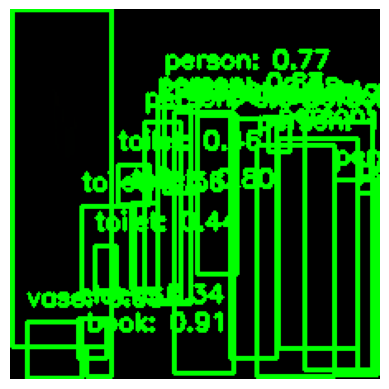

Frame 765, Label: 1, Score: 0.9956492781639099
Frame 765, Label: 1, Score: 0.9886342287063599
Frame 765, Label: 1, Score: 0.9813854694366455
Frame 765, Label: 1, Score: 0.9746368527412415
Frame 765, Label: 76, Score: 0.9480232000350952
Frame 765, Label: 1, Score: 0.9447035193443298
Frame 765, Label: 74, Score: 0.9138416051864624
Frame 765, Label: 1, Score: 0.8725799322128296
Frame 765, Label: 1, Score: 0.835260272026062
Frame 765, Label: 62, Score: 0.7971164584159851
Frame 765, Label: 1, Score: 0.7734898924827576
Frame 765, Label: 1, Score: 0.6038786768913269
Frame 765, Label: 62, Score: 0.5579656362533569
Frame 765, Label: 1, Score: 0.4661673307418823
Frame 765, Label: 62, Score: 0.4564545452594757
Frame 765, Label: 62, Score: 0.4422084093093872
Frame 765, Label: 1, Score: 0.43987777829170227
Frame 765, Label: 72, Score: 0.39655593037605286
Frame 765, Label: 75, Score: 0.3414672613143921
Frame 765, Label: 1, Score: 0.3082403242588043


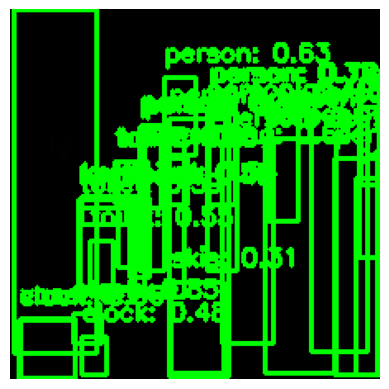

Frame 766, Label: 1, Score: 0.9941120743751526
Frame 766, Label: 1, Score: 0.9905625581741333
Frame 766, Label: 1, Score: 0.9844061136245728
Frame 766, Label: 1, Score: 0.9752119183540344
Frame 766, Label: 1, Score: 0.9376004338264465
Frame 766, Label: 1, Score: 0.9258629083633423
Frame 766, Label: 75, Score: 0.8474246859550476
Frame 766, Label: 1, Score: 0.7806722521781921
Frame 766, Label: 76, Score: 0.7434865236282349
Frame 766, Label: 62, Score: 0.6841030716896057
Frame 766, Label: 27, Score: 0.6419938206672668
Frame 766, Label: 1, Score: 0.6316662430763245
Frame 766, Label: 62, Score: 0.6076297163963318
Frame 766, Label: 62, Score: 0.5898246765136719
Frame 766, Label: 62, Score: 0.5837516188621521
Frame 766, Label: 1, Score: 0.5664308667182922
Frame 766, Label: 75, Score: 0.5598828196525574
Frame 766, Label: 62, Score: 0.55214923620224
Frame 766, Label: 75, Score: 0.4835926592350006
Frame 766, Label: 1, Score: 0.4343867897987366
Frame 766, Label: 67, Score: 0.4209153354167938
Fram

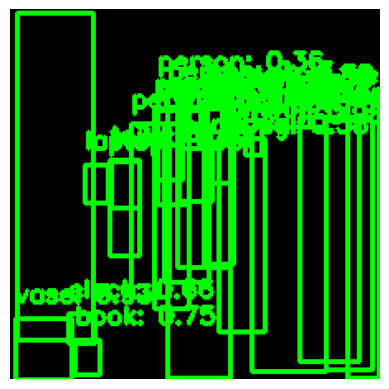

Frame 767, Label: 1, Score: 0.9920903444290161
Frame 767, Label: 1, Score: 0.9771060943603516
Frame 767, Label: 1, Score: 0.9735355377197266
Frame 767, Label: 1, Score: 0.9701095223426819
Frame 767, Label: 1, Score: 0.9532939195632935
Frame 767, Label: 76, Score: 0.9291292428970337
Frame 767, Label: 1, Score: 0.8921145796775818
Frame 767, Label: 1, Score: 0.8431057333946228
Frame 767, Label: 62, Score: 0.8160853385925293
Frame 767, Label: 74, Score: 0.7489748597145081
Frame 767, Label: 75, Score: 0.6634221076965332
Frame 767, Label: 1, Score: 0.5863491296768188
Frame 767, Label: 27, Score: 0.5800402164459229
Frame 767, Label: 1, Score: 0.5760109424591064
Frame 767, Label: 1, Score: 0.44439229369163513
Frame 767, Label: 62, Score: 0.42110496759414673
Frame 767, Label: 72, Score: 0.39666780829429626
Frame 767, Label: 1, Score: 0.381373792886734
Frame 767, Label: 1, Score: 0.3787839412689209
Frame 767, Label: 1, Score: 0.3758527636528015
Frame 767, Label: 72, Score: 0.3686070144176483
Fra

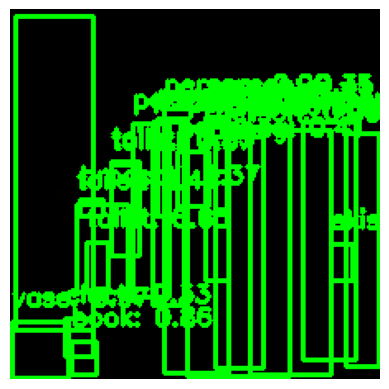

Frame 768, Label: 1, Score: 0.998322069644928
Frame 768, Label: 1, Score: 0.9889988303184509
Frame 768, Label: 1, Score: 0.9861415028572083
Frame 768, Label: 76, Score: 0.9732193946838379
Frame 768, Label: 1, Score: 0.9664426445960999
Frame 768, Label: 1, Score: 0.9505985379219055
Frame 768, Label: 1, Score: 0.9286012053489685
Frame 768, Label: 62, Score: 0.8687665462493896
Frame 768, Label: 74, Score: 0.8571810722351074
Frame 768, Label: 31, Score: 0.7954526543617249
Frame 768, Label: 1, Score: 0.7716131210327148
Frame 768, Label: 1, Score: 0.730580747127533
Frame 768, Label: 1, Score: 0.6987146735191345
Frame 768, Label: 62, Score: 0.6457616686820984
Frame 768, Label: 1, Score: 0.4743283987045288
Frame 768, Label: 72, Score: 0.4603847563266754
Frame 768, Label: 62, Score: 0.4396635591983795
Frame 768, Label: 27, Score: 0.4141220450401306
Frame 768, Label: 51, Score: 0.37479713559150696
Frame 768, Label: 1, Score: 0.35075077414512634
Frame 768, Label: 62, Score: 0.3289894163608551
Fra

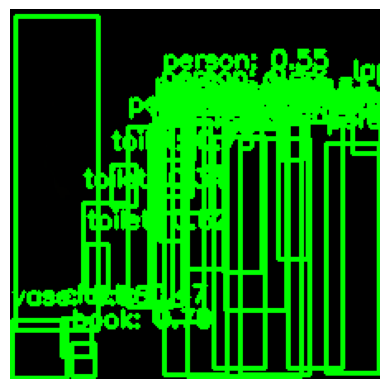

Frame 769, Label: 1, Score: 0.9907193779945374
Frame 769, Label: 1, Score: 0.9854961037635803
Frame 769, Label: 1, Score: 0.9849666357040405
Frame 769, Label: 1, Score: 0.9843335747718811
Frame 769, Label: 1, Score: 0.9716436862945557
Frame 769, Label: 76, Score: 0.95963454246521
Frame 769, Label: 1, Score: 0.8943510055541992
Frame 769, Label: 74, Score: 0.7904421091079712
Frame 769, Label: 62, Score: 0.7288387417793274
Frame 769, Label: 62, Score: 0.617110550403595
Frame 769, Label: 1, Score: 0.6159183979034424
Frame 769, Label: 64, Score: 0.5735196471214294
Frame 769, Label: 1, Score: 0.5548903942108154
Frame 769, Label: 1, Score: 0.5154271721839905
Frame 769, Label: 75, Score: 0.4722646176815033
Frame 769, Label: 1, Score: 0.45769163966178894
Frame 769, Label: 1, Score: 0.45589807629585266
Frame 769, Label: 1, Score: 0.4504047930240631
Frame 769, Label: 1, Score: 0.41622480750083923
Frame 769, Label: 1, Score: 0.4081198275089264
Frame 769, Label: 1, Score: 0.3909063935279846
Frame 7

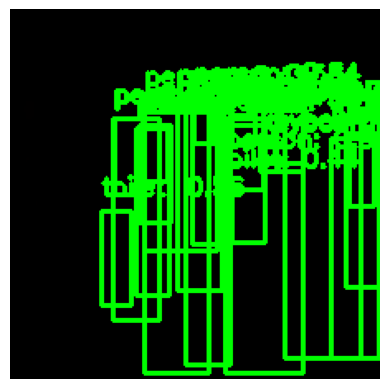

Frame 770, Label: 1, Score: 0.9929520487785339
Frame 770, Label: 1, Score: 0.982882022857666
Frame 770, Label: 1, Score: 0.9824228286743164
Frame 770, Label: 1, Score: 0.9679850935935974
Frame 770, Label: 1, Score: 0.8997525572776794
Frame 770, Label: 1, Score: 0.8301185965538025
Frame 770, Label: 1, Score: 0.80140221118927
Frame 770, Label: 1, Score: 0.761091947555542
Frame 770, Label: 1, Score: 0.7351474761962891
Frame 770, Label: 1, Score: 0.6280657052993774
Frame 770, Label: 1, Score: 0.581095278263092
Frame 770, Label: 62, Score: 0.5634571313858032
Frame 770, Label: 67, Score: 0.5140523314476013
Frame 770, Label: 1, Score: 0.49377790093421936
Frame 770, Label: 1, Score: 0.4671357572078705
Frame 770, Label: 1, Score: 0.46011781692504883
Frame 770, Label: 62, Score: 0.4388352334499359
Frame 770, Label: 1, Score: 0.42405179142951965
Frame 770, Label: 1, Score: 0.40447720885276794
Frame 770, Label: 1, Score: 0.3908458650112152
Frame 770, Label: 67, Score: 0.37014445662498474
Frame 770

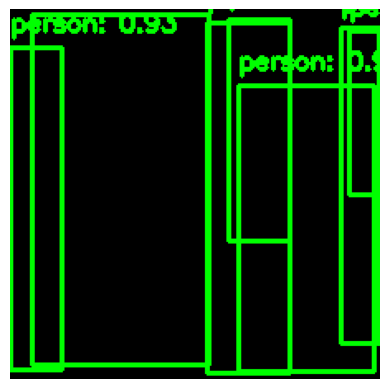

Frame 771, Label: 1, Score: 0.9913598895072937
Frame 771, Label: 1, Score: 0.9852848649024963
Frame 771, Label: 1, Score: 0.9693254232406616
Frame 771, Label: 1, Score: 0.9299358129501343
Frame 771, Label: 1, Score: 0.6259475946426392
Frame 771, Label: 1, Score: 0.5129544734954834
Frame 771, Label: 1, Score: 0.305165559053421


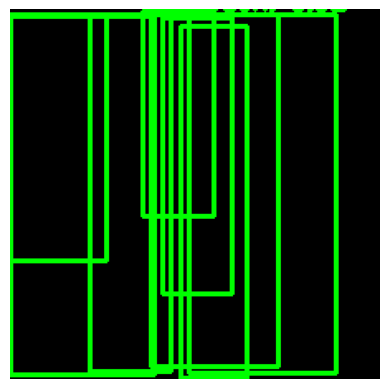

Frame 772, Label: 1, Score: 0.9918093085289001
Frame 772, Label: 1, Score: 0.9744421243667603
Frame 772, Label: 1, Score: 0.9349987506866455
Frame 772, Label: 1, Score: 0.9241540431976318
Frame 772, Label: 1, Score: 0.6195033192634583
Frame 772, Label: 1, Score: 0.5210663676261902
Frame 772, Label: 1, Score: 0.4207480251789093
Frame 772, Label: 1, Score: 0.40149906277656555


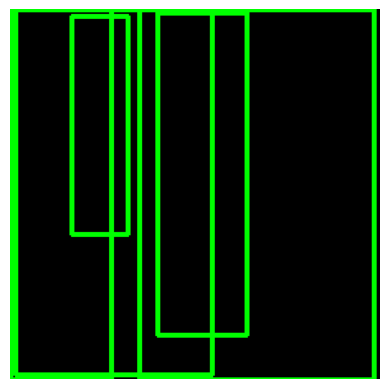

Frame 773, Label: 1, Score: 0.8973706364631653
Frame 773, Label: 52, Score: 0.8639516830444336
Frame 773, Label: 1, Score: 0.6878905892372131
Frame 773, Label: 1, Score: 0.33115607500076294
Frame 773, Label: 1, Score: 0.3008385896682739


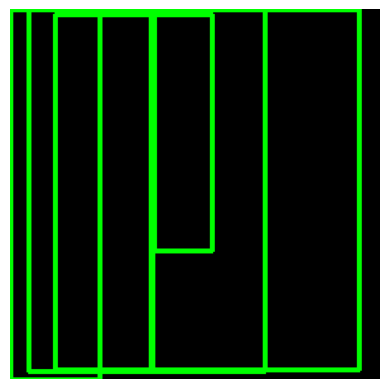

Frame 774, Label: 1, Score: 0.9137603640556335
Frame 774, Label: 1, Score: 0.862951397895813
Frame 774, Label: 1, Score: 0.6676989197731018
Frame 774, Label: 1, Score: 0.47014138102531433
Frame 774, Label: 1, Score: 0.3182973861694336


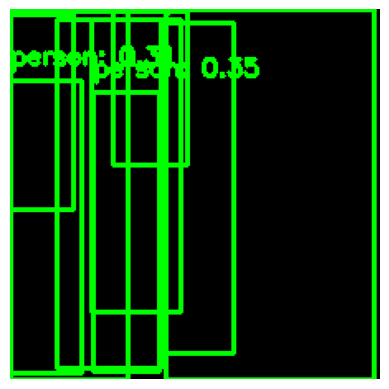

Frame 775, Label: 1, Score: 0.9828373193740845
Frame 775, Label: 1, Score: 0.9826105237007141
Frame 775, Label: 1, Score: 0.9060120582580566
Frame 775, Label: 1, Score: 0.8956655263900757
Frame 775, Label: 1, Score: 0.4927138686180115
Frame 775, Label: 1, Score: 0.44399216771125793
Frame 775, Label: 1, Score: 0.3606370687484741
Frame 775, Label: 1, Score: 0.3471735119819641
Frame 775, Label: 1, Score: 0.311502069234848


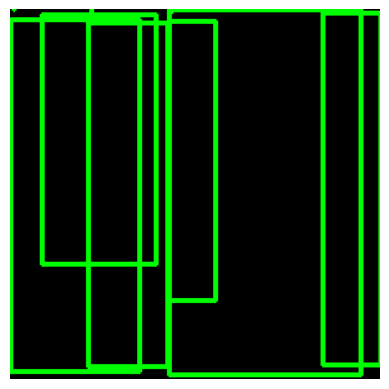

Frame 776, Label: 1, Score: 0.9941049814224243
Frame 776, Label: 1, Score: 0.9295365214347839
Frame 776, Label: 1, Score: 0.9231309294700623
Frame 776, Label: 1, Score: 0.9018082022666931
Frame 776, Label: 1, Score: 0.665839433670044
Frame 776, Label: 1, Score: 0.3395981192588806


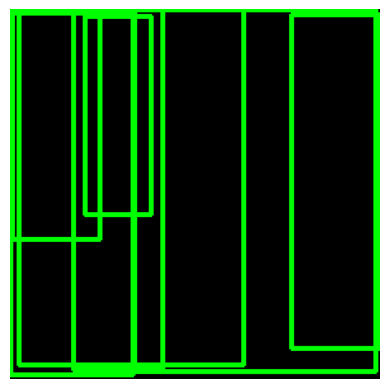

Frame 777, Label: 1, Score: 0.9925950169563293
Frame 777, Label: 1, Score: 0.9844942688941956
Frame 777, Label: 1, Score: 0.978661060333252
Frame 777, Label: 1, Score: 0.9372885823249817
Frame 777, Label: 1, Score: 0.6639887690544128
Frame 777, Label: 1, Score: 0.4629977345466614
Frame 777, Label: 1, Score: 0.3988432288169861


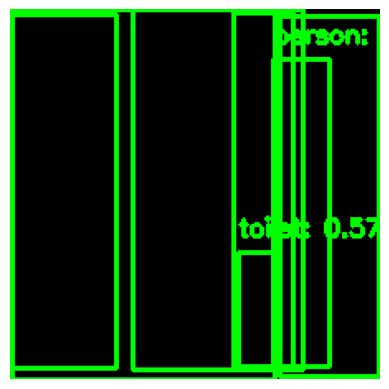

Frame 778, Label: 1, Score: 0.9976533055305481
Frame 778, Label: 1, Score: 0.965415894985199
Frame 778, Label: 1, Score: 0.8826733231544495
Frame 778, Label: 1, Score: 0.7181181907653809
Frame 778, Label: 1, Score: 0.6440728306770325
Frame 778, Label: 62, Score: 0.5664772987365723
Frame 778, Label: 1, Score: 0.5431410074234009


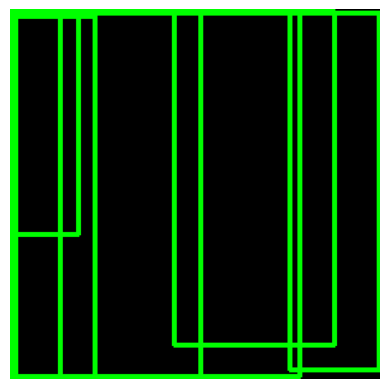

Frame 779, Label: 1, Score: 0.9892935752868652
Frame 779, Label: 1, Score: 0.9840307235717773
Frame 779, Label: 1, Score: 0.917212963104248
Frame 779, Label: 1, Score: 0.91316819190979
Frame 779, Label: 1, Score: 0.740846574306488
Frame 779, Label: 1, Score: 0.3145658075809479


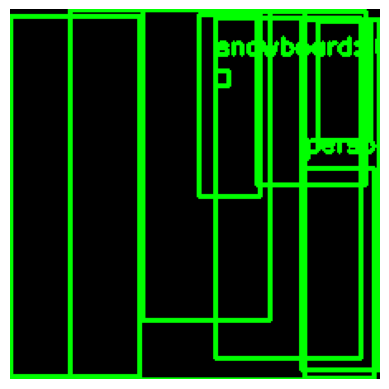

Frame 780, Label: 1, Score: 0.9944679737091064
Frame 780, Label: 1, Score: 0.9825698733329773
Frame 780, Label: 1, Score: 0.8693549036979675
Frame 780, Label: 1, Score: 0.8312844634056091
Frame 780, Label: 1, Score: 0.7919782400131226
Frame 780, Label: 1, Score: 0.3820219933986664
Frame 780, Label: 1, Score: 0.3472188413143158
Frame 780, Label: 1, Score: 0.3156746029853821
Frame 780, Label: 1, Score: 0.3149999678134918
Frame 780, Label: 32, Score: 0.303272545337677


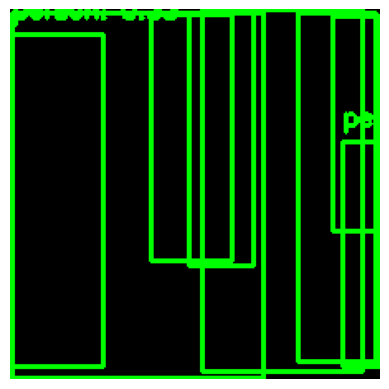

Frame 781, Label: 1, Score: 0.999049961566925
Frame 781, Label: 1, Score: 0.9741163849830627
Frame 781, Label: 1, Score: 0.9277236461639404
Frame 781, Label: 1, Score: 0.7350479364395142
Frame 781, Label: 1, Score: 0.5003750324249268
Frame 781, Label: 1, Score: 0.4946037828922272
Frame 781, Label: 1, Score: 0.45255807042121887
Frame 781, Label: 1, Score: 0.33337581157684326


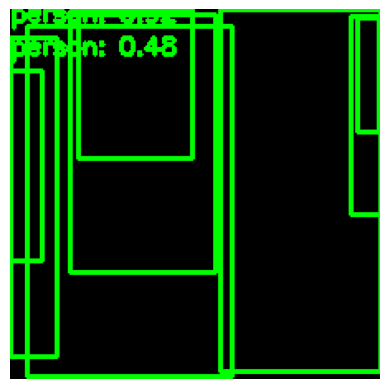

Frame 782, Label: 1, Score: 0.9984863996505737
Frame 782, Label: 1, Score: 0.9663295149803162
Frame 782, Label: 1, Score: 0.9238811731338501
Frame 782, Label: 1, Score: 0.8430755734443665
Frame 782, Label: 1, Score: 0.5456278324127197
Frame 782, Label: 1, Score: 0.4849465787410736
Frame 782, Label: 1, Score: 0.4787846505641937
Frame 782, Label: 1, Score: 0.4502648711204529


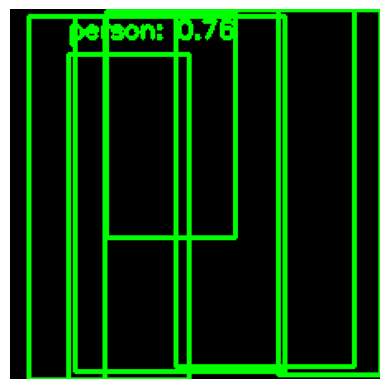

Frame 783, Label: 1, Score: 0.9897773861885071
Frame 783, Label: 1, Score: 0.9821344614028931
Frame 783, Label: 1, Score: 0.9521978497505188
Frame 783, Label: 1, Score: 0.7567300796508789
Frame 783, Label: 1, Score: 0.6333500146865845
Frame 783, Label: 1, Score: 0.5981529951095581


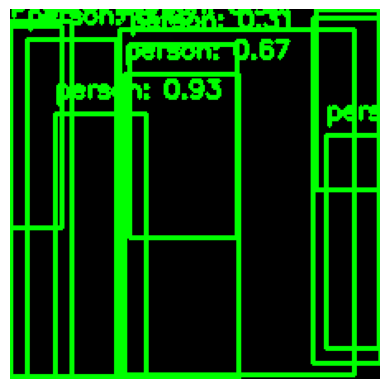

Frame 784, Label: 1, Score: 0.9881094098091125
Frame 784, Label: 1, Score: 0.9637119770050049
Frame 784, Label: 1, Score: 0.9490357041358948
Frame 784, Label: 1, Score: 0.9258448481559753
Frame 784, Label: 1, Score: 0.7818123698234558
Frame 784, Label: 1, Score: 0.674711287021637
Frame 784, Label: 1, Score: 0.5900174379348755
Frame 784, Label: 1, Score: 0.4551486372947693
Frame 784, Label: 1, Score: 0.33316606283187866
Frame 784, Label: 1, Score: 0.30738404393196106


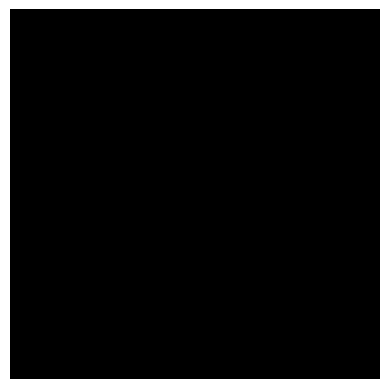

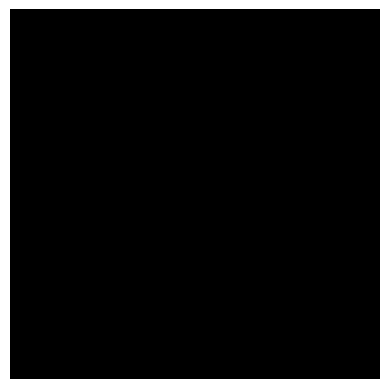

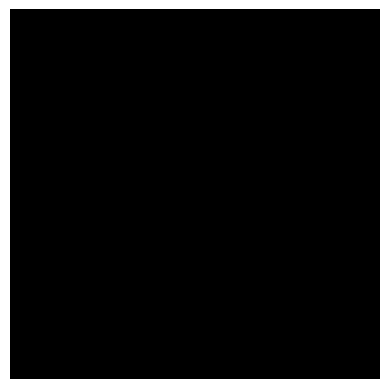

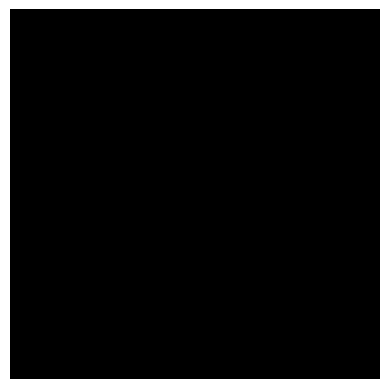

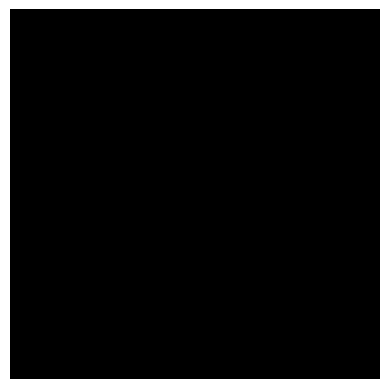

...

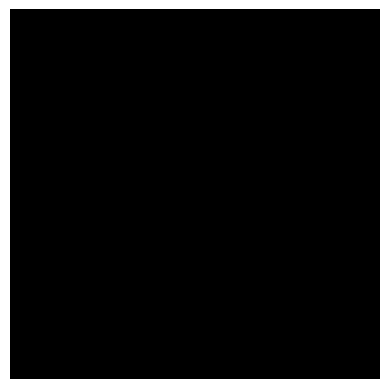

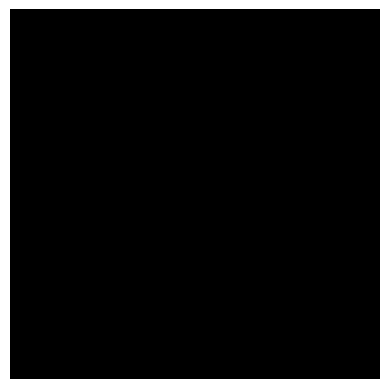

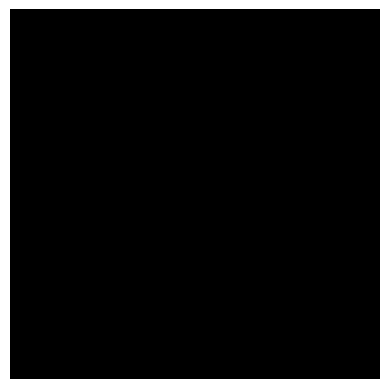

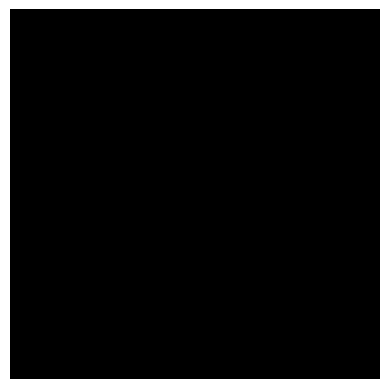

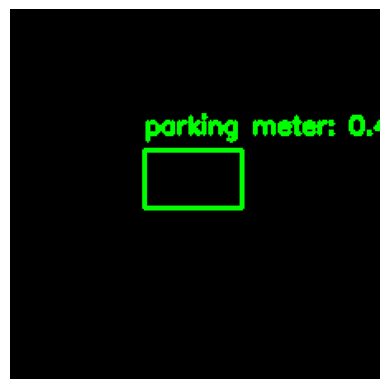

Frame 812, Label: 13, Score: 0.4425171911716461


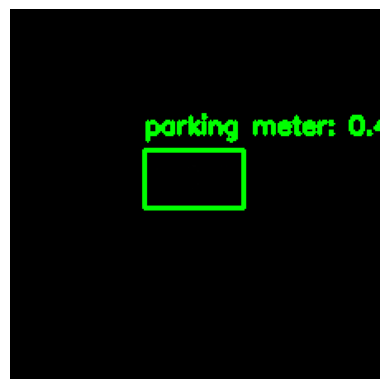

Frame 813, Label: 13, Score: 0.4083178639411926


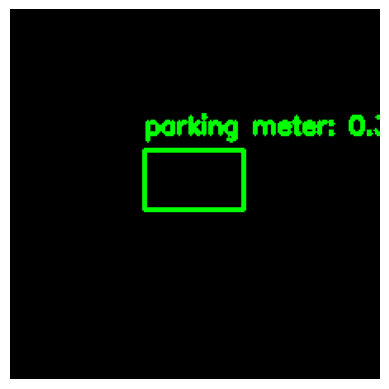

Frame 814, Label: 13, Score: 0.3621491491794586


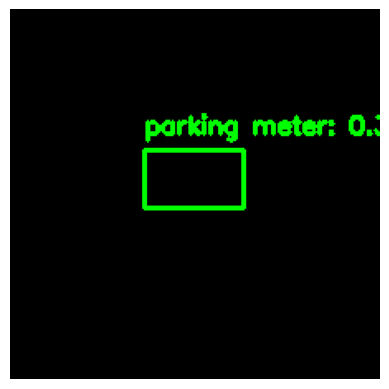

Frame 815, Label: 13, Score: 0.37733152508735657


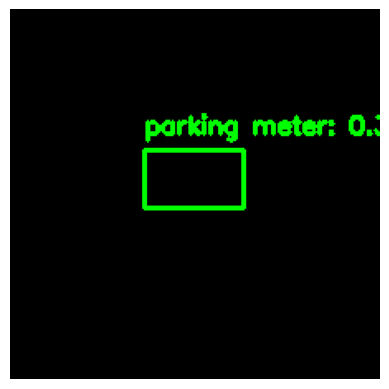

Frame 816, Label: 13, Score: 0.37733152508735657


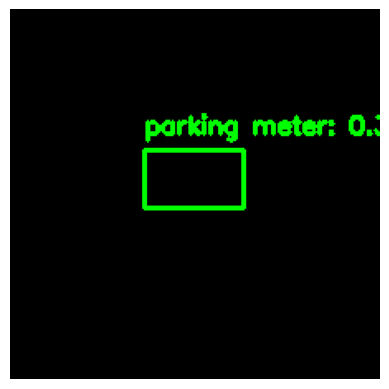

Frame 817, Label: 13, Score: 0.37733152508735657


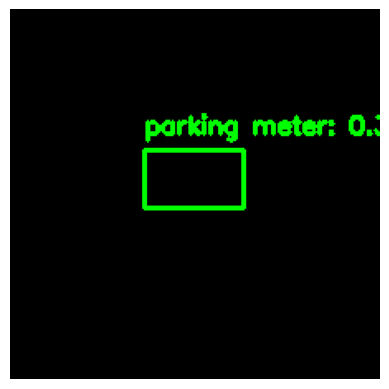

Frame 818, Label: 13, Score: 0.37733152508735657


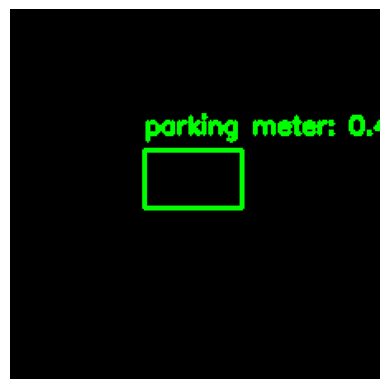

Frame 819, Label: 13, Score: 0.40699300169944763


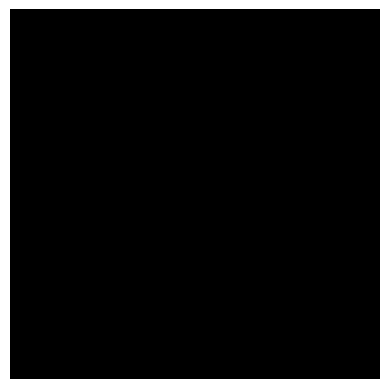

Processing file: FlJoBhLnqko.npy
Number of frames in FlJoBhLnqko.npy: 550


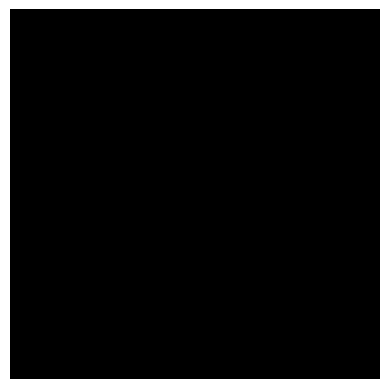

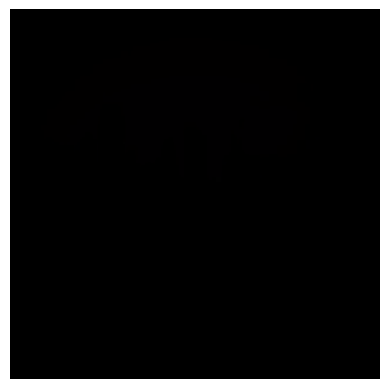

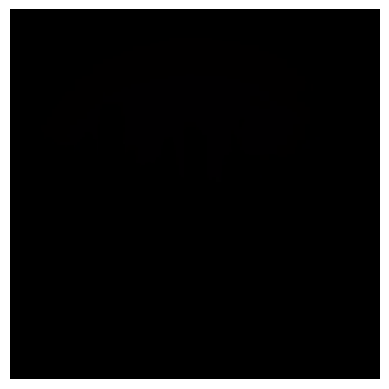

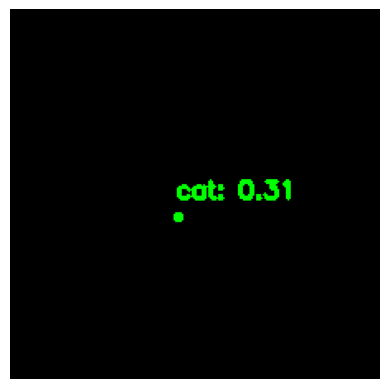

Frame 3, Label: 16, Score: 0.30812016129493713


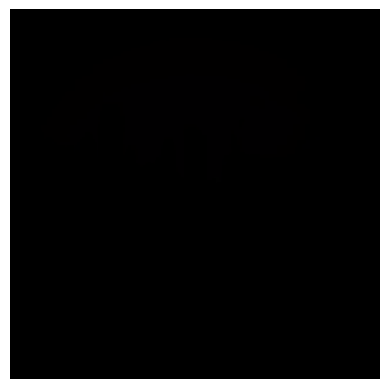

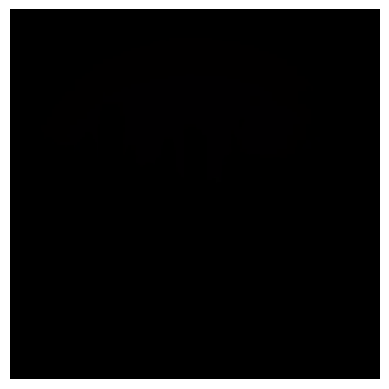

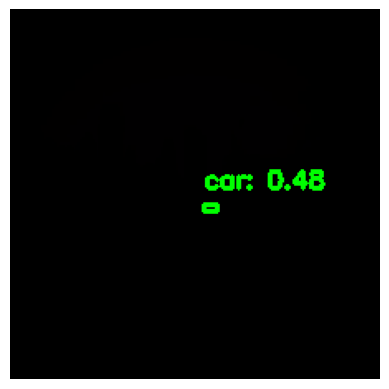

Frame 6, Label: 3, Score: 0.4750111997127533


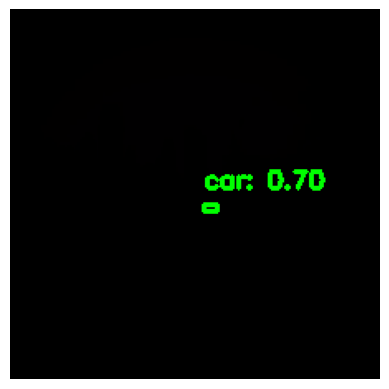

Frame 7, Label: 3, Score: 0.7014564871788025


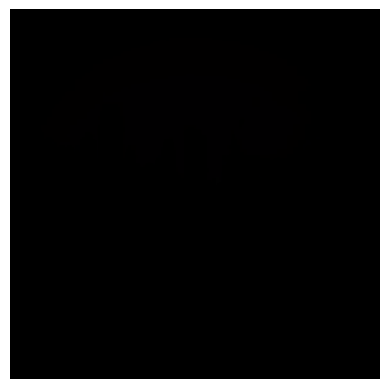

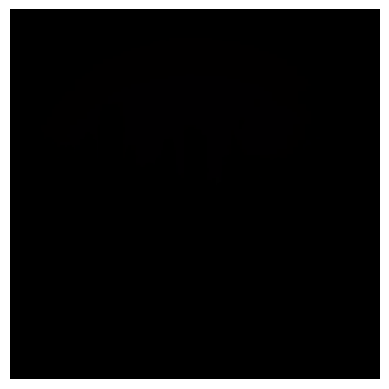

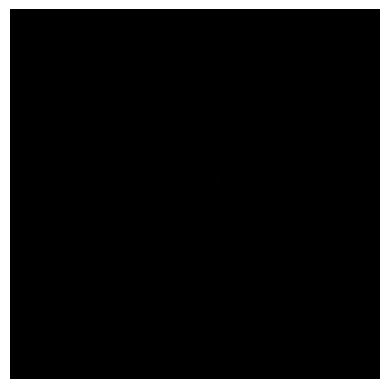

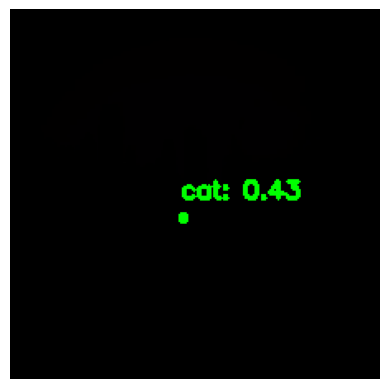

Frame 11, Label: 16, Score: 0.42560237646102905


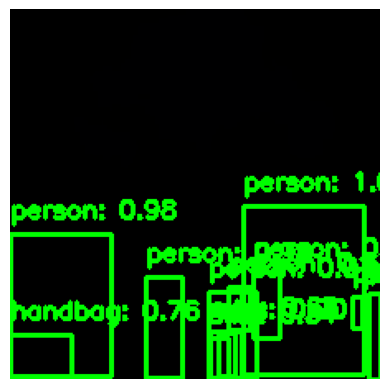

Frame 12, Label: 1, Score: 0.9973445534706116
Frame 12, Label: 1, Score: 0.9844053387641907
Frame 12, Label: 1, Score: 0.9821266531944275
Frame 12, Label: 1, Score: 0.9694892764091492
Frame 12, Label: 31, Score: 0.9003618955612183
Frame 12, Label: 1, Score: 0.8699159026145935
Frame 12, Label: 1, Score: 0.7726446390151978
Frame 12, Label: 27, Score: 0.7634972333908081
Frame 12, Label: 1, Score: 0.7547829747200012
Frame 12, Label: 1, Score: 0.6674869656562805
Frame 12, Label: 31, Score: 0.6525532007217407
Frame 12, Label: 31, Score: 0.3418216109275818
Frame 12, Label: 1, Score: 0.3357481062412262


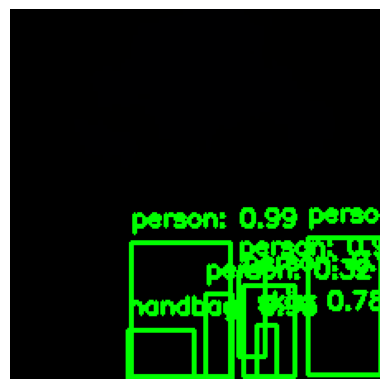

Frame 13, Label: 1, Score: 0.9982008934020996
Frame 13, Label: 1, Score: 0.9939714074134827
Frame 13, Label: 1, Score: 0.9853203892707825
Frame 13, Label: 1, Score: 0.9728015661239624
Frame 13, Label: 27, Score: 0.9250279664993286
Frame 13, Label: 31, Score: 0.780880868434906
Frame 13, Label: 1, Score: 0.31834033131599426


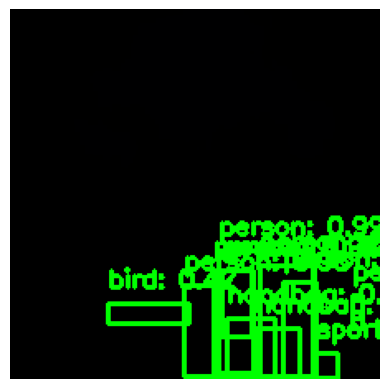

Frame 14, Label: 1, Score: 0.9898855686187744
Frame 14, Label: 1, Score: 0.9764295816421509
Frame 14, Label: 1, Score: 0.9210537075996399
Frame 14, Label: 33, Score: 0.8959571719169617
Frame 14, Label: 27, Score: 0.7261642217636108
Frame 14, Label: 1, Score: 0.6740061044692993
Frame 14, Label: 27, Score: 0.525288462638855
Frame 14, Label: 1, Score: 0.4281976521015167
Frame 14, Label: 1, Score: 0.4240058660507202
Frame 14, Label: 15, Score: 0.4174014627933502
Frame 14, Label: 1, Score: 0.3602064251899719


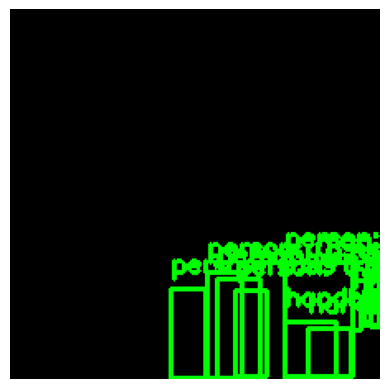

Frame 15, Label: 1, Score: 0.9966891407966614
Frame 15, Label: 1, Score: 0.9944385290145874
Frame 15, Label: 1, Score: 0.9942728877067566
Frame 15, Label: 1, Score: 0.980688214302063
Frame 15, Label: 27, Score: 0.9378033876419067
Frame 15, Label: 1, Score: 0.8637377619743347
Frame 15, Label: 1, Score: 0.763764500617981
Frame 15, Label: 1, Score: 0.7068749666213989
Frame 15, Label: 1, Score: 0.5457397103309631
Frame 15, Label: 1, Score: 0.35618311166763306
Frame 15, Label: 27, Score: 0.30117067694664


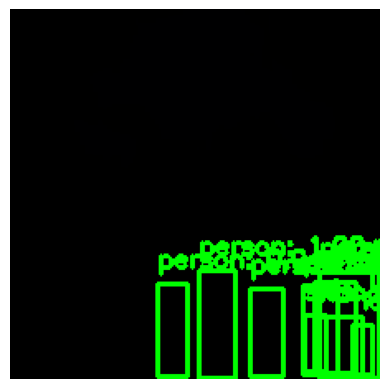

Frame 16, Label: 1, Score: 0.9965898990631104
Frame 16, Label: 1, Score: 0.990929901599884
Frame 16, Label: 1, Score: 0.986203670501709
Frame 16, Label: 27, Score: 0.9746267795562744
Frame 16, Label: 1, Score: 0.9391352534294128
Frame 16, Label: 1, Score: 0.9375104308128357
Frame 16, Label: 31, Score: 0.4800763428211212
Frame 16, Label: 1, Score: 0.42498892545700073
Frame 16, Label: 27, Score: 0.38146933913230896
Frame 16, Label: 1, Score: 0.3626940846443176


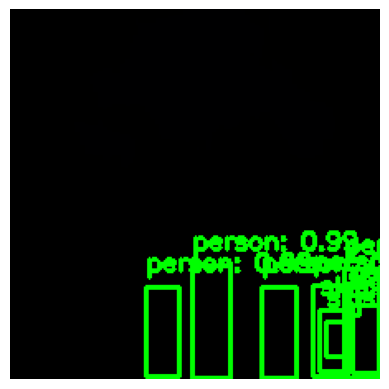

Frame 17, Label: 1, Score: 0.9949466586112976
Frame 17, Label: 1, Score: 0.9918377995491028
Frame 17, Label: 1, Score: 0.985967218875885
Frame 17, Label: 1, Score: 0.9354820847511292
Frame 17, Label: 31, Score: 0.8948807120323181
Frame 17, Label: 1, Score: 0.7284014821052551
Frame 17, Label: 27, Score: 0.6389124393463135
Frame 17, Label: 1, Score: 0.5769049525260925
Frame 17, Label: 31, Score: 0.34678998589515686


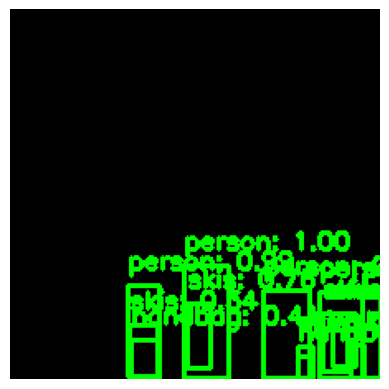

Frame 18, Label: 1, Score: 0.9971470236778259
Frame 18, Label: 1, Score: 0.9932054281234741
Frame 18, Label: 1, Score: 0.9912516474723816
Frame 18, Label: 1, Score: 0.9870157241821289
Frame 18, Label: 31, Score: 0.9548470377922058
Frame 18, Label: 1, Score: 0.7683582305908203
Frame 18, Label: 31, Score: 0.7573514580726624
Frame 18, Label: 31, Score: 0.5928245782852173
Frame 18, Label: 31, Score: 0.5136966109275818
Frame 18, Label: 27, Score: 0.4051518142223358
Frame 18, Label: 31, Score: 0.3392578959465027
Frame 18, Label: 27, Score: 0.320387601852417
Frame 18, Label: 31, Score: 0.3012261986732483


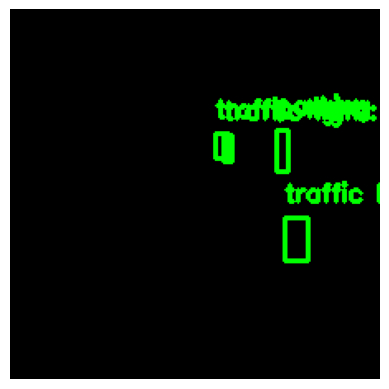

Frame 19, Label: 13, Score: 0.6367108225822449
Frame 19, Label: 10, Score: 0.6253969073295593
Frame 19, Label: 10, Score: 0.3649406135082245
Frame 19, Label: 10, Score: 0.3231509029865265


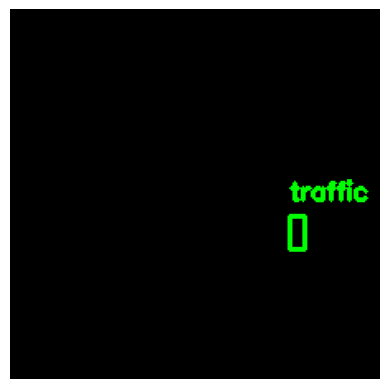

Frame 20, Label: 10, Score: 0.5108330845832825


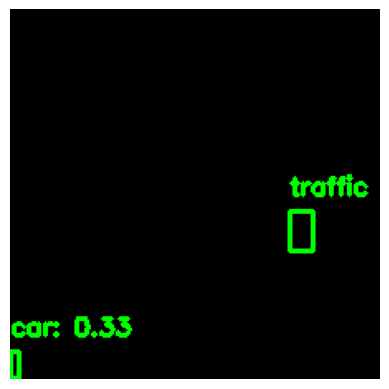

Frame 21, Label: 10, Score: 0.5906888246536255
Frame 21, Label: 3, Score: 0.32799917459487915


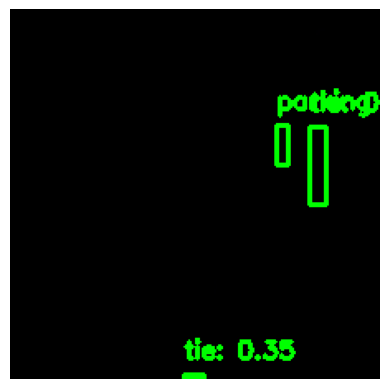

Frame 22, Label: 28, Score: 0.48708194494247437
Frame 22, Label: 28, Score: 0.34978097677230835
Frame 22, Label: 13, Score: 0.3244227468967438


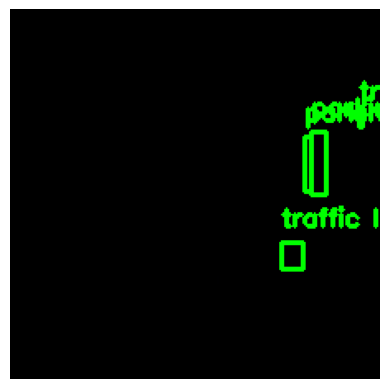

Frame 23, Label: 10, Score: 0.5681526064872742
Frame 23, Label: 10, Score: 0.5227100849151611
Frame 23, Label: 13, Score: 0.45968568325042725
Frame 23, Label: 13, Score: 0.32860323786735535


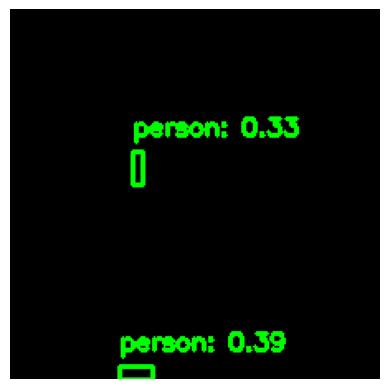

Frame 24, Label: 1, Score: 0.39330920577049255
Frame 24, Label: 1, Score: 0.32585608959198


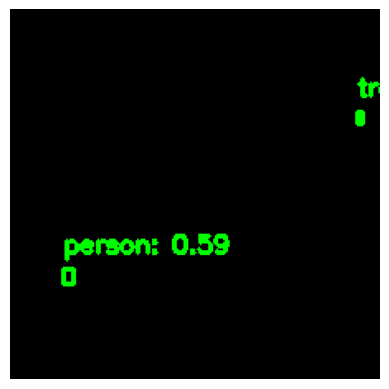

Frame 25, Label: 1, Score: 0.5937323570251465
Frame 25, Label: 10, Score: 0.4112798273563385


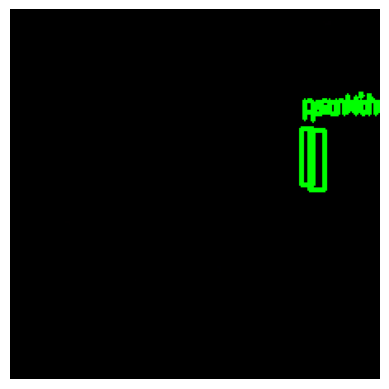

Frame 26, Label: 13, Score: 0.6383485198020935
Frame 26, Label: 13, Score: 0.3652609586715698


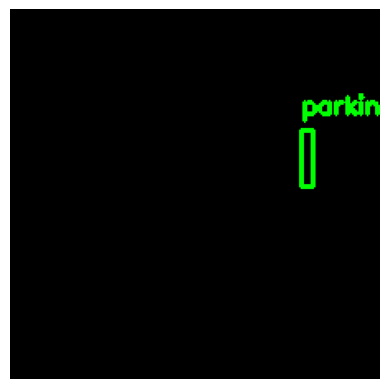

Frame 27, Label: 13, Score: 0.3554081618785858


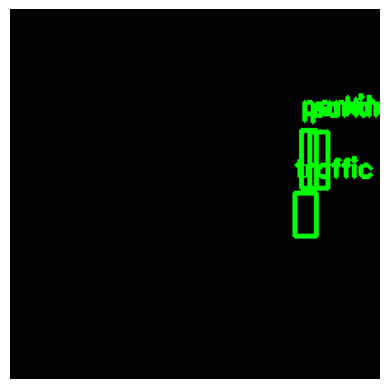

Frame 28, Label: 13, Score: 0.4712761342525482
Frame 28, Label: 10, Score: 0.4506523311138153
Frame 28, Label: 13, Score: 0.3524516522884369


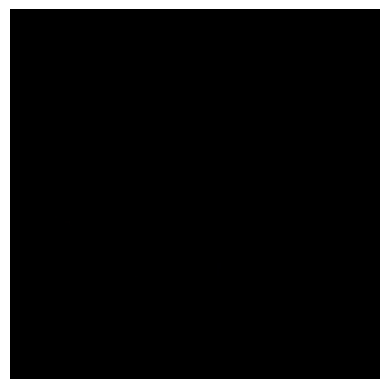

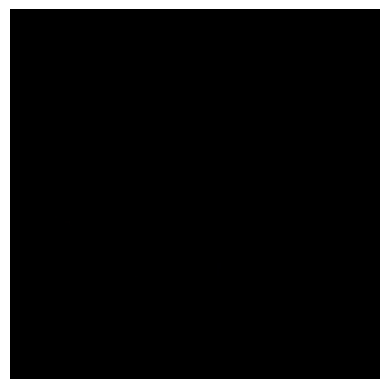

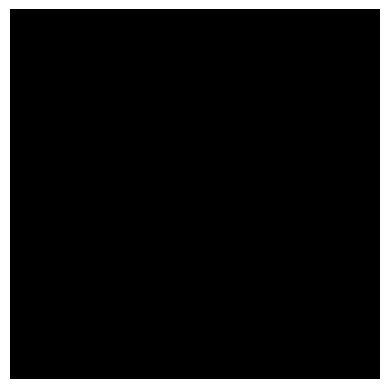

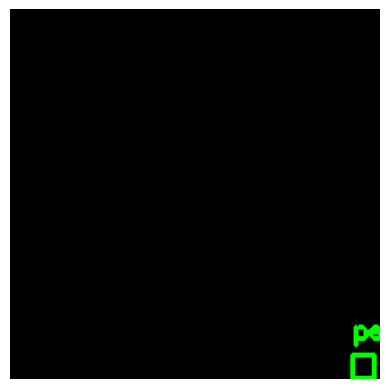

Frame 32, Label: 1, Score: 0.5707233548164368


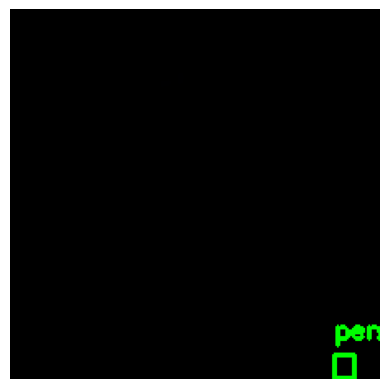

Frame 33, Label: 1, Score: 0.7962979674339294


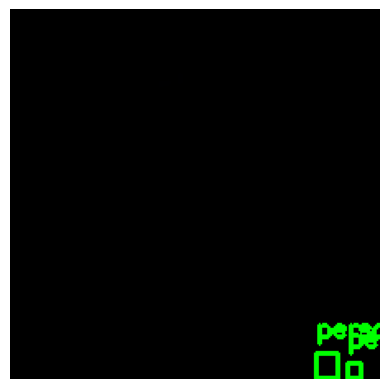

Frame 34, Label: 1, Score: 0.8990219831466675
Frame 34, Label: 1, Score: 0.41648632287979126


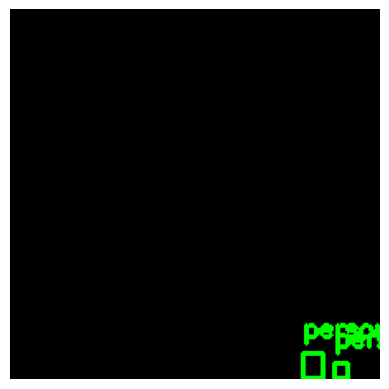

Frame 35, Label: 1, Score: 0.8682659268379211
Frame 35, Label: 1, Score: 0.5096997022628784


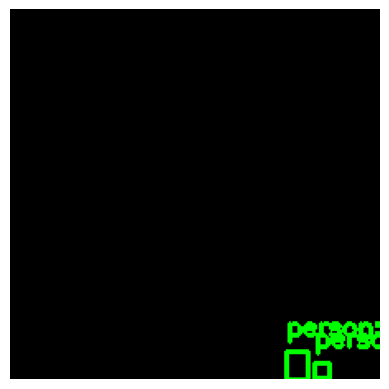

Frame 36, Label: 1, Score: 0.7640776038169861
Frame 36, Label: 1, Score: 0.309764564037323


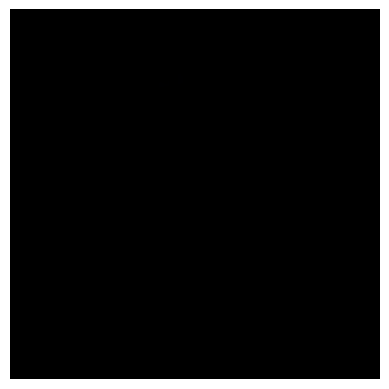

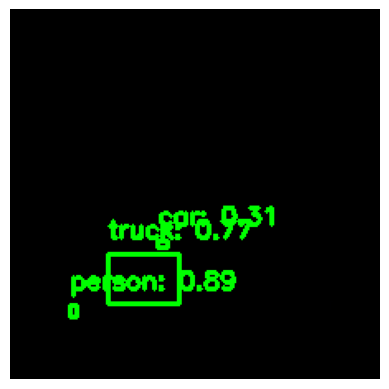

Frame 38, Label: 1, Score: 0.8877865672111511
Frame 38, Label: 8, Score: 0.7671078443527222
Frame 38, Label: 3, Score: 0.3097420334815979


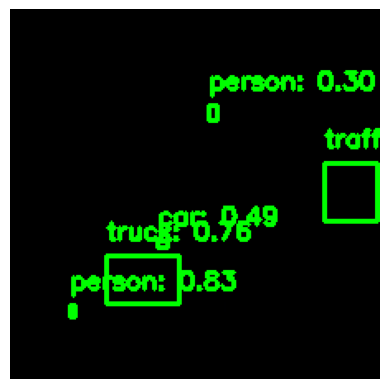

Frame 39, Label: 1, Score: 0.8290919661521912
Frame 39, Label: 10, Score: 0.7926177382469177
Frame 39, Label: 8, Score: 0.7550007104873657
Frame 39, Label: 3, Score: 0.4939999282360077
Frame 39, Label: 1, Score: 0.30463600158691406


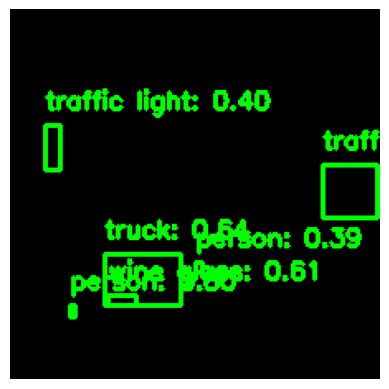

Frame 40, Label: 1, Score: 0.8008551001548767
Frame 40, Label: 10, Score: 0.6814725995063782
Frame 40, Label: 8, Score: 0.6419814825057983
Frame 40, Label: 41, Score: 0.6118433475494385
Frame 40, Label: 10, Score: 0.39559465646743774
Frame 40, Label: 1, Score: 0.3940119445323944


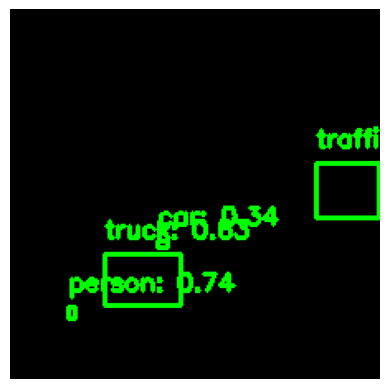

Frame 41, Label: 1, Score: 0.737325131893158
Frame 41, Label: 8, Score: 0.6323392987251282
Frame 41, Label: 10, Score: 0.5451672673225403
Frame 41, Label: 3, Score: 0.3364223539829254


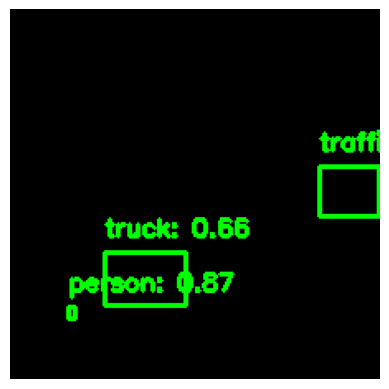

Frame 42, Label: 1, Score: 0.8672842979431152
Frame 42, Label: 8, Score: 0.6615001559257507
Frame 42, Label: 10, Score: 0.6462640762329102


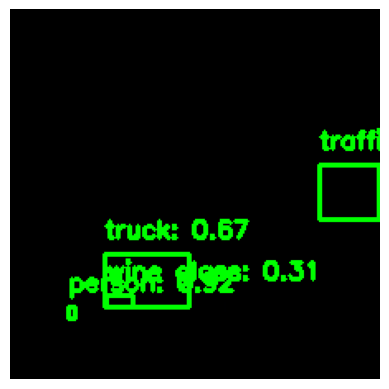

Frame 43, Label: 1, Score: 0.9234117865562439
Frame 43, Label: 10, Score: 0.8478237986564636
Frame 43, Label: 8, Score: 0.6739929914474487
Frame 43, Label: 41, Score: 0.3106852173805237


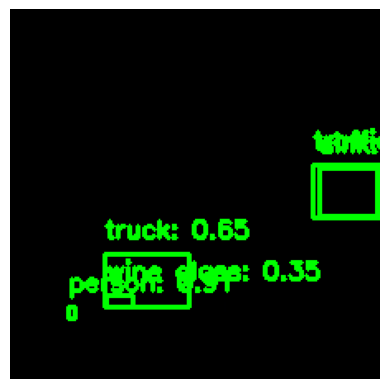

Frame 44, Label: 1, Score: 0.9122318625450134
Frame 44, Label: 10, Score: 0.7437870502471924
Frame 44, Label: 8, Score: 0.6528265476226807
Frame 44, Label: 41, Score: 0.35320600867271423
Frame 44, Label: 72, Score: 0.3340560793876648


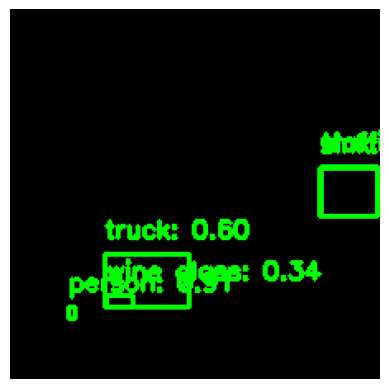

Frame 45, Label: 1, Score: 0.9093204140663147
Frame 45, Label: 10, Score: 0.7845761179924011
Frame 45, Label: 8, Score: 0.5997726917266846
Frame 45, Label: 41, Score: 0.34441450238227844
Frame 45, Label: 72, Score: 0.32012253999710083


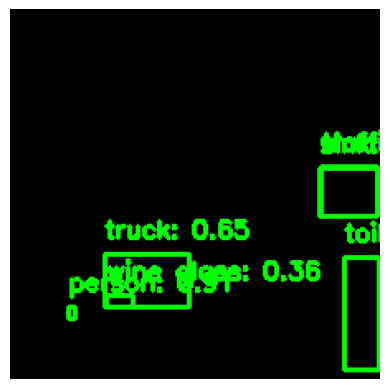

Frame 46, Label: 1, Score: 0.9094310998916626
Frame 46, Label: 10, Score: 0.7908298373222351
Frame 46, Label: 8, Score: 0.6490556001663208
Frame 46, Label: 41, Score: 0.356716513633728
Frame 46, Label: 62, Score: 0.33432984352111816
Frame 46, Label: 72, Score: 0.31906139850616455


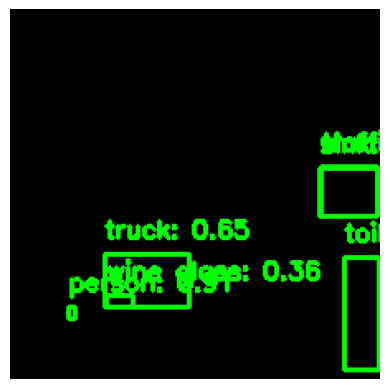

Frame 47, Label: 1, Score: 0.9093859791755676
Frame 47, Label: 10, Score: 0.7886229753494263
Frame 47, Label: 8, Score: 0.649056077003479
Frame 47, Label: 41, Score: 0.3567346930503845
Frame 47, Label: 62, Score: 0.33432984352111816
Frame 47, Label: 72, Score: 0.3265903890132904


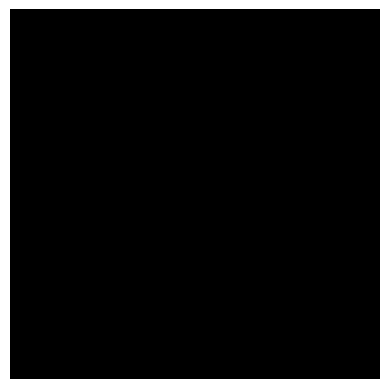

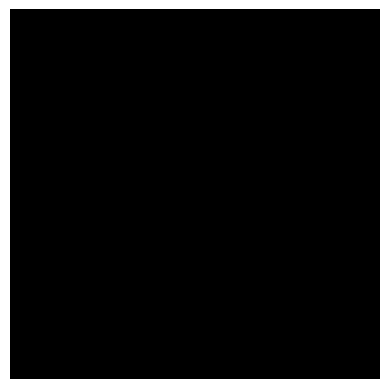

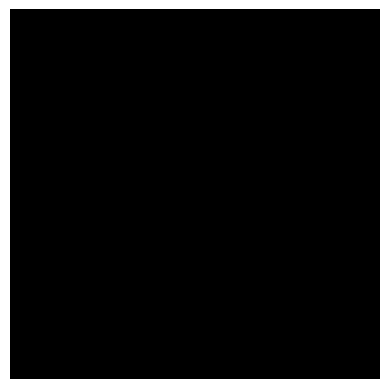

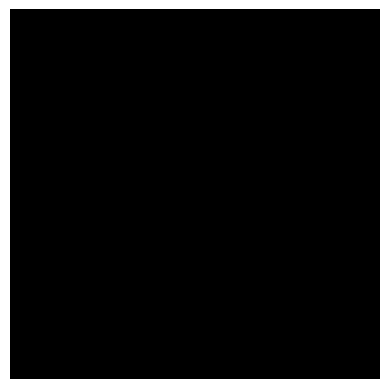

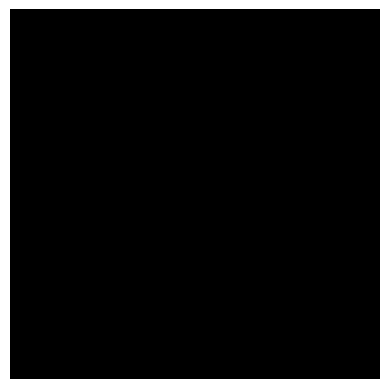

...

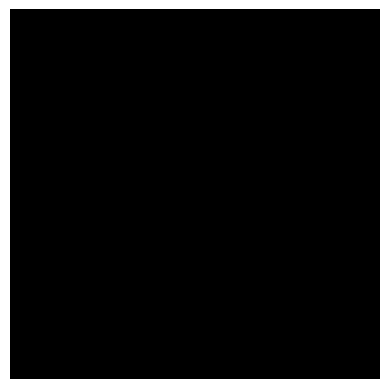

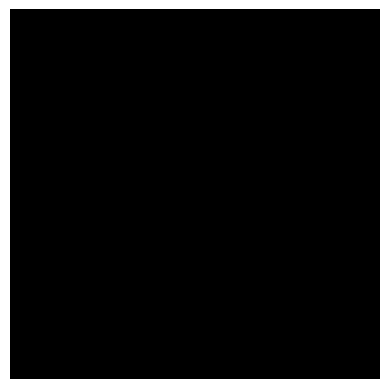

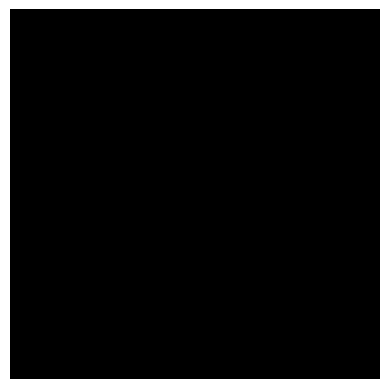

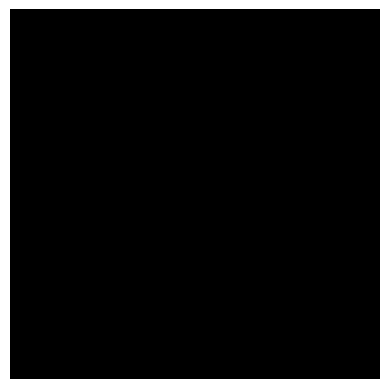

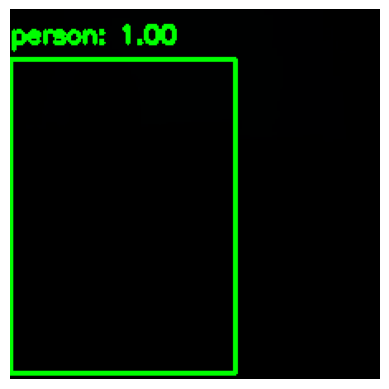

Frame 58, Label: 1, Score: 0.9992074370384216


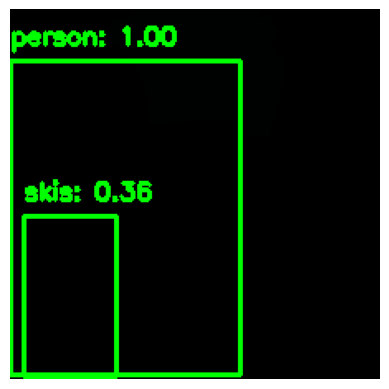

Frame 59, Label: 1, Score: 0.9994136095046997
Frame 59, Label: 31, Score: 0.3615274131298065


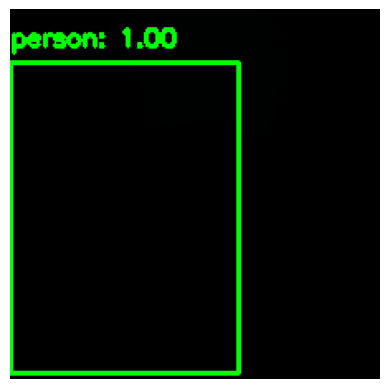

Frame 60, Label: 1, Score: 0.9990236759185791


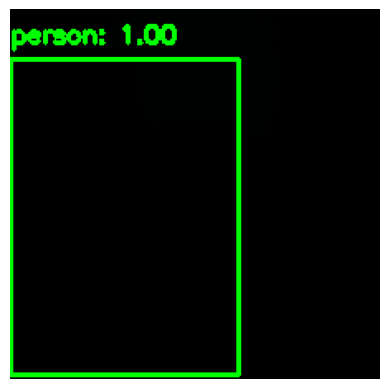

Frame 61, Label: 1, Score: 0.9991082549095154


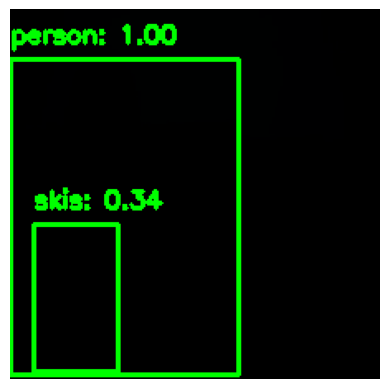

Frame 62, Label: 1, Score: 0.9990007281303406
Frame 62, Label: 31, Score: 0.33873802423477173


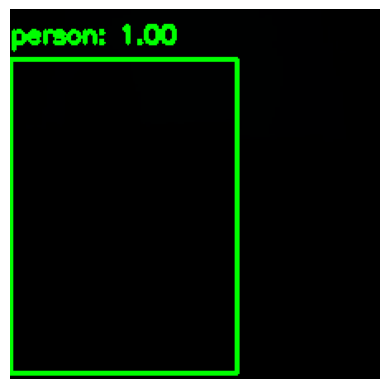

Frame 63, Label: 1, Score: 0.9993977546691895


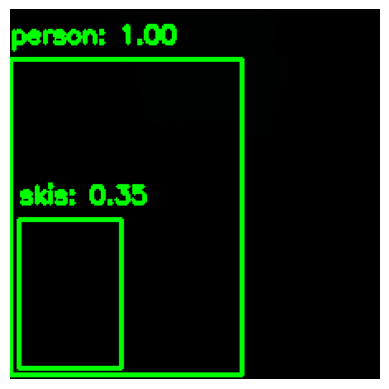

Frame 64, Label: 1, Score: 0.9994434714317322
Frame 64, Label: 31, Score: 0.3532211482524872


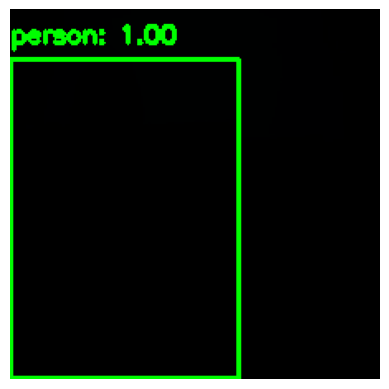

Frame 65, Label: 1, Score: 0.999043881893158


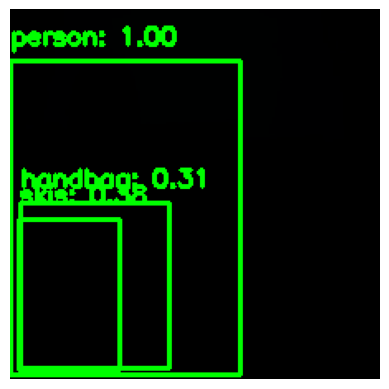

Frame 66, Label: 1, Score: 0.99916672706604
Frame 66, Label: 31, Score: 0.38150593638420105
Frame 66, Label: 27, Score: 0.30841636657714844


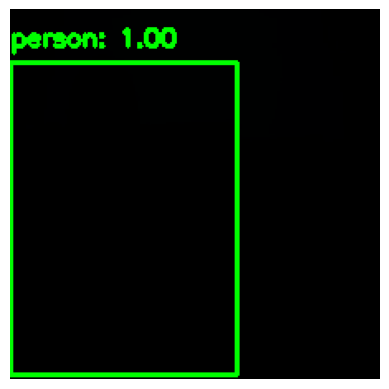

Frame 67, Label: 1, Score: 0.9989808201789856


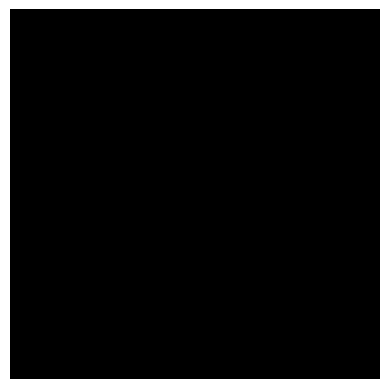

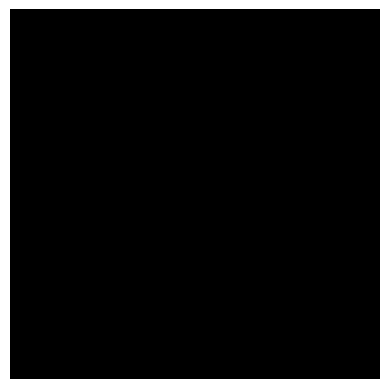

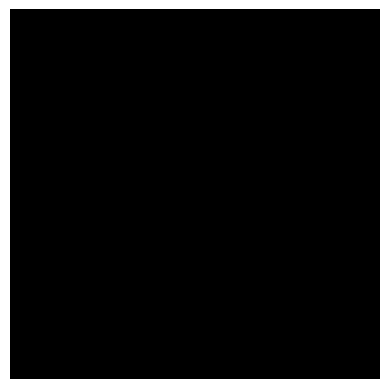

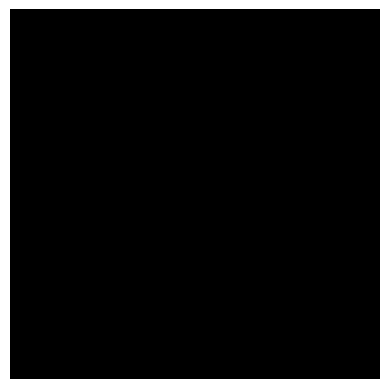

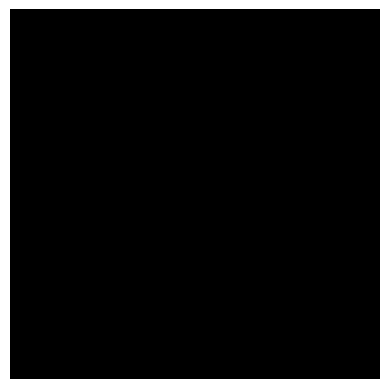

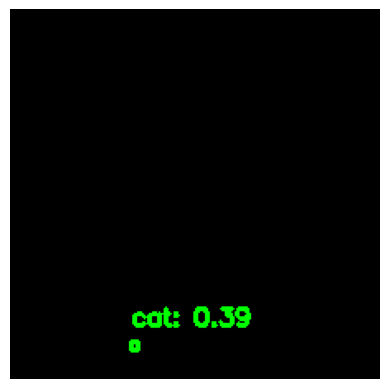

Frame 73, Label: 16, Score: 0.38865000009536743


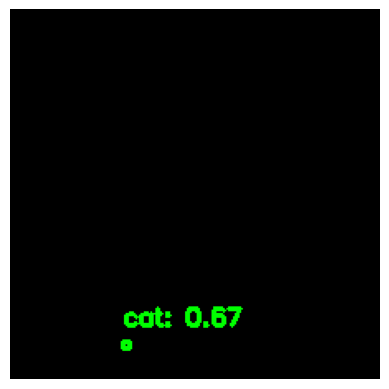

Frame 74, Label: 16, Score: 0.6704369187355042


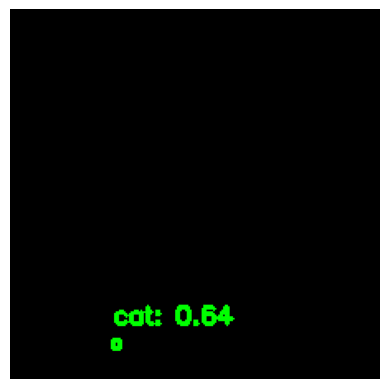

Frame 75, Label: 16, Score: 0.6351732611656189


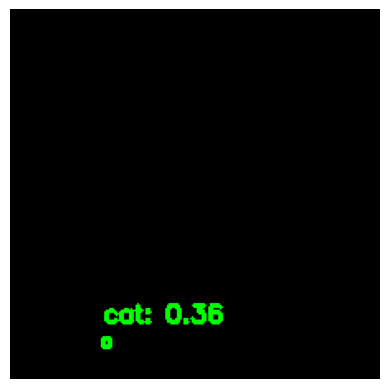

Frame 76, Label: 16, Score: 0.3595210313796997


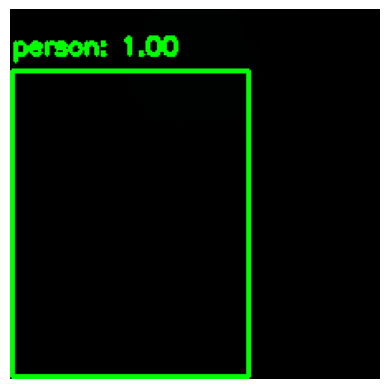

Frame 77, Label: 1, Score: 0.9988283514976501


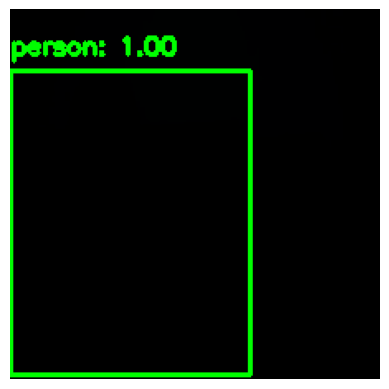

Frame 78, Label: 1, Score: 0.9993606209754944


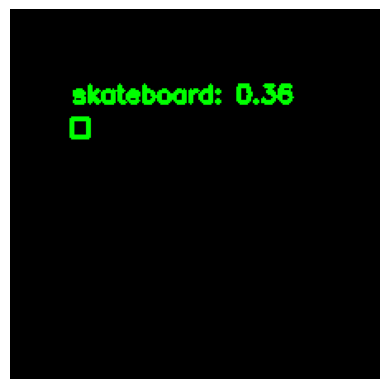

Frame 79, Label: 37, Score: 0.35594841837882996


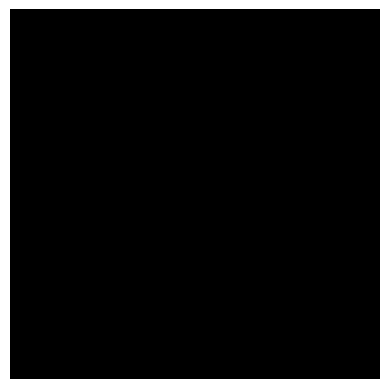

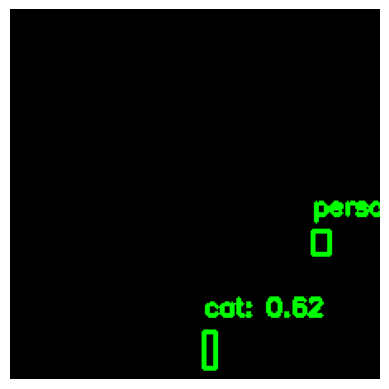

Frame 81, Label: 16, Score: 0.6228938698768616
Frame 81, Label: 1, Score: 0.4640394449234009


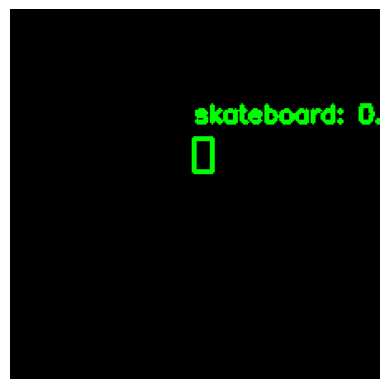

Frame 82, Label: 37, Score: 0.8034955263137817


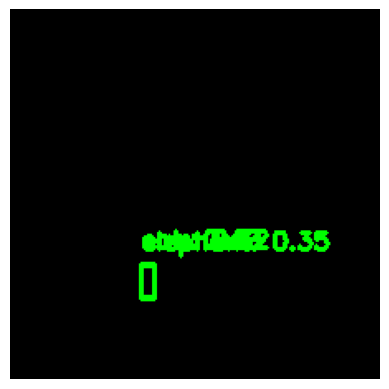

Frame 83, Label: 20, Score: 0.5199799537658691
Frame 83, Label: 16, Score: 0.3996224105358124
Frame 83, Label: 21, Score: 0.3525945842266083


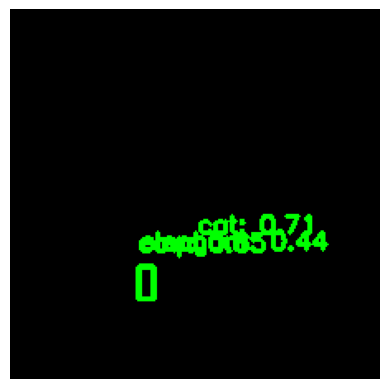

Frame 84, Label: 16, Score: 0.7058876752853394
Frame 84, Label: 20, Score: 0.645600438117981
Frame 84, Label: 21, Score: 0.4372237026691437


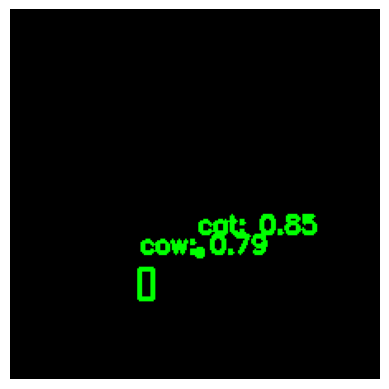

Frame 85, Label: 16, Score: 0.8484549522399902
Frame 85, Label: 20, Score: 0.7882477045059204


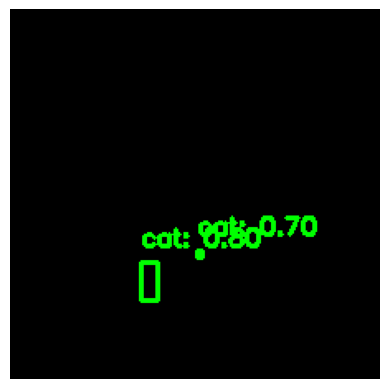

Frame 86, Label: 16, Score: 0.796316385269165
Frame 86, Label: 16, Score: 0.69599848985672


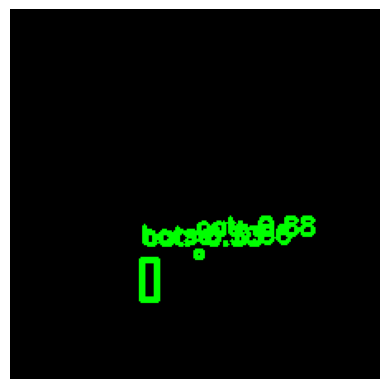

Frame 87, Label: 16, Score: 0.8757621645927429
Frame 87, Label: 18, Score: 0.6611161231994629
Frame 87, Label: 16, Score: 0.33297425508499146


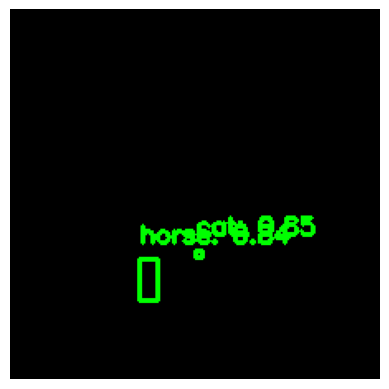

Frame 88, Label: 16, Score: 0.8506914377212524
Frame 88, Label: 18, Score: 0.8364893794059753


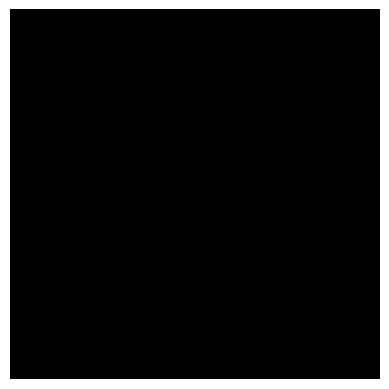

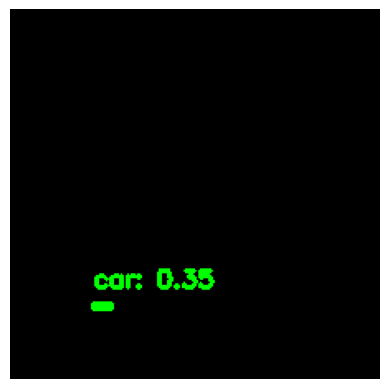

Frame 90, Label: 3, Score: 0.34877559542655945


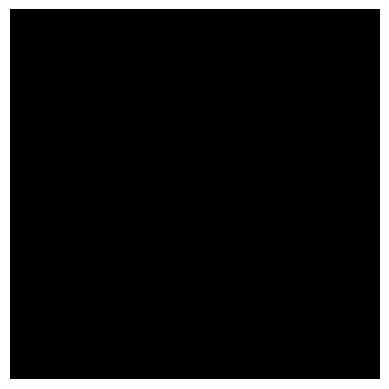

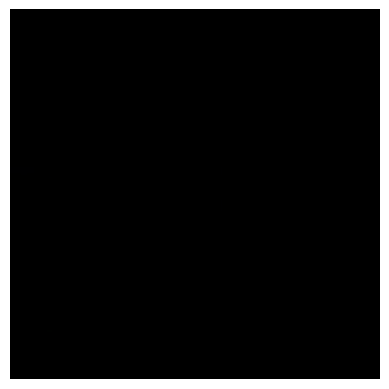

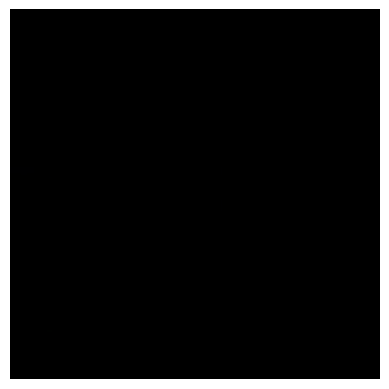

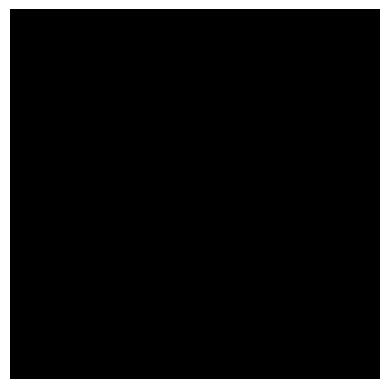

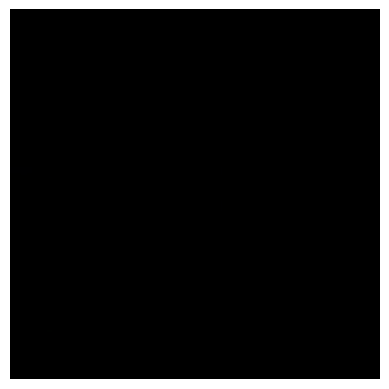

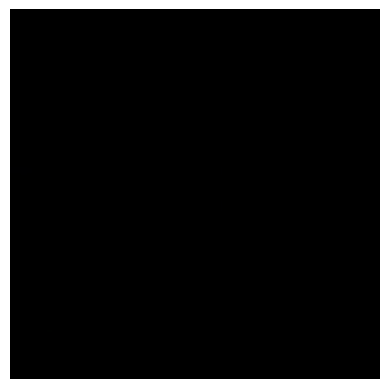

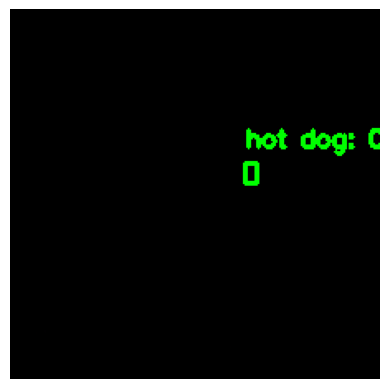

Frame 97, Label: 53, Score: 0.4190746247768402


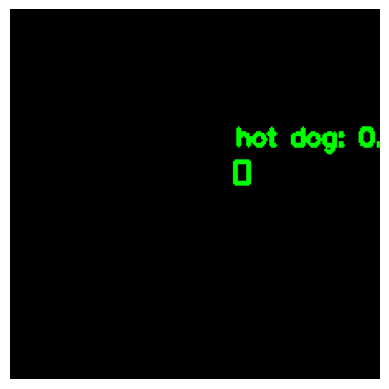

Frame 98, Label: 53, Score: 0.31659969687461853


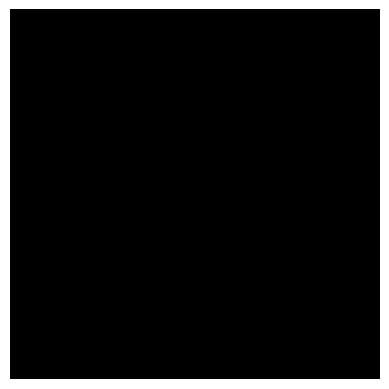

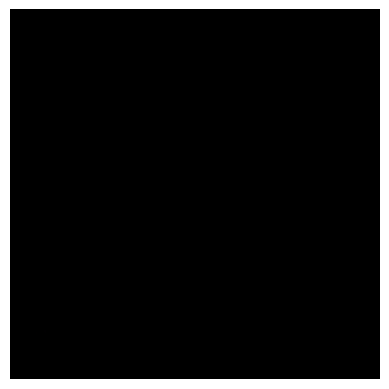

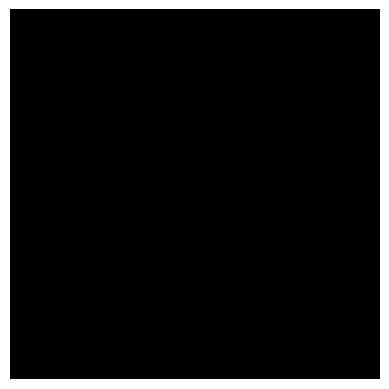

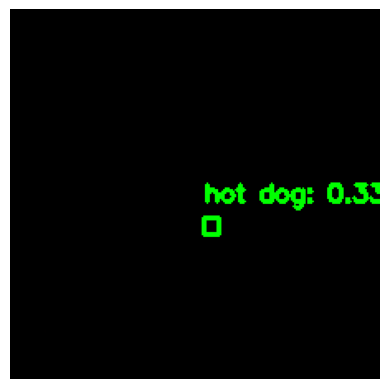

Frame 102, Label: 53, Score: 0.33338597416877747


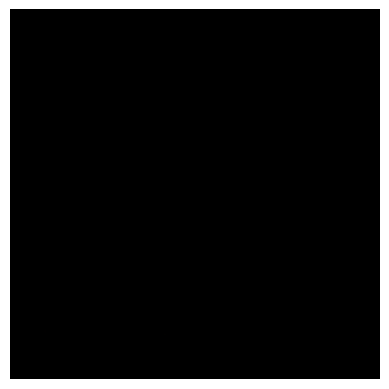

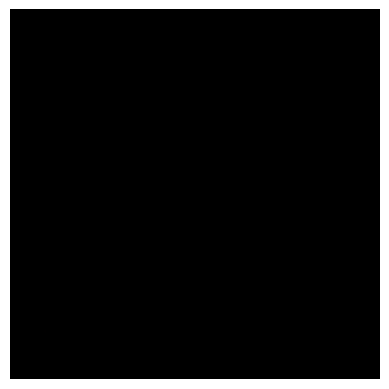

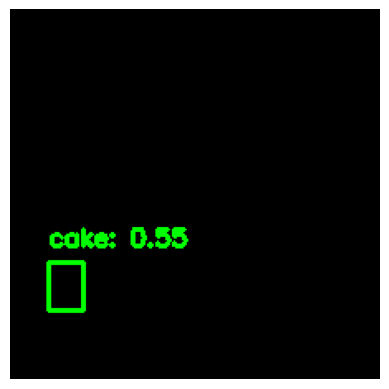

Frame 105, Label: 56, Score: 0.5521040558815002


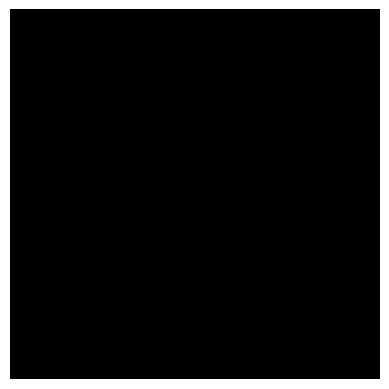

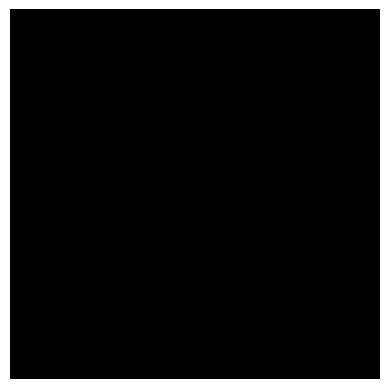

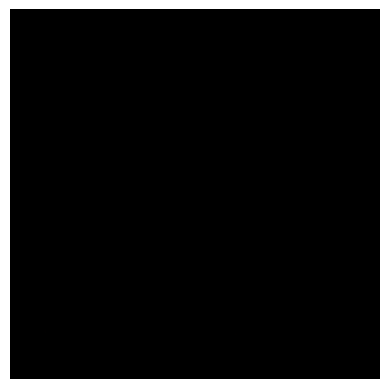

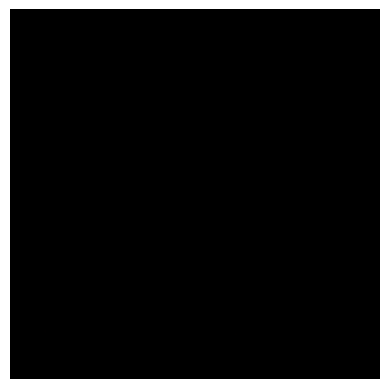

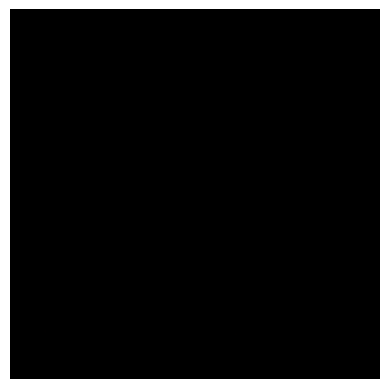

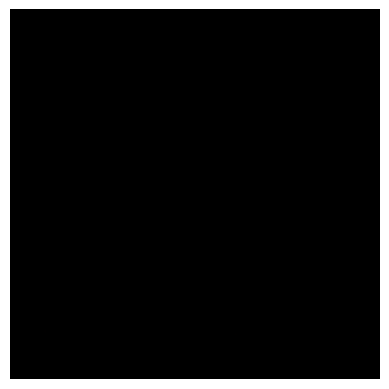

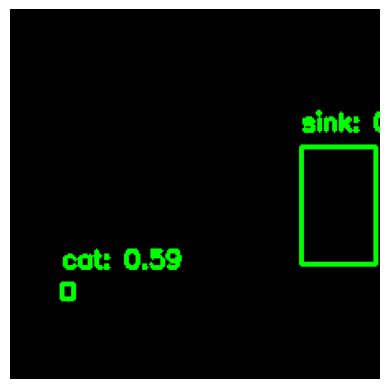

Frame 112, Label: 16, Score: 0.593737781047821
Frame 112, Label: 72, Score: 0.3075316548347473


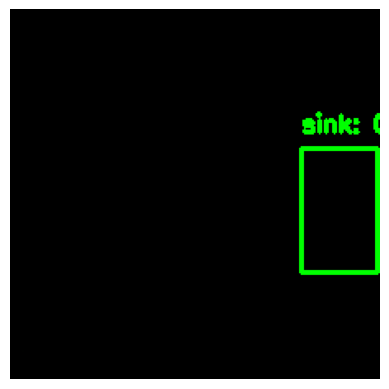

Frame 113, Label: 72, Score: 0.34457603096961975


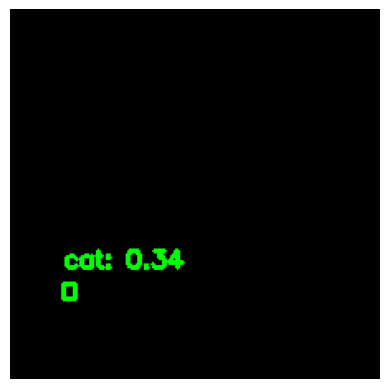

Frame 114, Label: 16, Score: 0.3404294550418854


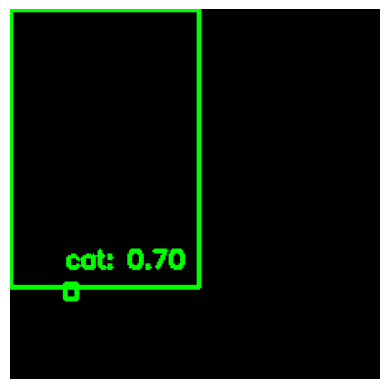

Frame 115, Label: 16, Score: 0.7021659016609192
Frame 115, Label: 1, Score: 0.3083825409412384


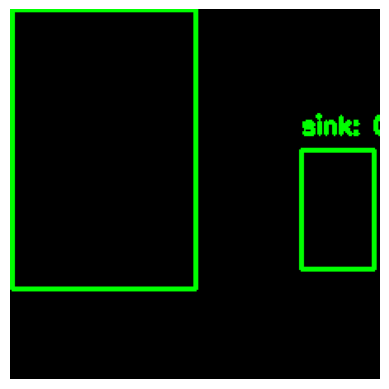

Frame 116, Label: 72, Score: 0.3832401931285858
Frame 116, Label: 1, Score: 0.3759220242500305


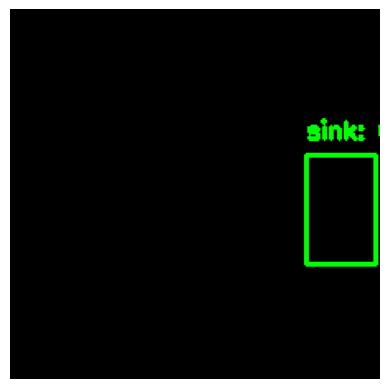

Frame 117, Label: 72, Score: 0.36177775263786316


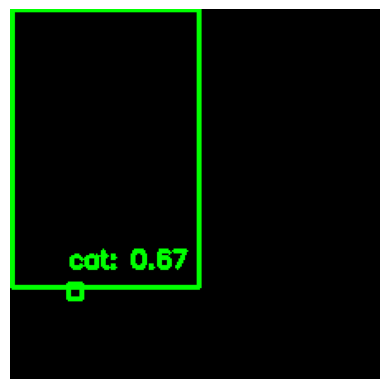

Frame 118, Label: 16, Score: 0.6708617210388184
Frame 118, Label: 1, Score: 0.30018091201782227


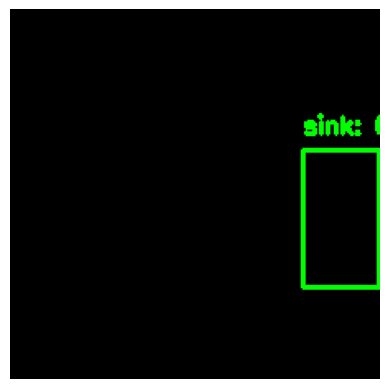

Frame 119, Label: 72, Score: 0.3006548583507538


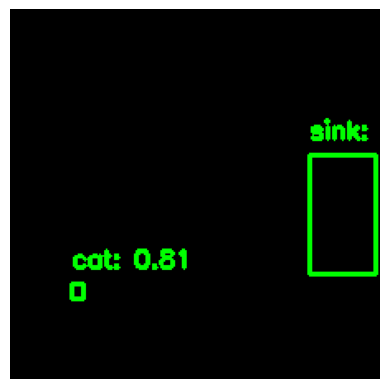

Frame 120, Label: 16, Score: 0.8134276270866394
Frame 120, Label: 72, Score: 0.4835110306739807


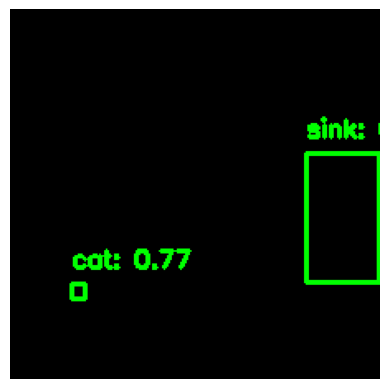

Frame 121, Label: 16, Score: 0.7720487117767334
Frame 121, Label: 72, Score: 0.39735180139541626


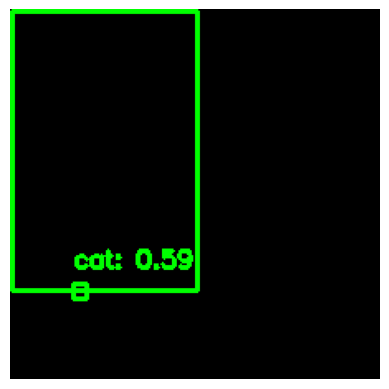

Frame 122, Label: 16, Score: 0.5904072523117065
Frame 122, Label: 1, Score: 0.34798508882522583


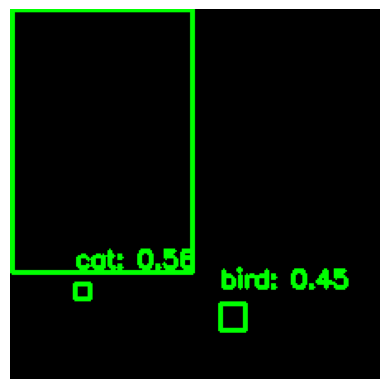

Frame 123, Label: 16, Score: 0.5604959726333618
Frame 123, Label: 15, Score: 0.4479618966579437
Frame 123, Label: 1, Score: 0.3236861228942871


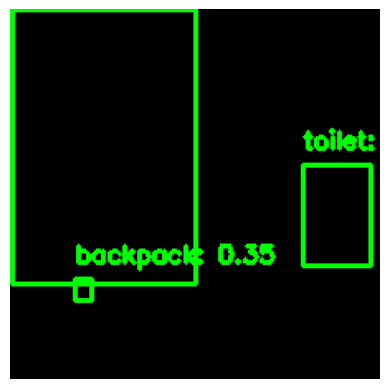

Frame 124, Label: 1, Score: 0.40374472737312317
Frame 124, Label: 25, Score: 0.34618204832077026
Frame 124, Label: 62, Score: 0.33238813281059265


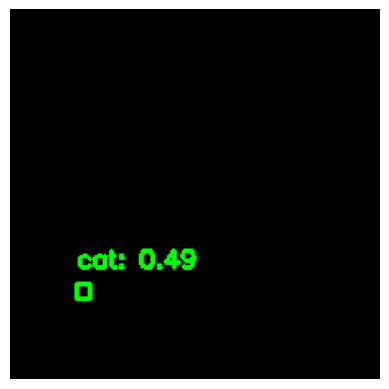

Frame 125, Label: 16, Score: 0.48576658964157104


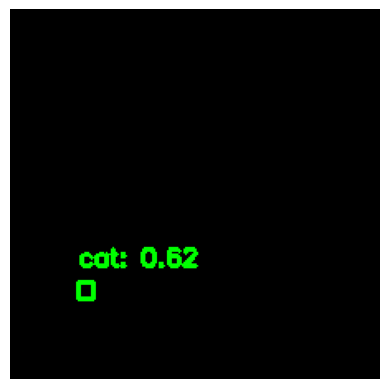

Frame 126, Label: 16, Score: 0.6185147166252136


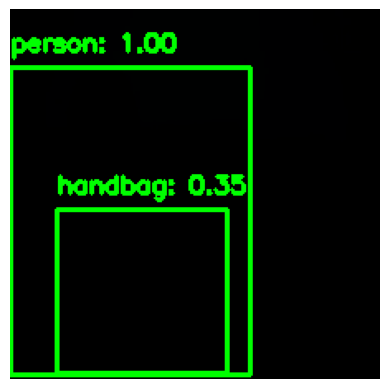

Frame 127, Label: 1, Score: 0.9993311166763306
Frame 127, Label: 27, Score: 0.3480205833911896


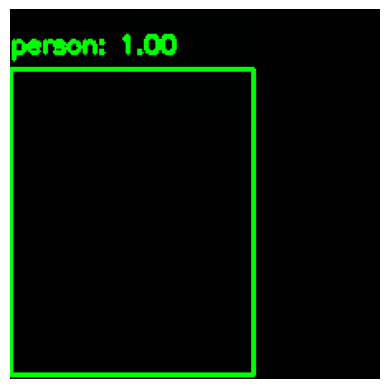

Frame 128, Label: 1, Score: 0.9991130232810974


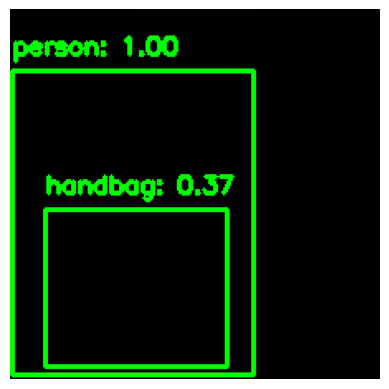

Frame 129, Label: 1, Score: 0.9988794922828674
Frame 129, Label: 27, Score: 0.3696931302547455


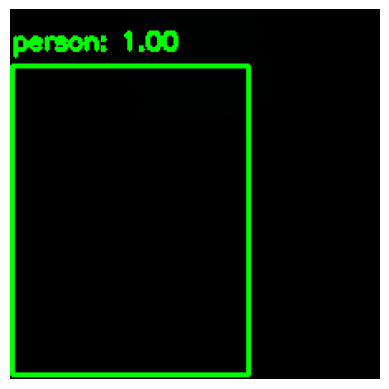

Frame 130, Label: 1, Score: 0.9988515377044678


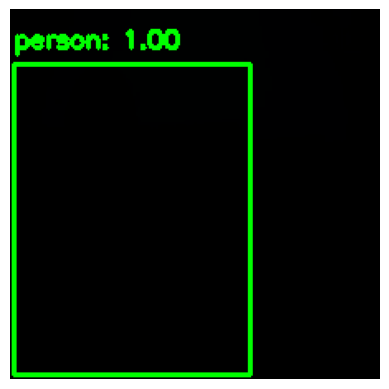

Frame 131, Label: 1, Score: 0.9987660646438599


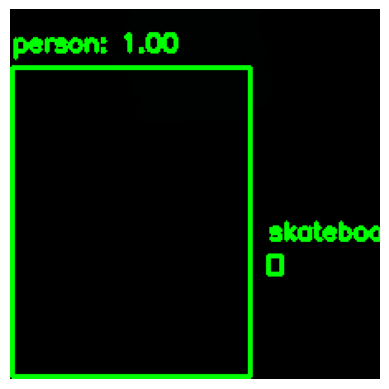

Frame 132, Label: 1, Score: 0.9987049102783203
Frame 132, Label: 37, Score: 0.5450157523155212


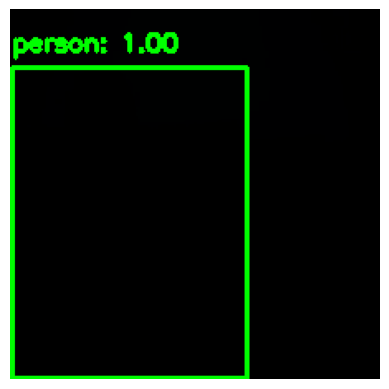

Frame 133, Label: 1, Score: 0.9985283613204956


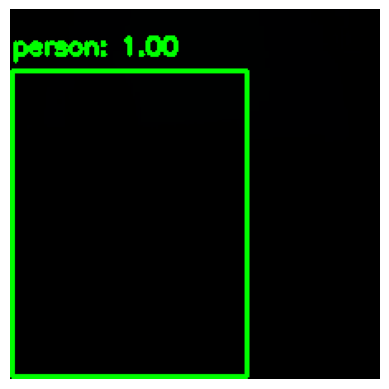

Frame 134, Label: 1, Score: 0.9984264373779297


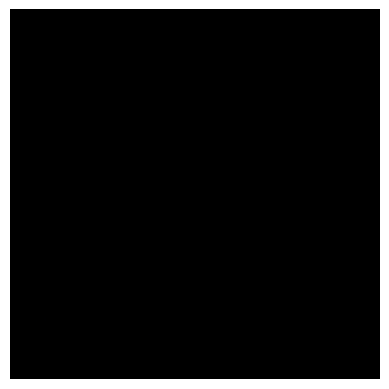

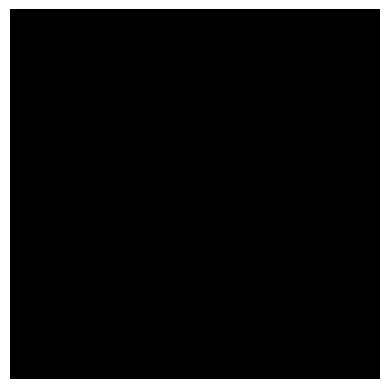

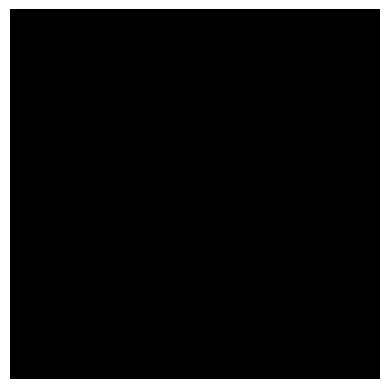

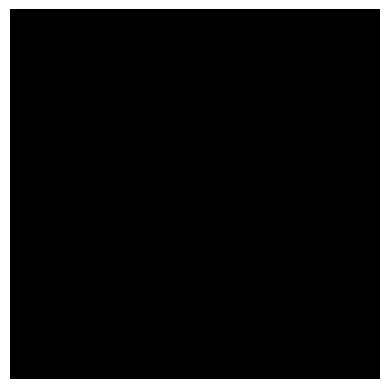

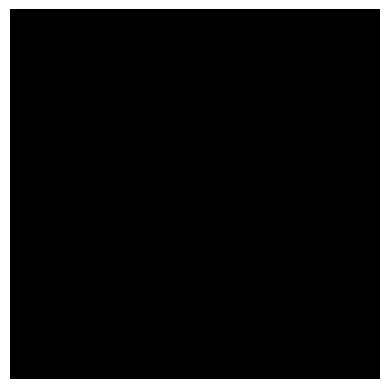

...

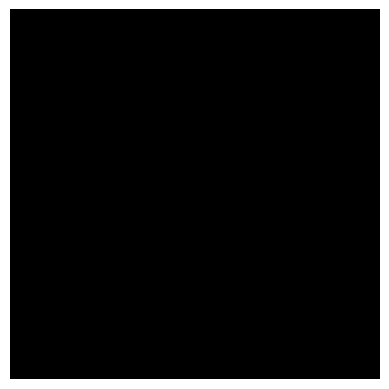

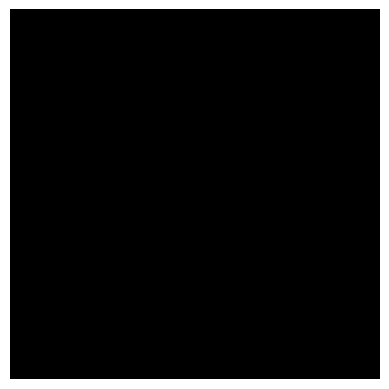

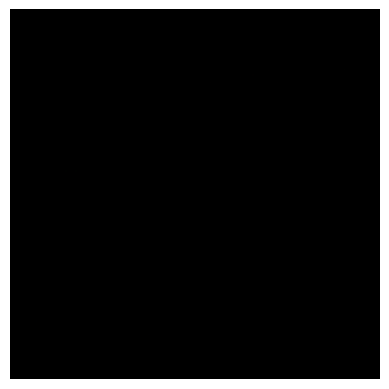

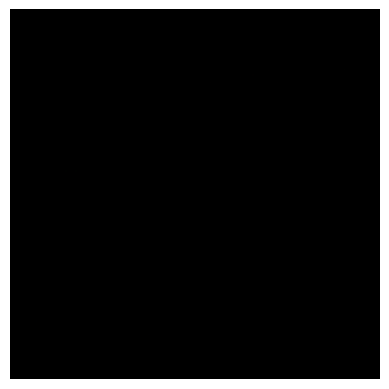

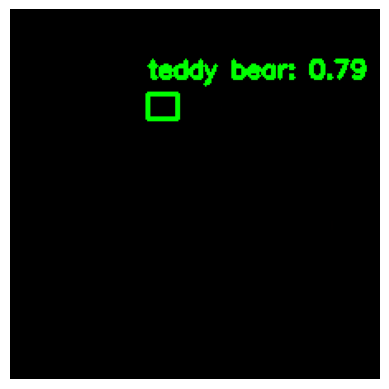

Frame 148, Label: 78, Score: 0.7944831252098083


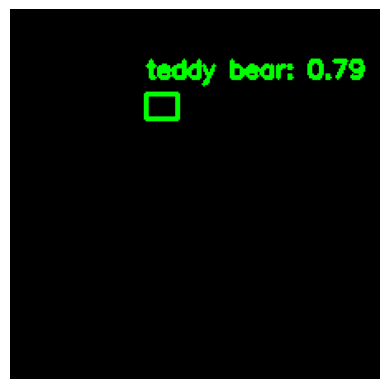

Frame 149, Label: 78, Score: 0.7935735583305359


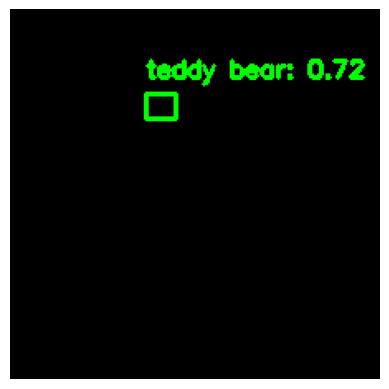

Frame 150, Label: 78, Score: 0.7239619493484497


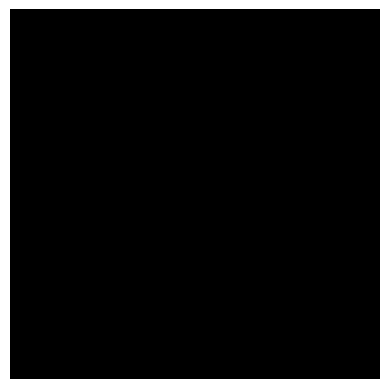

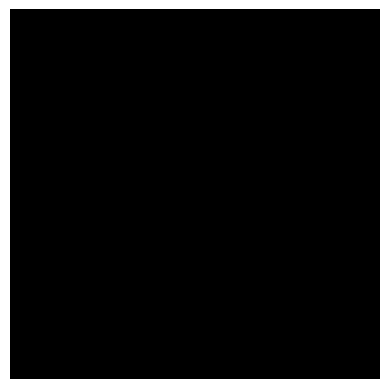

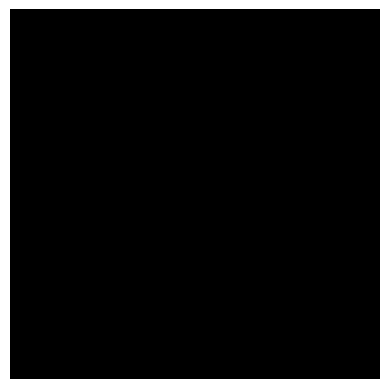

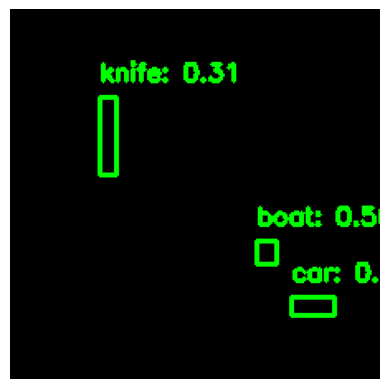

Frame 154, Label: 3, Score: 0.7607582211494446
Frame 154, Label: 9, Score: 0.5620835423469543
Frame 154, Label: 44, Score: 0.30859291553497314


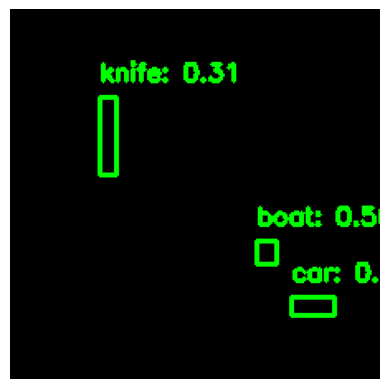

Frame 155, Label: 3, Score: 0.7607580423355103
Frame 155, Label: 9, Score: 0.5610392093658447
Frame 155, Label: 44, Score: 0.306501567363739


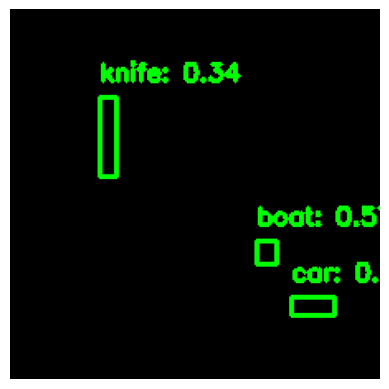

Frame 156, Label: 3, Score: 0.7607408761978149
Frame 156, Label: 9, Score: 0.566627025604248
Frame 156, Label: 44, Score: 0.3397563695907593


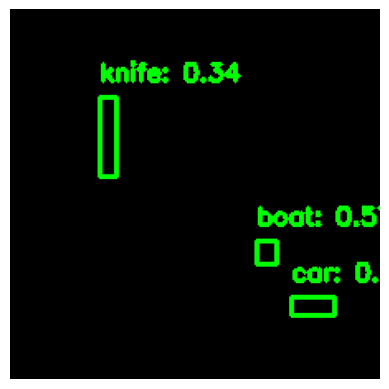

Frame 157, Label: 3, Score: 0.7607408761978149
Frame 157, Label: 9, Score: 0.565933346748352
Frame 157, Label: 44, Score: 0.3406757414340973


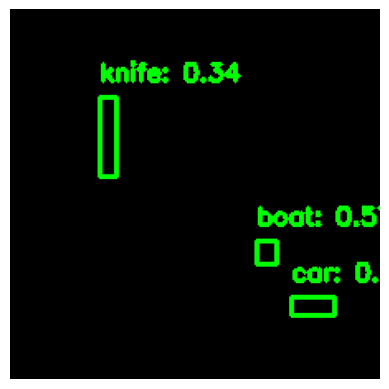

Frame 158, Label: 3, Score: 0.7607410550117493
Frame 158, Label: 9, Score: 0.5730748772621155
Frame 158, Label: 44, Score: 0.34169813990592957


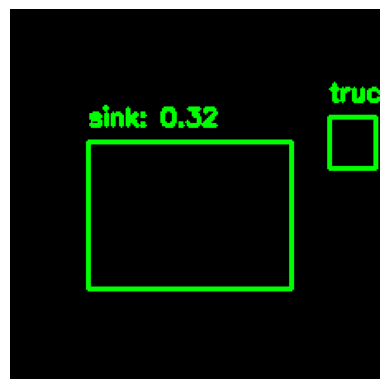

Frame 159, Label: 8, Score: 0.7077350616455078
Frame 159, Label: 72, Score: 0.31649503111839294


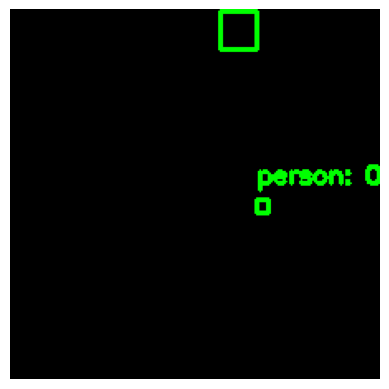

Frame 160, Label: 1, Score: 0.3208022117614746
Frame 160, Label: 64, Score: 0.3195856213569641


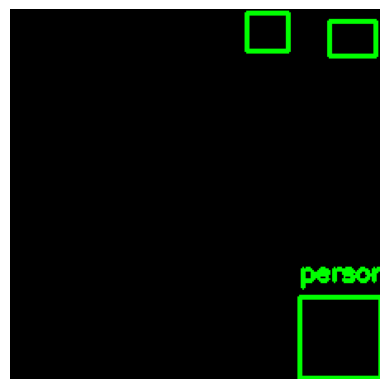

Frame 161, Label: 64, Score: 0.7466897368431091
Frame 161, Label: 78, Score: 0.35851147770881653
Frame 161, Label: 1, Score: 0.3446715474128723


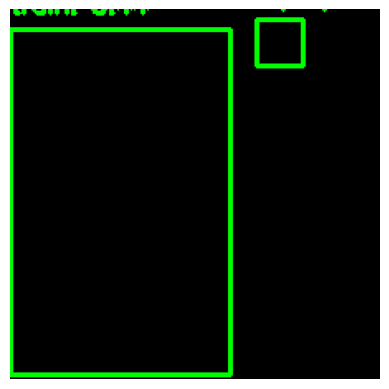

Frame 162, Label: 64, Score: 0.9345503449440002
Frame 162, Label: 7, Score: 0.43745893239974976


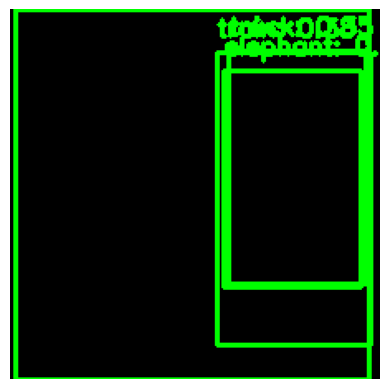

Frame 163, Label: 7, Score: 0.6997570395469666
Frame 163, Label: 21, Score: 0.4657959043979645
Frame 163, Label: 7, Score: 0.38202589750289917
Frame 163, Label: 8, Score: 0.34547245502471924


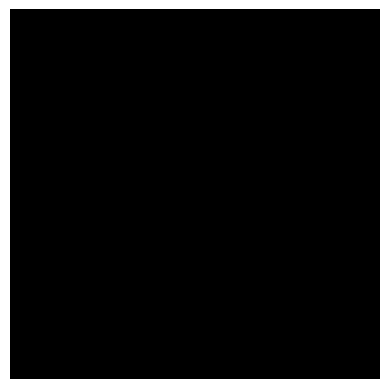

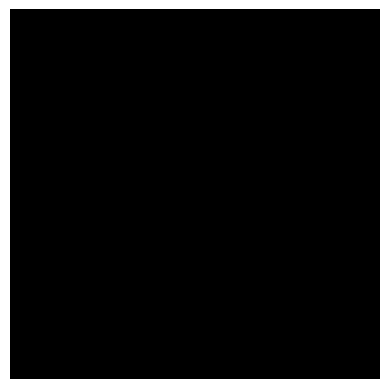

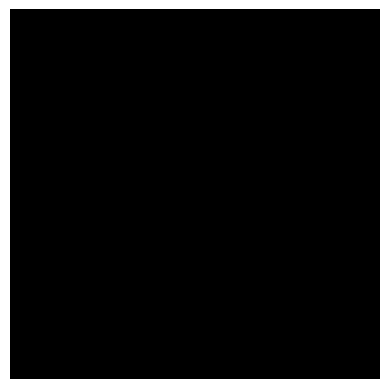

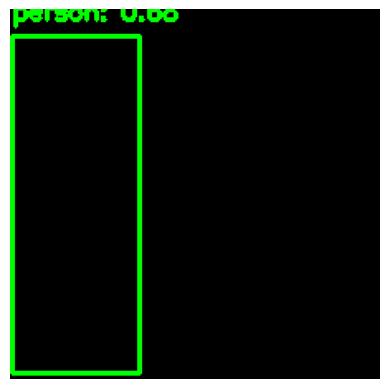

Frame 167, Label: 1, Score: 0.6824072599411011


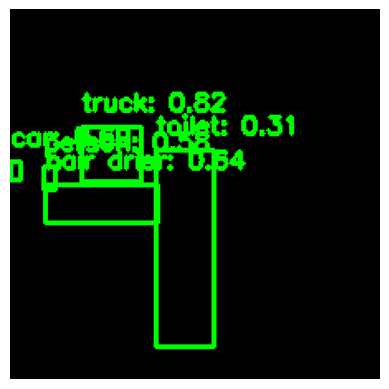

Frame 168, Label: 8, Score: 0.8242942690849304
Frame 168, Label: 3, Score: 0.6887512803077698
Frame 168, Label: 79, Score: 0.6444510817527771
Frame 168, Label: 1, Score: 0.5751916170120239
Frame 168, Label: 62, Score: 0.3050217926502228


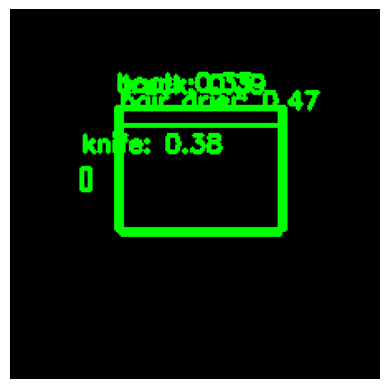

Frame 169, Label: 79, Score: 0.47425535321235657
Frame 169, Label: 8, Score: 0.38734912872314453
Frame 169, Label: 44, Score: 0.37761378288269043
Frame 169, Label: 9, Score: 0.33485084772109985


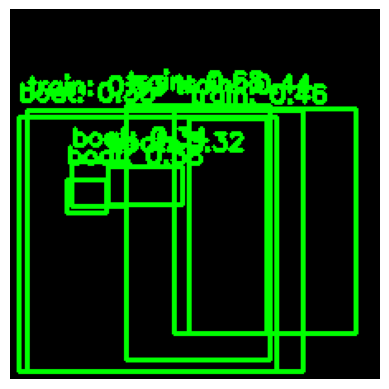

Frame 170, Label: 7, Score: 0.6773719787597656
Frame 170, Label: 7, Score: 0.5252506136894226
Frame 170, Label: 7, Score: 0.458391398191452
Frame 170, Label: 7, Score: 0.4417954385280609
Frame 170, Label: 9, Score: 0.37838879227638245
Frame 170, Label: 9, Score: 0.3465764820575714
Frame 170, Label: 9, Score: 0.3389585018157959
Frame 170, Label: 9, Score: 0.32158422470092773


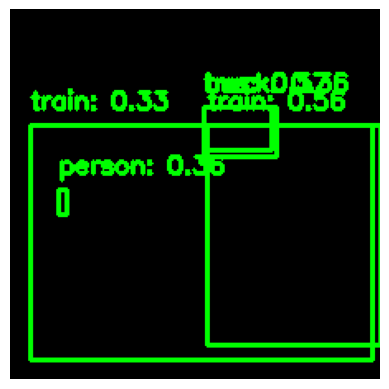

Frame 171, Label: 6, Score: 0.5683128237724304
Frame 171, Label: 7, Score: 0.561313271522522
Frame 171, Label: 8, Score: 0.36340194940567017
Frame 171, Label: 1, Score: 0.35986629128456116
Frame 171, Label: 7, Score: 0.3334469199180603


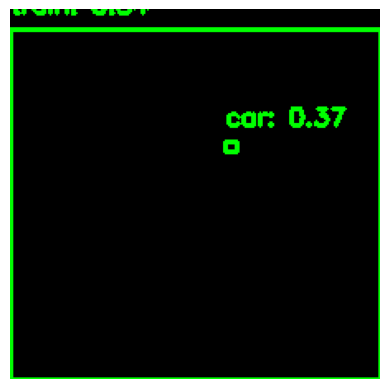

Frame 172, Label: 3, Score: 0.3661714792251587
Frame 172, Label: 7, Score: 0.3400140702724457


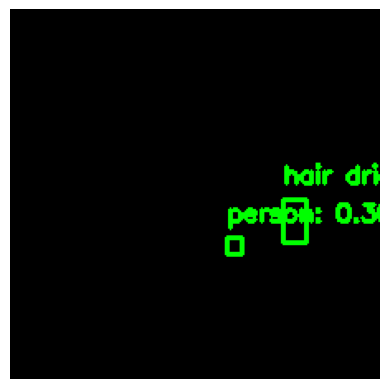

Frame 173, Label: 79, Score: 0.3915322422981262
Frame 173, Label: 1, Score: 0.30049625039100647


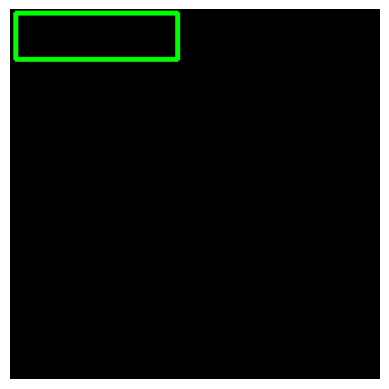

Frame 174, Label: 72, Score: 0.64640212059021


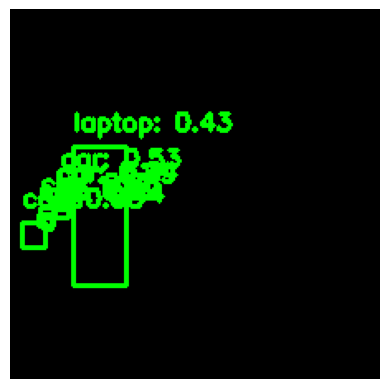

Frame 175, Label: 3, Score: 0.9837055206298828
Frame 175, Label: 3, Score: 0.8867096304893494
Frame 175, Label: 3, Score: 0.7797765731811523
Frame 175, Label: 3, Score: 0.622105062007904
Frame 175, Label: 3, Score: 0.531163215637207
Frame 175, Label: 3, Score: 0.44295674562454224
Frame 175, Label: 64, Score: 0.42873162031173706
Frame 175, Label: 3, Score: 0.33551502227783203


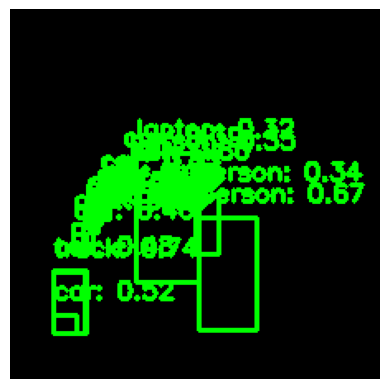

Frame 176, Label: 3, Score: 0.8625730276107788
Frame 176, Label: 3, Score: 0.853844940662384
Frame 176, Label: 3, Score: 0.8037645816802979
Frame 176, Label: 3, Score: 0.7660187482833862
Frame 176, Label: 8, Score: 0.7356355786323547
Frame 176, Label: 1, Score: 0.667500376701355
Frame 176, Label: 3, Score: 0.6452888250350952
Frame 176, Label: 3, Score: 0.6360346078872681
Frame 176, Label: 3, Score: 0.6333293318748474
Frame 176, Label: 3, Score: 0.5210899710655212
Frame 176, Label: 3, Score: 0.510519802570343
Frame 176, Label: 3, Score: 0.489738404750824
Frame 176, Label: 3, Score: 0.48004451394081116
Frame 176, Label: 3, Score: 0.4783322811126709
Frame 176, Label: 3, Score: 0.4645659327507019
Frame 176, Label: 3, Score: 0.42535072565078735
Frame 176, Label: 3, Score: 0.3911932706832886
Frame 176, Label: 3, Score: 0.38206976652145386
Frame 176, Label: 3, Score: 0.37871965765953064
Frame 176, Label: 3, Score: 0.3678009808063507
Frame 176, Label: 1, Score: 0.35188421607017517
Frame 176, L

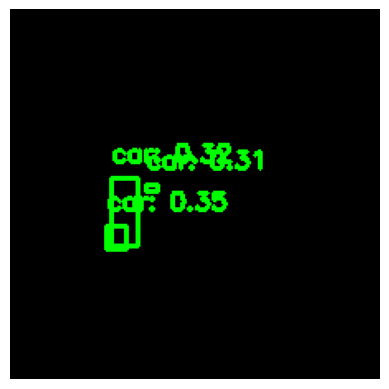

Frame 177, Label: 3, Score: 0.3467528223991394
Frame 177, Label: 3, Score: 0.32437583804130554
Frame 177, Label: 3, Score: 0.31179264187812805


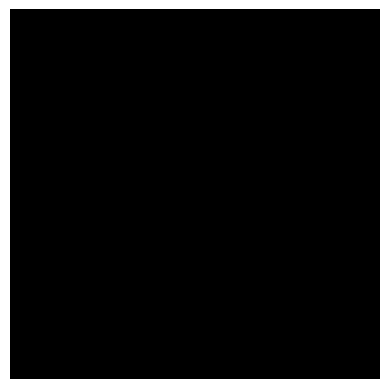

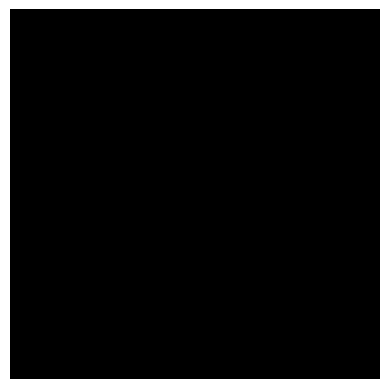

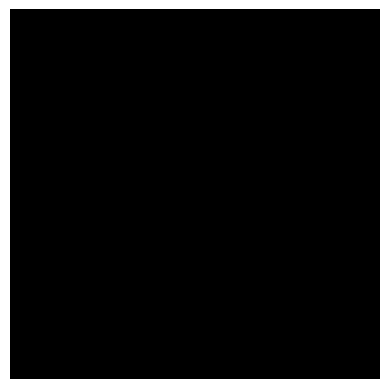

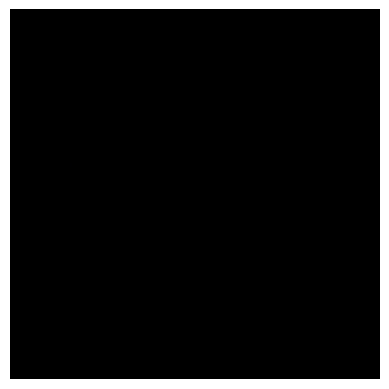

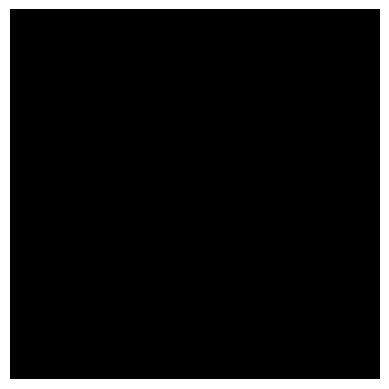

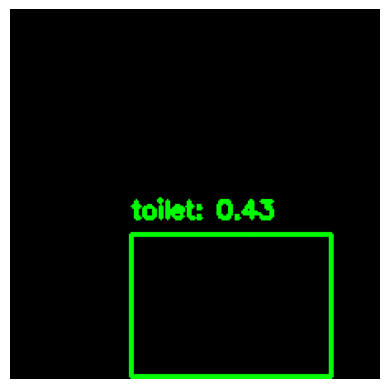

Frame 183, Label: 62, Score: 0.42537805438041687


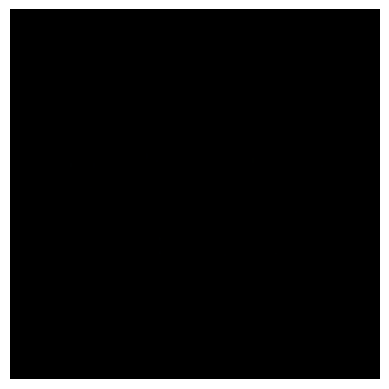

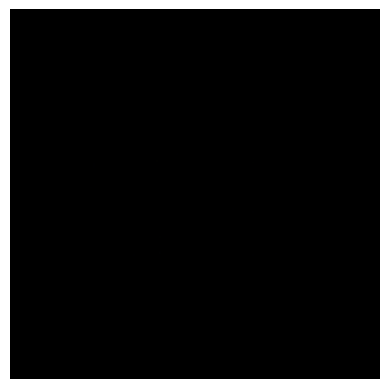

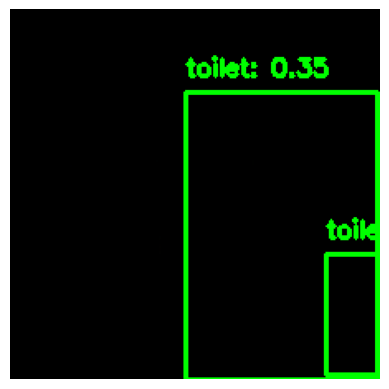

Frame 186, Label: 62, Score: 0.5284757614135742
Frame 186, Label: 62, Score: 0.35252541303634644


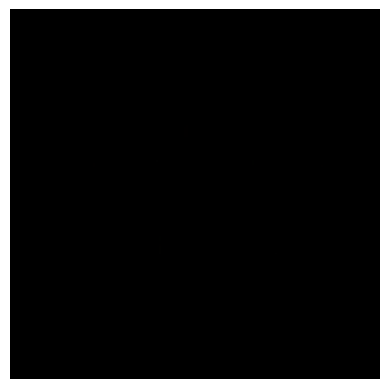

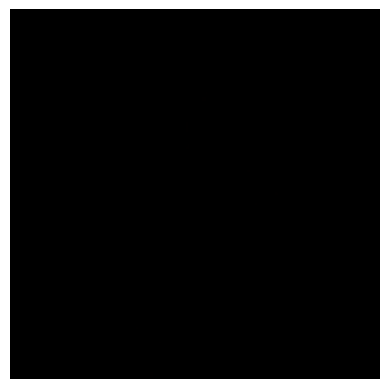

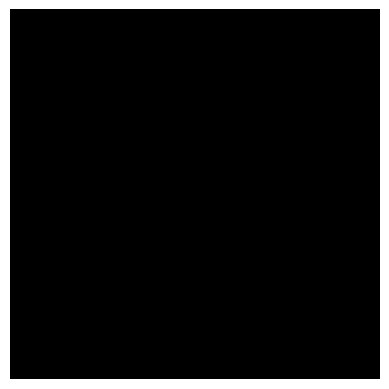

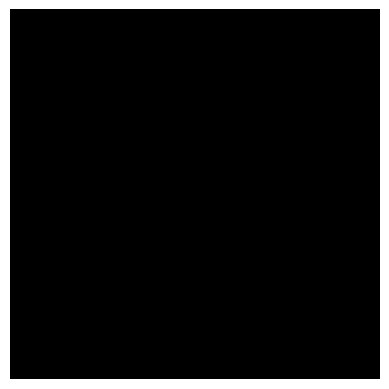

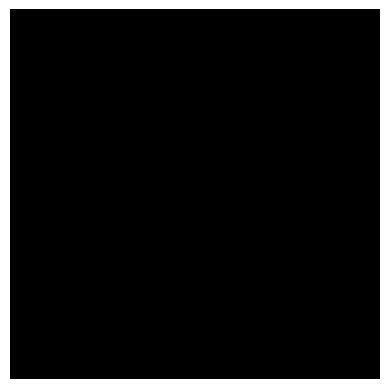

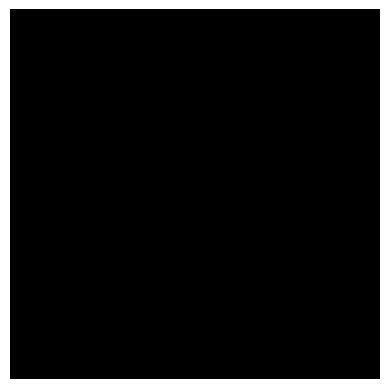

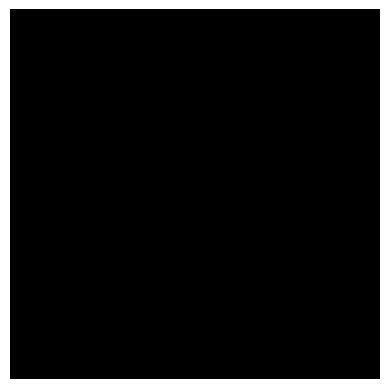

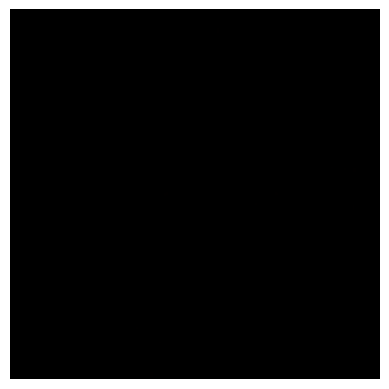

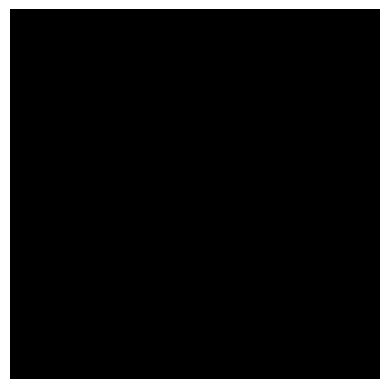

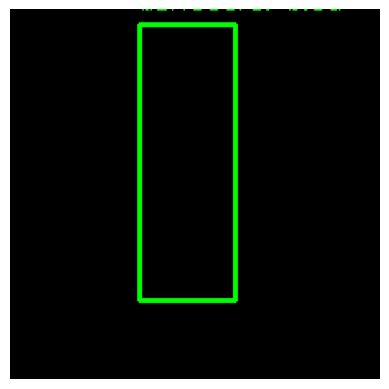

Frame 196, Label: 38, Score: 0.5804902911186218


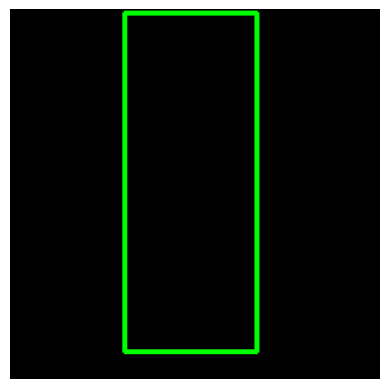

Frame 197, Label: 38, Score: 0.8507141470909119


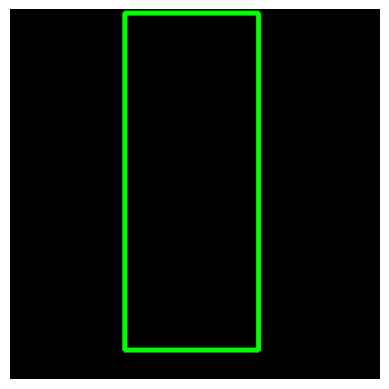

Frame 198, Label: 38, Score: 0.8491895198822021


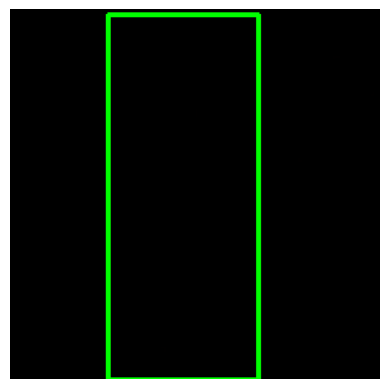

Frame 199, Label: 38, Score: 0.863210141658783


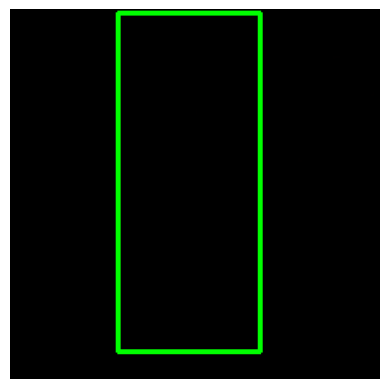

Frame 200, Label: 38, Score: 0.5901982188224792


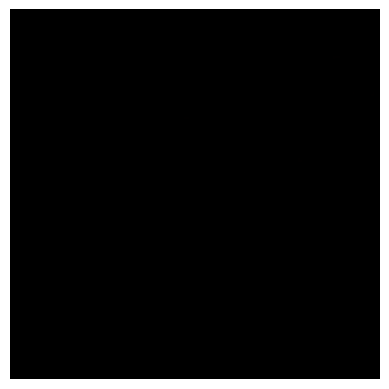

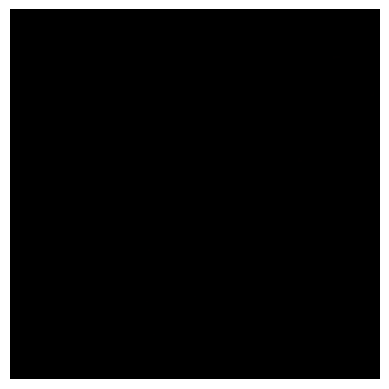

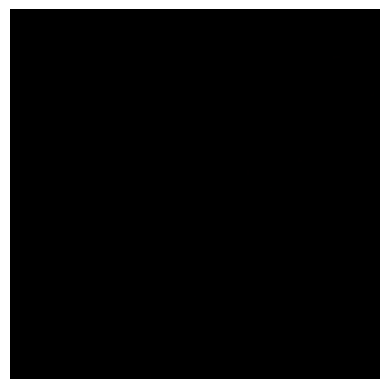

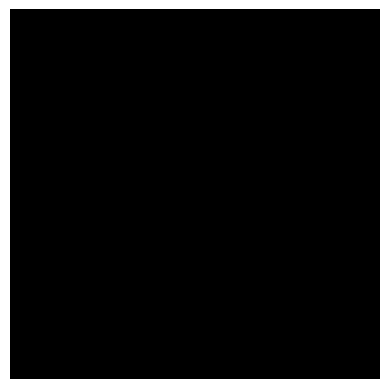

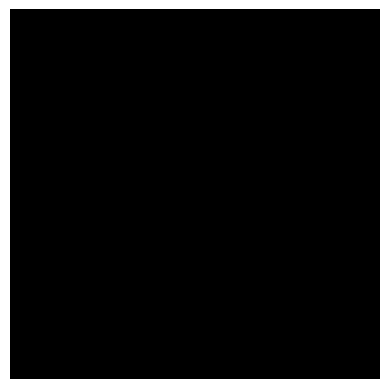

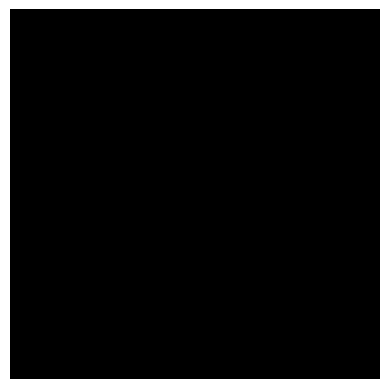

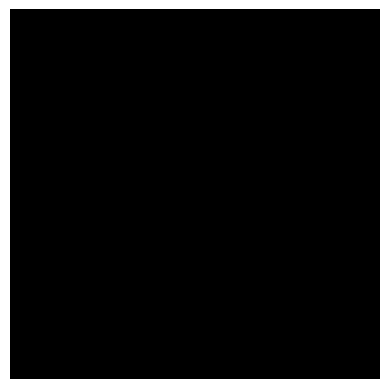

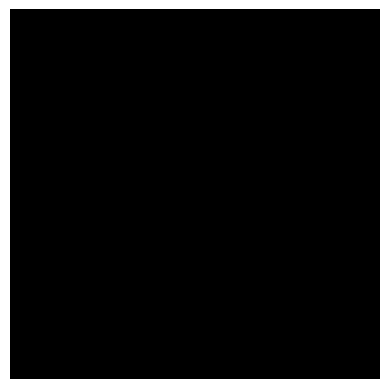

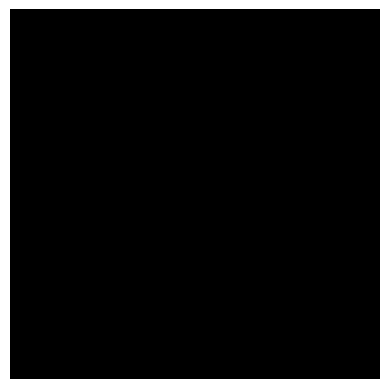

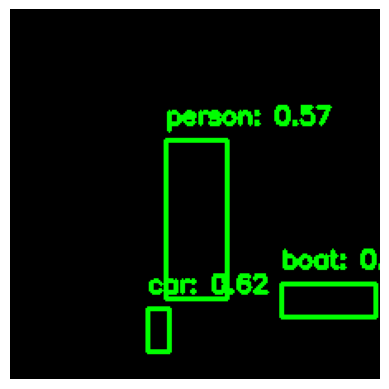

Frame 210, Label: 3, Score: 0.6243025064468384
Frame 210, Label: 1, Score: 0.5656237602233887
Frame 210, Label: 9, Score: 0.3343694806098938


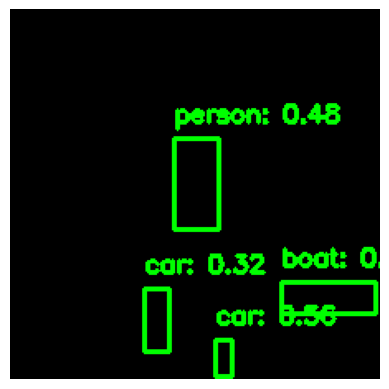

Frame 211, Label: 3, Score: 0.564119815826416
Frame 211, Label: 1, Score: 0.4797803461551666
Frame 211, Label: 9, Score: 0.4124402105808258
Frame 211, Label: 3, Score: 0.3192330002784729


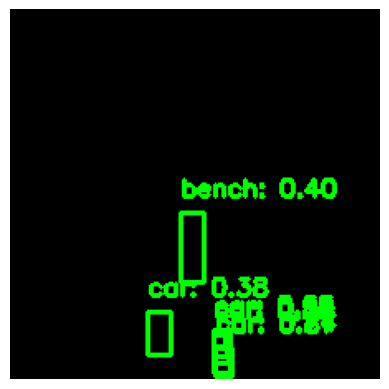

Frame 212, Label: 3, Score: 0.8709947466850281
Frame 212, Label: 3, Score: 0.7417430281639099
Frame 212, Label: 3, Score: 0.5594800114631653
Frame 212, Label: 14, Score: 0.39814940094947815
Frame 212, Label: 3, Score: 0.3827875554561615
Frame 212, Label: 3, Score: 0.3827255368232727
Frame 212, Label: 3, Score: 0.34799256920814514


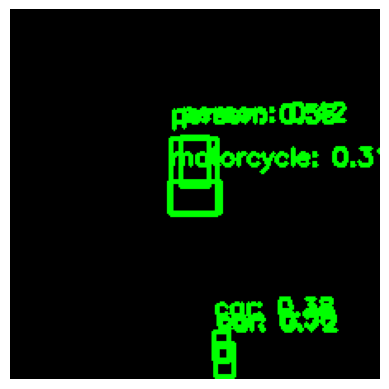

Frame 213, Label: 3, Score: 0.7165533900260925
Frame 213, Label: 1, Score: 0.5818241238594055
Frame 213, Label: 3, Score: 0.5556558966636658
Frame 213, Label: 1, Score: 0.4239957332611084
Frame 213, Label: 3, Score: 0.3809707760810852
Frame 213, Label: 4, Score: 0.3121699392795563


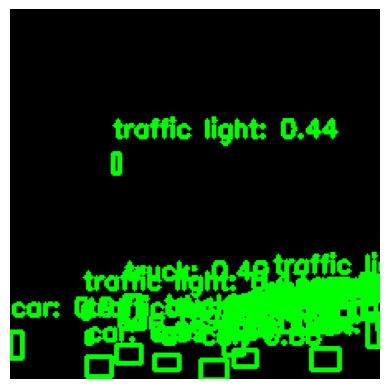

Frame 214, Label: 3, Score: 0.9943016767501831
Frame 214, Label: 3, Score: 0.9615863561630249
Frame 214, Label: 3, Score: 0.9560144543647766
Frame 214, Label: 3, Score: 0.9360263347625732
Frame 214, Label: 3, Score: 0.9061015844345093
Frame 214, Label: 3, Score: 0.881542444229126
Frame 214, Label: 3, Score: 0.8809739947319031
Frame 214, Label: 3, Score: 0.8787211775779724
Frame 214, Label: 3, Score: 0.865334689617157
Frame 214, Label: 3, Score: 0.8563772439956665
Frame 214, Label: 3, Score: 0.8516499996185303
Frame 214, Label: 10, Score: 0.8509203195571899
Frame 214, Label: 3, Score: 0.8475370407104492
Frame 214, Label: 3, Score: 0.7551945447921753
Frame 214, Label: 3, Score: 0.711320161819458
Frame 214, Label: 3, Score: 0.6544036865234375
Frame 214, Label: 3, Score: 0.6469314694404602
Frame 214, Label: 3, Score: 0.6100251078605652
Frame 214, Label: 10, Score: 0.5984479188919067
Frame 214, Label: 8, Score: 0.569922924041748
Frame 214, Label: 3, Score: 0.5527215600013733
Frame 214, Labe

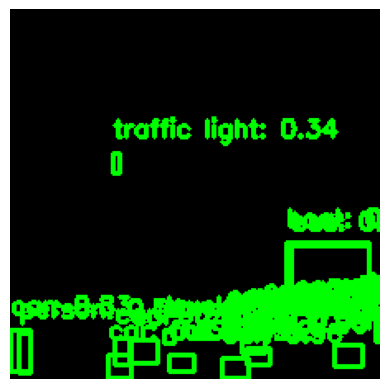

Frame 215, Label: 3, Score: 0.9661497473716736
Frame 215, Label: 3, Score: 0.9643522500991821
Frame 215, Label: 3, Score: 0.9570713639259338
Frame 215, Label: 3, Score: 0.9460987448692322
Frame 215, Label: 3, Score: 0.9191105365753174
Frame 215, Label: 3, Score: 0.9042912721633911
Frame 215, Label: 3, Score: 0.8728621006011963
Frame 215, Label: 3, Score: 0.8304372429847717
Frame 215, Label: 3, Score: 0.7746152281761169
Frame 215, Label: 3, Score: 0.7217637896537781
Frame 215, Label: 3, Score: 0.7166173458099365
Frame 215, Label: 3, Score: 0.715427041053772
Frame 215, Label: 3, Score: 0.7045470476150513
Frame 215, Label: 3, Score: 0.6904429197311401
Frame 215, Label: 9, Score: 0.6053658127784729
Frame 215, Label: 3, Score: 0.5811772346496582
Frame 215, Label: 3, Score: 0.5731496214866638
Frame 215, Label: 1, Score: 0.5403775572776794
Frame 215, Label: 3, Score: 0.5374932885169983
Frame 215, Label: 3, Score: 0.519083559513092
Frame 215, Label: 3, Score: 0.4899706542491913
Frame 215, Labe

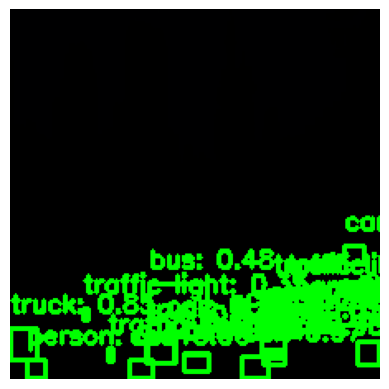

Frame 216, Label: 3, Score: 0.9779364466667175
Frame 216, Label: 3, Score: 0.9692463278770447
Frame 216, Label: 3, Score: 0.9640436172485352
Frame 216, Label: 3, Score: 0.9587792754173279
Frame 216, Label: 3, Score: 0.8756840825080872
Frame 216, Label: 8, Score: 0.8469865322113037
Frame 216, Label: 3, Score: 0.8417115807533264
Frame 216, Label: 10, Score: 0.7892824411392212
Frame 216, Label: 3, Score: 0.7830373644828796
Frame 216, Label: 3, Score: 0.779833972454071
Frame 216, Label: 3, Score: 0.7632611989974976
Frame 216, Label: 3, Score: 0.7562217116355896
Frame 216, Label: 10, Score: 0.7387276291847229
Frame 216, Label: 3, Score: 0.6968158483505249
Frame 216, Label: 3, Score: 0.6516565084457397
Frame 216, Label: 3, Score: 0.6384544968605042
Frame 216, Label: 3, Score: 0.6365246176719666
Frame 216, Label: 3, Score: 0.5910568833351135
Frame 216, Label: 10, Score: 0.5598410367965698
Frame 216, Label: 3, Score: 0.543485164642334
Frame 216, Label: 8, Score: 0.5098897218704224
Frame 216, L

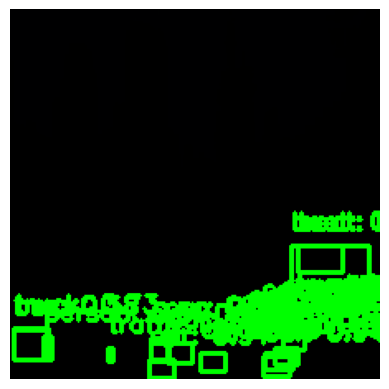

Frame 217, Label: 3, Score: 0.9649924635887146
Frame 217, Label: 3, Score: 0.9637659192085266
Frame 217, Label: 3, Score: 0.9522740840911865
Frame 217, Label: 3, Score: 0.9398561716079712
Frame 217, Label: 3, Score: 0.9380584359169006
Frame 217, Label: 3, Score: 0.9213793277740479
Frame 217, Label: 3, Score: 0.9111523628234863
Frame 217, Label: 3, Score: 0.9030069708824158
Frame 217, Label: 3, Score: 0.8462768197059631
Frame 217, Label: 3, Score: 0.7576877474784851
Frame 217, Label: 8, Score: 0.730571448802948
Frame 217, Label: 3, Score: 0.5988644361495972
Frame 217, Label: 1, Score: 0.5854489207267761
Frame 217, Label: 6, Score: 0.5837886929512024
Frame 217, Label: 3, Score: 0.5537818670272827
Frame 217, Label: 3, Score: 0.543713390827179
Frame 217, Label: 9, Score: 0.541413426399231
Frame 217, Label: 3, Score: 0.5018240213394165
Frame 217, Label: 3, Score: 0.47670257091522217
Frame 217, Label: 3, Score: 0.4325067698955536
Frame 217, Label: 8, Score: 0.3921383321285248
Frame 217, Labe

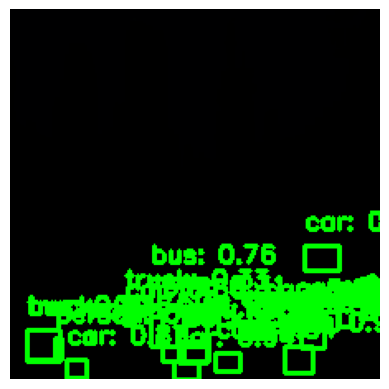

Frame 218, Label: 3, Score: 0.9760671257972717
Frame 218, Label: 3, Score: 0.937106192111969
Frame 218, Label: 3, Score: 0.9363669157028198
Frame 218, Label: 3, Score: 0.9206817746162415
Frame 218, Label: 3, Score: 0.910897970199585
Frame 218, Label: 3, Score: 0.8728824257850647
Frame 218, Label: 3, Score: 0.8692693114280701
Frame 218, Label: 3, Score: 0.8425959348678589
Frame 218, Label: 6, Score: 0.8155630230903625
Frame 218, Label: 3, Score: 0.7798317670822144
Frame 218, Label: 3, Score: 0.7730363607406616
Frame 218, Label: 6, Score: 0.7615435123443604
Frame 218, Label: 3, Score: 0.7498281002044678
Frame 218, Label: 3, Score: 0.6642938256263733
Frame 218, Label: 3, Score: 0.652802586555481
Frame 218, Label: 8, Score: 0.6317751407623291
Frame 218, Label: 3, Score: 0.5980710387229919
Frame 218, Label: 10, Score: 0.5923413038253784
Frame 218, Label: 3, Score: 0.5893272757530212
Frame 218, Label: 1, Score: 0.5037533640861511
Frame 218, Label: 3, Score: 0.48963335156440735
Frame 218, Lab

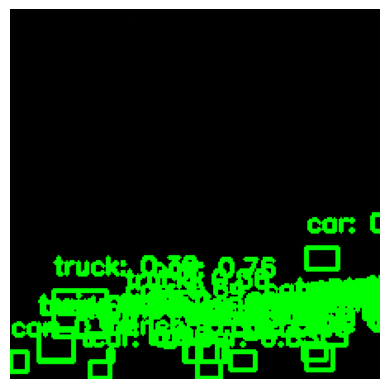

Frame 219, Label: 3, Score: 0.9665691256523132
Frame 219, Label: 3, Score: 0.9463731646537781
Frame 219, Label: 3, Score: 0.9443572163581848
Frame 219, Label: 3, Score: 0.9428922533988953
Frame 219, Label: 3, Score: 0.921405553817749
Frame 219, Label: 3, Score: 0.9194678068161011
Frame 219, Label: 3, Score: 0.8961762189865112
Frame 219, Label: 3, Score: 0.8942291140556335
Frame 219, Label: 3, Score: 0.82664954662323
Frame 219, Label: 3, Score: 0.8057221174240112
Frame 219, Label: 3, Score: 0.7980085015296936
Frame 219, Label: 3, Score: 0.7922222018241882
Frame 219, Label: 3, Score: 0.7846912741661072
Frame 219, Label: 6, Score: 0.763340413570404
Frame 219, Label: 3, Score: 0.7551649212837219
Frame 219, Label: 6, Score: 0.6952994465827942
Frame 219, Label: 3, Score: 0.692531168460846
Frame 219, Label: 3, Score: 0.6418783068656921
Frame 219, Label: 3, Score: 0.5696765184402466
Frame 219, Label: 3, Score: 0.5367063879966736
Frame 219, Label: 10, Score: 0.4787951111793518
Frame 219, Label:

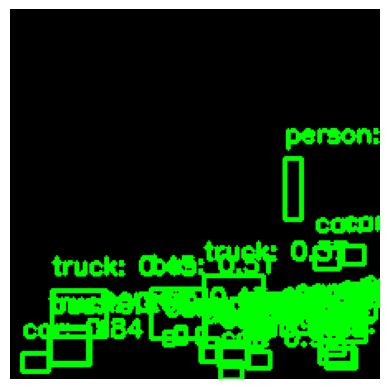

Frame 220, Label: 3, Score: 0.9698165655136108
Frame 220, Label: 3, Score: 0.9475237727165222
Frame 220, Label: 3, Score: 0.9441832304000854
Frame 220, Label: 3, Score: 0.9288060069084167
Frame 220, Label: 3, Score: 0.928077220916748
Frame 220, Label: 3, Score: 0.9124248623847961
Frame 220, Label: 3, Score: 0.9028763771057129
Frame 220, Label: 3, Score: 0.8475354909896851
Frame 220, Label: 3, Score: 0.8355228900909424
Frame 220, Label: 3, Score: 0.8205623626708984
Frame 220, Label: 3, Score: 0.7723665237426758
Frame 220, Label: 3, Score: 0.7389687299728394
Frame 220, Label: 3, Score: 0.7348692417144775
Frame 220, Label: 6, Score: 0.7105226516723633
Frame 220, Label: 8, Score: 0.6668986082077026
Frame 220, Label: 3, Score: 0.6495410799980164
Frame 220, Label: 3, Score: 0.604131817817688
Frame 220, Label: 3, Score: 0.5953527688980103
Frame 220, Label: 1, Score: 0.5199488997459412
Frame 220, Label: 8, Score: 0.5185956954956055
Frame 220, Label: 3, Score: 0.5120919942855835
Frame 220, Labe

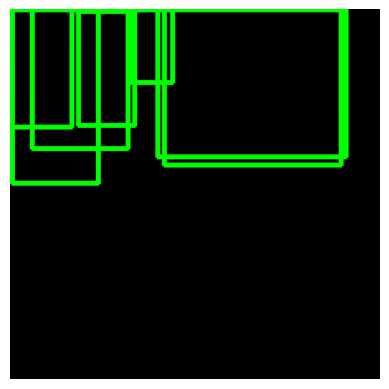

Frame 221, Label: 3, Score: 0.9748833775520325
Frame 221, Label: 3, Score: 0.9363800287246704
Frame 221, Label: 3, Score: 0.9090485572814941
Frame 221, Label: 8, Score: 0.8398210406303406
Frame 221, Label: 3, Score: 0.7146177887916565
Frame 221, Label: 3, Score: 0.6590520143508911
Frame 221, Label: 3, Score: 0.31146422028541565


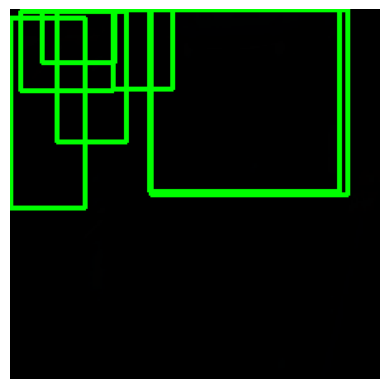

Frame 222, Label: 3, Score: 0.9481323957443237
Frame 222, Label: 3, Score: 0.9384168982505798
Frame 222, Label: 3, Score: 0.9337527751922607
Frame 222, Label: 8, Score: 0.9247264862060547
Frame 222, Label: 3, Score: 0.9139150977134705
Frame 222, Label: 3, Score: 0.75397789478302
Frame 222, Label: 3, Score: 0.46703386306762695


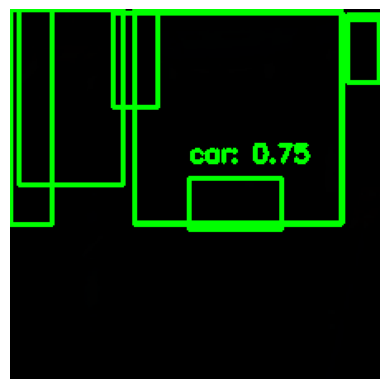

Frame 223, Label: 3, Score: 0.9871669411659241
Frame 223, Label: 3, Score: 0.9567961692810059
Frame 223, Label: 3, Score: 0.8952507376670837
Frame 223, Label: 8, Score: 0.8686823844909668
Frame 223, Label: 3, Score: 0.7456604838371277
Frame 223, Label: 8, Score: 0.6066308617591858
Frame 223, Label: 3, Score: 0.5262485146522522
Frame 223, Label: 3, Score: 0.3555504083633423


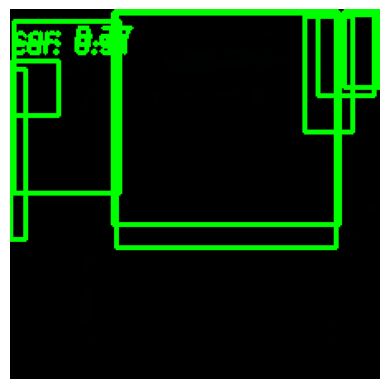

Frame 224, Label: 3, Score: 0.9142600893974304
Frame 224, Label: 8, Score: 0.8854774832725525
Frame 224, Label: 3, Score: 0.8734981417655945
Frame 224, Label: 3, Score: 0.7998430728912354
Frame 224, Label: 3, Score: 0.7698870301246643
Frame 224, Label: 3, Score: 0.5331876277923584
Frame 224, Label: 3, Score: 0.4777684509754181
Frame 224, Label: 3, Score: 0.4775010049343109


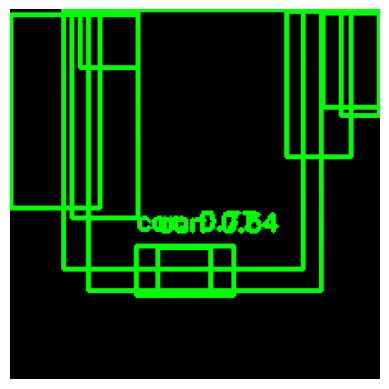

Frame 225, Label: 3, Score: 0.9541963338851929
Frame 225, Label: 3, Score: 0.926618754863739
Frame 225, Label: 3, Score: 0.767110288143158
Frame 225, Label: 8, Score: 0.7201423048973083
Frame 225, Label: 3, Score: 0.6992033123970032
Frame 225, Label: 3, Score: 0.6676371097564697
Frame 225, Label: 8, Score: 0.6258289813995361
Frame 225, Label: 3, Score: 0.6169227361679077
Frame 225, Label: 3, Score: 0.5429636240005493
Frame 225, Label: 3, Score: 0.3508395552635193


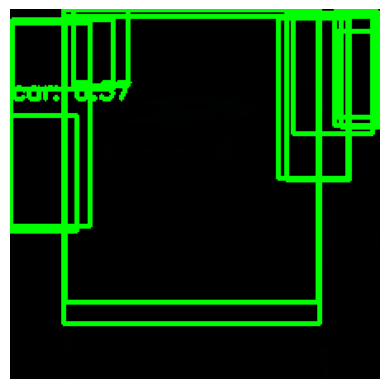

Frame 226, Label: 3, Score: 0.9557746052742004
Frame 226, Label: 3, Score: 0.867999255657196
Frame 226, Label: 6, Score: 0.7011411786079407
Frame 226, Label: 3, Score: 0.6383386254310608
Frame 226, Label: 8, Score: 0.620454728603363
Frame 226, Label: 8, Score: 0.5197323560714722
Frame 226, Label: 3, Score: 0.439180463552475
Frame 226, Label: 3, Score: 0.3702673017978668
Frame 226, Label: 3, Score: 0.31947433948516846
Frame 226, Label: 3, Score: 0.3169025480747223
Frame 226, Label: 3, Score: 0.3026881814002991
Frame 226, Label: 8, Score: 0.30110490322113037


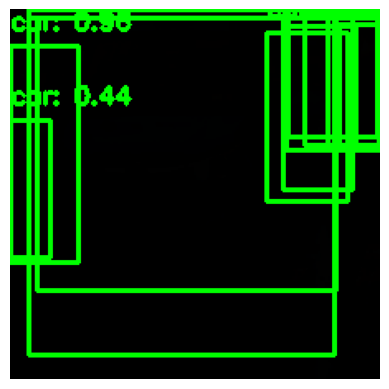

Frame 227, Label: 3, Score: 0.9607261419296265
Frame 227, Label: 3, Score: 0.8149223923683167
Frame 227, Label: 8, Score: 0.6989793181419373
Frame 227, Label: 3, Score: 0.5965610146522522
Frame 227, Label: 8, Score: 0.593824028968811
Frame 227, Label: 3, Score: 0.5791394710540771
Frame 227, Label: 3, Score: 0.44073864817619324
Frame 227, Label: 3, Score: 0.4233434796333313
Frame 227, Label: 3, Score: 0.40048110485076904
Frame 227, Label: 8, Score: 0.3635875880718231
Frame 227, Label: 8, Score: 0.32345569133758545


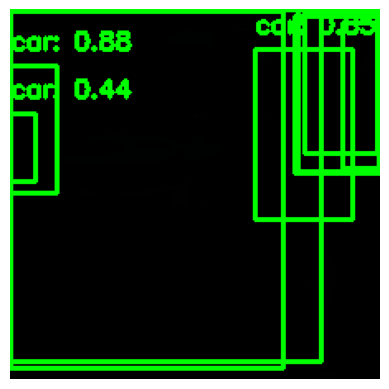

Frame 228, Label: 3, Score: 0.8756103515625
Frame 228, Label: 3, Score: 0.8470415472984314
Frame 228, Label: 3, Score: 0.7254483699798584
Frame 228, Label: 8, Score: 0.675692617893219
Frame 228, Label: 8, Score: 0.557195782661438
Frame 228, Label: 3, Score: 0.483293741941452
Frame 228, Label: 3, Score: 0.48095664381980896
Frame 228, Label: 3, Score: 0.4435553550720215
Frame 228, Label: 6, Score: 0.30424585938453674


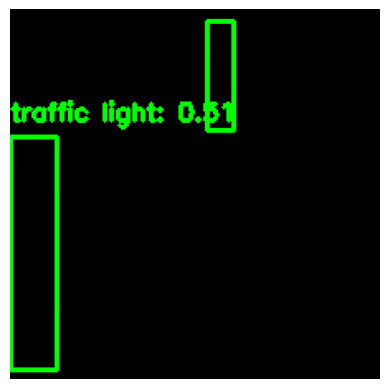

Frame 229, Label: 10, Score: 0.5116461515426636
Frame 229, Label: 16, Score: 0.3236891031265259


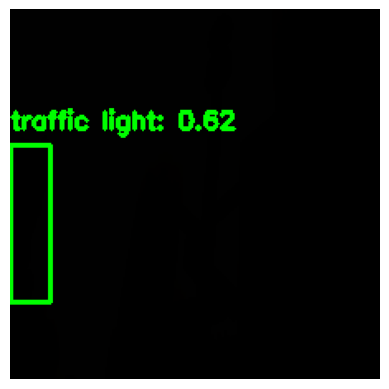

Frame 230, Label: 10, Score: 0.6162510514259338


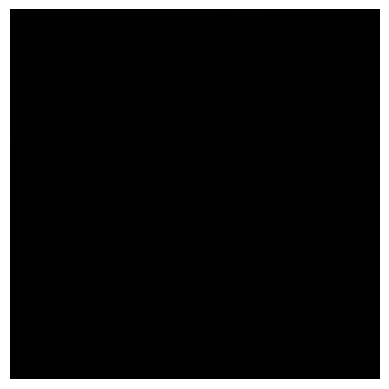

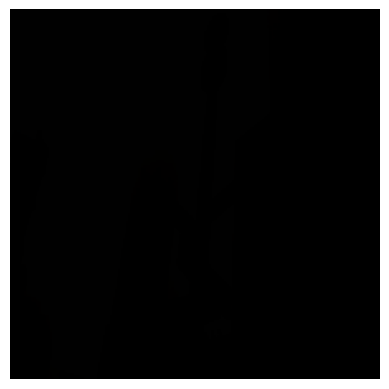

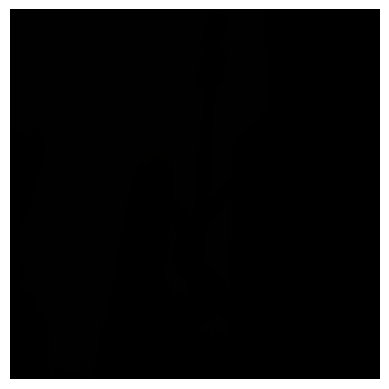

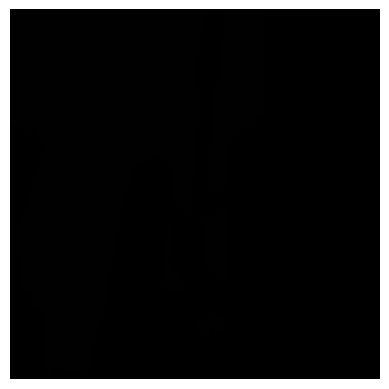

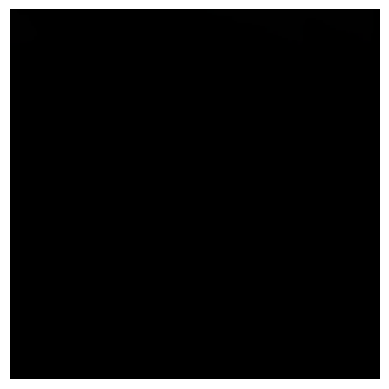

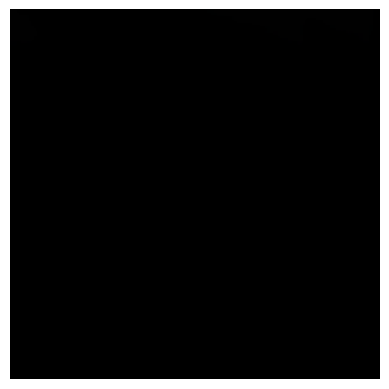

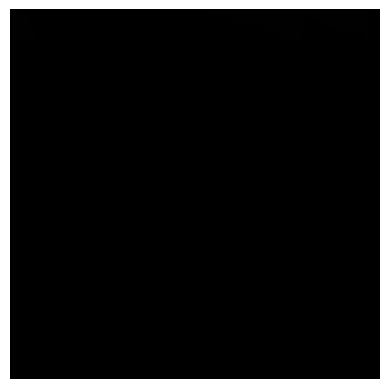

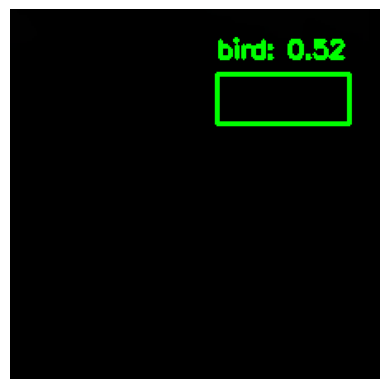

Frame 238, Label: 15, Score: 0.5218418836593628


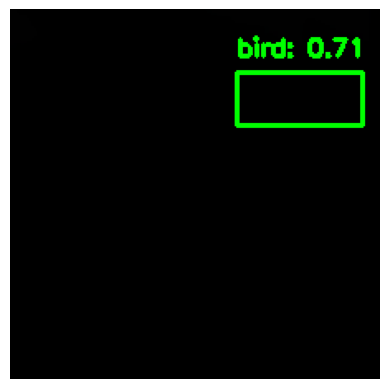

Frame 239, Label: 15, Score: 0.7138141393661499


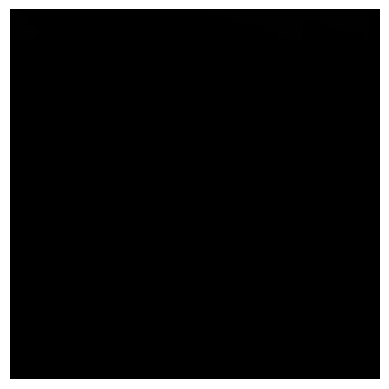

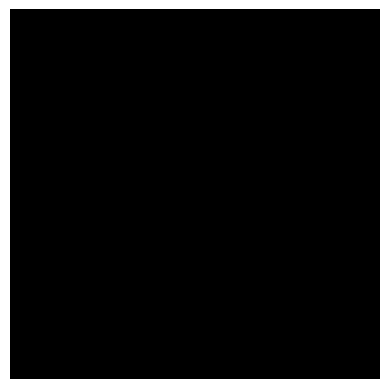

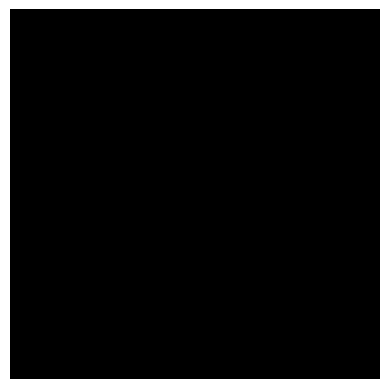

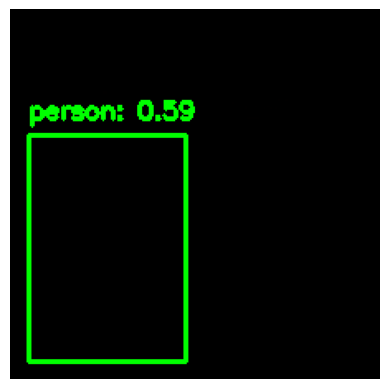

Frame 243, Label: 1, Score: 0.5930077433586121


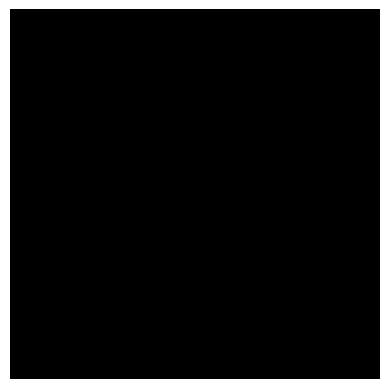

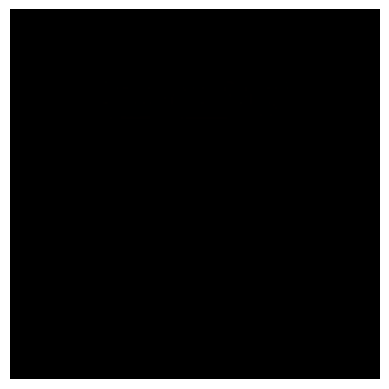

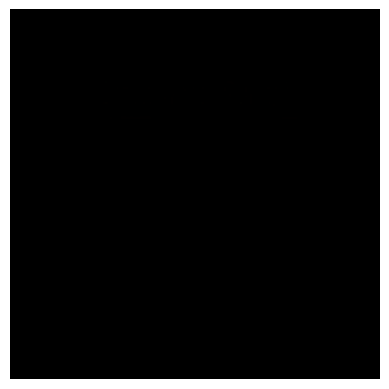

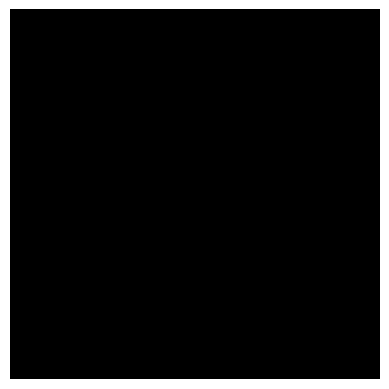

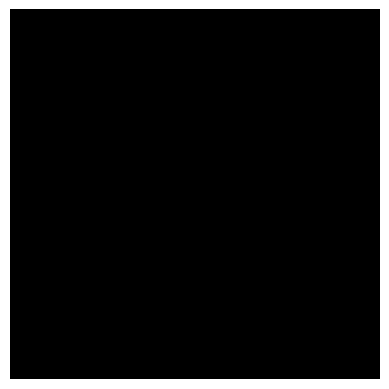

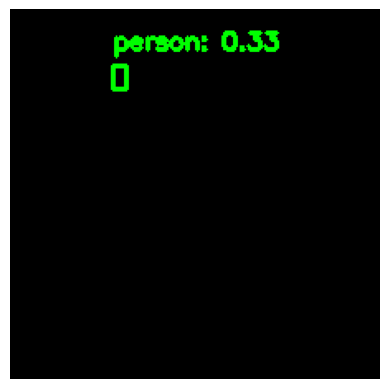

Frame 249, Label: 1, Score: 0.3274269700050354


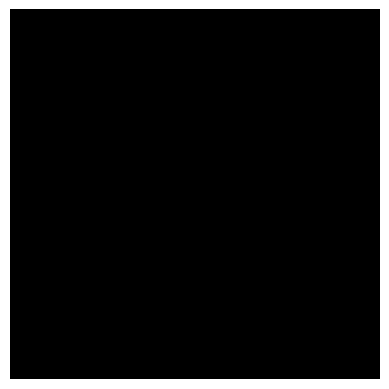

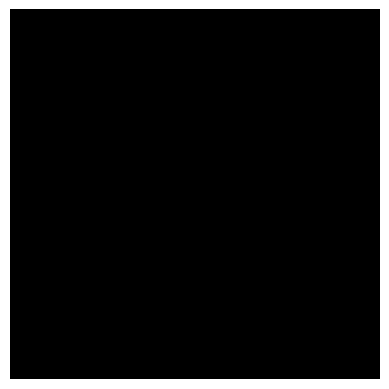

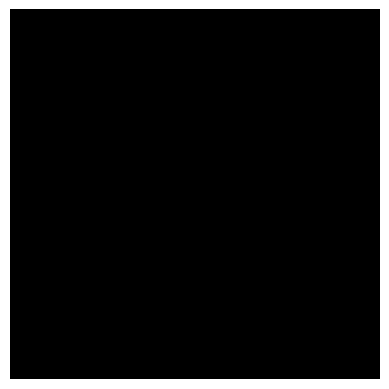

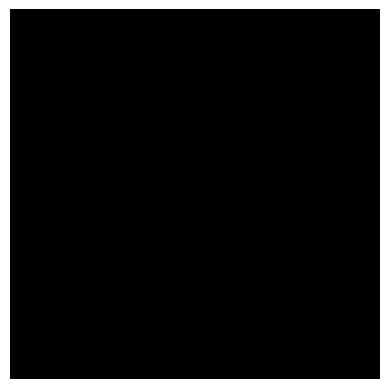

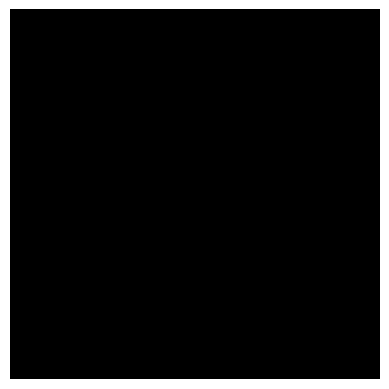

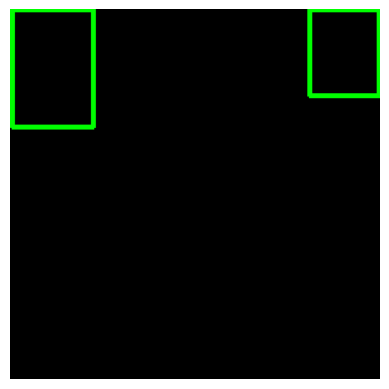

Frame 255, Label: 1, Score: 0.9903230667114258
Frame 255, Label: 1, Score: 0.9752528071403503


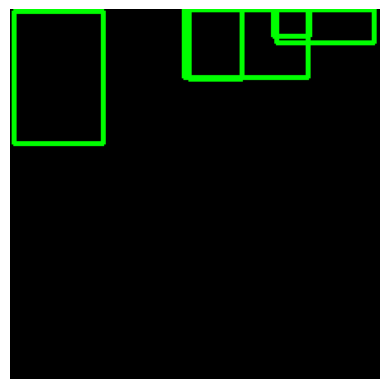

Frame 256, Label: 1, Score: 0.9869483709335327
Frame 256, Label: 1, Score: 0.5394369959831238
Frame 256, Label: 1, Score: 0.5296545028686523
Frame 256, Label: 1, Score: 0.38838261365890503
Frame 256, Label: 1, Score: 0.37136754393577576


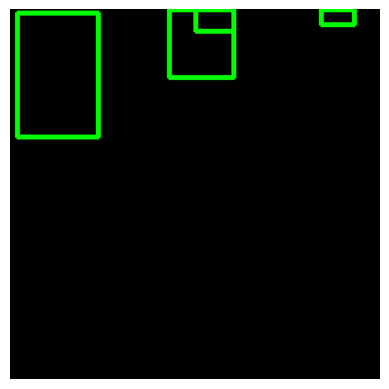

Frame 257, Label: 1, Score: 0.9629334211349487
Frame 257, Label: 3, Score: 0.5283649563789368
Frame 257, Label: 1, Score: 0.4214162230491638
Frame 257, Label: 1, Score: 0.4140254557132721


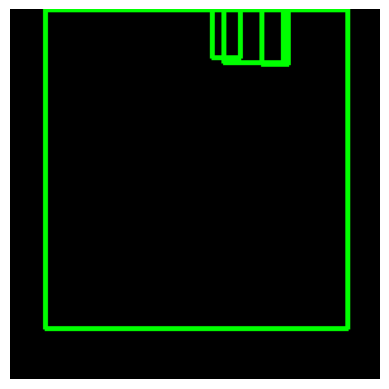

Frame 258, Label: 1, Score: 0.549569308757782
Frame 258, Label: 1, Score: 0.4135207235813141
Frame 258, Label: 1, Score: 0.39142724871635437
Frame 258, Label: 1, Score: 0.3113686144351959


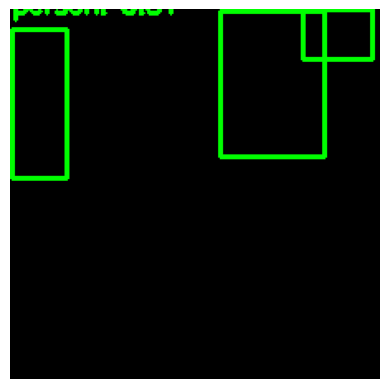

Frame 259, Label: 1, Score: 0.8127050399780273
Frame 259, Label: 1, Score: 0.6100358963012695
Frame 259, Label: 1, Score: 0.4902651906013489


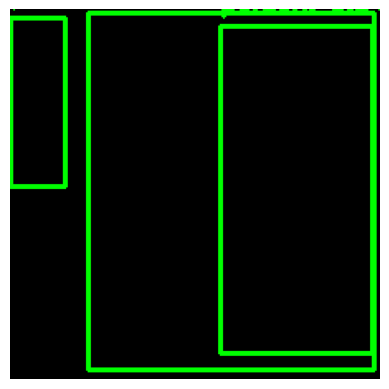

Frame 260, Label: 1, Score: 0.8641626238822937
Frame 260, Label: 1, Score: 0.598067581653595
Frame 260, Label: 1, Score: 0.33977198600769043


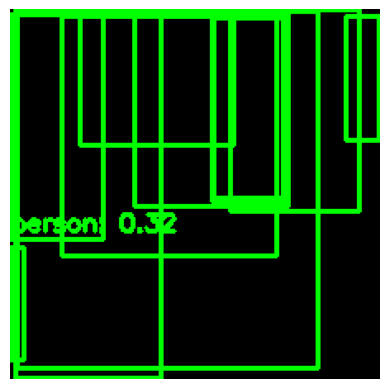

Frame 261, Label: 1, Score: 0.8730619549751282
Frame 261, Label: 1, Score: 0.8067623376846313
Frame 261, Label: 1, Score: 0.7526092529296875
Frame 261, Label: 1, Score: 0.6202333569526672
Frame 261, Label: 1, Score: 0.3912769556045532
Frame 261, Label: 1, Score: 0.3558392822742462
Frame 261, Label: 1, Score: 0.34950098395347595
Frame 261, Label: 1, Score: 0.3423392176628113
Frame 261, Label: 1, Score: 0.33639606833457947
Frame 261, Label: 36, Score: 0.31914424896240234
Frame 261, Label: 1, Score: 0.31907138228416443


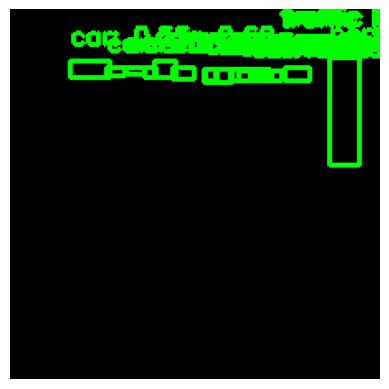

Frame 262, Label: 3, Score: 0.9695656299591064
Frame 262, Label: 3, Score: 0.9198576807975769
Frame 262, Label: 3, Score: 0.9014426469802856
Frame 262, Label: 3, Score: 0.8741253018379211
Frame 262, Label: 10, Score: 0.8064478635787964
Frame 262, Label: 3, Score: 0.7666831016540527
Frame 262, Label: 1, Score: 0.7655041217803955
Frame 262, Label: 3, Score: 0.7540445327758789
Frame 262, Label: 10, Score: 0.7138949036598206
Frame 262, Label: 10, Score: 0.6823452115058899
Frame 262, Label: 3, Score: 0.595460057258606
Frame 262, Label: 3, Score: 0.5910576581954956
Frame 262, Label: 3, Score: 0.5521430969238281
Frame 262, Label: 3, Score: 0.5423851013183594
Frame 262, Label: 3, Score: 0.5085189938545227
Frame 262, Label: 3, Score: 0.49619993567466736
Frame 262, Label: 3, Score: 0.44167378544807434
Frame 262, Label: 10, Score: 0.42871373891830444
Frame 262, Label: 3, Score: 0.38682910799980164
Frame 262, Label: 3, Score: 0.3754286766052246
Frame 262, Label: 3, Score: 0.3701797127723694
Frame 

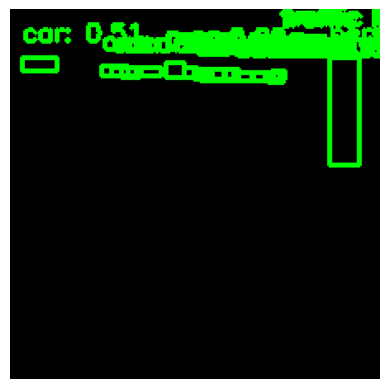

Frame 263, Label: 3, Score: 0.9701557755470276
Frame 263, Label: 3, Score: 0.9151776432991028
Frame 263, Label: 3, Score: 0.9140962958335876
Frame 263, Label: 3, Score: 0.8517757058143616
Frame 263, Label: 3, Score: 0.8289483189582825
Frame 263, Label: 3, Score: 0.7996476888656616
Frame 263, Label: 10, Score: 0.7882933616638184
Frame 263, Label: 3, Score: 0.7256136536598206
Frame 263, Label: 3, Score: 0.7173245549201965
Frame 263, Label: 10, Score: 0.7119091153144836
Frame 263, Label: 1, Score: 0.7069238424301147
Frame 263, Label: 10, Score: 0.6814042329788208
Frame 263, Label: 3, Score: 0.6588791608810425
Frame 263, Label: 3, Score: 0.6203987002372742
Frame 263, Label: 3, Score: 0.5651853084564209
Frame 263, Label: 3, Score: 0.5160998702049255
Frame 263, Label: 3, Score: 0.5120620131492615
Frame 263, Label: 3, Score: 0.4892173409461975
Frame 263, Label: 3, Score: 0.4438026547431946
Frame 263, Label: 10, Score: 0.38821765780448914
Frame 263, Label: 3, Score: 0.38363397121429443
Frame 2

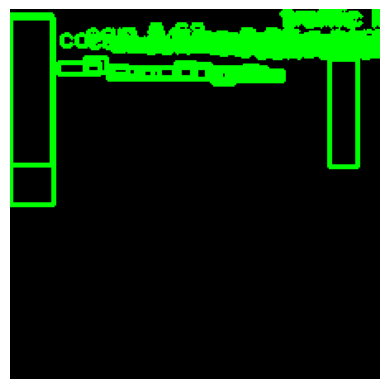

Frame 264, Label: 3, Score: 0.9563583135604858
Frame 264, Label: 3, Score: 0.9488496780395508
Frame 264, Label: 3, Score: 0.9153620004653931
Frame 264, Label: 3, Score: 0.9105339050292969
Frame 264, Label: 3, Score: 0.9067414402961731
Frame 264, Label: 3, Score: 0.8982951641082764
Frame 264, Label: 3, Score: 0.8555179238319397
Frame 264, Label: 3, Score: 0.8364388942718506
Frame 264, Label: 3, Score: 0.8069092035293579
Frame 264, Label: 10, Score: 0.7891272306442261
Frame 264, Label: 3, Score: 0.7596957087516785
Frame 264, Label: 10, Score: 0.7162443995475769
Frame 264, Label: 3, Score: 0.7027999758720398
Frame 264, Label: 10, Score: 0.682388424873352
Frame 264, Label: 3, Score: 0.648395299911499
Frame 264, Label: 3, Score: 0.6483057141304016
Frame 264, Label: 3, Score: 0.6160487532615662
Frame 264, Label: 3, Score: 0.592549741268158
Frame 264, Label: 3, Score: 0.5690573453903198
Frame 264, Label: 1, Score: 0.5462446212768555
Frame 264, Label: 3, Score: 0.5451337695121765
Frame 264, La

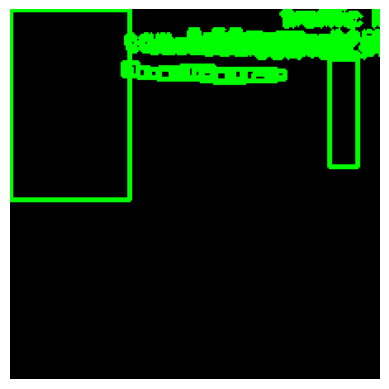

Frame 265, Label: 3, Score: 0.9460029006004333
Frame 265, Label: 3, Score: 0.9439598917961121
Frame 265, Label: 3, Score: 0.9398071765899658
Frame 265, Label: 3, Score: 0.844655454158783
Frame 265, Label: 3, Score: 0.8260113000869751
Frame 265, Label: 10, Score: 0.7843134999275208
Frame 265, Label: 3, Score: 0.775888979434967
Frame 265, Label: 3, Score: 0.7748404741287231
Frame 265, Label: 3, Score: 0.7534642815589905
Frame 265, Label: 10, Score: 0.7238237261772156
Frame 265, Label: 3, Score: 0.6770401000976562
Frame 265, Label: 3, Score: 0.6616103649139404
Frame 265, Label: 10, Score: 0.6584851741790771
Frame 265, Label: 3, Score: 0.6576262712478638
Frame 265, Label: 3, Score: 0.657429575920105
Frame 265, Label: 3, Score: 0.6319725513458252
Frame 265, Label: 3, Score: 0.5807449221611023
Frame 265, Label: 3, Score: 0.5517726540565491
Frame 265, Label: 3, Score: 0.5348040461540222
Frame 265, Label: 3, Score: 0.46564027667045593
Frame 265, Label: 3, Score: 0.45714274048805237
Frame 265, 

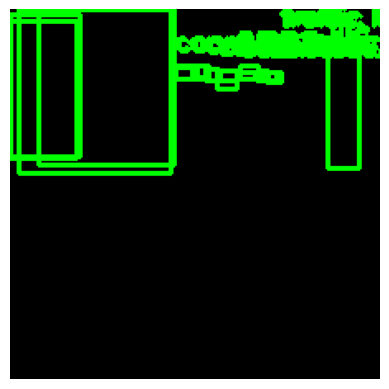

Frame 266, Label: 3, Score: 0.9478254914283752
Frame 266, Label: 3, Score: 0.8985720872879028
Frame 266, Label: 3, Score: 0.8047882914543152
Frame 266, Label: 3, Score: 0.8017130494117737
Frame 266, Label: 3, Score: 0.799386203289032
Frame 266, Label: 10, Score: 0.7813254594802856
Frame 266, Label: 3, Score: 0.7455123066902161
Frame 266, Label: 10, Score: 0.7140219211578369
Frame 266, Label: 3, Score: 0.7082493901252747
Frame 266, Label: 3, Score: 0.6818091869354248
Frame 266, Label: 10, Score: 0.6649505496025085
Frame 266, Label: 3, Score: 0.567655086517334
Frame 266, Label: 3, Score: 0.5325624346733093
Frame 266, Label: 8, Score: 0.5011716485023499
Frame 266, Label: 3, Score: 0.47092705965042114
Frame 266, Label: 11, Score: 0.46964582800865173
Frame 266, Label: 3, Score: 0.46108537912368774
Frame 266, Label: 3, Score: 0.4000021517276764
Frame 266, Label: 3, Score: 0.3927754759788513
Frame 266, Label: 10, Score: 0.38019564747810364
Frame 266, Label: 8, Score: 0.3756357729434967


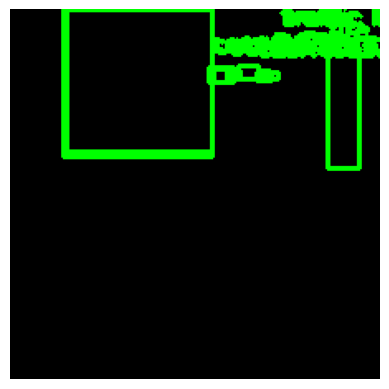

Frame 267, Label: 3, Score: 0.9178344011306763
Frame 267, Label: 3, Score: 0.8323994874954224
Frame 267, Label: 3, Score: 0.8304174542427063
Frame 267, Label: 3, Score: 0.8247355818748474
Frame 267, Label: 10, Score: 0.7275757193565369
Frame 267, Label: 10, Score: 0.6341049671173096
Frame 267, Label: 10, Score: 0.5851113796234131
Frame 267, Label: 8, Score: 0.5821381211280823
Frame 267, Label: 3, Score: 0.5517083406448364
Frame 267, Label: 3, Score: 0.5453233122825623
Frame 267, Label: 11, Score: 0.513173520565033
Frame 267, Label: 3, Score: 0.45875439047813416
Frame 267, Label: 3, Score: 0.3690488040447235


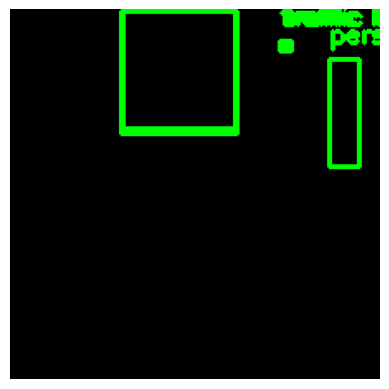

Frame 268, Label: 3, Score: 0.921082615852356
Frame 268, Label: 1, Score: 0.8664524555206299
Frame 268, Label: 10, Score: 0.694786012172699
Frame 268, Label: 10, Score: 0.604385495185852
Frame 268, Label: 8, Score: 0.5246437788009644
Frame 268, Label: 10, Score: 0.5139456987380981


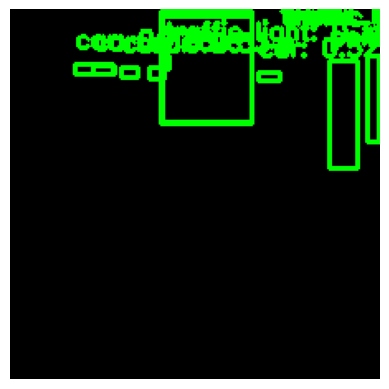

Frame 269, Label: 3, Score: 0.955003023147583
Frame 269, Label: 1, Score: 0.8820181488990784
Frame 269, Label: 3, Score: 0.8691394329071045
Frame 269, Label: 3, Score: 0.7793844938278198
Frame 269, Label: 3, Score: 0.7237390875816345
Frame 269, Label: 1, Score: 0.7099459171295166
Frame 269, Label: 10, Score: 0.7034392356872559
Frame 269, Label: 10, Score: 0.6318255066871643
Frame 269, Label: 10, Score: 0.5424634218215942
Frame 269, Label: 3, Score: 0.5308453440666199
Frame 269, Label: 3, Score: 0.5219672322273254
Frame 269, Label: 8, Score: 0.505747377872467
Frame 269, Label: 10, Score: 0.325331449508667


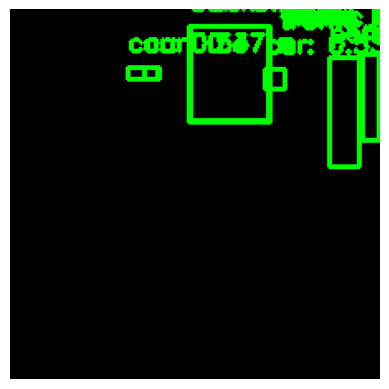

Frame 270, Label: 1, Score: 0.9098743200302124
Frame 270, Label: 10, Score: 0.83626389503479
Frame 270, Label: 10, Score: 0.7424523234367371
Frame 270, Label: 3, Score: 0.7341259717941284
Frame 270, Label: 1, Score: 0.7047029733657837
Frame 270, Label: 8, Score: 0.5419899821281433
Frame 270, Label: 3, Score: 0.5325348973274231
Frame 270, Label: 3, Score: 0.5302269458770752
Frame 270, Label: 10, Score: 0.5146563649177551
Frame 270, Label: 3, Score: 0.46932628750801086
Frame 270, Label: 10, Score: 0.4484246075153351


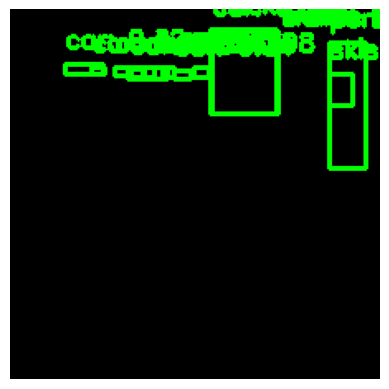

Frame 271, Label: 3, Score: 0.9785762429237366
Frame 271, Label: 3, Score: 0.8835350871086121
Frame 271, Label: 1, Score: 0.8833048939704895
Frame 271, Label: 3, Score: 0.8565557599067688
Frame 271, Label: 3, Score: 0.847110390663147
Frame 271, Label: 10, Score: 0.8253591656684875
Frame 271, Label: 3, Score: 0.7112159729003906
Frame 271, Label: 10, Score: 0.6922524571418762
Frame 271, Label: 10, Score: 0.5076400637626648
Frame 271, Label: 3, Score: 0.40805551409721375
Frame 271, Label: 31, Score: 0.369355708360672
Frame 271, Label: 3, Score: 0.3656272888183594
Frame 271, Label: 3, Score: 0.345573365688324
Frame 271, Label: 8, Score: 0.32866454124450684
Frame 271, Label: 3, Score: 0.3215157389640808
Frame 271, Label: 3, Score: 0.30787917971611023


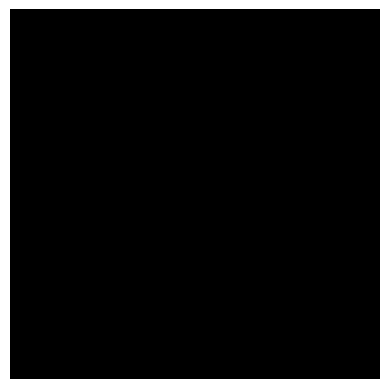

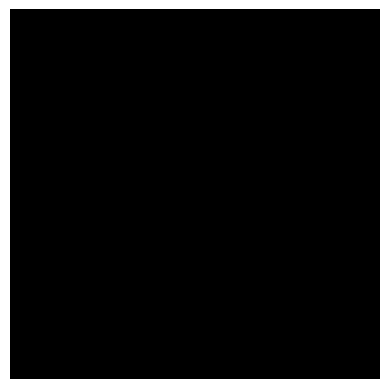

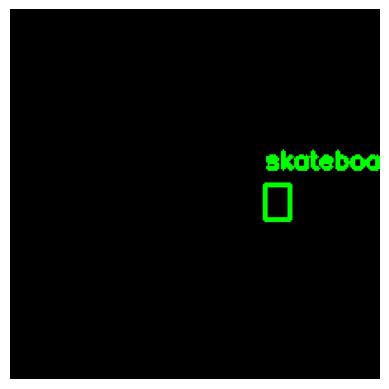

Frame 274, Label: 37, Score: 0.322719931602478


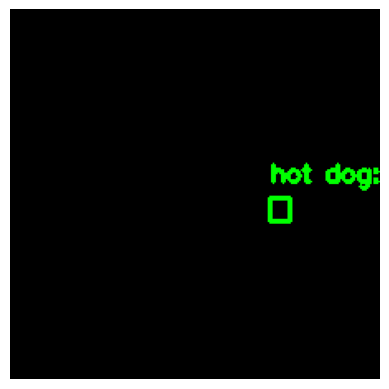

Frame 275, Label: 53, Score: 0.3364466428756714


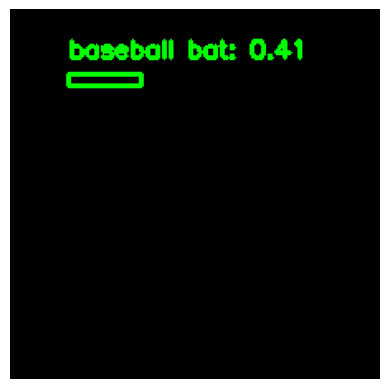

Frame 276, Label: 35, Score: 0.41102245450019836


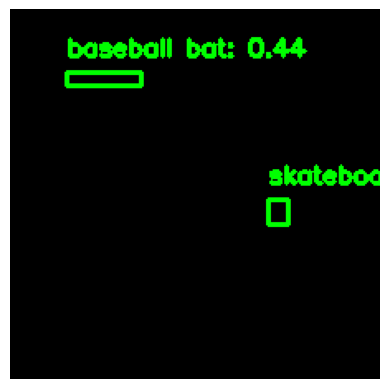

Frame 277, Label: 37, Score: 0.8989781737327576
Frame 277, Label: 35, Score: 0.43693357706069946


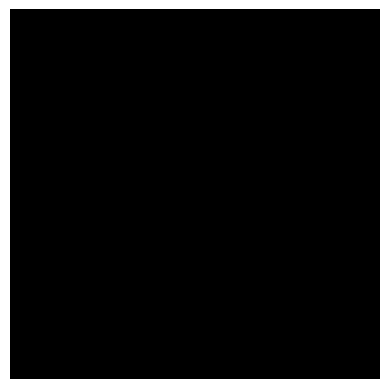

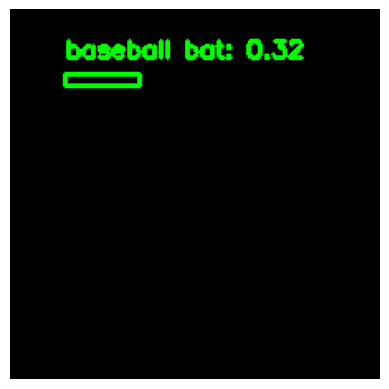

Frame 279, Label: 35, Score: 0.3159841299057007


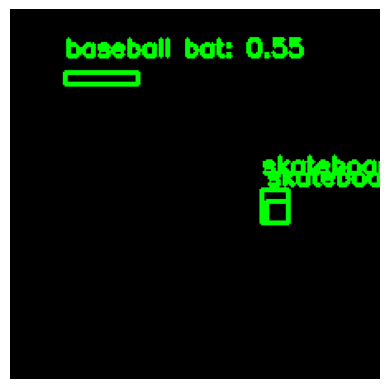

Frame 280, Label: 37, Score: 0.9242280721664429
Frame 280, Label: 37, Score: 0.7674358487129211
Frame 280, Label: 35, Score: 0.5485654473304749


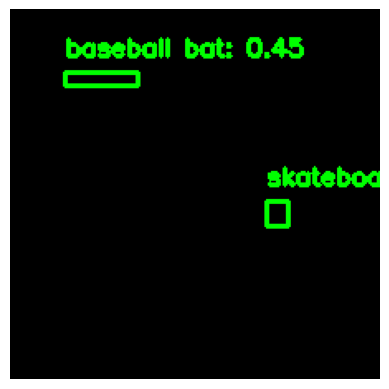

Frame 281, Label: 37, Score: 0.6512177586555481
Frame 281, Label: 35, Score: 0.4485494792461395


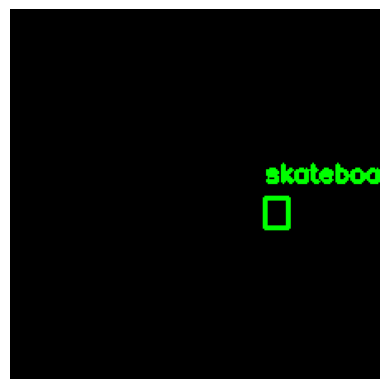

Frame 282, Label: 37, Score: 0.6723360419273376


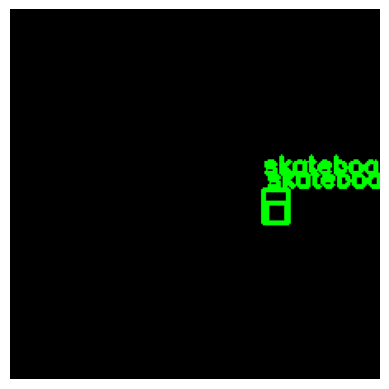

Frame 283, Label: 37, Score: 0.44678619503974915
Frame 283, Label: 37, Score: 0.328473299741745


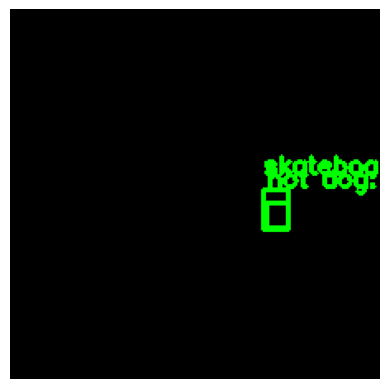

Frame 284, Label: 37, Score: 0.5671489834785461
Frame 284, Label: 53, Score: 0.34888964891433716


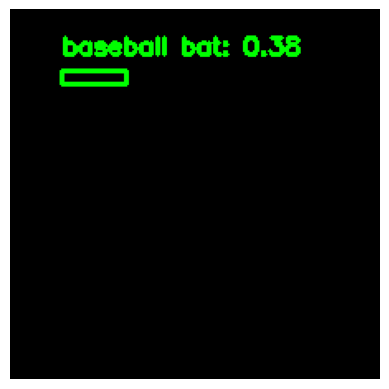

Frame 285, Label: 35, Score: 0.37627699971199036


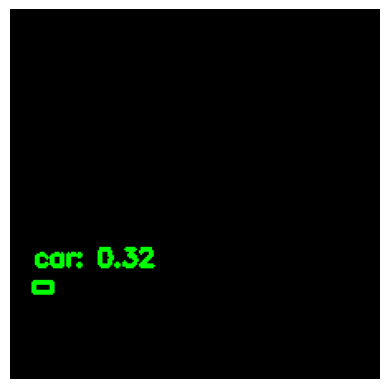

Frame 286, Label: 3, Score: 0.3242686986923218


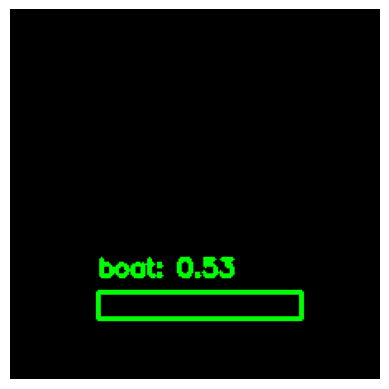

Frame 287, Label: 9, Score: 0.5341731309890747


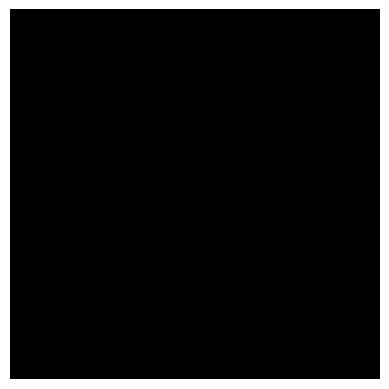

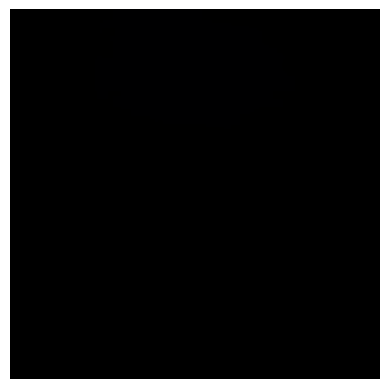

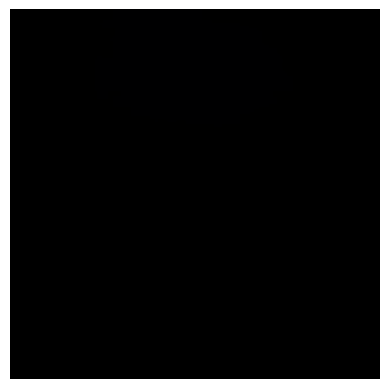

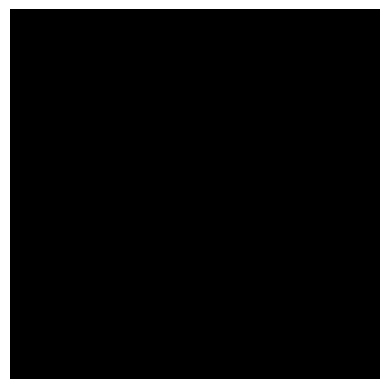

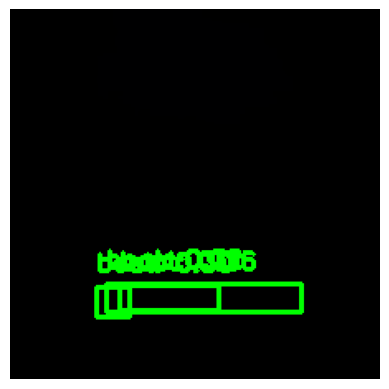

Frame 292, Label: 9, Score: 0.3629447817802429
Frame 292, Label: 9, Score: 0.31767910718917847
Frame 292, Label: 9, Score: 0.30457013845443726


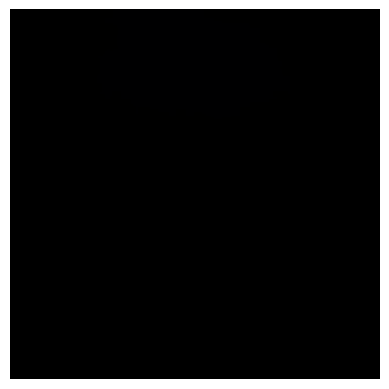

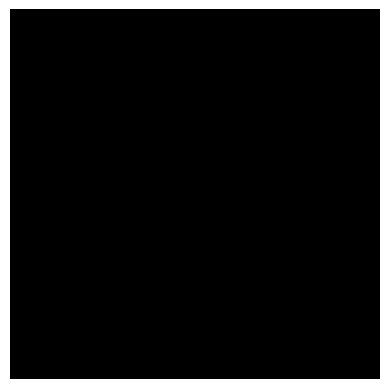

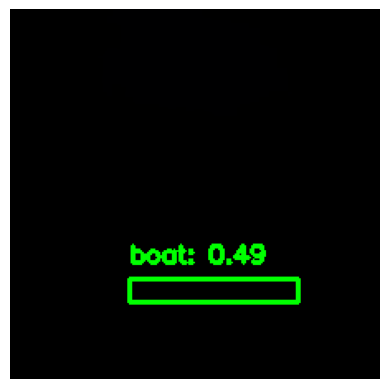

Frame 295, Label: 9, Score: 0.4900974929332733


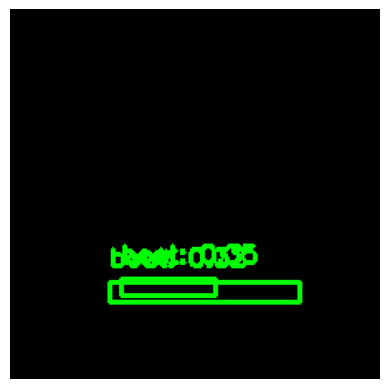

Frame 296, Label: 9, Score: 0.3477890193462372
Frame 296, Label: 9, Score: 0.3234211504459381


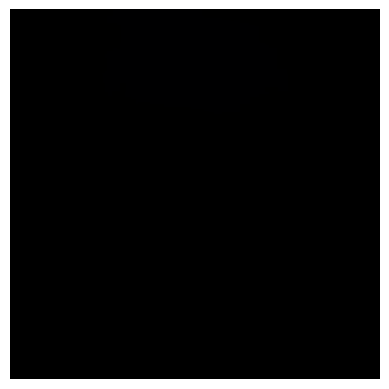

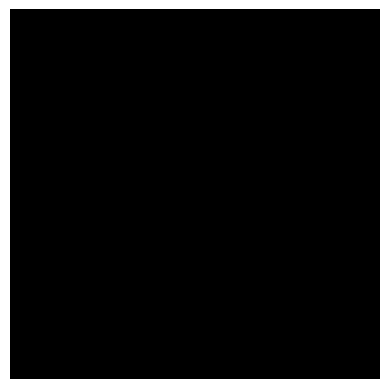

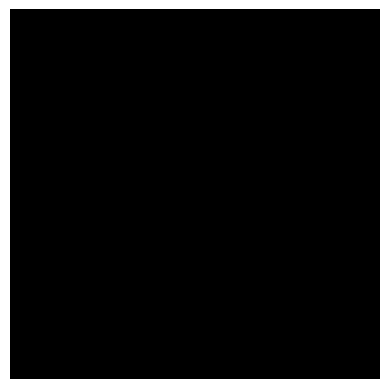

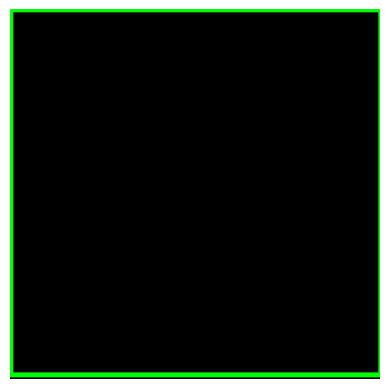

Frame 300, Label: 64, Score: 0.3301524817943573


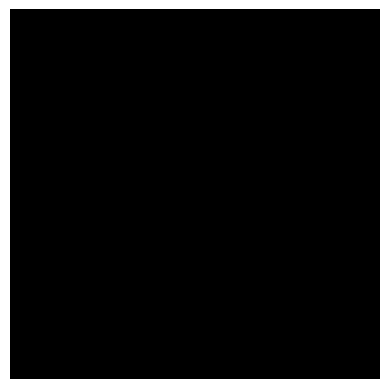

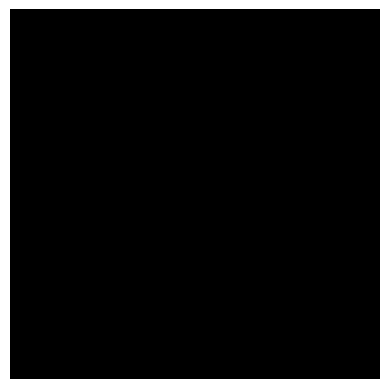

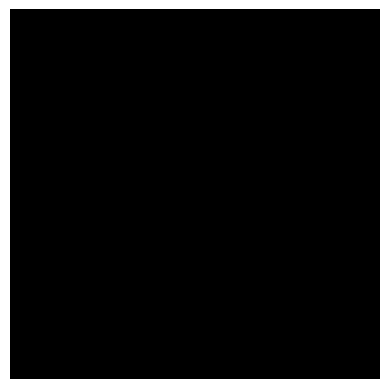

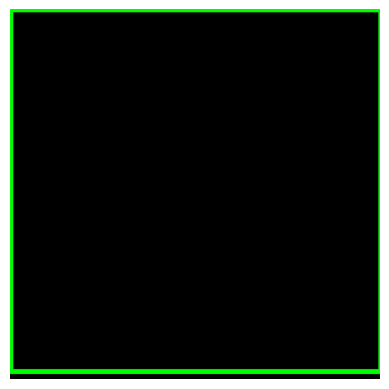

Frame 304, Label: 64, Score: 0.36890432238578796


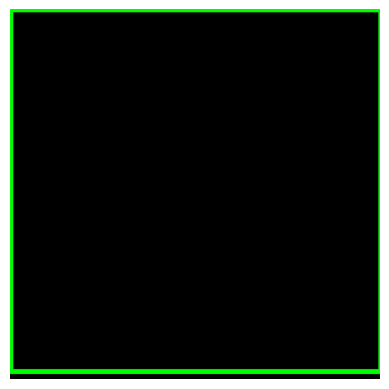

Frame 305, Label: 64, Score: 0.35526737570762634


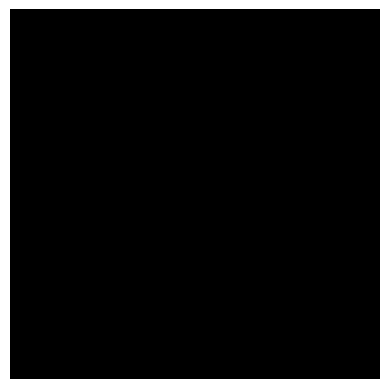

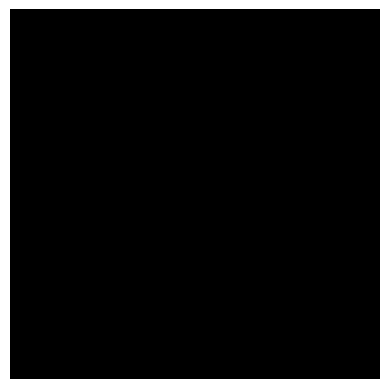

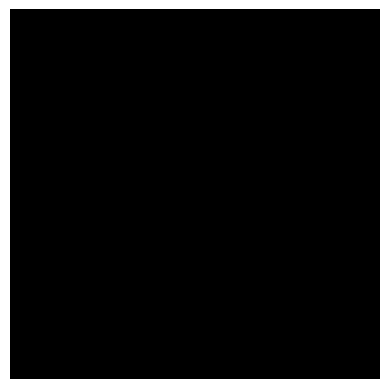

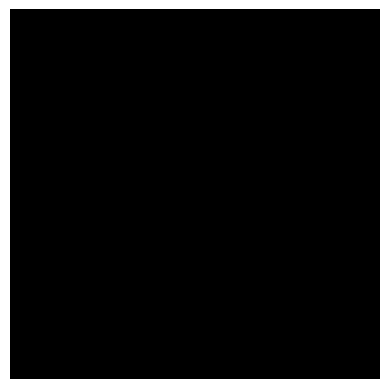

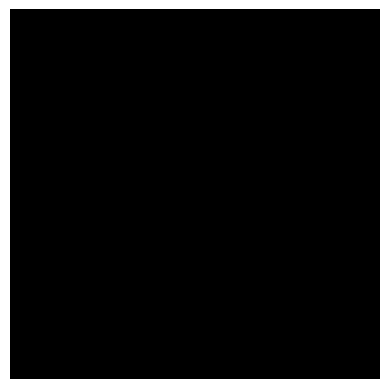

...

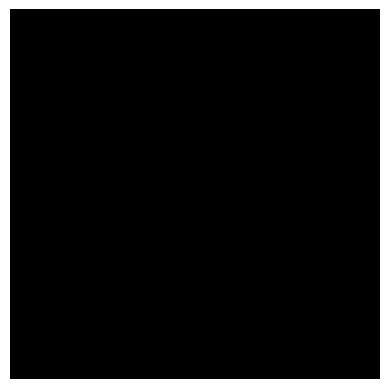

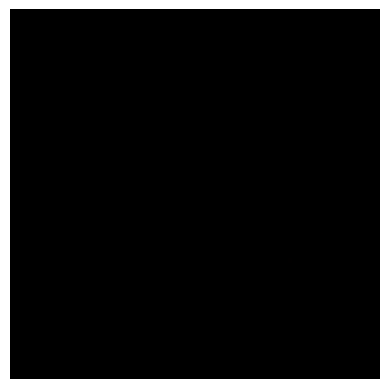

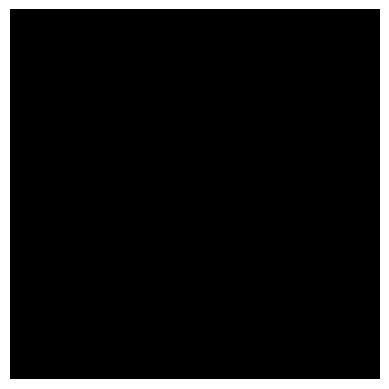

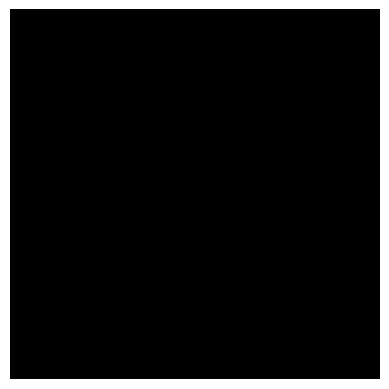

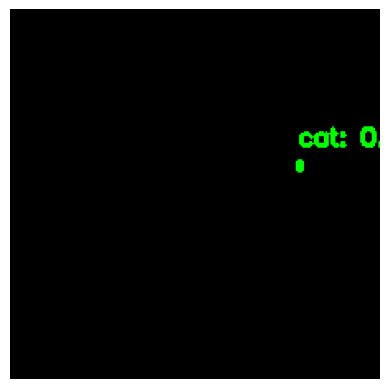

Frame 337, Label: 16, Score: 0.6254063844680786


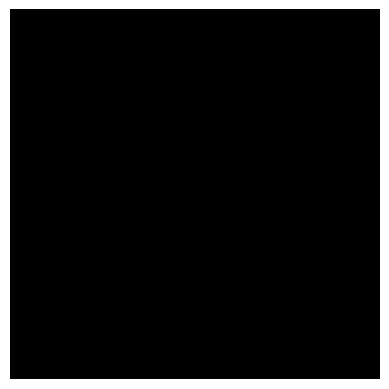

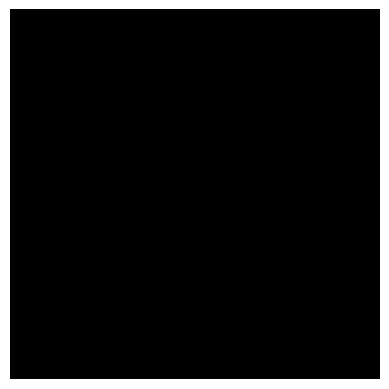

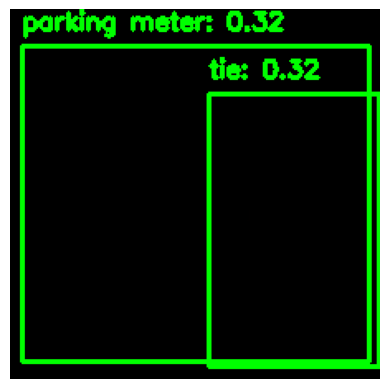

Frame 340, Label: 28, Score: 0.32230398058891296
Frame 340, Label: 13, Score: 0.3184390366077423


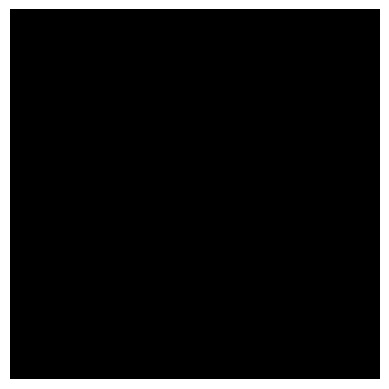

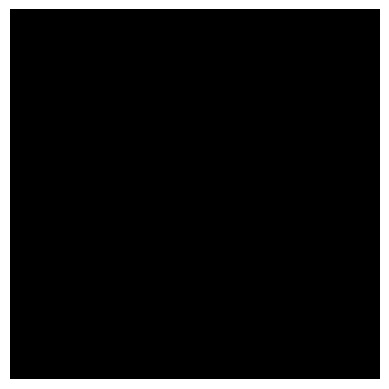

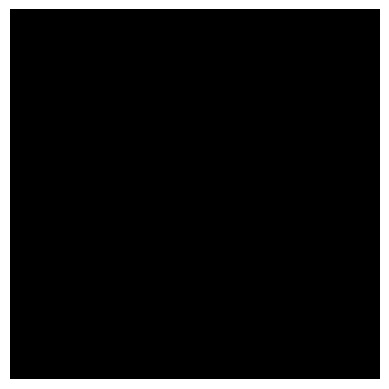

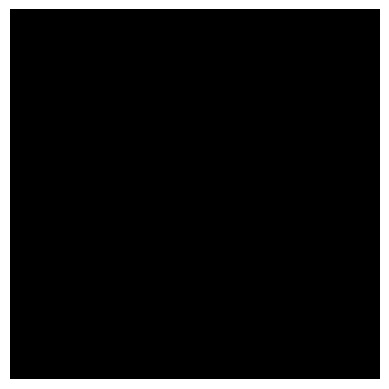

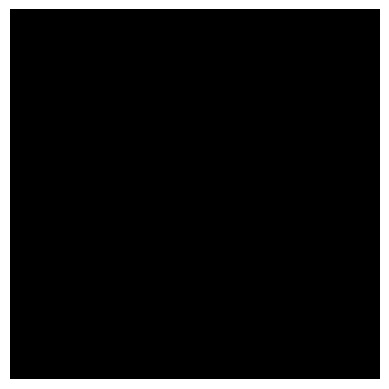

...

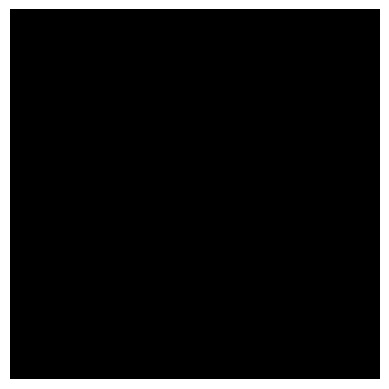

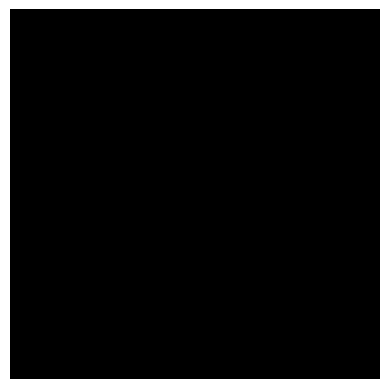

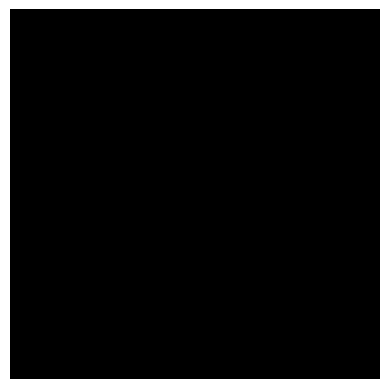

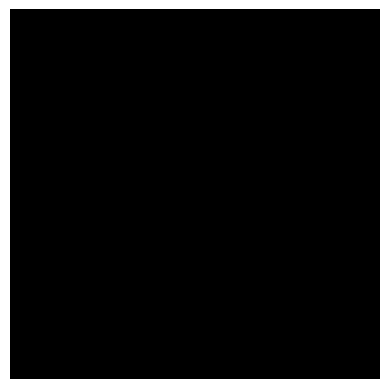

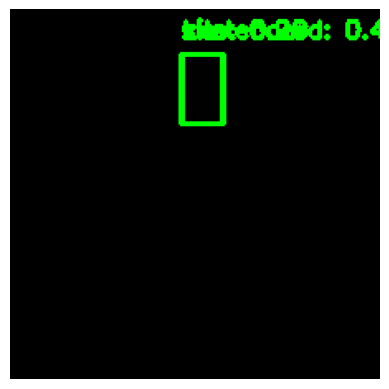

Frame 351, Label: 34, Score: 0.9632713198661804
Frame 351, Label: 37, Score: 0.41100913286209106


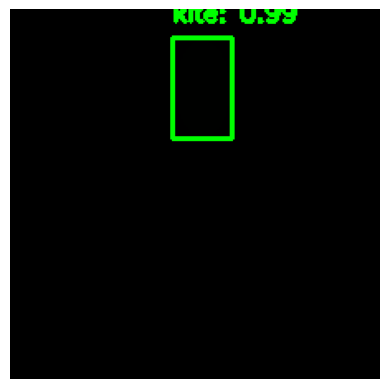

Frame 352, Label: 34, Score: 0.990749180316925


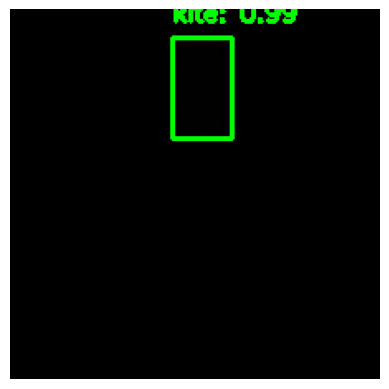

Frame 353, Label: 34, Score: 0.9901532530784607


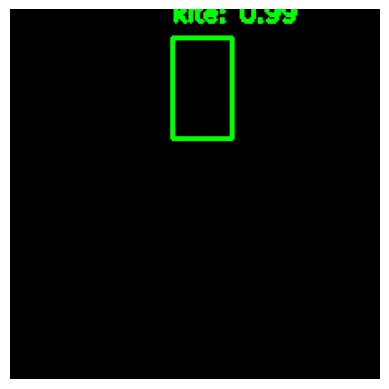

Frame 354, Label: 34, Score: 0.9904026985168457


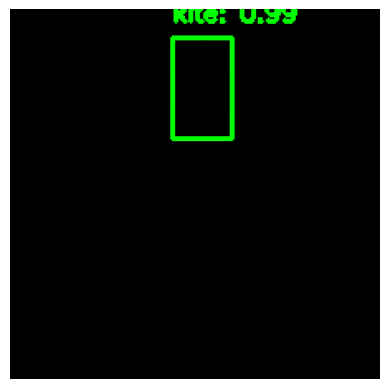

Frame 355, Label: 34, Score: 0.9903547763824463


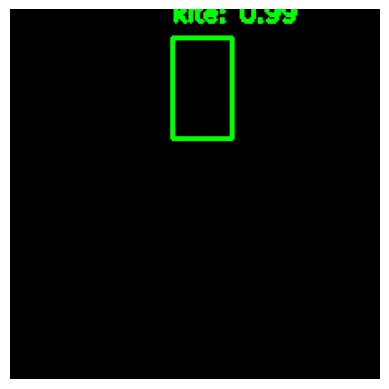

Frame 356, Label: 34, Score: 0.9903774857521057


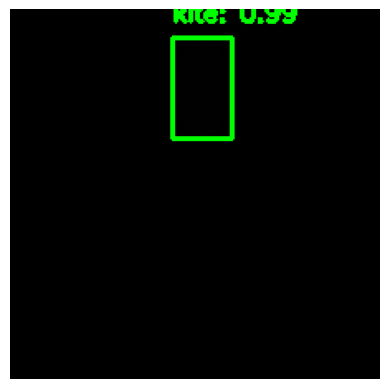

Frame 357, Label: 34, Score: 0.990190863609314


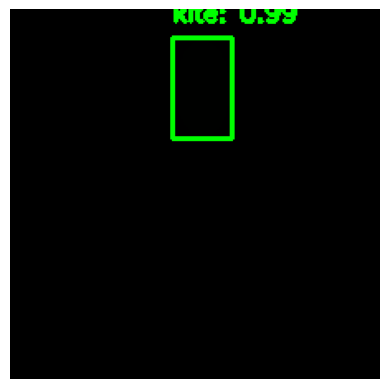

Frame 358, Label: 34, Score: 0.9903653264045715


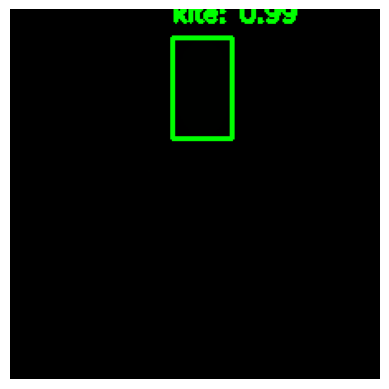

Frame 359, Label: 34, Score: 0.9901500940322876


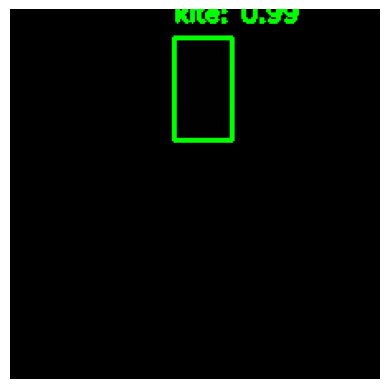

Frame 360, Label: 34, Score: 0.9899411797523499


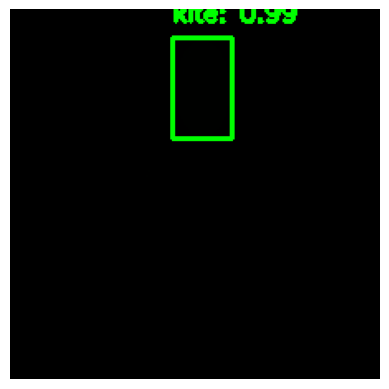

Frame 361, Label: 34, Score: 0.9900224804878235


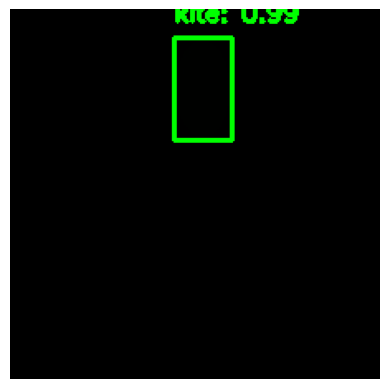

Frame 362, Label: 34, Score: 0.989981472492218


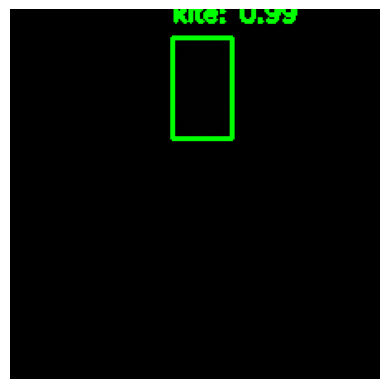

Frame 363, Label: 34, Score: 0.9903509020805359


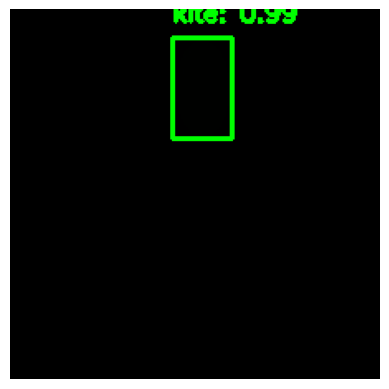

Frame 364, Label: 34, Score: 0.990563154220581


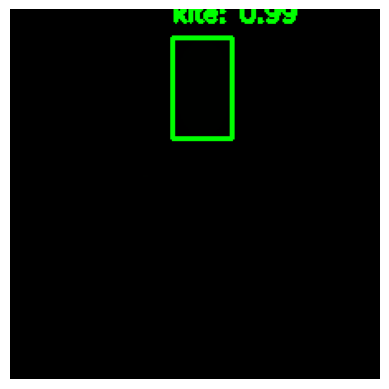

Frame 365, Label: 34, Score: 0.9905586242675781


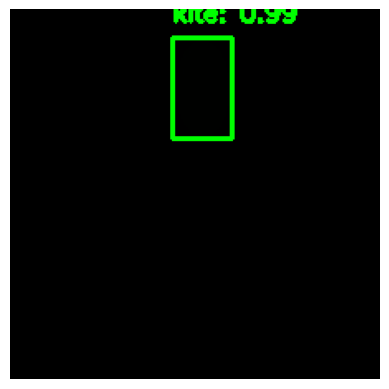

Frame 366, Label: 34, Score: 0.990698516368866


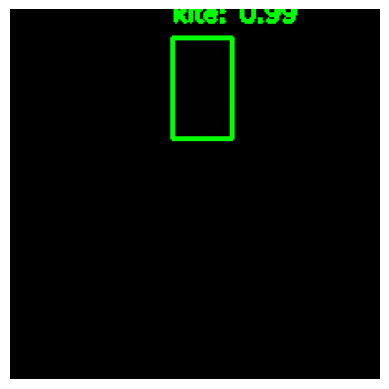

Frame 367, Label: 34, Score: 0.9897704124450684


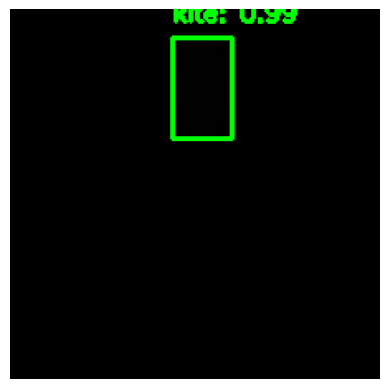

Frame 368, Label: 34, Score: 0.9890843033790588


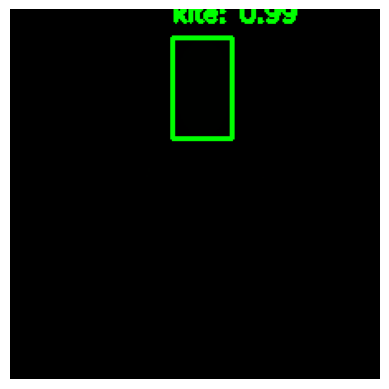

Frame 369, Label: 34, Score: 0.9889453053474426


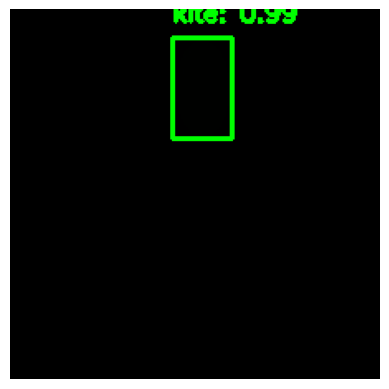

Frame 370, Label: 34, Score: 0.9891732931137085


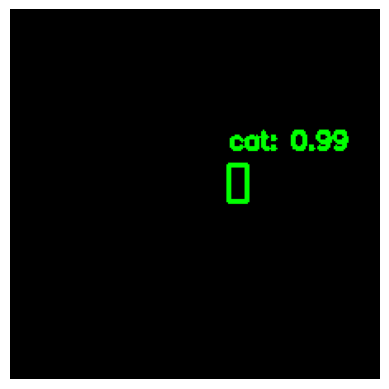

Frame 371, Label: 16, Score: 0.9934114813804626


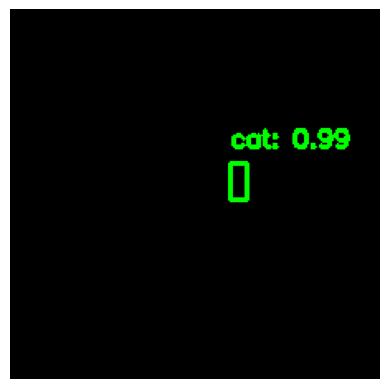

Frame 372, Label: 16, Score: 0.9939451813697815


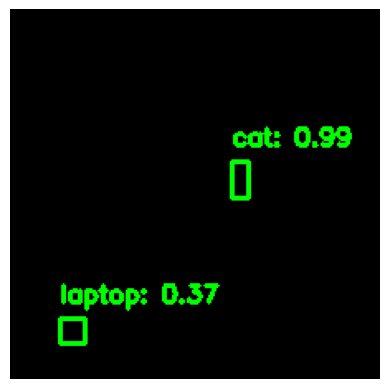

Frame 373, Label: 16, Score: 0.9928572177886963
Frame 373, Label: 64, Score: 0.3728974759578705


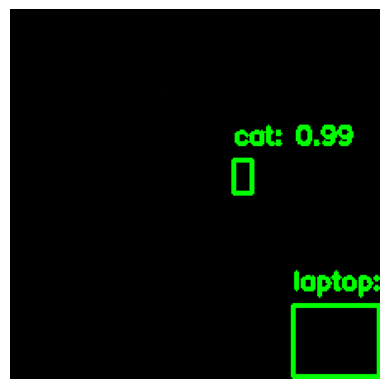

Frame 374, Label: 16, Score: 0.993111252784729
Frame 374, Label: 64, Score: 0.47283804416656494


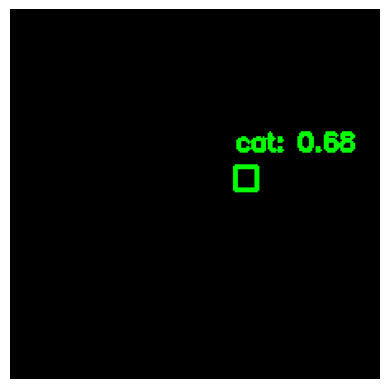

Frame 375, Label: 16, Score: 0.6766908168792725


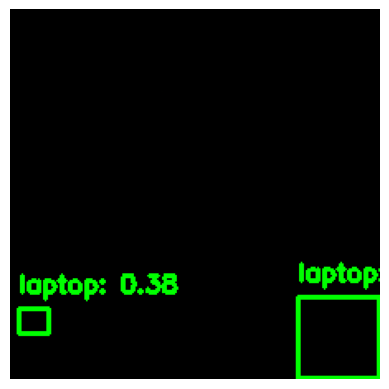

Frame 376, Label: 64, Score: 0.38150495290756226
Frame 376, Label: 64, Score: 0.3081620931625366


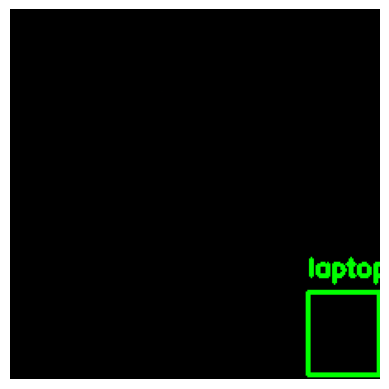

Frame 377, Label: 64, Score: 0.5148416757583618


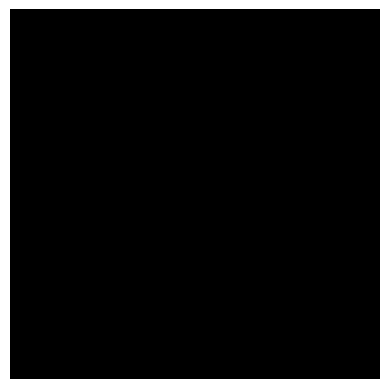

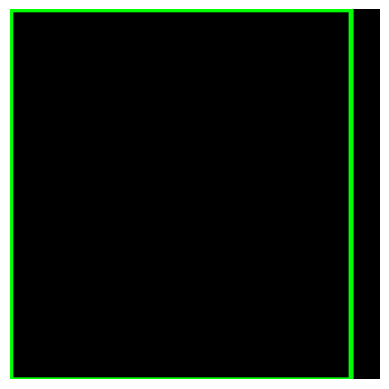

Frame 379, Label: 64, Score: 0.5618060231208801


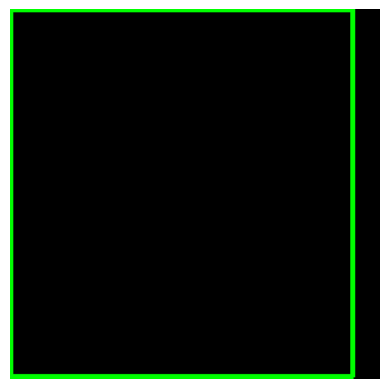

Frame 380, Label: 64, Score: 0.6962523460388184


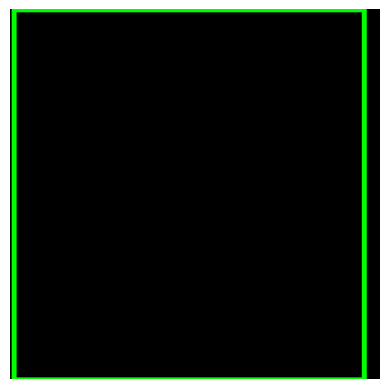

Frame 381, Label: 64, Score: 0.7698764801025391


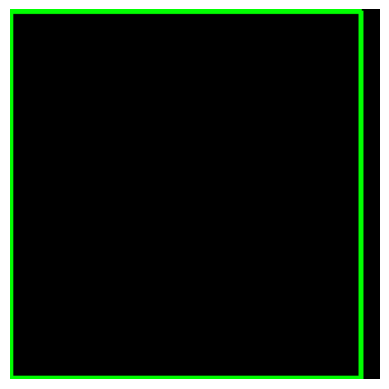

Frame 382, Label: 64, Score: 0.7898938059806824


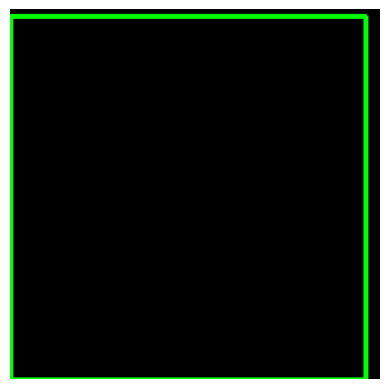

Frame 383, Label: 64, Score: 0.6414507031440735


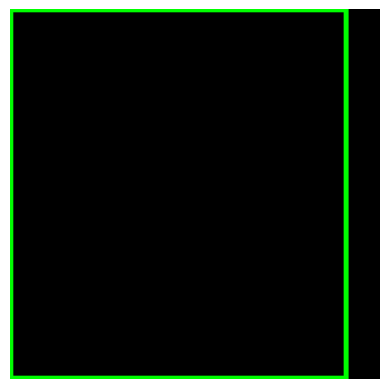

Frame 384, Label: 64, Score: 0.6016095876693726


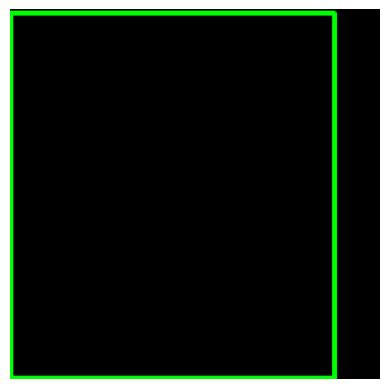

Frame 385, Label: 64, Score: 0.6420666575431824


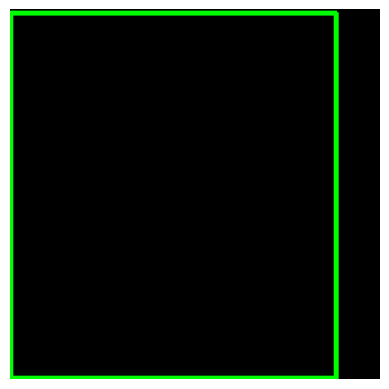

Frame 386, Label: 64, Score: 0.5767996311187744


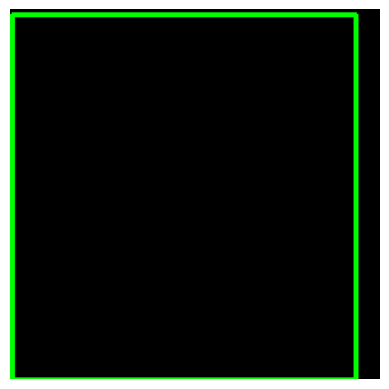

Frame 387, Label: 64, Score: 0.7845258712768555


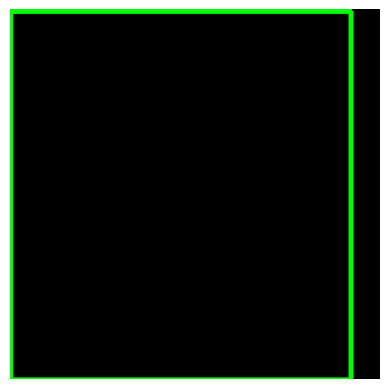

Frame 388, Label: 64, Score: 0.5852656960487366


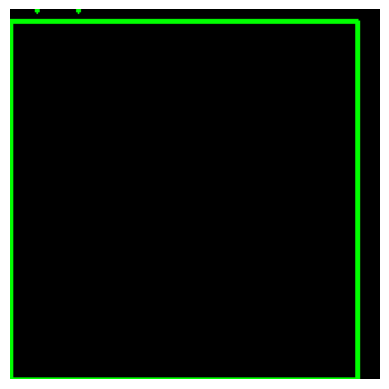

Frame 389, Label: 64, Score: 0.5797020792961121


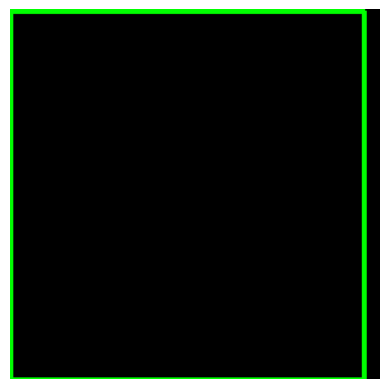

Frame 390, Label: 64, Score: 0.597520112991333


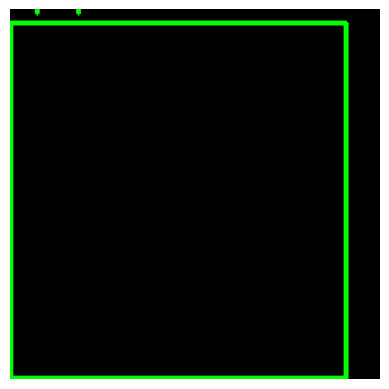

Frame 391, Label: 64, Score: 0.7110413908958435


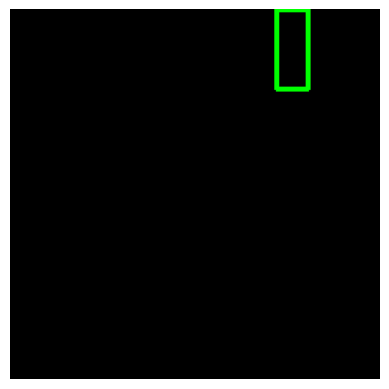

Frame 392, Label: 1, Score: 0.5865612030029297


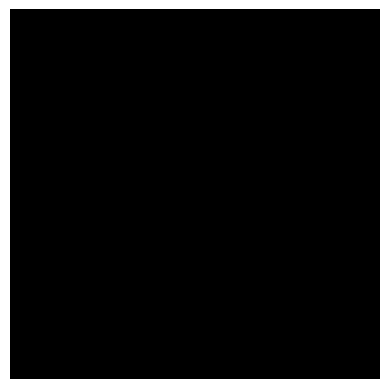

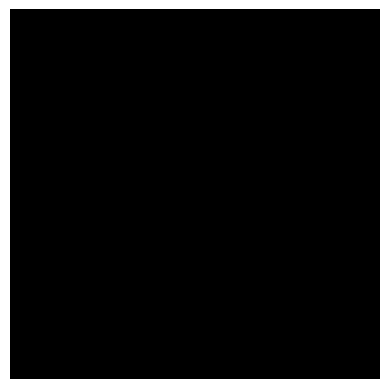

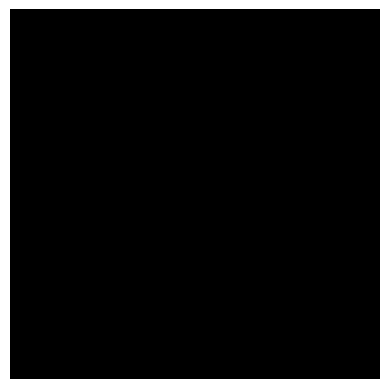

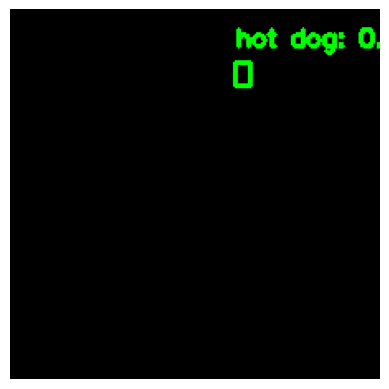

Frame 396, Label: 53, Score: 0.5946958661079407


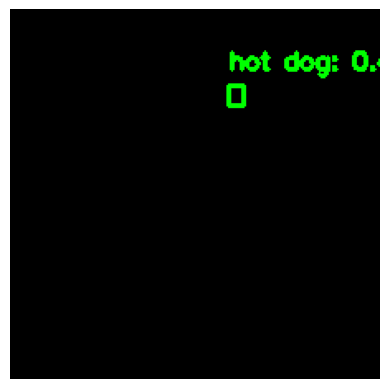

Frame 397, Label: 53, Score: 0.48334747552871704


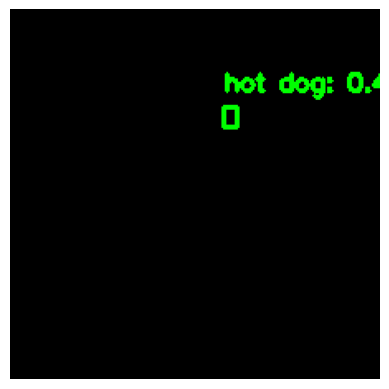

Frame 398, Label: 53, Score: 0.452205091714859


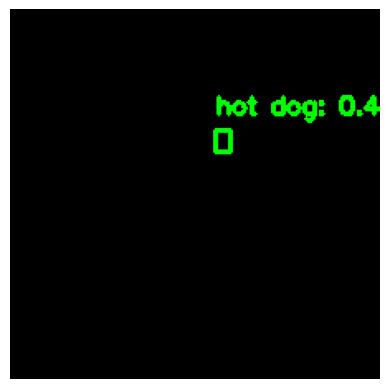

Frame 399, Label: 53, Score: 0.4878419041633606


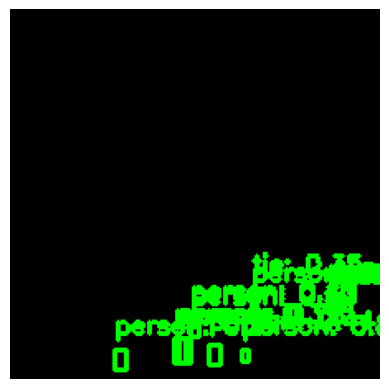

Frame 400, Label: 1, Score: 0.8682519793510437
Frame 400, Label: 1, Score: 0.7769672274589539
Frame 400, Label: 1, Score: 0.5944952368736267
Frame 400, Label: 1, Score: 0.5701056122779846
Frame 400, Label: 1, Score: 0.5631303191184998
Frame 400, Label: 1, Score: 0.5473129153251648
Frame 400, Label: 1, Score: 0.44232314825057983
Frame 400, Label: 1, Score: 0.39809662103652954
Frame 400, Label: 1, Score: 0.3873679041862488
Frame 400, Label: 1, Score: 0.36886271834373474
Frame 400, Label: 28, Score: 0.35414788126945496
Frame 400, Label: 1, Score: 0.3269672989845276
Frame 400, Label: 1, Score: 0.31113162636756897


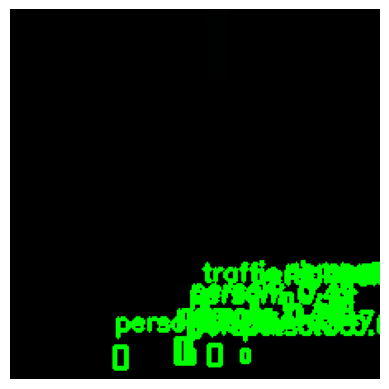

Frame 401, Label: 1, Score: 0.945321261882782
Frame 401, Label: 1, Score: 0.7879862189292908
Frame 401, Label: 1, Score: 0.6828457713127136
Frame 401, Label: 1, Score: 0.552898645401001
Frame 401, Label: 1, Score: 0.4969823360443115
Frame 401, Label: 10, Score: 0.4752996563911438
Frame 401, Label: 1, Score: 0.47067004442214966
Frame 401, Label: 1, Score: 0.46479153633117676
Frame 401, Label: 1, Score: 0.4185866117477417
Frame 401, Label: 1, Score: 0.4035281836986542
Frame 401, Label: 1, Score: 0.377144455909729
Frame 401, Label: 1, Score: 0.3431057035923004
Frame 401, Label: 1, Score: 0.3260481357574463
Frame 401, Label: 1, Score: 0.30359938740730286


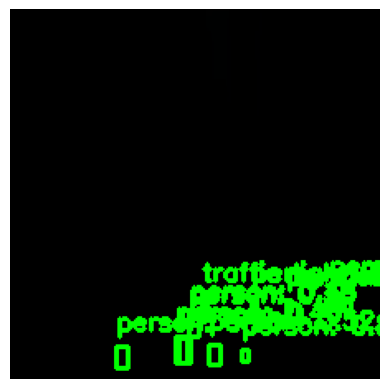

Frame 402, Label: 1, Score: 0.9755275249481201
Frame 402, Label: 1, Score: 0.8326923251152039
Frame 402, Label: 1, Score: 0.7678251266479492
Frame 402, Label: 1, Score: 0.6480206251144409
Frame 402, Label: 1, Score: 0.5403769016265869
Frame 402, Label: 1, Score: 0.5369040369987488
Frame 402, Label: 1, Score: 0.5163306593894958
Frame 402, Label: 10, Score: 0.5067049264907837
Frame 402, Label: 1, Score: 0.47765591740608215
Frame 402, Label: 1, Score: 0.4043382406234741
Frame 402, Label: 1, Score: 0.3839211165904999
Frame 402, Label: 1, Score: 0.34092992544174194
Frame 402, Label: 1, Score: 0.30062931776046753


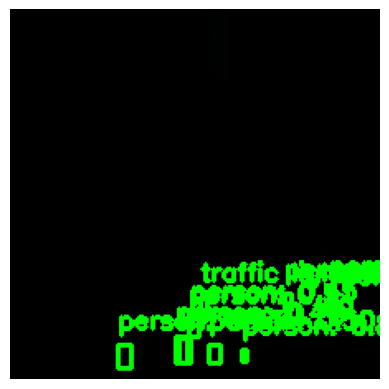

Frame 403, Label: 1, Score: 0.9324943423271179
Frame 403, Label: 1, Score: 0.8849523663520813
Frame 403, Label: 1, Score: 0.756046712398529
Frame 403, Label: 1, Score: 0.571208655834198
Frame 403, Label: 1, Score: 0.5179429054260254
Frame 403, Label: 1, Score: 0.5115808844566345
Frame 403, Label: 1, Score: 0.4974178969860077
Frame 403, Label: 1, Score: 0.43881797790527344
Frame 403, Label: 1, Score: 0.4332882761955261
Frame 403, Label: 10, Score: 0.37762510776519775
Frame 403, Label: 1, Score: 0.35290390253067017
Frame 403, Label: 1, Score: 0.3039449155330658


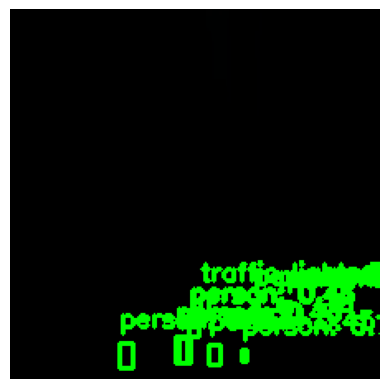

Frame 404, Label: 1, Score: 0.9872559309005737
Frame 404, Label: 1, Score: 0.7688345313072205
Frame 404, Label: 1, Score: 0.7547417879104614
Frame 404, Label: 1, Score: 0.45846033096313477
Frame 404, Label: 1, Score: 0.4535558521747589
Frame 404, Label: 1, Score: 0.43228477239608765
Frame 404, Label: 1, Score: 0.40999749302864075
Frame 404, Label: 1, Score: 0.4095498323440552
Frame 404, Label: 1, Score: 0.40018007159233093
Frame 404, Label: 1, Score: 0.38272637128829956
Frame 404, Label: 1, Score: 0.3526354730129242
Frame 404, Label: 1, Score: 0.3432302474975586
Frame 404, Label: 10, Score: 0.3139705955982208


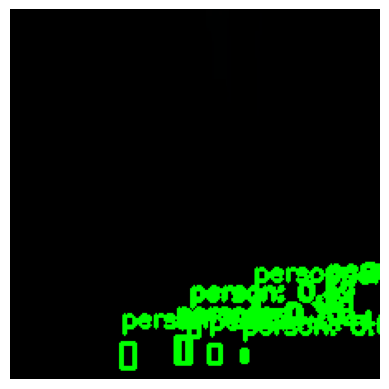

Frame 405, Label: 1, Score: 0.8469660878181458
Frame 405, Label: 1, Score: 0.7322655320167542
Frame 405, Label: 1, Score: 0.6489876508712769
Frame 405, Label: 1, Score: 0.5708156228065491
Frame 405, Label: 1, Score: 0.4929559528827667
Frame 405, Label: 1, Score: 0.43652239441871643
Frame 405, Label: 1, Score: 0.3705711364746094
Frame 405, Label: 1, Score: 0.353251576423645
Frame 405, Label: 1, Score: 0.3479447364807129
Frame 405, Label: 1, Score: 0.3037431240081787


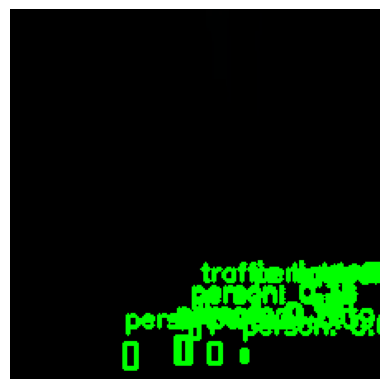

Frame 406, Label: 1, Score: 0.7474101185798645
Frame 406, Label: 1, Score: 0.6318947076797485
Frame 406, Label: 1, Score: 0.6176161766052246
Frame 406, Label: 1, Score: 0.4561246335506439
Frame 406, Label: 1, Score: 0.437247633934021
Frame 406, Label: 1, Score: 0.42221981287002563
Frame 406, Label: 1, Score: 0.39327964186668396
Frame 406, Label: 1, Score: 0.37864950299263
Frame 406, Label: 1, Score: 0.340939462184906
Frame 406, Label: 1, Score: 0.34030839800834656
Frame 406, Label: 10, Score: 0.33940622210502625
Frame 406, Label: 1, Score: 0.3382517099380493
Frame 406, Label: 1, Score: 0.3001156151294708


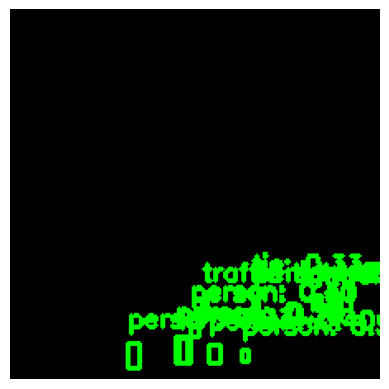

Frame 407, Label: 1, Score: 0.9258931875228882
Frame 407, Label: 1, Score: 0.7944220304489136
Frame 407, Label: 1, Score: 0.5620986819267273
Frame 407, Label: 1, Score: 0.5329114198684692
Frame 407, Label: 1, Score: 0.5028741359710693
Frame 407, Label: 1, Score: 0.4109466075897217
Frame 407, Label: 10, Score: 0.39689871668815613
Frame 407, Label: 1, Score: 0.3962874710559845
Frame 407, Label: 28, Score: 0.3300539553165436
Frame 407, Label: 1, Score: 0.3198275566101074
Frame 407, Label: 1, Score: 0.3165609538555145
Frame 407, Label: 1, Score: 0.30558842420578003
Frame 407, Label: 1, Score: 0.30038896203041077


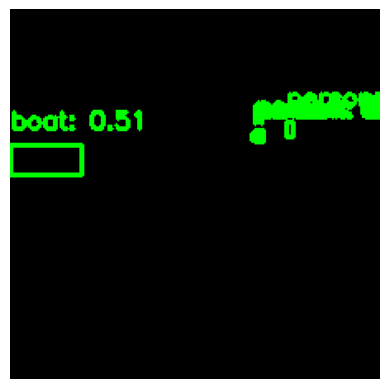

Frame 408, Label: 1, Score: 0.7674685120582581
Frame 408, Label: 1, Score: 0.6625311374664307
Frame 408, Label: 9, Score: 0.5102933049201965
Frame 408, Label: 1, Score: 0.4735398590564728
Frame 408, Label: 1, Score: 0.42991915345191956
Frame 408, Label: 1, Score: 0.34797677397727966
Frame 408, Label: 1, Score: 0.3380311131477356
Frame 408, Label: 1, Score: 0.31697508692741394


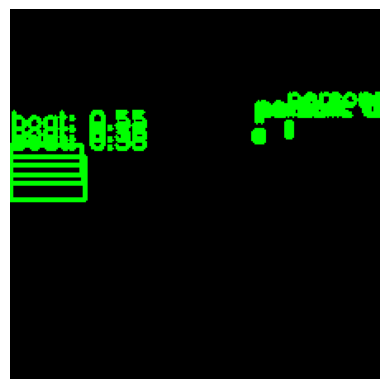

Frame 409, Label: 1, Score: 0.8065964579582214
Frame 409, Label: 1, Score: 0.6044663190841675
Frame 409, Label: 9, Score: 0.5478349924087524
Frame 409, Label: 9, Score: 0.38020122051239014
Frame 409, Label: 9, Score: 0.3619306981563568
Frame 409, Label: 1, Score: 0.3255499601364136
Frame 409, Label: 1, Score: 0.31355059146881104


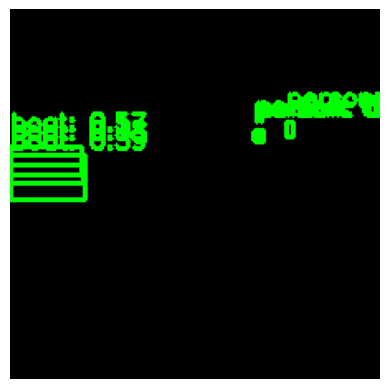

Frame 410, Label: 1, Score: 0.8008860945701599
Frame 410, Label: 1, Score: 0.6262905597686768
Frame 410, Label: 9, Score: 0.5743907690048218
Frame 410, Label: 9, Score: 0.3927673399448395
Frame 410, Label: 9, Score: 0.3832807242870331
Frame 410, Label: 1, Score: 0.3571333587169647
Frame 410, Label: 1, Score: 0.32284268736839294


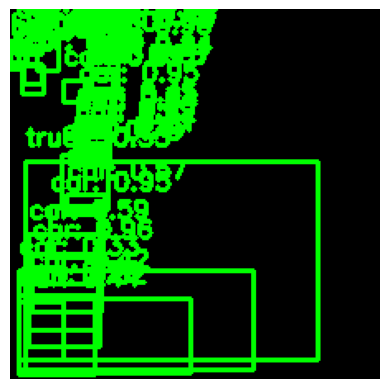

Frame 411, Label: 3, Score: 0.9555661082267761
Frame 411, Label: 3, Score: 0.9525154232978821
Frame 411, Label: 3, Score: 0.952186107635498
Frame 411, Label: 3, Score: 0.9519137144088745
Frame 411, Label: 3, Score: 0.9346868395805359
Frame 411, Label: 3, Score: 0.8989064693450928
Frame 411, Label: 3, Score: 0.8219612836837769
Frame 411, Label: 3, Score: 0.8144579529762268
Frame 411, Label: 3, Score: 0.7917211651802063
Frame 411, Label: 3, Score: 0.7884149551391602
Frame 411, Label: 3, Score: 0.7761011719703674
Frame 411, Label: 3, Score: 0.7691117525100708
Frame 411, Label: 3, Score: 0.7565601468086243
Frame 411, Label: 3, Score: 0.7463788390159607
Frame 411, Label: 3, Score: 0.7430156469345093
Frame 411, Label: 3, Score: 0.7380727529525757
Frame 411, Label: 3, Score: 0.7185366153717041
Frame 411, Label: 3, Score: 0.6892716884613037
Frame 411, Label: 3, Score: 0.6712474822998047
Frame 411, Label: 3, Score: 0.6624282598495483
Frame 411, Label: 3, Score: 0.6396603584289551
Frame 411, Lab

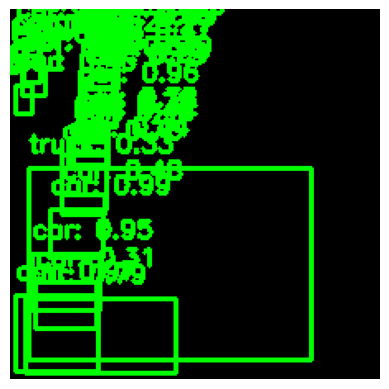

Frame 412, Label: 3, Score: 0.9877997636795044
Frame 412, Label: 3, Score: 0.9744827747344971
Frame 412, Label: 3, Score: 0.9619694352149963
Frame 412, Label: 3, Score: 0.9522791504859924
Frame 412, Label: 3, Score: 0.9041088223457336
Frame 412, Label: 3, Score: 0.8051806688308716
Frame 412, Label: 3, Score: 0.7928503751754761
Frame 412, Label: 3, Score: 0.7908601760864258
Frame 412, Label: 3, Score: 0.7889430522918701
Frame 412, Label: 3, Score: 0.7709978222846985
Frame 412, Label: 3, Score: 0.7613636255264282
Frame 412, Label: 3, Score: 0.7568445801734924
Frame 412, Label: 3, Score: 0.7504663467407227
Frame 412, Label: 3, Score: 0.7459328770637512
Frame 412, Label: 3, Score: 0.7198427319526672
Frame 412, Label: 3, Score: 0.6726840734481812
Frame 412, Label: 3, Score: 0.6451345086097717
Frame 412, Label: 3, Score: 0.6384152770042419
Frame 412, Label: 3, Score: 0.6196082830429077
Frame 412, Label: 3, Score: 0.5959886312484741
Frame 412, Label: 3, Score: 0.5792863368988037
Frame 412, La

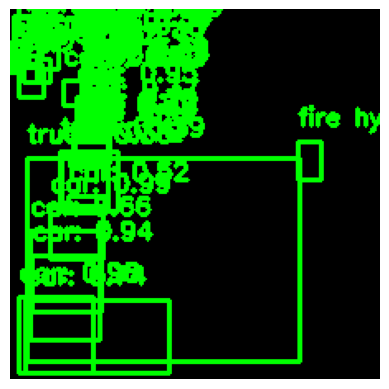

Frame 413, Label: 3, Score: 0.9882518649101257
Frame 413, Label: 3, Score: 0.9798765182495117
Frame 413, Label: 3, Score: 0.9463953375816345
Frame 413, Label: 3, Score: 0.9431982636451721
Frame 413, Label: 3, Score: 0.9178950786590576
Frame 413, Label: 3, Score: 0.8173234462738037
Frame 413, Label: 3, Score: 0.8165847063064575
Frame 413, Label: 3, Score: 0.8064733147621155
Frame 413, Label: 3, Score: 0.788497269153595
Frame 413, Label: 3, Score: 0.7836159467697144
Frame 413, Label: 3, Score: 0.7747470140457153
Frame 413, Label: 3, Score: 0.7676934003829956
Frame 413, Label: 3, Score: 0.744930624961853
Frame 413, Label: 3, Score: 0.7185516953468323
Frame 413, Label: 3, Score: 0.7042136192321777
Frame 413, Label: 3, Score: 0.703089714050293
Frame 413, Label: 3, Score: 0.6920445561408997
Frame 413, Label: 3, Score: 0.6602789163589478
Frame 413, Label: 3, Score: 0.6561400294303894
Frame 413, Label: 3, Score: 0.6321013569831848
Frame 413, Label: 3, Score: 0.6054493188858032
Frame 413, Label

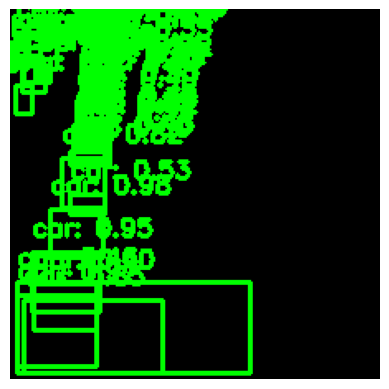

Frame 414, Label: 3, Score: 0.9831389784812927
Frame 414, Label: 3, Score: 0.9700798392295837
Frame 414, Label: 3, Score: 0.949027955532074
Frame 414, Label: 3, Score: 0.9460623264312744
Frame 414, Label: 3, Score: 0.9385731220245361
Frame 414, Label: 3, Score: 0.8825219869613647
Frame 414, Label: 3, Score: 0.861370325088501
Frame 414, Label: 3, Score: 0.8543563485145569
Frame 414, Label: 3, Score: 0.8526564240455627
Frame 414, Label: 3, Score: 0.823554515838623
Frame 414, Label: 3, Score: 0.8213852643966675
Frame 414, Label: 3, Score: 0.7917368412017822
Frame 414, Label: 3, Score: 0.7854381799697876
Frame 414, Label: 3, Score: 0.7842827439308167
Frame 414, Label: 3, Score: 0.7535505890846252
Frame 414, Label: 3, Score: 0.7467468976974487
Frame 414, Label: 3, Score: 0.7337270975112915
Frame 414, Label: 3, Score: 0.7142326235771179
Frame 414, Label: 3, Score: 0.6645848155021667
Frame 414, Label: 3, Score: 0.6232345700263977
Frame 414, Label: 3, Score: 0.6216049194335938
Frame 414, Label

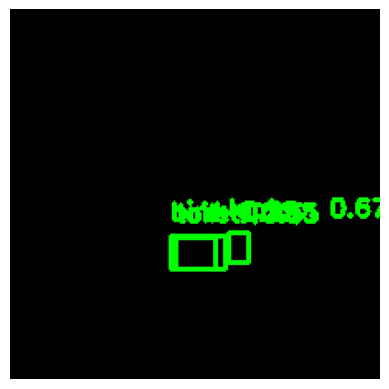

Frame 415, Label: 64, Score: 0.67043137550354
Frame 415, Label: 15, Score: 0.5894757509231567
Frame 415, Label: 62, Score: 0.35201168060302734


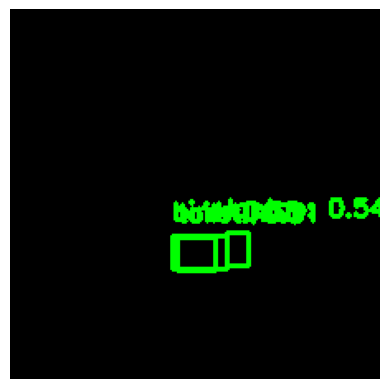

Frame 416, Label: 15, Score: 0.579046368598938
Frame 416, Label: 64, Score: 0.543746829032898
Frame 416, Label: 62, Score: 0.30864301323890686


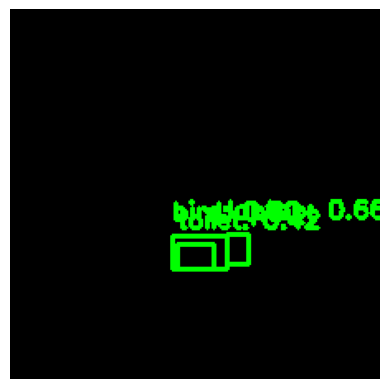

Frame 417, Label: 64, Score: 0.6644942760467529
Frame 417, Label: 15, Score: 0.49949613213539124
Frame 417, Label: 62, Score: 0.4236617982387543


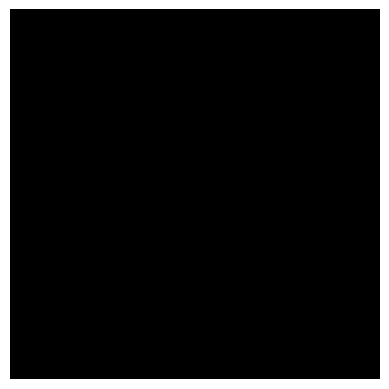

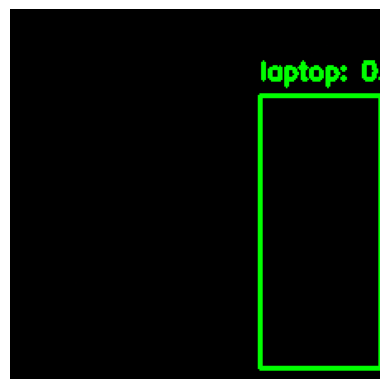

Frame 419, Label: 64, Score: 0.3095535337924957


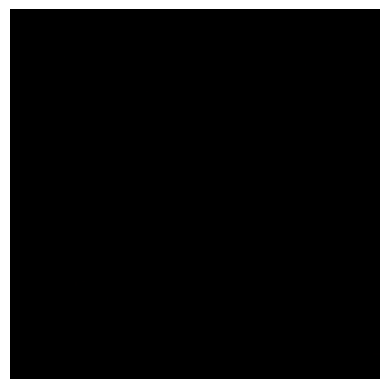

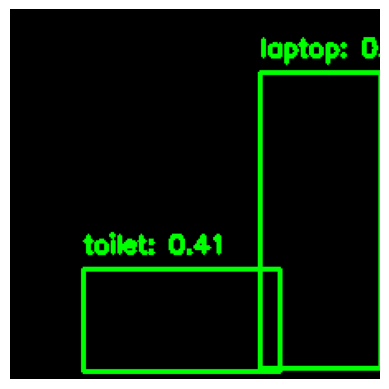

Frame 421, Label: 64, Score: 0.4724864661693573
Frame 421, Label: 62, Score: 0.40838301181793213


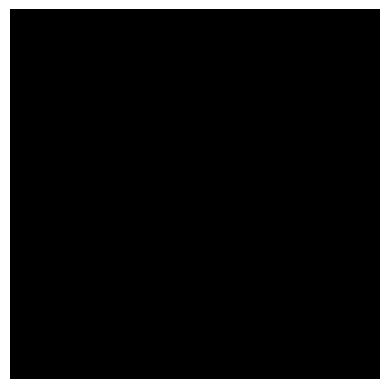

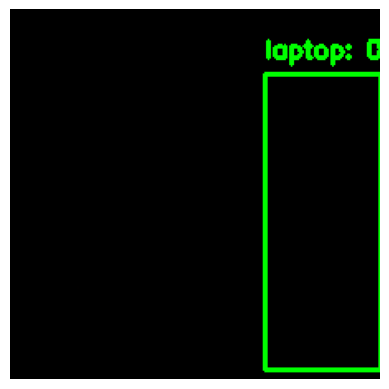

Frame 423, Label: 64, Score: 0.4875778257846832


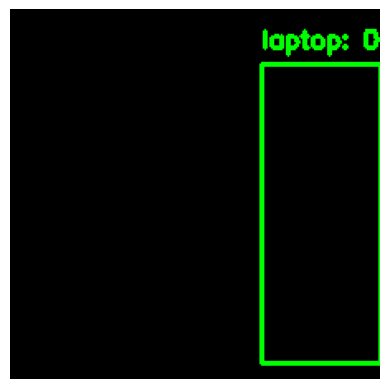

Frame 424, Label: 64, Score: 0.45183074474334717


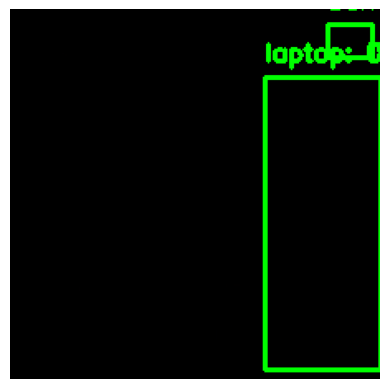

Frame 425, Label: 47, Score: 0.6711410284042358
Frame 425, Label: 64, Score: 0.44286391139030457


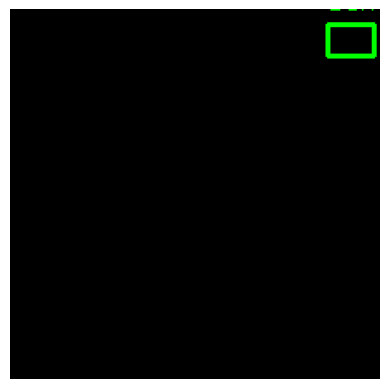

Frame 426, Label: 47, Score: 0.5682752728462219


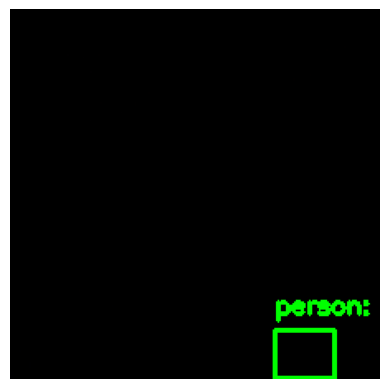

Frame 427, Label: 1, Score: 0.4987838566303253


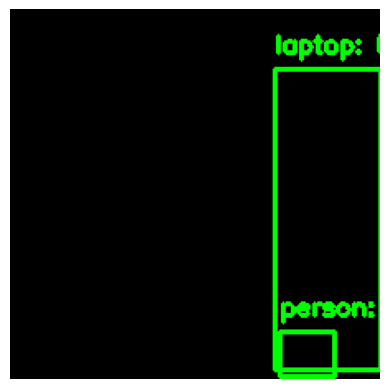

Frame 428, Label: 1, Score: 0.6124614477157593
Frame 428, Label: 64, Score: 0.5614711046218872


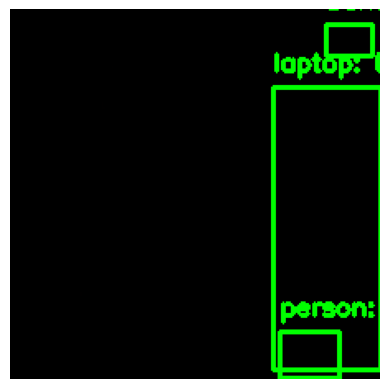

Frame 429, Label: 47, Score: 0.4212758243083954
Frame 429, Label: 1, Score: 0.41098272800445557
Frame 429, Label: 64, Score: 0.3349240720272064


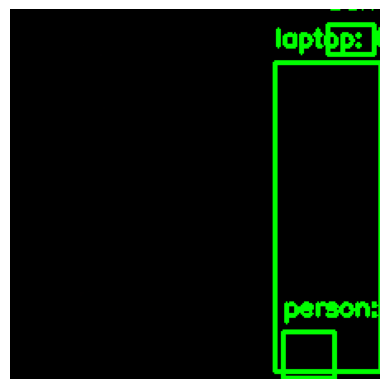

Frame 430, Label: 64, Score: 0.6191566586494446
Frame 430, Label: 1, Score: 0.5075864195823669
Frame 430, Label: 47, Score: 0.32357165217399597


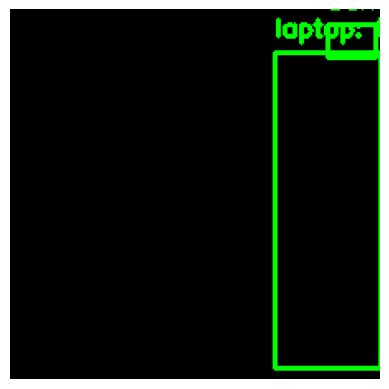

Frame 431, Label: 64, Score: 0.504418671131134
Frame 431, Label: 47, Score: 0.41339510679244995


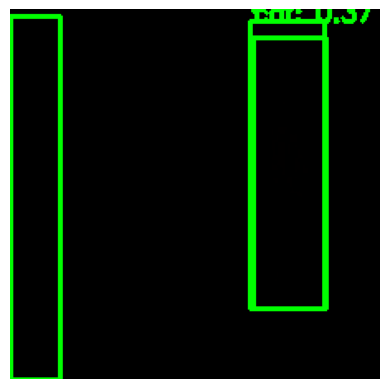

Frame 432, Label: 1, Score: 0.6826580762863159
Frame 432, Label: 16, Score: 0.36708077788352966
Frame 432, Label: 1, Score: 0.3552057445049286


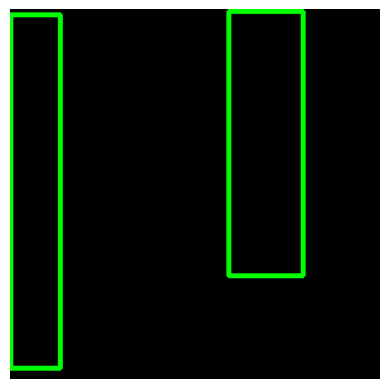

Frame 433, Label: 1, Score: 0.8571648597717285
Frame 433, Label: 1, Score: 0.6907749772071838


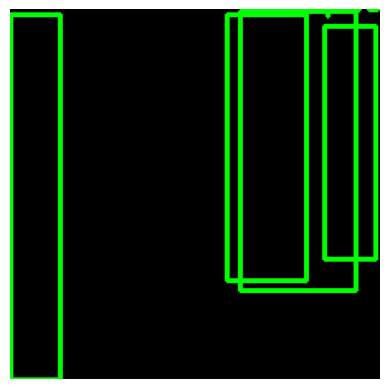

Frame 434, Label: 1, Score: 0.9639223217964172
Frame 434, Label: 1, Score: 0.8774576187133789
Frame 434, Label: 1, Score: 0.7667545080184937
Frame 434, Label: 1, Score: 0.4176677465438843


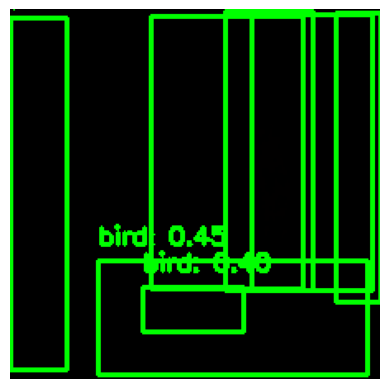

Frame 435, Label: 1, Score: 0.9244580268859863
Frame 435, Label: 1, Score: 0.903558075428009
Frame 435, Label: 1, Score: 0.8592021465301514
Frame 435, Label: 1, Score: 0.46789705753326416
Frame 435, Label: 1, Score: 0.46100249886512756
Frame 435, Label: 15, Score: 0.45086365938186646
Frame 435, Label: 15, Score: 0.39629775285720825


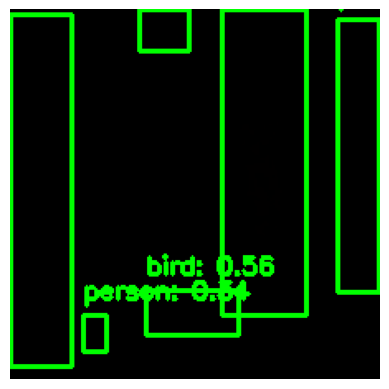

Frame 436, Label: 1, Score: 0.9756677746772766
Frame 436, Label: 1, Score: 0.865875244140625
Frame 436, Label: 1, Score: 0.8374735116958618
Frame 436, Label: 1, Score: 0.7340623140335083
Frame 436, Label: 15, Score: 0.5611805319786072
Frame 436, Label: 1, Score: 0.3366905152797699


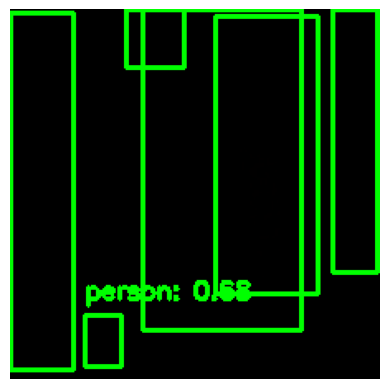

Frame 437, Label: 1, Score: 0.8378302454948425
Frame 437, Label: 1, Score: 0.681955873966217
Frame 437, Label: 1, Score: 0.5806821584701538
Frame 437, Label: 1, Score: 0.5204375982284546
Frame 437, Label: 1, Score: 0.3902035355567932
Frame 437, Label: 1, Score: 0.3561662435531616


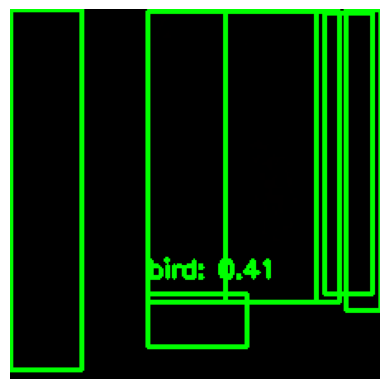

Frame 438, Label: 1, Score: 0.8877679109573364
Frame 438, Label: 1, Score: 0.8593332171440125
Frame 438, Label: 1, Score: 0.5247053503990173
Frame 438, Label: 1, Score: 0.4746648967266083
Frame 438, Label: 15, Score: 0.4118078649044037
Frame 438, Label: 1, Score: 0.3715663552284241


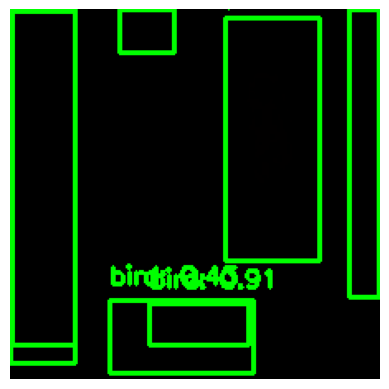

Frame 439, Label: 15, Score: 0.9054734706878662
Frame 439, Label: 1, Score: 0.8818479776382446
Frame 439, Label: 1, Score: 0.554657518863678
Frame 439, Label: 15, Score: 0.4252607524394989
Frame 439, Label: 28, Score: 0.3666858673095703
Frame 439, Label: 1, Score: 0.34345659613609314
Frame 439, Label: 1, Score: 0.3361356258392334


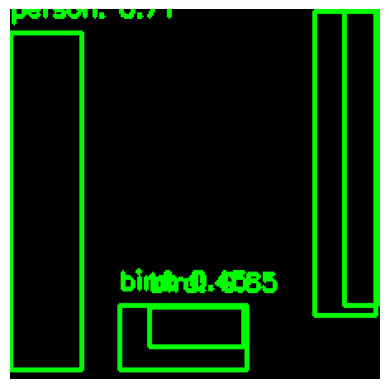

Frame 440, Label: 15, Score: 0.8496353626251221
Frame 440, Label: 1, Score: 0.7087163329124451
Frame 440, Label: 1, Score: 0.6568753123283386
Frame 440, Label: 15, Score: 0.44710907340049744
Frame 440, Label: 1, Score: 0.32111769914627075


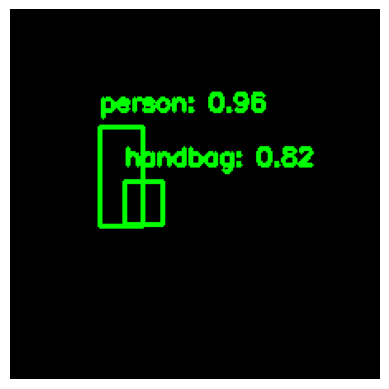

Frame 441, Label: 1, Score: 0.9597334861755371
Frame 441, Label: 27, Score: 0.8190382122993469


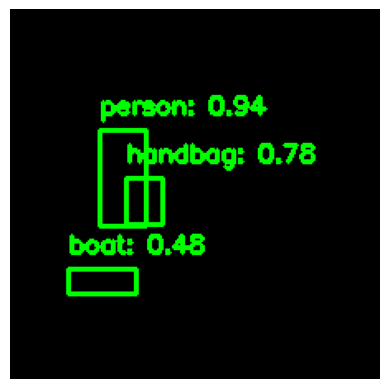

Frame 442, Label: 1, Score: 0.9433650970458984
Frame 442, Label: 27, Score: 0.7847438454627991
Frame 442, Label: 9, Score: 0.47832566499710083


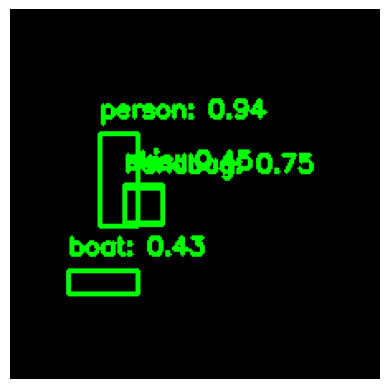

Frame 443, Label: 1, Score: 0.9399741888046265
Frame 443, Label: 27, Score: 0.7461510300636292
Frame 443, Label: 31, Score: 0.4524800479412079
Frame 443, Label: 9, Score: 0.43243980407714844


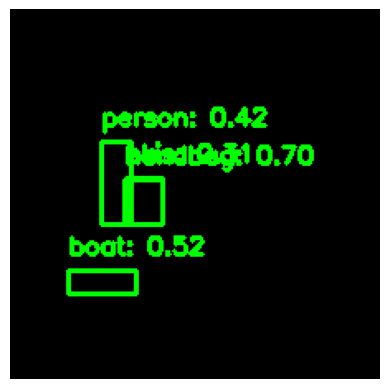

Frame 444, Label: 27, Score: 0.7018756866455078
Frame 444, Label: 9, Score: 0.5194283127784729
Frame 444, Label: 1, Score: 0.42016902565956116
Frame 444, Label: 31, Score: 0.30644935369491577


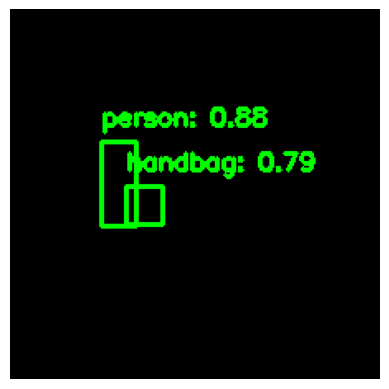

Frame 445, Label: 1, Score: 0.8799880743026733
Frame 445, Label: 27, Score: 0.7939478158950806


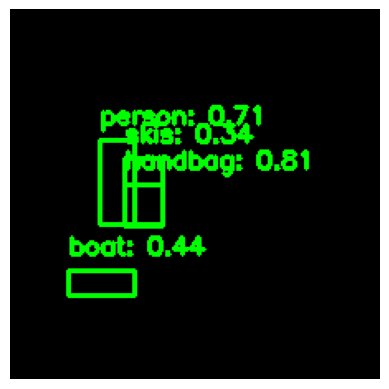

Frame 446, Label: 27, Score: 0.8051229119300842
Frame 446, Label: 1, Score: 0.7068938612937927
Frame 446, Label: 9, Score: 0.44067710638046265
Frame 446, Label: 31, Score: 0.3359517753124237


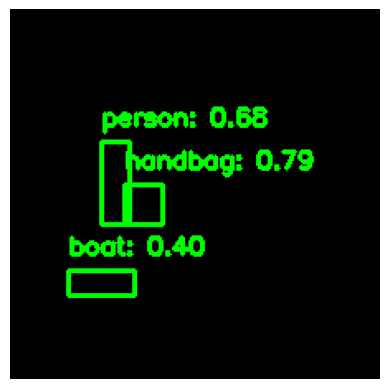

Frame 447, Label: 27, Score: 0.785655677318573
Frame 447, Label: 1, Score: 0.6806620955467224
Frame 447, Label: 9, Score: 0.40249714255332947


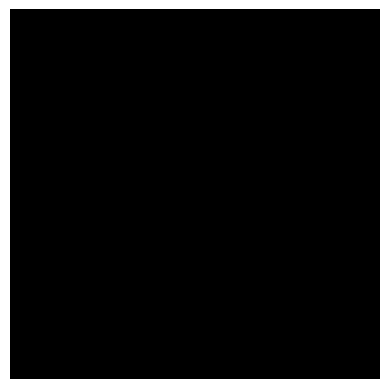

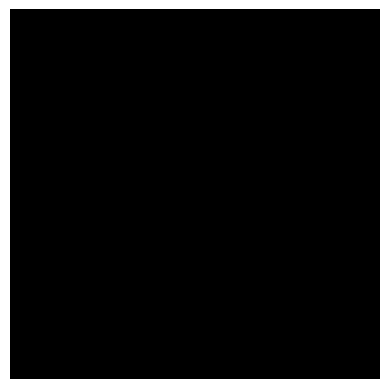

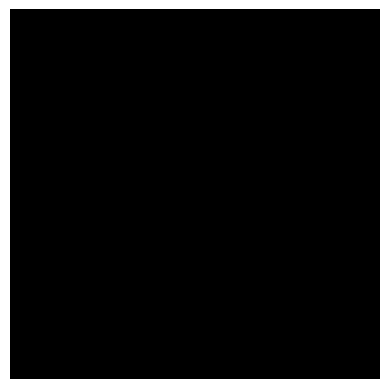

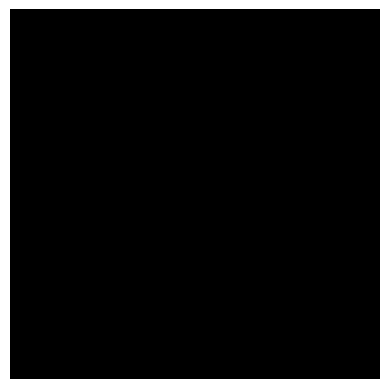

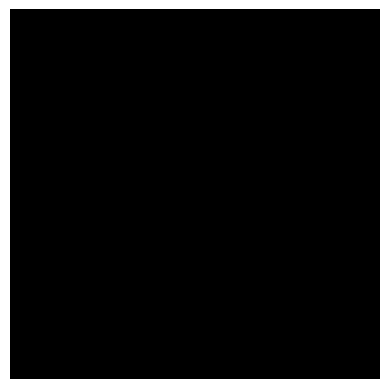

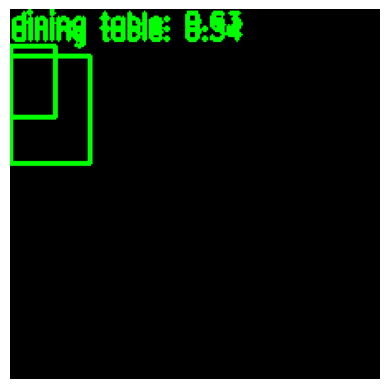

Frame 453, Label: 61, Score: 0.6349155902862549
Frame 453, Label: 61, Score: 0.3364138603210449


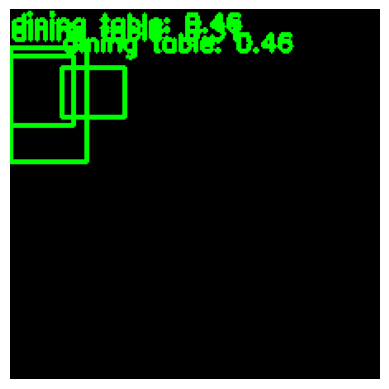

Frame 454, Label: 61, Score: 0.45558348298072815
Frame 454, Label: 61, Score: 0.455523282289505
Frame 454, Label: 61, Score: 0.31243568658828735


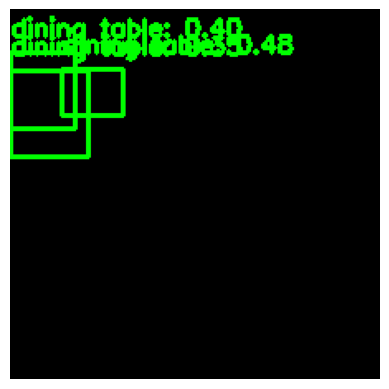

Frame 455, Label: 61, Score: 0.4826248288154602
Frame 455, Label: 61, Score: 0.4037611782550812
Frame 455, Label: 61, Score: 0.352297842502594


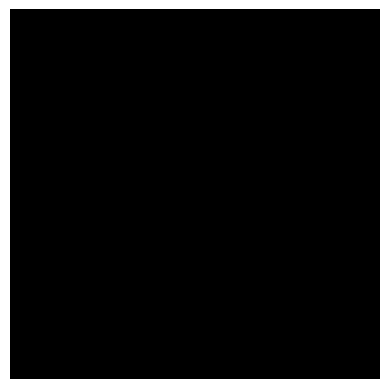

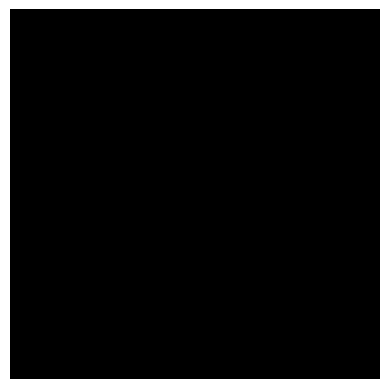

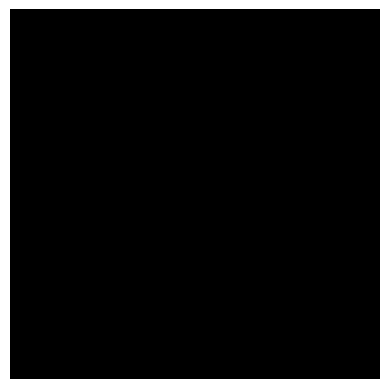

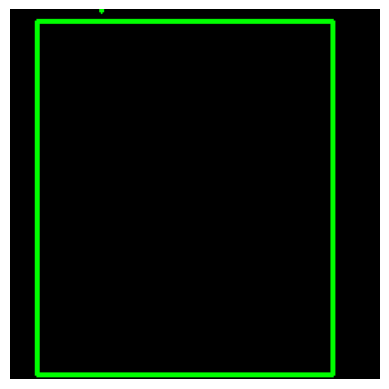

Frame 459, Label: 25, Score: 0.6002320051193237


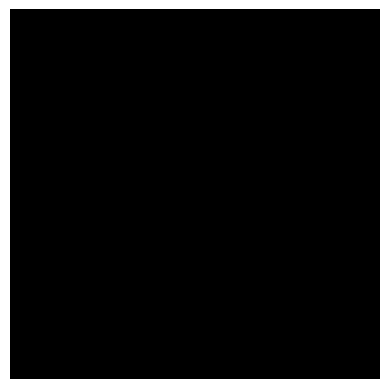

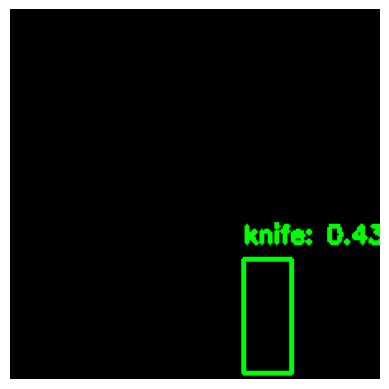

Frame 461, Label: 44, Score: 0.431007981300354


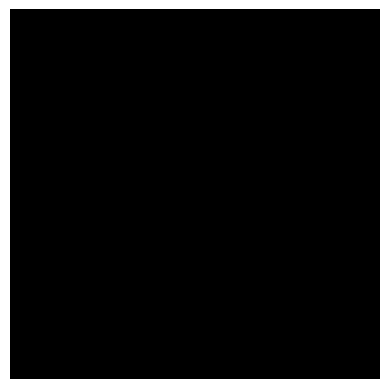

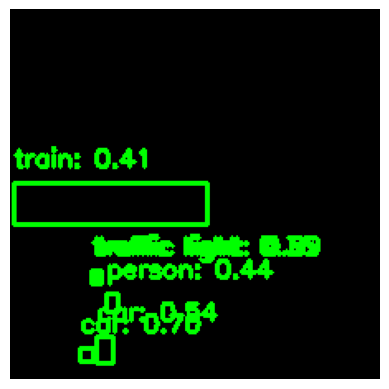

Frame 463, Label: 10, Score: 0.8853490352630615
Frame 463, Label: 3, Score: 0.6953892707824707
Frame 463, Label: 3, Score: 0.5359922647476196
Frame 463, Label: 1, Score: 0.44132041931152344
Frame 463, Label: 7, Score: 0.4141114354133606
Frame 463, Label: 10, Score: 0.3585359752178192


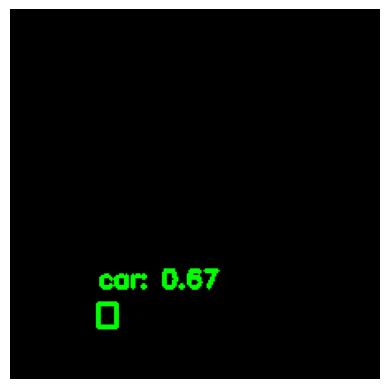

Frame 464, Label: 3, Score: 0.6748138070106506


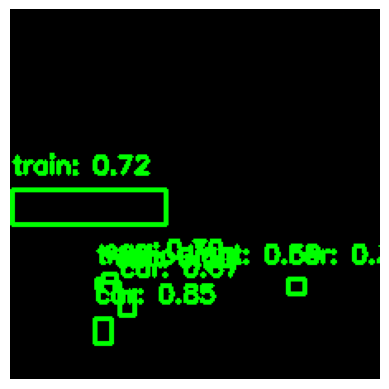

Frame 465, Label: 3, Score: 0.8474900126457214
Frame 465, Label: 7, Score: 0.7198750376701355
Frame 465, Label: 3, Score: 0.7039117813110352
Frame 465, Label: 3, Score: 0.6734808087348938
Frame 465, Label: 10, Score: 0.5891782641410828
Frame 465, Label: 3, Score: 0.5048528909683228
Frame 465, Label: 3, Score: 0.36901551485061646


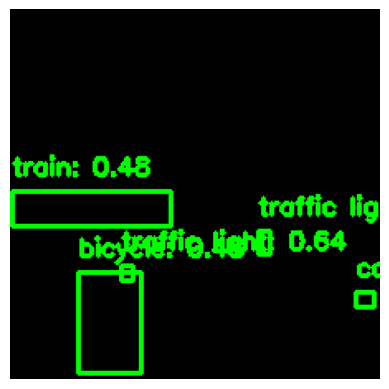

Frame 466, Label: 3, Score: 0.9874988198280334
Frame 466, Label: 10, Score: 0.8477166295051575
Frame 466, Label: 10, Score: 0.6430584192276001
Frame 466, Label: 7, Score: 0.48450660705566406
Frame 466, Label: 2, Score: 0.4831324815750122


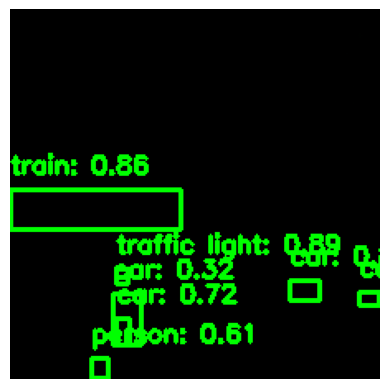

Frame 467, Label: 3, Score: 0.9289268255233765
Frame 467, Label: 10, Score: 0.8949342370033264
Frame 467, Label: 7, Score: 0.8618000149726868
Frame 467, Label: 3, Score: 0.856117844581604
Frame 467, Label: 3, Score: 0.722995936870575
Frame 467, Label: 1, Score: 0.6140406131744385
Frame 467, Label: 3, Score: 0.32005059719085693


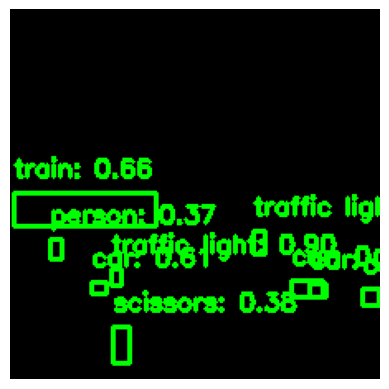

Frame 468, Label: 3, Score: 0.9531508088111877
Frame 468, Label: 10, Score: 0.899928629398346
Frame 468, Label: 7, Score: 0.6589739322662354
Frame 468, Label: 3, Score: 0.6135522127151489
Frame 468, Label: 3, Score: 0.47919169068336487
Frame 468, Label: 3, Score: 0.44443461298942566
Frame 468, Label: 77, Score: 0.3813602030277252
Frame 468, Label: 1, Score: 0.3681521415710449
Frame 468, Label: 10, Score: 0.33901283144950867


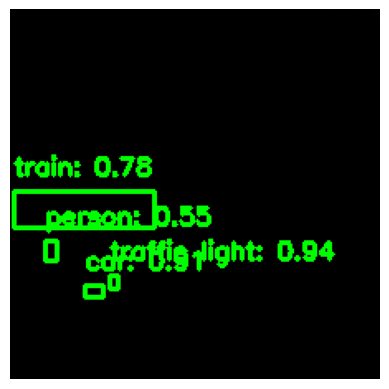

Frame 469, Label: 10, Score: 0.9440608024597168
Frame 469, Label: 3, Score: 0.906335175037384
Frame 469, Label: 7, Score: 0.7816321849822998
Frame 469, Label: 1, Score: 0.548963189125061


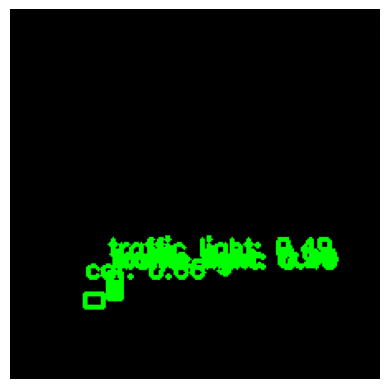

Frame 470, Label: 10, Score: 0.9427649974822998
Frame 470, Label: 3, Score: 0.6592386364936829
Frame 470, Label: 10, Score: 0.48595088720321655
Frame 470, Label: 10, Score: 0.39913129806518555


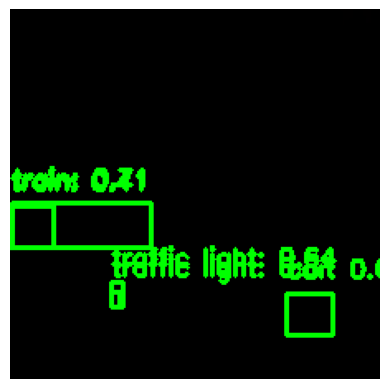

Frame 471, Label: 10, Score: 0.8071352243423462
Frame 471, Label: 7, Score: 0.7059133052825928
Frame 471, Label: 10, Score: 0.6417121887207031
Frame 471, Label: 3, Score: 0.6118810772895813
Frame 471, Label: 7, Score: 0.40914344787597656


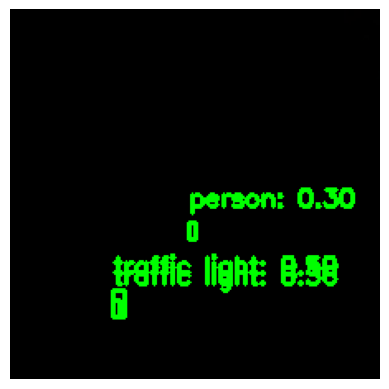

Frame 472, Label: 10, Score: 0.4973626434803009
Frame 472, Label: 10, Score: 0.3557380437850952
Frame 472, Label: 1, Score: 0.30461961030960083


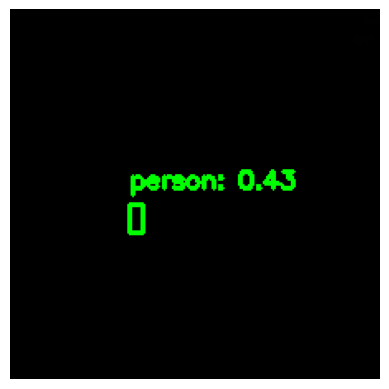

Frame 473, Label: 1, Score: 0.4279165267944336


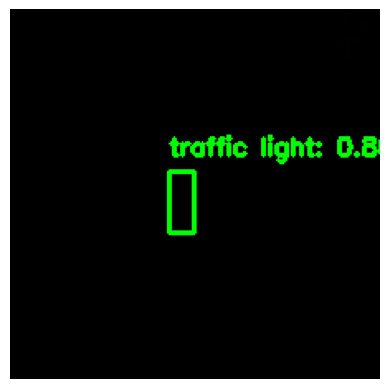

Frame 474, Label: 10, Score: 0.795925498008728


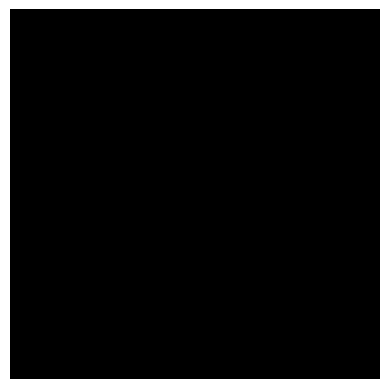

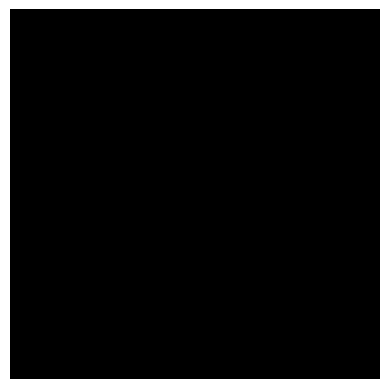

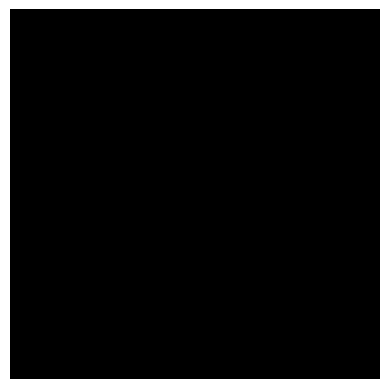

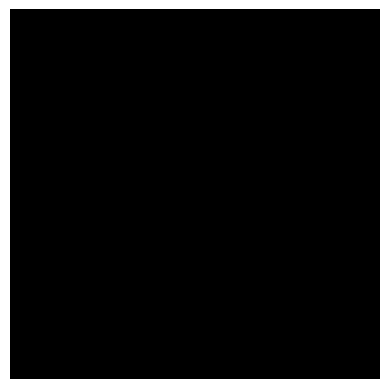

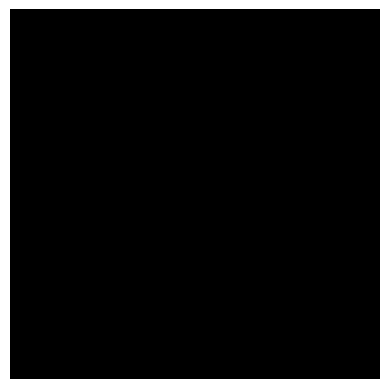

...

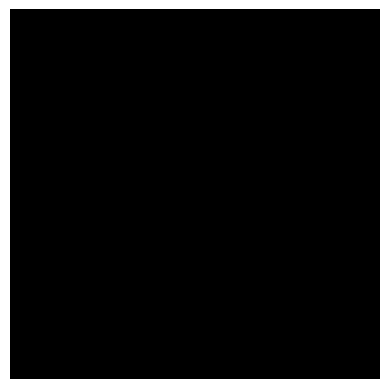

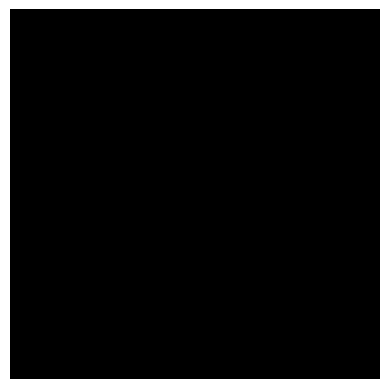

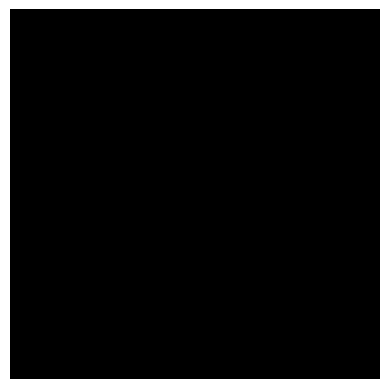

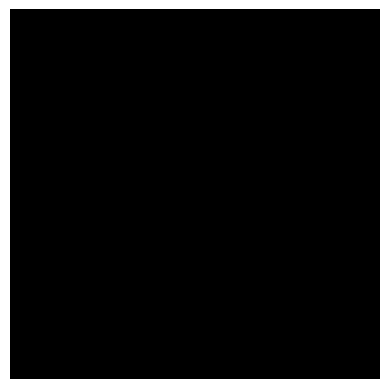

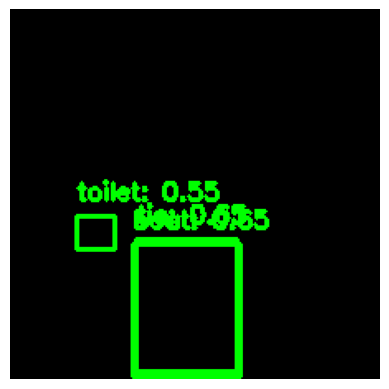

Frame 498, Label: 28, Score: 0.6532981395721436
Frame 498, Label: 9, Score: 0.6495143175125122
Frame 498, Label: 62, Score: 0.5508673191070557


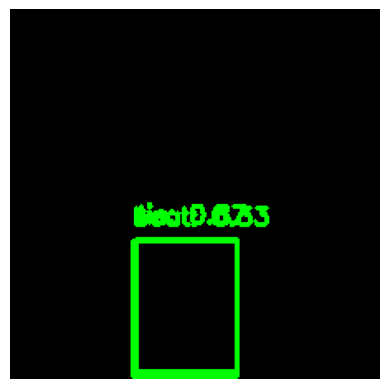

Frame 499, Label: 28, Score: 0.8705633878707886
Frame 499, Label: 9, Score: 0.3321126699447632


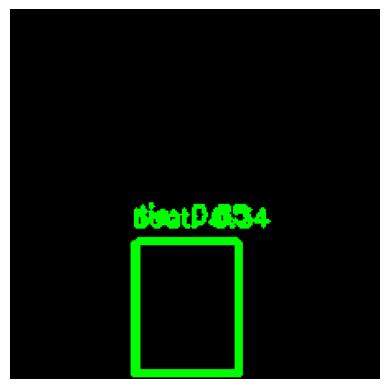

Frame 500, Label: 28, Score: 0.8522568345069885
Frame 500, Label: 9, Score: 0.33747097849845886


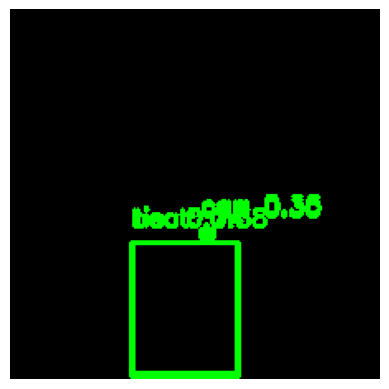

Frame 501, Label: 28, Score: 0.7443907856941223
Frame 501, Label: 9, Score: 0.37602031230926514
Frame 501, Label: 3, Score: 0.35825076699256897
Frame 501, Label: 3, Score: 0.30377277731895447


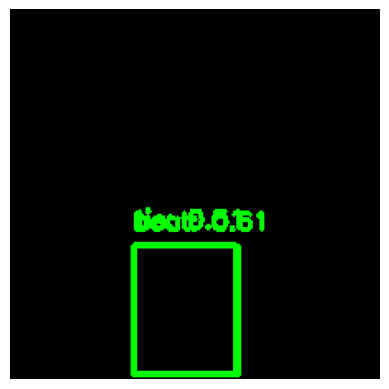

Frame 502, Label: 9, Score: 0.6061461567878723
Frame 502, Label: 28, Score: 0.5148939490318298


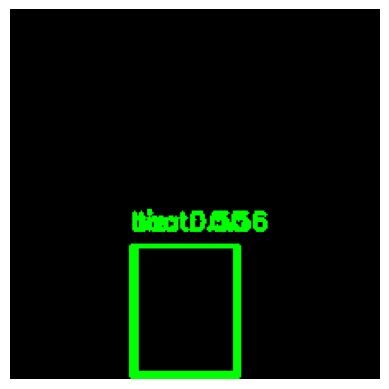

Frame 503, Label: 9, Score: 0.5620284080505371
Frame 503, Label: 28, Score: 0.5020212531089783


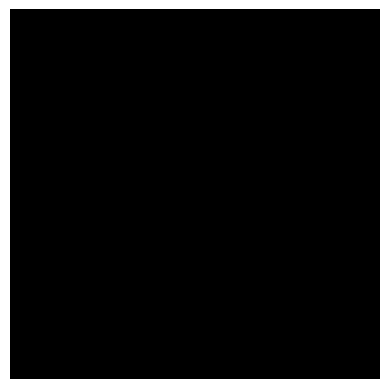

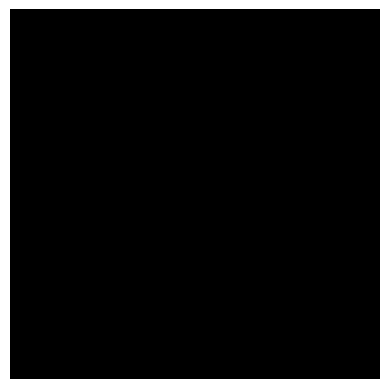

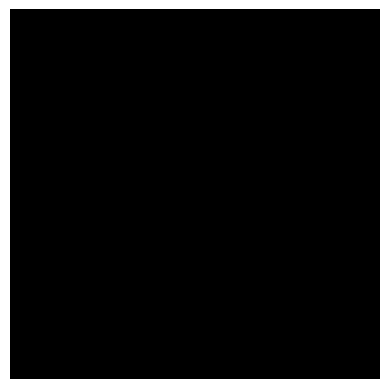

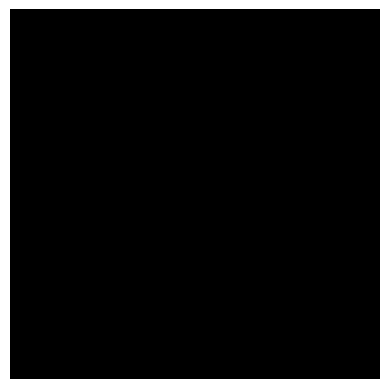

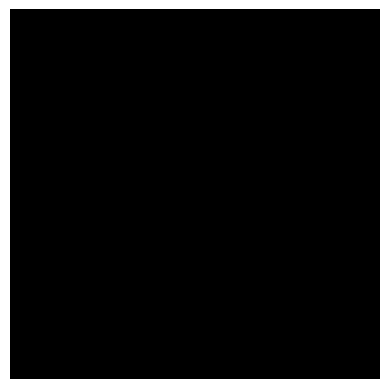

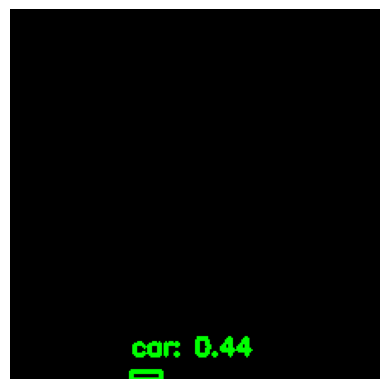

Frame 509, Label: 3, Score: 0.4406284987926483


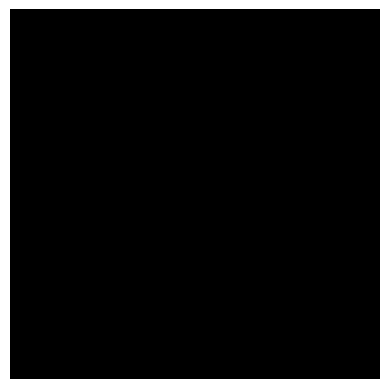

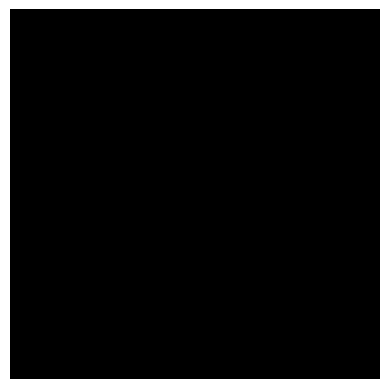

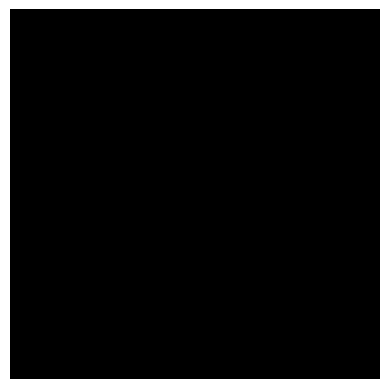

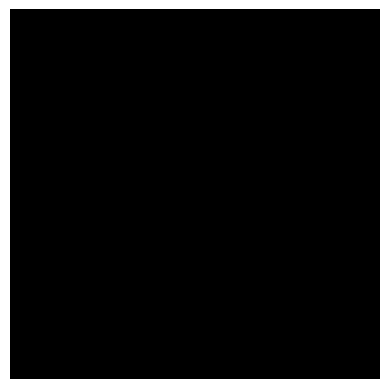

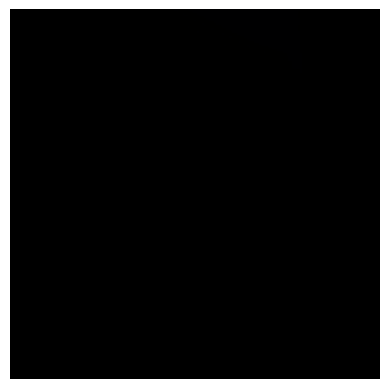

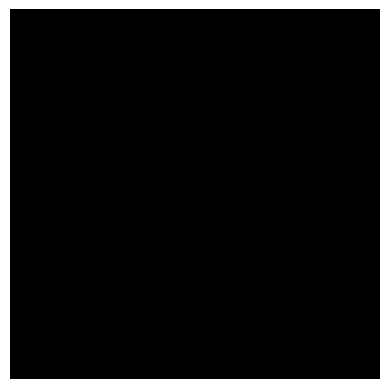

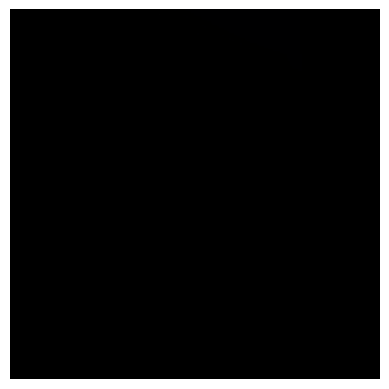

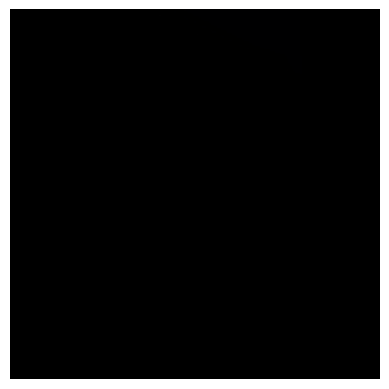

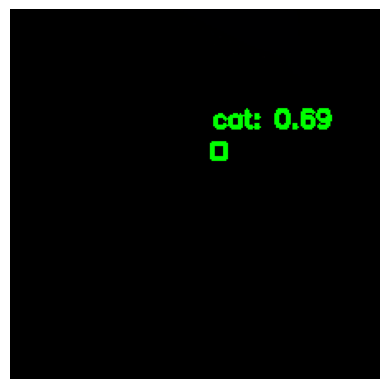

Frame 518, Label: 16, Score: 0.6911053657531738


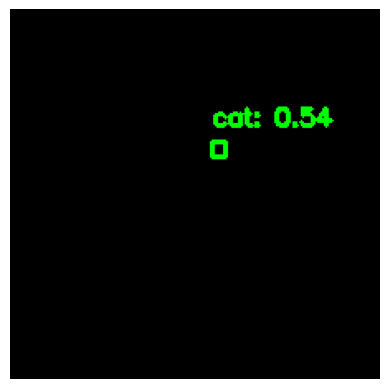

Frame 519, Label: 16, Score: 0.5402924418449402


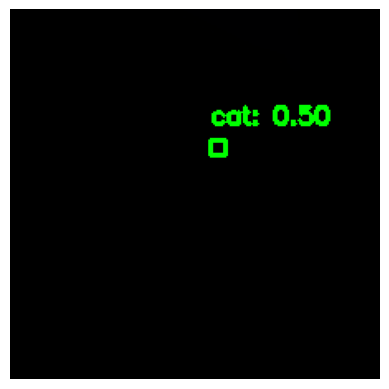

Frame 520, Label: 16, Score: 0.49656566977500916


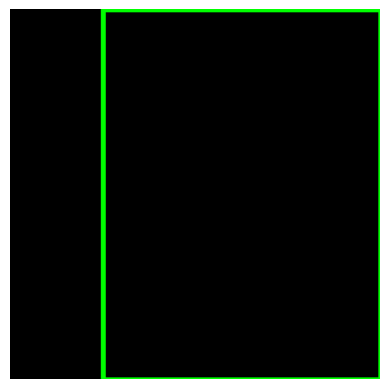

Frame 521, Label: 64, Score: 0.3105679154396057


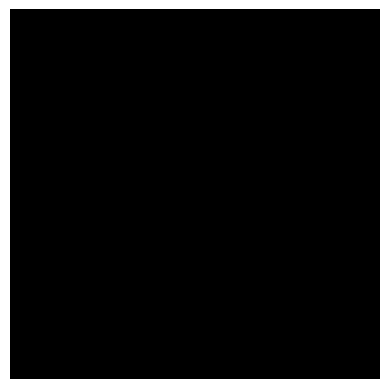

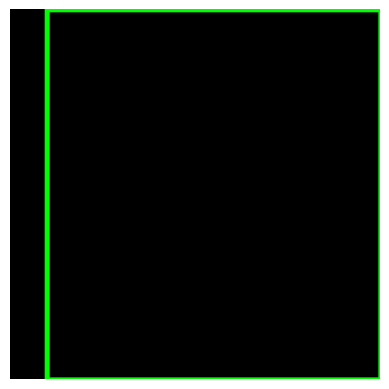

Frame 523, Label: 64, Score: 0.34734123945236206


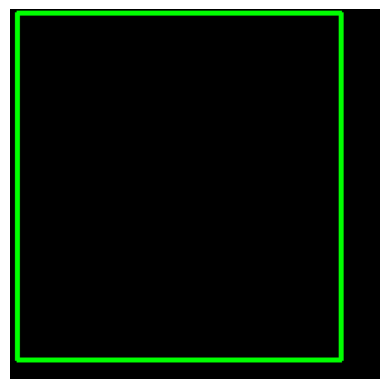

Frame 524, Label: 1, Score: 0.36328044533729553


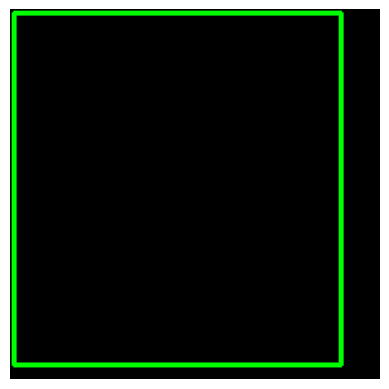

Frame 525, Label: 1, Score: 0.31814712285995483


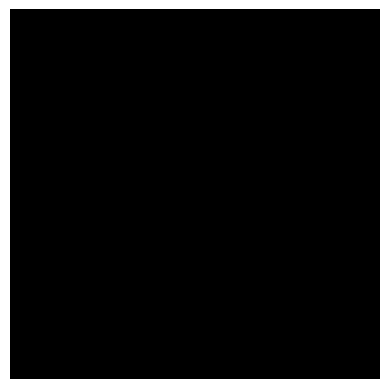

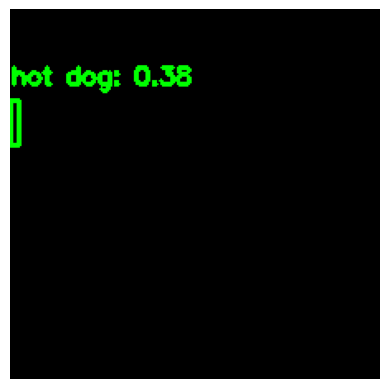

Frame 527, Label: 53, Score: 0.3783456087112427


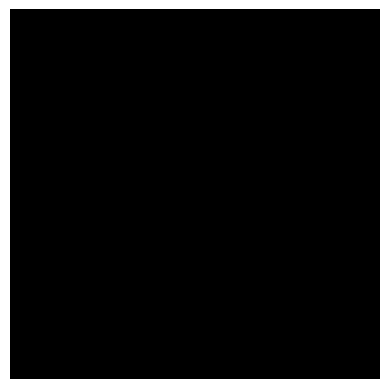

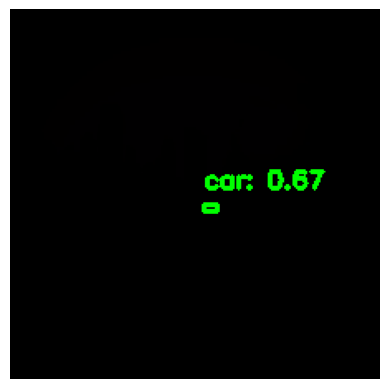

Frame 529, Label: 3, Score: 0.6724104881286621


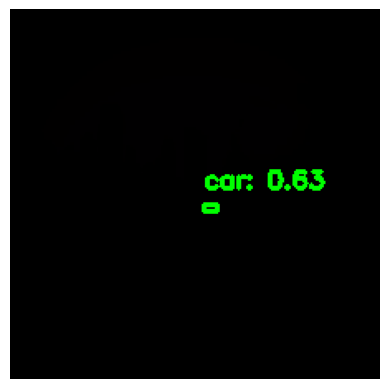

Frame 530, Label: 3, Score: 0.629696786403656


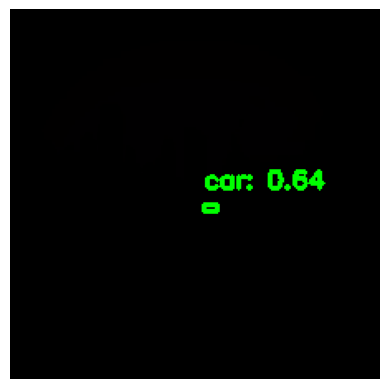

Frame 531, Label: 3, Score: 0.6430363655090332


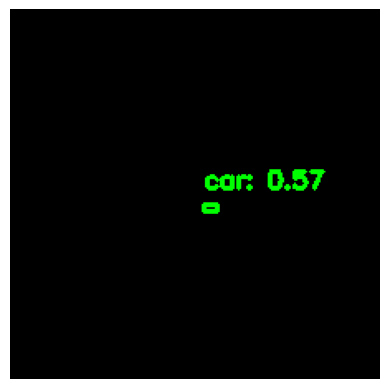

Frame 532, Label: 3, Score: 0.5658109784126282


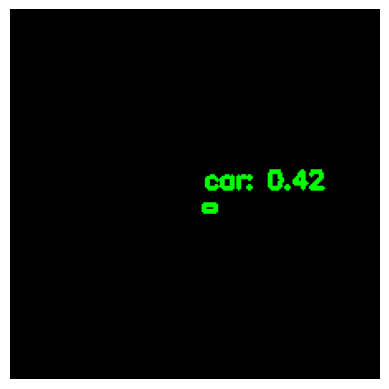

Frame 533, Label: 3, Score: 0.4183712899684906


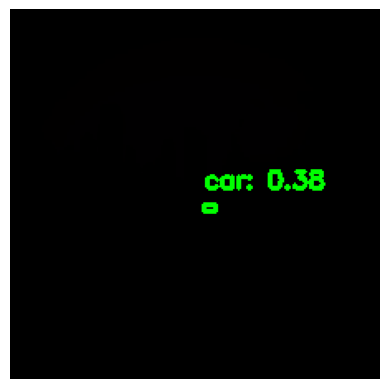

Frame 534, Label: 3, Score: 0.3830544054508209


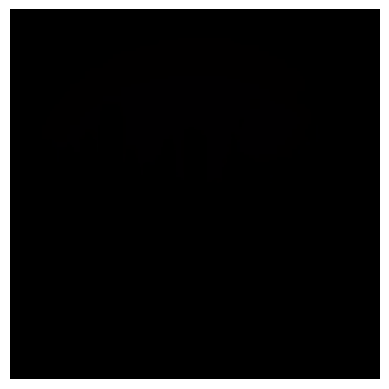

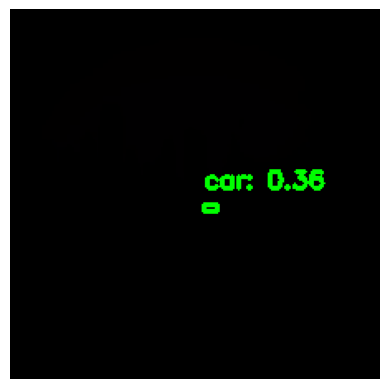

Frame 536, Label: 3, Score: 0.36432644724845886


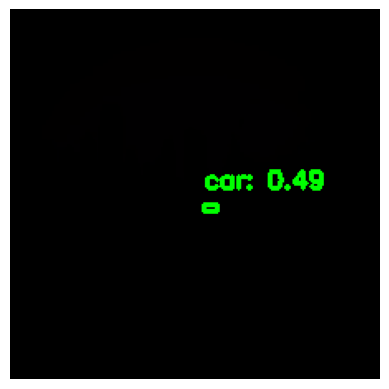

Frame 537, Label: 3, Score: 0.48900100588798523


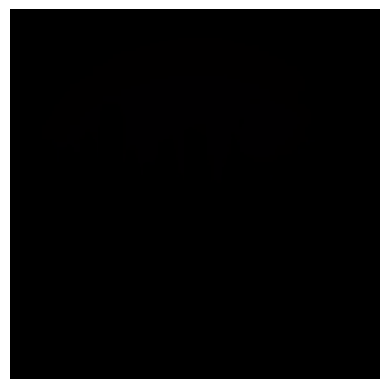

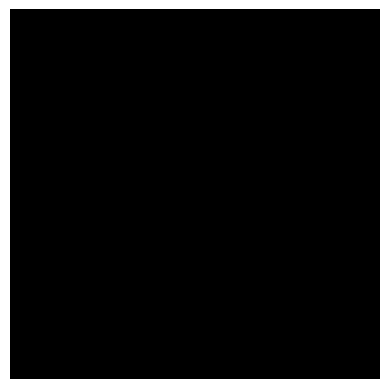

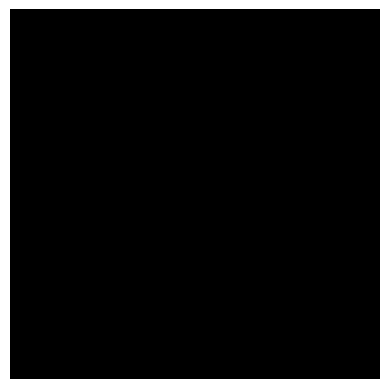

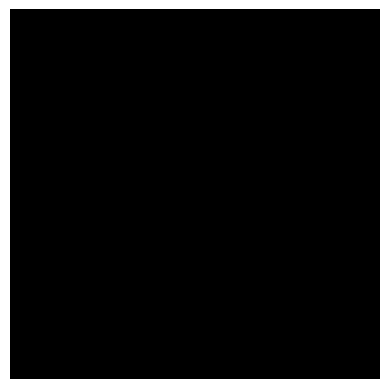

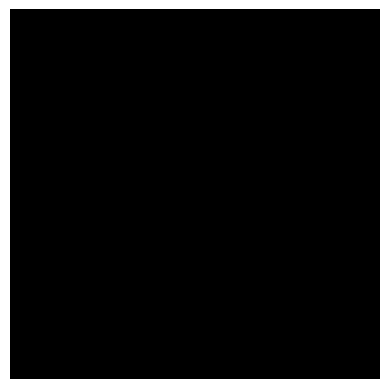

...

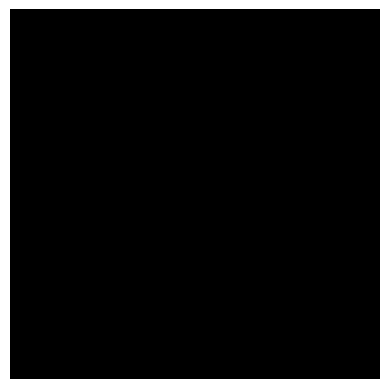

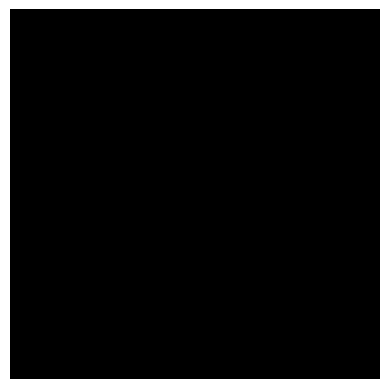

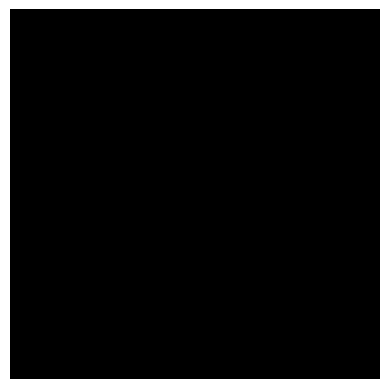

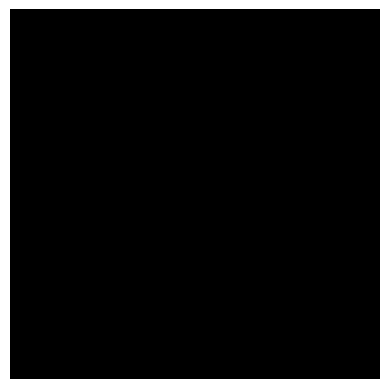

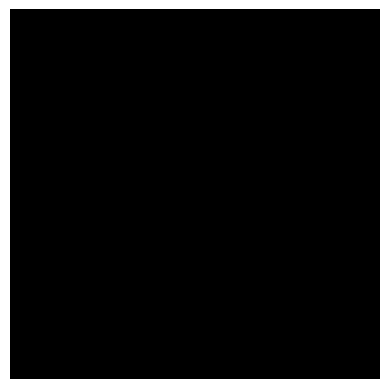

Processing file: Y-bVwPRy_no.npy
Number of frames in Y-bVwPRy_no.npy: 359


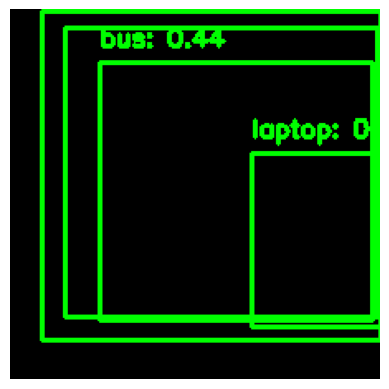

Frame 0, Label: 64, Score: 0.6394189596176147
Frame 0, Label: 7, Score: 0.46792417764663696
Frame 0, Label: 6, Score: 0.43908801674842834
Frame 0, Label: 8, Score: 0.3415043354034424


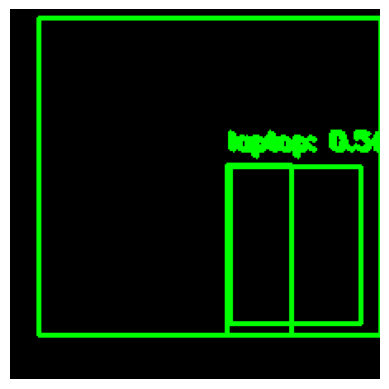

Frame 1, Label: 7, Score: 0.6235402822494507
Frame 1, Label: 64, Score: 0.5357405543327332
Frame 1, Label: 64, Score: 0.380882203578949


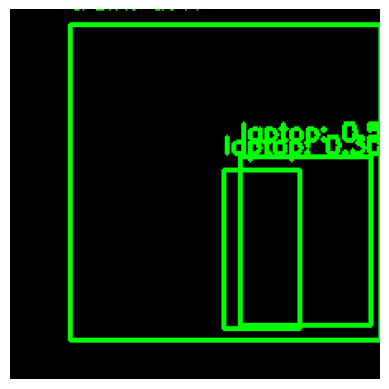

Frame 2, Label: 64, Score: 0.5867050290107727
Frame 2, Label: 7, Score: 0.46846795082092285
Frame 2, Label: 64, Score: 0.3047861158847809


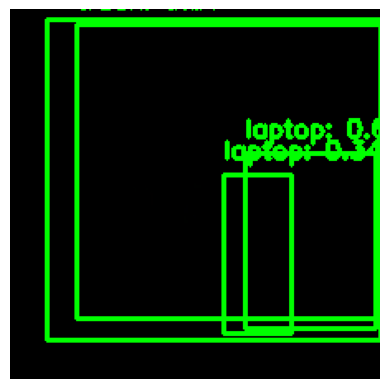

Frame 3, Label: 64, Score: 0.689038097858429
Frame 3, Label: 7, Score: 0.4362659156322479
Frame 3, Label: 64, Score: 0.34076809883117676
Frame 3, Label: 8, Score: 0.3064560890197754


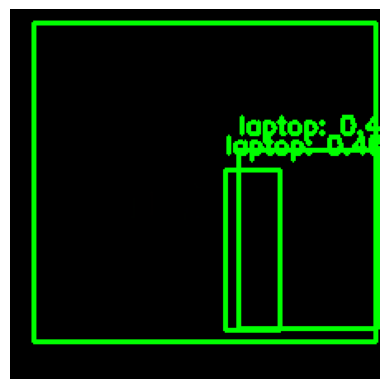

Frame 4, Label: 7, Score: 0.5791521072387695
Frame 4, Label: 64, Score: 0.4675542712211609
Frame 4, Label: 64, Score: 0.4001544713973999


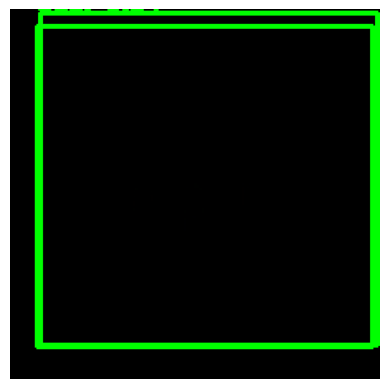

Frame 5, Label: 7, Score: 0.781516969203949
Frame 5, Label: 6, Score: 0.3368329405784607


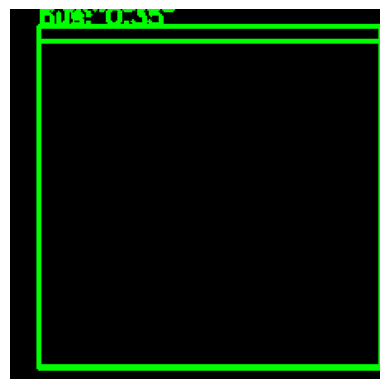

Frame 6, Label: 7, Score: 0.6819391250610352
Frame 6, Label: 6, Score: 0.3479182720184326


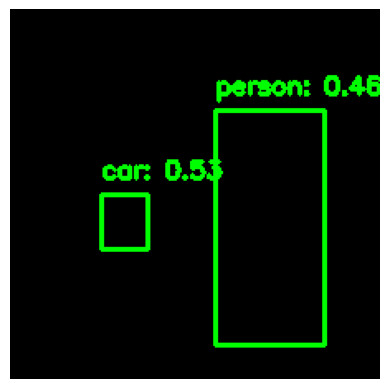

Frame 7, Label: 3, Score: 0.5278967618942261
Frame 7, Label: 1, Score: 0.4580382704734802


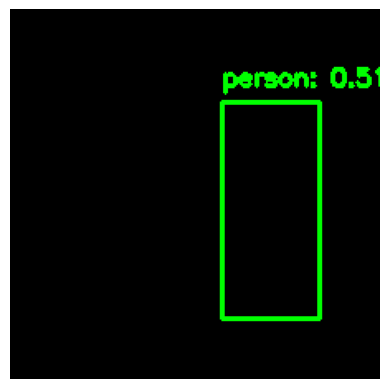

Frame 8, Label: 1, Score: 0.5083884000778198


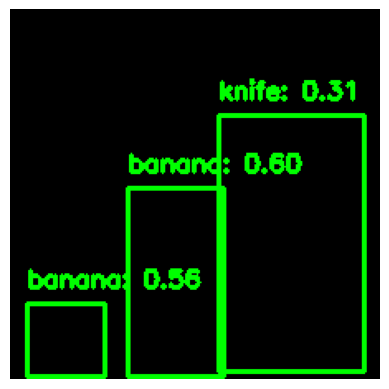

Frame 9, Label: 47, Score: 0.5989694595336914
Frame 9, Label: 47, Score: 0.5619871020317078
Frame 9, Label: 44, Score: 0.30776312947273254


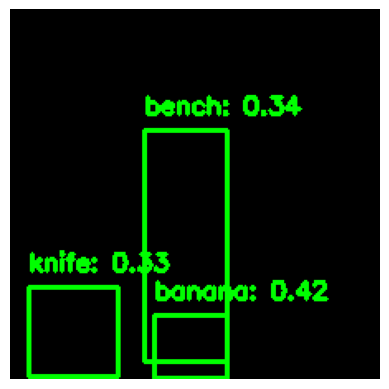

Frame 10, Label: 47, Score: 0.4151378571987152
Frame 10, Label: 14, Score: 0.33983081579208374
Frame 10, Label: 44, Score: 0.3323754370212555


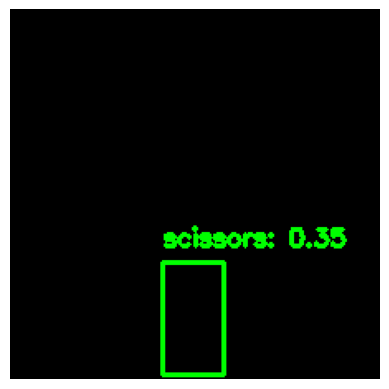

Frame 11, Label: 77, Score: 0.34965217113494873


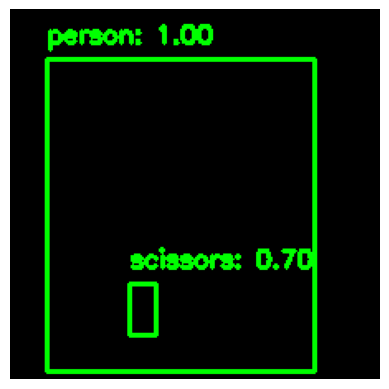

Frame 12, Label: 1, Score: 0.9990642666816711
Frame 12, Label: 77, Score: 0.6953384280204773


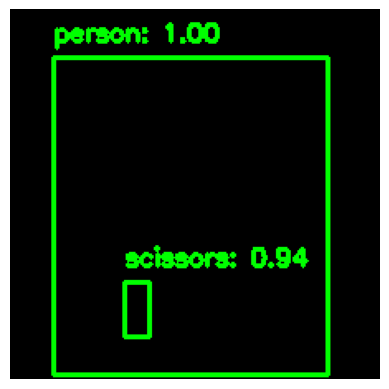

Frame 13, Label: 1, Score: 0.9987229704856873
Frame 13, Label: 77, Score: 0.9356222152709961


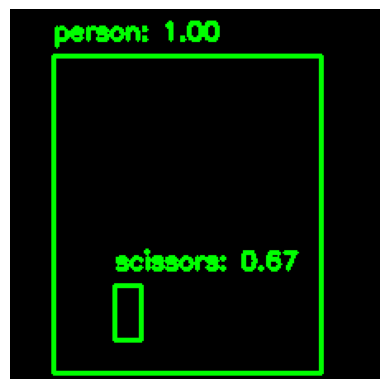

Frame 14, Label: 1, Score: 0.998768150806427
Frame 14, Label: 77, Score: 0.6717336773872375


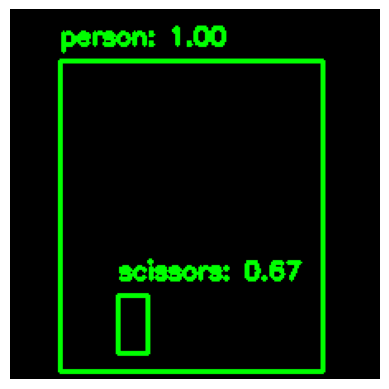

Frame 15, Label: 1, Score: 0.9989275336265564
Frame 15, Label: 77, Score: 0.6712877154350281


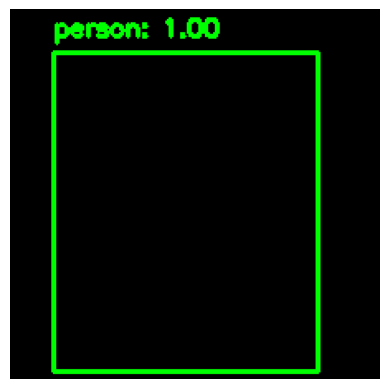

Frame 16, Label: 1, Score: 0.9989870190620422


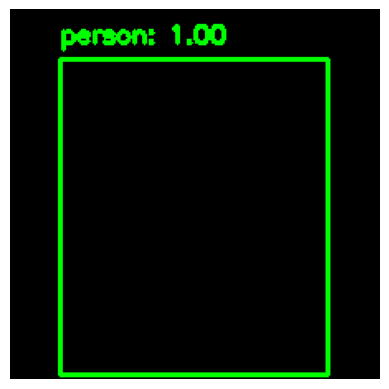

Frame 17, Label: 1, Score: 0.9986553192138672


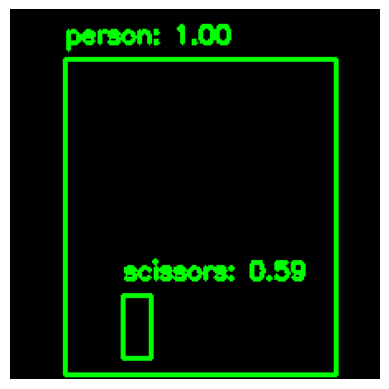

Frame 18, Label: 1, Score: 0.9987736344337463
Frame 18, Label: 77, Score: 0.5876526832580566


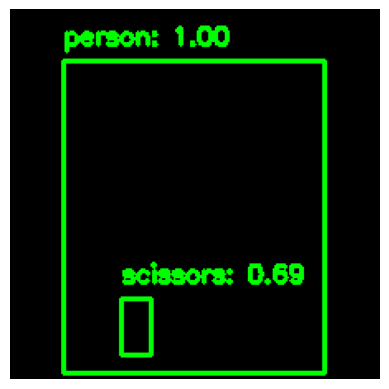

Frame 19, Label: 1, Score: 0.9989811778068542
Frame 19, Label: 77, Score: 0.6891173720359802


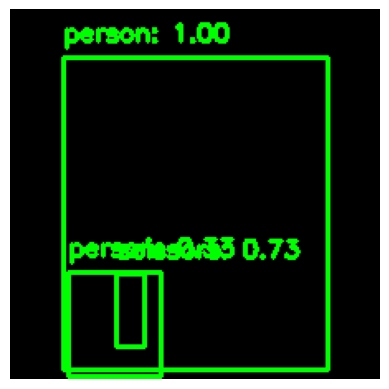

Frame 20, Label: 1, Score: 0.9983556866645813
Frame 20, Label: 77, Score: 0.7302113175392151
Frame 20, Label: 1, Score: 0.3288043737411499


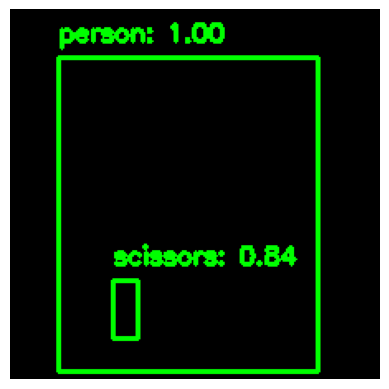

Frame 21, Label: 1, Score: 0.9988493919372559
Frame 21, Label: 77, Score: 0.8416286706924438


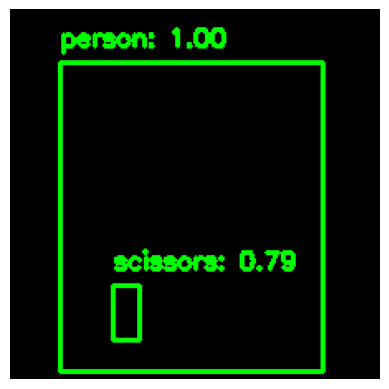

Frame 22, Label: 1, Score: 0.9986205101013184
Frame 22, Label: 77, Score: 0.7852553725242615


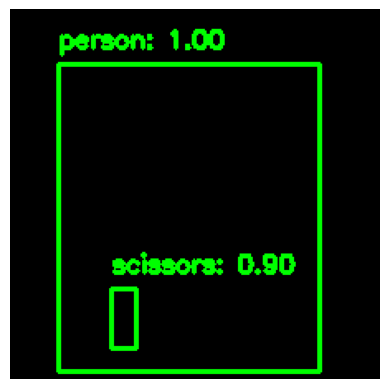

Frame 23, Label: 1, Score: 0.9986912608146667
Frame 23, Label: 77, Score: 0.9023075699806213


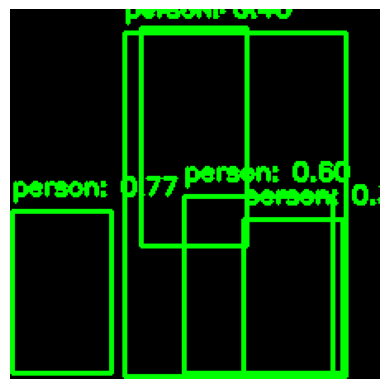

Frame 24, Label: 1, Score: 0.7739791870117188
Frame 24, Label: 1, Score: 0.5955761075019836
Frame 24, Label: 1, Score: 0.4639674723148346
Frame 24, Label: 1, Score: 0.37170618772506714
Frame 24, Label: 14, Score: 0.31212615966796875


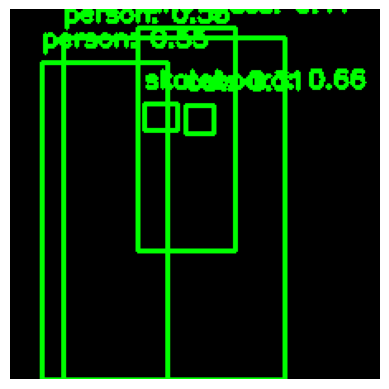

Frame 25, Label: 37, Score: 0.6634392738342285
Frame 25, Label: 1, Score: 0.5455930829048157
Frame 25, Label: 1, Score: 0.533678412437439
Frame 25, Label: 41, Score: 0.4100487232208252
Frame 25, Label: 16, Score: 0.3111608028411865


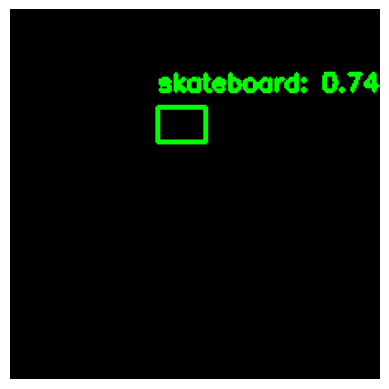

Frame 26, Label: 37, Score: 0.7408442497253418


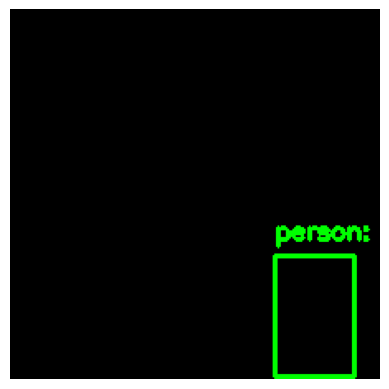

Frame 27, Label: 1, Score: 0.3955466151237488


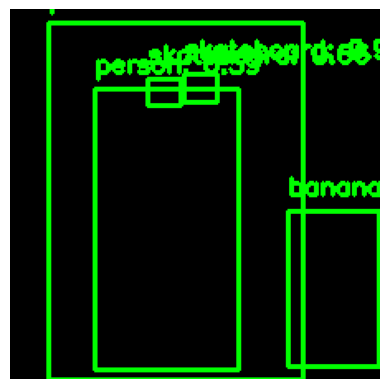

Frame 28, Label: 37, Score: 0.9715061783790588
Frame 28, Label: 1, Score: 0.8515117764472961
Frame 28, Label: 37, Score: 0.6647600531578064
Frame 28, Label: 1, Score: 0.592147707939148
Frame 28, Label: 47, Score: 0.5860779285430908


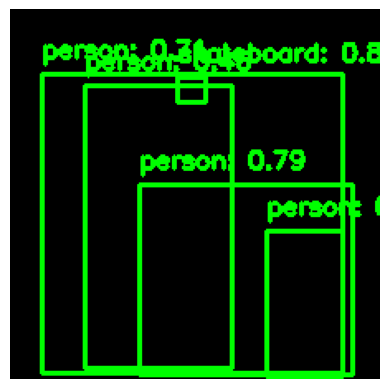

Frame 29, Label: 37, Score: 0.8314361572265625
Frame 29, Label: 1, Score: 0.7912020087242126
Frame 29, Label: 1, Score: 0.7093221545219421
Frame 29, Label: 1, Score: 0.4558474123477936
Frame 29, Label: 1, Score: 0.3060775697231293


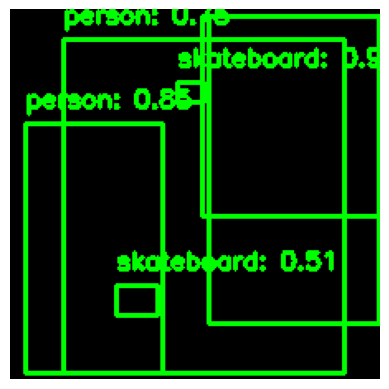

Frame 30, Label: 37, Score: 0.9813775420188904
Frame 30, Label: 1, Score: 0.8492839932441711
Frame 30, Label: 1, Score: 0.745492160320282
Frame 30, Label: 14, Score: 0.6490254998207092
Frame 30, Label: 37, Score: 0.5149319171905518
Frame 30, Label: 3, Score: 0.3499346375465393


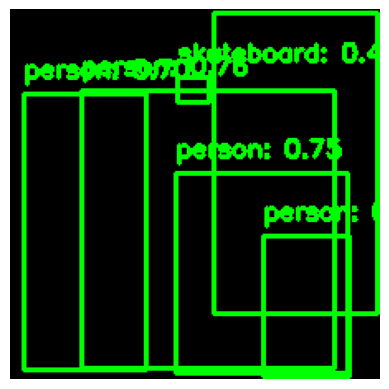

Frame 31, Label: 1, Score: 0.7612511515617371
Frame 31, Label: 1, Score: 0.7526527047157288
Frame 31, Label: 1, Score: 0.6982396245002747
Frame 31, Label: 1, Score: 0.5232009887695312
Frame 31, Label: 37, Score: 0.46566957235336304
Frame 31, Label: 14, Score: 0.4298756420612335


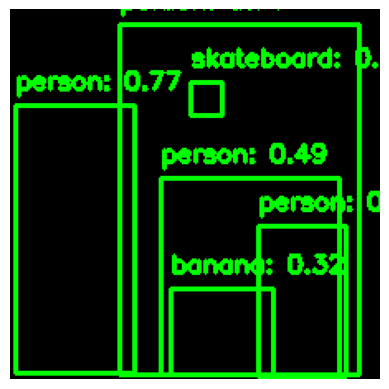

Frame 32, Label: 1, Score: 0.7743881344795227
Frame 32, Label: 1, Score: 0.7056879997253418
Frame 32, Label: 1, Score: 0.49289587140083313
Frame 32, Label: 1, Score: 0.46779805421829224
Frame 32, Label: 37, Score: 0.3587624728679657
Frame 32, Label: 47, Score: 0.31775251030921936


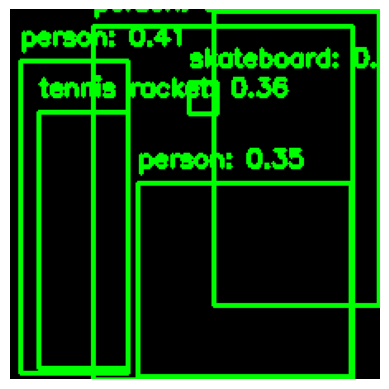

Frame 33, Label: 14, Score: 0.46920329332351685
Frame 33, Label: 1, Score: 0.42856597900390625
Frame 33, Label: 1, Score: 0.4105846881866455
Frame 33, Label: 39, Score: 0.3633729815483093
Frame 33, Label: 1, Score: 0.3512189984321594
Frame 33, Label: 37, Score: 0.33338138461112976


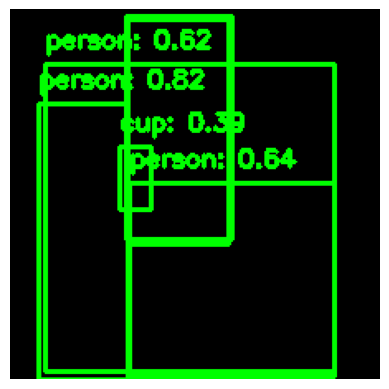

Frame 34, Label: 1, Score: 0.8241203427314758
Frame 34, Label: 1, Score: 0.6441784501075745
Frame 34, Label: 1, Score: 0.6163696050643921
Frame 34, Label: 42, Score: 0.3931286931037903
Frame 34, Label: 43, Score: 0.3818191587924957
Frame 34, Label: 41, Score: 0.34974363446235657


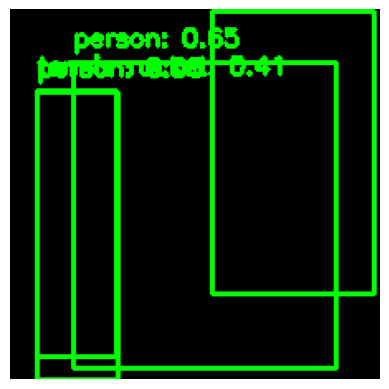

Frame 35, Label: 1, Score: 0.6542419791221619
Frame 35, Label: 1, Score: 0.49540975689888
Frame 35, Label: 39, Score: 0.4134453535079956
Frame 35, Label: 14, Score: 0.34285393357276917


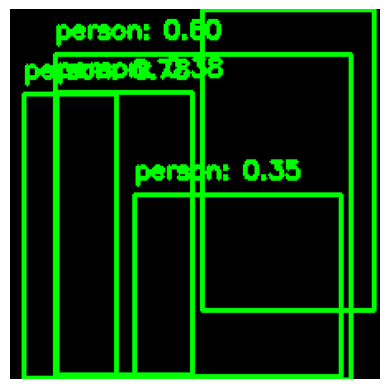

Frame 36, Label: 1, Score: 0.7844556570053101
Frame 36, Label: 1, Score: 0.6027724742889404
Frame 36, Label: 1, Score: 0.38173094391822815
Frame 36, Label: 14, Score: 0.36690253019332886
Frame 36, Label: 1, Score: 0.3527408242225647


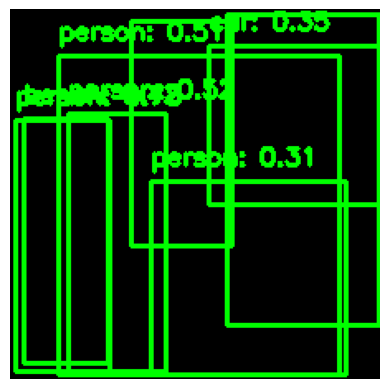

Frame 37, Label: 1, Score: 0.7768282890319824
Frame 37, Label: 1, Score: 0.5204570889472961
Frame 37, Label: 1, Score: 0.5101367235183716
Frame 37, Label: 14, Score: 0.49598416686058044
Frame 37, Label: 43, Score: 0.4954119324684143
Frame 37, Label: 14, Score: 0.4214177131652832
Frame 37, Label: 3, Score: 0.35094621777534485
Frame 37, Label: 1, Score: 0.3110157549381256


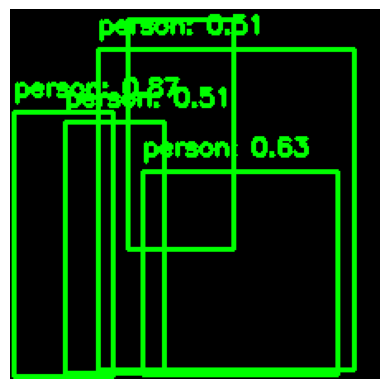

Frame 38, Label: 1, Score: 0.8718608021736145
Frame 38, Label: 43, Score: 0.7043307423591614
Frame 38, Label: 1, Score: 0.6258152723312378
Frame 38, Label: 1, Score: 0.5122895836830139
Frame 38, Label: 1, Score: 0.5063251852989197


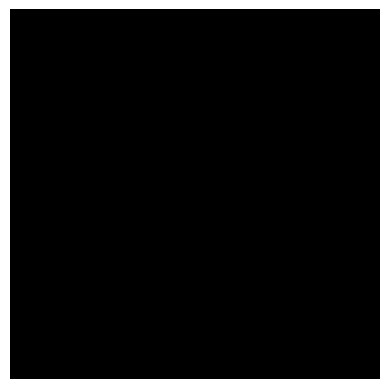

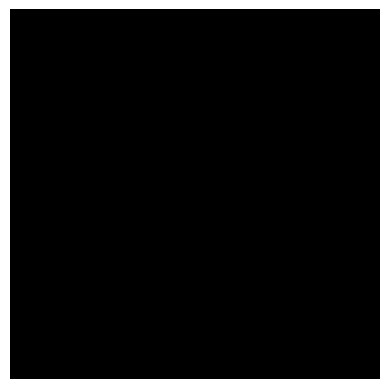

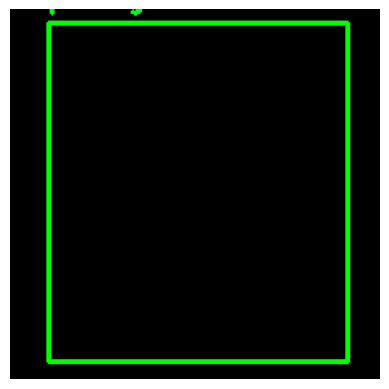

Frame 41, Label: 13, Score: 0.33584749698638916


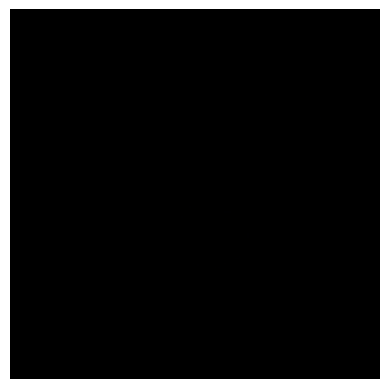

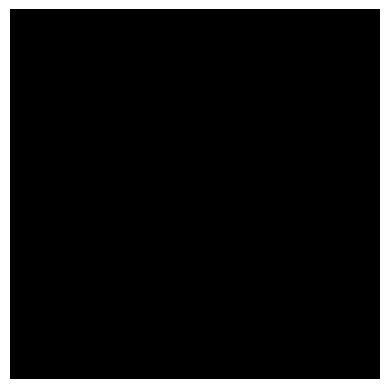

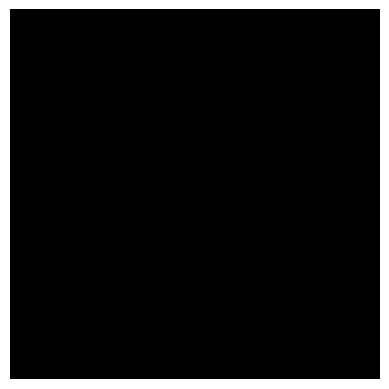

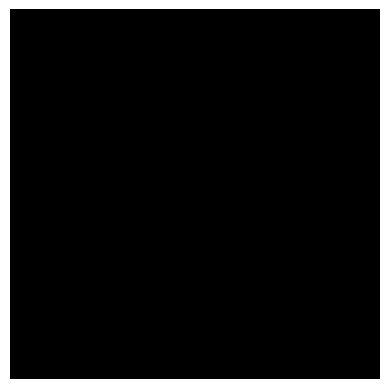

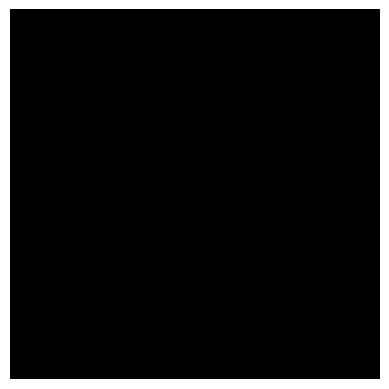

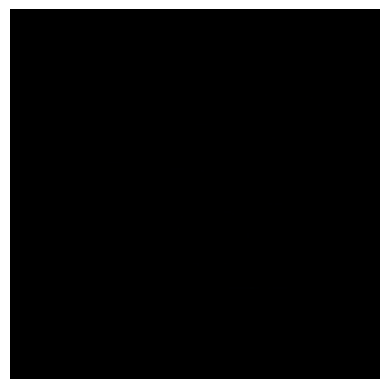

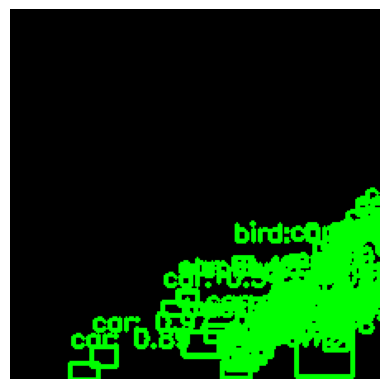

Frame 48, Label: 3, Score: 0.9722895622253418
Frame 48, Label: 3, Score: 0.9545677900314331
Frame 48, Label: 3, Score: 0.939075231552124
Frame 48, Label: 3, Score: 0.9287657141685486
Frame 48, Label: 3, Score: 0.8949811458587646
Frame 48, Label: 3, Score: 0.8830752372741699
Frame 48, Label: 3, Score: 0.8566348552703857
Frame 48, Label: 3, Score: 0.8408710956573486
Frame 48, Label: 3, Score: 0.8204789757728577
Frame 48, Label: 3, Score: 0.818598747253418
Frame 48, Label: 3, Score: 0.8161602020263672
Frame 48, Label: 3, Score: 0.8010468482971191
Frame 48, Label: 3, Score: 0.7933804988861084
Frame 48, Label: 3, Score: 0.7724083662033081
Frame 48, Label: 3, Score: 0.7638667821884155
Frame 48, Label: 3, Score: 0.7518911957740784
Frame 48, Label: 3, Score: 0.7471383810043335
Frame 48, Label: 3, Score: 0.7337744832038879
Frame 48, Label: 3, Score: 0.6790014505386353
Frame 48, Label: 3, Score: 0.6699392795562744
Frame 48, Label: 3, Score: 0.6697685122489929
Frame 48, Label: 3, Score: 0.6691879

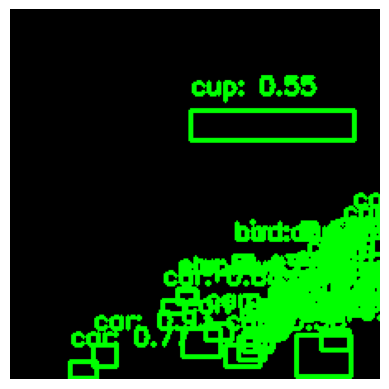

Frame 49, Label: 3, Score: 0.9345627427101135
Frame 49, Label: 3, Score: 0.9325838088989258
Frame 49, Label: 3, Score: 0.9185089468955994
Frame 49, Label: 3, Score: 0.8822624683380127
Frame 49, Label: 3, Score: 0.8781753182411194
Frame 49, Label: 3, Score: 0.8730303049087524
Frame 49, Label: 3, Score: 0.8014928102493286
Frame 49, Label: 3, Score: 0.7691689133644104
Frame 49, Label: 3, Score: 0.7609310150146484
Frame 49, Label: 3, Score: 0.7255265116691589
Frame 49, Label: 3, Score: 0.7233126163482666
Frame 49, Label: 3, Score: 0.7187808156013489
Frame 49, Label: 3, Score: 0.7016414999961853
Frame 49, Label: 3, Score: 0.6973373889923096
Frame 49, Label: 3, Score: 0.6706442832946777
Frame 49, Label: 3, Score: 0.665263831615448
Frame 49, Label: 3, Score: 0.6642442941665649
Frame 49, Label: 3, Score: 0.5800948739051819
Frame 49, Label: 15, Score: 0.5767804384231567
Frame 49, Label: 3, Score: 0.5696048140525818
Frame 49, Label: 3, Score: 0.5521580576896667
Frame 49, Label: 3, Score: 0.55141

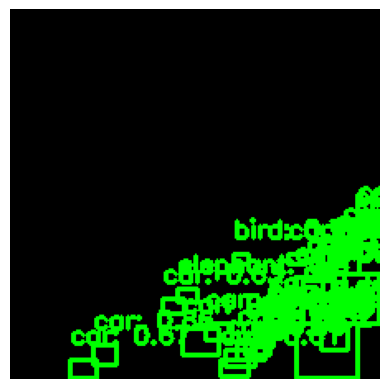

Frame 50, Label: 3, Score: 0.9282313585281372
Frame 50, Label: 3, Score: 0.9049441814422607
Frame 50, Label: 3, Score: 0.8995370864868164
Frame 50, Label: 3, Score: 0.89705491065979
Frame 50, Label: 3, Score: 0.8902763724327087
Frame 50, Label: 3, Score: 0.8601782321929932
Frame 50, Label: 3, Score: 0.8265037536621094
Frame 50, Label: 15, Score: 0.7858695983886719
Frame 50, Label: 3, Score: 0.7571122050285339
Frame 50, Label: 3, Score: 0.7549259662628174
Frame 50, Label: 3, Score: 0.7282502055168152
Frame 50, Label: 3, Score: 0.7107346057891846
Frame 50, Label: 3, Score: 0.6725494265556335
Frame 50, Label: 3, Score: 0.6535490155220032
Frame 50, Label: 3, Score: 0.6325047612190247
Frame 50, Label: 3, Score: 0.6230067014694214
Frame 50, Label: 3, Score: 0.616875946521759
Frame 50, Label: 3, Score: 0.6093417406082153
Frame 50, Label: 3, Score: 0.608877956867218
Frame 50, Label: 21, Score: 0.6070384979248047
Frame 50, Label: 3, Score: 0.5927547812461853
Frame 50, Label: 3, Score: 0.5878967

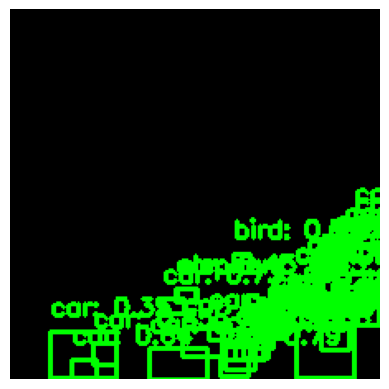

Frame 51, Label: 3, Score: 0.8948182463645935
Frame 51, Label: 3, Score: 0.8882005214691162
Frame 51, Label: 3, Score: 0.8860883116722107
Frame 51, Label: 3, Score: 0.88014817237854
Frame 51, Label: 3, Score: 0.8467355370521545
Frame 51, Label: 3, Score: 0.8299863934516907
Frame 51, Label: 3, Score: 0.8244574666023254
Frame 51, Label: 3, Score: 0.8171207308769226
Frame 51, Label: 3, Score: 0.798799991607666
Frame 51, Label: 3, Score: 0.7862507700920105
Frame 51, Label: 3, Score: 0.7850032448768616
Frame 51, Label: 3, Score: 0.7339563369750977
Frame 51, Label: 3, Score: 0.7187190055847168
Frame 51, Label: 3, Score: 0.7096618413925171
Frame 51, Label: 3, Score: 0.6996769905090332
Frame 51, Label: 3, Score: 0.698742687702179
Frame 51, Label: 3, Score: 0.6638778448104858
Frame 51, Label: 3, Score: 0.6618353128433228
Frame 51, Label: 3, Score: 0.6363095045089722
Frame 51, Label: 3, Score: 0.6159620881080627
Frame 51, Label: 3, Score: 0.588785707950592
Frame 51, Label: 3, Score: 0.5801280140

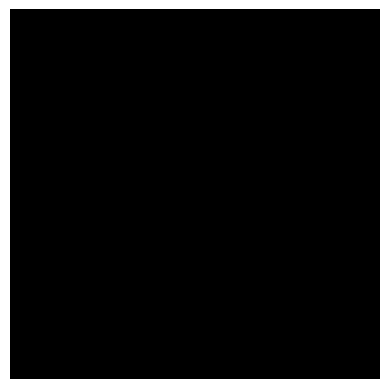

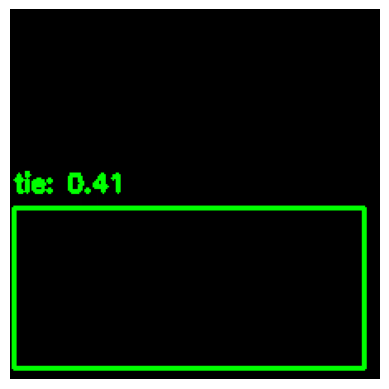

Frame 53, Label: 28, Score: 0.40558502078056335


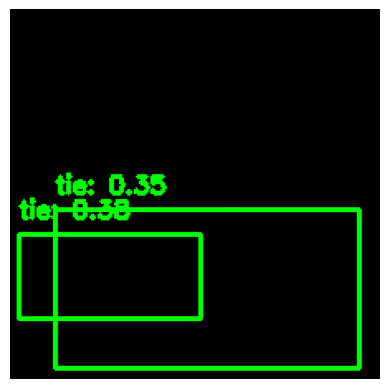

Frame 54, Label: 28, Score: 0.3794972896575928
Frame 54, Label: 28, Score: 0.3523860573768616


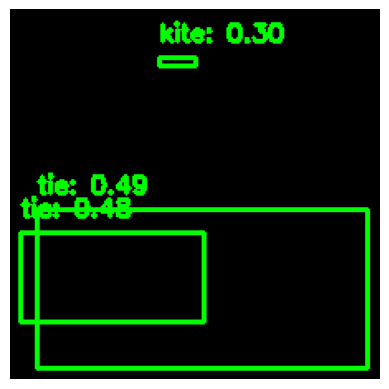

Frame 55, Label: 28, Score: 0.48822665214538574
Frame 55, Label: 28, Score: 0.4797413647174835
Frame 55, Label: 34, Score: 0.304821640253067


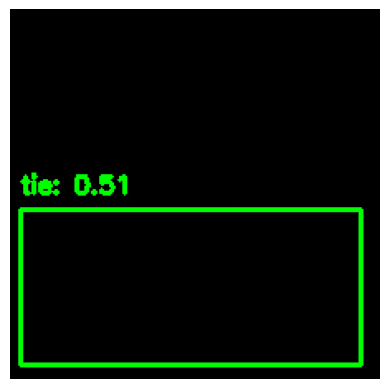

Frame 56, Label: 28, Score: 0.5111611485481262


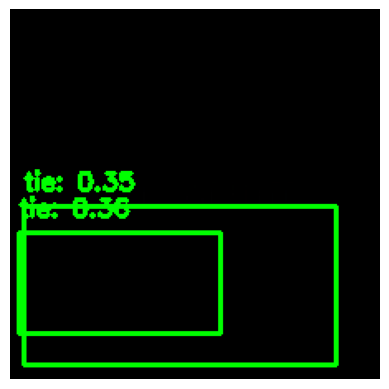

Frame 57, Label: 28, Score: 0.3639523386955261
Frame 57, Label: 28, Score: 0.35473424196243286


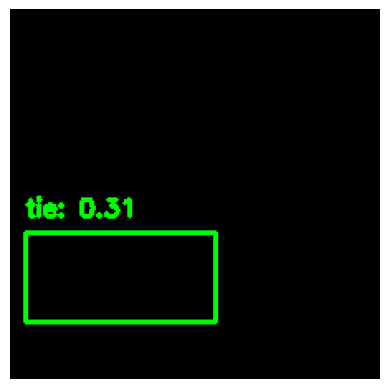

Frame 58, Label: 28, Score: 0.31249451637268066


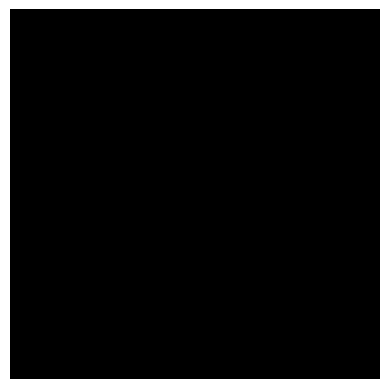

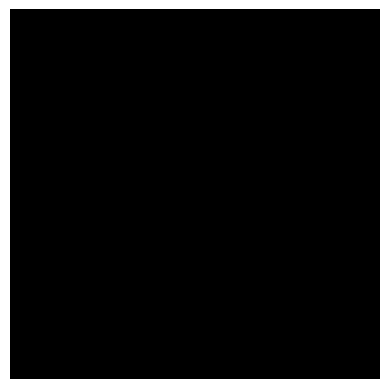

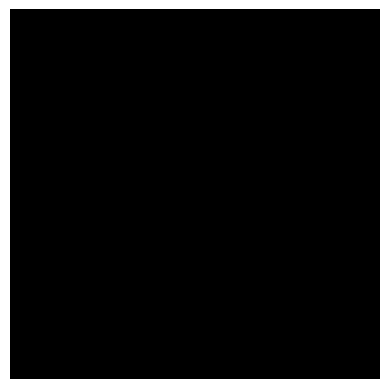

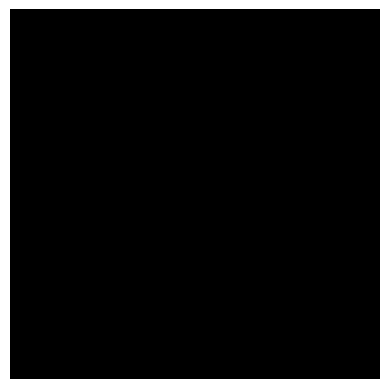

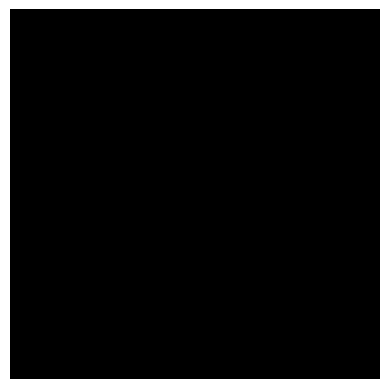

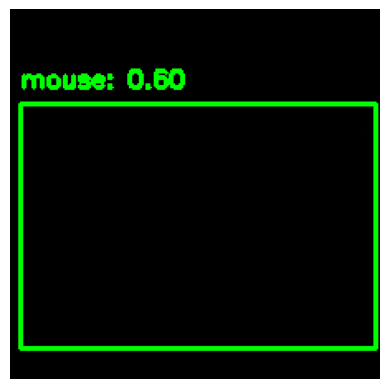

Frame 64, Label: 65, Score: 0.6033363938331604


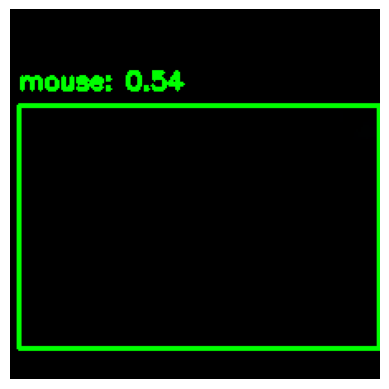

Frame 65, Label: 65, Score: 0.5371764898300171


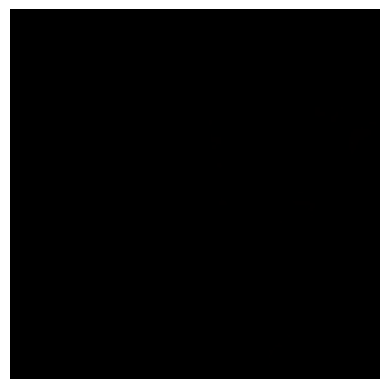

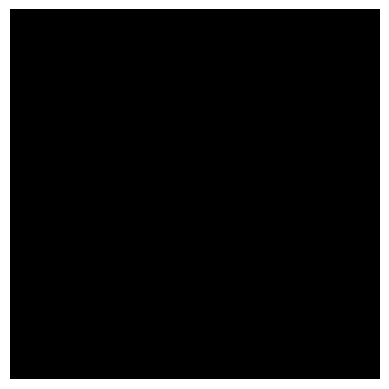

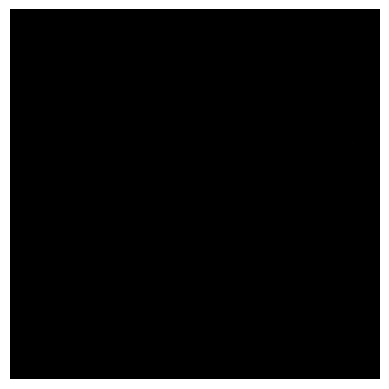

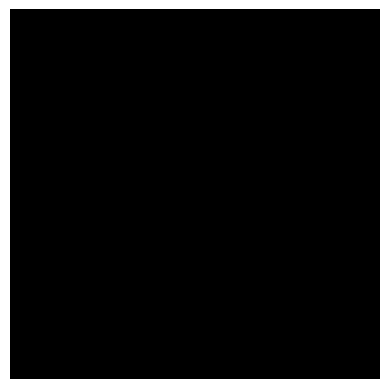

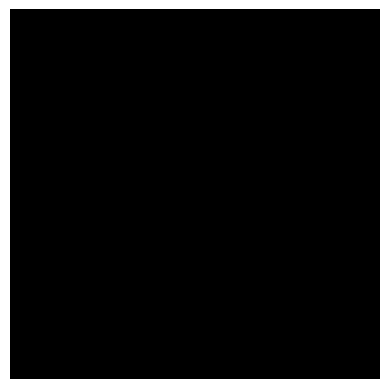

...

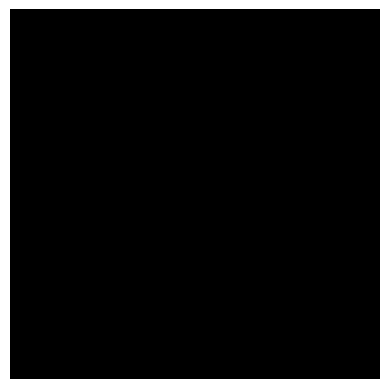

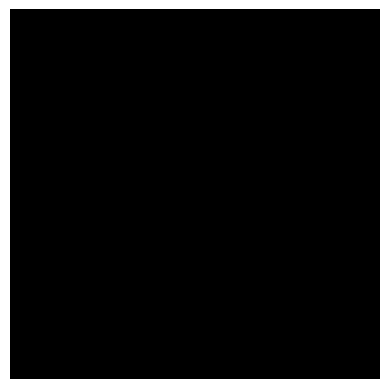

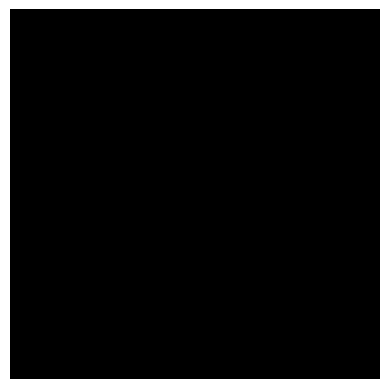

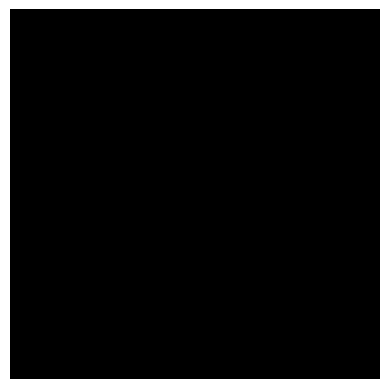

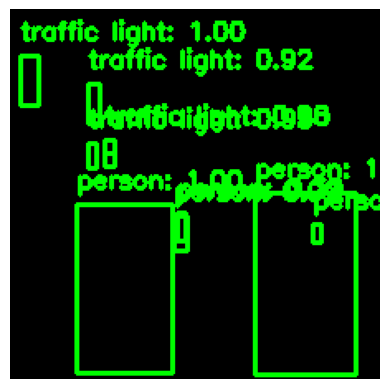

Frame 76, Label: 1, Score: 0.9994814991950989
Frame 76, Label: 10, Score: 0.996711015701294
Frame 76, Label: 1, Score: 0.9965561628341675
Frame 76, Label: 1, Score: 0.9865508079528809
Frame 76, Label: 10, Score: 0.9798046350479126
Frame 76, Label: 10, Score: 0.932857871055603
Frame 76, Label: 10, Score: 0.919809877872467
Frame 76, Label: 1, Score: 0.46022096276283264
Frame 76, Label: 10, Score: 0.3953775465488434
Frame 76, Label: 1, Score: 0.3852444589138031


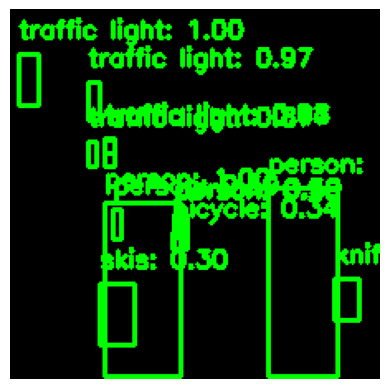

Frame 77, Label: 1, Score: 0.9990413784980774
Frame 77, Label: 10, Score: 0.9966315627098083
Frame 77, Label: 1, Score: 0.9958696961402893
Frame 77, Label: 1, Score: 0.9832883477210999
Frame 77, Label: 10, Score: 0.9796180129051208
Frame 77, Label: 10, Score: 0.9725502729415894
Frame 77, Label: 10, Score: 0.8667258024215698
Frame 77, Label: 1, Score: 0.5911427140235901
Frame 77, Label: 1, Score: 0.5873467326164246
Frame 77, Label: 10, Score: 0.4695250391960144
Frame 77, Label: 2, Score: 0.3420768082141876
Frame 77, Label: 44, Score: 0.32593050599098206
Frame 77, Label: 31, Score: 0.3045596778392792


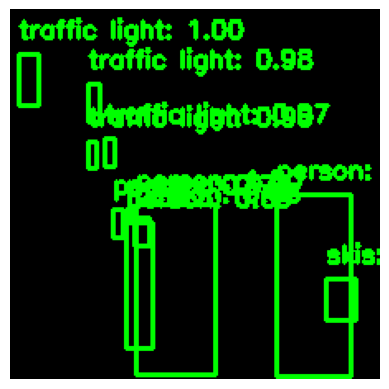

Frame 78, Label: 1, Score: 0.9988790154457092
Frame 78, Label: 1, Score: 0.9985551238059998
Frame 78, Label: 10, Score: 0.9955026507377625
Frame 78, Label: 10, Score: 0.9807935953140259
Frame 78, Label: 1, Score: 0.9720247983932495
Frame 78, Label: 10, Score: 0.9713601469993591
Frame 78, Label: 10, Score: 0.9023480415344238
Frame 78, Label: 1, Score: 0.7436791658401489
Frame 78, Label: 1, Score: 0.6861135959625244
Frame 78, Label: 1, Score: 0.64882892370224
Frame 78, Label: 31, Score: 0.6121477484703064


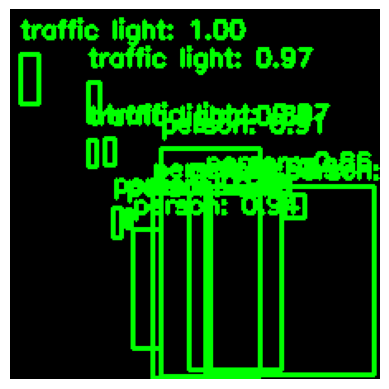

Frame 79, Label: 10, Score: 0.9959413409233093
Frame 79, Label: 1, Score: 0.981894314289093
Frame 79, Label: 10, Score: 0.972062885761261
Frame 79, Label: 1, Score: 0.9709444046020508
Frame 79, Label: 1, Score: 0.9697208404541016
Frame 79, Label: 10, Score: 0.9688010215759277
Frame 79, Label: 1, Score: 0.9440962672233582
Frame 79, Label: 1, Score: 0.9065763354301453
Frame 79, Label: 1, Score: 0.8732559084892273
Frame 79, Label: 1, Score: 0.8640738725662231
Frame 79, Label: 10, Score: 0.8436266779899597
Frame 79, Label: 1, Score: 0.7463443875312805
Frame 79, Label: 1, Score: 0.39895564317703247


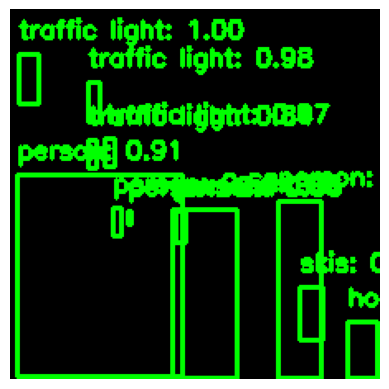

Frame 80, Label: 1, Score: 0.999089241027832
Frame 80, Label: 1, Score: 0.9986787438392639
Frame 80, Label: 10, Score: 0.9958904981613159
Frame 80, Label: 10, Score: 0.9833953380584717
Frame 80, Label: 10, Score: 0.9744360446929932
Frame 80, Label: 1, Score: 0.9061464071273804
Frame 80, Label: 10, Score: 0.8353051543235779
Frame 80, Label: 18, Score: 0.7947174310684204
Frame 80, Label: 1, Score: 0.6929262280464172
Frame 80, Label: 1, Score: 0.6605753898620605
Frame 80, Label: 31, Score: 0.5824791789054871
Frame 80, Label: 1, Score: 0.4426487386226654


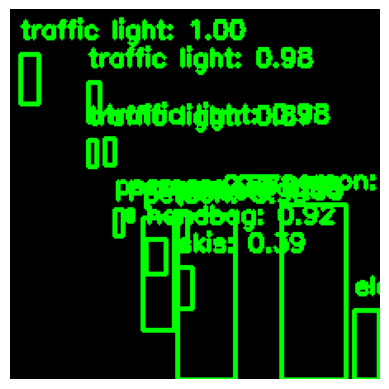

Frame 81, Label: 1, Score: 0.9995085000991821
Frame 81, Label: 1, Score: 0.999305248260498
Frame 81, Label: 10, Score: 0.9961113333702087
Frame 81, Label: 1, Score: 0.9924641847610474
Frame 81, Label: 10, Score: 0.9798091650009155
Frame 81, Label: 10, Score: 0.9766555428504944
Frame 81, Label: 1, Score: 0.9282109141349792
Frame 81, Label: 27, Score: 0.920945405960083
Frame 81, Label: 10, Score: 0.8717027902603149
Frame 81, Label: 1, Score: 0.7651019096374512
Frame 81, Label: 21, Score: 0.7615268230438232
Frame 81, Label: 1, Score: 0.5103399753570557
Frame 81, Label: 31, Score: 0.39005061984062195


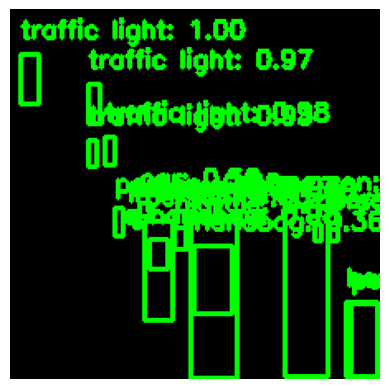

Frame 82, Label: 1, Score: 0.9995098114013672
Frame 82, Label: 1, Score: 0.998961329460144
Frame 82, Label: 10, Score: 0.9964147806167603
Frame 82, Label: 1, Score: 0.9956406354904175
Frame 82, Label: 10, Score: 0.9808922410011292
Frame 82, Label: 27, Score: 0.97709721326828
Frame 82, Label: 10, Score: 0.9747913479804993
Frame 82, Label: 1, Score: 0.9730335474014282
Frame 82, Label: 1, Score: 0.9585444927215576
Frame 82, Label: 10, Score: 0.9327659606933594
Frame 82, Label: 1, Score: 0.788981556892395
Frame 82, Label: 3, Score: 0.5574753284454346
Frame 82, Label: 1, Score: 0.49361953139305115
Frame 82, Label: 1, Score: 0.48662135004997253
Frame 82, Label: 2, Score: 0.44835662841796875
Frame 82, Label: 18, Score: 0.4386250674724579
Frame 82, Label: 1, Score: 0.3851151168346405
Frame 82, Label: 27, Score: 0.361257404088974
Frame 82, Label: 1, Score: 0.34474509954452515


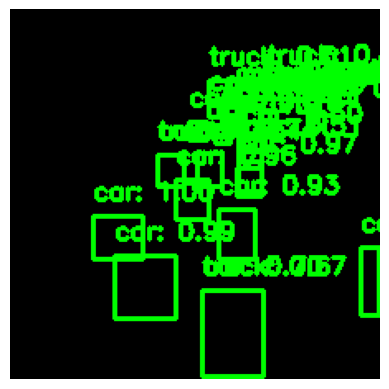

Frame 83, Label: 3, Score: 0.9962462782859802
Frame 83, Label: 3, Score: 0.9936972260475159
Frame 83, Label: 3, Score: 0.9683208465576172
Frame 83, Label: 3, Score: 0.9593532681465149
Frame 83, Label: 3, Score: 0.9396489858627319
Frame 83, Label: 3, Score: 0.9338159561157227
Frame 83, Label: 3, Score: 0.9131946563720703
Frame 83, Label: 3, Score: 0.8882807493209839
Frame 83, Label: 8, Score: 0.8605498671531677
Frame 83, Label: 3, Score: 0.8495987057685852
Frame 83, Label: 3, Score: 0.7728071212768555
Frame 83, Label: 3, Score: 0.746221661567688
Frame 83, Label: 3, Score: 0.7395655512809753
Frame 83, Label: 3, Score: 0.7385967969894409
Frame 83, Label: 3, Score: 0.6998343467712402
Frame 83, Label: 3, Score: 0.6812610030174255
Frame 83, Label: 8, Score: 0.6725167036056519
Frame 83, Label: 3, Score: 0.656813383102417
Frame 83, Label: 3, Score: 0.6301396489143372
Frame 83, Label: 3, Score: 0.6107786297798157
Frame 83, Label: 3, Score: 0.5704847574234009
Frame 83, Label: 3, Score: 0.5260427

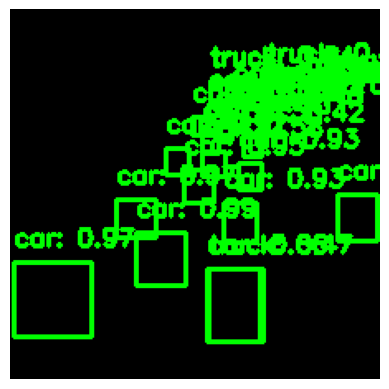

Frame 84, Label: 3, Score: 0.9945540428161621
Frame 84, Label: 3, Score: 0.974516749382019
Frame 84, Label: 3, Score: 0.9727857708930969
Frame 84, Label: 3, Score: 0.9690079689025879
Frame 84, Label: 3, Score: 0.9492202997207642
Frame 84, Label: 3, Score: 0.9326404929161072
Frame 84, Label: 3, Score: 0.9303251504898071
Frame 84, Label: 3, Score: 0.9182179570198059
Frame 84, Label: 3, Score: 0.8703137040138245
Frame 84, Label: 3, Score: 0.837418258190155
Frame 84, Label: 8, Score: 0.8218908905982971
Frame 84, Label: 3, Score: 0.7239932417869568
Frame 84, Label: 3, Score: 0.7215752601623535
Frame 84, Label: 3, Score: 0.7204577922821045
Frame 84, Label: 3, Score: 0.6942196488380432
Frame 84, Label: 3, Score: 0.6716242432594299
Frame 84, Label: 3, Score: 0.6627572178840637
Frame 84, Label: 3, Score: 0.6618515849113464
Frame 84, Label: 8, Score: 0.6412209272384644
Frame 84, Label: 3, Score: 0.5835349559783936
Frame 84, Label: 3, Score: 0.5393664836883545
Frame 84, Label: 3, Score: 0.5265887

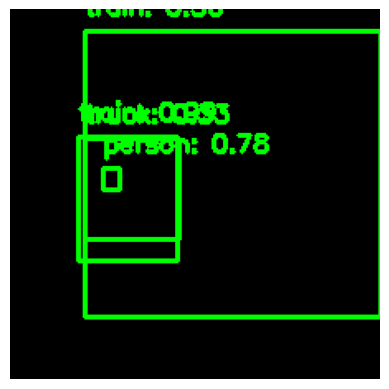

Frame 85, Label: 7, Score: 0.9944403767585754
Frame 85, Label: 1, Score: 0.7849243879318237
Frame 85, Label: 7, Score: 0.5630422830581665
Frame 85, Label: 8, Score: 0.32529187202453613


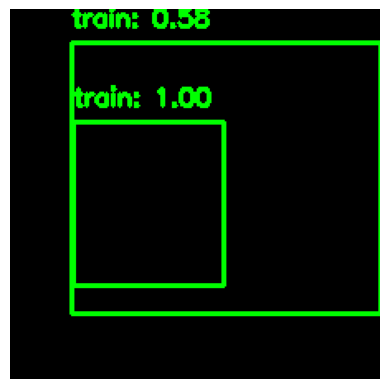

Frame 86, Label: 7, Score: 0.9985970854759216
Frame 86, Label: 7, Score: 0.5793898701667786


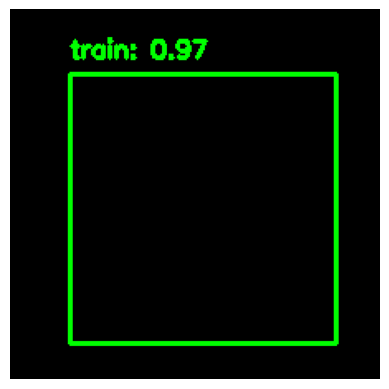

Frame 87, Label: 7, Score: 0.9727994203567505


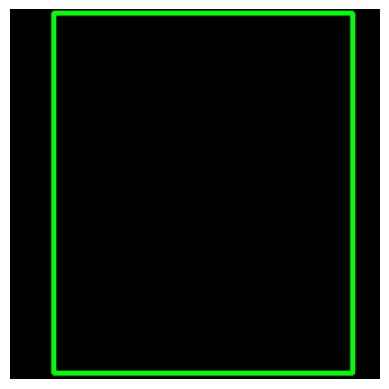

Frame 88, Label: 7, Score: 0.8392583727836609


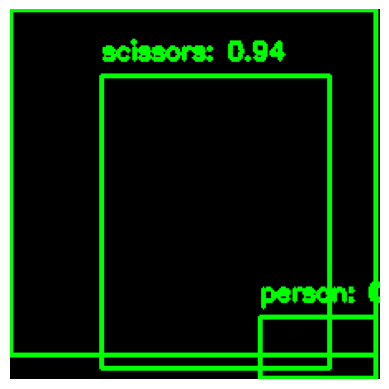

Frame 89, Label: 77, Score: 0.9430375099182129
Frame 89, Label: 1, Score: 0.6445987820625305
Frame 89, Label: 1, Score: 0.3170481026172638


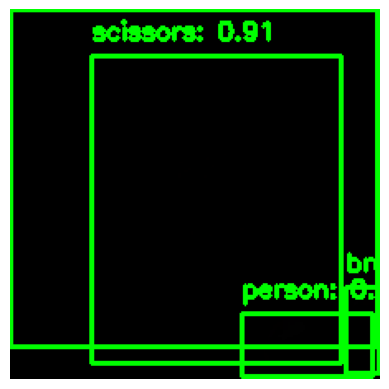

Frame 90, Label: 77, Score: 0.9090942144393921
Frame 90, Label: 1, Score: 0.6282317042350769
Frame 90, Label: 51, Score: 0.4129742383956909
Frame 90, Label: 1, Score: 0.3305501639842987


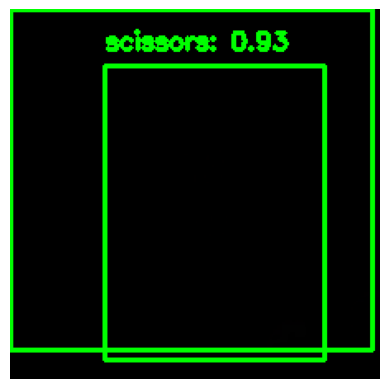

Frame 91, Label: 77, Score: 0.934714138507843
Frame 91, Label: 1, Score: 0.6763068437576294


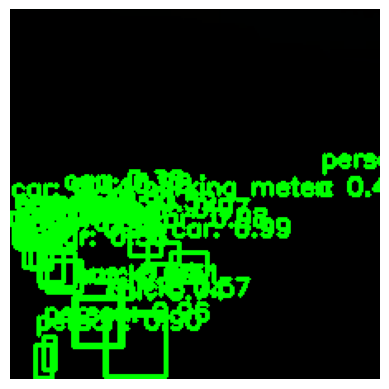

Frame 92, Label: 3, Score: 0.99320387840271
Frame 92, Label: 3, Score: 0.9844829440116882
Frame 92, Label: 3, Score: 0.9707071185112
Frame 92, Label: 3, Score: 0.9618009924888611
Frame 92, Label: 1, Score: 0.9590199589729309
Frame 92, Label: 3, Score: 0.9407483339309692
Frame 92, Label: 3, Score: 0.9127762317657471
Frame 92, Label: 1, Score: 0.8986555337905884
Frame 92, Label: 3, Score: 0.897280216217041
Frame 92, Label: 3, Score: 0.8248834609985352
Frame 92, Label: 3, Score: 0.7385361790657043
Frame 92, Label: 3, Score: 0.6942527890205383
Frame 92, Label: 3, Score: 0.662606418132782
Frame 92, Label: 1, Score: 0.5882704257965088
Frame 92, Label: 8, Score: 0.5748071074485779
Frame 92, Label: 3, Score: 0.5730939507484436
Frame 92, Label: 3, Score: 0.5575507283210754
Frame 92, Label: 1, Score: 0.5341373682022095
Frame 92, Label: 3, Score: 0.4428395926952362
Frame 92, Label: 3, Score: 0.44065651297569275
Frame 92, Label: 13, Score: 0.3968311548233032
Frame 92, Label: 3, Score: 0.3819427788

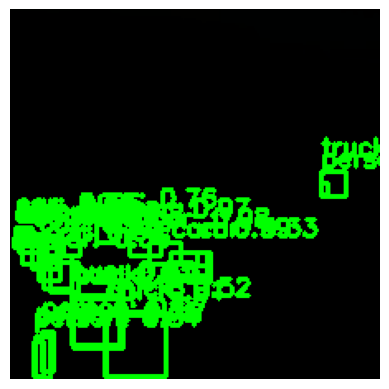

Frame 93, Label: 3, Score: 0.9924914240837097
Frame 93, Label: 3, Score: 0.9830775856971741
Frame 93, Label: 3, Score: 0.9744473695755005
Frame 93, Label: 1, Score: 0.9742094874382019
Frame 93, Label: 3, Score: 0.9213424921035767
Frame 93, Label: 3, Score: 0.8930644392967224
Frame 93, Label: 3, Score: 0.8810021281242371
Frame 93, Label: 1, Score: 0.8444111347198486
Frame 93, Label: 3, Score: 0.812347412109375
Frame 93, Label: 3, Score: 0.804915726184845
Frame 93, Label: 3, Score: 0.7600854635238647
Frame 93, Label: 1, Score: 0.7584969997406006
Frame 93, Label: 3, Score: 0.6479695439338684
Frame 93, Label: 3, Score: 0.6072416305541992
Frame 93, Label: 3, Score: 0.606512725353241
Frame 93, Label: 3, Score: 0.5908796787261963
Frame 93, Label: 8, Score: 0.544056236743927
Frame 93, Label: 8, Score: 0.5210623741149902
Frame 93, Label: 3, Score: 0.5150499939918518
Frame 93, Label: 1, Score: 0.38395392894744873
Frame 93, Label: 3, Score: 0.3643125891685486
Frame 93, Label: 3, Score: 0.36252677

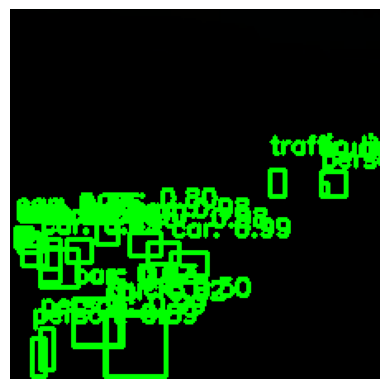

Frame 94, Label: 3, Score: 0.9931081533432007
Frame 94, Label: 1, Score: 0.9852524399757385
Frame 94, Label: 3, Score: 0.981670618057251
Frame 94, Label: 3, Score: 0.9758654832839966
Frame 94, Label: 3, Score: 0.903507649898529
Frame 94, Label: 1, Score: 0.8941864371299744
Frame 94, Label: 3, Score: 0.8908155560493469
Frame 94, Label: 3, Score: 0.8450860977172852
Frame 94, Label: 3, Score: 0.8191313147544861
Frame 94, Label: 3, Score: 0.8037228584289551
Frame 94, Label: 3, Score: 0.7674170136451721
Frame 94, Label: 3, Score: 0.6653534770011902
Frame 94, Label: 3, Score: 0.6205992102622986
Frame 94, Label: 3, Score: 0.6094407439231873
Frame 94, Label: 8, Score: 0.5023298263549805
Frame 94, Label: 8, Score: 0.49813905358314514
Frame 94, Label: 3, Score: 0.4511866569519043
Frame 94, Label: 6, Score: 0.4309973418712616
Frame 94, Label: 1, Score: 0.37723565101623535
Frame 94, Label: 3, Score: 0.3450067341327667
Frame 94, Label: 10, Score: 0.3263452351093292
Frame 94, Label: 3, Score: 0.3122

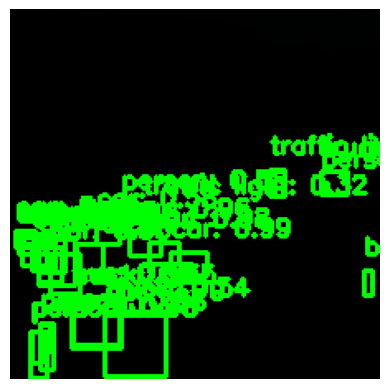

Frame 95, Label: 3, Score: 0.992926299571991
Frame 95, Label: 3, Score: 0.9750723838806152
Frame 95, Label: 1, Score: 0.9652664065361023
Frame 95, Label: 1, Score: 0.9607346057891846
Frame 95, Label: 3, Score: 0.9571874737739563
Frame 95, Label: 3, Score: 0.9389324188232422
Frame 95, Label: 3, Score: 0.8515161275863647
Frame 95, Label: 3, Score: 0.8479957580566406
Frame 95, Label: 3, Score: 0.8083208799362183
Frame 95, Label: 3, Score: 0.7859902381896973
Frame 95, Label: 3, Score: 0.740185022354126
Frame 95, Label: 3, Score: 0.6669328808784485
Frame 95, Label: 8, Score: 0.658990740776062
Frame 95, Label: 3, Score: 0.6492814421653748
Frame 95, Label: 1, Score: 0.5814507603645325
Frame 95, Label: 3, Score: 0.5790494084358215
Frame 95, Label: 3, Score: 0.5523067116737366
Frame 95, Label: 8, Score: 0.5387116074562073
Frame 95, Label: 10, Score: 0.4780055284500122
Frame 95, Label: 3, Score: 0.4735310673713684
Frame 95, Label: 1, Score: 0.46365422010421753
Frame 95, Label: 1, Score: 0.430145

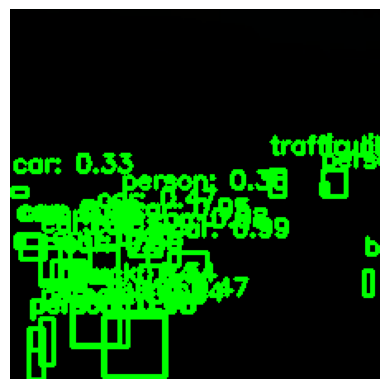

Frame 96, Label: 3, Score: 0.9948049187660217
Frame 96, Label: 3, Score: 0.9822929501533508
Frame 96, Label: 1, Score: 0.981830894947052
Frame 96, Label: 1, Score: 0.9802762269973755
Frame 96, Label: 3, Score: 0.9543657898902893
Frame 96, Label: 3, Score: 0.9113200306892395
Frame 96, Label: 3, Score: 0.842877984046936
Frame 96, Label: 3, Score: 0.8366833925247192
Frame 96, Label: 3, Score: 0.7681522369384766
Frame 96, Label: 3, Score: 0.7551819682121277
Frame 96, Label: 14, Score: 0.6887267231941223
Frame 96, Label: 3, Score: 0.6710105538368225
Frame 96, Label: 8, Score: 0.6028895974159241
Frame 96, Label: 1, Score: 0.5167153477668762
Frame 96, Label: 3, Score: 0.5009799003601074
Frame 96, Label: 3, Score: 0.4894466996192932
Frame 96, Label: 3, Score: 0.4701284170150757
Frame 96, Label: 8, Score: 0.4687269628047943
Frame 96, Label: 1, Score: 0.457441121339798
Frame 96, Label: 3, Score: 0.4528242349624634
Frame 96, Label: 3, Score: 0.391845166683197
Frame 96, Label: 1, Score: 0.36368706

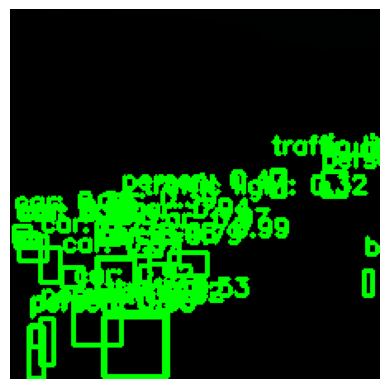

Frame 97, Label: 3, Score: 0.9945855736732483
Frame 97, Label: 1, Score: 0.9802166819572449
Frame 97, Label: 3, Score: 0.9735983610153198
Frame 97, Label: 1, Score: 0.9597121477127075
Frame 97, Label: 3, Score: 0.9446827173233032
Frame 97, Label: 3, Score: 0.9245669841766357
Frame 97, Label: 3, Score: 0.8163701295852661
Frame 97, Label: 8, Score: 0.7908758521080017
Frame 97, Label: 3, Score: 0.7702676057815552
Frame 97, Label: 3, Score: 0.7561956644058228
Frame 97, Label: 14, Score: 0.7485401630401611
Frame 97, Label: 8, Score: 0.722216010093689
Frame 97, Label: 3, Score: 0.7185704112052917
Frame 97, Label: 3, Score: 0.5651541948318481
Frame 97, Label: 8, Score: 0.5302785038948059
Frame 97, Label: 1, Score: 0.5010147094726562
Frame 97, Label: 1, Score: 0.4975201487541199
Frame 97, Label: 3, Score: 0.47721654176712036
Frame 97, Label: 1, Score: 0.47275614738464355
Frame 97, Label: 3, Score: 0.454258531332016
Frame 97, Label: 3, Score: 0.39286455512046814
Frame 97, Label: 3, Score: 0.391

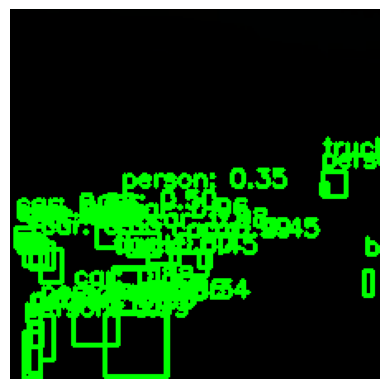

Frame 98, Label: 3, Score: 0.9926385879516602
Frame 98, Label: 1, Score: 0.985397458076477
Frame 98, Label: 1, Score: 0.9762909412384033
Frame 98, Label: 3, Score: 0.9757561683654785
Frame 98, Label: 3, Score: 0.9593034386634827
Frame 98, Label: 1, Score: 0.9257066249847412
Frame 98, Label: 3, Score: 0.8805509209632874
Frame 98, Label: 8, Score: 0.8653167486190796
Frame 98, Label: 3, Score: 0.8559252023696899
Frame 98, Label: 3, Score: 0.7968820333480835
Frame 98, Label: 3, Score: 0.785389244556427
Frame 98, Label: 3, Score: 0.7688291072845459
Frame 98, Label: 3, Score: 0.6978004574775696
Frame 98, Label: 1, Score: 0.6293364763259888
Frame 98, Label: 3, Score: 0.6252472400665283
Frame 98, Label: 14, Score: 0.5733357071876526
Frame 98, Label: 1, Score: 0.5661677718162537
Frame 98, Label: 3, Score: 0.5387673377990723
Frame 98, Label: 3, Score: 0.4962201714515686
Frame 98, Label: 8, Score: 0.4544006586074829
Frame 98, Label: 3, Score: 0.4497520327568054
Frame 98, Label: 3, Score: 0.428436

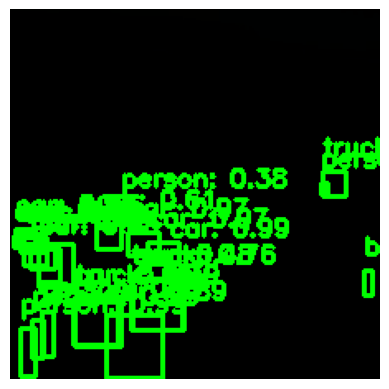

Frame 99, Label: 3, Score: 0.9898055791854858
Frame 99, Label: 1, Score: 0.985383927822113
Frame 99, Label: 1, Score: 0.9825507998466492
Frame 99, Label: 3, Score: 0.9745057821273804
Frame 99, Label: 3, Score: 0.9695898294448853
Frame 99, Label: 1, Score: 0.9680321216583252
Frame 99, Label: 3, Score: 0.8878122568130493
Frame 99, Label: 3, Score: 0.8553521633148193
Frame 99, Label: 3, Score: 0.8286506533622742
Frame 99, Label: 8, Score: 0.8157906532287598
Frame 99, Label: 8, Score: 0.7618247270584106
Frame 99, Label: 3, Score: 0.7502912282943726
Frame 99, Label: 3, Score: 0.7499119639396667
Frame 99, Label: 3, Score: 0.7183458805084229
Frame 99, Label: 3, Score: 0.6122875809669495
Frame 99, Label: 3, Score: 0.573937714099884
Frame 99, Label: 14, Score: 0.5640201568603516
Frame 99, Label: 1, Score: 0.49002566933631897
Frame 99, Label: 3, Score: 0.4750819802284241
Frame 99, Label: 3, Score: 0.45278316736221313
Frame 99, Label: 3, Score: 0.41945961117744446
Frame 99, Label: 8, Score: 0.391

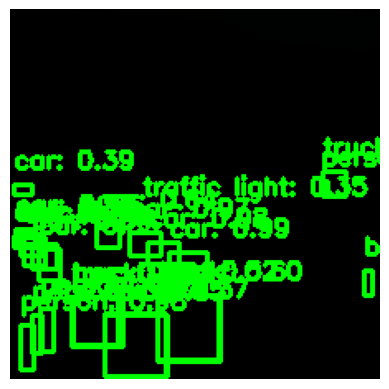

Frame 100, Label: 3, Score: 0.9933364391326904
Frame 100, Label: 1, Score: 0.9861946105957031
Frame 100, Label: 1, Score: 0.9831783175468445
Frame 100, Label: 3, Score: 0.9827117323875427
Frame 100, Label: 1, Score: 0.9742980599403381
Frame 100, Label: 3, Score: 0.969196081161499
Frame 100, Label: 3, Score: 0.8516427874565125
Frame 100, Label: 3, Score: 0.8337857723236084
Frame 100, Label: 3, Score: 0.824754536151886
Frame 100, Label: 3, Score: 0.7569303512573242
Frame 100, Label: 3, Score: 0.7252740859985352
Frame 100, Label: 8, Score: 0.7202469110488892
Frame 100, Label: 3, Score: 0.6443967819213867
Frame 100, Label: 8, Score: 0.6024014949798584
Frame 100, Label: 14, Score: 0.5952978730201721
Frame 100, Label: 3, Score: 0.578568160533905
Frame 100, Label: 3, Score: 0.5248928666114807
Frame 100, Label: 3, Score: 0.4893534183502197
Frame 100, Label: 8, Score: 0.4884994328022003
Frame 100, Label: 1, Score: 0.4823582172393799
Frame 100, Label: 6, Score: 0.4247359335422516
Frame 100, Labe

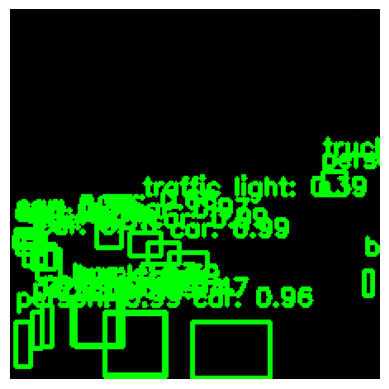

Frame 101, Label: 3, Score: 0.9948458671569824
Frame 101, Label: 1, Score: 0.9868899583816528
Frame 101, Label: 3, Score: 0.9861565828323364
Frame 101, Label: 1, Score: 0.9861114025115967
Frame 101, Label: 1, Score: 0.9854215383529663
Frame 101, Label: 3, Score: 0.9713495969772339
Frame 101, Label: 3, Score: 0.9585269689559937
Frame 101, Label: 3, Score: 0.8375822901725769
Frame 101, Label: 3, Score: 0.7559801340103149
Frame 101, Label: 3, Score: 0.7495404481887817
Frame 101, Label: 3, Score: 0.7378911375999451
Frame 101, Label: 3, Score: 0.7032799124717712
Frame 101, Label: 8, Score: 0.6659082770347595
Frame 101, Label: 3, Score: 0.6630744338035583
Frame 101, Label: 3, Score: 0.6302898526191711
Frame 101, Label: 14, Score: 0.6291475296020508
Frame 101, Label: 3, Score: 0.5863918662071228
Frame 101, Label: 1, Score: 0.47557204961776733
Frame 101, Label: 8, Score: 0.47444504499435425
Frame 101, Label: 6, Score: 0.4335777461528778
Frame 101, Label: 3, Score: 0.4064582288265228
Frame 101,

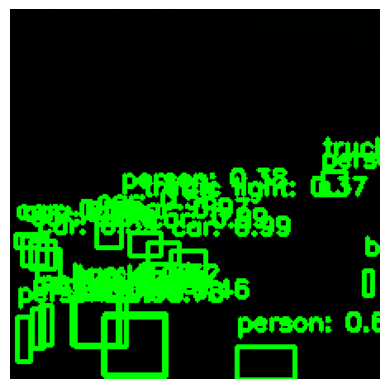

Frame 102, Label: 3, Score: 0.9940306544303894
Frame 102, Label: 1, Score: 0.9906724095344543
Frame 102, Label: 1, Score: 0.9873250722885132
Frame 102, Label: 3, Score: 0.9870074391365051
Frame 102, Label: 3, Score: 0.969363272190094
Frame 102, Label: 1, Score: 0.9588181376457214
Frame 102, Label: 3, Score: 0.7839953899383545
Frame 102, Label: 3, Score: 0.7800527215003967
Frame 102, Label: 3, Score: 0.6638990640640259
Frame 102, Label: 8, Score: 0.6593567132949829
Frame 102, Label: 1, Score: 0.6146049499511719
Frame 102, Label: 14, Score: 0.5985996127128601
Frame 102, Label: 3, Score: 0.5943301320075989
Frame 102, Label: 3, Score: 0.578954815864563
Frame 102, Label: 3, Score: 0.5584330558776855
Frame 102, Label: 1, Score: 0.4838077127933502
Frame 102, Label: 8, Score: 0.4596202075481415
Frame 102, Label: 1, Score: 0.3784913122653961
Frame 102, Label: 10, Score: 0.36820629239082336
Frame 102, Label: 8, Score: 0.32407307624816895
Frame 102, Label: 6, Score: 0.31323322653770447
Frame 102,

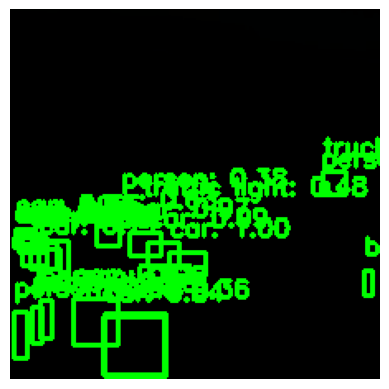

Frame 103, Label: 3, Score: 0.9953573346138
Frame 103, Label: 3, Score: 0.9867276549339294
Frame 103, Label: 1, Score: 0.9809514284133911
Frame 103, Label: 1, Score: 0.9766787886619568
Frame 103, Label: 1, Score: 0.9760932922363281
Frame 103, Label: 3, Score: 0.9689494371414185
Frame 103, Label: 3, Score: 0.8368005752563477
Frame 103, Label: 3, Score: 0.8162661194801331
Frame 103, Label: 3, Score: 0.7343959808349609
Frame 103, Label: 3, Score: 0.7118164300918579
Frame 103, Label: 3, Score: 0.694156289100647
Frame 103, Label: 8, Score: 0.6594662666320801
Frame 103, Label: 3, Score: 0.6330119967460632
Frame 103, Label: 3, Score: 0.6184694766998291
Frame 103, Label: 3, Score: 0.5263499617576599
Frame 103, Label: 14, Score: 0.4879017472267151
Frame 103, Label: 10, Score: 0.4801746606826782
Frame 103, Label: 1, Score: 0.4240199327468872
Frame 103, Label: 1, Score: 0.3824376165866852
Frame 103, Label: 3, Score: 0.3774168789386749
Frame 103, Label: 8, Score: 0.36382657289505005
Frame 103, Lab

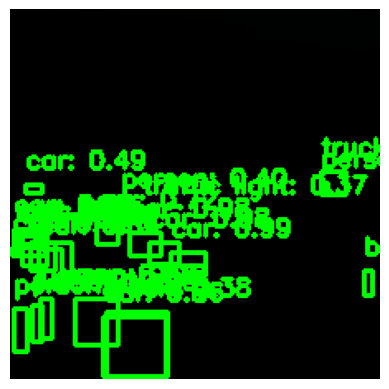

Frame 104, Label: 3, Score: 0.994123637676239
Frame 104, Label: 3, Score: 0.9848129153251648
Frame 104, Label: 1, Score: 0.9807878732681274
Frame 104, Label: 1, Score: 0.9792891144752502
Frame 104, Label: 3, Score: 0.9792713522911072
Frame 104, Label: 1, Score: 0.9759717583656311
Frame 104, Label: 3, Score: 0.8831109404563904
Frame 104, Label: 3, Score: 0.8550013303756714
Frame 104, Label: 3, Score: 0.8385143876075745
Frame 104, Label: 3, Score: 0.8174706697463989
Frame 104, Label: 3, Score: 0.7292793989181519
Frame 104, Label: 3, Score: 0.7287901043891907
Frame 104, Label: 3, Score: 0.7188047170639038
Frame 104, Label: 3, Score: 0.5956792831420898
Frame 104, Label: 8, Score: 0.5798051953315735
Frame 104, Label: 3, Score: 0.5155597925186157
Frame 104, Label: 3, Score: 0.4859645962715149
Frame 104, Label: 3, Score: 0.47036176919937134
Frame 104, Label: 1, Score: 0.4696466028690338
Frame 104, Label: 3, Score: 0.4421823024749756
Frame 104, Label: 3, Score: 0.42107993364334106
Frame 104, L

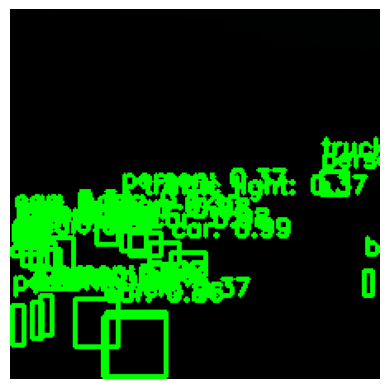

Frame 105, Label: 3, Score: 0.9942116141319275
Frame 105, Label: 3, Score: 0.9849714636802673
Frame 105, Label: 3, Score: 0.979249894618988
Frame 105, Label: 1, Score: 0.9776669144630432
Frame 105, Label: 1, Score: 0.9747251868247986
Frame 105, Label: 1, Score: 0.9711993336677551
Frame 105, Label: 3, Score: 0.8639361262321472
Frame 105, Label: 3, Score: 0.8628619313240051
Frame 105, Label: 3, Score: 0.8210756182670593
Frame 105, Label: 3, Score: 0.7954539060592651
Frame 105, Label: 3, Score: 0.7234091758728027
Frame 105, Label: 3, Score: 0.717810869216919
Frame 105, Label: 3, Score: 0.6866191029548645
Frame 105, Label: 3, Score: 0.5884430408477783
Frame 105, Label: 14, Score: 0.49961352348327637
Frame 105, Label: 3, Score: 0.4877892732620239
Frame 105, Label: 1, Score: 0.4718395173549652
Frame 105, Label: 8, Score: 0.46647512912750244
Frame 105, Label: 3, Score: 0.42455676198005676
Frame 105, Label: 3, Score: 0.4122259318828583
Frame 105, Label: 3, Score: 0.4082334041595459
Frame 105, 

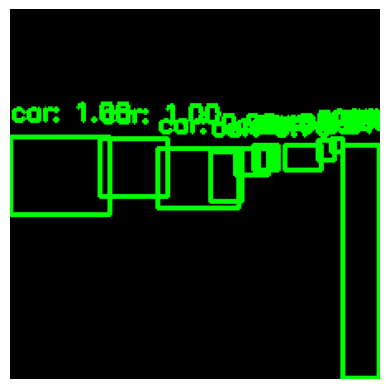

Frame 106, Label: 3, Score: 0.9985068440437317
Frame 106, Label: 3, Score: 0.9976872205734253
Frame 106, Label: 3, Score: 0.9948834776878357
Frame 106, Label: 3, Score: 0.9908946752548218
Frame 106, Label: 3, Score: 0.9612412452697754
Frame 106, Label: 3, Score: 0.9079189300537109
Frame 106, Label: 3, Score: 0.7850324511528015
Frame 106, Label: 3, Score: 0.7667219042778015
Frame 106, Label: 3, Score: 0.7645583152770996
Frame 106, Label: 3, Score: 0.37926939129829407
Frame 106, Label: 3, Score: 0.36926648020744324


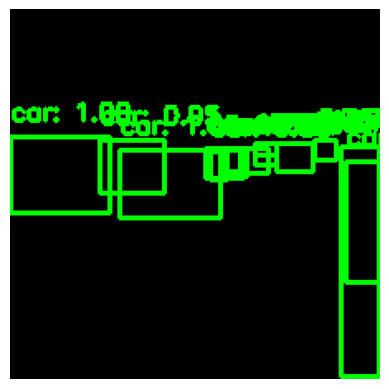

Frame 107, Label: 3, Score: 0.9982136487960815
Frame 107, Label: 3, Score: 0.9971230626106262
Frame 107, Label: 3, Score: 0.9788970947265625
Frame 107, Label: 3, Score: 0.9561103582382202
Frame 107, Label: 3, Score: 0.9489999413490295
Frame 107, Label: 3, Score: 0.8819133639335632
Frame 107, Label: 3, Score: 0.8814262747764587
Frame 107, Label: 3, Score: 0.8727015256881714
Frame 107, Label: 3, Score: 0.4735381007194519
Frame 107, Label: 3, Score: 0.45846113562583923
Frame 107, Label: 3, Score: 0.4470827877521515
Frame 107, Label: 3, Score: 0.33561229705810547
Frame 107, Label: 3, Score: 0.33404406905174255
Frame 107, Label: 3, Score: 0.3019493818283081


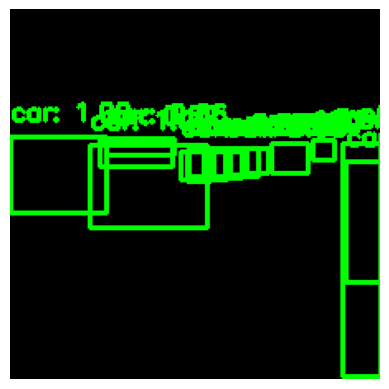

Frame 108, Label: 3, Score: 0.9983964562416077
Frame 108, Label: 3, Score: 0.9983417987823486
Frame 108, Label: 3, Score: 0.9872400164604187
Frame 108, Label: 3, Score: 0.9871529936790466
Frame 108, Label: 3, Score: 0.9758456349372864
Frame 108, Label: 3, Score: 0.9747236371040344
Frame 108, Label: 3, Score: 0.9603776931762695
Frame 108, Label: 3, Score: 0.8328737020492554
Frame 108, Label: 3, Score: 0.8181598782539368
Frame 108, Label: 3, Score: 0.7300513386726379
Frame 108, Label: 3, Score: 0.654256284236908
Frame 108, Label: 3, Score: 0.5564752817153931
Frame 108, Label: 3, Score: 0.555065929889679
Frame 108, Label: 3, Score: 0.5528414845466614
Frame 108, Label: 3, Score: 0.4342666268348694
Frame 108, Label: 3, Score: 0.3554323613643646


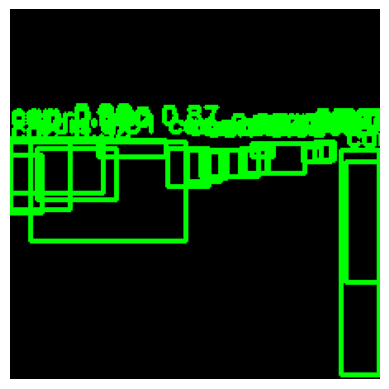

Frame 109, Label: 3, Score: 0.9981799125671387
Frame 109, Label: 3, Score: 0.9879569411277771
Frame 109, Label: 3, Score: 0.9812541007995605
Frame 109, Label: 3, Score: 0.9809302091598511
Frame 109, Label: 3, Score: 0.9803320169448853
Frame 109, Label: 3, Score: 0.9761452674865723
Frame 109, Label: 3, Score: 0.9611031413078308
Frame 109, Label: 3, Score: 0.9587322473526001
Frame 109, Label: 3, Score: 0.8824812173843384
Frame 109, Label: 3, Score: 0.8713343143463135
Frame 109, Label: 3, Score: 0.8034631013870239
Frame 109, Label: 3, Score: 0.534598708152771
Frame 109, Label: 3, Score: 0.5318233966827393
Frame 109, Label: 3, Score: 0.531741738319397
Frame 109, Label: 3, Score: 0.42987293004989624
Frame 109, Label: 3, Score: 0.37507376074790955
Frame 109, Label: 3, Score: 0.3286336064338684
Frame 109, Label: 3, Score: 0.30823376774787903
Frame 109, Label: 3, Score: 0.307382196187973


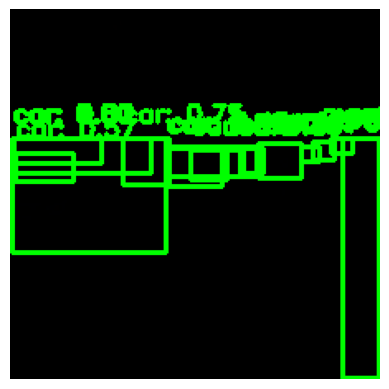

Frame 110, Label: 3, Score: 0.9959535598754883
Frame 110, Label: 3, Score: 0.9918143153190613
Frame 110, Label: 3, Score: 0.9732133746147156
Frame 110, Label: 3, Score: 0.9617489576339722
Frame 110, Label: 3, Score: 0.9549412727355957
Frame 110, Label: 3, Score: 0.9053365588188171
Frame 110, Label: 3, Score: 0.8923195600509644
Frame 110, Label: 3, Score: 0.852286159992218
Frame 110, Label: 3, Score: 0.8438610434532166
Frame 110, Label: 3, Score: 0.8162932991981506
Frame 110, Label: 3, Score: 0.7547102570533752
Frame 110, Label: 3, Score: 0.6146104335784912
Frame 110, Label: 3, Score: 0.5686971545219421
Frame 110, Label: 3, Score: 0.4216507077217102
Frame 110, Label: 3, Score: 0.3357700705528259


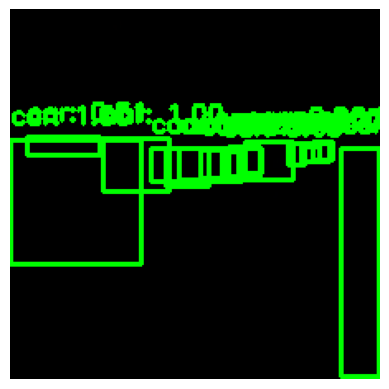

Frame 111, Label: 3, Score: 0.9979097247123718
Frame 111, Label: 3, Score: 0.9970163106918335
Frame 111, Label: 3, Score: 0.9782276153564453
Frame 111, Label: 3, Score: 0.9693395495414734
Frame 111, Label: 3, Score: 0.95708829164505
Frame 111, Label: 3, Score: 0.947586178779602
Frame 111, Label: 3, Score: 0.9440259337425232
Frame 111, Label: 3, Score: 0.9399462938308716
Frame 111, Label: 3, Score: 0.933790922164917
Frame 111, Label: 3, Score: 0.786335825920105
Frame 111, Label: 3, Score: 0.7125594019889832
Frame 111, Label: 3, Score: 0.6498561501502991
Frame 111, Label: 3, Score: 0.6369933485984802
Frame 111, Label: 3, Score: 0.6115038990974426
Frame 111, Label: 3, Score: 0.5069632530212402
Frame 111, Label: 3, Score: 0.3158678412437439


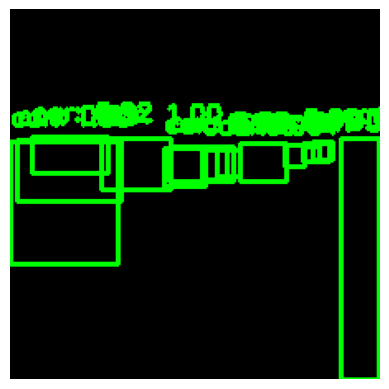

Frame 112, Label: 3, Score: 0.9979671835899353
Frame 112, Label: 3, Score: 0.9959272742271423
Frame 112, Label: 3, Score: 0.9944297671318054
Frame 112, Label: 3, Score: 0.9930644631385803
Frame 112, Label: 3, Score: 0.97878098487854
Frame 112, Label: 3, Score: 0.9669026732444763
Frame 112, Label: 3, Score: 0.9331808686256409
Frame 112, Label: 3, Score: 0.9209751486778259
Frame 112, Label: 3, Score: 0.9208294749259949
Frame 112, Label: 3, Score: 0.9042698740959167
Frame 112, Label: 3, Score: 0.8543699979782104
Frame 112, Label: 3, Score: 0.7446531653404236
Frame 112, Label: 3, Score: 0.6670517325401306
Frame 112, Label: 3, Score: 0.35435086488723755


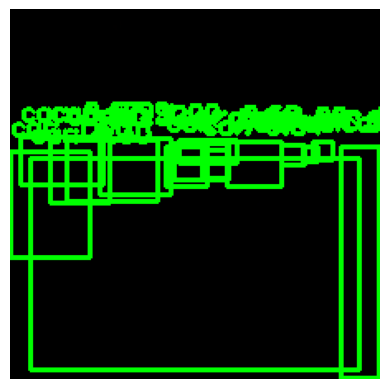

Frame 113, Label: 3, Score: 0.9988868832588196
Frame 113, Label: 3, Score: 0.9983104467391968
Frame 113, Label: 3, Score: 0.9974938631057739
Frame 113, Label: 3, Score: 0.9913750290870667
Frame 113, Label: 3, Score: 0.9900180697441101
Frame 113, Label: 3, Score: 0.9882567524909973
Frame 113, Label: 3, Score: 0.9841024279594421
Frame 113, Label: 3, Score: 0.9561316967010498
Frame 113, Label: 3, Score: 0.934795618057251
Frame 113, Label: 3, Score: 0.8429271578788757
Frame 113, Label: 3, Score: 0.6725152730941772
Frame 113, Label: 3, Score: 0.6084616184234619
Frame 113, Label: 3, Score: 0.3838633596897125
Frame 113, Label: 3, Score: 0.3171950578689575
Frame 113, Label: 3, Score: 0.3038098216056824


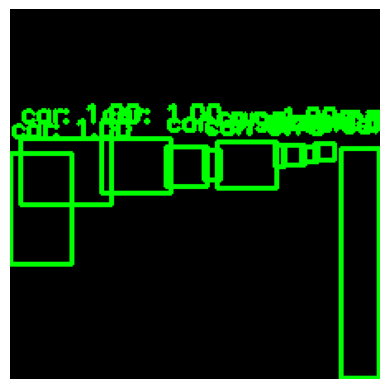

Frame 114, Label: 3, Score: 0.9977567791938782
Frame 114, Label: 3, Score: 0.9964660406112671
Frame 114, Label: 3, Score: 0.9963616728782654
Frame 114, Label: 3, Score: 0.9958250522613525
Frame 114, Label: 3, Score: 0.9853430986404419
Frame 114, Label: 3, Score: 0.9825760126113892
Frame 114, Label: 3, Score: 0.9812101721763611
Frame 114, Label: 3, Score: 0.9481965899467468
Frame 114, Label: 3, Score: 0.9301233887672424
Frame 114, Label: 3, Score: 0.7837530970573425
Frame 114, Label: 3, Score: 0.38570845127105713


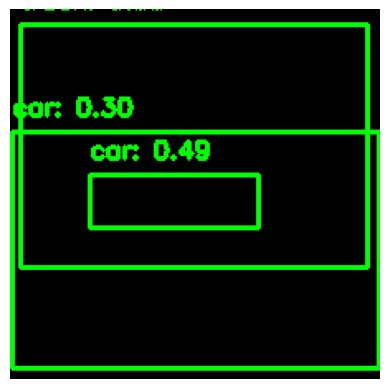

Frame 115, Label: 8, Score: 0.5288386344909668
Frame 115, Label: 3, Score: 0.4896405339241028
Frame 115, Label: 3, Score: 0.3037358224391937


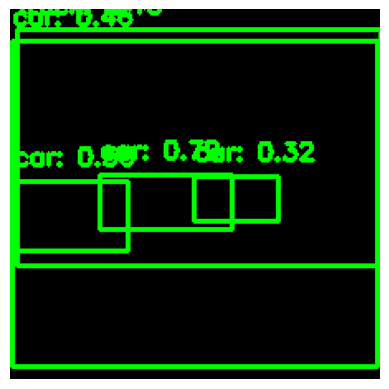

Frame 116, Label: 3, Score: 0.7945767641067505
Frame 116, Label: 3, Score: 0.5555278062820435
Frame 116, Label: 8, Score: 0.46160492300987244
Frame 116, Label: 3, Score: 0.4591444134712219
Frame 116, Label: 3, Score: 0.32103636860847473


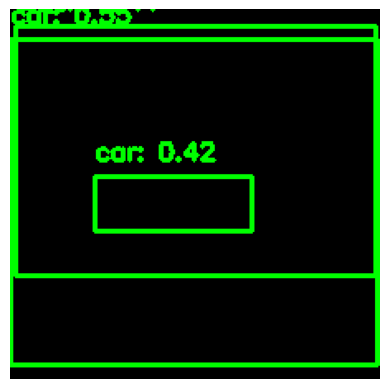

Frame 117, Label: 3, Score: 0.5487534999847412
Frame 117, Label: 3, Score: 0.41845813393592834
Frame 117, Label: 8, Score: 0.407226026058197


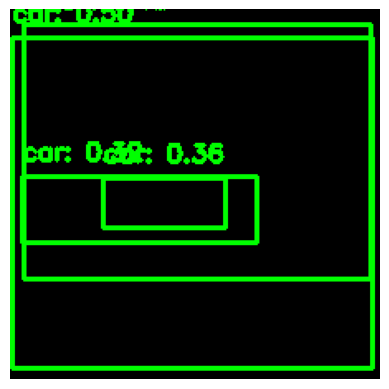

Frame 118, Label: 3, Score: 0.5042879581451416
Frame 118, Label: 8, Score: 0.42654481530189514
Frame 118, Label: 3, Score: 0.35544323921203613
Frame 118, Label: 3, Score: 0.32153862714767456


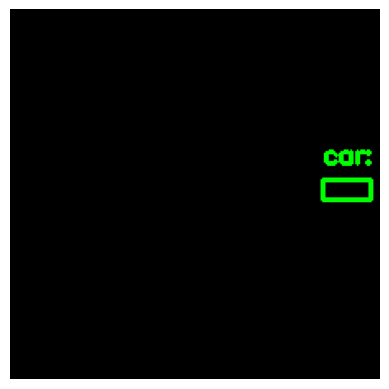

Frame 119, Label: 3, Score: 0.37271183729171753


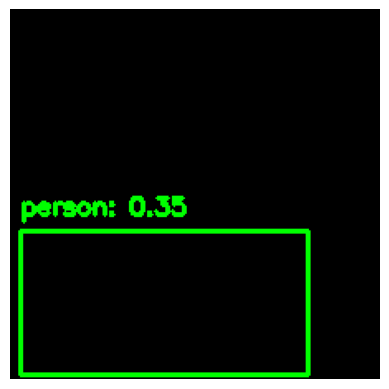

Frame 120, Label: 1, Score: 0.34706318378448486


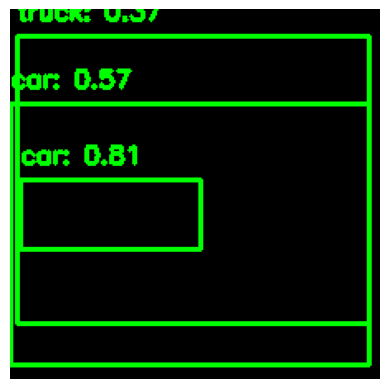

Frame 121, Label: 3, Score: 0.8094383478164673
Frame 121, Label: 3, Score: 0.5662938952445984
Frame 121, Label: 8, Score: 0.3663023114204407


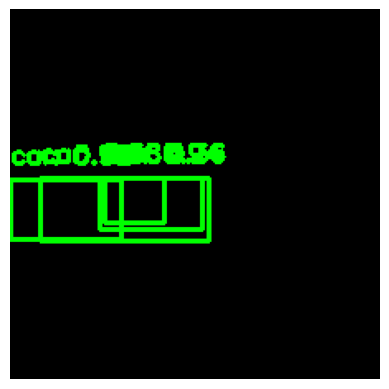

Frame 122, Label: 3, Score: 0.9423366189002991
Frame 122, Label: 3, Score: 0.9202706217765808
Frame 122, Label: 3, Score: 0.5848586559295654
Frame 122, Label: 3, Score: 0.35720688104629517


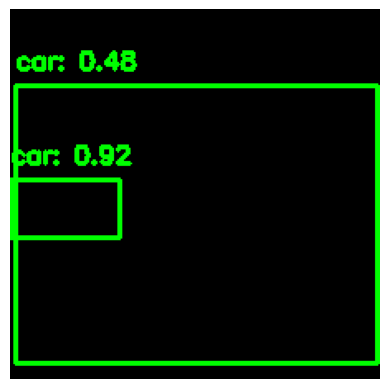

Frame 123, Label: 3, Score: 0.9247639775276184
Frame 123, Label: 3, Score: 0.48234879970550537


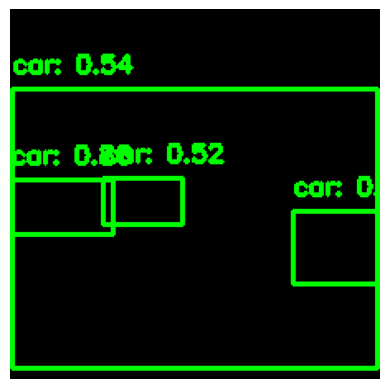

Frame 124, Label: 3, Score: 0.8629204630851746
Frame 124, Label: 3, Score: 0.5446211099624634
Frame 124, Label: 3, Score: 0.5179679989814758
Frame 124, Label: 3, Score: 0.3608524799346924


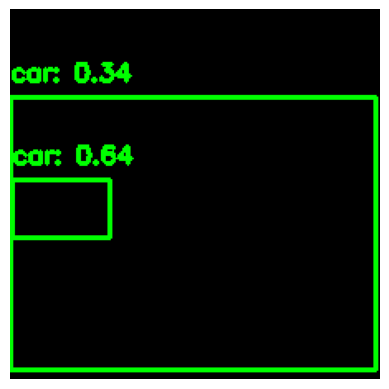

Frame 125, Label: 3, Score: 0.6419445276260376
Frame 125, Label: 3, Score: 0.33645230531692505


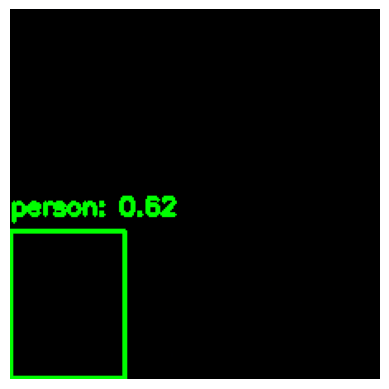

Frame 126, Label: 1, Score: 0.622767984867096


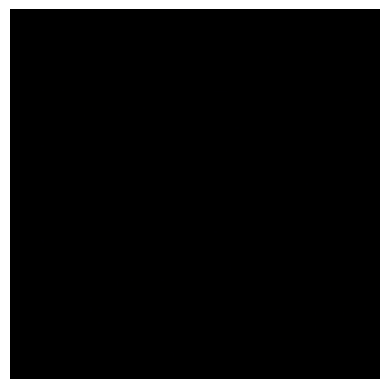

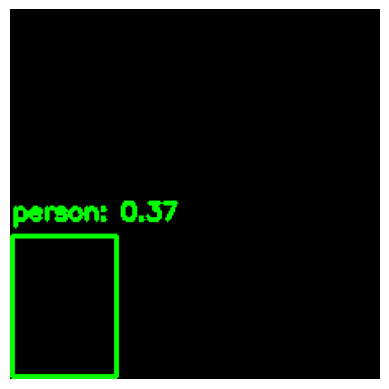

Frame 128, Label: 1, Score: 0.3725515604019165


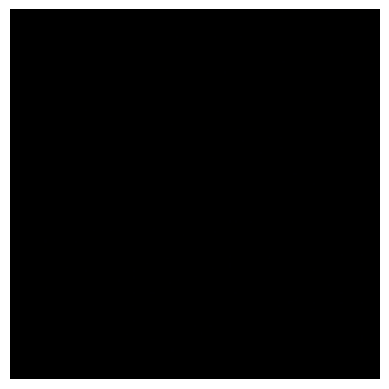

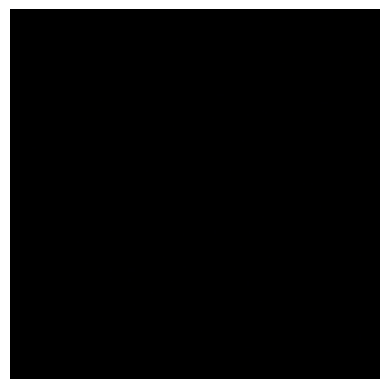

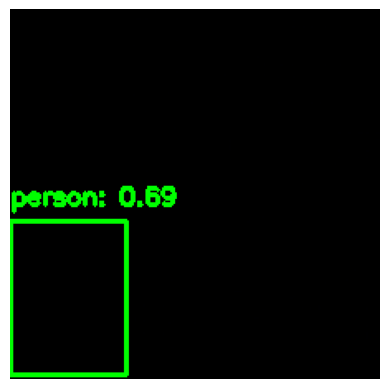

Frame 131, Label: 1, Score: 0.6947267651557922


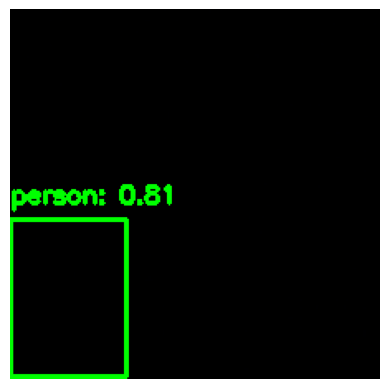

Frame 132, Label: 1, Score: 0.814256489276886


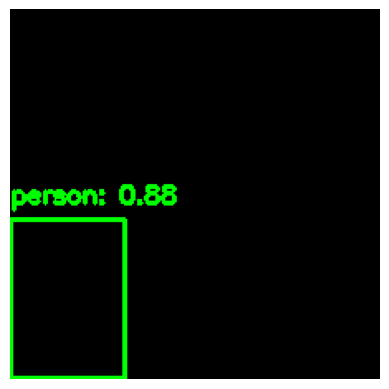

Frame 133, Label: 1, Score: 0.8796240091323853


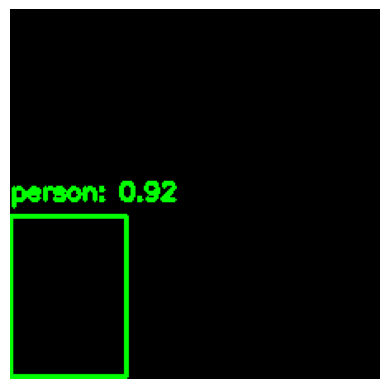

Frame 134, Label: 1, Score: 0.9179831147193909


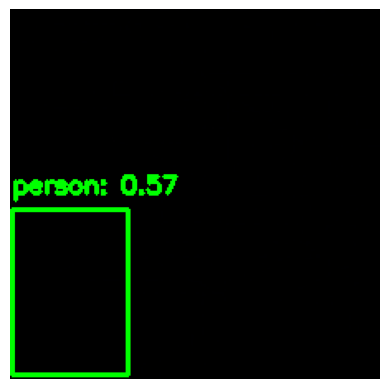

Frame 135, Label: 1, Score: 0.5677768588066101


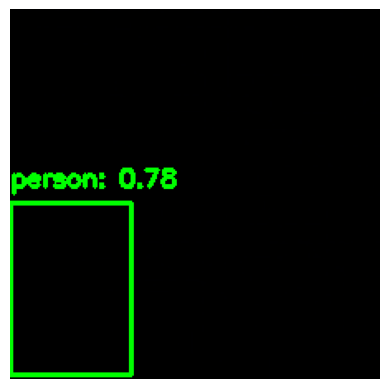

Frame 136, Label: 1, Score: 0.7848056554794312


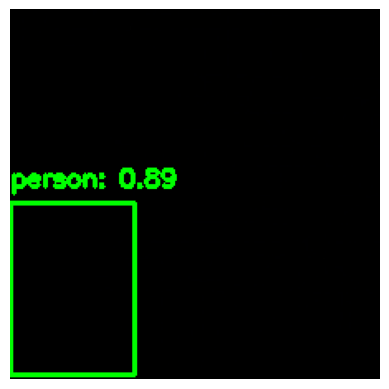

Frame 137, Label: 1, Score: 0.8904309868812561


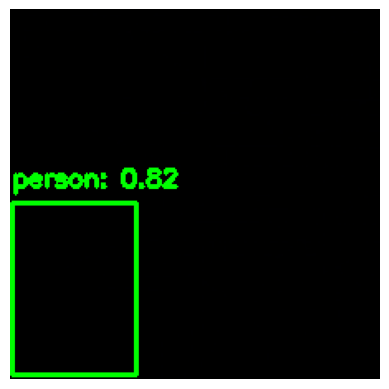

Frame 138, Label: 1, Score: 0.8232681155204773


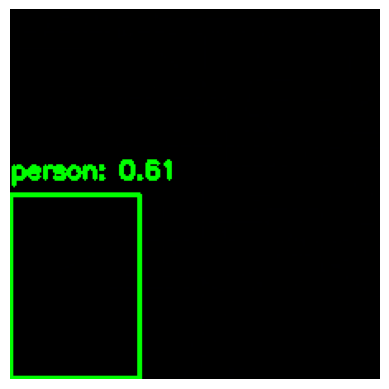

Frame 139, Label: 1, Score: 0.6079015731811523


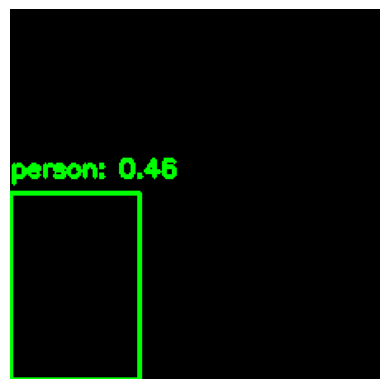

Frame 140, Label: 1, Score: 0.4555126428604126


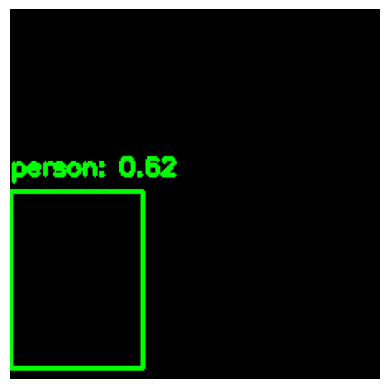

Frame 141, Label: 1, Score: 0.6229134202003479


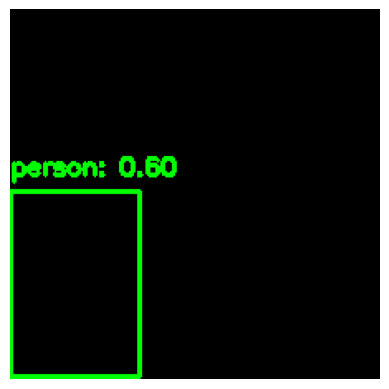

Frame 142, Label: 1, Score: 0.6041434407234192


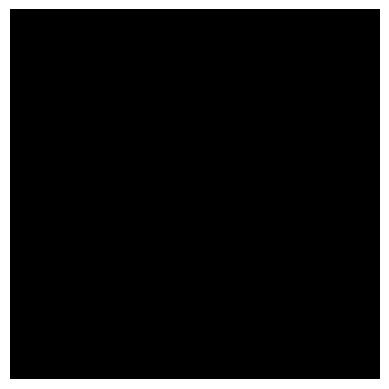

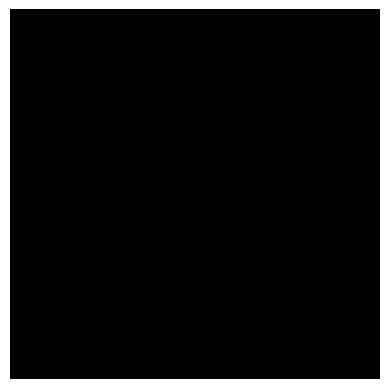

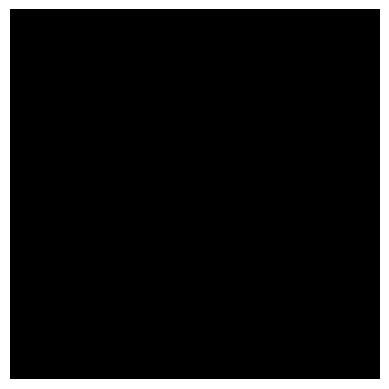

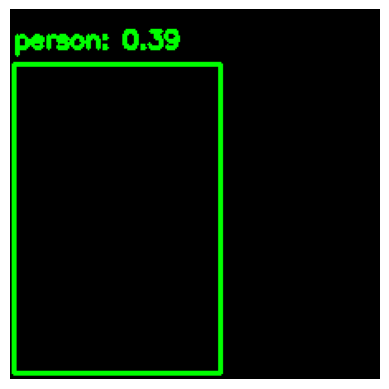

Frame 146, Label: 1, Score: 0.38722479343414307


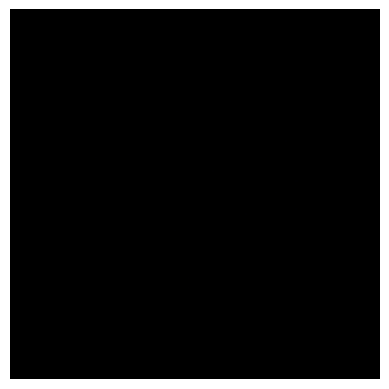

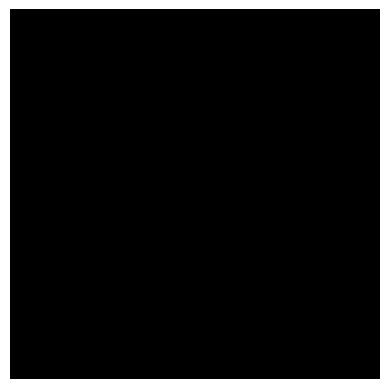

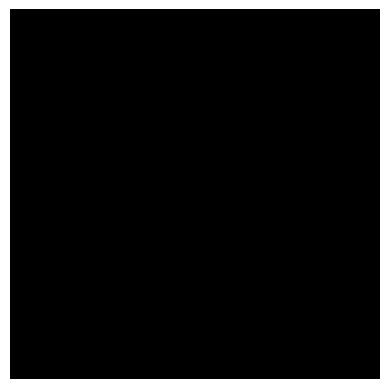

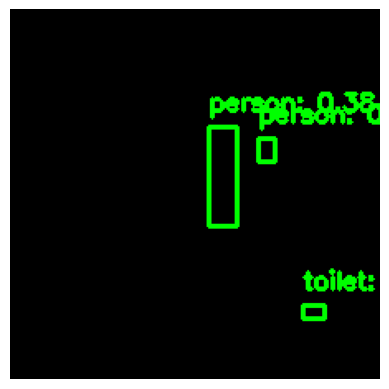

Frame 150, Label: 1, Score: 0.6836416125297546
Frame 150, Label: 62, Score: 0.6462225317955017
Frame 150, Label: 1, Score: 0.37581223249435425


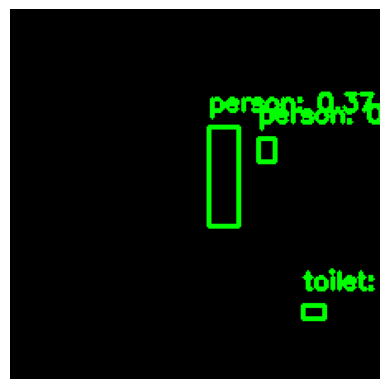

Frame 151, Label: 1, Score: 0.679398775100708
Frame 151, Label: 62, Score: 0.6446026563644409
Frame 151, Label: 1, Score: 0.36563384532928467


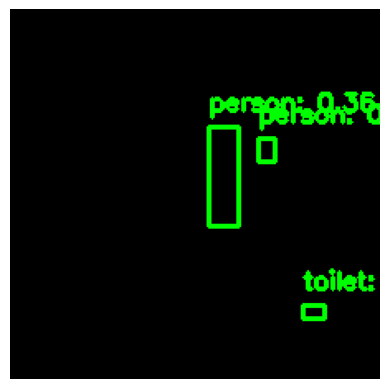

Frame 152, Label: 1, Score: 0.6798214912414551
Frame 152, Label: 62, Score: 0.6442693471908569
Frame 152, Label: 1, Score: 0.36300429701805115


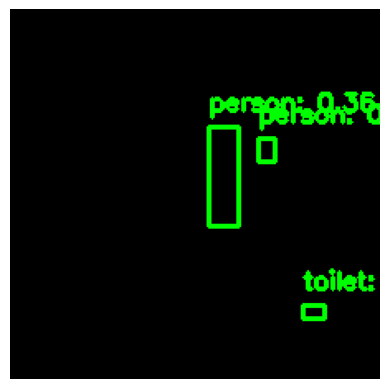

Frame 153, Label: 1, Score: 0.6798161864280701
Frame 153, Label: 62, Score: 0.644137442111969
Frame 153, Label: 1, Score: 0.3636833429336548


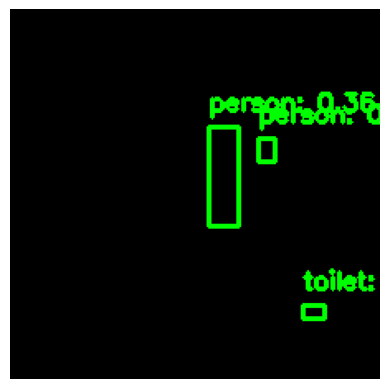

Frame 154, Label: 1, Score: 0.6798068881034851
Frame 154, Label: 62, Score: 0.6446276307106018
Frame 154, Label: 1, Score: 0.3641637861728668


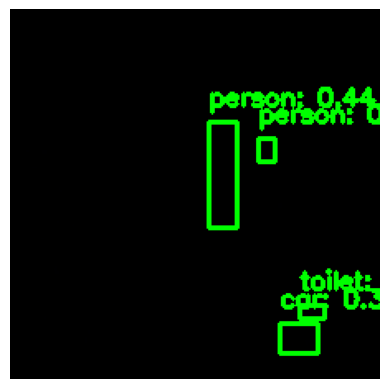

Frame 155, Label: 1, Score: 0.7292133569717407
Frame 155, Label: 62, Score: 0.6262049078941345
Frame 155, Label: 1, Score: 0.4392591714859009
Frame 155, Label: 3, Score: 0.36936670541763306


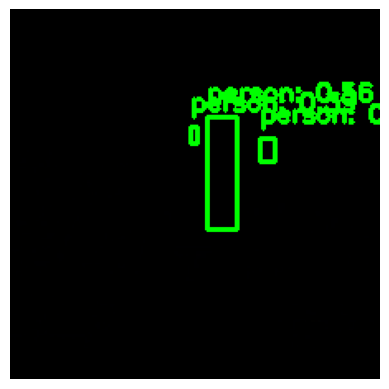

Frame 156, Label: 1, Score: 0.631037175655365
Frame 156, Label: 1, Score: 0.5564172267913818
Frame 156, Label: 1, Score: 0.3879747986793518


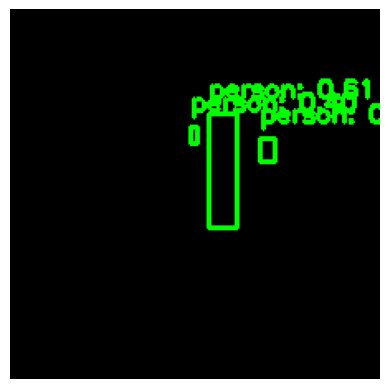

Frame 157, Label: 1, Score: 0.6208270192146301
Frame 157, Label: 1, Score: 0.6146669387817383
Frame 157, Label: 1, Score: 0.3979476988315582


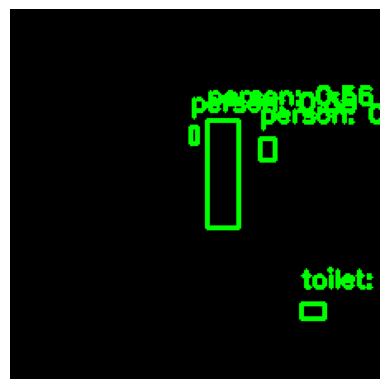

Frame 158, Label: 1, Score: 0.6872559785842896
Frame 158, Label: 62, Score: 0.671062707901001
Frame 158, Label: 1, Score: 0.5607089400291443
Frame 158, Label: 1, Score: 0.37537524104118347


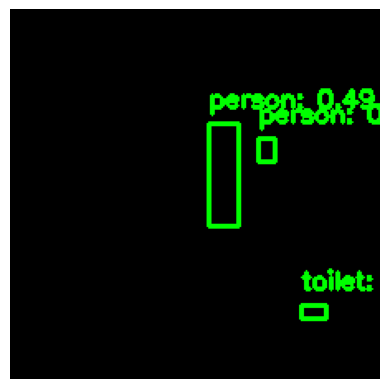

Frame 159, Label: 1, Score: 0.7366107106208801
Frame 159, Label: 62, Score: 0.6276010870933533
Frame 159, Label: 1, Score: 0.48678040504455566


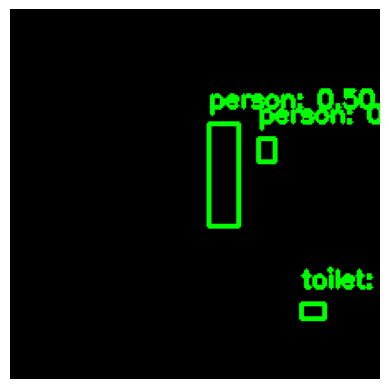

Frame 160, Label: 1, Score: 0.7723425030708313
Frame 160, Label: 62, Score: 0.6273138523101807
Frame 160, Label: 1, Score: 0.5048522353172302


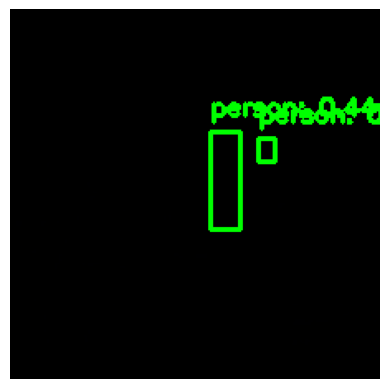

Frame 161, Label: 1, Score: 0.7146397829055786
Frame 161, Label: 1, Score: 0.4366261661052704


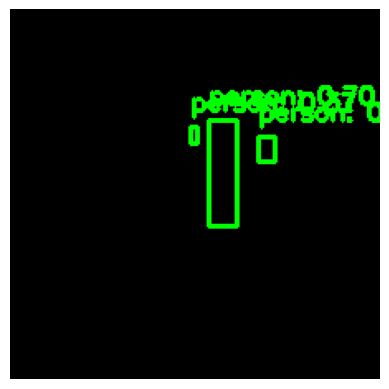

Frame 162, Label: 1, Score: 0.7548065781593323
Frame 162, Label: 1, Score: 0.7046741247177124
Frame 162, Label: 1, Score: 0.3715377449989319


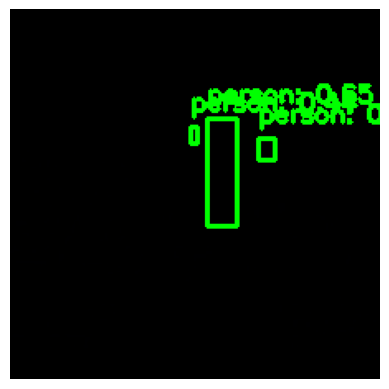

Frame 163, Label: 1, Score: 0.7513587474822998
Frame 163, Label: 1, Score: 0.6467732191085815
Frame 163, Label: 1, Score: 0.4397006928920746


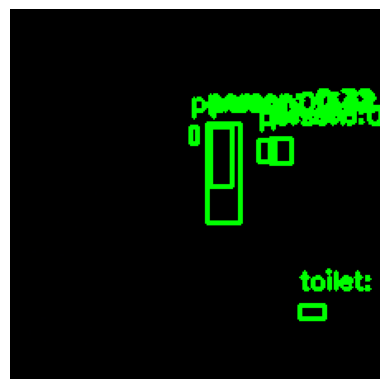

Frame 164, Label: 1, Score: 0.7840813398361206
Frame 164, Label: 1, Score: 0.7198677659034729
Frame 164, Label: 62, Score: 0.5234329104423523
Frame 164, Label: 1, Score: 0.33634522557258606
Frame 164, Label: 1, Score: 0.32414379715919495
Frame 164, Label: 1, Score: 0.3167020082473755


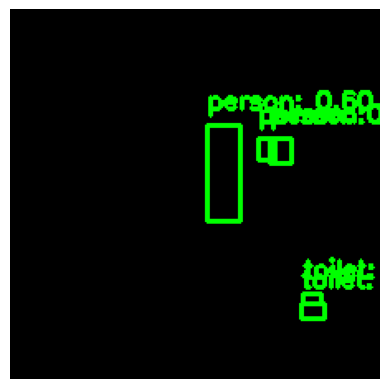

Frame 165, Label: 1, Score: 0.7199074625968933
Frame 165, Label: 1, Score: 0.5973506569862366
Frame 165, Label: 62, Score: 0.5815203785896301
Frame 165, Label: 62, Score: 0.38705551624298096
Frame 165, Label: 1, Score: 0.330381840467453


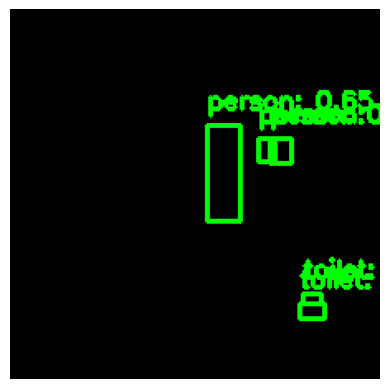

Frame 166, Label: 1, Score: 0.7396007776260376
Frame 166, Label: 1, Score: 0.6492298245429993
Frame 166, Label: 62, Score: 0.5599662661552429
Frame 166, Label: 62, Score: 0.4106827974319458
Frame 166, Label: 1, Score: 0.32837000489234924


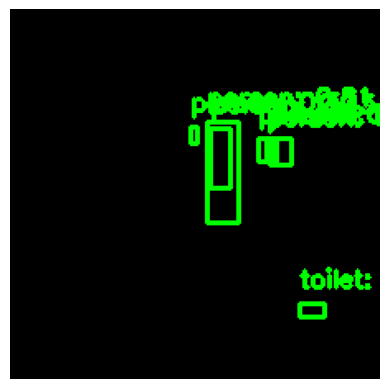

Frame 167, Label: 1, Score: 0.8059594631195068
Frame 167, Label: 1, Score: 0.7916689515113831
Frame 167, Label: 62, Score: 0.5225123763084412
Frame 167, Label: 1, Score: 0.5131646990776062
Frame 167, Label: 1, Score: 0.44827142357826233
Frame 167, Label: 1, Score: 0.3039349317550659
Frame 167, Label: 1, Score: 0.301985502243042


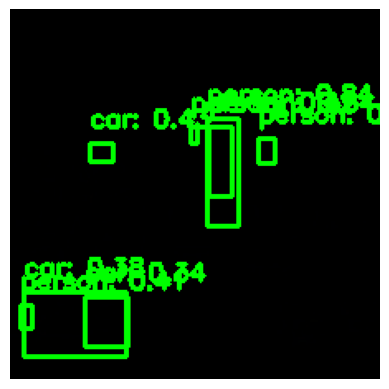

Frame 168, Label: 1, Score: 0.8432348370552063
Frame 168, Label: 1, Score: 0.7983765006065369
Frame 168, Label: 1, Score: 0.5374059677124023
Frame 168, Label: 3, Score: 0.43290773034095764
Frame 168, Label: 1, Score: 0.41674211621284485
Frame 168, Label: 1, Score: 0.4086580276489258
Frame 168, Label: 3, Score: 0.3773975968360901
Frame 168, Label: 3, Score: 0.33616599440574646


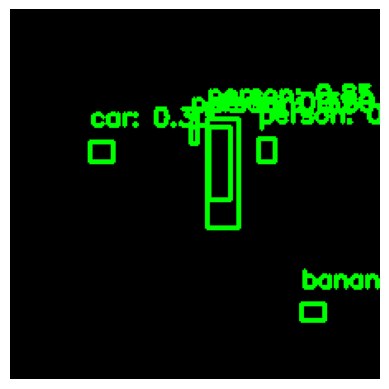

Frame 169, Label: 1, Score: 0.8537483811378479
Frame 169, Label: 1, Score: 0.752500593662262
Frame 169, Label: 1, Score: 0.5004627704620361
Frame 169, Label: 1, Score: 0.320353627204895
Frame 169, Label: 47, Score: 0.3034505844116211
Frame 169, Label: 3, Score: 0.3006611764431


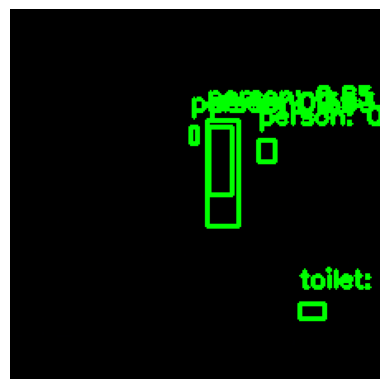

Frame 170, Label: 1, Score: 0.8487929701805115
Frame 170, Label: 1, Score: 0.749944269657135
Frame 170, Label: 62, Score: 0.5351893901824951
Frame 170, Label: 1, Score: 0.5286518335342407
Frame 170, Label: 1, Score: 0.4345208406448364


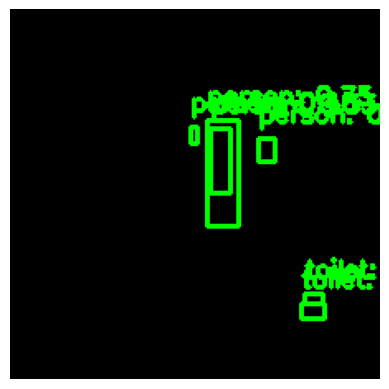

Frame 171, Label: 1, Score: 0.760370135307312
Frame 171, Label: 1, Score: 0.7452749609947205
Frame 171, Label: 62, Score: 0.6359512805938721
Frame 171, Label: 1, Score: 0.455485075712204
Frame 171, Label: 1, Score: 0.3288695812225342
Frame 171, Label: 62, Score: 0.3091233968734741


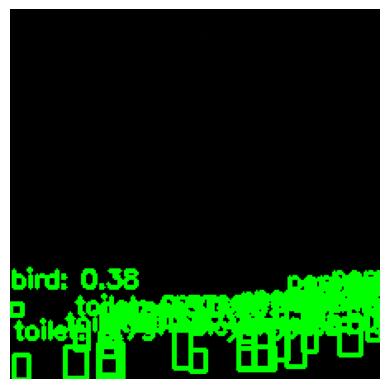

Frame 172, Label: 1, Score: 0.9877938628196716
Frame 172, Label: 1, Score: 0.9855934977531433
Frame 172, Label: 1, Score: 0.9737619757652283
Frame 172, Label: 1, Score: 0.9507142305374146
Frame 172, Label: 1, Score: 0.9191910028457642
Frame 172, Label: 1, Score: 0.9012160301208496
Frame 172, Label: 1, Score: 0.8979280591011047
Frame 172, Label: 1, Score: 0.8909353613853455
Frame 172, Label: 62, Score: 0.7902435064315796
Frame 172, Label: 1, Score: 0.7859262824058533
Frame 172, Label: 62, Score: 0.640019953250885
Frame 172, Label: 1, Score: 0.4670514762401581
Frame 172, Label: 2, Score: 0.4666251242160797
Frame 172, Label: 1, Score: 0.44378751516342163
Frame 172, Label: 15, Score: 0.38109737634658813
Frame 172, Label: 1, Score: 0.3752457797527313
Frame 172, Label: 62, Score: 0.37318798899650574
Frame 172, Label: 15, Score: 0.3683580458164215
Frame 172, Label: 1, Score: 0.3388749659061432
Frame 172, Label: 19, Score: 0.3277764618396759
Frame 172, Label: 2, Score: 0.32309961318969727
Fram

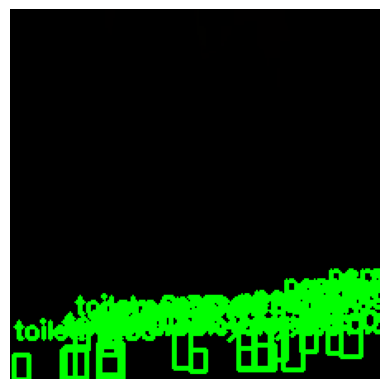

Frame 173, Label: 1, Score: 0.9882533550262451
Frame 173, Label: 1, Score: 0.9869182705879211
Frame 173, Label: 1, Score: 0.9863566160202026
Frame 173, Label: 1, Score: 0.9478737711906433
Frame 173, Label: 1, Score: 0.9467288255691528
Frame 173, Label: 1, Score: 0.8983134031295776
Frame 173, Label: 1, Score: 0.8483509421348572
Frame 173, Label: 1, Score: 0.809680700302124
Frame 173, Label: 62, Score: 0.7982470989227295
Frame 173, Label: 1, Score: 0.6932545304298401
Frame 173, Label: 1, Score: 0.6746145486831665
Frame 173, Label: 62, Score: 0.6071435213088989
Frame 173, Label: 2, Score: 0.49509555101394653
Frame 173, Label: 62, Score: 0.3805661201477051
Frame 173, Label: 1, Score: 0.3769967257976532
Frame 173, Label: 15, Score: 0.34533581137657166
Frame 173, Label: 62, Score: 0.3284611105918884
Frame 173, Label: 2, Score: 0.3131008446216583
Frame 173, Label: 19, Score: 0.3050329387187958
Frame 173, Label: 2, Score: 0.3024005889892578


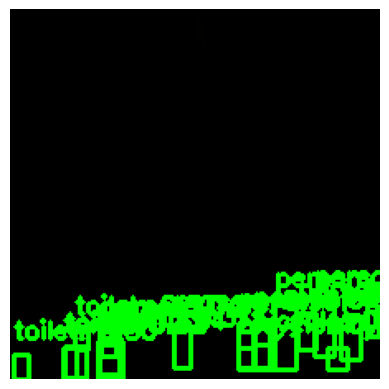

Frame 174, Label: 1, Score: 0.9882299900054932
Frame 174, Label: 1, Score: 0.9859331250190735
Frame 174, Label: 1, Score: 0.9756072759628296
Frame 174, Label: 1, Score: 0.9611555337905884
Frame 174, Label: 1, Score: 0.9577531218528748
Frame 174, Label: 1, Score: 0.9203398823738098
Frame 174, Label: 1, Score: 0.8931986093521118
Frame 174, Label: 1, Score: 0.8889500498771667
Frame 174, Label: 1, Score: 0.8435630798339844
Frame 174, Label: 62, Score: 0.8008230924606323
Frame 174, Label: 1, Score: 0.596208393573761
Frame 174, Label: 62, Score: 0.552953839302063
Frame 174, Label: 2, Score: 0.48106303811073303
Frame 174, Label: 2, Score: 0.404684454202652
Frame 174, Label: 2, Score: 0.37308934330940247
Frame 174, Label: 62, Score: 0.36946290731430054
Frame 174, Label: 15, Score: 0.336114764213562
Frame 174, Label: 62, Score: 0.320961594581604
Frame 174, Label: 19, Score: 0.30853334069252014


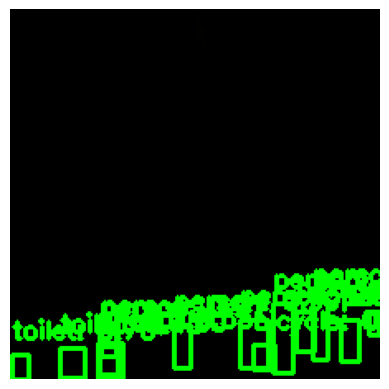

Frame 175, Label: 1, Score: 0.9898847341537476
Frame 175, Label: 1, Score: 0.9880556464195251
Frame 175, Label: 1, Score: 0.9681742191314697
Frame 175, Label: 1, Score: 0.9640605449676514
Frame 175, Label: 1, Score: 0.9632163643836975
Frame 175, Label: 1, Score: 0.9089915752410889
Frame 175, Label: 1, Score: 0.905690610408783
Frame 175, Label: 1, Score: 0.8522575497627258
Frame 175, Label: 62, Score: 0.7631617784500122
Frame 175, Label: 1, Score: 0.6483575701713562
Frame 175, Label: 19, Score: 0.5333983302116394
Frame 175, Label: 62, Score: 0.4548010528087616
Frame 175, Label: 2, Score: 0.43340182304382324
Frame 175, Label: 15, Score: 0.3049473464488983


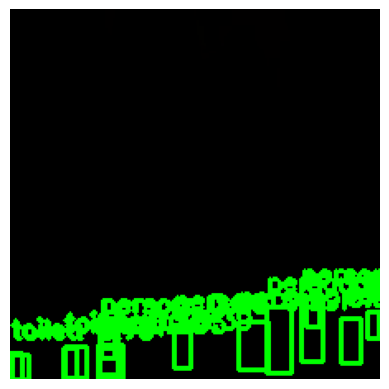

Frame 176, Label: 1, Score: 0.9927071928977966
Frame 176, Label: 1, Score: 0.9875651001930237
Frame 176, Label: 1, Score: 0.9845051169395447
Frame 176, Label: 1, Score: 0.9731408953666687
Frame 176, Label: 1, Score: 0.9396229386329651
Frame 176, Label: 1, Score: 0.8846980929374695
Frame 176, Label: 1, Score: 0.856656014919281
Frame 176, Label: 62, Score: 0.7857885360717773
Frame 176, Label: 62, Score: 0.5318045020103455
Frame 176, Label: 15, Score: 0.4509548544883728
Frame 176, Label: 62, Score: 0.4277561902999878
Frame 176, Label: 19, Score: 0.39073115587234497
Frame 176, Label: 1, Score: 0.32021668553352356
Frame 176, Label: 27, Score: 0.31816819310188293
Frame 176, Label: 62, Score: 0.3032712936401367


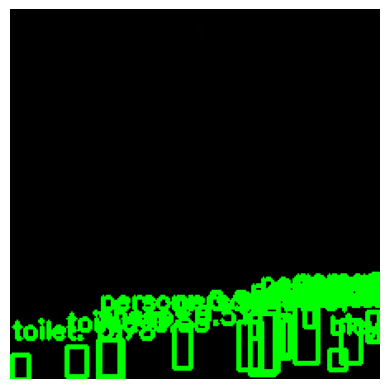

Frame 177, Label: 1, Score: 0.9876936674118042
Frame 177, Label: 1, Score: 0.9850289225578308
Frame 177, Label: 1, Score: 0.9834313988685608
Frame 177, Label: 1, Score: 0.9678695797920227
Frame 177, Label: 1, Score: 0.9271072149276733
Frame 177, Label: 1, Score: 0.8844522833824158
Frame 177, Label: 62, Score: 0.7758854627609253
Frame 177, Label: 1, Score: 0.7255547642707825
Frame 177, Label: 1, Score: 0.6804656982421875
Frame 177, Label: 62, Score: 0.5830480456352234
Frame 177, Label: 27, Score: 0.5193787217140198
Frame 177, Label: 19, Score: 0.5120143890380859
Frame 177, Label: 1, Score: 0.5041652917861938
Frame 177, Label: 2, Score: 0.4600153863430023
Frame 177, Label: 1, Score: 0.38575127720832825
Frame 177, Label: 1, Score: 0.33861491084098816


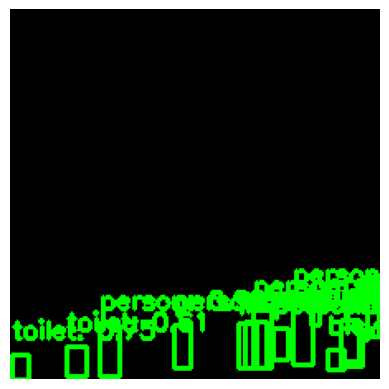

Frame 178, Label: 1, Score: 0.9894412755966187
Frame 178, Label: 1, Score: 0.9888806343078613
Frame 178, Label: 1, Score: 0.9870294332504272
Frame 178, Label: 1, Score: 0.9849869608879089
Frame 178, Label: 1, Score: 0.9711177945137024
Frame 178, Label: 1, Score: 0.8295649290084839
Frame 178, Label: 62, Score: 0.7543737292289734
Frame 178, Label: 62, Score: 0.6065455675125122
Frame 178, Label: 1, Score: 0.5917006134986877
Frame 178, Label: 1, Score: 0.4537672996520996
Frame 178, Label: 1, Score: 0.3728952407836914
Frame 178, Label: 1, Score: 0.3656314015388489
Frame 178, Label: 2, Score: 0.3510574400424957
Frame 178, Label: 19, Score: 0.34459778666496277


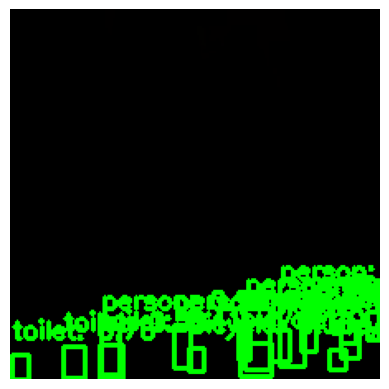

Frame 179, Label: 1, Score: 0.9901643395423889
Frame 179, Label: 1, Score: 0.9795892834663391
Frame 179, Label: 1, Score: 0.9668552279472351
Frame 179, Label: 1, Score: 0.9652290940284729
Frame 179, Label: 1, Score: 0.9332327246665955
Frame 179, Label: 1, Score: 0.8400755524635315
Frame 179, Label: 2, Score: 0.7915849685668945
Frame 179, Label: 62, Score: 0.7565159797668457
Frame 179, Label: 2, Score: 0.7236145734786987
Frame 179, Label: 1, Score: 0.6082293391227722
Frame 179, Label: 1, Score: 0.6080337166786194
Frame 179, Label: 1, Score: 0.5805761814117432
Frame 179, Label: 1, Score: 0.5224179625511169
Frame 179, Label: 62, Score: 0.5020673274993896
Frame 179, Label: 2, Score: 0.4292180836200714
Frame 179, Label: 62, Score: 0.40972983837127686
Frame 179, Label: 1, Score: 0.35638725757598877
Frame 179, Label: 2, Score: 0.30033963918685913


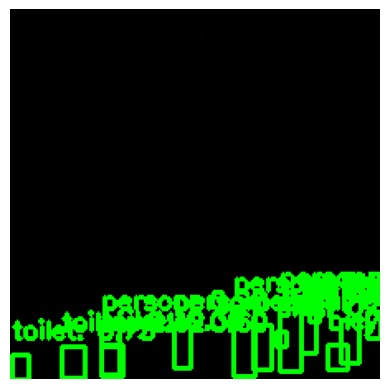

Frame 180, Label: 1, Score: 0.9898199439048767
Frame 180, Label: 1, Score: 0.9879135489463806
Frame 180, Label: 1, Score: 0.9832874536514282
Frame 180, Label: 1, Score: 0.975534200668335
Frame 180, Label: 1, Score: 0.9515353441238403
Frame 180, Label: 1, Score: 0.9004977941513062
Frame 180, Label: 1, Score: 0.7917017936706543
Frame 180, Label: 62, Score: 0.7500543594360352
Frame 180, Label: 1, Score: 0.6684339642524719
Frame 180, Label: 2, Score: 0.6003521680831909
Frame 180, Label: 1, Score: 0.564738392829895
Frame 180, Label: 31, Score: 0.5384225249290466
Frame 180, Label: 2, Score: 0.5195911526679993
Frame 180, Label: 62, Score: 0.4156728684902191
Frame 180, Label: 62, Score: 0.3018683195114136


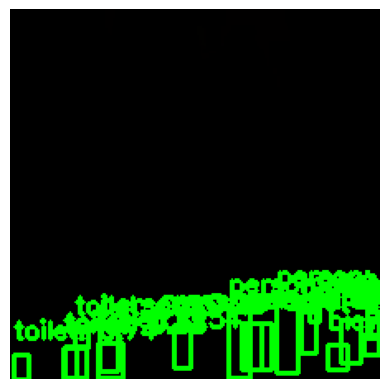

Frame 181, Label: 1, Score: 0.9947027564048767
Frame 181, Label: 1, Score: 0.9891770482063293
Frame 181, Label: 1, Score: 0.9812256693840027
Frame 181, Label: 1, Score: 0.9575055837631226
Frame 181, Label: 1, Score: 0.9537087678909302
Frame 181, Label: 1, Score: 0.9522330164909363
Frame 181, Label: 1, Score: 0.9266119003295898
Frame 181, Label: 62, Score: 0.7387397289276123
Frame 181, Label: 62, Score: 0.6654866337776184
Frame 181, Label: 1, Score: 0.6119895577430725
Frame 181, Label: 62, Score: 0.5362542271614075
Frame 181, Label: 1, Score: 0.5300431251525879
Frame 181, Label: 2, Score: 0.4903111457824707
Frame 181, Label: 1, Score: 0.46476462483406067
Frame 181, Label: 62, Score: 0.375846266746521
Frame 181, Label: 3, Score: 0.373016357421875
Frame 181, Label: 62, Score: 0.3494046628475189


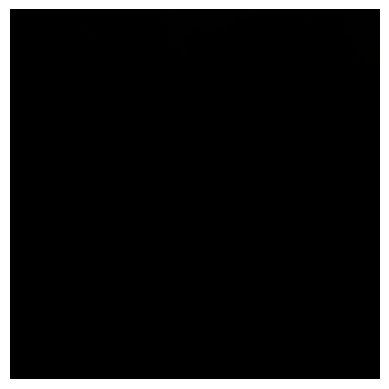

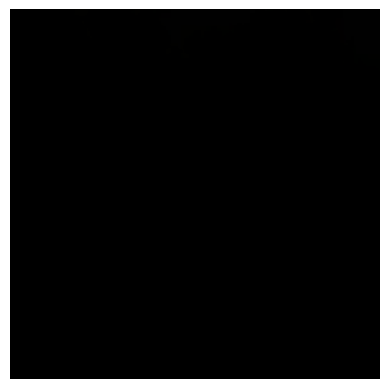

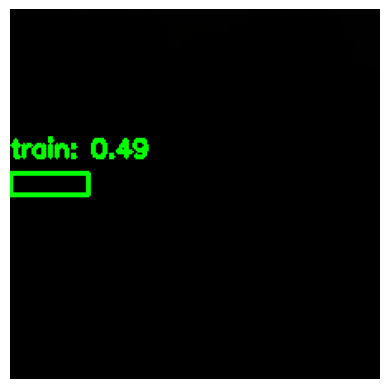

Frame 184, Label: 7, Score: 0.486913800239563


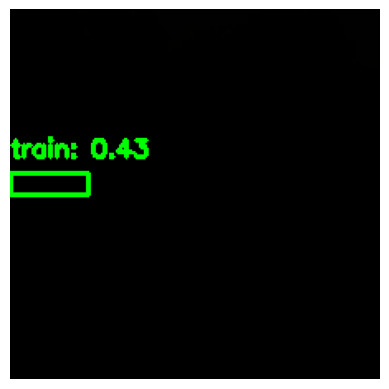

Frame 185, Label: 7, Score: 0.42769259214401245


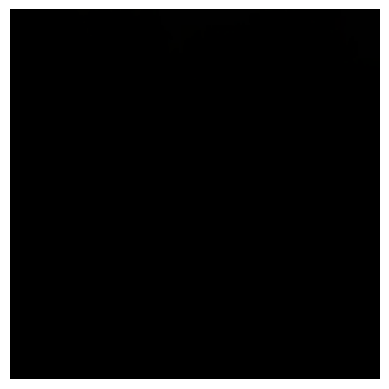

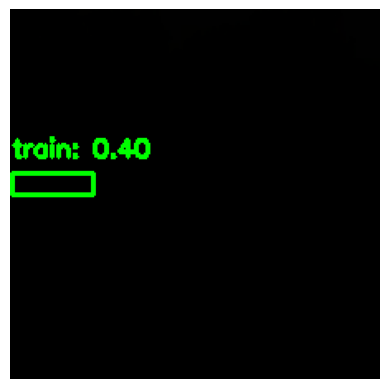

Frame 187, Label: 7, Score: 0.3990577161312103


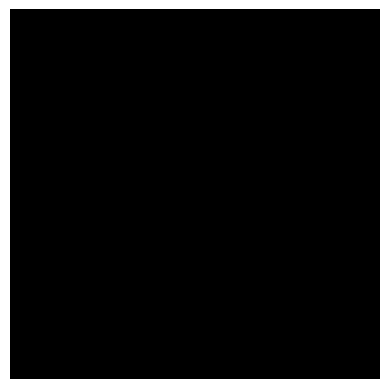

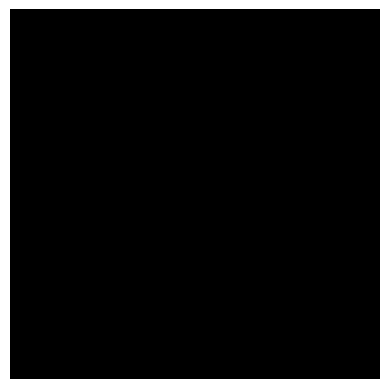

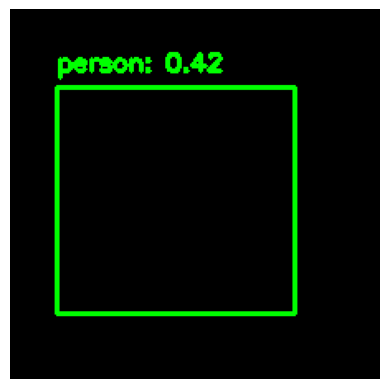

Frame 190, Label: 1, Score: 0.415811687707901


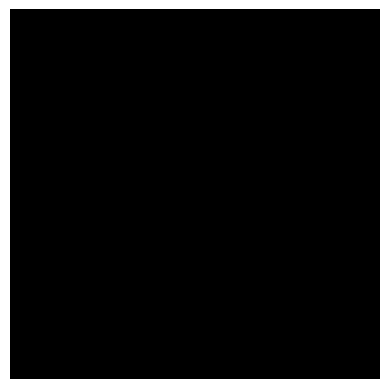

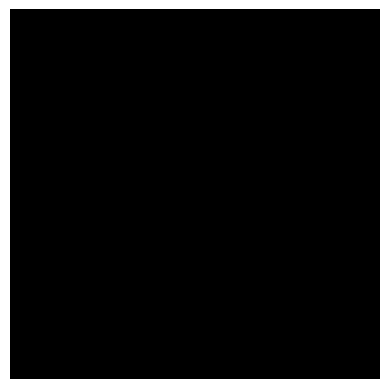

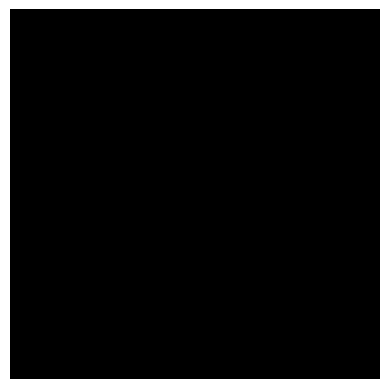

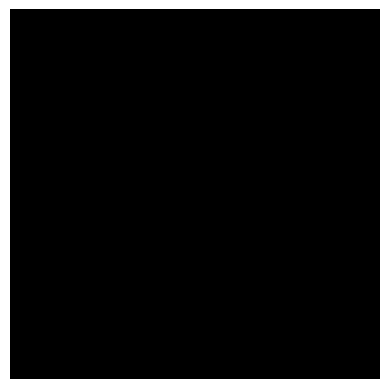

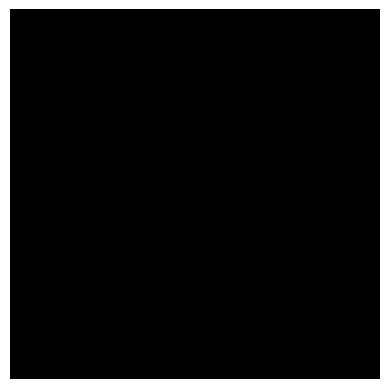

...

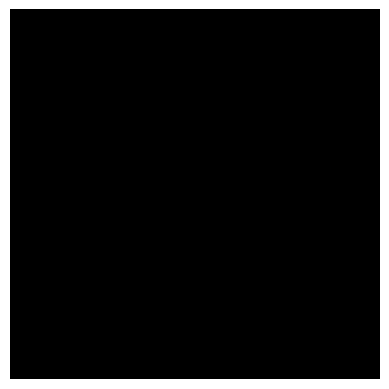

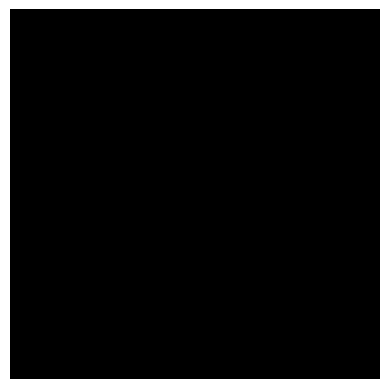

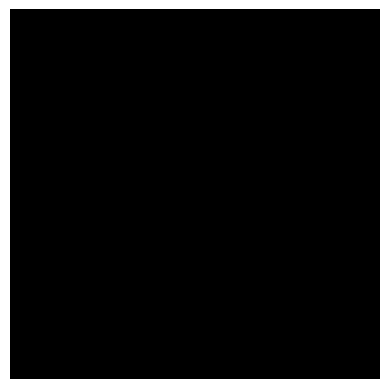

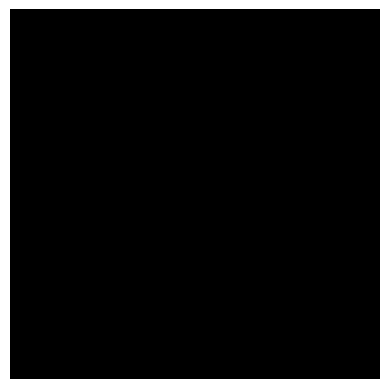

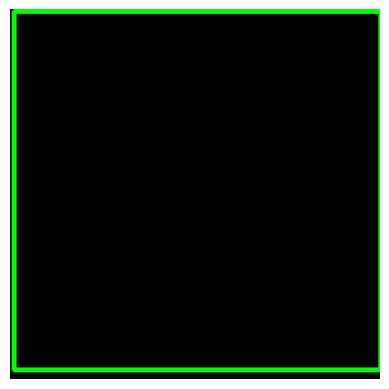

Frame 206, Label: 15, Score: 0.5945678353309631


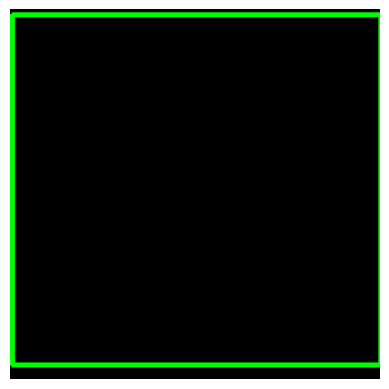

Frame 207, Label: 15, Score: 0.5387092232704163


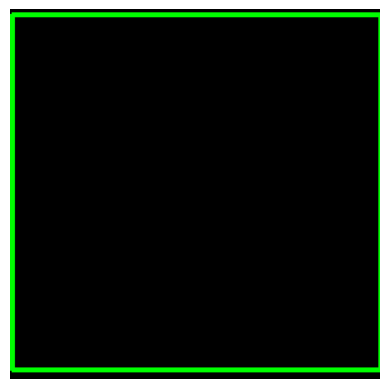

Frame 208, Label: 15, Score: 0.5634013414382935


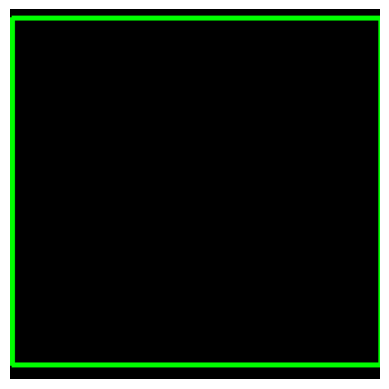

Frame 209, Label: 15, Score: 0.6311238408088684


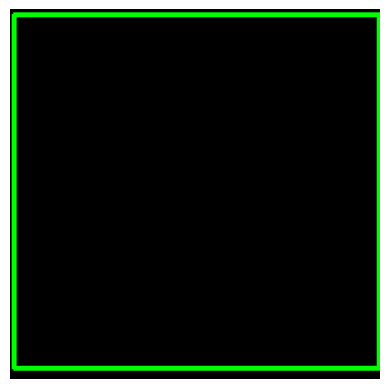

Frame 210, Label: 15, Score: 0.6285050511360168


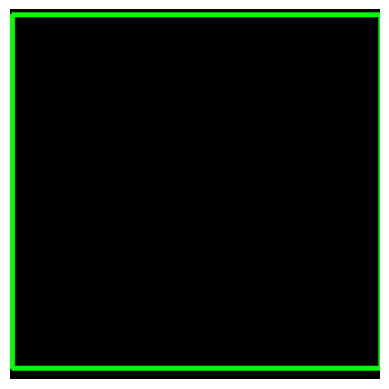

Frame 211, Label: 15, Score: 0.6957395076751709


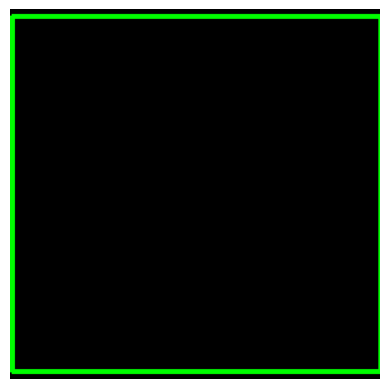

Frame 212, Label: 15, Score: 0.7282946705818176


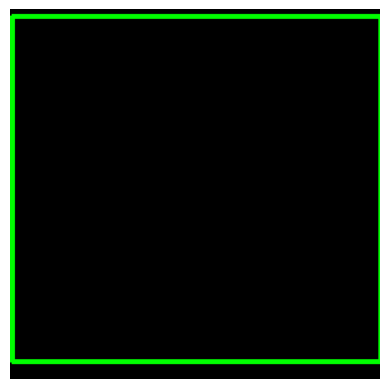

Frame 213, Label: 15, Score: 0.6551059484481812


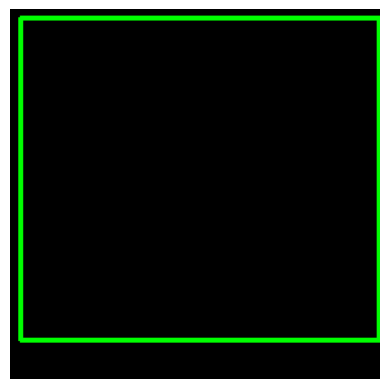

Frame 214, Label: 15, Score: 0.8237076997756958


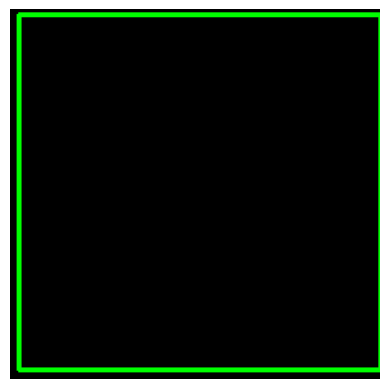

Frame 215, Label: 15, Score: 0.6412227153778076


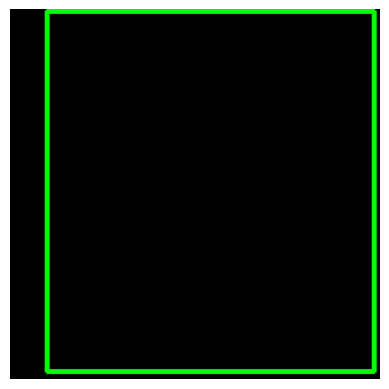

Frame 216, Label: 15, Score: 0.8732972741127014


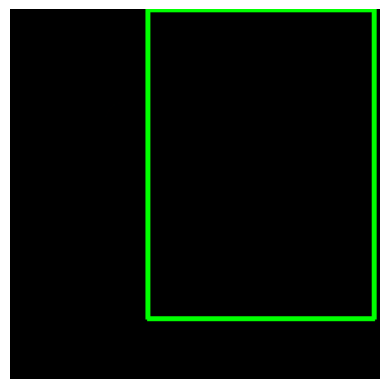

Frame 217, Label: 15, Score: 0.516427218914032


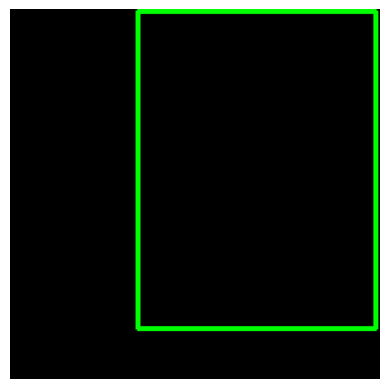

Frame 218, Label: 15, Score: 0.511001706123352


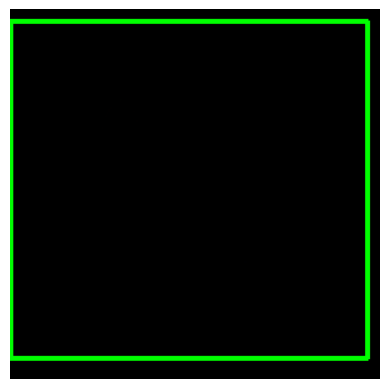

Frame 219, Label: 15, Score: 0.3678428530693054


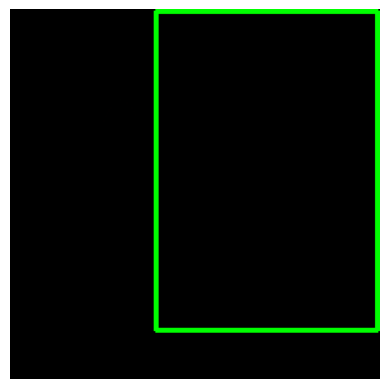

Frame 220, Label: 15, Score: 0.3748193085193634


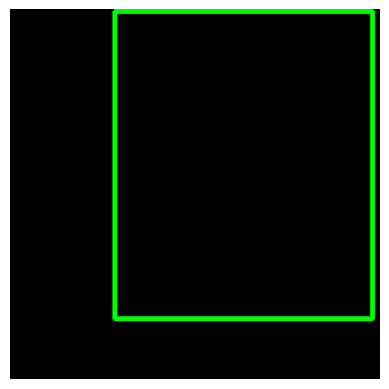

Frame 221, Label: 15, Score: 0.34489667415618896


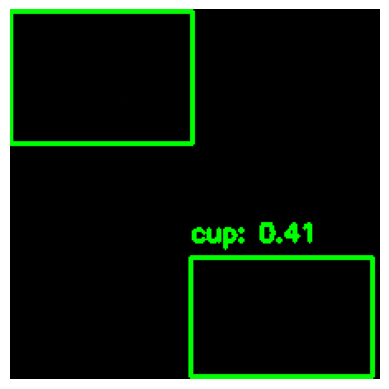

Frame 222, Label: 42, Score: 0.4118782877922058
Frame 222, Label: 61, Score: 0.3309548795223236


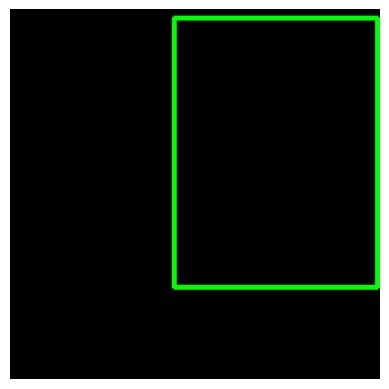

Frame 223, Label: 15, Score: 0.3106022775173187


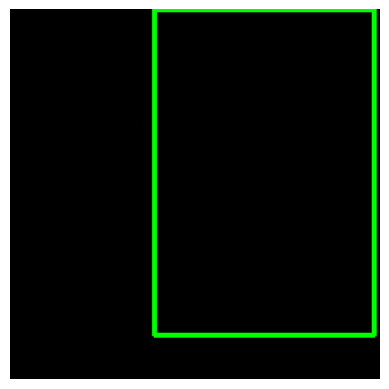

Frame 224, Label: 15, Score: 0.44875288009643555


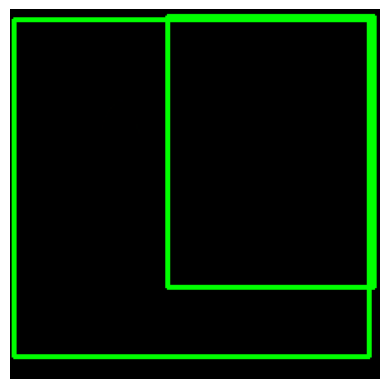

Frame 225, Label: 15, Score: 0.5429359078407288
Frame 225, Label: 15, Score: 0.3959040343761444


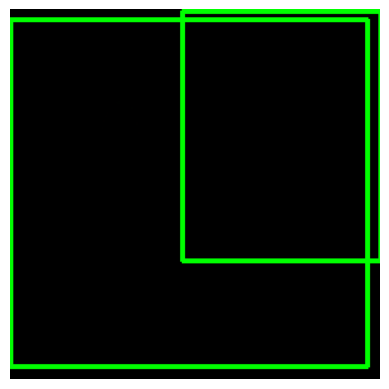

Frame 226, Label: 15, Score: 0.45521917939186096
Frame 226, Label: 15, Score: 0.35704830288887024


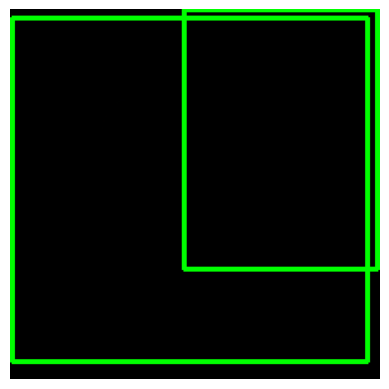

Frame 227, Label: 15, Score: 0.38921791315078735
Frame 227, Label: 15, Score: 0.34846583008766174


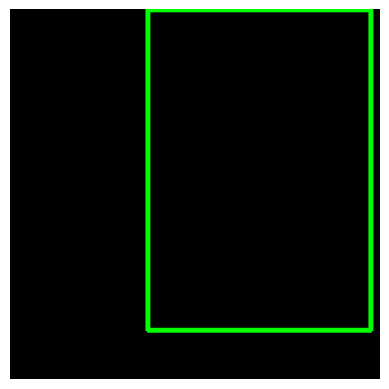

Frame 228, Label: 15, Score: 0.3484570384025574


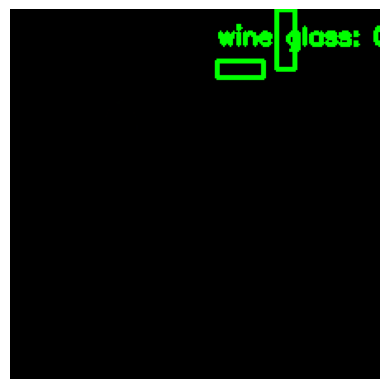

Frame 229, Label: 41, Score: 0.800910472869873
Frame 229, Label: 1, Score: 0.37226298451423645


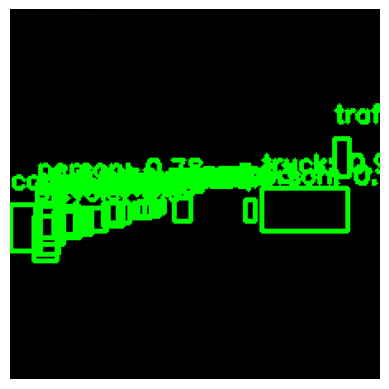

Frame 230, Label: 1, Score: 0.9818862676620483
Frame 230, Label: 3, Score: 0.9804512858390808
Frame 230, Label: 3, Score: 0.9802765846252441
Frame 230, Label: 3, Score: 0.9797277450561523
Frame 230, Label: 2, Score: 0.9704570174217224
Frame 230, Label: 3, Score: 0.9519951343536377
Frame 230, Label: 3, Score: 0.9465532898902893
Frame 230, Label: 3, Score: 0.9330040812492371
Frame 230, Label: 8, Score: 0.9240721464157104
Frame 230, Label: 10, Score: 0.9185478687286377
Frame 230, Label: 3, Score: 0.8609833121299744
Frame 230, Label: 3, Score: 0.8291143774986267
Frame 230, Label: 3, Score: 0.8071993589401245
Frame 230, Label: 1, Score: 0.7797666788101196
Frame 230, Label: 3, Score: 0.7636454701423645
Frame 230, Label: 3, Score: 0.7329149842262268
Frame 230, Label: 3, Score: 0.6671426296234131
Frame 230, Label: 3, Score: 0.4002399146556854
Frame 230, Label: 3, Score: 0.37465596199035645
Frame 230, Label: 3, Score: 0.3531506061553955


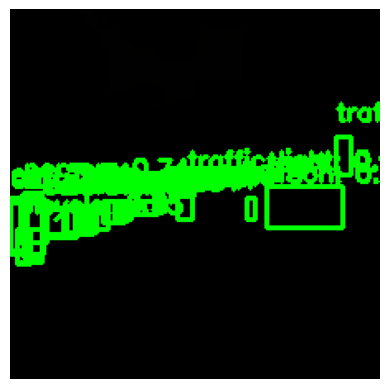

Frame 231, Label: 3, Score: 0.9908440709114075
Frame 231, Label: 3, Score: 0.976731538772583
Frame 231, Label: 1, Score: 0.9760143160820007
Frame 231, Label: 3, Score: 0.9709475040435791
Frame 231, Label: 2, Score: 0.9543061852455139
Frame 231, Label: 8, Score: 0.9462898969650269
Frame 231, Label: 10, Score: 0.9380298852920532
Frame 231, Label: 3, Score: 0.9350332617759705
Frame 231, Label: 3, Score: 0.8948349356651306
Frame 231, Label: 3, Score: 0.8938276171684265
Frame 231, Label: 3, Score: 0.8932373523712158
Frame 231, Label: 3, Score: 0.8723811507225037
Frame 231, Label: 3, Score: 0.8717021942138672
Frame 231, Label: 3, Score: 0.8421393036842346
Frame 231, Label: 3, Score: 0.8278127312660217
Frame 231, Label: 1, Score: 0.7371274828910828
Frame 231, Label: 3, Score: 0.5791866779327393
Frame 231, Label: 3, Score: 0.4331752061843872
Frame 231, Label: 3, Score: 0.3890879154205322
Frame 231, Label: 10, Score: 0.3831184208393097
Frame 231, Label: 3, Score: 0.37728941440582275
Frame 231, 

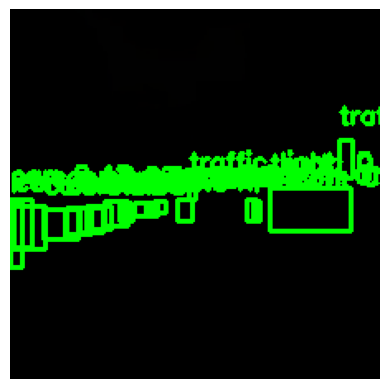

Frame 232, Label: 3, Score: 0.9920440912246704
Frame 232, Label: 1, Score: 0.9916529059410095
Frame 232, Label: 3, Score: 0.9805876016616821
Frame 232, Label: 3, Score: 0.9655469059944153
Frame 232, Label: 3, Score: 0.9651167988777161
Frame 232, Label: 10, Score: 0.95447838306427
Frame 232, Label: 3, Score: 0.9483755230903625
Frame 232, Label: 8, Score: 0.9439663290977478
Frame 232, Label: 3, Score: 0.9349803328514099
Frame 232, Label: 3, Score: 0.9261645078659058
Frame 232, Label: 3, Score: 0.9026049375534058
Frame 232, Label: 3, Score: 0.868537425994873
Frame 232, Label: 3, Score: 0.7492193579673767
Frame 232, Label: 3, Score: 0.7132428288459778
Frame 232, Label: 1, Score: 0.6926137804985046
Frame 232, Label: 10, Score: 0.5415012240409851
Frame 232, Label: 3, Score: 0.4247833490371704
Frame 232, Label: 3, Score: 0.38279715180397034
Frame 232, Label: 1, Score: 0.3509027063846588
Frame 232, Label: 3, Score: 0.33560749888420105


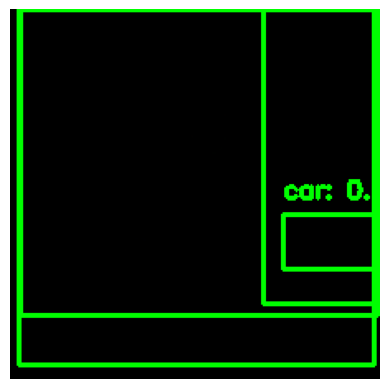

Frame 233, Label: 3, Score: 0.6333476901054382
Frame 233, Label: 6, Score: 0.5879522562026978
Frame 233, Label: 6, Score: 0.3139517307281494
Frame 233, Label: 7, Score: 0.3074290454387665


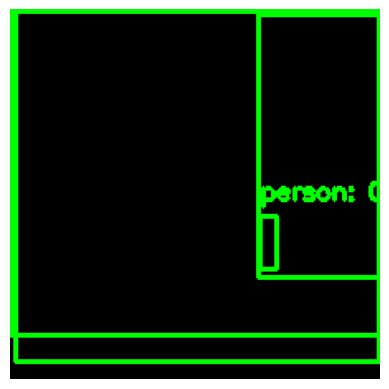

Frame 234, Label: 1, Score: 0.848140299320221
Frame 234, Label: 6, Score: 0.5278458595275879
Frame 234, Label: 7, Score: 0.39926326274871826
Frame 234, Label: 7, Score: 0.37089428305625916


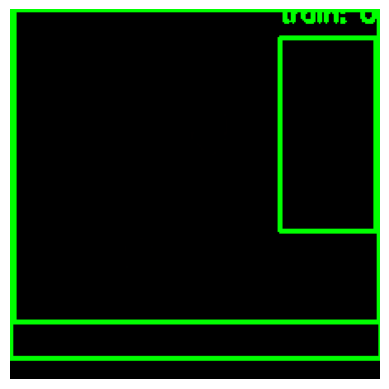

Frame 235, Label: 6, Score: 0.5453529953956604
Frame 235, Label: 7, Score: 0.5170080065727234
Frame 235, Label: 7, Score: 0.4140510559082031


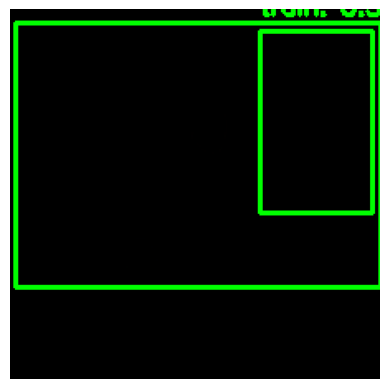

Frame 236, Label: 7, Score: 0.592943549156189
Frame 236, Label: 7, Score: 0.5548414587974548


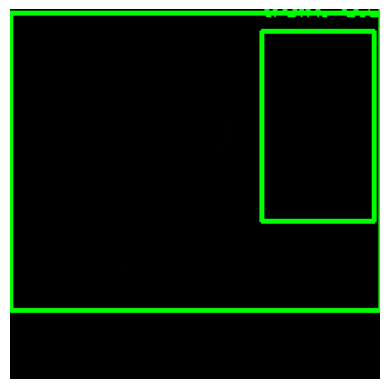

Frame 237, Label: 7, Score: 0.49940478801727295
Frame 237, Label: 7, Score: 0.36443114280700684


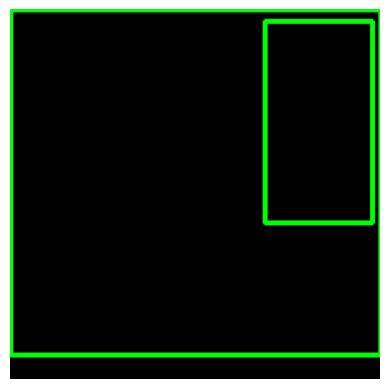

Frame 238, Label: 7, Score: 0.44028061628341675
Frame 238, Label: 7, Score: 0.4022577404975891


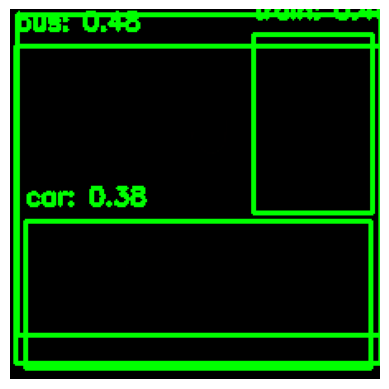

Frame 239, Label: 7, Score: 0.48347559571266174
Frame 239, Label: 6, Score: 0.47556835412979126
Frame 239, Label: 3, Score: 0.3835147023200989
Frame 239, Label: 7, Score: 0.37347349524497986


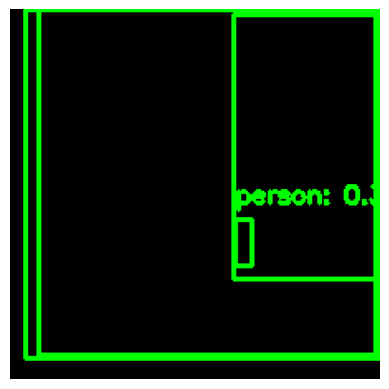

Frame 240, Label: 6, Score: 0.43360817432403564
Frame 240, Label: 6, Score: 0.38391250371932983
Frame 240, Label: 1, Score: 0.38336288928985596
Frame 240, Label: 7, Score: 0.3001810610294342


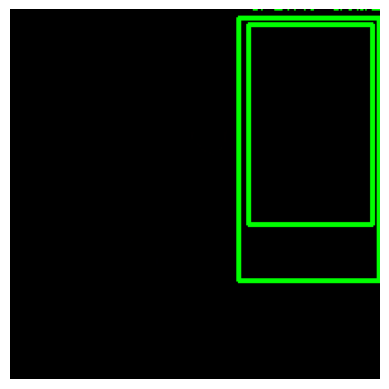

Frame 241, Label: 6, Score: 0.5106590986251831
Frame 241, Label: 7, Score: 0.3191935420036316


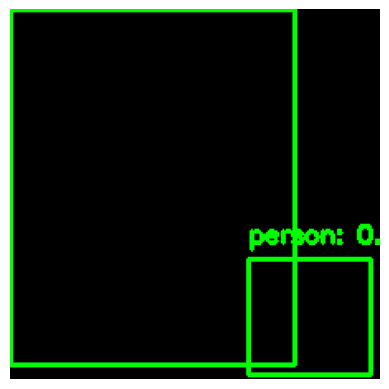

Frame 242, Label: 1, Score: 0.6209809184074402
Frame 242, Label: 14, Score: 0.5488461852073669


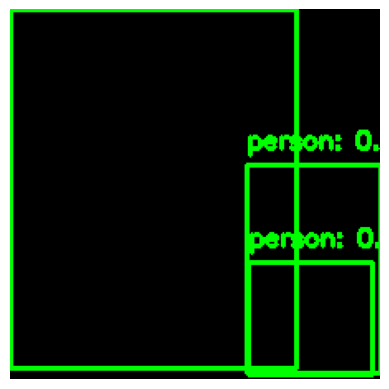

Frame 243, Label: 14, Score: 0.5486202239990234
Frame 243, Label: 1, Score: 0.5458055734634399
Frame 243, Label: 1, Score: 0.36167532205581665


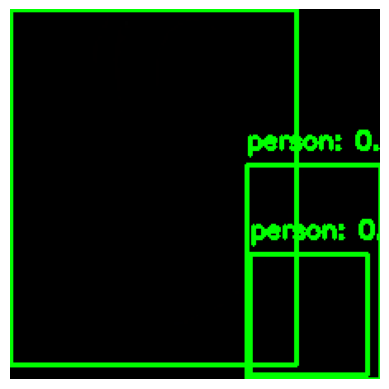

Frame 244, Label: 14, Score: 0.6157804727554321
Frame 244, Label: 1, Score: 0.5284310579299927
Frame 244, Label: 1, Score: 0.41861557960510254


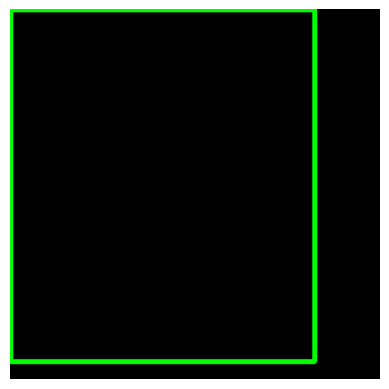

Frame 245, Label: 14, Score: 0.4544772803783417


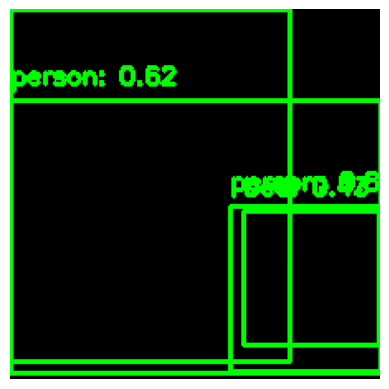

Frame 246, Label: 1, Score: 0.8887699246406555
Frame 246, Label: 1, Score: 0.6229079961776733
Frame 246, Label: 14, Score: 0.6088217496871948
Frame 246, Label: 60, Score: 0.4283629357814789


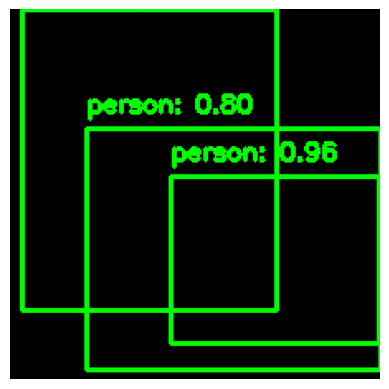

Frame 247, Label: 1, Score: 0.960369884967804
Frame 247, Label: 1, Score: 0.7974421977996826
Frame 247, Label: 14, Score: 0.3553880751132965


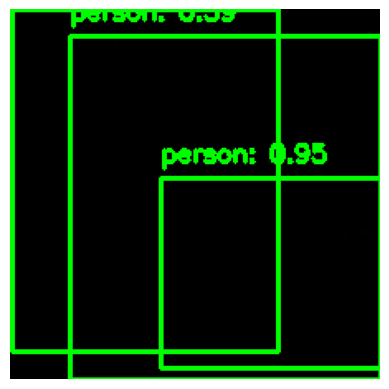

Frame 248, Label: 1, Score: 0.9463077187538147
Frame 248, Label: 1, Score: 0.5860738158226013
Frame 248, Label: 14, Score: 0.3772370219230652


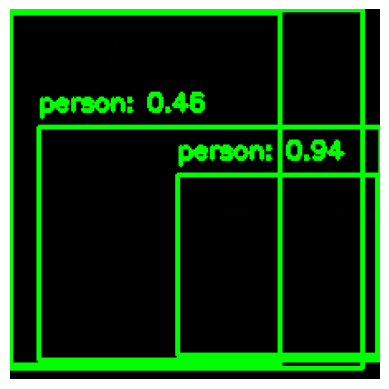

Frame 249, Label: 1, Score: 0.9400556087493896
Frame 249, Label: 1, Score: 0.46301186084747314
Frame 249, Label: 3, Score: 0.4238348603248596
Frame 249, Label: 14, Score: 0.335004985332489


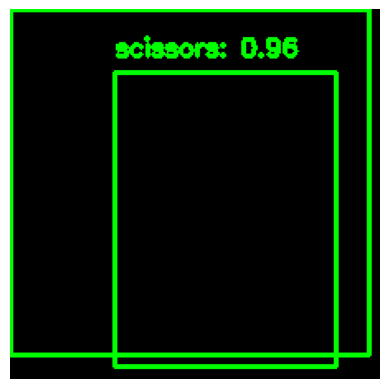

Frame 250, Label: 77, Score: 0.9636988043785095
Frame 250, Label: 1, Score: 0.4073406159877777


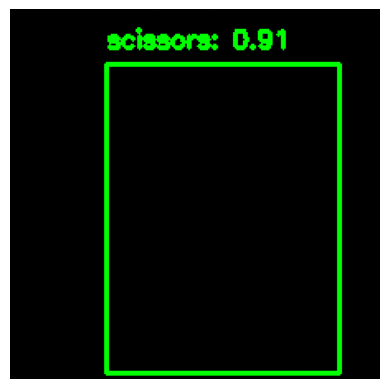

Frame 251, Label: 77, Score: 0.9128639698028564


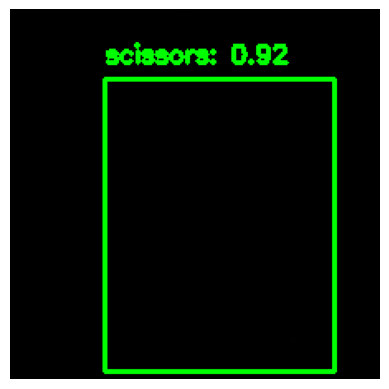

Frame 252, Label: 77, Score: 0.9248639941215515


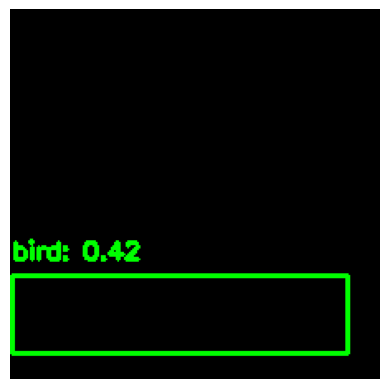

Frame 253, Label: 15, Score: 0.4194936454296112


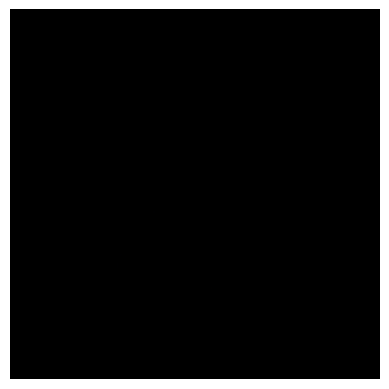

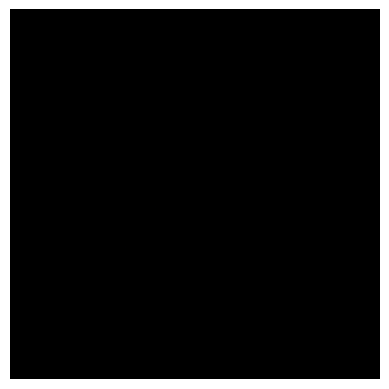

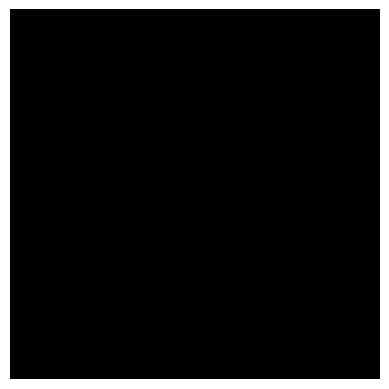

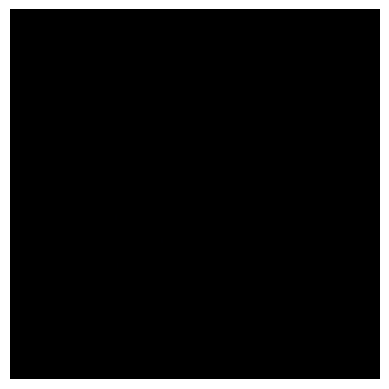

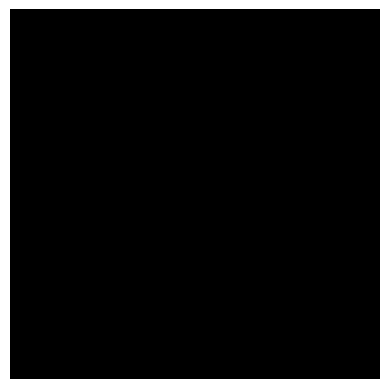

...

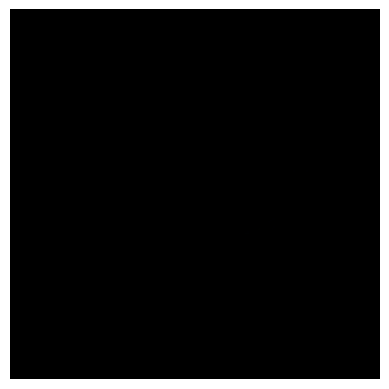

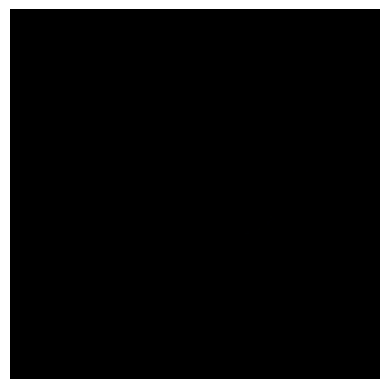

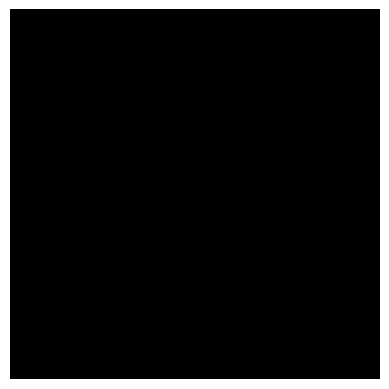

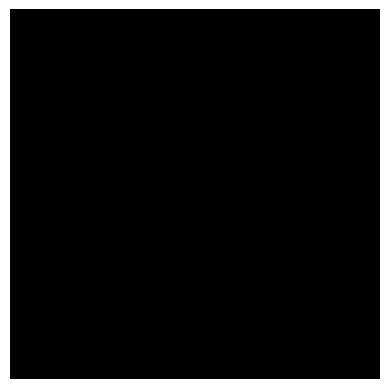

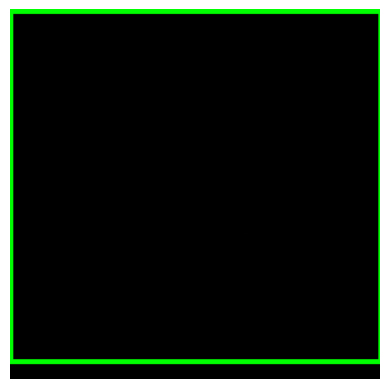

Frame 280, Label: 6, Score: 0.4521865248680115


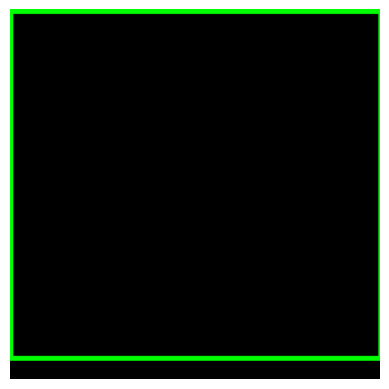

Frame 281, Label: 6, Score: 0.4267628788948059


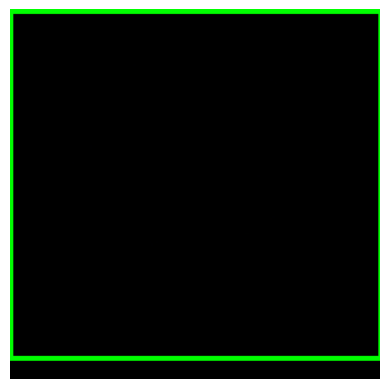

Frame 282, Label: 6, Score: 0.3967148959636688


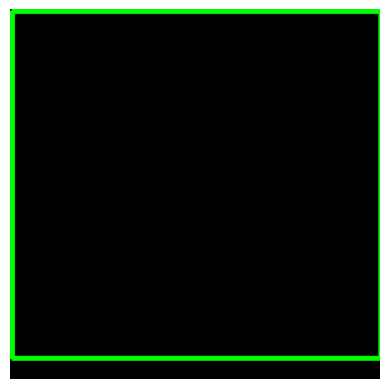

Frame 283, Label: 6, Score: 0.389045774936676


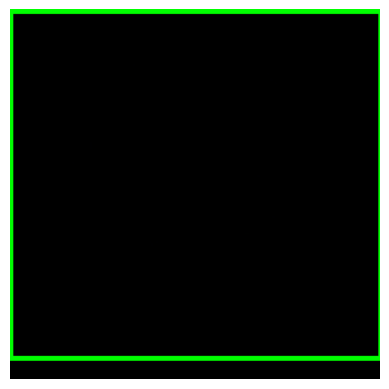

Frame 284, Label: 6, Score: 0.3966662883758545


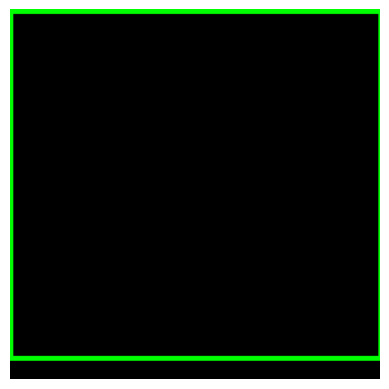

Frame 285, Label: 6, Score: 0.40871164202690125


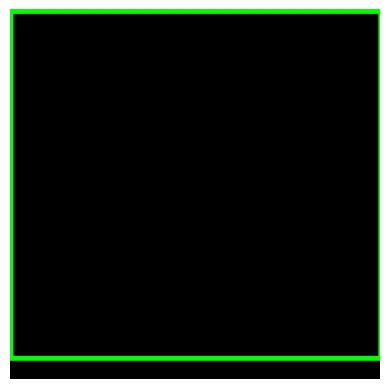

Frame 286, Label: 6, Score: 0.39646467566490173


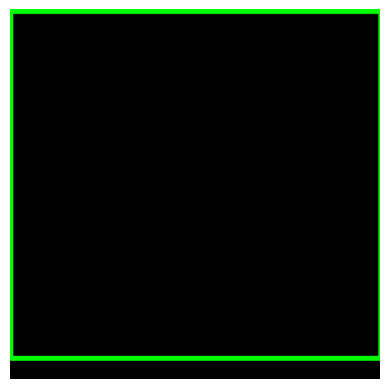

Frame 287, Label: 6, Score: 0.40771031379699707


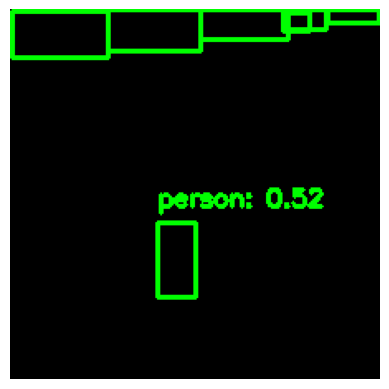

Frame 288, Label: 3, Score: 0.9980559349060059
Frame 288, Label: 3, Score: 0.9961571097373962
Frame 288, Label: 3, Score: 0.987993597984314
Frame 288, Label: 3, Score: 0.9613728523254395
Frame 288, Label: 3, Score: 0.6988144516944885
Frame 288, Label: 1, Score: 0.5203636884689331
Frame 288, Label: 3, Score: 0.36609506607055664


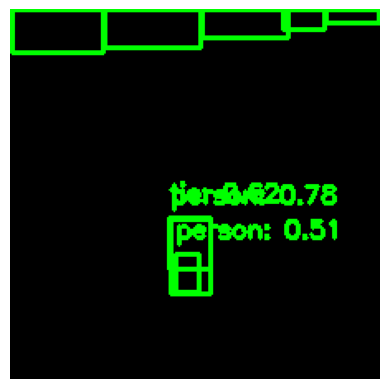

Frame 289, Label: 3, Score: 0.9958798885345459
Frame 289, Label: 3, Score: 0.9934800863265991
Frame 289, Label: 3, Score: 0.9834246039390564
Frame 289, Label: 3, Score: 0.9605903625488281
Frame 289, Label: 1, Score: 0.78459233045578
Frame 289, Label: 28, Score: 0.6173219084739685
Frame 289, Label: 1, Score: 0.5074771642684937
Frame 289, Label: 3, Score: 0.4081360399723053


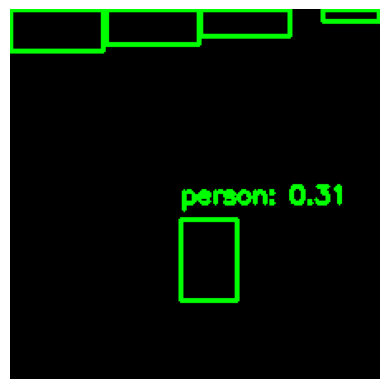

Frame 290, Label: 3, Score: 0.9982030391693115
Frame 290, Label: 3, Score: 0.9945403933525085
Frame 290, Label: 3, Score: 0.9808561205863953
Frame 290, Label: 3, Score: 0.9783389568328857
Frame 290, Label: 1, Score: 0.31092211604118347


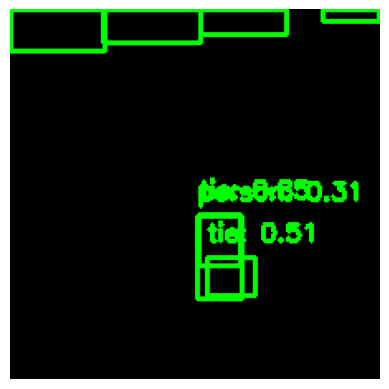

Frame 291, Label: 3, Score: 0.9957758784294128
Frame 291, Label: 3, Score: 0.9921891689300537
Frame 291, Label: 3, Score: 0.9740613698959351
Frame 291, Label: 3, Score: 0.9642754197120667
Frame 291, Label: 28, Score: 0.8461445569992065
Frame 291, Label: 28, Score: 0.510358989238739
Frame 291, Label: 1, Score: 0.3124901354312897


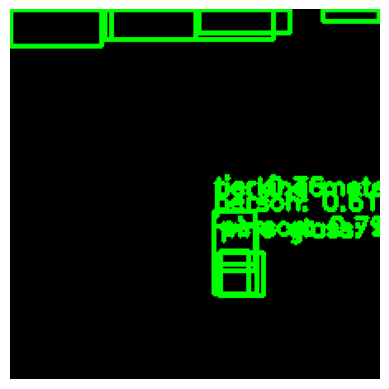

Frame 292, Label: 3, Score: 0.9951528310775757
Frame 292, Label: 3, Score: 0.9942345023155212
Frame 292, Label: 3, Score: 0.963565468788147
Frame 292, Label: 3, Score: 0.831320583820343
Frame 292, Label: 1, Score: 0.7924052476882935
Frame 292, Label: 28, Score: 0.7553338408470154
Frame 292, Label: 1, Score: 0.6068400740623474
Frame 292, Label: 41, Score: 0.4005248546600342
Frame 292, Label: 13, Score: 0.3441784679889679
Frame 292, Label: 3, Score: 0.3013671338558197


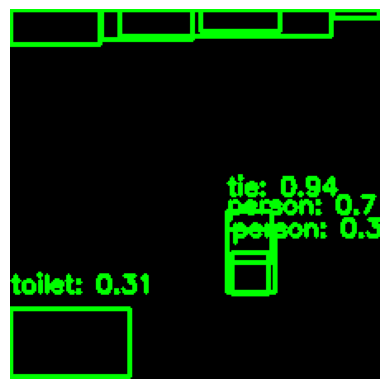

Frame 293, Label: 3, Score: 0.9956157207489014
Frame 293, Label: 3, Score: 0.9913302659988403
Frame 293, Label: 28, Score: 0.9410755038261414
Frame 293, Label: 3, Score: 0.9395352005958557
Frame 293, Label: 1, Score: 0.7085098028182983
Frame 293, Label: 3, Score: 0.49113142490386963
Frame 293, Label: 1, Score: 0.36629045009613037
Frame 293, Label: 62, Score: 0.3149169385433197
Frame 293, Label: 3, Score: 0.3007371127605438


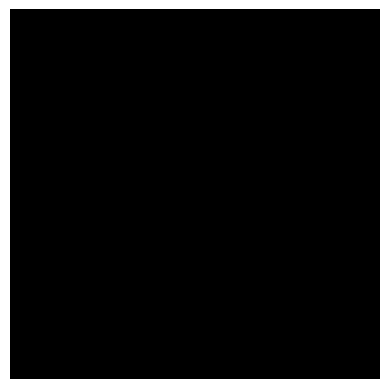

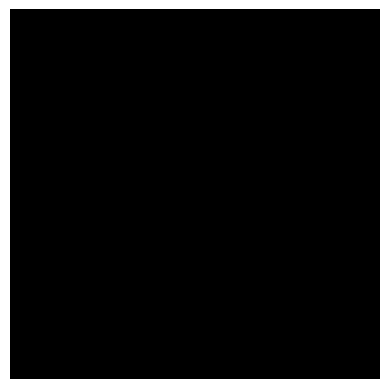

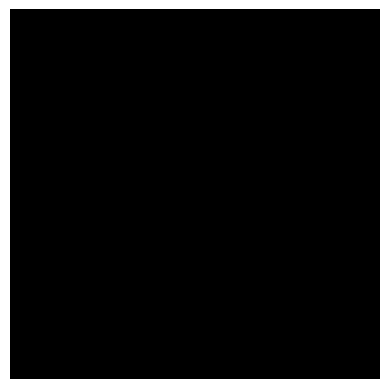

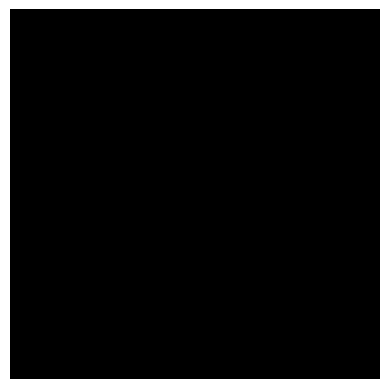

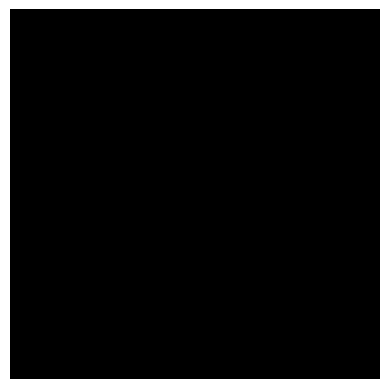

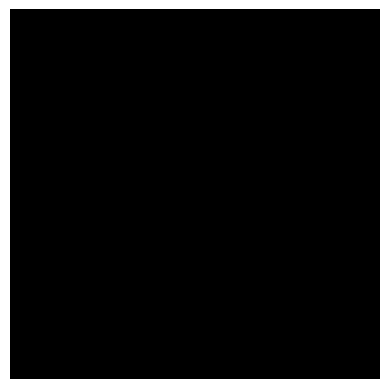

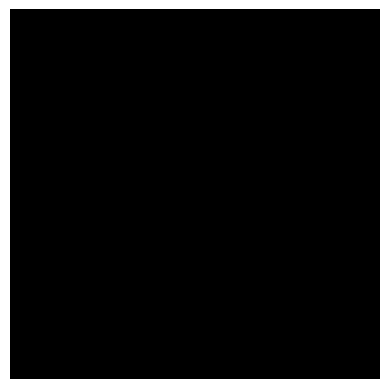

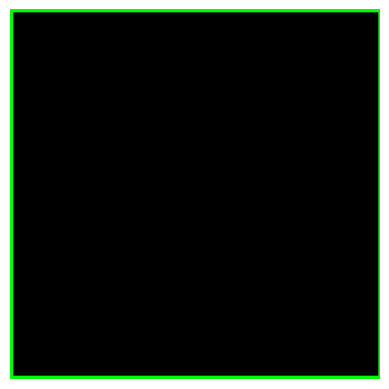

Frame 301, Label: 7, Score: 0.3046411871910095


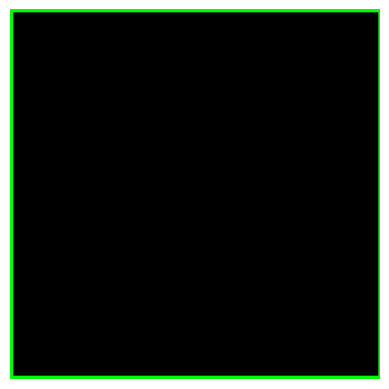

Frame 302, Label: 7, Score: 0.3073537349700928


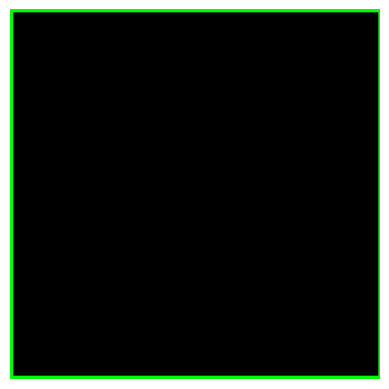

Frame 303, Label: 7, Score: 0.310749888420105


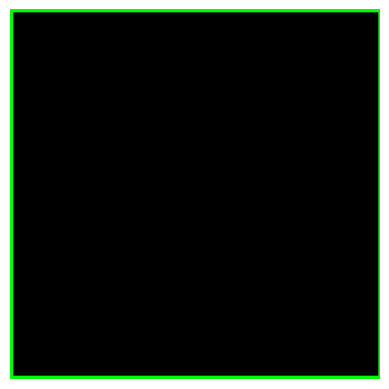

Frame 304, Label: 7, Score: 0.3113463819026947


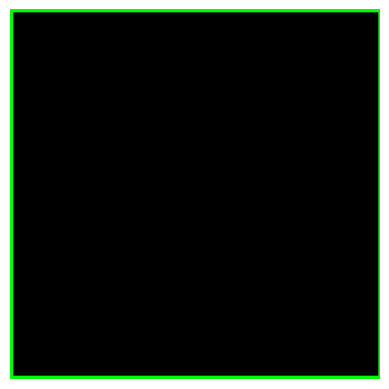

Frame 305, Label: 7, Score: 0.31122204661369324


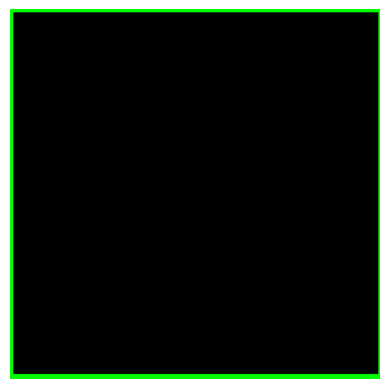

Frame 306, Label: 7, Score: 0.30480656027793884


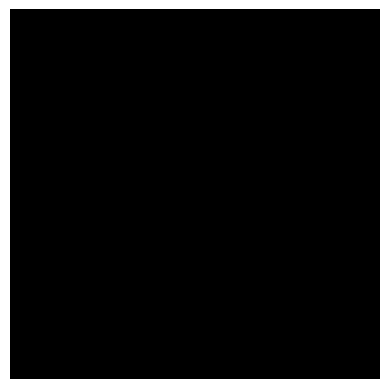

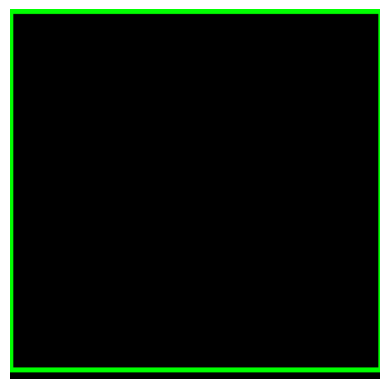

Frame 308, Label: 7, Score: 0.3678351938724518


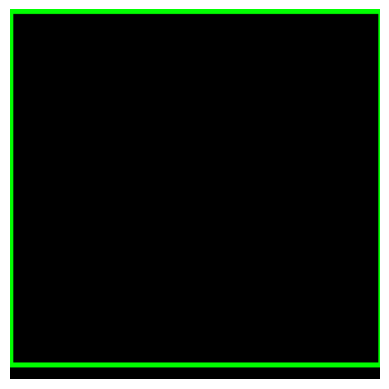

Frame 309, Label: 7, Score: 0.3898106515407562


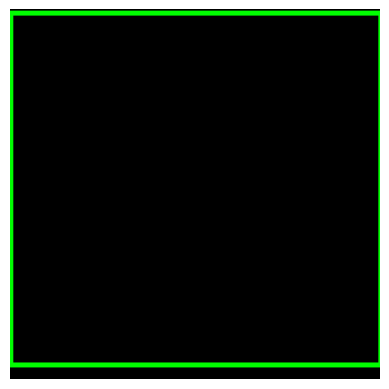

Frame 310, Label: 7, Score: 0.45216429233551025


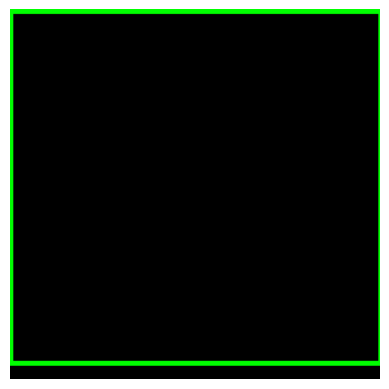

Frame 311, Label: 7, Score: 0.43151986598968506


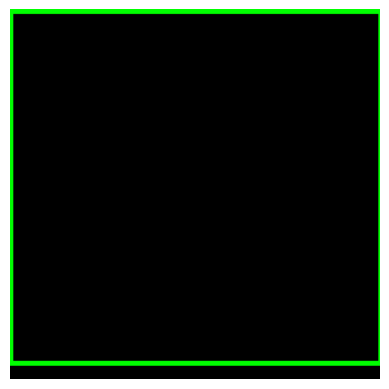

Frame 312, Label: 7, Score: 0.4321875274181366


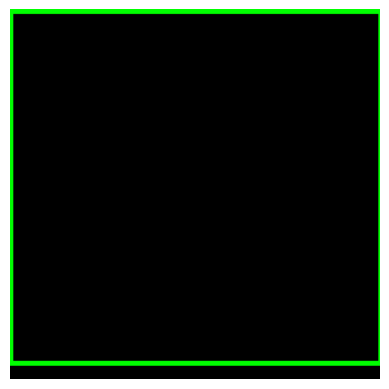

Frame 313, Label: 7, Score: 0.43156448006629944


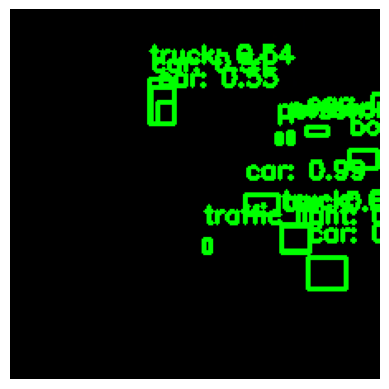

Frame 314, Label: 3, Score: 0.9894754886627197
Frame 314, Label: 1, Score: 0.8415930271148682
Frame 314, Label: 1, Score: 0.8248719573020935
Frame 314, Label: 3, Score: 0.8103614449501038
Frame 314, Label: 3, Score: 0.5909098982810974
Frame 314, Label: 3, Score: 0.5451480746269226
Frame 314, Label: 8, Score: 0.53783118724823
Frame 314, Label: 3, Score: 0.505791962146759
Frame 314, Label: 9, Score: 0.4036719799041748
Frame 314, Label: 8, Score: 0.33050641417503357
Frame 314, Label: 10, Score: 0.3125712275505066
Frame 314, Label: 3, Score: 0.3106887638568878


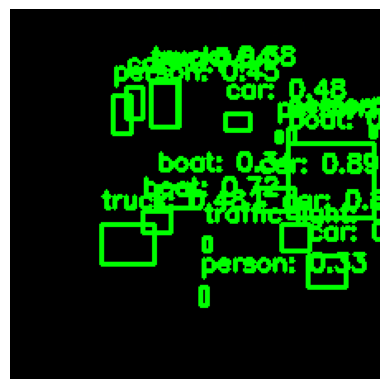

Frame 315, Label: 3, Score: 0.8896934390068054
Frame 315, Label: 1, Score: 0.8432523608207703
Frame 315, Label: 3, Score: 0.8007771372795105
Frame 315, Label: 3, Score: 0.7415260076522827
Frame 315, Label: 1, Score: 0.7302961945533752
Frame 315, Label: 9, Score: 0.7184874415397644
Frame 315, Label: 3, Score: 0.6423133611679077
Frame 315, Label: 9, Score: 0.5950528383255005
Frame 315, Label: 10, Score: 0.519128143787384
Frame 315, Label: 3, Score: 0.5046247839927673
Frame 315, Label: 8, Score: 0.47675228118896484
Frame 315, Label: 3, Score: 0.4755218029022217
Frame 315, Label: 1, Score: 0.4468365013599396
Frame 315, Label: 1, Score: 0.39956486225128174
Frame 315, Label: 8, Score: 0.3837634027004242
Frame 315, Label: 9, Score: 0.34008052945137024
Frame 315, Label: 1, Score: 0.3336588144302368


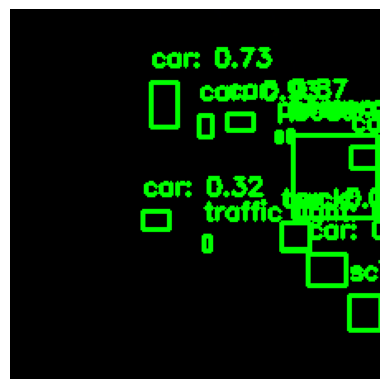

Frame 316, Label: 3, Score: 0.9278823733329773
Frame 316, Label: 3, Score: 0.8796989917755127
Frame 316, Label: 3, Score: 0.8749502301216125
Frame 316, Label: 1, Score: 0.8435454964637756
Frame 316, Label: 1, Score: 0.8057952523231506
Frame 316, Label: 3, Score: 0.7700942158699036
Frame 316, Label: 3, Score: 0.7322930693626404
Frame 316, Label: 10, Score: 0.5789391398429871
Frame 316, Label: 9, Score: 0.4769133925437927
Frame 316, Label: 3, Score: 0.3862888216972351
Frame 316, Label: 8, Score: 0.337279736995697
Frame 316, Label: 3, Score: 0.31706640124320984
Frame 316, Label: 77, Score: 0.31271082162857056


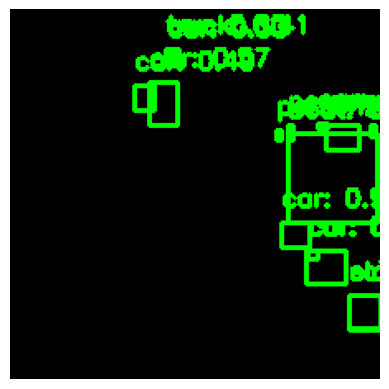

Frame 317, Label: 3, Score: 0.8996608853340149
Frame 317, Label: 1, Score: 0.8579130172729492
Frame 317, Label: 1, Score: 0.8086289167404175
Frame 317, Label: 3, Score: 0.8020855188369751
Frame 317, Label: 9, Score: 0.7979180812835693
Frame 317, Label: 77, Score: 0.6247734427452087
Frame 317, Label: 3, Score: 0.5990074276924133
Frame 317, Label: 3, Score: 0.5726547837257385
Frame 317, Label: 75, Score: 0.5389407873153687
Frame 317, Label: 3, Score: 0.5216385722160339
Frame 317, Label: 1, Score: 0.5194482207298279
Frame 317, Label: 3, Score: 0.5053352117538452
Frame 317, Label: 3, Score: 0.48858165740966797
Frame 317, Label: 8, Score: 0.41472917795181274
Frame 317, Label: 3, Score: 0.3495013415813446
Frame 317, Label: 3, Score: 0.3343546688556671


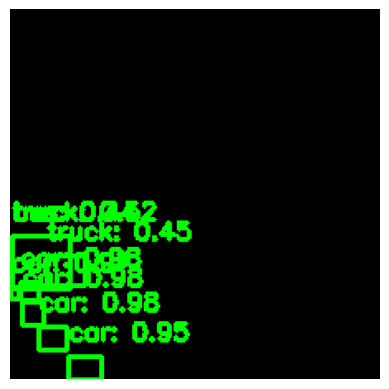

Frame 318, Label: 3, Score: 0.9841342568397522
Frame 318, Label: 3, Score: 0.9782880544662476
Frame 318, Label: 3, Score: 0.9767904281616211
Frame 318, Label: 3, Score: 0.965278148651123
Frame 318, Label: 3, Score: 0.9499384164810181
Frame 318, Label: 8, Score: 0.5188772082328796
Frame 318, Label: 8, Score: 0.4456910789012909
Frame 318, Label: 6, Score: 0.43602901697158813


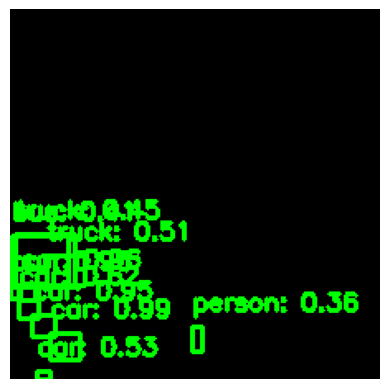

Frame 319, Label: 3, Score: 0.9898869395256042
Frame 319, Label: 3, Score: 0.9570611119270325
Frame 319, Label: 3, Score: 0.9524496793746948
Frame 319, Label: 3, Score: 0.9462808966636658
Frame 319, Label: 3, Score: 0.6184671521186829
Frame 319, Label: 3, Score: 0.530957818031311
Frame 319, Label: 8, Score: 0.513629674911499
Frame 319, Label: 8, Score: 0.45007848739624023
Frame 319, Label: 6, Score: 0.409954696893692
Frame 319, Label: 1, Score: 0.3620174527168274


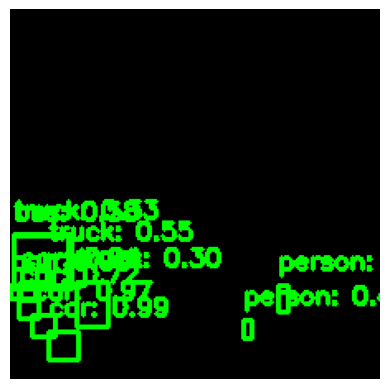

Frame 320, Label: 3, Score: 0.9938740134239197
Frame 320, Label: 3, Score: 0.9695974588394165
Frame 320, Label: 3, Score: 0.9548772573471069
Frame 320, Label: 3, Score: 0.9444920420646667
Frame 320, Label: 3, Score: 0.7172307372093201
Frame 320, Label: 6, Score: 0.5800583362579346
Frame 320, Label: 8, Score: 0.5516363978385925
Frame 320, Label: 1, Score: 0.4301965534687042
Frame 320, Label: 8, Score: 0.33026188611984253
Frame 320, Label: 1, Score: 0.31023627519607544
Frame 320, Label: 8, Score: 0.3012430965900421


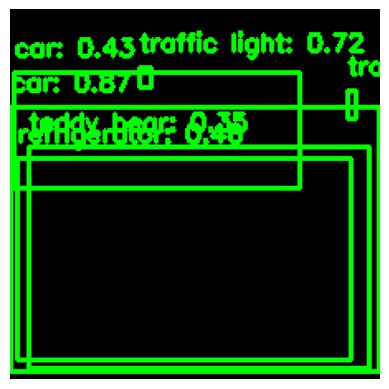

Frame 321, Label: 10, Score: 0.8739160895347595
Frame 321, Label: 3, Score: 0.8705468773841858
Frame 321, Label: 10, Score: 0.7175677418708801
Frame 321, Label: 73, Score: 0.45728638768196106
Frame 321, Label: 3, Score: 0.431672066450119
Frame 321, Label: 78, Score: 0.3506527543067932


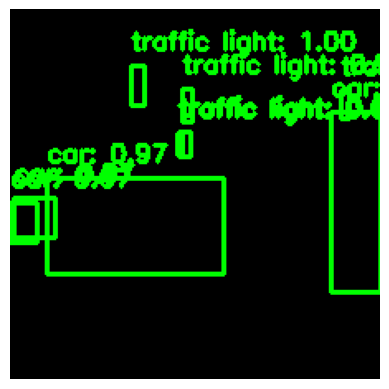

Frame 322, Label: 10, Score: 0.9954684972763062
Frame 322, Label: 3, Score: 0.9716225266456604
Frame 322, Label: 3, Score: 0.9662685394287109
Frame 322, Label: 10, Score: 0.9587110877037048
Frame 322, Label: 10, Score: 0.8461085557937622
Frame 322, Label: 10, Score: 0.7992754578590393
Frame 322, Label: 3, Score: 0.6720702052116394
Frame 322, Label: 3, Score: 0.6277798414230347
Frame 322, Label: 10, Score: 0.5954618453979492


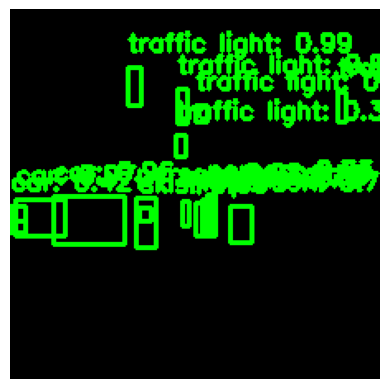

Frame 323, Label: 10, Score: 0.9924680590629578
Frame 323, Label: 10, Score: 0.9879981279373169
Frame 323, Label: 1, Score: 0.978367030620575
Frame 323, Label: 3, Score: 0.9735388159751892
Frame 323, Label: 3, Score: 0.9640894532203674
Frame 323, Label: 10, Score: 0.9008674025535583
Frame 323, Label: 1, Score: 0.7805026769638062
Frame 323, Label: 1, Score: 0.7340057492256165
Frame 323, Label: 1, Score: 0.7259629368782043
Frame 323, Label: 31, Score: 0.6595127582550049
Frame 323, Label: 1, Score: 0.6100658774375916
Frame 323, Label: 1, Score: 0.5308154225349426
Frame 323, Label: 10, Score: 0.4546973407268524
Frame 323, Label: 3, Score: 0.4235353171825409
Frame 323, Label: 3, Score: 0.42099738121032715
Frame 323, Label: 10, Score: 0.38150012493133545


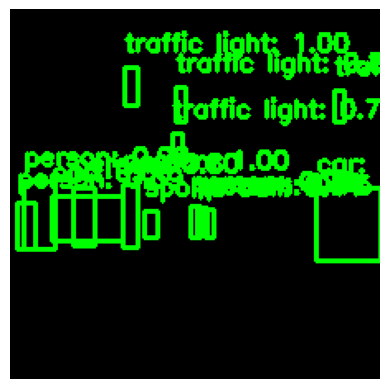

Frame 324, Label: 1, Score: 0.9975455403327942
Frame 324, Label: 10, Score: 0.9965441823005676
Frame 324, Label: 3, Score: 0.9964385032653809
Frame 324, Label: 10, Score: 0.9960038065910339
Frame 324, Label: 1, Score: 0.985236644744873
Frame 324, Label: 10, Score: 0.8935179114341736
Frame 324, Label: 1, Score: 0.7954316735267639
Frame 324, Label: 3, Score: 0.7953250408172607
Frame 324, Label: 1, Score: 0.7634686231613159
Frame 324, Label: 1, Score: 0.7450772523880005
Frame 324, Label: 10, Score: 0.6971942782402039
Frame 324, Label: 1, Score: 0.593600869178772
Frame 324, Label: 1, Score: 0.540244460105896
Frame 324, Label: 33, Score: 0.4446323812007904


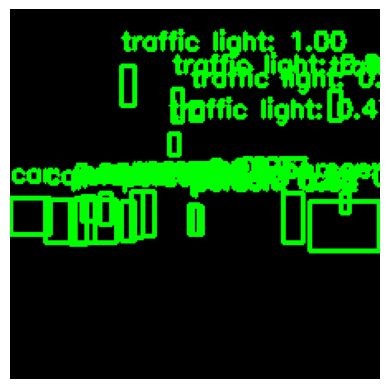

Frame 325, Label: 10, Score: 0.9951576590538025
Frame 325, Label: 10, Score: 0.9890164136886597
Frame 325, Label: 3, Score: 0.9781584739685059
Frame 325, Label: 1, Score: 0.9731989502906799
Frame 325, Label: 10, Score: 0.9725341796875
Frame 325, Label: 1, Score: 0.9684934616088867
Frame 325, Label: 1, Score: 0.9591356515884399
Frame 325, Label: 1, Score: 0.952394425868988
Frame 325, Label: 1, Score: 0.9356608986854553
Frame 325, Label: 1, Score: 0.9328716993331909
Frame 325, Label: 3, Score: 0.9246855974197388
Frame 325, Label: 3, Score: 0.9213683009147644
Frame 325, Label: 1, Score: 0.877143919467926
Frame 325, Label: 1, Score: 0.8534362316131592
Frame 325, Label: 1, Score: 0.6165285110473633
Frame 325, Label: 1, Score: 0.5452731251716614
Frame 325, Label: 1, Score: 0.5374391078948975
Frame 325, Label: 10, Score: 0.4676259756088257
Frame 325, Label: 10, Score: 0.3673876225948334


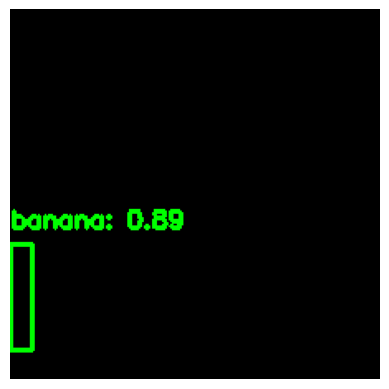

Frame 326, Label: 47, Score: 0.8896015286445618


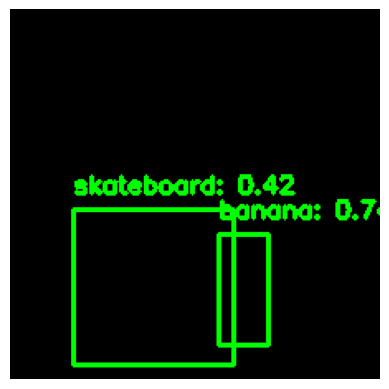

Frame 327, Label: 47, Score: 0.73838871717453
Frame 327, Label: 37, Score: 0.4158663749694824


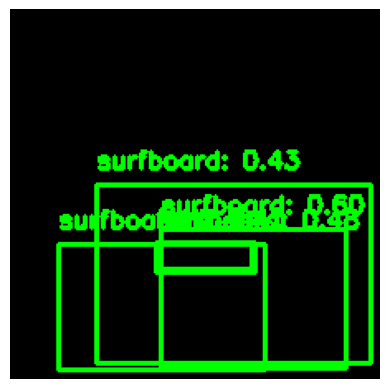

Frame 328, Label: 38, Score: 0.6036190986633301
Frame 328, Label: 38, Score: 0.5428053140640259
Frame 328, Label: 38, Score: 0.4808375835418701
Frame 328, Label: 43, Score: 0.44696882367134094
Frame 328, Label: 38, Score: 0.4285287857055664


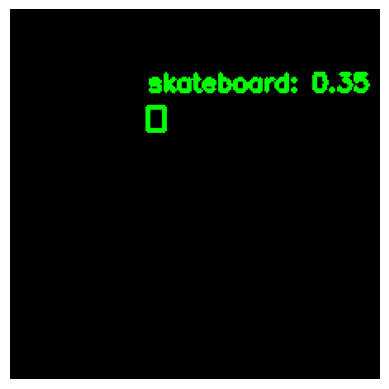

Frame 329, Label: 37, Score: 0.34984394907951355


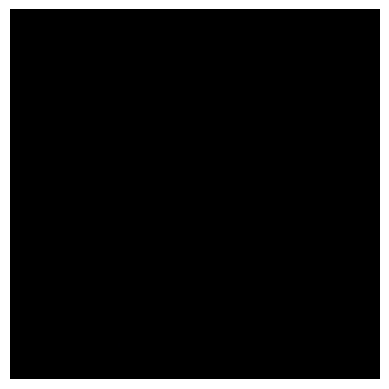

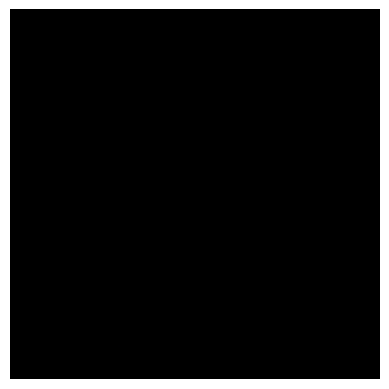

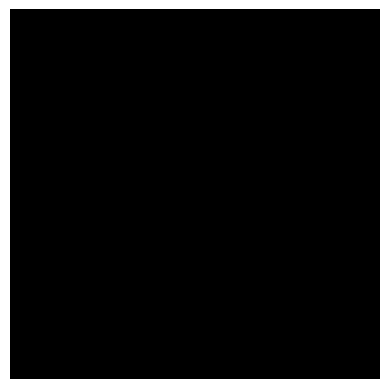

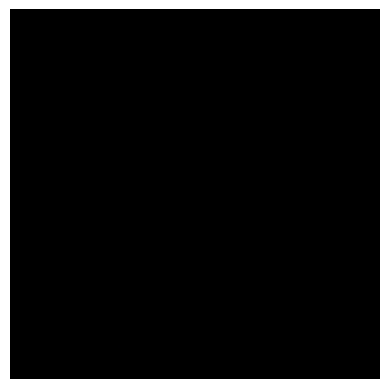

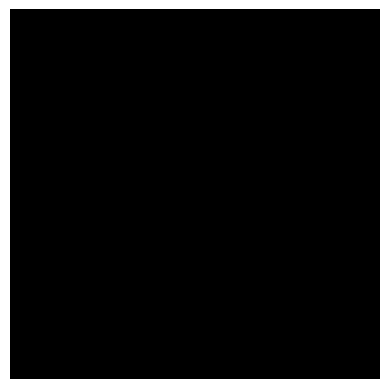

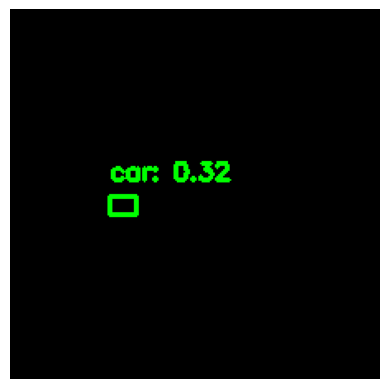

Frame 335, Label: 3, Score: 0.31966057419776917


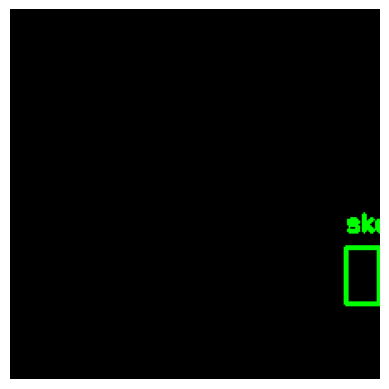

Frame 336, Label: 37, Score: 0.8777629733085632


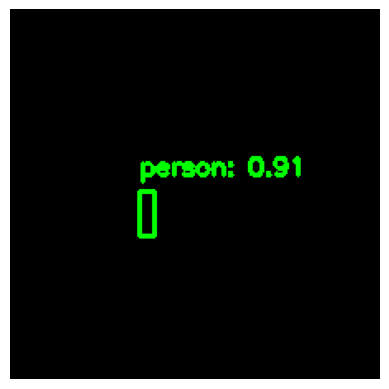

Frame 337, Label: 1, Score: 0.913581132888794


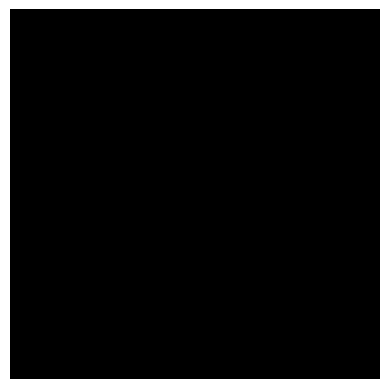

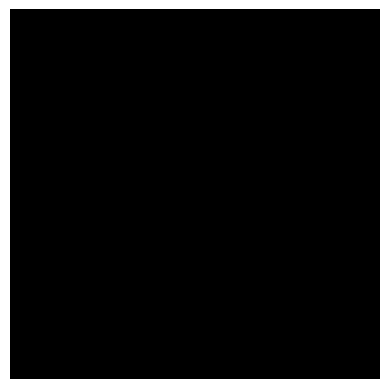

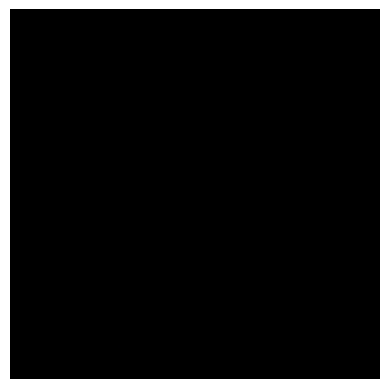

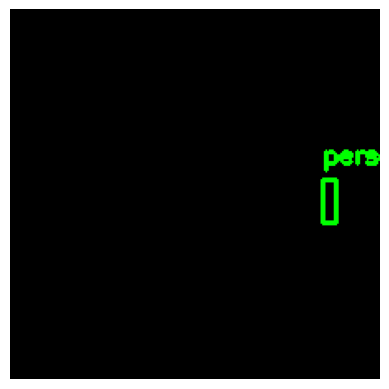

Frame 341, Label: 1, Score: 0.3254331350326538


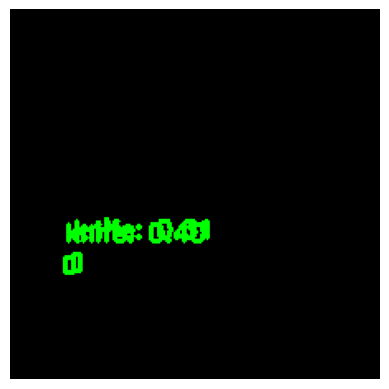

Frame 342, Label: 44, Score: 0.4031968116760254
Frame 342, Label: 44, Score: 0.3089393079280853


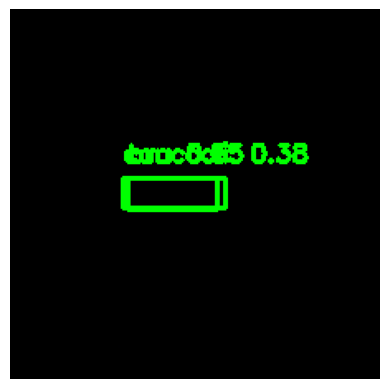

Frame 343, Label: 3, Score: 0.5491848587989807
Frame 343, Label: 51, Score: 0.383757621049881


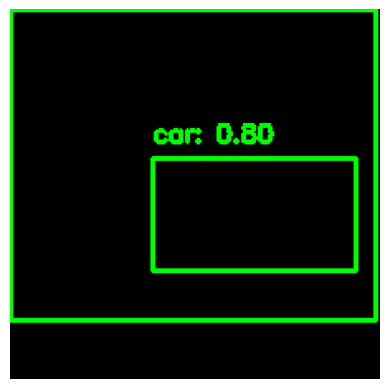

Frame 344, Label: 3, Score: 0.7964746952056885
Frame 344, Label: 6, Score: 0.35550400614738464


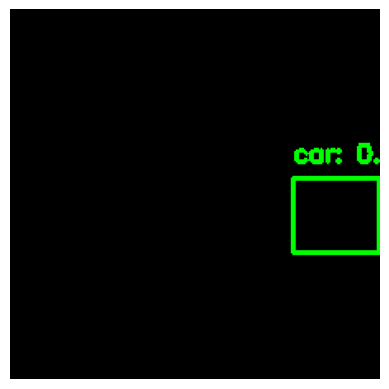

Frame 345, Label: 3, Score: 0.9888749122619629


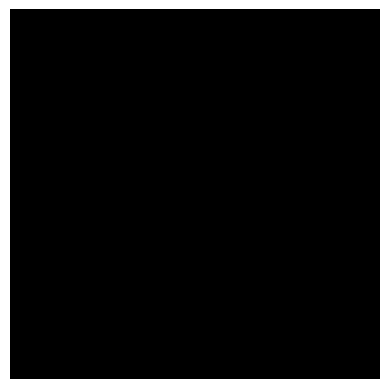

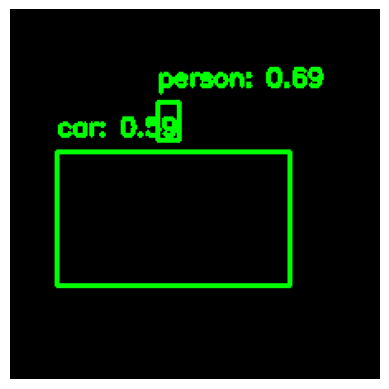

Frame 347, Label: 1, Score: 0.6875358819961548
Frame 347, Label: 3, Score: 0.5944969654083252


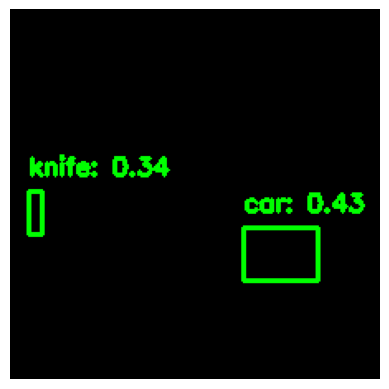

Frame 348, Label: 3, Score: 0.433392196893692
Frame 348, Label: 44, Score: 0.335605263710022


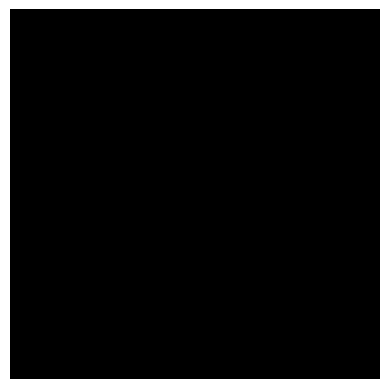

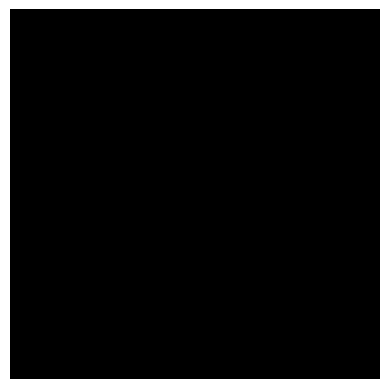

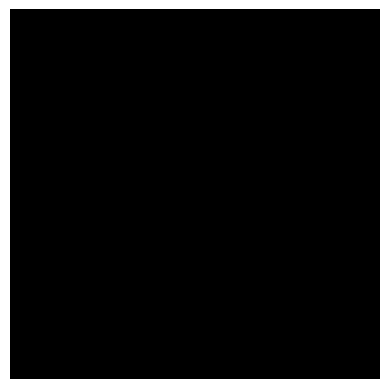

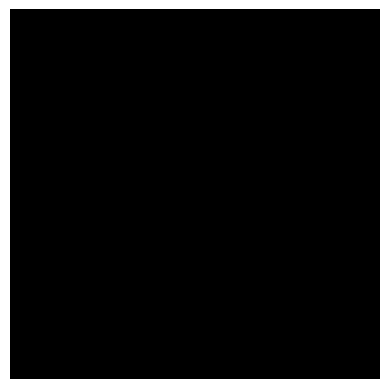

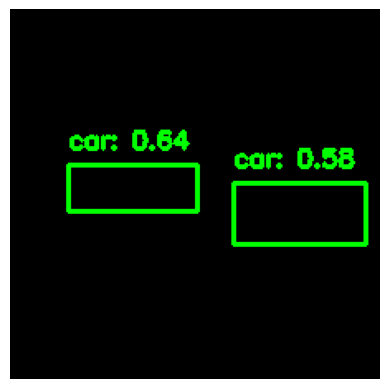

Frame 353, Label: 3, Score: 0.643501341342926
Frame 353, Label: 3, Score: 0.5777366757392883


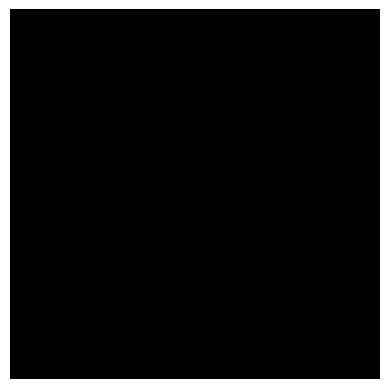

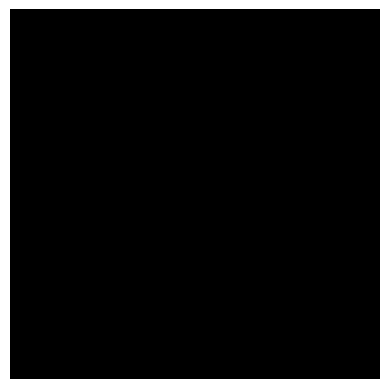

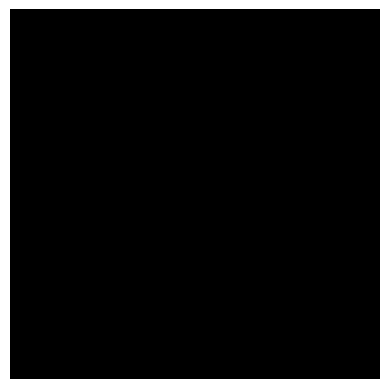

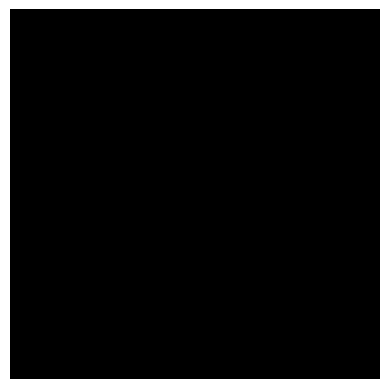

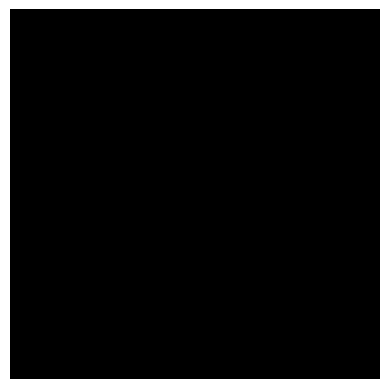

Results saved to C:\Users\algba\AIhwks\object_detection_results.csv


In [3]:
import torch
import torchvision.transforms as T
import torchvision
import numpy as np
import os
import pandas as pd
from datetime import timedelta
import cv2
import matplotlib.pyplot as plt

# Load a pre-trained model
weights = torchvision.models.detection.FasterRCNN_ResNet50_FPN_Weights.COCO_V1
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=weights)
model.eval()

# Define the COCO class names
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite',
    'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana',
    'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table',
    'toilet', 'TV', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Transform to apply to each frame
transform = T.Compose([
    T.ToTensor()
])

def detect_objects(frame, model, transform):
    frame_tensor = transform(frame).unsqueeze(0).to(torch.float32)
    with torch.no_grad():
        predictions = model(frame_tensor)
    return predictions[0]

def draw_boxes(frame, boxes, labels, scores):
    for i, box in enumerate(boxes):
        label = labels[i]
        score = scores[i]
        if score > 0.3:  # Lower confidence threshold to 0.3
            x1, y1, x2, y2 = box
            if label < len(COCO_INSTANCE_CATEGORY_NAMES):
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(frame, f'{COCO_INSTANCE_CATEGORY_NAMES[label]}: {score:.2f}', 
                            (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
            else:
                print(f"Warning: Label {label} is out of range")
    return frame

def visualize_predictions(frame, predictions):
    boxes = predictions['boxes'].cpu().numpy().astype(int)
    labels = predictions['labels'].cpu().numpy()
    scores = predictions['scores'].cpu().numpy()
    frame = frame.astype(np.uint8)  # Convert frame to uint8
    frame = draw_boxes(frame, boxes, labels, scores)
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def process_npy_files(npy_files, npy_dir, output_file):
    results = []
    for npy_file in npy_files:
        print(f"Processing file: {npy_file}")
        frames = np.load(os.path.join(npy_dir, npy_file))
        print(f"Number of frames in {npy_file}: {len(frames)}")
        for frame_num, frame in enumerate(frames):
            timestamp = str(timedelta(seconds=frame_num / 30))  # Assuming 30 FPS
            predictions = detect_objects(frame, model, transform)
            visualize_predictions(frame, predictions)
            for i, box in enumerate(predictions['boxes']):
                score = predictions['scores'][i].item()
                label = predictions['labels'][i].item()
                if score > 0.3:  # Lower confidence threshold to 0.3
                    if label < len(COCO_INSTANCE_CATEGORY_NAMES):
                        print(f"Frame {frame_num}, Label: {label}, Score: {score}")
                        bbox = box.cpu().numpy().astype(int).tolist()
                        results.append([
                            npy_file.replace('.npy', ''), frame_num, timestamp, label,
                            COCO_INSTANCE_CATEGORY_NAMES[label], score, bbox
                        ])
                    else:
                        print(f"Warning: Label {label} is out of range")
    df = pd.DataFrame(results, columns=[
        'vidId', 'frameNum', 'timestamp', 'detectedObjId',
        'detectedObjClass', 'confidence', 'bbox info'
    ])
    df.to_csv(output_file, index=False)
    print(f'Results saved to {output_file}')

if __name__ == '__main__':
    npy_dir = r'C:\Users\algba\AIhwks\processed_frames'
    output_file = r'C:\Users\algba\AIhwks\object_detection_results.csv'
    npy_files = [
        'wbWRWeVe1XE.npy',
        'FlJoBhLnqko.npy',
        'Y-bVwPRy_no.npy'
    ]

    process_npy_files(npy_files, npy_dir, output_file)


In [4]:
import cv2
import numpy as np
import os
import pandas as pd

def extract_objects_from_frames(npy_files, npy_dir, detection_results, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    detection_df = pd.read_csv(detection_results)
    for npy_file in npy_files:
        print(f"Processing file: {npy_file}")
        frames = np.load(os.path.join(npy_dir, npy_file))
        detections = detection_df[detection_df['vidId'] == npy_file.replace('.npy', '')]
        
        for _, row in detections.iterrows():
            frame_num = int(row['frameNum'])
            bbox = eval(row['bbox info'])
            label = row['detectedObjClass']
            obj_img = frames[frame_num][bbox[1]:bbox[3], bbox[0]:bbox[2]]
            obj_img_path = os.path.join(output_dir, f"{npy_file.replace('.npy', '')}_frame{frame_num}_{label}.png")
            cv2.imwrite(obj_img_path, obj_img)

npy_files = [
    'wbWRWeVe1XE.npy',
    'FlJoBhLnqko.npy',
    'Y-bVwPRy_no.npy'
]
npy_dir = r'C:\Users\algba\AIhwks\processed_frames'
detection_results = r'C:\Users\algba\AIhwks\object_detection_results.csv'
output_dir = r'C:\Users\algba\AIhwks\extracted_objects'

extract_objects_from_frames(npy_files, npy_dir, detection_results, output_dir)


Processing file: wbWRWeVe1XE.npy
Processing file: FlJoBhLnqko.npy
Processing file: Y-bVwPRy_no.npy


In [5]:
from keras.preprocessing.image import img_to_array, load_img
from keras.utils import normalize
import numpy as np
import os

def load_and_preprocess_images(image_dir, target_size=(128, 128)):
    images = []
    image_files = [os.path.join(image_dir, img) for img in os.listdir(image_dir) if img.endswith('.png')]
    for img_path in image_files:
        img = load_img(img_path, target_size=target_size)
        img_array = img_to_array(img)
        img_array = normalize(img_array, axis=1)
        images.append(img_array)
    return np.array(images)

image_dir = r'C:\Users\algba\AIhwks\extracted_objects'
images = load_and_preprocess_images(image_dir)


In [6]:
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from keras.models import Model

input_img = Input(shape=(128, 128, 3))

# Encoder
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x)

# Decoder
x = Conv2D(128, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
autoencoder.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 128, 128, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 64, 64, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 64, 64, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 32, 32, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 16, 16, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d (UpSampling2D)         │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 32, 32, 64)          │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_1 (UpSampling2D)       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 64, 64, 32)          │          18,464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_2 (UpSampling2D)       │ (None, 128, 128, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 128, 128, 3)         │             867 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 333,955 (1.27 MB)

 Trainable params: 333,955 (1.27 MB)

 Non-trainable params: 0 (0.00 B)

In [7]:
from sklearn.model_selection import train_test_split

x_train, x_val = train_test_split(images, test_size=0.2, random_state=42)

autoencoder.fit(x_train, x_train,
                epochs=50,
                batch_size=32,
                shuffle=True,
                validation_data=(x_val, x_val))


Epoch 1/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 47s 442ms/step - loss: 0.2635 - val_loss: 0.1204
Epoch 2/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 44s 447ms/step - loss: 0.1229 - val_loss: 0.1158
Epoch 3/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 47s 478ms/step - loss: 0.1167 - val_loss: 0.1117
Epoch 4/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 47s 477ms/step - loss: 0.1154 - val_loss: 0.1101
Epoch 5/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 44s 440ms/step - loss: 0.1118 - val_loss: 0.1092
Epoch 6/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 41s 415ms/step - loss: 0.1111 - val_loss: 0.1088
Epoch 7/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - loss: 0.1101 - val_loss: 0.1082
Epoch 8/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 41s 419ms/step - loss: 0.1110 - val_loss: 0.1078
Epoch 9/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 41s 419ms/step - loss: 0.1122 - val_loss: 0.1076
Epoch 10/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 41s 414ms/step - loss: 0.1107 - val_loss: 0.1073
Epoch 11/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 43s 436ms/step - loss: 0.1096 - val_loss: 0.1072
Epoch 12/50
99/99 ━━━━━━━━━━━━━━━━━━━━ 43

In [4]:
import psycopg2
import numpy as np

# Connect to your postgres DB
conn = psycopg2.connect(
    host="localhost",
    port="5432",
    database="embeddings",
    user="user",
    password="password"
)

# Open a cursor to perform database operations
cur = conn.cursor()

# Create table if not exists
cur.execute("""
CREATE TABLE IF NOT EXISTS image_embeddings (
    id SERIAL PRIMARY KEY,
    vidId VARCHAR(255),
    frameNum INT,
    timestamp VARCHAR(255),
    detectedObjId INT,
    detectedObjClass VARCHAR(255),
    confidence FLOAT,
    bbox_info VARCHAR(255),
    vector VECTOR(512)  -- Adjust the dimensions as per your embedding size
);
""")

# Function to insert embeddings into the table
def insert_embedding(data):
    cur.execute("""
    INSERT INTO image_embeddings (vidId, frameNum, timestamp, detectedObjId, detectedObjClass, confidence, bbox_info, vector)
    VALUES (%s, %s, %s, %s, %s, %s, %s, %s)
    """, data)
    conn.commit()

# Example data insertion
data = ('vid1', 1, '00:00:01', 1, 'person', 0.99, '[10, 20, 30, 40]', np.random.rand(512).tolist())
insert_embedding(data)

# Close the cursor and connection
cur.close()
conn.close()


In [5]:
# Connect to your postgres DB
conn = psycopg2.connect(
    host="localhost",
    port="5432",
    database="embeddings",
    user="user",
    password="password"
)

# Open a cursor to perform database operations
cur = conn.cursor()

# Query to verify the data
cur.execute("SELECT * FROM image_embeddings LIMIT 10;")
rows = cur.fetchall()

# Print the rows
for row in rows:
    print(row)

# Close the cursor and connection
cur.close()
conn.close()


(1, 'vid1', 1, '00:00:01', 1, 'person', 0.99, '[10, 20, 30, 40]', '[0.90364736,0.6992781,0.45099446,0.0059263194,0.18903048,0.81102633,0.25944397,0.38166922,0.706077,0.55492383,0.49192727,0.57529485,0.61885244,0.6667432,0.740822,0.28719705,0.6709832,0.1447695,0.45084673,0.97394294,0.96965796,0.46273515,0.43799505,0.8354475,0.7609255,0.5092076,0.10356953,0.05365206,0.7067795,0.8355768,0.34138405,0.8255909,0.4146235,0.048042547,0.7904194,0.8776342,0.2723426,0.16641344,0.12421014,0.34942925,0.69727117,0.8257248,0.91409737,0.31872955,0.99933344,0.89607435,0.7388701,0.8824421,0.38971296,0.64125615,0.9548863,0.5489097,0.8943637,0.13893987,0.2425634,0.948966,0.86634725,0.81917596,0.43109843,0.21145757,0.29616442,0.24348968,0.042397253,0.47122484,0.70103884,0.98658466,0.5484055,0.032190233,0.2671352,0.6313936,0.37976643,0.27404615,0.33128455,0.81332195,0.6742767,0.42905357,0.20844965,0.09969252,0.390696,0.61265177,0.5165076,0.7109261,0.55672365,0.910959,0.80918765,0.7987607,0.35171017,0.976803

In [10]:
import psycopg2
import numpy as np
import pandas as pd

# Connect to your postgres DB
conn = psycopg2.connect(
    host="localhost",
    port="5432",
    database="embeddings",
    user="user",
    password="password"
)

# Open a cursor to perform database operations
cur = conn.cursor()

# Example query to find the first 10 similar images
query = """
SELECT id, vidId, frameNum, detectedObjClass, vector, vector <-> %s::vector AS distance
FROM image_embeddings
ORDER BY distance
LIMIT 10;
"""

# Example embedding to find the similar images for (use actual embedding values)
example_embedding = np.random.rand(512).tolist()
example_embedding_str = '[' + ','.join(map(str, example_embedding)) + ']'

# Execute the query
cur.execute(query, (example_embedding_str,))

# Fetch the results
results = cur.fetchall()

# Convert results to a DataFrame for better visualization
df = pd.DataFrame(results, columns=['ID', 'Video ID', 'Frame Number', 'Class', 'Vector', 'Distance'])

# Display the results
print(df)

# Close the cursor and connection
cur.close()
conn.close()


   ID Video ID  Frame Number   Class  \
0   2     vid1             1  person   
1   1     vid1             1  person   

                                              Vector  Distance  
0  [0.8504762,0.68709683,0.34995055,0.70102113,0....  8.854764  
1  [0.90364736,0.6992781,0.45099446,0.0059263194,...  9.178601  


In [11]:
import psycopg2
import numpy as np
import pandas as pd

def find_similar_images(example_embedding):
    # Connect to your postgres DB
    conn = psycopg2.connect(
        host="localhost",
        port="5432",
        database="embeddings",
        user="user",
        password="password"
    )

    # Open a cursor to perform database operations
    cur = conn.cursor()

    # Example query to find the first 10 similar images
    query = """
    SELECT id, vidId, frameNum, detectedObjClass, vector, vector <-> %s::vector AS distance
    FROM image_embeddings
    ORDER BY distance
    LIMIT 10;
    """

    # Convert example embedding to the required format
    example_embedding_str = '[' + ','.join(map(str, example_embedding)) + ']'

    # Execute the query
    cur.execute(query, (example_embedding_str,))

    # Fetch the results
    results = cur.fetchall()

    # Convert results to a DataFrame for better visualization
    df = pd.DataFrame(results, columns=['ID', 'Video ID', 'Frame Number', 'Class', 'Vector', 'Distance'])

    # Close the cursor and connection
    cur.close()
    conn.close()

    return df

# Example embedding to find the similar images for (use actual embedding values)
example_embedding = np.random.rand(512).tolist()

# Find and display similar images
df_similar_images = find_similar_images(example_embedding)
print(df_similar_images)


   ID Video ID  Frame Number   Class  \
0   2     vid1             1  person   
1   1     vid1             1  person   

                                              Vector  Distance  
0  [0.8504762,0.68709683,0.34995055,0.70102113,0....  9.161633  
1  [0.90364736,0.6992781,0.45099446,0.0059263194,...  9.464065  


In [12]:
import psycopg2
import numpy as np
import pandas as pd

def find_similar_images(example_embedding):
    # Connect to your postgres DB
    conn = psycopg2.connect(
        host="localhost",
        port="5432",
        database="embeddings",
        user="user",
        password="password"
    )

    # Open a cursor to perform database operations
    cur = conn.cursor()

    # Example query to find the first 10 similar images
    query = """
    SELECT id, vidId, frameNum, detectedObjClass, vector, vector <-> %s::vector AS distance
    FROM image_embeddings
    ORDER BY distance
    LIMIT 10;
    """

    # Convert example embedding to the required format
    example_embedding_str = '[' + ','.join(map(str, example_embedding)) + ']'

    # Execute the query
    cur.execute(query, (example_embedding_str,))

    # Fetch the results
    results = cur.fetchall()

    # Convert results to a DataFrame for better visualization
    df = pd.DataFrame(results, columns=['ID', 'Video ID', 'Frame Number', 'Class', 'Vector', 'Distance'])

    # Close the cursor and connection
    cur.close()
    conn.close()

    return df

# Example usage with different embeddings
example_embedding_1 = np.random.rand(512).tolist()
example_embedding_2 = np.random.rand(512).tolist()

# Find and display similar images for the first example embedding
df_similar_images_1 = find_similar_images(example_embedding_1)
print("Results for Example Embedding 1:")
print(df_similar_images_1)

# Find and display similar images for the second example embedding
df_similar_images_2 = find_similar_images(example_embedding_2)
print("Results for Example Embedding 2:")
print(df_similar_images_2)


Results for Example Embedding 1:
   ID Video ID  Frame Number   Class  \
0   1     vid1             1  person   
1   2     vid1             1  person   

                                              Vector  Distance  
0  [0.90364736,0.6992781,0.45099446,0.0059263194,...  9.422694  
1  [0.8504762,0.68709683,0.34995055,0.70102113,0....  9.558314  
Results for Example Embedding 2:
   ID Video ID  Frame Number   Class  \
0   2     vid1             1  person   
1   1     vid1             1  person   

                                              Vector  Distance  
0  [0.8504762,0.68709683,0.34995055,0.70102113,0....  9.352992  
1  [0.90364736,0.6992781,0.45099446,0.0059263194,...  9.550079  
